In [115]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs

Dimension de X: (100, 2)
Dimension de y: (100, 1)


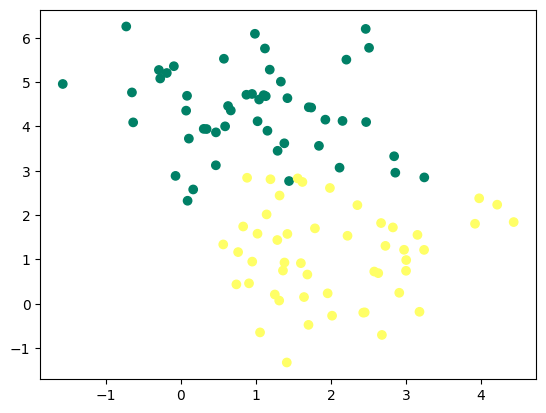

In [116]:
X,y = make_blobs(n_samples=100, n_features=2, centers=2, random_state=0)
y = y.reshape((y.shape[0], 1))

print('Dimension de X:', X.shape)
print('Dimension de y:', y.shape)

plt.scatter(X[:,0], X[:, 1], c=y, cmap='summer')
plt.show()

In [117]:
def initialisation(X):
    W= np.random.randn(X.shape[1], 1)
    b= np.random.randn(1)
    return (W, b)

In [149]:
def model(X,W, b):
    Z= X.dot(W) + b
    A= 1/ (1 + np.exp(-Z))
    return A

In [150]:
def log_loss(A, y):
    epsilon = 1e-15
    return 1 / len(y) * np.sum(-y * np.log(A + epsilon) - (1 - y) * np.log(1 - A + epsilon))

In [152]:
def gradients(A, X, y):
    dW = 1 / len(y) * np.dot(X.T, A- y)
    db = 1 / len(y) * np.sum(A- y)
    return (dW, db)

In [153]:
def update(dW, db, W, b, learning_rate):
    W = W - learning_rate * dW
    b = b - learning_rate * db
    return (W, b)

In [154]:
def predict(X, W, b):
    A = model(X, W, b)
    #print(A)
    return A >= 0.5

In [213]:
from sklearn.metrics import accuracy_score
from tqdm import tqdm

In [235]:
def artificial_neuron(X, y, learning_rate = 0.1, n_iter = 100):
    # initialisation W, b
    W, b = initialisation(X)

    Loss = []
    acc = []
    W_values = []
    b_values = []


    for i in tqdm(range(n_iter)) :
        # Activation de notre model 
        A = model(X, W, b)

        if i %10 == 0 :

            # Calucul de notre cout
            Loss.append(log_loss(A, y))

            # Calcul de l'accuracy
            y_pred = predict(X, W, b)
            acc.append(accuracy_score(y, y_pred))

        # Ajoute des valeurs 3D
        W_values.append(W)
        b_values.append(b)

        # Mise à jour
        dW, db = gradients(A, X, y)
        W, b = update(dW, db, W, b, learning_rate)

    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(Loss)
    plt.subplot(1, 2, 2)
    plt.plot(acc)
    plt.show()

    return (W, b)

100%|██████████| 100/100 [00:00<00:00, 2857.17it/s]


[[3.91540324e-04]
 [1.72739934e-01]
 [7.62035767e-01]
 [5.49722368e-01]
 [2.37272528e-03]
 [8.36995691e-02]
 [1.89728349e-01]
 [6.33136282e-04]
 [3.49858625e-01]
 [9.45754090e-02]
 [3.42064261e-01]
 [4.46815932e-02]
 [1.59653626e-01]
 [6.04620889e-01]
 [4.05666636e-02]
 [2.46216689e-04]
 [2.35103595e-03]
 [4.82480504e-01]
 [2.24302982e-01]
 [9.87676039e-02]
 [1.66288020e-01]
 [3.24298484e-01]
 [1.01780337e-01]
 [7.31979435e-01]
 [8.22085900e-03]
 [2.48463107e-01]
 [8.42658751e-02]
 [2.31221371e-01]
 [1.01702309e-01]
 [1.45292199e-02]
 [1.00255584e-02]
 [1.90453419e-01]
 [1.67278908e-01]
 [9.65995296e-03]
 [6.05557566e-02]
 [2.51899566e-02]
 [7.98987411e-02]
 [3.02307179e-02]
 [2.46904027e-02]
 [3.06492507e-01]
 [6.37384986e-01]
 [1.48805243e-02]
 [8.96073675e-01]
 [1.00519031e-01]
 [2.14661329e-01]
 [1.75562309e-02]
 [2.20971319e-02]
 [3.92925218e-02]
 [8.66372015e-01]
 [3.89747931e-01]
 [2.58728860e-02]
 [2.28200286e-01]
 [1.68439157e-02]
 [1.21976231e-01]
 [2.74270998e-03]
 [1.743049

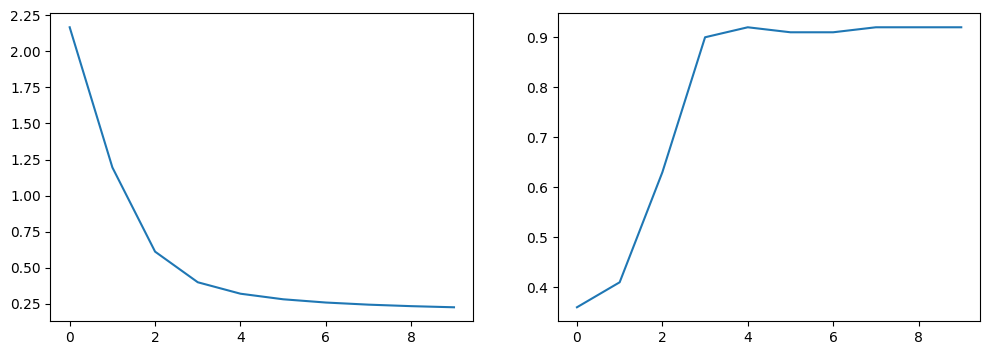

(array([[ 0.85770434],
        [-1.0470707 ]]),
 array([1.16018752]))

In [236]:
artificial_neuron(X, y)

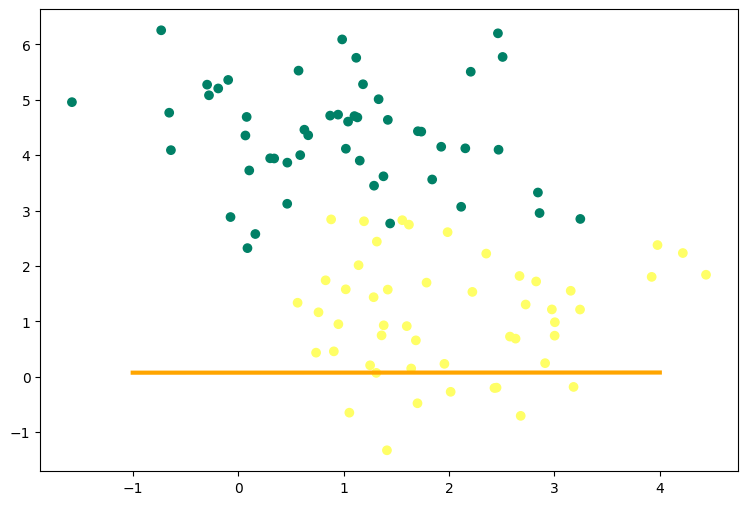

In [237]:
fig, ax = plt.subplots(figsize=(9, 6))
ax.scatter(X[:,0], X[:, 1], c=y, cmap='summer')

x1 = np.linspace(-1, 4, 100)
x2 = ( - W[0] * x1 - b) / W[1]

ax.plot(x1, x2, c='orange', lw=3)

In [238]:
import plotly.graph_objects as go

In [239]:
fig = go.Figure(data=[go.Scatter3d( 
    x=X[:, 0].flatten(),
    y=X[:, 1].flatten(),
    z=y.flatten(),
    mode='markers',
    marker=dict(
        size=5,
        color=y.flatten(),                
        colorscale='YlGn',  
        opacity=0.8,
        reversescale=True
    )
)])

fig.update_layout(template= "plotly_dark", margin=dict(l=0, r=0, b=0, t=0))
fig.layout.scene.camera.projection.type = "orthographic"
fig.show(renderer="browser")


In [240]:
X0 = np.linspace(X[:, 0].min(), X[:, 0].max(), 100)
X1 = np.linspace(X[:, 1].min(), X[:, 1].max(), 100)
xx0, xx1 = np.meshgrid(X0, X1)
Z = W[0] * xx0 + W[1] * xx1 + b
A = 1 / (1 + np.exp(-Z))

fig = (go.Figure(data=[go.Surface(z=A, x=xx0, y=xx1, colorscale='YlGn', opacity = 0.7, reversescale=True)]))

fig.add_scatter3d(x=X[:, 0].flatten(), y=X[:, 1].flatten(), z=y.flatten(), mode='markers', marker=dict(size=5, color=y.flatten(), colorscale='YlGn', opacity = 0.9, reversescale=True))


fig.update_layout(template= "plotly_dark", margin=dict(l=0, r=0, b=0, t=0))
fig.layout.scene.camera.projection.type = "orthographic"
fig.show(renderer="browser")

Test de données sur des images de Chiens et de Chats

In [241]:
from utilities import *

In [242]:
X_train, y_train, X_test, y_test = load_data()

In [243]:
print(X_train.shape)
print(y_train.shape)
print(np.unique(y_train, return_counts=True))

(1000, 64, 64)
(1000, 1)
(array([0., 1.]), array([500, 500], dtype=int64))


In [244]:
print(X_test.shape)
print(y_test.shape)
print(np.unique(y_test, return_counts=True))

(200, 64, 64)
(200, 1)
(array([0., 1.]), array([100, 100], dtype=int64))


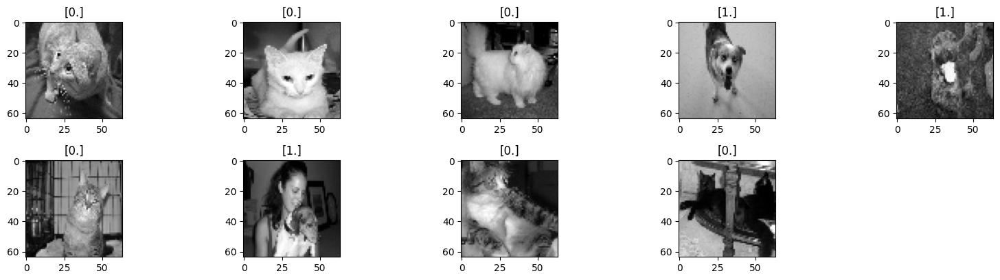

In [245]:
plt.figure(figsize=(16, 8))
for i in range(1, 10):
    plt.subplot(4, 5, i)
    plt.imshow(X_train[i], cmap='gray')
    plt.title(y_train[i])
    plt.tight_layout()
plt.show()

Entrainement du modèle

In [246]:
#X_train_reshape = X_train.reshape(X_train.shape[0],  X_train.shape[1] * X_train.shape[2])
X_train_reshape = X_train.reshape(X_train.shape[0], -1 ) / X_train.max()
X_train_reshape.shape

(1000, 4096)

In [247]:
X_train_reshape.max()

1.0

In [248]:
X_test_reshape = X_test.reshape(X_test.shape[0], -1 ) / X_train.max()
X_test_reshape.shape

(200, 4096)

In [253]:
def artificial_neuron2(X_train, y_train, X_test, y_test, learning_rate = 0.1, n_iter = 100):
    # initialisation W, b
    W, b = initialisation(X_train)

    train_loss = []
    train_acc = []

    test_loss = []
    test_acc = []

    W_values = []
    b_values = []


    for i in tqdm(range(n_iter)) :
        # Activation de notre model 
        A = model(X_train, W, b)

        if i %10 == 0 :

            # Calucul de notre cout train_loss
            train_loss.append(log_loss(A, y_train))
            # Calcul de l'accuracy
            y_pred = predict(X_train, W, b)
            train_acc.append(accuracy_score(y_train, y_pred))


            #Test

            # Calucul de notre cout test_loss
            A_test = model(X_test, W, b)
            train_loss.append(log_loss(A_test, y_test))
            # Calcul de l'accuracy de test
            y_pred = predict(X_test, W, b)
            train_acc.append(accuracy_score(y_test, y_pred))

        # Ajoute des valeurs 3D
        W_values.append(W)
        b_values.append(b)

        # Mise à jour
        dW, db = gradients(A, X_train, y_train)
        W, b = update(dW, db, W, b, learning_rate)

    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(train_loss, label="train_loss")
    plt.plot(test_loss, label="test_loss")
    plt.legend()
    plt.subplot(1, 2, 2)
    plt.plot(train_acc, label="train_acc")
    plt.plot(test_acc, label="test_acc")
    plt.legend()
    plt.show()

    return (W, b)

  0%|          | 11/10000 [00:00<01:43, 96.17it/s]

[[9.99999997e-01]
 [1.00000000e+00]
 [1.09830404e-12]
 [9.99999879e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99999351e-01]
 [9.99994366e-01]
 [9.99775239e-01]
 [9.99999998e-01]
 [9.99940105e-01]
 [9.92651812e-01]
 [1.00000000e+00]
 [9.99999996e-01]
 [9.95050644e-01]
 [9.99999796e-01]
 [9.99999999e-01]
 [9.99999998e-01]
 [9.99700118e-01]
 [9.81342589e-01]
 [1.00000000e+00]
 [9.99999999e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.99999999e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [9.94417403e-01]
 [9.99999316e-01]
 [1.00000000e+00]
 [2.65249020e-01]
 [9.99985582e-01]
 [9.58079465e-01]
 [1.00000000e+00]
 [9.99999984e-01]
 [9.72021032e-01]
 [9.99999996e-01]
 [1.00000000e+00]
 [9.99999993e-01]
 [3.93127402e-01]
 [9.99999630e-01]
 [9.99991257e-01]
 [9.99999753e-01]
 [2.34320673e-10]
 [9.99999998e-01]
 [1.43045527e-01]
 [9.99775119e-01]
 [1.21106708e-02]
 [1.00000000e+00]
 [9.99999710e-01]
 [1.00000000e+00]
 [9.99999958e-01]
 [1.00000000e+00]
 [1.00000000e+00]
 [1.97717455e-03]
 [1.000000

  1%|          | 52/10000 [00:00<01:18, 127.11it/s]

[[1.77093263e-02]
 [9.99999877e-01]
 [1.26737137e-20]
 [9.87186843e-01]
 [9.99997199e-01]
 [9.99998710e-01]
 [4.92416574e-01]
 [7.56737461e-01]
 [8.17204587e-04]
 [9.86645980e-01]
 [6.45275951e-02]
 [5.58438146e-08]
 [9.99997340e-01]
 [2.26049256e-01]
 [4.47625447e-04]
 [9.97952951e-01]
 [9.99303687e-01]
 [8.50717219e-01]
 [4.60373018e-05]
 [1.56771636e-05]
 [9.99929609e-01]
 [4.34653827e-01]
 [9.99998887e-01]
 [9.99994181e-01]
 [9.62691728e-01]
 [1.12176665e-02]
 [7.73163032e-01]
 [9.11654380e-06]
 [2.54056388e-01]
 [9.99999391e-01]
 [4.72799922e-08]
 [7.51714459e-03]
 [1.66171948e-06]
 [9.99945876e-01]
 [3.69347811e-01]
 [6.23349554e-06]
 [3.54464026e-02]
 [9.85747004e-01]
 [8.35574909e-03]
 [2.68307224e-09]
 [2.88830374e-03]
 [3.24601254e-02]
 [1.16868102e-02]
 [4.97679046e-16]
 [9.98815524e-01]
 [1.47172217e-11]
 [1.30647829e-03]
 [1.70209086e-09]
 [9.98654210e-01]
 [9.31188582e-01]
 [9.99999995e-01]
 [4.61734375e-02]
 [9.99999678e-01]
 [9.99756770e-01]
 [9.91733482e-10]
 [9.995790

  1%|          | 81/10000 [00:00<01:16, 128.82it/s]

[[5.02429182e-03]
 [9.99999855e-01]
 [1.53627542e-19]
 [9.96712009e-01]
 [9.99995985e-01]
 [9.99998703e-01]
 [7.12138534e-01]
 [8.86650271e-01]
 [1.07279921e-03]
 [9.56834927e-01]
 [1.21772665e-01]
 [4.29798035e-08]
 [9.99986053e-01]
 [5.66630342e-01]
 [6.41282542e-04]
 [9.98906095e-01]
 [9.99473747e-01]
 [9.37299177e-01]
 [1.29493614e-04]
 [4.84015466e-05]
 [9.99517659e-01]
 [4.15773997e-01]
 [9.99997517e-01]
 [9.99974224e-01]
 [8.78758102e-01]
 [9.74644148e-03]
 [7.48878673e-01]
 [1.44465116e-05]
 [5.24283106e-01]
 [9.99998628e-01]
 [6.81342419e-08]
 [1.08921573e-02]
 [1.22272710e-06]
 [9.99960109e-01]
 [5.90875894e-01]
 [1.29872561e-05]
 [3.71323440e-02]
 [9.85607746e-01]
 [3.05443361e-03]
 [6.45225028e-09]
 [3.67139237e-03]
 [3.46826785e-02]
 [4.65359219e-03]
 [1.99170171e-15]
 [9.97637770e-01]
 [3.02745874e-11]
 [2.50855788e-03]
 [7.08254662e-09]
 [9.98215688e-01]
 [8.79846084e-01]
 [9.99999980e-01]
 [9.16811163e-02]
 [9.99999636e-01]
 [9.99712415e-01]
 [3.52559459e-09]
 [9.998087

  1%|          | 111/10000 [00:00<01:15, 131.53it/s]

[[1.99282558e-03]
 [9.99999827e-01]
 [1.07323440e-18]
 [9.98803361e-01]
 [9.99995245e-01]
 [9.99998649e-01]
 [8.42272598e-01]
 [9.38019568e-01]
 [1.22655895e-03]
 [8.99595214e-01]
 [1.78589616e-01]
 [4.12080057e-08]
 [9.99947384e-01]
 [8.11292789e-01]
 [9.41438122e-04]
 [9.99292431e-01]
 [9.99589225e-01]
 [9.68851631e-01]
 [2.73677873e-04]
 [1.06133859e-04]
 [9.97842977e-01]
 [4.11641227e-01]
 [9.99995388e-01]
 [9.99920815e-01]
 [7.45276614e-01]
 [9.59269787e-03]
 [7.29401356e-01]
 [2.52862102e-05]
 [7.25940661e-01]
 [9.99997561e-01]
 [9.53836438e-08]
 [1.49952104e-02]
 [1.05121330e-06]
 [9.99969995e-01]
 [7.47797861e-01]
 [2.17702437e-05]
 [3.64900260e-02]
 [9.87118262e-01]
 [1.45479939e-03]
 [1.24687561e-08]
 [4.60025119e-03]
 [4.03429622e-02]
 [2.74808395e-03]
 [6.91326768e-15]
 [9.96339147e-01]
 [5.95544035e-11]
 [4.04527474e-03]
 [2.28783515e-08]
 [9.97907754e-01]
 [8.26953659e-01]
 [9.99999947e-01]
 [1.50332025e-01]
 [9.99999616e-01]
 [9.99668176e-01]
 [9.47088625e-09]
 [9.998762

  1%|▏         | 141/10000 [00:01<01:13, 134.29it/s]

[[1.00214392e-03]
 [9.99999794e-01]
 [4.97911721e-18]
 [9.99435948e-01]
 [9.99994988e-01]
 [9.99998550e-01]
 [9.09918127e-01]
 [9.60447533e-01]
 [1.28696601e-03]
 [8.17082865e-01]
 [2.22731048e-01]
 [4.55134648e-08]
 [9.99844837e-01]
 [9.17563390e-01]
 [1.39359887e-03]
 [9.99472005e-01]
 [9.99668050e-01]
 [9.81993245e-01]
 [4.72384131e-04]
 [1.83639627e-04]
 [9.92906396e-01]
 [4.15759792e-01]
 [9.99992454e-01]
 [9.99813198e-01]
 [6.01002947e-01]
 [1.01576659e-02]
 [7.11988987e-01]
 [4.57346901e-05]
 [8.36100887e-01]
 [9.99996295e-01]
 [1.30108768e-07]
 [1.97449958e-02]
 [9.99535186e-07]
 [9.99976615e-01]
 [8.41326193e-01]
 [3.10410826e-05]
 [3.43888249e-02]
 [9.89207659e-01]
 [8.33423389e-04]
 [2.03986401e-08]
 [5.66323604e-03]
 [4.87992246e-02]
 [2.12376882e-03]
 [2.11259360e-14]
 [9.95178164e-01]
 [1.10462540e-10]
 [5.76722265e-03]
 [6.02385662e-08]
 [9.97723452e-01]
 [7.78877691e-01]
 [9.99999896e-01]
 [2.13814509e-01]
 [9.99999606e-01]
 [9.99621377e-01]
 [2.06886402e-08]
 [9.998976

  2%|▏         | 170/10000 [00:01<01:11, 137.67it/s]

[[5.88863488e-04]
 [9.99999753e-01]
 [1.69950651e-17]
 [9.99677795e-01]
 [9.99994991e-01]
 [9.99998403e-01]
 [9.45016549e-01]
 [9.71457894e-01]
 [1.27167654e-03]
 [7.19151989e-01]
 [2.50809319e-01]
 [5.41362025e-08]
 [9.99617853e-01]
 [9.59564410e-01]
 [2.04424531e-03]
 [9.99561523e-01]
 [9.99720343e-01]
 [9.88204263e-01]
 [7.03176295e-04]
 [2.69391602e-04]
 [9.81188927e-01]
 [4.21974514e-01]
 [9.99988570e-01]
 [9.99630276e-01]
 [4.74689510e-01]
 [1.10587559e-02]
 [6.93292294e-01]
 [8.18477898e-05]
 [8.92166624e-01]
 [9.99994882e-01]
 [1.72455509e-07]
 [2.48300550e-02]
 [1.00725933e-06]
 [9.99980900e-01]
 [8.94400683e-01]
 [3.90552233e-05]
 [3.14267733e-02]
 [9.91141478e-01]
 [5.35922842e-04]
 [2.90986054e-08]
 [6.78539252e-03]
 [5.94188069e-02]
 [1.93454970e-03]
 [5.74547612e-14]
 [9.94213010e-01]
 [1.90738312e-10]
 [7.50819092e-03]
 [1.34417788e-07]
 [9.97604858e-01]
 [7.36220106e-01]
 [9.99999831e-01]
 [2.72772540e-01]
 [9.99999593e-01]
 [9.99566253e-01]
 [3.86895105e-08]
 [9.998992

  2%|▏         | 198/10000 [00:01<01:12, 135.60it/s]

[[3.85882852e-04]
 [9.99999704e-01]
 [4.53822601e-17]
 [9.99785340e-01]
 [9.99995081e-01]
 [9.99998200e-01]
 [9.63999725e-01]
 [9.77245202e-01]
 [1.19712321e-03]
 [6.18257468e-01]
 [2.63315148e-01]
 [6.65972203e-08]
 [9.99182808e-01]
 [9.77189652e-01]
 [2.94015729e-03]
 [9.99604228e-01]
 [9.99753531e-01]
 [9.91407679e-01]
 [9.31212468e-04]
 [3.48731605e-04]
 [9.57791564e-01]
 [4.27129257e-01]
 [9.99983506e-01]
 [9.99350997e-01]
 [3.75754741e-01]
 [1.20711365e-02]
 [6.71524601e-01]
 [1.42296656e-04]
 [9.20953908e-01]
 [9.99993337e-01]
 [2.21671970e-07]
 [2.97661181e-02]
 [1.05027276e-06]
 [9.99983632e-01]
 [9.24565543e-01]
 [4.43700847e-05]
 [2.80226993e-02]
 [9.92702509e-01]
 [3.71626479e-04]
 [3.68794636e-08]
 [7.86966976e-03]
 [7.17004369e-02]
 [1.95369869e-03]
 [1.40393551e-13]
 [9.93431359e-01]
 [3.05761471e-10]
 [9.08835994e-03]
 [2.60947406e-07]
 [9.97508039e-01]
 [6.98508172e-01]
 [9.99999759e-01]
 [3.20083831e-01]
 [9.99999572e-01]
 [9.99497665e-01]
 [6.38608521e-08]
 [9.998869

  2%|▏         | 212/10000 [00:01<01:13, 133.02it/s]

[[2.75677275e-04]
 [9.99999646e-01]
 [1.00448855e-16]
 [9.99839330e-01]
 [9.99995205e-01]
 [9.99997942e-01]
 [9.75010534e-01]
 [9.80467846e-01]
 [1.09327011e-03]
 [5.25240650e-01]
 [2.64194511e-01]
 [8.35274969e-08]
 [9.98449215e-01]
 [9.85461428e-01]
 [4.15015431e-03]
 [9.99620416e-01]
 [9.99774480e-01]
 [9.93221664e-01]
 [1.13434600e-03]
 [4.13437321e-04]
 [9.18008100e-01]
 [4.31768144e-01]
 [9.99977096e-01]
 [9.98961986e-01]
 [3.02444033e-01]
 [1.31798197e-02]
 [6.47914067e-01]
 [2.39510975e-04]
 [9.36398314e-01]
 [9.99991669e-01]
 [2.78557524e-07]
 [3.43088843e-02]
 [1.12395040e-06]
 [9.99985394e-01]
 [9.42661105e-01]
 [4.67603739e-05]
 [2.47582156e-02]
 [9.93949208e-01]
 [2.73262507e-04]
 [4.26671771e-08]
 [8.90930101e-03]
 [8.55564723e-02]
 [2.12096612e-03]
 [3.13460829e-13]
 [9.92807501e-01]
 [4.60590936e-10]
 [1.04500793e-02]
 [4.53878000e-07]
 [9.97421941e-01]
 [6.65686034e-01]
 [9.99999688e-01]
 [3.55056281e-01]
 [9.99999541e-01]
 [9.99415905e-01]
 [9.61533098e-08]
 [9.998610

  3%|▎         | 251/10000 [00:02<01:29, 108.57it/s]

[[2.29067173e-04]
 [9.99999603e-01]
 [1.57491249e-16]
 [9.99860981e-01]
 [9.99995295e-01]
 [9.99997740e-01]
 [9.79886472e-01]
 [9.81829163e-01]
 [1.02067412e-03]
 [4.70581400e-01]
 [2.60455628e-01]
 [9.78935993e-08]
 [9.97754170e-01]
 [9.88617325e-01]
 [5.17531734e-03]
 [9.99621586e-01]
 [9.99783916e-01]
 [9.94021185e-01]
 [1.25288722e-03]
 [4.47755610e-04]
 [8.81048839e-01]
 [4.34947187e-01]
 [9.99972009e-01]
 [9.98639613e-01]
 [2.64662271e-01]
 [1.39785554e-02]
 [6.31784627e-01]
 [3.32351974e-04]
 [9.42671819e-01]
 [9.99990486e-01]
 [3.21546259e-07]
 [3.70782502e-02]
 [1.18969918e-06]
 [9.99986198e-01]
 [9.50919069e-01]
 [4.69923446e-05]
 [2.28197901e-02]
 [9.94637079e-01]
 [2.28663767e-04]
 [4.52621239e-08]
 [9.58980185e-03]
 [9.56038753e-02]
 [2.30735614e-03]
 [5.13313977e-13]
 [9.92454568e-01]
 [5.88059063e-10]
 [1.12464457e-02]
 [6.25045425e-07]
 [9.97367672e-01]
 [6.46201860e-01]
 [9.99999645e-01]
 [3.72571304e-01]
 [9.99999515e-01]
 [9.99354585e-01]
 [1.21716916e-07]
 [9.998348

  3%|▎         | 275/10000 [00:02<01:26, 111.82it/s]

[[1.81830349e-04]
 [9.99999533e-01]
 [2.81795883e-16]
 [9.99881876e-01]
 [9.99995426e-01]
 [9.99997392e-01]
 [9.84990506e-01]
 [9.83177835e-01]
 [9.18303978e-04]
 [4.00810120e-01]
 [2.50807130e-01]
 [1.25298466e-07]
 [9.96358776e-01]
 [9.91561787e-01]
 [7.11985540e-03]
 [9.99612786e-01]
 [9.99793318e-01]
 [9.94865217e-01]
 [1.40771221e-03]
 [4.87567433e-04]
 [8.10550753e-01]
 [4.40101604e-01]
 [9.99963058e-01]
 [9.98064531e-01]
 [2.19976327e-01]
 [1.52611764e-02]
 [6.07532126e-01]
 [5.26197694e-04]
 [9.48566457e-01]
 [9.99988586e-01]
 [3.94925220e-07]
 [4.08346780e-02]
 [1.31322717e-06]
 [9.99986996e-01]
 [9.59872955e-01]
 [4.58498936e-05]
 [2.03318269e-02]
 [9.95489132e-01]
 [1.80956773e-04]
 [4.73883916e-08]
 [1.06085591e-02]
 [1.11652316e-01]
 [2.70264372e-03]
 [1.01898341e-12]
 [9.91979384e-01]
 [8.17496158e-10]
 [1.23054592e-02]
 [9.50519350e-07]
 [9.97286983e-01]
 [6.19821545e-01]
 [9.99999586e-01]
 [3.91974662e-01]
 [9.99999464e-01]
 [9.99252724e-01]
 [1.66441623e-07]
 [9.997786

  3%|▎         | 301/10000 [00:02<01:25, 113.07it/s]

[[1.51082778e-04]
 [9.99999457e-01]
 [4.61889862e-16]
 [9.99894552e-01]
 [9.99995544e-01]
 [9.99996985e-01]
 [9.88413624e-01]
 [9.84014070e-01]
 [8.30450290e-04]
 [3.44935359e-01]
 [2.38338983e-01]
 [1.61761999e-07]
 [9.94517657e-01]
 [9.93315199e-01]
 [9.66556522e-03]
 [9.99593710e-01]
 [9.99798554e-01]
 [9.95445141e-01]
 [1.54150301e-03]
 [5.16308126e-04]
 [7.26235086e-01]
 [4.45927623e-01]
 [9.99952421e-01]
 [9.97390731e-01]
 [1.85585118e-01]
 [1.66375448e-02]
 [5.83617879e-01]
 [8.00267467e-04]
 [9.51838169e-01]
 [9.99986508e-01]
 [4.80626597e-07]
 [4.41469491e-02]
 [1.46769999e-06]
 [9.99987412e-01]
 [9.66205307e-01]
 [4.35402785e-05]
 [1.83300533e-02]
 [9.96164213e-01]
 [1.48201385e-04]
 [4.77716184e-08]
 [1.16438528e-02]
 [1.28486676e-01]
 [3.25344398e-03]
 [1.91227074e-12]
 [9.91533279e-01]
 [1.09351294e-09]
 [1.32433116e-02]
 [1.35840677e-06]
 [9.97204742e-01]
 [5.96054666e-01]
 [9.99999534e-01]
 [4.05065066e-01]
 [9.99999398e-01]
 [9.99139526e-01]
 [2.19413016e-07]
 [9.996952

  3%|▎         | 341/10000 [00:02<01:22, 116.95it/s]

[[1.30247794e-04]
 [9.99999376e-01]
 [7.07164477e-16]
 [9.99902349e-01]
 [9.99995643e-01]
 [9.99996515e-01]
 [9.90791264e-01]
 [9.84546255e-01]
 [7.59714990e-04]
 [3.01019898e-01]
 [2.24567741e-01]
 [2.10343575e-07]
 [9.92246620e-01]
 [9.94415722e-01]
 [1.29628539e-02]
 [9.99565674e-01]
 [9.99800759e-01]
 [9.95863413e-01]
 [1.66261757e-03]
 [5.37276199e-04]
 [6.35612147e-01]
 [4.52590821e-01]
 [9.99940022e-01]
 [9.96638371e-01]
 [1.58376603e-01]
 [1.81020336e-02]
 [5.60366228e-01]
 [1.16840492e-03]
 [9.53501959e-01]
 [9.99984223e-01]
 [5.80652611e-07]
 [4.70784609e-02]
 [1.65538801e-06]
 [9.99987526e-01]
 [9.70892589e-01]
 [4.06180992e-05]
 [1.67572309e-02]
 [9.96700756e-01]
 [1.25075745e-04]
 [4.68992537e-08]
 [1.27150671e-02]
 [1.45625040e-01]
 [3.99050054e-03]
 [3.41950881e-12]
 [9.91090345e-01]
 [1.41535103e-09]
 [1.41030196e-02]
 [1.84104297e-06]
 [9.97120442e-01]
 [5.74226509e-01]
 [9.99999487e-01]
 [4.13579322e-01]
 [9.99999315e-01]
 [9.99015867e-01]
 [2.81453165e-07]
 [9.995738

  4%|▎         | 367/10000 [00:02<01:20, 120.25it/s]

[[1.15724605e-04]
 [9.99999289e-01]
 [1.02559701e-15]
 [9.99907017e-01]
 [9.99995720e-01]
 [9.99995974e-01]
 [9.92490999e-01]
 [9.84891953e-01]
 [7.05818028e-04]
 [2.66798891e-01]
 [2.10428401e-01]
 [2.75105137e-07]
 [9.89604368e-01]
 [9.95131764e-01]
 [1.71885329e-02]
 [9.99529108e-01]
 [9.99800657e-01]
 [9.96177088e-01]
 [1.77856094e-03]
 [5.53236439e-04]
 [5.46559992e-01]
 [4.60151801e-01]
 [9.99925826e-01]
 [9.95833136e-01]
 [1.36347211e-01]
 [1.96497666e-02]
 [5.37967061e-01]
 [1.63887459e-03]
 [9.54129343e-01]
 [9.99981700e-01]
 [6.97176191e-07]
 [4.96970467e-02]
 [1.87923159e-06]
 [9.99987387e-01]
 [9.74492103e-01]
 [3.74645494e-05]
 [1.55455756e-02]
 [9.97129721e-01]
 [1.08430060e-04]
 [4.52105661e-08]
 [1.38367185e-02]
 [1.62587444e-01]
 [4.95651799e-03]
 [5.86290197e-12]
 [9.90635623e-01]
 [1.78063975e-09]
 [1.49195033e-02]
 [2.38271648e-06]
 [9.97034720e-01]
 [5.53874401e-01]
 [9.99999443e-01]
 [4.18794826e-01]
 [9.99999211e-01]
 [9.98882754e-01]
 [3.53468319e-07]
 [9.993996

  4%|▍         | 393/10000 [00:03<01:24, 113.84it/s]

[[1.05399173e-04]
 [9.99999198e-01]
 [1.42382059e-15]
 [9.99909547e-01]
 [9.99995776e-01]
 [9.99995356e-01]
 [9.93736202e-01]
 [9.85118699e-01]
 [6.67311049e-04]
 [2.40140067e-01]
 [1.96486439e-01]
 [3.61290010e-07]
 [9.86681415e-01]
 [9.95607389e-01]
 [2.25447497e-02]
 [9.99483911e-01]
 [9.99798710e-01]
 [9.96419705e-01]
 [1.89532901e-03]
 [5.66327369e-04]
 [4.64951780e-01]
 [4.68580457e-01]
 [9.99909828e-01]
 [9.95001736e-01]
 [1.18181873e-01]
 [2.12744947e-02]
 [5.16504282e-01]
 [2.21235227e-03]
 [9.54063991e-01]
 [9.99978908e-01]
 [8.32560442e-07]
 [5.20618094e-02]
 [2.14233663e-06]
 [9.99987026e-01]
 [9.77336978e-01]
 [3.43183432e-05]
 [1.46318030e-02]
 [9.97475049e-01]
 [9.62883160e-05]
 [4.30516357e-08]
 [1.50167871e-02]
 [1.78942823e-01]
 [6.20552444e-03]
 [9.68682425e-12]
 [9.90160802e-01]
 [2.18570576e-09]
 [1.57192294e-02]
 [2.96155090e-06]
 [9.96948602e-01]
 [5.34688009e-01]
 [9.99999399e-01]
 [4.21631855e-01]
 [9.99999083e-01]
 [9.98741204e-01]
 [4.36367821e-07]
 [9.991523

  4%|▍         | 418/10000 [00:03<01:25, 111.90it/s]

[[9.79533916e-05]
 [9.99999101e-01]
 [1.90776916e-15]
 [9.99910549e-01]
 [9.99995810e-01]
 [9.99994652e-01]
 [9.94668501e-01]
 [9.85266100e-01]
 [6.42509576e-04]
 [2.19215402e-01]
 [1.83085482e-01]
 [4.75492633e-07]
 [9.83582561e-01]
 [9.95925281e-01]
 [2.92554920e-02]
 [9.99429680e-01]
 [9.99795213e-01]
 [9.96612216e-01]
 [2.01760348e-03]
 [5.78202769e-04]
 [3.93813435e-01]
 [4.77790806e-01]
 [9.99892043e-01]
 [9.94167169e-01]
 [1.02988170e-01]
 [2.29679785e-02]
 [4.95997755e-01]
 [2.88137060e-03]
 [9.53529676e-01]
 [9.99975815e-01]
 [9.89418071e-07]
 [5.42208492e-02]
 [2.44755021e-06]
 [9.99986459e-01]
 [9.79636585e-01]
 [3.13185315e-05]
 [1.39626953e-02]
 [9.97755058e-01]
 [8.73577162e-05]
 [4.06765542e-08]
 [1.62567685e-02]
 [1.94342553e-01]
 [7.80190989e-03]
 [1.54888521e-11]
 [9.89661299e-01]
 [2.62624022e-09]
 [1.65224618e-02]
 [3.55292468e-06]
 [9.96863206e-01]
 [5.16457532e-01]
 [9.99999353e-01]
 [4.22773200e-01]
 [9.99998926e-01]
 [9.98592247e-01]
 [5.31028477e-07]
 [9.988056

  5%|▍         | 452/10000 [00:03<01:48, 88.37it/s] 

[[9.25201744e-05]
 [9.99999000e-01]
 [2.48398221e-15]
 [9.99910431e-01]
 [9.99995820e-01]
 [9.99993854e-01]
 [9.95381012e-01]
 [9.85358412e-01]
 [6.29912740e-04]
 [2.02525538e-01]
 [1.70438370e-01]
 [6.25775410e-07]
 [9.80407586e-01]
 [9.96135956e-01]
 [3.75605683e-02]
 [9.99365868e-01]
 [9.99790359e-01]
 [9.96768657e-01]
 [2.14920085e-03]
 [5.90208023e-04]
 [3.33778348e-01]
 [4.87664841e-01]
 [9.99872488e-01]
 [9.93345315e-01]
 [9.01354570e-02]
 [2.47199105e-02]
 [4.76436068e-01]
 [3.63130299e-03]
 [9.52685742e-01]
 [9.99972383e-01]
 [1.17071582e-06]
 [5.62132950e-02]
 [2.79713529e-06]
 [9.99985698e-01]
 [9.81529975e-01]
 [2.85396220e-05]
 [1.34957291e-02]
 [9.97983746e-01]
 [8.07626813e-05]
 [3.82623367e-08]
 [1.75526836e-02]
 [2.08537564e-01]
 [9.81848736e-03]
 [2.40579192e-11]
 [9.89133784e-01]
 [3.09809560e-09]
 [1.73462027e-02]
 [4.13361568e-06]
 [9.96779586e-01]
 [4.99033008e-01]
 [9.99999305e-01]
 [4.22756940e-01]
 [9.99998736e-01]
 [9.98436936e-01]
 [6.38327586e-07]
 [9.983255

  5%|▍         | 473/10000 [00:04<01:40, 94.48it/s]

[[8.97139976e-05]
 [9.99998930e-01]
 [2.92361337e-15]
 [9.99909884e-01]
 [9.99995815e-01]
 [9.99993265e-01]
 [9.95765930e-01]
 [9.85397398e-01]
 [6.27700430e-04]
 [1.93148022e-01]
 [1.62492791e-01]
 [7.50668203e-07]
 [9.78288863e-01]
 [9.96233468e-01]
 [4.41051268e-02]
 [9.99317717e-01]
 [9.99786438e-01]
 [9.96857997e-01]
 [2.24377115e-03]
 [5.98860733e-04]
 [2.99551079e-01]
 [4.94550125e-01]
 [9.99858473e-01]
 [9.92808557e-01]
 [8.26346668e-02]
 [2.59145117e-02]
 [4.63909357e-01]
 [4.16664573e-03]
 [9.52012824e-01]
 [9.99969885e-01]
 [1.30684420e-06]
 [5.74654559e-02]
 [3.05561886e-06]
 [9.99985087e-01]
 [9.82615835e-01]
 [2.68276015e-05]
 [1.32800090e-02]
 [9.98113111e-01]
 [7.73544085e-05]
 [3.66904692e-08]
 [1.84438622e-02]
 [2.17255292e-01]
 [1.14348423e-02]
 [3.18042227e-11]
 [9.88764697e-01]
 [3.42839370e-09]
 [1.79146979e-02]
 [4.50554312e-06]
 [9.96725287e-01]
 [4.87807154e-01]
 [9.99999270e-01]
 [4.22327564e-01]
 [9.99998589e-01]
 [9.98330401e-01]
 [7.17349009e-07]
 [9.979111

  5%|▌         | 507/10000 [00:04<01:33, 101.99it/s]

[[8.64009020e-05]
 [9.99998821e-01]
 [3.67518266e-15]
 [9.99908541e-01]
 [9.99995786e-01]
 [9.99992294e-01]
 [9.96242314e-01]
 [9.85430468e-01]
 [6.33000884e-04]
 [1.80981685e-01]
 [1.51361098e-01]
 [9.83028723e-07]
 [9.75148991e-01]
 [9.96332725e-01]
 [5.56157090e-02]
 [9.99236664e-01]
 [9.99779602e-01]
 [9.96975411e-01]
 [2.39817294e-03]
 [6.13579571e-04]
 [2.55869622e-01]
 [5.05231588e-01]
 [9.99835980e-01]
 [9.92021148e-01]
 [7.27199295e-02]
 [2.77373849e-02]
 [4.45877483e-01]
 [5.00665322e-03]
 [9.50913898e-01]
 [9.99965783e-01]
 [1.53689056e-06]
 [5.92510777e-02]
 [3.48212520e-06]
 [9.99984017e-01]
 [9.84034956e-01]
 [2.44787428e-05]
 [1.30800668e-02]
 [9.98278959e-01]
 [7.33879685e-05]
 [3.44453736e-08]
 [1.98138409e-02]
 [2.29165051e-01]
 [1.43267978e-02]
 [4.74164150e-11]
 [9.88181537e-01]
 [3.94583643e-09]
 [1.88084108e-02]
 [5.03143578e-06]
 [9.96646660e-01]
 [4.71489971e-01]
 [9.99999212e-01]
 [4.21347106e-01]
 [9.99998336e-01]
 [9.98166959e-01]
 [8.47905420e-07]
 [9.971122

  5%|▌         | 529/10000 [00:04<01:32, 102.68it/s]

[[8.68533985e-02]
 [1.68966335e-05]
 [1.28834705e-02]
 [2.34651966e-01]
 [1.30447518e-03]
 [8.89447096e-04]
 [9.69942564e-01]
 [9.99232727e-01]
 [9.99999979e-01]
 [2.51552631e-01]
 [6.99258112e-01]
 [9.99999995e-01]
 [2.42579007e-04]
 [8.39593376e-04]
 [9.99995451e-01]
 [1.23154421e-04]
 [9.68523601e-01]
 [9.98270584e-01]
 [9.99790569e-01]
 [9.99999969e-01]
 [9.32578442e-01]
 [9.99999198e-01]
 [5.16790814e-01]
 [1.36462024e-11]
 [9.98434130e-01]
 [8.85307580e-01]
 [9.99836317e-01]
 [5.67541156e-06]
 [6.77449748e-01]
 [2.07568122e-01]
 [2.43337114e-02]
 [6.56052717e-02]
 [3.68241971e-03]
 [9.99036698e-01]
 [4.05283024e-02]
 [1.08543069e-03]
 [5.83480743e-05]
 [6.28501081e-07]
 [1.34735693e-05]
 [3.83658059e-11]
 [2.73339932e-05]
 [9.28063954e-06]
 [8.58736922e-01]
 [9.14665185e-01]
 [4.44111794e-05]
 [2.90181332e-02]
 [1.08211227e-13]
 [9.99999886e-01]
 [3.63536648e-07]
 [8.49493365e-05]
 [9.99710789e-01]
 [6.19037977e-04]
 [8.63396872e-01]
 [9.99984433e-01]
 [4.28437584e-03]
 [1.434584

  6%|▌         | 552/10000 [00:04<01:33, 100.71it/s]

[[8.25178809e-05]
 [9.99998627e-01]
 [5.21577324e-15]
 [9.99905390e-01]
 [9.99995683e-01]
 [9.99990420e-01]
 [9.96844658e-01]
 [9.85435325e-01]
 [6.63465773e-04]
 [1.63986054e-01]
 [1.34959742e-01]
 [1.52031638e-06]
 [9.70084633e-01]
 [9.96412367e-01]
 [7.98808888e-02]
 [9.99076798e-01]
 [9.99765863e-01]
 [9.97141184e-01]
 [2.69594556e-03]
 [6.44902207e-04]
 [1.99733210e-01]
 [5.23684280e-01]
 [9.99794558e-01]
 [9.90745969e-01]
 [5.91154721e-02]
 [3.08323409e-02]
 [4.17829930e-01]
 [6.45259275e-03]
 [9.49044967e-01]
 [9.99957864e-01]
 [2.00121197e-06]
 [6.20427837e-02]
 [4.29687707e-06]
 [9.99981841e-01]
 [9.85972903e-01]
 [2.11307653e-05]
 [1.30272219e-02]
 [9.98496818e-01]
 [6.90610363e-05]
 [3.10991257e-08]
 [2.21565655e-02]
 [2.45955780e-01]
 [2.05896658e-02]
 [8.82136132e-11]
 [9.87119090e-01]
 [4.86593825e-09]
 [2.04467324e-02]
 [5.81026690e-06]
 [9.96525553e-01]
 [4.45570955e-01]
 [9.99999099e-01]
 [4.19616091e-01]
 [9.99997816e-01]
 [9.97888047e-01]
 [1.10050023e-06]
 [9.951668

  6%|▌         | 575/10000 [00:05<01:29, 105.19it/s]

[[8.08418298e-05]
 [9.99998503e-01]
 [6.34930164e-15]
 [9.99903186e-01]
 [9.99995590e-01]
 [9.99989135e-01]
 [9.97126096e-01]
 [9.85413935e-01]
 [6.94354856e-04]
 [1.54943689e-01]
 [1.26370163e-01]
 [1.95447910e-06]
 [9.67160606e-01]
 [9.96426636e-01]
 [9.78048851e-02]
 [9.98965206e-01]
 [9.99756316e-01]
 [9.97229396e-01]
 [2.90308028e-03]
 [6.68910248e-04]
 [1.73843988e-01]
 [5.34997598e-01]
 [9.99767365e-01]
 [9.89993153e-01]
 [5.23903151e-02]
 [3.27122644e-02]
 [4.02207692e-01]
 [7.31687363e-03]
 [9.48002508e-01]
 [9.99952366e-01]
 [2.33785368e-06]
 [6.36429834e-02]
 [4.84785780e-06]
 [9.99980307e-01]
 [9.86941986e-01]
 [1.94327677e-05]
 [1.31400067e-02]
 [9.98600978e-01]
 [6.74937440e-05]
 [2.93503663e-08]
 [2.35788909e-02]
 [2.54324588e-01]
 [2.53396629e-02]
 [1.25096224e-10]
 [9.86421088e-01]
 [5.45462216e-09]
 [2.15433967e-02]
 [6.21941899e-06]
 [9.96460710e-01]
 [4.30776247e-01]
 [9.99999018e-01]
 [4.18927576e-01]
 [9.99997443e-01]
 [9.97719218e-01]
 [1.27505020e-06]
 [9.935256

  6%|▌         | 596/10000 [00:05<02:14, 69.78it/s] 

[[8.03632602e-05]
 [9.99998461e-01]
 [6.76790943e-15]
 [9.99902423e-01]
 [9.99995554e-01]
 [9.99988678e-01]
 [9.97209879e-01]
 [9.85402989e-01]
 [7.06768567e-04]
 [1.52051025e-01]
 [1.23702863e-01]
 [2.12105209e-06]
 [9.66205172e-01]
 [9.96427491e-01]
 [1.04373358e-01]
 [9.98925272e-01]
 [9.99752928e-01]
 [9.97257539e-01]
 [2.97740468e-03]
 [6.77903140e-04]
 [1.66263240e-01]
 [5.38794139e-01]
 [9.99757920e-01]
 [9.89743057e-01]
 [5.03546469e-02]
 [3.33421069e-02]
 [3.97201371e-01]
 [7.60083536e-03]
 [9.47678137e-01]
 [9.99950396e-01]
 [2.46125796e-06]
 [6.41680918e-02]
 [5.04184958e-06]
 [9.99979759e-01]
 [9.87238980e-01]
 [1.89133490e-05]
 [1.31993718e-02]
 [9.98632195e-01]
 [6.71122398e-05]
 [2.88101610e-08]
 [2.40535364e-02]
 [2.56853663e-01]
 [2.71054912e-02]
 [1.40061943e-10]
 [9.86177776e-01]
 [5.65745547e-09]
 [2.19308428e-02]
 [6.34671202e-06]
 [9.96440668e-01]
 [4.25976162e-01]
 [9.99998989e-01]
 [4.18796722e-01]
 [9.99997308e-01]
 [9.97663054e-01]
 [1.33732899e-06]
 [9.928836

  6%|▌         | 615/10000 [00:05<02:16, 68.76it/s]

[[7.95082635e-05]
 [9.99998374e-01]
 [7.67285071e-15]
 [9.99900866e-01]
 [9.99995474e-01]
 [9.99987723e-01]
 [9.97364727e-01]
 [9.85375245e-01]
 [7.34848363e-04]
 [1.46406745e-01]
 [1.18644792e-01]
 [2.49045800e-06]
 [9.64323406e-01]
 [9.96424500e-01]
 [1.18421996e-01]
 [9.98841146e-01]
 [9.99745855e-01]
 [9.97312311e-01]
 [3.13448100e-03]
 [6.97466279e-04]
 [1.52471165e-01]
 [5.46413661e-01]
 [9.99738479e-01]
 [9.89243438e-01]
 [4.65642316e-02]
 [3.46067001e-02]
 [3.87487526e-01]
 [8.15948980e-03]
 [9.47070717e-01]
 [9.99946238e-01]
 [2.72657831e-06]
 [6.52093481e-02]
 [5.44536779e-06]
 [9.99978608e-01]
 [9.87798600e-01]
 [1.79387055e-05]
 [1.33491126e-02]
 [9.98690107e-01]
 [6.65407807e-05]
 [2.77914763e-08]
 [2.50018985e-02]
 [2.61545292e-01]
 [3.09284648e-02]
 [1.74735375e-10]
 [9.85674885e-01]
 [6.07360467e-09]
 [2.27410402e-02]
 [6.58829260e-06]
 [9.96403186e-01]
 [4.16581733e-01]
 [9.99998927e-01]
 [4.18709592e-01]
 [9.99997022e-01]
 [9.97551257e-01]
 [1.46827526e-06]
 [9.914401

  6%|▋         | 639/10000 [00:06<01:46, 88.04it/s]

[[1.28150665e-01]
 [1.99597406e-05]
 [1.62084212e-02]
 [2.42052396e-01]
 [1.55952984e-03]
 [1.20195202e-03]
 [9.58910372e-01]
 [9.98843287e-01]
 [9.99999937e-01]
 [3.46520828e-01]
 [7.65013987e-01]
 [9.99999991e-01]
 [2.25650562e-04]
 [1.01194820e-03]
 [9.99983920e-01]
 [1.65225961e-04]
 [9.68335590e-01]
 [9.97828389e-01]
 [9.99842972e-01]
 [9.99999954e-01]
 [9.30259930e-01]
 [9.99999122e-01]
 [6.18936985e-01]
 [2.07921788e-11]
 [9.98190347e-01]
 [8.88800270e-01]
 [9.99633852e-01]
 [8.40100285e-06]
 [6.33670110e-01]
 [2.13309061e-01]
 [2.08173507e-02]
 [6.62740675e-02]
 [2.80005564e-03]
 [9.98727326e-01]
 [7.70614682e-02]
 [9.60800436e-04]
 [1.10597932e-04]
 [9.93209150e-07]
 [3.30710577e-05]
 [1.33947672e-10]
 [4.25488211e-05]
 [2.91850926e-05]
 [8.74026881e-01]
 [8.94144343e-01]
 [3.04366472e-05]
 [3.60748512e-02]
 [1.32496581e-13]
 [9.99999855e-01]
 [2.15831989e-07]
 [1.46560688e-04]
 [9.99705433e-01]
 [5.80290855e-04]
 [7.78093971e-01]
 [9.99978437e-01]
 [5.73743892e-03]
 [1.342828

  7%|▋         | 663/10000 [00:06<01:35, 97.36it/s]

[[7.78786747e-05]
 [9.99998144e-01]
 [1.03848436e-14]
 [9.99896868e-01]
 [9.99995231e-01]
 [9.99985078e-01]
 [9.97690733e-01]
 [9.85269033e-01]
 [8.25059861e-04]
 [1.32958940e-01]
 [1.07456146e-01]
 [3.65513958e-06]
 [9.59796683e-01]
 [9.96395668e-01]
 [1.58909166e-01]
 [9.98604410e-01]
 [9.99726509e-01]
 [9.97441979e-01]
 [3.58008631e-03]
 [7.56083122e-04]
 [1.24676713e-01]
 [5.65529378e-01]
 [9.99686862e-01]
 [9.87996809e-01]
 [3.85337234e-02]
 [3.78003614e-02]
 [3.64885187e-01]
 [9.48135839e-03]
 [9.45823252e-01]
 [9.99934474e-01]
 [3.51292106e-06]
 [6.77809404e-02]
 [6.54562821e-06]
 [9.99975410e-01]
 [9.89024917e-01]
 [1.58327201e-05]
 [1.38947576e-02]
 [9.98813010e-01]
 [6.61294337e-05]
 [2.55792037e-08]
 [2.73577803e-02]
 [2.71301166e-01]
 [4.23308446e-02]
 [2.96002463e-10]
 [9.84321996e-01]
 [7.17911616e-09]
 [2.49871753e-02]
 [7.11914733e-06]
 [9.96326080e-01]
 [3.94360215e-01]
 [9.99998750e-01]
 [4.19620813e-01]
 [9.99996217e-01]
 [9.97277354e-01]
 [1.83460305e-06]
 [9.867595

  7%|▋         | 686/10000 [00:06<01:47, 86.29it/s] 

[[7.71995432e-05]
 [9.99997997e-01]
 [1.23689496e-14]
 [9.99894412e-01]
 [9.99995058e-01]
 [9.99983306e-01]
 [9.97852684e-01]
 [9.85176827e-01]
 [8.94140513e-04]
 [1.25292052e-01]
 [1.01597780e-01]
 [4.54737512e-06]
 [9.57212183e-01]
 [9.96367214e-01]
 [1.86807745e-01]
 [9.98442543e-01]
 [9.99713818e-01]
 [9.97515289e-01]
 [3.88671190e-03]
 [7.98179875e-04]
 [1.11659829e-01]
 [5.76963834e-01]
 [9.99654027e-01]
 [9.87252201e-01]
 [3.45584689e-02]
 [3.97415250e-02]
 [3.52392072e-01]
 [1.02082087e-02]
 [9.45272284e-01]
 [9.99926399e-01]
 [4.08335331e-06]
 [6.93144699e-02]
 [7.26944345e-06]
 [9.99973265e-01]
 [9.89660526e-01]
 [1.47603871e-05]
 [1.43326407e-02]
 [9.98874774e-01]
 [6.65244862e-05]
 [2.44565278e-08]
 [2.87549353e-02]
 [2.75917154e-01]
 [5.05713690e-02]
 [3.99621496e-10]
 [9.83445165e-01]
 [7.88979865e-09]
 [2.64947529e-02]
 [7.38783639e-06]
 [9.96291896e-01]
 [3.81935888e-01]
 [9.99998626e-01]
 [4.20967451e-01]
 [9.99995674e-01]
 [9.97118550e-01]
 [2.08232288e-06]
 [9.830873

  7%|▋         | 719/10000 [00:06<01:34, 98.21it/s]

[[7.68565357e-05]
 [9.99997896e-01]
 [1.38611605e-14]
 [9.99892744e-01]
 [9.99994932e-01]
 [9.99982041e-01]
 [9.97949154e-01]
 [9.85101945e-01]
 [9.47072223e-04]
 [1.20346719e-01]
 [9.79876486e-02]
 [5.23583477e-06]
 [9.55547488e-01]
 [9.96344559e-01]
 [2.06823137e-01]
 [9.98325497e-01]
 [9.99704924e-01]
 [9.97562250e-01]
 [4.10858479e-03]
 [8.29174133e-04]
 [1.04191964e-01]
 [5.84534968e-01]
 [9.99631442e-01]
 [9.86758248e-01]
 [3.22050286e-02]
 [4.10464308e-02]
 [3.44461459e-01]
 [1.06603613e-02]
 [9.44987552e-01]
 [9.99920558e-01]
 [4.51126855e-06]
 [7.03356352e-02]
 [7.77883465e-06]
 [9.99971738e-01]
 [9.90048275e-01]
 [1.41118652e-05]
 [1.46678143e-02]
 [9.98911923e-01]
 [6.70408013e-05]
 [2.37828967e-08]
 [2.96774172e-02]
 [2.78517029e-01]
 [5.67074121e-02]
 [4.85178483e-10]
 [9.82834210e-01]
 [8.38417326e-09]
 [2.75683225e-02]
 [7.54565483e-06]
 [9.96274198e-01]
 [3.74040567e-01]
 [9.99998535e-01]
 [4.22184525e-01]
 [9.99995288e-01]
 [9.97015471e-01]
 [2.25947174e-06]
 [9.802222

  7%|▋         | 742/10000 [00:07<01:33, 98.91it/s]

[[7.64917603e-05]
 [9.99997738e-01]
 [1.63790531e-14]
 [9.99890176e-01]
 [9.99994727e-01]
 [9.99980013e-01]
 [9.98078897e-01]
 [9.84967602e-01]
 [1.03771089e-03]
 [1.13184568e-01]
 [9.29470245e-02]
 [6.42652735e-06]
 [9.53139054e-01]
 [9.96305858e-01]
 [2.38792272e-01]
 [9.98134996e-01]
 [9.99690953e-01]
 [9.97629631e-01]
 [4.46866777e-03]
 [8.80039129e-04]
 [9.45012872e-02]
 [5.95766447e-01]
 [9.99596611e-01]
 [9.86021628e-01]
 [2.90633509e-02]
 [4.30188534e-02]
 [3.33099422e-01]
 [1.12864248e-02]
 [9.44680891e-01]
 [9.99911069e-01]
 [5.23317685e-06]
 [7.18662867e-02]
 [8.58325801e-06]
 [9.99969298e-01]
 [9.90581164e-01]
 [1.32248845e-05]
 [1.52318669e-02]
 [9.98962481e-01]
 [6.81837772e-05]
 [2.28727360e-08]
 [3.10449775e-02]
 [2.81738651e-01]
 [6.69482855e-02]
 [6.43580979e-10]
 [9.81879658e-01]
 [9.15745091e-09]
 [2.92819304e-02]
 [7.74950621e-06]
 [9.96255103e-01]
 [3.62779040e-01]
 [9.99998387e-01]
 [4.24450345e-01]
 [9.99994673e-01]
 [9.96865337e-01]
 [2.54344859e-06]
 [9.752269

  8%|▊         | 765/10000 [00:07<01:40, 91.77it/s] 

[[7.62892809e-05]
 [9.99997572e-01]
 [1.92633596e-14]
 [9.99887501e-01]
 [9.99994504e-01]
 [9.99977816e-01]
 [9.98192960e-01]
 [9.84804690e-01]
 [1.14307760e-03]
 [1.06336835e-01]
 [8.82826980e-02]
 [7.82984363e-06]
 [9.50834260e-01]
 [9.96262287e-01]
 [2.72810229e-01]
 [9.97924940e-01]
 [9.99676240e-01]
 [9.97693108e-01]
 [4.86255524e-03]
 [9.36075845e-04]
 [8.63208828e-02]
 [6.06791869e-01]
 [9.99560705e-01]
 [9.85289640e-01]
 [2.63283043e-02]
 [4.50064123e-02]
 [3.22303623e-01]
 [1.18480197e-02]
 [9.44512245e-01]
 [9.99900654e-01]
 [6.06222400e-06]
 [7.33943598e-02]
 [9.43568593e-06]
 [9.99966673e-01]
 [9.91060790e-01]
 [1.24267084e-05]
 [1.58648617e-02]
 [9.99007686e-01]
 [6.97595436e-05]
 [2.20696240e-08]
 [3.23893536e-02]
 [2.84189485e-01]
 [7.85187422e-02]
 [8.45734061e-10]
 [9.80881571e-01]
 [9.96983919e-09]
 [3.11187865e-02]
 [7.91317547e-06]
 [9.96244521e-01]
 [3.52206643e-01]
 [9.99998222e-01]
 [4.27185272e-01]
 [9.99994017e-01]
 [9.96720717e-01]
 [2.84945295e-06]
 [9.693041

  8%|▊         | 795/10000 [00:07<01:44, 87.92it/s]

[[7.62349061e-05]
 [9.99997456e-01]
 [2.14073325e-14]
 [9.99885641e-01]
 [9.99994344e-01]
 [9.99976251e-01]
 [9.98261384e-01]
 [9.84679159e-01]
 [1.22225398e-03]
 [1.01948655e-01]
 [8.53474359e-02]
 [8.89725888e-06]
 [9.49351984e-01]
 [9.96230914e-01]
 [2.96435939e-01]
 [9.97773071e-01]
 [9.99666023e-01]
 [9.97733157e-01]
 [5.14442606e-03]
 [9.76249498e-04]
 [8.15648720e-02]
 [6.13999052e-01]
 [9.99536195e-01]
 [9.84803198e-01]
 [2.47016791e-02]
 [4.63376315e-02]
 [3.15383167e-01]
 [1.21866887e-02]
 [9.44472018e-01]
 [9.99893163e-01]
 [6.68102634e-06]
 [7.44101396e-02]
 [1.00301717e-05]
 [9.99964818e-01]
 [9.91353479e-01]
 [1.19371890e-05]
 [1.63225193e-02]
 [9.99035242e-01]
 [7.10466135e-05]
 [2.15868853e-08]
 [3.32703857e-02]
 [2.85419334e-01]
 [8.70149312e-02]
 [1.00981213e-09]
 [9.80193325e-01]
 [1.05338503e-08]
 [3.24111194e-02]
 [7.99992218e-06]
 [9.96241880e-01]
 [3.45533143e-01]
 [9.99998103e-01]
 [4.29233247e-01]
 [9.99993559e-01]
 [9.96627360e-01]
 [3.06569386e-06]
 [9.647893

  8%|▊         | 818/10000 [00:07<01:32, 99.43it/s]

[[7.62603911e-05]
 [9.99997275e-01]
 [2.49821878e-14]
 [9.99882710e-01]
 [9.99994090e-01]
 [9.99973741e-01]
 [9.98354024e-01]
 [9.84464220e-01]
 [1.35564111e-03]
 [9.56321514e-02]
 [8.11644182e-02]
 [1.07182873e-05]
 [9.47202796e-01]
 [9.96180867e-01]
 [3.32966901e-01]
 [9.97525984e-01]
 [9.99650088e-01]
 [9.97789756e-01]
 [5.59678837e-03]
 [1.04064163e-03]
 [7.53032684e-02]
 [6.24558680e-01]
 [9.99498580e-01]
 [9.84073254e-01]
 [2.25189555e-02]
 [4.83398622e-02]
 [3.05369489e-01]
 [1.26428258e-02]
 [9.44512341e-01]
 [9.99881053e-01]
 [7.71901064e-06]
 [7.59262745e-02]
 [1.09601481e-05]
 [9.99961876e-01]
 [9.91755281e-01]
 [1.12584066e-05]
 [1.70585887e-02]
 [9.99073195e-01]
 [7.33282098e-05]
 [2.09325856e-08]
 [3.45654104e-02]
 [2.86696058e-01]
 [1.00988926e-01]
 [1.30883534e-09]
 [9.79128655e-01]
 [1.14148221e-08]
 [3.44500764e-02]
 [8.09717801e-06]
 [9.96243983e-01]
 [3.36069174e-01]
 [9.99997909e-01]
 [4.32587658e-01]
 [9.99992840e-01]
 [9.96491825e-01]
 [3.40835028e-06]
 [9.570917

  9%|▊         | 853/10000 [00:08<01:28, 103.46it/s]

[[7.63987381e-05]
 [9.99997083e-01]
 [2.90221428e-14]
 [9.99879584e-01]
 [9.99993816e-01]
 [9.99971022e-01]
 [9.98436177e-01]
 [9.84216269e-01]
 [1.50816833e-03]
 [8.96320183e-02]
 [7.72076950e-02]
 [1.28313295e-05]
 [9.45132704e-01]
 [9.96127764e-01]
 [3.70383684e-01]
 [9.97253849e-01]
 [9.99633418e-01]
 [9.97842204e-01]
 [6.08533094e-03]
 [1.10989392e-03]
 [6.99181764e-02]
 [6.34783004e-01]
 [9.99459928e-01]
 [9.83338847e-01]
 [2.06056333e-02]
 [5.03438826e-02]
 [2.95750379e-01]
 [1.30402642e-02]
 [9.44663739e-01]
 [9.99867822e-01]
 [8.90248107e-06]
 [7.74291262e-02]
 [1.19344624e-05]
 [9.99958738e-01]
 [9.92116083e-01]
 [1.06379391e-05]
 [1.78497572e-02]
 [9.99107594e-01]
 [7.60288256e-05]
 [2.03522513e-08]
 [3.58242690e-02]
 [2.87339123e-01]
 [1.16488342e-01]
 [1.68411696e-09]
 [9.78027390e-01]
 [1.23398071e-08]
 [3.66085126e-02]
 [8.15674297e-06]
 [9.96252644e-01]
 [3.27238952e-01]
 [9.99997694e-01]
 [4.36218759e-01]
 [9.99992086e-01]
 [9.96361564e-01]
 [3.77288010e-06]
 [9.481958

  9%|▉         | 875/10000 [00:08<01:39, 91.80it/s] 

[[7.66339967e-05]
 [9.99996880e-01]
 [3.35686890e-14]
 [9.99876238e-01]
 [9.99993523e-01]
 [9.99968078e-01]
 [9.98509342e-01]
 [9.83934691e-01]
 [1.68177318e-03]
 [8.39432894e-02]
 [7.34471138e-02]
 [1.52696347e-05]
 [9.43130032e-01]
 [9.96072136e-01]
 [4.08196109e-01]
 [9.96954468e-01]
 [9.99616006e-01]
 [9.97890633e-01]
 [6.61088702e-03]
 [1.18392645e-03]
 [6.52534828e-02]
 [6.44645919e-01]
 [9.99420192e-01]
 [9.82594576e-01]
 [1.89236572e-02]
 [5.23448617e-02]
 [2.86487258e-01]
 [1.33841331e-02]
 [9.44915220e-01]
 [9.99853384e-01]
 [1.02481525e-05]
 [7.89139286e-02]
 [1.29511828e-05]
 [9.99955404e-01]
 [9.92439704e-01]
 [1.00681833e-05]
 [1.86915816e-02]
 [9.99138922e-01]
 [7.91490630e-05]
 [1.98362188e-08]
 [3.70425101e-02]
 [2.87404304e-01]
 [1.33544007e-01]
 [2.15273480e-09]
 [9.76891611e-01]
 [1.33117793e-08]
 [3.88860323e-02]
 [8.18149486e-06]
 [9.96267053e-01]
 [3.19016256e-01]
 [9.99997459e-01]
 [4.40062920e-01]
 [9.99991299e-01]
 [9.96236452e-01]
 [4.15925408e-06]
 [9.380122

  9%|▉         | 907/10000 [00:08<01:33, 97.49it/s]

[[7.68376770e-05]
 [9.99996738e-01]
 [3.69034059e-14]
 [9.99873873e-01]
 [9.99993316e-01]
 [9.99965981e-01]
 [9.98553778e-01]
 [9.83728260e-01]
 [1.81025160e-03]
 [8.03207504e-02]
 [7.10390032e-02]
 [1.70929954e-05]
 [9.41826725e-01]
 [9.96033884e-01]
 [4.33386637e-01]
 [9.96738642e-01]
 [9.99603983e-01]
 [9.97920790e-01]
 [6.98228158e-03]
 [1.23591650e-03]
 [6.24812899e-02]
 [6.51013335e-01]
 [9.99393067e-01]
 [9.82090024e-01]
 [1.79147097e-02]
 [5.36751387e-02]
 [2.80496189e-01]
 [1.35865023e-02]
 [9.45133226e-01]
 [9.99843039e-01]
 [1.12443031e-05]
 [7.98916094e-02]
 [1.36515798e-05]
 [9.99953072e-01]
 [9.92636538e-01]
 [9.71346656e-06]
 [1.92790392e-02]
 [9.99158311e-01]
 [8.14642959e-05]
 [1.95237944e-08]
 [3.78302200e-02]
 [2.87154434e-01]
 [1.45779540e-01]
 [2.52699188e-09]
 [9.76116085e-01]
 [1.39876926e-08]
 [4.04708540e-02]
 [8.18042704e-06]
 [9.96279466e-01]
 [3.13858605e-01]
 [9.99997289e-01]
 [4.42716353e-01]
 [9.99990757e-01]
 [9.96155869e-01]
 [4.42901125e-06]
 [9.304701

  9%|▉         | 931/10000 [00:09<01:34, 96.14it/s] 

[[7.72042914e-05]
 [9.99996515e-01]
 [4.23976207e-14]
 [9.99870115e-01]
 [9.99992989e-01]
 [9.99962625e-01]
 [9.98614774e-01]
 [9.83390865e-01]
 [2.02374844e-03]
 [7.51368223e-02]
 [6.75656126e-02]
 [2.01513771e-05]
 [9.39911513e-01]
 [9.95975074e-01]
 [4.70811217e-01]
 [9.96388878e-01]
 [9.99585320e-01]
 [9.97963039e-01]
 [7.57171262e-03]
 [1.31785286e-03]
 [5.87529190e-02]
 [6.60249900e-01]
 [9.99351365e-01]
 [9.81316154e-01]
 [1.65490107e-02]
 [5.56626165e-02]
 [2.71772645e-01]
 [1.38543007e-02]
 [9.45528375e-01]
 [9.99826366e-01]
 [1.29015543e-05]
 [8.13370971e-02]
 [1.47346410e-05]
 [9.99949411e-01]
 [9.92905825e-01]
 [9.21532720e-06]
 [2.01971848e-02]
 [9.99185420e-01]
 [8.52953948e-05]
 [1.90972584e-08]
 [3.89728292e-02]
 [2.86380251e-01]
 [1.65406278e-01]
 [3.19888112e-09]
 [9.74926272e-01]
 [1.50467822e-08]
 [4.29491146e-02]
 [8.15546146e-06]
 [9.96301761e-01]
 [3.06588129e-01]
 [9.99997016e-01]
 [4.46796527e-01]
 [9.99989921e-01]
 [9.96039221e-01]
 [4.85206743e-06]
 [9.179849

  9%|▉         | 943/10000 [00:09<01:28, 101.92it/s]

[[3.03935848e-01]
 [3.27335692e-05]
 [2.18598955e-02]
 [3.00454864e-01]
 [3.68880926e-03]
 [2.20011825e-03]
 [9.02097850e-01]
 [9.97676555e-01]
 [9.99999216e-01]
 [6.25287937e-01]
 [8.69111178e-01]
 [9.99999965e-01]
 [1.78227137e-04]
 [1.63999534e-03]
 [9.99768578e-01]
 [2.61650574e-04]
 [9.66692900e-01]
 [9.95829880e-01]
 [9.99909171e-01]
 [9.99999872e-01]
 [9.15627748e-01]
 [9.99998733e-01]
 [7.70705477e-01]
 [4.90179639e-11]
 [9.96670803e-01]
 [8.16687907e-01]
 [9.98342280e-01]
 [2.05698134e-05]
 [5.14687041e-01]
 [2.51313488e-01]
 [1.51267095e-02]
 [7.65601333e-02]
 [1.61708399e-03]
 [9.97351632e-01]
 [2.90111223e-01]
 [9.71328319e-04]
 [4.84343562e-04]
 [3.00227444e-06]
 [2.87752140e-04]
 [2.03121556e-09]
 [1.04662115e-04]
 [4.79221504e-04]
 [8.78061778e-01]
 [8.09691516e-01]
 [1.15295958e-05]
 [4.97775948e-02]
 [2.31083390e-13]
 [9.99999816e-01]
 [8.88764200e-08]
 [4.39122191e-04]
 [9.99674067e-01]
 [5.74832765e-04]
 [4.86434293e-01]
 [9.99962939e-01]
 [8.00511790e-03]
 [1.691011

 10%|▉         | 972/10000 [00:09<02:06, 71.45it/s] 

[[7.77907500e-05]
 [9.99996197e-01]
 [5.07274887e-14]
 [9.99864686e-01]
 [9.99992519e-01]
 [9.99957725e-01]
 [9.98687080e-01]
 [9.82890581e-01]
 [2.35098177e-03]
 [6.86802448e-02]
 [6.31813553e-02]
 [2.48905168e-05]
 [9.37416890e-01]
 [9.95894581e-01]
 [5.19412080e-01]
 [9.95870430e-01]
 [9.99559252e-01]
 [9.98014269e-01]
 [8.41997806e-03]
 [1.43453594e-03]
 [5.44551087e-02]
 [6.71987168e-01]
 [9.99293721e-01]
 [9.80243111e-01]
 [1.49666811e-02]
 [5.82942772e-02]
 [2.60614821e-01]
 [1.41541803e-02]
 [9.46168257e-01]
 [9.99801796e-01]
 [1.54485612e-05]
 [8.32207104e-02]
 [1.62366405e-05]
 [9.99944228e-01]
 [9.93220970e-01]
 [8.60806831e-06]
 [2.14862568e-02]
 [9.99218374e-01]
 [9.10907942e-05]
 [1.85978243e-08]
 [4.04200692e-02]
 [2.84682877e-01]
 [1.93840543e-01]
 [4.34573529e-09]
 [9.73291943e-01]
 [1.65516549e-08]
 [4.64466455e-02]
 [8.08513250e-06]
 [9.96337347e-01]
 [2.97721965e-01]
 [9.99996611e-01]
 [4.52359393e-01]
 [9.99988768e-01]
 [9.95891651e-01]
 [5.45109606e-06]
 [8.991012

 10%|▉         | 992/10000 [00:09<01:48, 82.99it/s]

[[3.31014985e-01]
 [3.47227184e-05]
 [2.21445034e-02]
 [3.10895239e-01]
 [4.10614533e-03]
 [2.35943903e-03]
 [8.92973373e-01]
 [9.97559564e-01]
 [9.99998977e-01]
 [6.53360999e-01]
 [8.76416898e-01]
 [9.99999960e-01]
 [1.72751949e-04]
 [1.73131040e-03]
 [9.99701091e-01]
 [2.71387500e-04]
 [9.66647042e-01]
 [9.95484135e-01]
 [9.99912859e-01]
 [9.99999856e-01]
 [9.12726131e-01]
 [9.99998663e-01]
 [7.81507370e-01]
 [5.35706590e-11]
 [9.96378749e-01]
 [7.99337461e-01]
 [9.98113425e-01]
 [2.25624434e-05]
 [4.99847385e-01]
 [2.56926207e-01]
 [1.45951784e-02]
 [7.80346763e-02]
 [1.54854771e-03]
 [9.97111256e-01]
 [3.24964107e-01]
 [9.84933967e-04]
 [5.65343185e-04]
 [3.38448426e-06]
 [3.64364124e-04]
 [2.68612056e-09]
 [1.13888859e-04]
 [6.44121355e-04]
 [8.76840414e-01]
 [7.97830736e-01]
 [1.03326446e-05]
 [5.10616387e-02]
 [2.47908914e-13]
 [9.99999817e-01]
 [8.35101914e-08]
 [4.88275481e-04]
 [9.99668557e-01]
 [5.81846427e-04]
 [4.53718254e-01]
 [9.99961352e-01]
 [8.10550375e-03]
 [1.771579

 10%|█         | 1027/10000 [00:10<01:29, 100.19it/s]

[[7.86518722e-05]
 [9.99995764e-01]
 [6.29617033e-14]
 [9.99857193e-01]
 [9.99991876e-01]
 [9.99950865e-01]
 [9.98765678e-01]
 [9.82188395e-01]
 [2.83729063e-03]
 [6.13164539e-02]
 [5.80828844e-02]
 [3.20052133e-05]
 [9.34364981e-01]
 [9.95791665e-01]
 [5.76983626e-01]
 [9.95131072e-01]
 [9.99524753e-01]
 [9.98071139e-01]
 [9.58555693e-03]
 [1.59258003e-03]
 [4.99482666e-02]
 [6.85776591e-01]
 [9.99218033e-01]
 [9.78816103e-01]
 [1.33062855e-02]
 [6.15502012e-02]
 [2.47407169e-01]
 [1.44564775e-02]
 [9.47122670e-01]
 [9.99766899e-01]
 [1.92521048e-05]
 [8.54988432e-02]
 [1.82024108e-05]
 [9.99937272e-01]
 [9.93552891e-01]
 [7.92929621e-06]
 [2.31949414e-02]
 [9.99255325e-01]
 [9.94972166e-05]
 [1.80687416e-08]
 [4.21018686e-02]
 [2.81646971e-01]
 [2.32633599e-01]
 [6.30128225e-09]
 [9.71174791e-01]
 [1.86030685e-08]
 [5.11426759e-02]
 [7.95139280e-06]
 [9.96389421e-01]
 [2.87882116e-01]
 [9.99996038e-01]
 [4.59395562e-01]
 [9.99987276e-01]
 [9.95720315e-01]
 [6.25777827e-06]
 [8.719156

 10%|█         | 1040/10000 [00:10<01:23, 107.40it/s]

[[7.92245169e-05]
 [9.99995485e-01]
 [7.13997906e-14]
 [9.99852304e-01]
 [9.99991458e-01]
 [9.99946325e-01]
 [9.98807707e-01]
 [9.81728817e-01]
 [3.17545181e-03]
 [5.72612363e-02]
 [5.52220205e-02]
 [3.69798653e-05]
 [9.32556476e-01]
 [9.95729100e-01]
 [6.09399474e-01]
 [9.94634703e-01]
 [9.99503032e-01]
 [9.98101954e-01]
 [1.03441076e-02]
 [1.69407662e-03]
 [4.76163505e-02]
 [6.93615756e-01]
 [9.99170484e-01]
 [9.77904473e-01]
 [1.24506413e-02]
 [6.34850481e-02]
 [2.39870048e-01]
 [1.46084426e-02]
 [9.47764950e-01]
 [9.99743480e-01]
 [2.19101785e-05]
 [8.68234457e-02]
 [1.94269940e-05]
 [9.99932851e-01]
 [9.93722852e-01]
 [7.55992251e-06]
 [2.42691879e-02]
 [9.99275620e-01]
 [1.05202468e-04]
 [1.77952513e-08]
 [4.30418921e-02]
 [2.79408931e-01]
 [2.57357114e-01]
 [7.83198415e-09]
 [9.69866262e-01]
 [1.99379289e-08]
 [5.41419684e-02]
 [7.85334233e-06]
 [9.96423908e-01]
 [2.82596533e-01]
 [9.99995656e-01]
 [4.63609990e-01]
 [9.99986361e-01]
 [9.95624749e-01]
 [6.77378567e-06]
 [8.537761

 11%|█         | 1072/10000 [00:10<01:41, 87.58it/s] 

[[7.96261643e-05]
 [9.99995291e-01]
 [7.75312289e-14]
 [9.99848875e-01]
 [9.99991166e-01]
 [9.99943111e-01]
 [9.98833908e-01]
 [9.81407508e-01]
 [3.42216359e-03]
 [5.47038693e-02]
 [5.33955596e-02]
 [4.06159057e-05]
 [9.31356603e-01]
 [9.95687138e-01]
 [6.30022248e-01]
 [9.94280387e-01]
 [9.99488126e-01]
 [9.98121278e-01]
 [1.08756445e-02]
 [1.76458316e-03]
 [4.61922936e-02]
 [6.98675555e-01]
 [9.99137823e-01]
 [9.77270532e-01]
 [1.19305181e-02]
 [6.47672525e-02]
 [2.35004738e-01]
 [1.47003101e-02]
 [9.48218134e-01]
 [9.99726740e-01]
 [2.38559230e-05]
 [8.76888349e-02]
 [2.02617073e-05]
 [9.99929802e-01]
 [9.93825137e-01]
 [7.32797982e-06]
 [2.50049708e-02]
 [9.99288477e-01]
 [1.09299669e-04]
 [1.76293383e-08]
 [4.36397244e-02]
 [2.77764238e-01]
 [2.74323287e-01]
 [9.03493392e-09]
 [9.68978481e-01]
 [2.08763014e-08]
 [5.62205238e-02]
 [7.78255006e-06]
 [9.96448018e-01]
 [2.79315839e-01]
 [9.99995383e-01]
 [4.66401041e-01]
 [9.99985744e-01]
 [9.95564138e-01]
 [7.13154641e-06]
 [8.409739

 11%|█         | 1108/10000 [00:11<01:24, 105.65it/s]

[[8.02551123e-05]
 [9.99994987e-01]
 [8.75515235e-14]
 [9.99843472e-01]
 [9.99990707e-01]
 [9.99937997e-01]
 [9.98870785e-01]
 [9.80904409e-01]
 [3.82665913e-03]
 [5.10803652e-02]
 [5.07745199e-02]
 [4.65813236e-05]
 [9.29562013e-01]
 [9.95623853e-01]
 [6.59402003e-01]
 [9.93712080e-01]
 [9.99465133e-01]
 [9.98148599e-01]
 [1.17131896e-02]
 [1.87467814e-03]
 [4.42281909e-02]
 [7.06034795e-01]
 [9.99087303e-01]
 [9.76276993e-01]
 [1.12174226e-02]
 [6.66794300e-02]
 [2.27943338e-01]
 [1.48268336e-02]
 [9.48930953e-01]
 [9.99699817e-01]
 [2.70569433e-05]
 [8.89607307e-02]
 [2.15409132e-05]
 [9.99925079e-01]
 [9.93963201e-01]
 [6.99993697e-06]
 [2.61372451e-02]
 [9.99306862e-01]
 [1.15912031e-04]
 [1.74032191e-08]
 [4.44933859e-02]
 [2.75089267e-01]
 [3.00340135e-01]
 [1.11616129e-08]
 [9.67624358e-01]
 [2.23632723e-08]
 [5.94609365e-02]
 [7.67022746e-06]
 [9.96485625e-01]
 [2.74742856e-01]
 [9.99994948e-01]
 [4.70542978e-01]
 [9.99984813e-01]
 [9.95477969e-01]
 [7.68933438e-06]
 [8.207953

 11%|█         | 1121/10000 [00:11<01:26, 102.18it/s]

[[8.09124458e-05]
 [9.99994667e-01]
 [9.86419952e-14]
 [9.99837749e-01]
 [9.99990221e-01]
 [9.99932512e-01]
 [9.98905053e-01]
 [9.80377433e-01]
 [4.27569607e-03]
 [4.77034907e-02]
 [4.82923287e-02]
 [5.32004926e-05]
 [9.27770418e-01]
 [9.95560132e-01]
 [6.86872352e-01]
 [9.93097475e-01]
 [9.99441379e-01]
 [9.98174094e-01]
 [1.26008602e-02]
 [1.99005157e-03]
 [4.24463170e-02]
 [7.13140816e-01]
 [9.99034850e-01]
 [9.75228688e-01]
 [1.05761017e-02]
 [6.85789447e-02]
 [2.21162223e-01]
 [1.49427933e-02]
 [9.49678378e-01]
 [9.99670565e-01]
 [3.06244450e-05]
 [9.02018961e-02]
 [2.28524681e-05]
 [9.99920180e-01]
 [9.94084043e-01]
 [6.69398347e-06]
 [2.73029582e-02]
 [9.99324270e-01]
 [1.23119936e-04]
 [1.72024928e-08]
 [4.52957777e-02]
 [2.72186497e-01]
 [3.26841380e-01]
 [1.37431684e-08]
 [9.66244237e-01]
 [2.39541119e-08]
 [6.28531019e-02]
 [7.55255391e-06]
 [9.96524710e-01]
 [2.70568833e-01]
 [9.99994479e-01]
 [4.74612704e-01]
 [9.99983878e-01]
 [9.95397595e-01]
 [8.27309318e-06]
 [7.995744

 11%|█▏        | 1141/10000 [00:11<02:03, 71.48it/s] 

[[8.11372880e-05]
 [9.99994557e-01]
 [1.02593513e-13]
 [9.99835769e-01]
 [9.99990054e-01]
 [9.99930598e-01]
 [9.98915944e-01]
 [9.80196752e-01]
 [4.43593512e-03]
 [4.66309550e-02]
 [4.74950173e-02]
 [5.55603103e-05]
 [9.27173388e-01]
 [9.95538778e-01]
 [6.95602203e-01]
 [9.92881907e-01]
 [9.99433293e-01]
 [9.98182215e-01]
 [1.29082527e-02]
 [2.02969498e-03]
 [4.18887555e-02]
 [7.15457756e-01]
 [9.99016916e-01]
 [9.74866445e-01]
 [1.03767614e-02]
 [6.92094581e-02]
 [2.18963349e-01]
 [1.49796006e-02]
 [9.49934269e-01]
 [9.99660265e-01]
 [3.19006268e-05]
 [9.06089584e-02]
 [2.32968301e-05]
 [9.99918509e-01]
 [9.94120708e-01]
 [6.59658709e-06]
 [2.76988038e-02]
 [9.99329874e-01]
 [1.25662570e-04]
 [1.71409016e-08]
 [4.55519584e-02]
 [2.71172009e-01]
 [3.35744412e-01]
 [1.47198213e-08]
 [9.65778620e-01]
 [2.45092171e-08]
 [6.40183960e-02]
 [7.51247160e-06]
 [9.96538023e-01]
 [2.69262678e-01]
 [9.99994315e-01]
 [4.75949822e-01]
 [9.99983567e-01]
 [9.95372106e-01]
 [8.47356047e-06]
 [7.922969

 12%|█▏        | 1163/10000 [00:11<01:43, 85.79it/s]

[[8.15949082e-05]
 [9.99994332e-01]
 [1.10901340e-13]
 [9.99831697e-01]
 [9.99989709e-01]
 [9.99926639e-01]
 [9.98936984e-01]
 [9.79828209e-01]
 [4.77315129e-03]
 [4.45632087e-02]
 [4.59444362e-02]
 [6.05211023e-05]
 [9.25979112e-01]
 [9.95495864e-01]
 [7.12424704e-01]
 [9.92434181e-01]
 [9.99416869e-01]
 [9.98197926e-01]
 [1.35407619e-02]
 [2.11077301e-03]
 [4.08236138e-02]
 [7.20019783e-01]
 [9.98980351e-01]
 [9.74122014e-01]
 [9.99798679e-03]
 [7.04667140e-02]
 [2.14656710e-01]
 [1.50509993e-02]
 [9.50455012e-01]
 [9.99638800e-01]
 [3.45909341e-05]
 [9.14133401e-02]
 [2.41963393e-05]
 [9.99915108e-01]
 [9.94188856e-01]
 [6.40828865e-06]
 [2.85012227e-02]
 [9.99340800e-01]
 [1.30968609e-04]
 [1.70253277e-08]
 [4.60475608e-02]
 [2.69076920e-01]
 [3.53606029e-01]
 [1.68692724e-08]
 [9.64839300e-01]
 [2.56589988e-08]
 [6.64018346e-02]
 [7.43137550e-06]
 [9.96565022e-01]
 [2.66773889e-01]
 [9.99993974e-01]
 [4.78590754e-01]
 [9.99982944e-01]
 [9.95323100e-01]
 [8.88344781e-06]
 [7.774749

 12%|█▏        | 1186/10000 [00:12<01:47, 82.33it/s]

[[8.22996625e-05]
 [9.99993981e-01]
 [1.24434447e-13]
 [9.99825308e-01]
 [9.99989168e-01]
 [9.99920356e-01]
 [9.98966795e-01]
 [9.79258298e-01]
 [5.32319052e-03]
 [4.16488906e-02]
 [4.37257428e-02]
 [6.85943197e-05]
 [9.24186366e-01]
 [9.95430851e-01]
 [7.36086977e-01]
 [9.91719768e-01]
 [9.99391601e-01]
 [9.98220234e-01]
 [1.45350173e-02]
 [2.23689028e-03]
 [3.93407062e-02]
 [7.26697135e-01]
 [9.98923700e-01]
 [9.72953868e-01]
 [9.47567763e-03]
 [7.23437209e-02]
 [2.08421387e-01]
 [1.51537270e-02]
 [9.51255738e-01]
 [9.99604329e-01]
 [3.89904126e-05]
 [9.25962057e-02]
 [2.55726872e-05]
 [9.99909864e-01]
 [9.94278661e-01]
 [6.14116402e-06]
 [2.97312477e-02]
 [9.99356528e-01]
 [1.39508864e-04]
 [1.68701770e-08]
 [4.67495231e-02]
 [2.65778435e-01]
 [3.80421429e-01]
 [2.06460221e-08]
 [9.63410850e-01]
 [2.74886454e-08]
 [7.01112773e-02]
 [7.30813271e-06]
 [9.96606331e-01]
 [2.63339333e-01]
 [9.99993432e-01]
 [4.82459238e-01]
 [9.99982012e-01]
 [9.95254542e-01]
 [9.52095955e-06]
 [7.546760

 12%|█▏        | 1213/10000 [00:12<01:47, 81.66it/s]

[[8.27805858e-05]
 [9.99993737e-01]
 [1.34218597e-13]
 [9.99820857e-01]
 [9.99988792e-01]
 [9.99915930e-01]
 [9.98985578e-01]
 [9.78867600e-01]
 [5.72129453e-03]
 [3.98260534e-02]
 [4.23156750e-02]
 [7.44217644e-05]
 [9.22989930e-01]
 [9.95386963e-01]
 [7.50838545e-01]
 [9.91213877e-01]
 [9.99374335e-01]
 [9.98234317e-01]
 [1.52290969e-02]
 [2.32397864e-03]
 [3.84215663e-02]
 [7.31048672e-01]
 [9.98884687e-01]
 [9.72139630e-01]
 [9.15527189e-03]
 [7.35895577e-02]
 [2.04411620e-01]
 [1.52200748e-02]
 [9.51800535e-01]
 [9.99579743e-01]
 [4.21813682e-05]
 [9.33694842e-02]
 [2.65084426e-05]
 [9.99906272e-01]
 [9.94330632e-01]
 [5.97262367e-06]
 [3.05685555e-02]
 [9.99366597e-01]
 [1.45614199e-04]
 [1.67783172e-08]
 [4.71902418e-02]
 [2.63482228e-01]
 [3.98228376e-01]
 [2.35863233e-08]
 [9.62446169e-01]
 [2.87832341e-08]
 [7.26751814e-02]
 [7.22537688e-06]
 [9.96634320e-01]
 [2.61241105e-01]
 [9.99993048e-01]
 [4.84969234e-01]
 [9.99981396e-01]
 [9.95212146e-01]
 [9.96129800e-06]
 [7.391808

 12%|█▏        | 1231/10000 [00:12<01:45, 83.46it/s]

[[5.04465557e-01]
 [4.89552681e-05]
 [2.27378340e-02]
 [3.87401852e-01]
 [7.28710391e-03]
 [3.57524753e-03]
 [8.36923025e-01]
 [9.97017464e-01]
 [9.99995533e-01]
 [7.81169740e-01]
 [9.06040413e-01]
 [9.99999918e-01]
 [1.43265035e-04]
 [2.36518342e-03]
 [9.98918020e-01]
 [3.24516397e-04]
 [9.67388244e-01]
 [9.92963620e-01]
 [9.99925825e-01]
 [9.99999718e-01]
 [8.89555935e-01]
 [9.99998152e-01]
 [8.29225401e-01]
 [8.80368909e-11]
 [9.94067066e-01]
 [6.57754626e-01]
 [9.96521764e-01]
 [3.71311454e-05]
 [4.09302092e-01]
 [2.94325969e-01]
 [1.18352493e-02]
 [8.77144131e-02]
 [1.29605298e-03]
 [9.95208443e-01]
 [5.28465774e-01]
 [1.07252750e-03]
 [1.30665243e-03]
 [6.49673927e-06]
 [1.32535760e-03]
 [1.19705239e-08]
 [1.75905840e-04]
 [3.02998040e-03]
 [8.68588272e-01]
 [7.25223472e-01]
 [5.61890209e-06]
 [5.91647967e-02]
 [3.94382784e-13]
 [9.99999837e-01]
 [6.60968936e-08]
 [8.47900920e-04]
 [9.99626531e-01]
 [6.53518216e-04]
 [2.94744823e-01]
 [9.99952625e-01]
 [8.17983233e-03]
 [2.386979

 13%|█▎        | 1254/10000 [00:12<01:45, 82.64it/s]

[[8.40160640e-05]
 [9.99993097e-01]
 [1.61596983e-13]
 [9.99809041e-01]
 [9.99987794e-01]
 [9.99903985e-01]
 [9.99029006e-01]
 [9.77856201e-01]
 [6.83689345e-03]
 [3.56640294e-02]
 [3.90196569e-02]
 [9.06798897e-05]
 [9.19993823e-01]
 [9.95274601e-01]
 [7.84301446e-01]
 [9.89840093e-01]
 [9.99329685e-01]
 [9.98266975e-01]
 [1.70781594e-02]
 [2.55222706e-03]
 [3.63366540e-02]
 [7.41625415e-01]
 [9.98782587e-01]
 [9.69975052e-01]
 [8.43951030e-03]
 [7.66867560e-02]
 [1.94887482e-01]
 [1.53814748e-02]
 [9.53191071e-01]
 [9.99512190e-01]
 [5.11408230e-05]
 [9.52515010e-02]
 [2.89123658e-05]
 [9.99896959e-01]
 [9.94434540e-01]
 [5.58157789e-06]
 [3.27209429e-02]
 [9.99390405e-01]
 [1.62452658e-04]
 [1.65867619e-08]
 [4.81985325e-02]
 [2.57431165e-01]
 [4.42119613e-01]
 [3.27351442e-08]
 [9.59994241e-01]
 [3.23067786e-08]
 [7.94081002e-02]
 [7.01816527e-06]
 [9.96705439e-01]
 [2.56629759e-01]
 [9.99992010e-01]
 [4.90970985e-01]
 [9.99979874e-01]
 [9.95117704e-01]
 [1.11166755e-05]
 [6.998137

 13%|█▎        | 1272/10000 [00:13<01:59, 73.12it/s]

[[8.42680320e-05]
 [9.99992964e-01]
 [1.67608640e-13]
 [9.99806557e-01]
 [9.99987584e-01]
 [9.99901438e-01]
 [9.99037119e-01]
 [9.77648365e-01]
 [7.08216535e-03]
 [3.48958217e-02]
 [3.83979681e-02]
 [9.42407187e-05]
 [9.19393780e-01]
 [9.95251560e-01]
 [7.90435081e-01]
 [9.89545894e-01]
 [9.99320499e-01]
 [9.98273094e-01]
 [1.74680976e-02]
 [2.59967277e-03]
 [3.59525786e-02]
 [7.43694933e-01]
 [9.98761356e-01]
 [9.69519457e-01]
 [8.30951695e-03]
 [7.73034264e-02]
 [1.93066250e-01]
 [1.54133092e-02]
 [9.53472793e-01]
 [9.99497568e-01]
 [5.31122390e-05]
 [9.56194174e-02]
 [2.94043447e-05]
 [9.99895039e-01]
 [9.94451055e-01]
 [5.50817199e-06]
 [3.31613746e-02]
 [9.99394942e-01]
 [1.66110177e-04]
 [1.65546949e-08]
 [4.83844147e-02]
 [2.56171463e-01]
 [4.50744710e-01]
 [3.49239963e-08]
 [9.59497389e-01]
 [3.30642720e-08]
 [8.08104395e-02]
 [6.97684729e-06]
 [9.96719805e-01]
 [2.55811531e-01]
 [9.99991787e-01]
 [4.92120586e-01]
 [9.99979574e-01]
 [9.95100781e-01]
 [1.13571965e-05]
 [6.918871

 13%|█▎        | 1291/10000 [00:13<01:51, 77.92it/s]

[[8.47759567e-05]
 [9.99992691e-01]
 [1.80204843e-13]
 [9.99801468e-01]
 [9.99987155e-01]
 [9.99896180e-01]
 [9.99052802e-01]
 [9.77227492e-01]
 [7.59647531e-03]
 [3.34200228e-02]
 [3.71903220e-02]
 [1.01692797e-04]
 [9.18192967e-01]
 [9.95204783e-01]
 [8.02172490e-01]
 [9.88937303e-01]
 [9.99301866e-01]
 [9.98284941e-01]
 [1.82686901e-02]
 [2.69634451e-03]
 [3.52141538e-02]
 [7.47793449e-01]
 [9.98718060e-01]
 [9.68585091e-01]
 [8.06138998e-03]
 [7.85341628e-02]
 [1.89505082e-01]
 [1.54767849e-02]
 [9.54038646e-01]
 [9.99467140e-01]
 [5.72460286e-05]
 [9.63470043e-02]
 [3.03996264e-05]
 [9.99891140e-01]
 [9.94479991e-01]
 [5.36579994e-06]
 [3.40520175e-02]
 [9.99403798e-01]
 [1.73736161e-04]
 [1.64965537e-08]
 [4.87406449e-02]
 [2.53606123e-01]
 [4.67802174e-01]
 [3.97189396e-08]
 [9.58497641e-01]
 [3.46357186e-08]
 [8.36709308e-02]
 [6.89447147e-06]
 [9.96748627e-01]
 [2.54274647e-01]
 [9.99991328e-01]
 [4.94365546e-01]
 [9.99978980e-01]
 [9.95068873e-01]
 [1.18477610e-05]
 [6.760329

 13%|█▎        | 1308/10000 [00:13<02:20, 61.71it/s]

[[8.52883875e-05]
 [9.99992410e-01]
 [1.93596567e-13]
 [9.99796215e-01]
 [9.99986711e-01]
 [9.99890694e-01]
 [9.99067778e-01]
 [9.76799958e-01]
 [8.14389724e-03]
 [3.20220445e-02]
 [3.60288361e-02]
 [1.09604618e-04]
 [9.16991272e-01]
 [9.95156971e-01]
 [8.13228913e-01]
 [9.88301160e-01]
 [9.99282884e-01]
 [9.98296283e-01]
 [1.90973787e-02]
 [2.79537108e-03]
 [3.45130085e-02]
 [7.51841778e-01]
 [9.98673627e-01]
 [9.67619453e-01]
 [7.82810927e-03]
 [7.97615204e-02]
 [1.86050297e-01]
 [1.55401693e-02]
 [9.54606771e-01]
 [9.99435074e-01]
 [6.16441568e-05]
 [9.70637537e-02]
 [3.14101041e-05]
 [9.99887162e-01]
 [9.94503593e-01]
 [5.22906742e-06]
 [3.49555552e-02]
 [9.99412367e-01]
 [1.81795401e-04]
 [1.64462196e-08]
 [4.90763499e-02]
 [2.50982417e-01]
 [4.84574934e-01]
 [4.51255308e-08]
 [9.57490181e-01]
 [3.62855936e-08]
 [8.66056277e-02]
 [6.81252757e-06]
 [9.96777529e-01]
 [2.52866979e-01]
 [9.99990848e-01]
 [4.96535618e-01]
 [9.99978393e-01]
 [9.95039524e-01]
 [1.23510699e-05]
 [6.602183

 13%|█▎        | 1322/10000 [00:13<02:22, 61.02it/s]

[[8.55459682e-05]
 [9.99992267e-01]
 [2.00602822e-13]
 [9.99793526e-01]
 [9.99986484e-01]
 [9.99887864e-01]
 [9.99075008e-01]
 [9.76583788e-01]
 [8.43057719e-03]
 [3.13511139e-02]
 [3.54648518e-02]
 [1.13740489e-04]
 [9.16390120e-01]
 [9.95132635e-01]
 [8.18511468e-01]
 [9.87972521e-01]
 [9.99273260e-01]
 [9.98301769e-01]
 [1.95224325e-02]
 [2.84575903e-03]
 [3.41755905e-02]
 [7.53848425e-01]
 [9.98650978e-01]
 [9.67124776e-01]
 [7.71669725e-03]
 [8.03739577e-02]
 [1.84362026e-01]
 [1.55718818e-02]
 [9.54891346e-01]
 [9.99418402e-01]
 [6.39460388e-05]
 [9.74181131e-02]
 [3.19210740e-05]
 [9.99885143e-01]
 [9.94513438e-01]
 [5.16271584e-06]
 [3.54121049e-02]
 [9.99416545e-01]
 [1.85994730e-04]
 [1.64239165e-08]
 [4.92365722e-02]
 [2.49649750e-01]
 [4.92845310e-01]
 [4.80806677e-08]
 [9.56983687e-01]
 [3.71411414e-08]
 [8.81006649e-02]
 [6.77174468e-06]
 [9.96791994e-01]
 [2.52210310e-01]
 [9.99990600e-01]
 [4.97591688e-01]
 [9.99978103e-01]
 [9.95025796e-01]
 [1.26075180e-05]
 [6.523405

 13%|█▎        | 1342/10000 [00:14<01:51, 77.37it/s]

[[5.82900642e-01]
 [5.70985067e-05]
 [2.26951795e-02]
 [4.29078887e-01]
 [9.13312630e-03]
 [4.30322340e-03]
 [8.13510396e-01]
 [9.96839813e-01]
 [9.99991759e-01]
 [8.20308141e-01]
 [9.14239792e-01]
 [9.99999892e-01]
 [1.32110518e-04]
 [2.71741427e-03]
 [9.98269606e-01]
 [3.46972546e-04]
 [9.68165402e-01]
 [9.91589019e-01]
 [9.99928460e-01]
 [9.99999629e-01]
 [8.75910955e-01]
 [9.99997868e-01]
 [8.44817919e-01]
 [1.09125559e-10]
 [9.92667276e-01]
 [5.77151105e-01]
 [9.95713768e-01]
 [4.54626012e-05]
 [3.68317650e-01]
 [3.13942837e-01]
 [1.08084147e-02]
 [9.28561578e-02]
 [1.23616132e-03]
 [9.94015392e-01]
 [6.06833674e-01]
 [1.11357001e-03]
 [1.84239501e-03]
 [8.47685565e-06]
 [2.25096026e-03]
 [2.17727447e-08]
 [2.08601150e-04]
 [5.48792827e-03]
 [8.65386092e-01]
 [6.91965286e-01]
 [4.36912569e-06]
 [6.34323427e-02]
 [5.03750863e-13]
 [9.99999852e-01]
 [6.32761645e-08]
 [1.04961236e-03]
 [9.99602628e-01]
 [7.03788684e-04]
 [2.42570644e-01]
 [9.99948855e-01]
 [8.03097591e-03]
 [2.750422

 14%|█▎        | 1361/10000 [00:14<02:08, 67.29it/s]

[[8.65820767e-05]
 [9.99991675e-01]
 [2.30812432e-13]
 [9.99782353e-01]
 [9.99985538e-01]
 [9.99875936e-01]
 [9.99102265e-01]
 [9.75703900e-01]
 [9.66916531e-03]
 [2.88440415e-02]
 [3.33155839e-02]
 [1.31559653e-04]
 [9.13983578e-01]
 [9.95032016e-01]
 [8.38095391e-01]
 [9.86585340e-01]
 [9.99233869e-01]
 [9.98322533e-01]
 [2.12955870e-02]
 [3.05304570e-03]
 [3.29066377e-02]
 [7.61768462e-01]
 [9.98557422e-01]
 [9.65065878e-01]
 [7.30304109e-03]
 [8.28155393e-02]
 [1.77862330e-01]
 [1.56992993e-02]
 [9.56030108e-01]
 [9.99347225e-01]
 [7.38740407e-05]
 [9.88090931e-02]
 [3.40033841e-05]
 [9.99876865e-01]
 [9.94540134e-01]
 [4.90987202e-06]
 [3.72696479e-02]
 [9.99432556e-01]
 [2.03994243e-04]
 [1.63532691e-08]
 [4.98271598e-02]
 [2.44190374e-01]
 [5.25082778e-01]
 [6.18166274e-08]
 [9.54940414e-01]
 [4.07788739e-08]
 [9.42632904e-02]
 [6.61007515e-06]
 [9.96849826e-01]
 [2.49886595e-01]
 [9.99989553e-01]
 [5.01615694e-01]
 [9.99976965e-01]
 [9.94977059e-01]
 [1.36653574e-05]
 [6.211503

 14%|█▍        | 1384/10000 [00:14<01:39, 86.24it/s]

[[6.10066346e-01]
 [6.03497300e-05]
 [2.26745789e-02]
 [4.44779279e-01]
 [9.86691040e-03]
 [4.59797457e-03]
 [8.05656183e-01]
 [9.96782714e-01]
 [9.99989802e-01]
 [8.32201346e-01]
 [9.16699091e-01]
 [9.99999882e-01]
 [1.28426237e-04]
 [2.85602409e-03]
 [9.97979253e-01]
 [3.54881519e-04]
 [9.68473198e-01]
 [9.91058871e-01]
 [9.99929067e-01]
 [9.99999591e-01]
 [8.70555501e-01]
 [9.99997757e-01]
 [8.49864602e-01]
 [1.17833636e-10]
 [9.92101254e-01]
 [5.46844655e-01]
 [9.95415711e-01]
 [4.87554725e-05]
 [3.53849399e-01]
 [3.21424519e-01]
 [1.04712193e-02]
 [9.47986132e-02]
 [1.21974039e-03]
 [9.93521871e-01]
 [6.32293697e-01]
 [1.12863278e-03]
 [2.07643439e-03]
 [9.29752574e-06]
 [2.70629713e-03]
 [2.67611029e-08]
 [2.21167398e-04]
 [6.70574518e-03]
 [8.64363668e-01]
 [6.79930254e-01]
 [4.00404681e-06]
 [6.50455150e-02]
 [5.53273803e-13]
 [9.99999857e-01]
 [6.27890783e-08]
 [1.12818218e-03]
 [9.99593345e-01]
 [7.25057880e-04]
 [2.26388187e-01]
 [9.99947500e-01]
 [7.96340642e-03]
 [2.896318

 14%|█▍        | 1407/10000 [00:15<01:44, 81.95it/s]

[[8.78783628e-05]
 [9.99990890e-01]
 [2.73871094e-13]
 [9.99767439e-01]
 [9.99984272e-01]
 [9.99859582e-01]
 [9.99132764e-01]
 [9.74571960e-01]
 [1.14425930e-02]
 [2.60749550e-02]
 [3.08532957e-02]
 [1.56973022e-04]
 [9.10970295e-01]
 [9.94897597e-01]
 [8.59386801e-01]
 [9.84681032e-01]
 [9.99182557e-01]
 [9.98345955e-01]
 [2.36807065e-02]
 [3.32467516e-03]
 [3.14823007e-02]
 [7.71453508e-01]
 [9.98433616e-01]
 [9.62308365e-01]
 [6.84988743e-03]
 [8.58490415e-02]
 [1.70283438e-01]
 [1.58610556e-02]
 [9.57445950e-01]
 [9.99247366e-01]
 [8.80200437e-05]
 [1.00488718e-01]
 [3.66930194e-05]
 [9.99866049e-01]
 [9.94545970e-01]
 [4.61955421e-06]
 [3.96602864e-02]
 [9.99451007e-01]
 [2.29439988e-04]
 [1.63052799e-08]
 [5.04538124e-02]
 [2.37109631e-01]
 [5.63314633e-01]
 [8.41882426e-08]
 [9.52350883e-01]
 [4.58490968e-08]
 [1.02366881e-01]
 [6.41178644e-06]
 [9.96921675e-01]
 [2.47629294e-01]
 [9.99988114e-01]
 [5.06176531e-01]
 [9.99975597e-01]
 [9.94929494e-01]
 [1.50598773e-05]
 [5.832345

 14%|█▍        | 1416/10000 [00:15<02:17, 62.43it/s]

[[8.81360578e-05]
 [9.99990727e-01]
 [2.83241134e-13]
 [9.99764330e-01]
 [9.99984007e-01]
 [9.99856107e-01]
 [9.99138408e-01]
 [9.74341524e-01]
 [1.18299034e-02]
 [2.55655386e-02]
 [3.03887288e-02]
 [1.62513432e-04]
 [9.10366695e-01]
 [9.94869392e-01]
 [8.63257755e-01]
 [9.84276555e-01]
 [9.99172010e-01]
 [9.98350317e-01]
 [2.41807721e-02]
 [3.38061104e-03]
 [3.12166647e-02]
 [7.73364205e-01]
 [9.98407914e-01]
 [9.61731892e-01]
 [6.76682792e-03]
 [8.64532254e-02]
 [1.68837137e-01]
 [1.58938927e-02]
 [9.57727052e-01]
 [9.99225833e-01]
 [9.10963234e-05]
 [1.00816759e-01]
 [3.72424858e-05]
 [9.99863821e-01]
 [9.94543579e-01]
 [4.56461502e-06]
 [4.01473148e-02]
 [9.99454490e-01]
 [2.34955844e-04]
 [1.63008911e-08]
 [5.05644522e-02]
 [2.35663822e-01]
 [5.70670306e-01]
 [8.94933967e-08]
 [9.51828692e-01]
 [4.69381166e-08]
 [1.04039196e-01]
 [6.37269291e-06]
 [9.96935941e-01]
 [2.47259896e-01]
 [9.99987807e-01]
 [5.07024194e-01]
 [9.99975332e-01]
 [9.94921681e-01]
 [1.53484073e-05]
 [5.758342

 14%|█▍        | 1432/10000 [00:15<02:18, 61.93it/s]

[[8.86484174e-05]
 [9.99990394e-01]
 [3.02782219e-13]
 [9.99757985e-01]
 [9.99983466e-01]
 [9.99848945e-01]
 [9.99149259e-01]
 [9.73876736e-01]
 [1.26393430e-02]
 [2.45878604e-02]
 [2.94859503e-02]
 [1.74086325e-04]
 [9.09158185e-01]
 [9.94811532e-01]
 [8.70641381e-01]
 [9.83443282e-01]
 [9.99150625e-01]
 [9.98358729e-01]
 [2.52043283e-02]
 [3.49403821e-03]
 [3.07029661e-02]
 [7.77160415e-01]
 [9.98355547e-01]
 [9.60553615e-01]
 [6.60761635e-03]
 [8.76590144e-02]
 [1.66011384e-01]
 [1.59601826e-02]
 [9.58286433e-01]
 [9.99181114e-01]
 [9.75087083e-05]
 [1.01464906e-01]
 [3.83528737e-05]
 [9.99859299e-01]
 [9.94535316e-01]
 [4.45763930e-06]
 [4.11300448e-02]
 [9.99461251e-01]
 [2.46442804e-04]
 [1.62972090e-08]
 [5.07711708e-02]
 [2.32746312e-01]
 [5.85083861e-01]
 [1.01062546e-07]
 [9.50780358e-01]
 [4.91954622e-08]
 [1.07433660e-01]
 [6.29511214e-06]
 [9.96964338e-01]
 [2.46600053e-01]
 [9.99987175e-01]
 [5.08653889e-01]
 [9.99974809e-01]
 [9.94907682e-01]
 [1.59350761e-05]
 [5.612428

 15%|█▍        | 1451/10000 [00:15<02:10, 65.62it/s]

[[6.55163680e-01]
 [6.64268170e-05]
 [2.26548709e-02]
 [4.72497164e-01]
 [1.12324867e-02]
 [5.15508268e-03]
 [7.92839765e-01]
 [9.96690066e-01]
 [9.99985380e-01]
 [8.50458503e-01]
 [9.20490187e-01]
 [9.99999862e-01]
 [1.22422754e-04]
 [3.11195739e-03]
 [9.97396019e-01]
 [3.68324036e-04]
 [9.69010985e-01]
 [9.90093136e-01]
 [9.99929736e-01]
 [9.99999520e-01]
 [8.60743657e-01]
 [9.99997548e-01]
 [8.58050549e-01]
 [1.34561330e-10]
 [9.91033565e-01]
 [4.93802859e-01]
 [9.94893922e-01]
 [5.48420930e-05]
 [3.29361270e-01]
 [3.34893341e-01]
 [9.92615857e-03]
 [9.82201059e-02]
 [1.19652497e-03]
 [9.92574074e-01]
 [6.73013981e-01]
 [1.15517002e-03]
 [2.54264748e-03]
 [1.08737882e-05]
 [3.69826601e-03]
 [3.78972268e-08]
 [2.43972738e-04]
 [9.35012016e-03]
 [8.62731920e-01]
 [6.58952419e-01]
 [3.45541070e-06]
 [6.78989716e-02]
 [6.55395280e-13]
 [9.99999866e-01]
 [6.25288005e-08]
 [1.27176923e-03]
 [9.99576413e-01]
 [7.66471227e-04]
 [2.01224581e-01]
 [9.99945140e-01]
 [7.83415656e-03]
 [3.169824

 15%|█▍        | 1473/10000 [00:15<01:43, 82.66it/s]

[[6.67403692e-01]
 [6.82549985e-05]
 [2.26555320e-02]
 [4.80411989e-01]
 [1.16416366e-02]
 [5.32433006e-03]
 [7.89399826e-01]
 [9.96665002e-01]
 [9.99983843e-01]
 [8.55132167e-01]
 [9.21471156e-01]
 [9.99999857e-01]
 [1.20805565e-04]
 [3.18814438e-03]
 [9.97211209e-01]
 [3.72057711e-04]
 [9.69160559e-01]
 [9.89808367e-01]
 [9.99929840e-01]
 [9.99999498e-01]
 [8.57846237e-01]
 [9.99997485e-01]
 [8.60254987e-01]
 [1.39708314e-10]
 [9.90709887e-01]
 [4.78818279e-01]
 [9.94745424e-01]
 [5.66538305e-05]
 [3.22592053e-01]
 [3.38818390e-01]
 [9.78068229e-03]
 [9.91913909e-02]
 [1.19104876e-03]
 [9.92282555e-01]
 [6.83780444e-01]
 [1.16278065e-03]
 [2.68989809e-03]
 [1.13584005e-05]
 [4.03413438e-03]
 [4.17373219e-08]
 [2.50667885e-04]
 [1.02399517e-02]
 [8.62297370e-01]
 [6.52980048e-01]
 [3.31703667e-06]
 [6.87145279e-02]
 [6.88654081e-13]
 [9.99999869e-01]
 [6.25824746e-08]
 [1.31413887e-03]
 [9.99571420e-01]
 [7.79345112e-04]
 [1.94713538e-01]
 [9.99944465e-01]
 [7.79519266e-03]
 [3.252265

 15%|█▍        | 1491/10000 [00:16<02:12, 64.18it/s]

[[8.99026829e-05]
 [9.99989526e-01]
 [3.56562493e-13]
 [9.99741389e-01]
 [9.99982042e-01]
 [9.99829741e-01]
 [9.99173915e-01]
 [9.72692319e-01]
 [1.48795371e-02]
 [2.23658595e-02]
 [2.73743051e-02]
 [2.06109849e-04]
 [9.06126038e-01]
 [9.94657699e-01]
 [8.87170230e-01]
 [9.81214306e-01]
 [9.99095421e-01]
 [9.98377993e-01]
 [2.79016659e-02]
 [3.78632055e-03]
 [2.95127708e-02]
 [7.86506482e-01]
 [9.98218916e-01]
 [9.57457978e-01]
 [6.24653871e-03]
 [9.06580808e-02]
 [1.59321880e-01]
 [1.61303686e-02]
 [9.59664514e-01]
 [9.99059110e-01]
 [1.15131404e-04]
 [1.03038496e-01]
 [4.11947386e-05]
 [9.99847603e-01]
 [9.94494694e-01]
 [4.20597374e-06]
 [4.36359965e-02]
 [9.99476957e-01]
 [2.77991499e-04]
 [1.63171723e-08]
 [5.12036869e-02]
 [2.25324325e-01]
 [6.19366272e-01]
 [1.36461040e-07]
 [9.48138361e-01]
 [5.53276853e-08]
 [1.16198222e-01]
 [6.10494085e-06]
 [9.97034393e-01]
 [2.45394779e-01]
 [9.99985478e-01]
 [5.12341197e-01]
 [9.99973555e-01]
 [9.94881727e-01]
 [1.74576253e-05]
 [5.261029

 15%|█▌        | 1511/10000 [00:16<01:53, 75.02it/s]

[[9.03896482e-05]
 [9.99989163e-01]
 [3.80162251e-13]
 [9.99734460e-01]
 [9.99981443e-01]
 [9.99821515e-01]
 [9.99182832e-01]
 [9.72209633e-01]
 [1.58685424e-02]
 [2.15582996e-02]
 [2.65841544e-02]
 [2.20262728e-04]
 [9.04907017e-01]
 [9.94592183e-01]
 [8.93077870e-01]
 [9.80262702e-01]
 [9.99072624e-01]
 [9.98385014e-01]
 [2.90366173e-02]
 [3.90654501e-03]
 [2.90708778e-02]
 [7.90187054e-01]
 [9.98161931e-01]
 [9.56158734e-01]
 [6.11554493e-03]
 [9.18514192e-02]
 [1.56789383e-01]
 [1.62006754e-02]
 [9.60205998e-01]
 [9.99005965e-01]
 [1.22852064e-04]
 [1.03648950e-01]
 [4.23572693e-05]
 [9.99842763e-01]
 [9.94470586e-01]
 [4.11113739e-06]
 [4.46573159e-02]
 [9.99482764e-01]
 [2.91825759e-04]
 [1.63366056e-08]
 [5.13432530e-02]
 [2.22314748e-01]
 [6.32379820e-01]
 [1.53662031e-07]
 [9.47073936e-01]
 [5.79882900e-08]
 [1.19809236e-01]
 [6.03049801e-06]
 [9.97061982e-01]
 [2.45083747e-01]
 [9.99984750e-01]
 [5.13660283e-01]
 [9.99973074e-01]
 [9.94874750e-01]
 [1.80888943e-05]
 [5.126248

 15%|█▌        | 1521/10000 [00:16<01:46, 79.63it/s]

[[7.02239988e-01]
 [7.39872090e-05]
 [2.26805667e-02]
 [5.03971181e-01]
 [1.29187010e-02]
 [5.86036333e-03]
 [7.79678621e-01]
 [9.96592736e-01]
 [9.99978365e-01]
 [8.67858870e-01]
 [9.24187338e-01]
 [9.99999839e-01]
 [1.16197323e-04]
 [3.42461227e-03]
 [9.96606519e-01]
 [3.82923838e-04]
 [9.69588644e-01]
 [9.88930461e-01]
 [9.99929932e-01]
 [9.99999427e-01]
 [8.48929296e-01]
 [9.99997287e-01]
 [8.66552326e-01]
 [1.56184609e-10]
 [9.89687424e-01]
 [4.34805349e-01]
 [9.94303198e-01]
 [6.22711072e-05]
 [3.02976778e-01]
 [3.50762630e-01]
 [9.37060305e-03]
 [1.02051657e-01]
 [1.17740112e-03]
 [9.91349554e-01]
 [7.13880792e-01]
 [1.18561161e-03]
 [3.17131371e-03]
 [1.29080994e-05]
 [5.20501102e-03]
 [5.53523273e-08]
 [2.71192081e-04]
 [1.33126824e-02]
 [8.61061435e-01]
 [6.35130838e-01]
 [2.94383072e-06]
 [7.11425834e-02]
 [8.00934832e-13]
 [9.99999876e-01]
 [6.30588159e-08]
 [1.44463710e-03]
 [9.99556035e-01]
 [8.20964350e-04]
 [1.76814442e-01]
 [9.99942436e-01]
 [7.67392112e-03]
 [3.511068

 15%|█▌        | 1541/10000 [00:17<02:07, 66.38it/s]

[[7.07761678e-01]
 [7.49788729e-05]
 [2.26885726e-02]
 [5.07856974e-01]
 [1.31386205e-02]
 [5.95396429e-03]
 [7.78146048e-01]
 [9.96581052e-01]
 [9.99977313e-01]
 [8.69803503e-01]
 [9.24610428e-01]
 [9.99999836e-01]
 [1.15463187e-04]
 [3.46514956e-03]
 [9.96498250e-01]
 [3.84681425e-04]
 [9.69656287e-01]
 [9.88780695e-01]
 [9.99929916e-01]
 [9.99999415e-01]
 [8.47412595e-01]
 [9.99997253e-01]
 [8.67559002e-01]
 [1.59086006e-10]
 [9.89509370e-01]
 [4.27645405e-01]
 [9.94230107e-01]
 [6.32326820e-05]
 [2.99814800e-01]
 [3.52774767e-01]
 [9.30600156e-03]
 [1.02517331e-01]
 [1.17551255e-03]
 [9.91185260e-01]
 [7.18588275e-01]
 [1.18940717e-03]
 [3.25750171e-03]
 [1.31807478e-05]
 [5.42619608e-03]
 [5.79602521e-08]
 [2.74673056e-04]
 [1.38875562e-02]
 [8.60863911e-01]
 [6.32167376e-01]
 [2.88720189e-06]
 [7.15430299e-02]
 [8.21628652e-13]
 [9.99999877e-01]
 [6.31822597e-08]
 [1.46686841e-03]
 [9.99553411e-01]
 [8.28359578e-04]
 [1.74054927e-01]
 [9.99942096e-01]
 [7.65312820e-03]
 [3.555870

 16%|█▌        | 1561/10000 [00:17<01:58, 71.42it/s]

[[9.15566752e-05]
 [9.99988216e-01]
 [4.44777049e-13]
 [9.99716426e-01]
 [9.99979874e-01]
 [9.99799499e-01]
 [9.99202894e-01]
 [9.70980227e-01]
 [1.85952610e-02]
 [1.97190321e-02]
 [2.47338509e-02]
 [2.59397630e-04]
 [9.01836385e-01]
 [9.94417466e-01]
 [9.06296373e-01]
 [9.77728405e-01]
 [9.99013773e-01]
 [9.98400925e-01]
 [3.20152530e-02]
 [4.21475009e-03]
 [2.80417070e-02]
 [7.99239268e-01]
 [9.98013497e-01]
 [9.52754584e-01]
 [5.81783355e-03]
 [9.48189370e-02]
 [1.50795106e-01]
 [1.63838304e-02]
 [9.61530684e-01]
 [9.98861330e-01]
 [1.43952281e-04]
 [1.05126607e-01]
 [4.53254116e-05]
 [9.99830250e-01]
 [9.94390948e-01]
 [3.88719529e-06]
 [4.72553323e-02]
 [9.99496112e-01]
 [3.29737692e-04]
 [1.64131964e-08]
 [5.16094010e-02]
 [2.14724556e-01]
 [6.63197327e-01]
 [2.06065934e-07]
 [9.44396614e-01]
 [6.52014814e-08]
 [1.29076419e-01]
 [5.84885664e-06]
 [9.97129725e-01]
 [2.44714620e-01]
 [9.99982801e-01]
 [5.16568054e-01]
 [9.99971929e-01]
 [9.94865089e-01]
 [1.97222560e-05]
 [4.804692

 16%|█▌        | 1580/10000 [00:17<02:05, 66.88it/s]

[[9.19994093e-05]
 [9.99987821e-01]
 [4.72989849e-13]
 [9.99708933e-01]
 [9.99979216e-01]
 [9.99790086e-01]
 [9.99210068e-01]
 [9.70479104e-01]
 [1.97944294e-02]
 [1.90487467e-02]
 [2.40406475e-02]
 [2.76682880e-04]
 [9.00596152e-01]
 [9.94342937e-01]
 [9.11020774e-01]
 [9.76651131e-01]
 [9.98989470e-01]
 [9.98406648e-01]
 [3.32632725e-02]
 [4.34088482e-03]
 [2.76577038e-02]
 [8.02798154e-01]
 [9.97951698e-01]
 [9.51329370e-01]
 [5.70968238e-03]
 [9.59997060e-02]
 [1.48526097e-01]
 [1.64606936e-02]
 [9.62047743e-01]
 [9.98798482e-01]
 [1.53148783e-04]
 [1.05697966e-01]
 [4.65363839e-05]
 [9.99825076e-01]
 [9.94351388e-01]
 [3.80249579e-06]
 [4.83115579e-02]
 [9.99500990e-01]
 [3.46324383e-04]
 [1.64548812e-08]
 [5.16829946e-02]
 [2.11672728e-01]
 [6.74853802e-01]
 [2.31429621e-07]
 [9.43320049e-01]
 [6.83247318e-08]
 [1.32871414e-01]
 [5.77811368e-06]
 [9.97156297e-01]
 [2.44725402e-01]
 [9.99981967e-01]
 [5.17575910e-01]
 [9.99971494e-01]
 [9.94864118e-01]
 [2.03975199e-05]
 [4.682392

 16%|█▌        | 1608/10000 [00:17<01:43, 81.24it/s]

[[9.24262503e-05]
 [9.99987417e-01]
 [5.02624752e-13]
 [9.99701284e-01]
 [9.99978540e-01]
 [9.99780312e-01]
 [9.99216778e-01]
 [9.69972401e-01]
 [2.10595529e-02]
 [1.84124422e-02]
 [2.33725828e-02]
 [2.94980438e-04]
 [8.99347326e-01]
 [9.94265606e-01]
 [9.15453732e-01]
 [9.75536787e-01]
 [9.98964719e-01]
 [9.98412015e-01]
 [3.45435033e-02]
 [4.46852699e-03]
 [2.72882087e-02]
 [8.06320019e-01]
 [9.97888493e-01]
 [9.49867158e-01]
 [5.60728676e-03]
 [9.71770288e-02]
 [1.46327304e-01]
 [1.65400318e-02]
 [9.62556869e-01]
 [9.98732612e-01]
 [1.62799203e-04]
 [1.06257899e-01]
 [4.77602371e-05]
 [9.99819804e-01]
 [9.94307432e-01]
 [3.72038301e-06]
 [4.93769761e-02]
 [9.99505608e-01]
 [3.63777930e-04]
 [1.65028018e-08]
 [5.17379474e-02]
 [2.08617976e-01]
 [6.86138299e-01]
 [2.59728750e-07]
 [9.42240774e-01]
 [7.15918485e-08]
 [1.36712051e-01]
 [5.70853911e-06]
 [9.97182557e-01]
 [2.44824223e-01]
 [9.99981101e-01]
 [5.18495786e-01]
 [9.99971073e-01]
 [9.94864675e-01]
 [2.10852088e-05]
 [4.563752

 16%|█▌        | 1621/10000 [00:18<01:48, 77.56it/s]

[[9.30338202e-05]
 [9.99986792e-01]
 [5.49845717e-13]
 [9.99689526e-01]
 [9.99977494e-01]
 [9.99764949e-01]
 [9.99226007e-01]
 [9.69201446e-01]
 [2.30867783e-02]
 [1.75171589e-02]
 [2.24153453e-02]
 [3.24451376e-04]
 [8.97455175e-01]
 [9.94144150e-01]
 [9.21597117e-01]
 [9.73794786e-01]
 [9.98926738e-01]
 [9.98419406e-01]
 [3.65238381e-02]
 [4.66263016e-03]
 [2.67595017e-02]
 [8.11530844e-01]
 [9.97791025e-01]
 [9.47603419e-01]
 [5.46385802e-03]
 [9.89368294e-02]
 [1.43156157e-01]
 [1.66643618e-02]
 [9.63304908e-01]
 [9.98627889e-01]
 [1.78158477e-04]
 [1.07076154e-01]
 [4.96190516e-05]
 [9.99811712e-01]
 [9.94233231e-01]
 [3.60179769e-06]
 [5.09915061e-02]
 [9.99512054e-01]
 [3.91666230e-04]
 [1.65862769e-08]
 [5.17856399e-02]
 [2.04039001e-01]
 [7.02386146e-01]
 [3.08390485e-07]
 [9.40617558e-01]
 [7.67742345e-08]
 [1.42551303e-01]
 [5.60647874e-06]
 [9.97221345e-01]
 [2.45134366e-01]
 [9.99979741e-01]
 [5.19712155e-01]
 [9.99970468e-01]
 [9.94868196e-01]
 [2.21398760e-05]
 [4.392659

 17%|█▋        | 1653/10000 [00:18<01:37, 85.53it/s]

[[9.34152759e-05]
 [9.99986363e-01]
 [5.83240404e-13]
 [9.99681501e-01]
 [9.99976775e-01]
 [9.99754225e-01]
 [9.99231625e-01]
 [9.68679880e-01]
 [2.45285627e-02]
 [1.69569289e-02]
 [2.18056535e-02]
 [3.45537852e-04]
 [8.96179157e-01]
 [9.94059405e-01]
 [9.25380482e-01]
 [9.72585875e-01]
 [9.98900835e-01]
 [9.98423902e-01]
 [3.78836566e-02]
 [4.79366478e-03]
 [2.64230436e-02]
 [8.14955001e-01]
 [9.97724257e-01]
 [9.46046587e-01]
 [5.37463653e-03]
 [1.00106144e-01]
 [1.41123804e-01]
 [1.67512864e-02]
 [9.63792709e-01]
 [9.98553955e-01]
 [1.89009288e-04]
 [1.07607104e-01]
 [5.08728094e-05]
 [9.99806193e-01]
 [9.94178225e-01]
 [3.52563096e-06]
 [5.20782117e-02]
 [9.99516038e-01]
 [4.11453886e-04]
 [1.66495974e-08]
 [5.17944300e-02]
 [2.00994032e-01]
 [7.12778533e-01]
 [3.45501358e-07]
 [9.39533075e-01]
 [8.04251846e-08]
 [1.46491309e-01]
 [5.54004630e-06]
 [9.97246797e-01]
 [2.45447158e-01]
 [9.99978792e-01]
 [5.20415313e-01]
 [9.99970083e-01]
 [9.94872219e-01]
 [2.28582944e-05]
 [4.283154

 17%|█▋        | 1690/10000 [00:18<01:19, 105.11it/s]

[[9.39492701e-05]
 [9.99985701e-01]
 [6.36320719e-13]
 [9.99669194e-01]
 [9.99975662e-01]
 [9.99737389e-01]
 [9.99239283e-01]
 [9.67885503e-01]
 [2.68334550e-02]
 [1.61670534e-02]
 [2.09314884e-02]
 [3.79489865e-04]
 [8.94239693e-01]
 [9.93926401e-01]
 [9.30627047e-01]
 [9.70700269e-01]
 [9.98861091e-01]
 [9.98430011e-01]
 [3.99818591e-02]
 [4.99244245e-03]
 [2.59408153e-02]
 [8.20013695e-01]
 [9.97621397e-01]
 [9.43638536e-01]
 [5.24981697e-03]
 [1.01854780e-01]
 [1.38193059e-01]
 [1.68886289e-02]
 [9.64507392e-01]
 [9.98436574e-01]
 [2.06241489e-04]
 [1.08381530e-01]
 [5.27737732e-05]
 [9.99797728e-01]
 [9.94087329e-01]
 [3.41545279e-06]
 [5.37227507e-02]
 [9.99521550e-01]
 [4.43029259e-04]
 [1.67559949e-08]
 [5.17733956e-02]
 [1.96447242e-01]
 [7.27731099e-01]
 [4.09193744e-07]
 [9.37903776e-01]
 [8.62102176e-08]
 [1.52463193e-01]
 [5.44293277e-06]
 [9.97284358e-01]
 [2.46072433e-01]
 [9.99977303e-01]
 [5.21310828e-01]
 [9.99969532e-01]
 [9.94880573e-01]
 [2.39586730e-05]
 [4.125651

 17%|█▋        | 1701/10000 [00:18<01:22, 100.03it/s]

[[9.44344639e-05]
 [9.99985016e-01]
 [6.93127560e-13]
 [9.99656573e-01]
 [9.99974509e-01]
 [9.99719625e-01]
 [9.99246062e-01]
 [9.67075883e-01]
 [2.93170811e-02]
 [1.54328440e-02]
 [2.01031560e-02]
 [4.16439020e-04]
 [8.92265230e-01]
 [9.93786069e-01]
 [9.35403215e-01]
 [9.68727114e-01]
 [9.98820257e-01]
 [9.98435370e-01]
 [4.21488266e-02]
 [5.19361943e-03]
 [2.54838621e-02]
 [8.24975988e-01]
 [9.97515263e-01]
 [9.41141503e-01]
 [5.13518683e-03]
 [1.03597700e-01]
 [1.35398151e-01]
 [1.70354634e-02]
 [9.65200968e-01]
 [9.98311044e-01]
 [2.24669089e-04]
 [1.09129425e-01]
 [5.46972103e-05]
 [9.99789037e-01]
 [9.93986239e-01]
 [3.30987053e-06]
 [5.53833528e-02]
 [9.99526520e-01]
 [4.77002587e-04]
 [1.68760005e-08]
 [5.17116891e-02]
 [1.91935528e-01]
 [7.41948770e-01]
 [4.83916895e-07]
 [9.36272514e-01]
 [9.23837096e-08]
 [1.58498406e-01]
 [5.34900350e-06]
 [9.97321176e-01]
 [2.46881780e-01]
 [9.99975735e-01]
 [5.22018577e-01]
 [9.99969016e-01]
 [9.94891487e-01]
 [2.50860913e-05]
 [3.976113

 17%|█▋        | 1732/10000 [00:19<01:34, 87.87it/s] 

[[9.47293682e-05]
 [9.99984546e-01]
 [7.33147038e-13]
 [9.99647990e-01]
 [9.99973718e-01]
 [9.99707249e-01]
 [9.99250115e-01]
 [9.66527204e-01]
 [3.10765645e-02]
 [1.49717975e-02]
 [1.95750302e-02]
 [4.42861271e-04]
 [8.90926916e-01]
 [9.93688298e-01]
 [9.38348408e-01]
 [9.67362658e-01]
 [9.98792417e-01]
 [9.98438533e-01]
 [4.36307508e-02]
 [5.32891865e-03]
 [2.51924239e-02]
 [8.28228914e-01]
 [9.97442675e-01]
 [9.39426451e-01]
 [5.06411222e-03]
 [1.04756888e-01]
 [1.33607425e-01]
 [1.71392896e-02]
 [9.65651316e-01]
 [9.98222618e-01]
 [2.37645760e-04]
 [1.09613243e-01]
 [5.59908687e-05]
 [9.99783118e-01]
 [9.93913094e-01]
 [3.24188640e-06]
 [5.64985922e-02]
 [9.99529538e-01]
 [5.01055558e-04]
 [1.69635208e-08]
 [5.16482022e-02]
 [1.88952514e-01]
 [7.51034627e-01]
 [5.40736583e-07]
 [9.35184539e-01]
 [9.67255855e-08]
 [1.62550914e-01]
 [5.28822770e-06]
 [9.97345307e-01]
 [2.47521921e-01]
 [9.99974645e-01]
 [5.22388116e-01]
 [9.99968691e-01]
 [9.94900068e-01]
 [2.58525788e-05]
 [3.880749

 18%|█▊        | 1768/10000 [00:19<01:18, 105.42it/s]

[[9.51270596e-05]
 [9.99983821e-01]
 [7.96515260e-13]
 [9.99634874e-01]
 [9.99972498e-01]
 [9.99687862e-01]
 [9.99255530e-01]
 [9.65690094e-01]
 [3.38779128e-02]
 [1.43194611e-02]
 [1.88170707e-02]
 [4.85378530e-04]
 [8.88882503e-01]
 [9.93535102e-01]
 [9.42438494e-01]
 [9.65242051e-01]
 [9.98749714e-01]
 [9.98442673e-01]
 [4.59079575e-02]
 [5.53341233e-03]
 [2.47739171e-02]
 [8.33023141e-01]
 [9.97331025e-01]
 [9.36776892e-01]
 [4.96509111e-03]
 [1.06492195e-01]
 [1.31025993e-01]
 [1.73049603e-02]
 [9.66308425e-01]
 [9.98082543e-01]
 [2.58190604e-04]
 [1.10316814e-01]
 [5.79466650e-05]
 [9.99774052e-01]
 [9.93794585e-01]
 [3.14331117e-06]
 [5.81825512e-02]
 [9.99533634e-01]
 [5.39352798e-04]
 [1.71060232e-08]
 [5.15198762e-02]
 [1.84522408e-01]
 [7.64097644e-01]
 [6.37969155e-07]
 [9.33552780e-01]
 [1.03593875e-07]
 [1.68663960e-01]
 [5.19993268e-06]
 [9.97380883e-01]
 [2.48630560e-01]
 [9.99972941e-01]
 [5.22792310e-01]
 [9.99968233e-01]
 [9.94914728e-01]
 [2.70244072e-05]
 [3.744030

 18%|█▊        | 1781/10000 [00:19<01:19, 103.58it/s]

[[9.54693667e-05]
 [9.99983071e-01]
 [8.64029878e-13]
 [9.99621478e-01]
 [9.99971237e-01]
 [9.99667456e-01]
 [9.99260183e-01]
 [9.64835285e-01]
 [3.68814225e-02]
 [1.37104988e-02]
 [1.80980428e-02]
 [5.31612590e-04]
 [8.86788972e-01]
 [9.93373797e-01]
 [9.46168895e-01]
 [9.63032477e-01]
 [9.98705863e-01]
 [9.98446103e-01]
 [4.82482169e-02]
 [5.73949085e-03]
 [2.43765383e-02]
 [8.37712903e-01]
 [9.97216034e-01]
 [9.34033187e-01]
 [4.87471151e-03]
 [1.08224135e-01]
 [1.28565404e-01]
 [1.74838015e-02]
 [9.66943141e-01]
 [9.97933140e-01]
 [2.80083613e-04]
 [1.10993890e-01]
 [5.99186931e-05]
 [9.99764762e-01]
 [9.93665297e-01]
 [3.04859218e-06]
 [5.98784253e-02]
 [9.99537225e-01]
 [5.80450051e-04]
 [1.72619434e-08]
 [5.13524342e-02]
 [1.80153307e-01]
 [7.76508670e-01]
 [7.51649147e-07]
 [9.31922278e-01]
 [1.10908774e-07]
 [1.74807094e-01]
 [5.11519121e-06]
 [9.97415718e-01]
 [2.49914394e-01]
 [9.99971153e-01]
 [5.23020683e-01]
 [9.99967811e-01]
 [9.94931345e-01]
 [2.82225104e-05]
 [3.614680

 18%|█▊        | 1801/10000 [00:20<01:57, 69.53it/s] 

[[9.55708773e-05]
 [9.99982816e-01]
 [8.87483277e-13]
 [9.99616953e-01]
 [9.99970808e-01]
 [9.99660422e-01]
 [9.99261572e-01]
 [9.64546273e-01]
 [3.79289554e-02]
 [1.35164862e-02]
 [1.78666250e-02]
 [5.47902460e-04]
 [8.86079280e-01]
 [9.93318176e-01]
 [9.47338477e-01]
 [9.62276167e-01]
 [9.98690986e-01]
 [9.98447090e-01]
 [4.90418734e-02]
 [5.80848448e-03]
 [2.42485464e-02]
 [8.39252575e-01]
 [9.97176957e-01]
 [9.33097350e-01]
 [4.84642057e-03]
 [1.08800854e-01]
 [1.27771175e-01]
 [1.75465864e-02]
 [9.67149698e-01]
 [9.97881185e-01]
 [2.87691283e-04]
 [1.11213725e-01]
 [6.05792239e-05]
 [9.99761615e-01]
 [9.93619757e-01]
 [3.01783557e-06]
 [6.04460912e-02]
 [9.99538312e-01]
 [5.94799085e-04]
 [1.73168916e-08]
 [5.12880595e-02]
 [1.78711833e-01]
 [7.80505871e-01]
 [7.93638592e-07]
 [9.31379237e-01]
 [1.13450317e-07]
 [1.76859371e-01]
 [5.08775311e-06]
 [9.97427165e-01]
 [2.50380688e-01]
 [9.99970538e-01]
 [5.23058626e-01]
 [9.99967679e-01]
 [9.94937283e-01]
 [2.86276745e-05]
 [3.573155

 18%|█▊        | 1819/10000 [00:20<02:04, 65.82it/s]

[[9.57547240e-05]
 [9.99982297e-01]
 [9.35847712e-13]
 [9.99607817e-01]
 [9.99969936e-01]
 [9.99646000e-01]
 [9.99264114e-01]
 [9.63961976e-01]
 [4.00953513e-02]
 [1.31411377e-02]
 [1.74156998e-02]
 [5.81871251e-04]
 [8.84640929e-01]
 [9.93204088e-01]
 [9.49574007e-01]
 [9.60733901e-01]
 [9.98660842e-01]
 [9.98448836e-01]
 [5.06489474e-02]
 [5.94685840e-03]
 [2.39989897e-02]
 [8.42296178e-01]
 [9.97097678e-01]
 [9.31193321e-01]
 [4.79248987e-03]
 [1.09953588e-01]
 [1.26220572e-01]
 [1.76772253e-02]
 [9.67555270e-01]
 [9.97773940e-01]
 [3.03385301e-04]
 [1.11644670e-01]
 [6.19045305e-05]
 [9.99755248e-01]
 [9.93524939e-01]
 [2.95749871e-06]
 [6.15846360e-02]
 [9.99540325e-01]
 [6.24508721e-04]
 [1.74312440e-08]
 [5.11466607e-02]
 [1.75852734e-01]
 [7.88296865e-01]
 [8.84390611e-07]
 [9.30294050e-01]
 [1.18693538e-07]
 [1.80968108e-01]
 [5.03411236e-06]
 [9.97449814e-01]
 [2.51370018e-01]
 [9.99969281e-01]
 [5.23078448e-01]
 [9.99967426e-01]
 [9.94949717e-01]
 [2.94466507e-05]
 [3.492434

 18%|█▊        | 1836/10000 [00:20<01:57, 69.63it/s]

[[9.58369840e-05]
 [9.99982034e-01]
 [9.60770377e-13]
 [9.99603207e-01]
 [9.99969493e-01]
 [9.99638609e-01]
 [9.99265271e-01]
 [9.63666643e-01]
 [4.12147912e-02]
 [1.29595567e-02]
 [1.71960406e-02]
 [5.99574924e-04]
 [8.83911874e-01]
 [9.93145599e-01]
 [9.50642213e-01]
 [9.59947966e-01]
 [9.98645572e-01]
 [9.98449596e-01]
 [5.14621626e-02]
 [6.01621769e-03]
 [2.38773371e-02]
 [8.43800009e-01]
 [9.97057474e-01]
 [9.30224979e-01]
 [4.76681757e-03]
 [1.10529663e-01]
 [1.25463844e-01]
 [1.77451824e-02]
 [9.67754283e-01]
 [9.97718612e-01]
 [3.11476282e-04]
 [1.11855802e-01]
 [6.25691290e-05]
 [9.99752027e-01]
 [9.93475637e-01]
 [2.92790333e-06]
 [6.21554002e-02]
 [9.99541251e-01]
 [6.39881803e-04]
 [1.74906472e-08]
 [5.10697067e-02]
 [1.74435556e-01]
 [7.92092699e-01]
 [9.33380270e-07]
 [9.29751964e-01]
 [1.21397003e-07]
 [1.83023697e-01]
 [5.00791617e-06]
 [9.97461015e-01]
 [2.51892779e-01]
 [9.99968638e-01]
 [5.23060745e-01]
 [9.99967306e-01]
 [9.94956199e-01]
 [2.98604501e-05]
 [3.453217

 18%|█▊        | 1844/10000 [00:20<01:53, 71.65it/s]

[[9.59820274e-05]
 [9.99981498e-01]
 [1.01212574e-12]
 [9.99593904e-01]
 [9.99968595e-01]
 [9.99623463e-01]
 [9.99267362e-01]
 [9.63069506e-01]
 [4.35275541e-02]
 [1.26080022e-02]
 [1.67679646e-02]
 [6.36484915e-04]
 [8.82433029e-01]
 [9.93025674e-01]
 [9.52684868e-01]
 [9.58346577e-01]
 [9.98614635e-01]
 [9.98450891e-01]
 [5.31074391e-02]
 [6.15522967e-03]
 [2.36400716e-02]
 [8.46771546e-01]
 [9.96975931e-01]
 [9.28255266e-01]
 [4.71798053e-03]
 [1.11681369e-01]
 [1.23986672e-01]
 [1.78866255e-02]
 [9.68144771e-01]
 [9.97604456e-01]
 [3.28157929e-04]
 [1.12269460e-01]
 [6.39017797e-05]
 [9.99745511e-01]
 [9.93373182e-01]
 [2.86982286e-06]
 [6.32996305e-02]
 [9.99542947e-01]
 [6.71696273e-04]
 [1.76139060e-08]
 [5.09034790e-02]
 [1.71626945e-01]
 [7.99490007e-01]
 [1.03919489e-06]
 [9.28668934e-01]
 [1.26972177e-07]
 [1.87135196e-01]
 [4.95678651e-06]
 [9.97483173e-01]
 [2.52993778e-01]
 [9.99967323e-01]
 [5.22971188e-01]
 [9.99967078e-01]
 [9.94969659e-01]
 [3.06966471e-05]
 [3.377018

 19%|█▊        | 1852/10000 [00:21<02:32, 53.58it/s]

[[9.60447663e-05]
 [9.99981226e-01]
 [1.03857013e-12]
 [9.99589213e-01]
 [9.99968139e-01]
 [9.99615705e-01]
 [9.99268299e-01]
 [9.62767670e-01]
 [4.47214181e-02]
 [1.24378098e-02]
 [1.65594076e-02]
 [6.55717772e-04]
 [8.81682853e-01]
 [9.92964215e-01]
 [9.53661354e-01]
 [9.57531167e-01]
 [9.98598967e-01]
 [9.98451428e-01]
 [5.39392959e-02]
 [6.22486239e-03]
 [2.35243762e-02]
 [8.48239198e-01]
 [9.96934590e-01]
 [9.27253746e-01]
 [4.69478540e-03]
 [1.12257052e-01]
 [1.23265891e-01]
 [1.79602113e-02]
 [9.68336257e-01]
 [9.97545589e-01]
 [3.36753354e-04]
 [1.12472016e-01]
 [6.45696608e-05]
 [9.99742216e-01]
 [9.93320002e-01]
 [2.84132419e-06]
 [6.38729861e-02]
 [9.99543717e-01]
 [6.88150611e-04]
 [1.76777618e-08]
 [5.08142870e-02]
 [1.70235864e-01]
 [8.03093414e-01]
 [1.09628015e-06]
 [9.28128033e-01]
 [1.29845725e-07]
 [1.89190281e-01]
 [4.93185806e-06]
 [9.97494129e-01]
 [2.53571712e-01]
 [9.99966651e-01]
 [5.22899778e-01]
 [9.99966971e-01]
 [9.94976625e-01]
 [3.11190380e-05]
 [3.340015

 19%|█▉        | 1881/10000 [00:21<02:02, 66.42it/s]

[[9.61506038e-05]
 [9.99980674e-01]
 [1.09302174e-12]
 [9.99579754e-01]
 [9.99967213e-01]
 [9.99599813e-01]
 [9.99269962e-01]
 [9.62157402e-01]
 [4.71854156e-02]
 [1.21080782e-02]
 [1.61529191e-02]
 [6.95807893e-04]
 [8.80160052e-01]
 [9.92838246e-01]
 [9.55529479e-01]
 [9.55871054e-01]
 [9.98567228e-01]
 [9.98452284e-01]
 [5.56209388e-02]
 [6.36433285e-03]
 [2.32986601e-02]
 [8.51138192e-01]
 [9.96850764e-01]
 [9.25217017e-01]
 [4.65076825e-03]
 [1.13408199e-01]
 [1.21859120e-01]
 [1.81133555e-02]
 [9.68711746e-01]
 [9.97424183e-01]
 [3.54465463e-04]
 [1.12868676e-01]
 [6.59081179e-05]
 [9.99735552e-01]
 [9.93209666e-01]
 [2.78537786e-06]
 [6.50219090e-02]
 [9.99545105e-01]
 [7.22186473e-04]
 [1.78099285e-08]
 [5.06239668e-02]
 [1.67480926e-01]
 [8.10114435e-01]
 [1.21950297e-06]
 [9.27047536e-01]
 [1.35769407e-07]
 [1.93297125e-01]
 [4.88328473e-06]
 [9.97515797e-01]
 [2.54781653e-01]
 [9.99965279e-01]
 [5.22704840e-01]
 [9.99966768e-01]
 [9.94990999e-01]
 [3.19723976e-05]
 [3.268151

 19%|█▉        | 1901/10000 [00:21<01:43, 78.49it/s]

[[8.53075426e-01]
 [1.17840410e-04]
 [2.40332142e-02]
 [6.31738097e-01]
 [2.20687241e-02]
 [1.02888042e-02]
 [7.40035908e-01]
 [9.96177146e-01]
 [9.99898269e-01]
 [9.15023815e-01]
 [9.36332948e-01]
 [9.99999711e-01]
 [9.42695262e-05]
 [5.10805473e-03]
 [9.90987128e-01]
 [4.34056038e-04]
 [9.71047378e-01]
 [9.82731633e-01]
 [9.99923499e-01]
 [9.99998841e-01]
 [7.88922140e-01]
 [9.99995667e-01]
 [8.97639740e-01]
 [2.95754380e-10]
 [9.81581359e-01]
 [2.23422808e-01]
 [9.91818826e-01]
 [1.01298892e-04]
 [2.08885571e-01]
 [4.26314030e-01]
 [7.59285315e-03]
 [1.14817438e-01]
 [1.17470643e-03]
 [9.83390335e-01]
 [8.40435080e-01]
 [1.31127878e-03]
 [7.55849100e-03]
 [2.60301484e-05]
 [2.08501585e-02]
 [2.58344373e-07]
 [4.08190274e-04]
 [4.93944189e-02]
 [8.54504447e-01]
 [5.30201673e-01]
 [1.56066412e-06]
 [8.43293163e-02]
 [2.13820821e-12]
 [9.99999909e-01]
 [7.48829975e-08]
 [2.35979131e-03]
 [9.99446538e-01]
 [1.20604709e-03]
 [1.06292716e-01]
 [9.99928846e-01]
 [6.81337301e-03]
 [5.459695

 19%|█▉        | 1931/10000 [00:22<01:36, 83.63it/s]

[[9.63004700e-05]
 [9.99979244e-01]
 [1.23854494e-12]
 [9.99555680e-01]
 [9.99964822e-01]
 [9.99557844e-01]
 [9.99272941e-01]
 [9.60593040e-01]
 [5.38016604e-02]
 [1.13415110e-02]
 [1.51957410e-02]
 [8.06187677e-04]
 [8.76213613e-01]
 [9.92504974e-01]
 [9.59746290e-01]
 [9.51551612e-01]
 [9.98485515e-01]
 [9.98453199e-01]
 [5.99250481e-02]
 [6.71377790e-03]
 [2.27656696e-02]
 [8.58173950e-01]
 [9.96634467e-01]
 [9.19925370e-01]
 [4.55391130e-03]
 [1.16285709e-01]
 [1.18537800e-01]
 [1.85332307e-02]
 [9.69607347e-01]
 [9.97098301e-01]
 [4.01901283e-04]
 [1.13812031e-01]
 [6.92663202e-05]
 [9.99718464e-01]
 [9.92909934e-01]
 [2.65136915e-06]
 [6.79047440e-02]
 [9.99547701e-01]
 [8.14169070e-04]
 [1.81663778e-08]
 [5.00808430e-02]
 [1.60757875e-01]
 [8.26625116e-01]
 [1.58764317e-06]
 [9.24354231e-01]
 [1.51653095e-07]
 [2.03527394e-01]
 [4.76941236e-06]
 [9.97568535e-01]
 [2.58113717e-01]
 [9.99961679e-01]
 [5.21924614e-01]
 [9.99966333e-01]
 [9.95029255e-01]
 [3.41559372e-05]
 [3.100495

 20%|█▉        | 1952/10000 [00:22<01:33, 85.71it/s]

[[9.63146748e-05]
 [9.99978653e-01]
 [1.30063911e-12]
 [9.99545892e-01]
 [9.99963835e-01]
 [9.99540139e-01]
 [9.99273685e-01]
 [9.59951906e-01]
 [5.66353647e-02]
 [1.10561983e-02]
 [1.48352496e-02]
 [8.54724573e-04]
 [8.74575642e-01]
 [9.92364067e-01]
 [9.61268734e-01]
 [9.49757137e-01]
 [9.98451877e-01]
 [9.98453093e-01]
 [6.16847411e-02]
 [6.85368330e-03]
 [2.25642073e-02]
 [8.60903944e-01]
 [9.96545225e-01]
 [9.17727376e-01]
 [4.52015894e-03]
 [1.17436902e-01]
 [1.17284353e-01]
 [1.87169132e-02]
 [9.69948652e-01]
 [9.96958564e-01]
 [4.22190578e-04]
 [1.14170591e-01]
 [7.06129048e-05]
 [9.99711456e-01]
 [9.92780154e-01]
 [2.59999621e-06]
 [6.90610935e-02]
 [9.99548399e-01]
 [8.53866914e-04]
 [1.83194027e-08]
 [4.98378175e-02]
 [1.58136138e-01]
 [8.32830676e-01]
 [1.76259412e-06]
 [9.23280014e-01]
 [1.58456730e-07]
 [2.07597515e-01]
 [4.72690955e-06]
 [9.97589059e-01]
 [2.59565370e-01]
 [9.99960172e-01]
 [5.21500603e-01]
 [9.99966188e-01]
 [9.95045378e-01]
 [3.50495448e-05]
 [3.038019

 20%|█▉        | 1971/10000 [00:22<01:57, 68.33it/s]

[[9.63029534e-05]
 [9.99978049e-01]
 [1.36502781e-12]
 [9.99536018e-01]
 [9.99962830e-01]
 [9.99521896e-01]
 [9.99274186e-01]
 [9.59302151e-01]
 [5.95784640e-02]
 [1.07821458e-02]
 [1.44868896e-02]
 [9.05963482e-04]
 [8.72901799e-01]
 [9.92218667e-01]
 [9.62706199e-01]
 [9.47925217e-01]
 [9.98417694e-01]
 [9.98452729e-01]
 [6.34651582e-02]
 [6.99356640e-03]
 [2.23690133e-02]
 [8.63586182e-01]
 [9.96454408e-01]
 [9.15482162e-01]
 [4.48910247e-03]
 [1.18588342e-01]
 [1.16072091e-01]
 [1.89100787e-02]
 [9.70280504e-01]
 [9.96813201e-01]
 [4.43262082e-04]
 [1.14518774e-01]
 [7.19606029e-05]
 [9.99704350e-01]
 [9.92644527e-01]
 [2.54983995e-06]
 [7.02187637e-02]
 [9.99548908e-01]
 [8.95312108e-04]
 [1.84784224e-08]
 [4.95807952e-02]
 [1.55553561e-01]
 [8.38818229e-01]
 [1.95573068e-06]
 [9.22207394e-01]
 [1.65529466e-07]
 [2.11651341e-01]
 [4.68615329e-06]
 [9.97609254e-01]
 [2.61082362e-01]
 [9.99958626e-01]
 [5.21015759e-01]
 [9.99966059e-01]
 [9.95061916e-01]
 [3.59548311e-05]
 [2.978043

 20%|█▉        | 1991/10000 [00:22<01:52, 71.22it/s]

[[9.62655228e-05]
 [9.99977435e-01]
 [1.43176240e-12]
 [9.99526064e-01]
 [9.99961808e-01]
 [9.99503108e-01]
 [9.99274452e-01]
 [9.58643975e-01]
 [6.26323794e-02]
 [1.05188030e-02]
 [1.41502533e-02]
 [9.60043380e-04]
 [8.71190899e-01]
 [9.92068669e-01]
 [9.64064079e-01]
 [9.46056377e-01]
 [9.98382963e-01]
 [9.98452118e-01]
 [6.52657025e-02]
 [7.13336915e-03]
 [2.21798033e-02]
 [8.66221064e-01]
 [9.96362002e-01]
 [9.13189282e-01]
 [4.46064186e-03]
 [1.19740089e-01]
 [1.14899922e-01]
 [1.91130306e-02]
 [9.70603083e-01]
 [9.96662028e-01]
 [4.65136764e-04]
 [1.14856852e-01]
 [7.33089699e-05]
 [9.99697144e-01]
 [9.92502915e-01]
 [2.50086550e-06]
 [7.13774482e-02]
 [9.99549230e-01]
 [9.38565167e-04]
 [1.86434596e-08]
 [4.93103118e-02]
 [1.53010306e-01]
 [8.44594043e-01]
 [2.16882398e-06]
 [9.21136157e-01]
 [1.72879359e-07]
 [2.15686678e-01]
 [4.64714374e-06]
 [9.97629121e-01]
 [2.62662819e-01]
 [9.99957041e-01]
 [5.20472247e-01]
 [9.99965945e-01]
 [9.95078837e-01]
 [3.68719371e-05]
 [2.920487

 20%|██        | 2009/10000 [00:23<01:51, 71.43it/s]

[[9.62026483e-05]
 [9.99976809e-01]
 [1.50089577e-12]
 [9.99516034e-01]
 [9.99960768e-01]
 [9.99483767e-01]
 [9.99274488e-01]
 [9.57977641e-01]
 [6.57983831e-02]
 [1.02656604e-02]
 [1.38249537e-02]
 [1.01710939e-03]
 [8.69441839e-01]
 [9.91913967e-01]
 [9.65347410e-01]
 [9.44151194e-01]
 [9.98347687e-01]
 [9.98451269e-01]
 [6.70858468e-02]
 [7.27303733e-03]
 [2.19962972e-02]
 [8.68809072e-01]
 [9.96267990e-01]
 [9.10848335e-01]
 [4.43467969e-03]
 [1.20892182e-01]
 [1.13766802e-01]
 [1.93260531e-02]
 [9.70916584e-01]
 [9.96504854e-01]
 [4.87835913e-04]
 [1.15185122e-01]
 [7.46576188e-05]
 [9.99689838e-01]
 [9.92355179e-01]
 [2.45304047e-06]
 [7.25368710e-02]
 [9.99549368e-01]
 [9.83688325e-04]
 [1.88145410e-08]
 [4.90269359e-02]
 [1.50506381e-01]
 [8.50164202e-01]
 [2.40380445e-06]
 [9.20066020e-01]
 [1.80514568e-07]
 [2.19701555e-01]
 [4.60987877e-06]
 [9.97648660e-01]
 [2.64304746e-01]
 [9.99955417e-01]
 [5.19872298e-01]
 [9.99965848e-01]
 [9.95096110e-01]
 [3.78010410e-05]
 [2.865275

 20%|██        | 2024/10000 [00:23<02:05, 63.59it/s]

[[9.61617646e-05]
 [9.99976492e-01]
 [1.53637901e-12]
 [9.99510992e-01]
 [9.99960242e-01]
 [9.99473887e-01]
 [9.99274423e-01]
 [9.57641516e-01]
 [6.74237731e-02]
 [1.01427650e-02]
 [1.36664394e-02]
 [1.04680927e-03]
 [8.68552677e-01]
 [9.91834818e-01]
 [9.65962601e-01]
 [9.43185169e-01]
 [9.98329845e-01]
 [9.98450758e-01]
 [6.80031251e-02]
 [7.34280504e-03]
 [2.19065967e-02]
 [8.70085667e-01]
 [9.96220377e-01]
 [9.09659722e-01]
 [4.42260576e-03]
 [1.21468368e-01]
 [1.13214569e-01]
 [1.94364244e-02]
 [9.71069997e-01]
 [9.96423955e-01]
 [4.99501404e-04]
 [1.15345677e-01]
 [7.53319445e-05]
 [9.99686147e-01]
 [9.92278971e-01]
 [2.42954948e-06]
 [7.31167813e-02]
 [9.99549369e-01]
 [1.00697114e-03]
 [1.89023580e-08]
 [4.88805992e-02]
 [1.49269135e-01]
 [8.52874016e-01]
 [2.53015234e-06]
 [9.19531258e-01]
 [1.84441744e-07]
 [2.21700766e-01]
 [4.59189933e-06]
 [9.97658307e-01]
 [2.65148106e-01]
 [9.99954590e-01]
 [5.19551872e-01]
 [9.99965805e-01]
 [9.95104870e-01]
 [3.82701586e-05]
 [2.838524

 20%|██        | 2039/10000 [00:23<02:02, 65.24it/s]

[[9.60613164e-05]
 [9.99975850e-01]
 [1.60921370e-12]
 [9.99500855e-01]
 [9.99959176e-01]
 [9.99453701e-01]
 [9.99274129e-01]
 [9.56963583e-01]
 [7.07599503e-02]
 [9.90404697e-03]
 [1.33574598e-02]
 [1.10864048e-03]
 [8.66744490e-01]
 [9.91672856e-01]
 [9.67142824e-01]
 [9.41226670e-01]
 [9.98293752e-01]
 [9.98449572e-01]
 [6.98518503e-02]
 [7.48217790e-03]
 [2.17311300e-02]
 [8.72604414e-01]
 [9.96123926e-01]
 [9.07246020e-01]
 [4.40021409e-03]
 [1.22621026e-01]
 [1.12138150e-01]
 [1.96650446e-02]
 [9.71370287e-01]
 [9.96257404e-01]
 [5.23477878e-04]
 [1.15659841e-01]
 [7.66804232e-05]
 [9.99678688e-01]
 [9.92121781e-01]
 [2.38339265e-06]
 [7.42768609e-02]
 [9.99549237e-01]
 [1.05502014e-03]
 [1.90825667e-08]
 [4.85790158e-02]
 [1.46823947e-01]
 [8.58146743e-01]
 [2.80196355e-06]
 [9.18462094e-01]
 [1.92520451e-07]
 [2.25681749e-01]
 [4.55724336e-06]
 [9.97677353e-01]
 [2.66878243e-01]
 [9.99952908e-01]
 [5.18871576e-01]
 [9.99965730e-01]
 [9.95122623e-01]
 [3.92176805e-05]
 [2.786687

 21%|██        | 2054/10000 [00:23<02:17, 57.88it/s]

[[9.60018435e-05]
 [9.99975525e-01]
 [1.64657963e-12]
 [9.99495762e-01]
 [9.99958636e-01]
 [9.99443395e-01]
 [9.99273902e-01]
 [9.56621881e-01]
 [7.24709543e-02]
 [9.78811863e-03]
 [1.32069089e-02]
 [1.14081214e-03]
 [8.65825242e-01]
 [9.91590015e-01]
 [9.67708917e-01]
 [9.40234373e-01]
 [9.98275503e-01]
 [9.98448899e-01]
 [7.07832154e-02]
 [7.55177177e-03]
 [2.16452962e-02]
 [8.73846727e-01]
 [9.96075084e-01]
 [9.06020861e-01]
 [4.38987355e-03]
 [1.23197501e-01]
 [1.11613729e-01]
 [1.97833529e-02]
 [9.71517224e-01]
 [9.96171700e-01]
 [5.35794387e-04]
 [1.15813539e-01]
 [7.73545178e-05]
 [9.99674921e-01]
 [9.92040763e-01]
 [2.36072002e-06]
 [7.48569804e-02]
 [9.99549104e-01]
 [1.07980308e-03]
 [1.91749680e-08]
 [4.84239287e-02]
 [1.45615935e-01]
 [8.60711079e-01]
 [2.94802343e-06]
 [9.17927580e-01]
 [1.96674087e-07]
 [2.27663170e-01]
 [4.54056534e-06]
 [9.97686753e-01]
 [2.67764451e-01]
 [9.99952052e-01]
 [5.18512299e-01]
 [9.99965697e-01]
 [9.95131610e-01]
 [3.96961549e-05]
 [2.761582

 21%|██        | 2062/10000 [00:24<02:06, 62.93it/s]

[[9.58646439e-05]
 [9.99974866e-01]
 [1.72324600e-12]
 [9.99485529e-01]
 [9.99957544e-01]
 [9.99422348e-01]
 [9.99273293e-01]
 [9.55933302e-01]
 [7.59792527e-02]
 [9.56287291e-03]
 [1.29134786e-02]
 [1.20777157e-03]
 [8.63955916e-01]
 [9.91420542e-01]
 [9.68795584e-01]
 [9.38224150e-01]
 [9.98238600e-01]
 [9.98447403e-01]
 [7.26597870e-02]
 [7.69074773e-03]
 [2.14772610e-02]
 [8.76297656e-01]
 [9.95976153e-01]
 [9.03533773e-01]
 [4.37084735e-03]
 [1.24350745e-01]
 [1.10591897e-01]
 [2.00281069e-02]
 [9.71804835e-01]
 [9.95995298e-01]
 [5.61097919e-04]
 [1.16114397e-01]
 [7.87023013e-05]
 [9.99667307e-01]
 [9.91873791e-01]
 [2.31617017e-06]
 [7.60172689e-02]
 [9.99548706e-01]
 [1.13092867e-03]
 [1.93643920e-08]
 [4.81055735e-02]
 [1.43228865e-01]
 [8.65699199e-01]
 [3.26204020e-06]
 [9.16858382e-01]
 [2.05215242e-07]
 [2.31607093e-01]
 [4.50850512e-06]
 [9.97705308e-01]
 [2.69577674e-01]
 [9.99950312e-01]
 [5.17757003e-01]
 [9.99965644e-01]
 [9.95149793e-01]
 [4.06627254e-05]
 [2.712956

 21%|██        | 2091/10000 [00:24<01:59, 66.22it/s]

[[9.57034528e-05]
 [9.99974196e-01]
 [1.80254350e-12]
 [9.99475236e-01]
 [9.99956434e-01]
 [9.99400718e-01]
 [9.99272480e-01]
 [9.55238256e-01]
 [7.96030847e-02]
 [9.34612789e-03]
 [1.26300120e-02]
 [1.27836285e-03]
 [8.62044849e-01]
 [9.91245921e-01]
 [9.69824720e-01]
 [9.36180408e-01]
 [9.98201163e-01]
 [9.98445715e-01]
 [7.45546585e-02]
 [7.82940808e-03]
 [2.13138493e-02]
 [8.78704256e-01]
 [9.95875544e-01]
 [9.00997500e-01]
 [4.35395522e-03]
 [1.25504382e-01]
 [1.09605352e-01]
 [2.02838863e-02]
 [9.72084311e-01]
 [9.95812051e-01]
 [5.87314342e-04]
 [1.16406864e-01]
 [8.00494340e-05]
 [9.99659588e-01]
 [9.91700113e-01]
 [2.27266052e-06]
 [7.71774983e-02]
 [9.99548136e-01]
 [1.18419257e-03]
 [1.95600183e-08]
 [4.77768700e-02]
 [1.40880067e-01]
 [8.70504496e-01]
 [3.60753137e-06]
 [9.15788502e-01]
 [2.14075411e-07]
 [2.35524915e-01]
 [4.47816686e-06]
 [9.97723537e-01]
 [2.71443272e-01]
 [9.99948532e-01]
 [5.16954769e-01]
 [9.99965605e-01]
 [9.95168239e-01]
 [4.16424173e-05]
 [2.666384

 21%|██        | 2112/10000 [00:24<01:36, 81.55it/s]

[[9.55187083e-05]
 [9.99973516e-01]
 [1.88453693e-12]
 [9.99464890e-01]
 [9.99955307e-01]
 [9.99378498e-01]
 [9.99271469e-01]
 [9.54537315e-01]
 [8.33428591e-02]
 [9.13752857e-03]
 [1.23562033e-02]
 [1.35276459e-03]
 [8.60091350e-01]
 [9.91066037e-01]
 [9.70799900e-01]
 [9.34103974e-01]
 [9.98163195e-01]
 [9.98443850e-01]
 [7.64677204e-02]
 [7.96771535e-03]
 [2.11548021e-02]
 [8.81067278e-01]
 [9.95773237e-01]
 [8.98411895e-01]
 [4.33911268e-03]
 [1.26658414e-01]
 [1.08653263e-01]
 [2.05508890e-02]
 [9.72355919e-01]
 [9.95621727e-01]
 [6.14466594e-04]
 [1.16691344e-01]
 [8.13958366e-05]
 [9.99651762e-01]
 [9.91519578e-01]
 [2.23016792e-06]
 [7.83375438e-02]
 [9.99547394e-01]
 [1.23966721e-03]
 [1.97619011e-08]
 [4.74385028e-02]
 [1.38569098e-01]
 [8.75132368e-01]
 [3.98743701e-06]
 [9.14717348e-01]
 [2.23263310e-07]
 [2.39415767e-01]
 [4.44954346e-06]
 [9.97741442e-01]
 [2.73358731e-01]
 [9.99946713e-01]
 [5.16108108e-01]
 [9.99965579e-01]
 [9.95186934e-01]
 [4.26356192e-05]
 [2.621799

 21%|██▏       | 2133/10000 [00:24<01:40, 78.24it/s]

[[9.51984389e-05]
 [9.99972476e-01]
 [2.01273189e-12]
 [9.99449279e-01]
 [9.99953583e-01]
 [9.99344047e-01]
 [9.99269594e-01]
 [9.53476230e-01]
 [8.91703139e-02]
 [8.83918137e-03]
 [1.19629604e-02]
 [1.47192023e-03]
 [8.57080198e-01]
 [9.90786088e-01]
 [9.72168741e-01]
 [9.30929940e-01]
 [9.98105264e-01]
 [9.98440752e-01]
 [7.93713905e-02]
 [8.17443843e-03]
 [2.09238602e-02]
 [8.84531818e-01]
 [9.95616547e-01]
 [8.94440804e-01]
 [4.32051405e-03]
 [1.28390214e-01]
 [1.07288016e-01]
 [2.09728355e-02]
 [9.72749186e-01]
 [9.95322439e-01]
 [6.57000663e-04]
 [1.17104012e-01]
 [8.34140409e-05]
 [9.99639816e-01]
 [9.91235592e-01]
 [2.16828857e-06]
 [8.00770586e-02]
 [9.99545966e-01]
 [1.32718875e-03]
 [2.00765928e-08]
 [4.69143542e-02]
 [1.35172519e-01]
 [8.81753061e-01]
 [4.62887853e-06]
 [9.13106813e-01]
 [2.37679044e-07]
 [2.45200051e-01]
 [4.40980885e-06]
 [9.97767695e-01]
 [2.76319712e-01]
 [9.99943911e-01]
 [5.14760423e-01]
 [9.99965564e-01]
 [9.95215415e-01]
 [4.41517110e-05]
 [2.558503

 22%|██▏       | 2151/10000 [00:25<01:53, 68.92it/s]

[[9.50804146e-05]
 [9.99972125e-01]
 [2.05688759e-12]
 [9.99444053e-01]
 [9.99953000e-01]
 [9.99332260e-01]
 [9.99268876e-01]
 [9.53120293e-01]
 [9.11708635e-02]
 [8.74345793e-03]
 [1.18363980e-02]
 [1.51374993e-03]
 [8.56054634e-01]
 [9.90690014e-01]
 [9.72601518e-01]
 [9.29856552e-01]
 [9.98085696e-01]
 [9.98439646e-01]
 [8.03484023e-02]
 [8.24313307e-03]
 [2.08487901e-02]
 [8.85665736e-01]
 [9.95563446e-01]
 [8.93092375e-01]
 [4.31525274e-03]
 [1.28967687e-01]
 [1.06849331e-01]
 [2.11192874e-02]
 [9.72876647e-01]
 [9.95218869e-01]
 [6.71672030e-04]
 [1.17238037e-01]
 [8.40864223e-05]
 [9.99635778e-01]
 [9.91137339e-01]
 [2.14814773e-06]
 [8.06567136e-02]
 [9.99545407e-01]
 [1.35755066e-03]
 [2.01846896e-08]
 [4.67355621e-02]
 [1.34058707e-01]
 [8.83876923e-01]
 [4.86353056e-06]
 [9.12568609e-01]
 [2.42657829e-07]
 [2.47114046e-01]
 [4.39741432e-06]
 [9.97776287e-01]
 [2.77328782e-01]
 [9.99942957e-01]
 [5.14291777e-01]
 [9.99965565e-01]
 [9.95225021e-01]
 [4.46643257e-05]
 [2.538329

 22%|██▏       | 2171/10000 [00:25<01:49, 71.56it/s]

[[9.48278337e-05]
 [9.99971414e-01]
 [2.14739213e-12]
 [9.99433573e-01]
 [9.99951820e-01]
 [9.99308229e-01]
 [9.99267303e-01]
 [9.52405599e-01]
 [9.52588743e-02]
 [8.55738072e-03]
 [1.15898482e-02]
 [1.60072712e-03]
 [8.53970372e-01]
 [9.90493642e-01]
 [9.73433979e-01]
 [9.27687430e-01]
 [9.98046180e-01]
 [9.98437336e-01]
 [8.23162191e-02]
 [8.38017957e-03]
 [2.07013346e-02]
 [8.87902794e-01]
 [9.95455919e-01]
 [8.90358434e-01]
 [4.30608107e-03]
 [1.30122961e-01]
 [1.05996031e-01]
 [2.14210153e-02]
 [9.73126344e-01]
 [9.95005824e-01]
 [7.01772761e-04]
 [1.17501122e-01]
 [8.54307223e-05]
 [9.99627617e-01]
 [9.90935330e-01]
 [2.10857980e-06]
 [8.18157109e-02]
 [9.99544166e-01]
 [1.42011686e-03]
 [2.04057404e-08]
 [4.63723888e-02]
 [1.31858272e-01]
 [8.88003914e-01]
 [5.36693644e-06]
 [9.11489615e-01]
 [2.52882579e-07]
 [2.50920660e-01]
 [4.37389672e-06]
 [9.97793235e-01]
 [2.79377994e-01]
 [9.99941021e-01]
 [5.13327336e-01]
 [9.99965576e-01]
 [9.95244396e-01]
 [4.57008226e-05]
 [2.499321

 22%|██▏       | 2187/10000 [00:25<02:03, 63.10it/s]

[[9.45536295e-05]
 [9.99970693e-01]
 [2.24088776e-12]
 [9.99423059e-01]
 [9.99950622e-01]
 [9.99283581e-01]
 [9.99265552e-01]
 [9.51687770e-01]
 [9.94623686e-02]
 [8.37823353e-03]
 [1.13518479e-02]
 [1.69230217e-03]
 [8.51841570e-01]
 [9.90291541e-01]
 [9.74224556e-01]
 [9.25489341e-01]
 [9.98006165e-01]
 [9.98434909e-01]
 [8.43026095e-02]
 [8.51674419e-03]
 [2.05572633e-02]
 [8.90099500e-01]
 [9.95346609e-01]
 [8.87575106e-01]
 [4.29865070e-03]
 [1.31278697e-01]
 [1.05174269e-01]
 [2.17346337e-02]
 [9.73369323e-01]
 [9.94784676e-01]
 [7.32904400e-04]
 [1.17757959e-01]
 [8.67745167e-05]
 [9.99619339e-01]
 [9.90725858e-01]
 [2.06994792e-06]
 [8.29742636e-02]
 [9.99542764e-01]
 [1.48520888e-03]
 [2.06333388e-08]
 [4.60023425e-02]
 [1.29693662e-01]
 [8.91974105e-01]
 [5.91923519e-06]
 [9.10406541e-01]
 [2.63471338e-07]
 [2.54698642e-01]
 [4.35207072e-06]
 [9.97809872e-01]
 [2.81466324e-01]
 [9.99939044e-01]
 [5.12328908e-01]
 [9.99965599e-01]
 [9.95263983e-01]
 [4.67528112e-05]
 [2.462053

 22%|██▏       | 2211/10000 [00:26<01:48, 71.54it/s]

[[9.42583127e-05]
 [9.99969963e-01]
 [2.33745857e-12]
 [9.99412515e-01]
 [9.99949407e-01]
 [9.99258311e-01]
 [9.99263628e-01]
 [9.50967589e-01]
 [1.03780657e-01]
 [8.20575364e-03]
 [1.11221436e-02]
 [1.78869062e-03]
 [8.49667836e-01]
 [9.90083591e-01]
 [9.74975783e-01]
 [9.23263310e-01]
 [9.97965662e-01]
 [9.98432381e-01]
 [8.63078501e-02]
 [8.65279773e-03]
 [2.04163478e-02]
 [8.92256682e-01]
 [9.95235495e-01]
 [8.84742502e-01]
 [4.29289258e-03]
 [1.32434935e-01]
 [1.04383411e-01]
 [2.20602858e-02]
 [9.73605883e-01]
 [9.94555144e-01]
 [7.65091496e-04]
 [1.18008993e-01]
 [8.81179738e-05]
 [9.99610941e-01]
 [9.90508769e-01]
 [2.03223397e-06]
 [8.41323506e-02]
 [9.99541202e-01]
 [1.55291249e-03]
 [2.08675773e-08]
 [4.56261087e-02]
 [1.27564374e-01]
 [8.95792435e-01]
 [6.52483229e-06]
 [9.09318603e-01]
 [2.74433574e-07]
 [2.58447948e-01]
 [4.33193295e-06]
 [9.97826203e-01]
 [2.83590976e-01]
 [9.99937029e-01]
 [5.11299164e-01]
 [9.99965633e-01]
 [9.95283780e-01]
 [4.78208855e-05]
 [2.426467

 22%|██▏       | 2230/10000 [00:26<01:40, 77.05it/s]

[[9.39423999e-05]
 [9.99969223e-01]
 [2.43719320e-12]
 [9.99401948e-01]
 [9.99948174e-01]
 [9.99232412e-01]
 [9.99261535e-01]
 [9.50245860e-01]
 [1.08212799e-01]
 [8.03969160e-03]
 [1.09004894e-02]
 [1.89011568e-03]
 [8.47448820e-01]
 [9.89869674e-01]
 [9.75690022e-01]
 [9.21010393e-01]
 [9.97924681e-01]
 [9.98429767e-01]
 [8.83322752e-02]
 [8.78831115e-03]
 [2.02783683e-02]
 [8.94375158e-01]
 [9.95122555e-01]
 [8.81860779e-01]
 [4.28874106e-03]
 [1.33591730e-01]
 [1.03622856e-01]
 [2.23981083e-02]
 [9.73836326e-01]
 [9.94316937e-01]
 [7.98358873e-04]
 [1.18254665e-01]
 [8.94612960e-05]
 [9.99602422e-01]
 [9.90283907e-01]
 [1.99542035e-06]
 [8.52899605e-02]
 [9.99539482e-01]
 [1.62331651e-03]
 [2.11085559e-08]
 [4.52443589e-02]
 [1.25469920e-01]
 [8.99463759e-01]
 [7.18849484e-06]
 [9.08224999e-01]
 [2.85778934e-07]
 [2.62168647e-01]
 [4.31348119e-06]
 [9.97842235e-01]
 [2.85749126e-01]
 [9.99934973e-01]
 [5.10240771e-01]
 [9.99965677e-01]
 [9.95303784e-01]
 [4.89056735e-05]
 [2.392509

 23%|██▎       | 2254/10000 [00:26<01:53, 68.28it/s]

[[9.36064128e-05]
 [9.99968475e-01]
 [2.54018490e-12]
 [9.99391364e-01]
 [9.99946923e-01]
 [9.99205880e-01]
 [9.99259276e-01]
 [9.49523401e-01]
 [1.12757595e-01]
 [7.87980999e-03]
 [1.06866461e-02]
 [1.99680817e-03]
 [8.45184207e-01]
 [9.89649671e-01]
 [9.76369476e-01]
 [9.18731672e-01]
 [9.97883235e-01]
 [9.98427085e-01]
 [9.03762678e-02]
 [8.92325497e-03]
 [2.01431131e-02]
 [8.96455737e-01]
 [9.95007770e-01]
 [8.78930136e-01]
 [4.28613398e-03]
 [1.34749145e-01]
 [1.02892033e-01]
 [2.27482322e-02]
 [9.74060951e-01]
 [9.94069752e-01]
 [8.32731599e-04]
 [1.18495411e-01]
 [9.08047139e-05]
 [9.99593778e-01]
 [9.90051118e-01]
 [1.95948986e-06]
 [8.64470872e-02]
 [9.99537606e-01]
 [1.69651299e-03]
 [2.13563823e-08]
 [4.48577463e-02]
 [1.23409831e-01]
 [9.02992852e-01]
 [7.91537775e-06]
 [9.07124910e-01]
 [2.97517240e-07]
 [2.65860895e-01]
 [4.29671441e-06]
 [9.97857973e-01]
 [2.87937941e-01]
 [9.99932878e-01]
 [5.09156384e-01]
 [9.99965730e-01]
 [9.95323996e-01]
 [5.00078334e-05]
 [2.360127

 23%|██▎       | 2271/10000 [00:26<01:43, 74.37it/s]

[[9.32508764e-05]
 [9.99967718e-01]
 [2.64653159e-12]
 [9.99380769e-01]
 [9.99945655e-01]
 [9.99178709e-01]
 [9.99256855e-01]
 [9.48801041e-01]
 [1.17413575e-01]
 [7.72588232e-03]
 [1.04803807e-02]
 [2.10900659e-03]
 [8.42873716e-01]
 [9.89423461e-01]
 [9.77016200e-01]
 [9.16428250e-01]
 [9.97841337e-01]
 [9.98424350e-01]
 [9.24402498e-02]
 [9.05759870e-03]
 [2.00103803e-02]
 [8.98499210e-01]
 [9.94891119e-01]
 [8.75950815e-01]
 [4.28501271e-03]
 [1.35907253e-01]
 [1.02190399e-01]
 [2.31107846e-02]
 [9.74280053e-01]
 [9.93813279e-01]
 [8.68234950e-04]
 [1.18731652e-01]
 [9.21484808e-05]
 [9.99585006e-01]
 [9.89810242e-01]
 [1.92442555e-06]
 [8.76037250e-02]
 [9.99535577e-01]
 [1.77259733e-03]
 [2.16111707e-08]
 [4.44669022e-02]
 [1.21383657e-01]
 [9.06384411e-01]
 [8.71105142e-06]
 [9.06017512e-01]
 [3.09658494e-07]
 [2.69524921e-01]
 [4.28163265e-06]
 [9.97873426e-01]
 [2.90154585e-01]
 [9.99930743e-01]
 [5.08048625e-01]
 [9.99965794e-01]
 [9.95344416e-01]
 [5.11280488e-05]
 [2.329270

 23%|██▎       | 2291/10000 [00:27<01:35, 80.58it/s]

[[9.28763189e-05]
 [9.99966953e-01]
 [2.75633577e-12]
 [9.99370168e-01]
 [9.99944368e-01]
 [9.99150895e-01]
 [9.99254277e-01]
 [9.48079608e-01]
 [1.22178994e-01]
 [7.57769215e-03]
 [1.02814653e-02]
 [2.22695712e-03]
 [8.40517094e-01]
 [9.89190922e-01]
 [9.77632112e-01]
 [9.14101249e-01]
 [9.97798999e-01]
 [9.98421579e-01]
 [9.45246714e-02]
 [9.19131023e-03]
 [1.98799777e-02]
 [9.00506347e-01]
 [9.94772582e-01]
 [8.72923101e-01]
 [4.28532220e-03]
 [1.37066134e-01]
 [1.01517434e-01]
 [2.34858888e-02]
 [9.74493925e-01]
 [9.93547194e-01]
 [9.04894373e-04]
 [1.18963794e-01]
 [9.34928673e-05]
 [9.99576104e-01]
 [9.89561119e-01]
 [1.89021058e-06]
 [8.87598639e-02]
 [9.99533396e-01]
 [1.85166846e-03]
 [2.18730413e-08]
 [4.40724327e-02]
 [1.19390968e-01]
 [9.09643051e-01]
 [9.58153102e-06]
 [9.04901981e-01]
 [3.22212871e-07]
 [2.73160999e-01]
 [4.26823683e-06]
 [9.97888601e-01]
 [2.92396231e-01]
 [9.99928568e-01]
 [5.06920068e-01]
 [9.99965866e-01]
 [9.95365046e-01]
 [5.22670232e-05]
 [2.299888

 23%|██▎       | 2311/10000 [00:27<01:30, 84.97it/s]

[[9.27231271e-01]
 [1.85613315e-04]
 [2.88649263e-02]
 [7.27601220e-01]
 [3.26292635e-02]
 [1.81613418e-02]
 [7.33696361e-01]
 [9.95529119e-01]
 [9.99632695e-01]
 [9.32297457e-01]
 [9.45810581e-01]
 [9.99999556e-01]
 [7.91770578e-05]
 [7.29199020e-03]
 [9.79777332e-01]
 [4.53306423e-04]
 [9.69979445e-01]
 [9.74561366e-01]
 [9.99902011e-01]
 [9.99997940e-01]
 [7.20400331e-01]
 [9.99992792e-01]
 [9.21235100e-01]
 [5.24930878e-10]
 [9.69280656e-01]
 [1.12612010e-01]
 [9.89723230e-01]
 [1.45992141e-04]
 [1.52130807e-01]
 [5.04668594e-01]
 [6.71632837e-03]
 [1.15824481e-01]
 [1.31506608e-03]
 [9.69413968e-01]
 [9.05677027e-01]
 [1.38246371e-03]
 [1.49644392e-02]
 [4.83782139e-05]
 [6.96234340e-02]
 [1.03267258e-06]
 [5.71866632e-04]
 [1.23409158e-01]
 [8.47727699e-01]
 [4.35133466e-01]
 [9.20873769e-07]
 [9.45712169e-02]
 [6.53486134e-12]
 [9.99999925e-01]
 [1.04381896e-07]
 [3.62099005e-03]
 [9.99288638e-01]
 [2.01380696e-03]
 [7.20108672e-02]
 [9.99908009e-01]
 [5.76397030e-03]
 [8.136114

 23%|██▎       | 2343/10000 [00:27<01:20, 94.64it/s]

[[9.18602060e-05]
 [9.99965006e-01]
 [3.04668479e-12]
 [9.99343682e-01]
 [9.99941074e-01]
 [9.99078511e-01]
 [9.99247157e-01]
 [9.46285429e-01]
 [1.34557321e-01]
 [7.23097954e-03]
 [9.81487862e-03]
 [2.54868372e-03]
 [8.34422328e-01]
 [9.88581060e-01]
 [9.79048529e-01]
 [9.08188019e-01]
 [9.97691332e-01]
 [9.98414593e-01]
 [9.98282295e-02]
 [9.52259056e-03]
 [1.95630025e-02]
 [9.05370055e-01]
 [9.94467870e-01]
 [8.65144321e-01]
 [4.29202642e-03]
 [1.39967304e-01]
 [9.99571924e-02]
 [2.44793544e-02]
 [9.75007554e-01]
 [9.92837719e-01]
 [1.00176870e-03]
 [1.19528711e-01]
 [9.68584196e-05]
 [9.99553260e-01]
 [9.88901155e-01]
 [1.80827781e-06]
 [9.16478688e-02]
 [9.99527291e-01]
 [2.06309634e-03]
 [2.25595279e-08]
 [4.30741237e-02]
 [1.14553092e-01]
 [9.17237723e-01]
 [1.21288614e-05]
 [9.02072238e-01]
 [3.55474439e-07]
 [2.82130962e-01]
 [4.24213429e-06]
 [9.97925377e-01]
 [2.98091373e-01]
 [9.99922956e-01]
 [5.04023887e-01]
 [9.99966084e-01]
 [9.95417557e-01]
 [5.52012542e-05]
 [2.232582

 24%|██▍       | 2377/10000 [00:28<01:14, 102.78it/s]

[[9.11985744e-05]
 [9.99963817e-01]
 [3.23232686e-12]
 [9.99327833e-01]
 [9.99939043e-01]
 [9.99033107e-01]
 [9.99242438e-01]
 [9.45219300e-01]
 [1.42290187e-01]
 [7.03828805e-03]
 [9.55489863e-03]
 [2.76147248e-03]
 [8.30625309e-01]
 [9.88194935e-01]
 [9.79821641e-01]
 [9.04580085e-01]
 [9.97625555e-01]
 [9.98410436e-01]
 [1.03076131e-01]
 [9.71910141e-03]
 [1.93782115e-02]
 [9.08186047e-01]
 [9.94279216e-01]
 [8.60335410e-01]
 [4.29989135e-03]
 [1.41711177e-01]
 [9.91024306e-02]
 [2.51142233e-02]
 [9.75302607e-01]
 [9.92379920e-01]
 [1.06360495e-03]
 [1.19858805e-01]
 [9.88823646e-05]
 [9.99539135e-01]
 [9.88478845e-01]
 [1.76150329e-06]
 [9.33788156e-02]
 [9.99523189e-01]
 [2.19993172e-03]
 [2.29938763e-08]
 [4.24694306e-02]
 [1.11747080e-01]
 [9.21438010e-01]
 [1.39491579e-05]
 [9.00342434e-01]
 [3.76770515e-07]
 [2.87432039e-01]
 [4.23154722e-06]
 [9.97946692e-01]
 [3.01557151e-01]
 [9.99919467e-01]
 [5.02246453e-01]
 [9.99966237e-01]
 [9.95449720e-01]
 [5.70249219e-05]
 [2.196187

 24%|██▍       | 2402/10000 [00:28<01:13, 103.00it/s]

[[9.05002439e-05]
 [9.99962614e-01]
 [3.42703691e-12]
 [9.99312039e-01]
 [9.99936972e-01]
 [9.98986205e-01]
 [9.99237389e-01]
 [9.44163997e-01]
 [1.50239954e-01]
 [6.85635804e-03]
 [9.30902644e-03]
 [2.99023382e-03]
 [8.26722770e-01]
 [9.87793079e-01]
 [9.80542990e-01]
 [9.00931718e-01]
 [9.97558957e-01]
 [9.98406360e-01]
 [1.06375168e-01]
 [9.91372700e-03]
 [1.91968907e-02]
 [9.10928012e-01]
 [9.94086126e-01]
 [8.55422221e-01]
 [4.31047613e-03]
 [1.43457786e-01]
 [9.83067724e-02]
 [2.57786686e-02]
 [9.75588799e-01]
 [9.91896514e-01]
 [1.12833054e-03]
 [1.20183518e-01]
 [1.00910986e-04]
 [9.99524682e-01]
 [9.88036048e-01]
 [1.71644343e-06]
 [9.51080093e-02]
 [9.99518762e-01]
 [2.34473345e-03]
 [2.34455926e-08]
 [4.18624059e-02]
 [1.09012060e-01]
 [9.25388488e-01]
 [1.60231753e-05]
 [8.98585662e-01]
 [3.99115324e-07]
 [2.92673568e-01]
 [4.22477016e-06]
 [9.97967481e-01]
 [3.05048445e-01]
 [9.99915888e-01]
 [5.00447848e-01]
 [9.99966407e-01]
 [9.95482385e-01]
 [5.88988494e-05]
 [2.162604

 24%|██▍       | 2437/10000 [00:28<01:09, 108.75it/s]

[[8.97671305e-05]
 [9.99961397e-01]
 [3.63123223e-12]
 [9.99296319e-01]
 [9.99934859e-01]
 [9.98937791e-01]
 [9.99232017e-01]
 [9.43121774e-01]
 [1.58394766e-01]
 [6.68462400e-03]
 [9.07656416e-03]
 [3.23596082e-03]
 [8.22714688e-01]
 [9.87374981e-01]
 [9.81216775e-01]
 [8.97246492e-01]
 [9.97491587e-01]
 [9.98402405e-01]
 [1.09726626e-01]
 [1.01062840e-02]
 [1.90186470e-02]
 [9.13597925e-01]
 [9.93888548e-01]
 [8.50406638e-01]
 [4.32366762e-03]
 [1.45207390e-01]
 [9.75686347e-02]
 [2.64730874e-02]
 [9.75866829e-01]
 [9.91386200e-01]
 [1.19603130e-03]
 [1.20503743e-01]
 [1.02945262e-04]
 [9.99509892e-01]
 [9.87572121e-01]
 [1.67303438e-06]
 [9.68349877e-02]
 [9.99514016e-01]
 [2.49792330e-03]
 [2.39150824e-08]
 [4.12544657e-02]
 [1.06346759e-01]
 [9.29103063e-01]
 [1.83832231e-05]
 [8.96799748e-01]
 [4.22545466e-07]
 [2.97856236e-01]
 [4.22179982e-06]
 [9.97987776e-01]
 [3.08556613e-01]
 [9.99912219e-01]
 [4.98634138e-01]
 [9.99966591e-01]
 [9.95515555e-01]
 [6.08252827e-05]
 [2.131691

 25%|██▍       | 2462/10000 [00:28<01:11, 105.62it/s]

[[8.90012120e-05]
 [9.99960169e-01]
 [3.84533568e-12]
 [9.99280689e-01]
 [9.99932705e-01]
 [9.98887851e-01]
 [9.99226323e-01]
 [9.42094651e-01]
 [1.66741476e-01]
 [6.52255197e-03]
 [8.85682549e-03]
 [3.49968620e-03]
 [8.18601381e-01]
 [9.86940090e-01]
 [9.81846784e-01]
 [8.93527772e-01]
 [9.97423492e-01]
 [9.98398602e-01]
 [1.13131560e-01]
 [1.02965659e-02]
 [1.88431559e-02]
 [9.16197604e-01]
 [9.93686434e-01]
 [8.45290811e-01]
 [4.33936809e-03]
 [1.46960201e-01]
 [9.68864079e-02]
 [2.71978801e-02]
 [9.76137293e-01]
 [9.90847624e-01]
 [1.26679232e-03]
 [1.20820259e-01]
 [1.04986148e-04]
 [9.99494753e-01]
 [9.87086379e-01]
 [1.63120922e-06]
 [9.85591294e-02]
 [9.99508954e-01]
 [2.65994815e-03]
 [2.44027138e-08]
 [4.06468820e-02]
 [1.03749860e-01]
 [9.32595226e-01]
 [2.10652709e-05]
 [8.94982829e-01]
 [4.47097474e-07]
 [3.02980476e-01]
 [4.22262383e-06]
 [9.98007608e-01]
 [3.12073384e-01]
 [9.99908459e-01]
 [4.96810411e-01]
 [9.99966789e-01]
 [9.95549230e-01]
 [6.28062790e-05]
 [2.103305

 25%|██▍       | 2485/10000 [00:29<01:10, 107.12it/s]

[[9.43265053e-01]
 [2.19761624e-04]
 [3.19291088e-02]
 [7.57025074e-01]
 [3.66390303e-02]
 [2.24312125e-02]
 [7.37923722e-01]
 [9.95100348e-01]
 [9.99434714e-01]
 [9.34344042e-01]
 [9.49265012e-01]
 [9.99999494e-01]
 [7.51049879e-05]
 [8.27809606e-03]
 [9.73384045e-01]
 [4.53897680e-04]
 [9.69049097e-01]
 [9.71099378e-01]
 [9.99888832e-01]
 [9.99997530e-01]
 [6.94005735e-01]
 [9.99991203e-01]
 [9.28278724e-01]
 [6.35742459e-10]
 [9.63424071e-01]
 [8.87216449e-02]
 [9.88879966e-01]
 [1.62985324e-04]
 [1.37395458e-01]
 [5.35059861e-01]
 [6.58631548e-03]
 [1.14078893e-01]
 [1.39676329e-03]
 [9.61802716e-01]
 [9.19713007e-01]
 [1.39995604e-03]
 [1.86114610e-02]
 [5.98526996e-05]
 [1.04290479e-01]
 [1.66971862e-06]
 [6.43736475e-04]
 [1.57477526e-01]
 [8.44956799e-01]
 [4.03222869e-01]
 [7.76825298e-07]
 [9.80013116e-02]
 [1.03713581e-11]
 [9.99999926e-01]
 [1.22986128e-07]
 [4.21085914e-03]
 [9.99210723e-01]
 [2.49981319e-03]
 [6.37876191e-02]
 [9.99896115e-01]
 [5.39049849e-03]
 [9.341602

 25%|██▌       | 2518/10000 [00:29<01:11, 105.31it/s]

[[8.76573726e-05]
 [9.99958100e-01]
 [4.22533922e-12]
 [9.99254872e-01]
 [9.99929022e-01]
 [9.98801182e-01]
 [9.99216116e-01]
 [9.40420984e-01]
 [1.81039834e-01]
 [6.27254401e-03]
 [8.51704275e-03]
 [3.98215828e-03]
 [8.11514242e-01]
 [9.86176294e-01]
 [9.82808687e-01]
 [8.87263765e-01]
 [9.97308495e-01]
 [9.98392676e-01]
 [1.18927299e-01]
 [1.06080193e-02]
 [1.85561225e-02]
 [9.20378805e-01]
 [9.93339362e-01]
 [8.36548421e-01]
 [4.37088952e-03]
 [1.49889103e-01]
 [9.58691006e-02]
 [2.84744751e-02]
 [9.76572530e-01]
 [9.89883383e-01]
 [1.39175672e-03]
 [1.21341398e-01]
 [1.08404824e-04]
 [9.99468712e-01]
 [9.86226323e-01]
 [1.56482935e-06]
 [1.01424198e-01]
 [9.99499827e-01]
 [2.95092282e-03]
 [2.52565798e-08]
 [3.96380844e-02]
 [9.95698592e-02]
 [9.37956517e-01]
 [2.63614986e-05]
 [8.91881868e-01]
 [4.90608459e-07]
 [3.11391392e-01]
 [4.23235854e-06]
 [9.98039713e-01]
 [3.17932661e-01]
 [9.99901994e-01]
 [4.93759073e-01]
 [9.99967145e-01]
 [9.95606451e-01]
 [6.62339798e-05]
 [2.061237

 25%|██▌       | 2540/10000 [00:29<01:10, 105.42it/s]

[[9.47025881e-01]
 [2.30375083e-04]
 [3.29385244e-02]
 [7.64873294e-01]
 [3.77687998e-02]
 [2.37924282e-02]
 [7.39530640e-01]
 [9.94947049e-01]
 [9.99364028e-01]
 [9.34588592e-01]
 [9.50246890e-01]
 [9.99999476e-01]
 [7.41251230e-05]
 [8.57723851e-03]
 [9.71338242e-01]
 [4.53744988e-04]
 [9.68765912e-01]
 [9.70109402e-01]
 [9.99884484e-01]
 [9.99997409e-01]
 [6.86664894e-01]
 [9.99990689e-01]
 [9.30077627e-01]
 [6.69349740e-10]
 [9.61637708e-01]
 [8.31263576e-02]
 [9.88609358e-01]
 [1.67748430e-04]
 [1.33656505e-01]
 [5.43770893e-01]
 [6.56817044e-03]
 [1.13535679e-01]
 [1.42158852e-03]
 [9.59344385e-01]
 [9.22867497e-01]
 [1.40498136e-03]
 [1.97362837e-02]
 [6.34354155e-05]
 [1.16261085e-01]
 [1.90322618e-06]
 [6.65479404e-04]
 [1.67029923e-01]
 [8.44150225e-01]
 [3.94638803e-01]
 [7.42900403e-07]
 [9.89808593e-02]
 [1.18743488e-11]
 [9.99999927e-01]
 [1.29412474e-07]
 [4.39010774e-03]
 [9.99186525e-01]
 [2.66056467e-03]
 [6.17531042e-02]
 [9.99892130e-01]
 [5.29398610e-03]
 [9.702132

 26%|██▌       | 2571/10000 [00:30<01:32, 80.60it/s] 

[[8.59460059e-05]
 [9.99955586e-01]
 [4.72191291e-12]
 [9.99224319e-01]
 [9.99924449e-01]
 [9.98691403e-01]
 [9.99202663e-01]
 [9.38483229e-01]
 [1.98747280e-01]
 [6.00307054e-03]
 [8.14922337e-03]
 [4.63845849e-03]
 [8.02636212e-01]
 [9.85191502e-01]
 [9.83834360e-01]
 [8.79652712e-01]
 [9.97168196e-01]
 [9.98386336e-01]
 [1.26083548e-01]
 [1.09709489e-02]
 [1.82198012e-02]
 [9.25154525e-01]
 [9.92905738e-01]
 [8.25717730e-01]
 [4.41717824e-03]
 [1.53416759e-01]
 [9.48360389e-02]
 [3.01220037e-02]
 [9.77071022e-01]
 [9.88608013e-01]
 [1.55378927e-03]
 [1.21959750e-01]
 [1.12540708e-04]
 [9.99436048e-01]
 [9.85106312e-01]
 [1.49024644e-06]
 [1.04842494e-01]
 [9.99487753e-01]
 [3.33760064e-03]
 [2.63503392e-08]
 [3.84394134e-02]
 [9.47894817e-02]
 [9.43703107e-01]
 [3.43496221e-05]
 [8.88036082e-01]
 [5.47296136e-07]
 [3.21269932e-01]
 [4.25758104e-06]
 [9.98076828e-01]
 [3.24919896e-01]
 [9.99893913e-01]
 [4.90091379e-01]
 [9.99967613e-01]
 [9.95676824e-01]
 [7.05627592e-05]
 [2.018621

 26%|██▌       | 2594/10000 [00:30<01:23, 89.09it/s]

[[8.50551338e-05]
 [9.99954320e-01]
 [4.98771648e-12]
 [9.99209225e-01]
 [9.99922099e-01]
 [9.98634101e-01]
 [9.99195431e-01]
 [9.37545529e-01]
 [2.07787375e-01]
 [5.87981494e-03]
 [7.98018228e-03]
 [5.00104872e-03]
 [7.98049826e-01]
 [9.84669407e-01]
 [9.84300582e-01]
 [8.75813635e-01]
 [9.97097151e-01]
 [9.98383501e-01]
 [1.29744028e-01]
 [1.11473838e-02]
 [1.80547912e-02]
 [9.27446616e-01]
 [9.92681788e-01]
 [8.20171119e-01]
 [4.44366340e-03]
 [1.55185995e-01]
 [9.43921283e-02]
 [3.09940989e-02]
 [9.77310981e-01]
 [9.87918381e-01]
 [1.63994126e-03]
 [1.22267492e-01]
 [1.14624372e-04]
 [9.99419100e-01]
 [9.84508253e-01]
 [1.45485502e-06]
 [1.06540845e-01]
 [9.99481266e-01]
 [3.54760320e-03]
 [2.69257717e-08]
 [3.78469303e-02]
 [9.24917479e-02]
 [9.46322535e-01]
 [3.91391020e-05]
 [8.86061889e-01]
 [5.77548456e-07]
 [3.26120702e-01]
 [4.27558347e-06]
 [9.98094866e-01]
 [3.28380584e-01]
 [9.99889744e-01]
 [4.88257258e-01]
 [9.99967860e-01]
 [9.95712645e-01]
 [7.28173026e-05]
 [2.000216

 26%|██▌       | 2604/10000 [00:30<01:39, 74.20it/s]

[[9.52332698e-01]
 [2.47804364e-04]
 [3.46555281e-02]
 [7.76732009e-01]
 [3.95295480e-02]
 [2.60651819e-02]
 [7.42356427e-01]
 [9.94671217e-01]
 [9.99237852e-01]
 [9.34690147e-01]
 [9.51784730e-01]
 [9.99999450e-01]
 [7.27452641e-05]
 [9.06307331e-03]
 [9.67930895e-01]
 [4.53320941e-04]
 [9.68319124e-01]
 [9.68561348e-01]
 [9.99877053e-01]
 [9.99997217e-01]
 [6.75368896e-01]
 [9.99989825e-01]
 [9.32718654e-01]
 [7.23836996e-10]
 [9.58725261e-01]
 [7.52343702e-02]
 [9.88147510e-01]
 [1.75131735e-04]
 [1.28122929e-01]
 [5.57428972e-01]
 [6.55524474e-03]
 [1.12704982e-01]
 [1.46160654e-03]
 [9.55194129e-01]
 [9.27169947e-01]
 [1.41319962e-03]
 [2.15816835e-02]
 [6.93477418e-05]
 [1.37077058e-01]
 [2.32450555e-06]
 [7.00819631e-04]
 [1.81523753e-01]
 [8.42865181e-01]
 [3.81639990e-01]
 [6.95021179e-07]
 [1.00528787e-01]
 [1.47323248e-11]
 [9.99999927e-01]
 [1.40738923e-07]
 [4.68124527e-03]
 [9.99146656e-01]
 [2.93443727e-03]
 [5.87927219e-02]
 [9.99885247e-01]
 [5.15311906e-03]
 [1.028045

 26%|██▋       | 2631/10000 [00:30<01:44, 70.85it/s]

[[8.41438352e-05]
 [9.99953048e-01]
 [5.26569602e-12]
 [9.99194249e-01]
 [9.99919706e-01]
 [9.98575156e-01]
 [9.99187850e-01]
 [9.36629502e-01]
 [2.16929391e-01]
 [5.76367108e-03]
 [7.82026035e-03]
 [5.38828719e-03]
 [7.93369354e-01]
 [9.84126399e-01]
 [9.84738735e-01]
 [8.71954463e-01]
 [9.97025521e-01]
 [9.98380893e-01]
 [1.33459043e-01]
 [1.13201310e-02]
 [1.78918715e-02]
 [9.29676505e-01]
 [9.92453001e-01]
 [8.14541913e-01]
 [4.47231904e-03]
 [1.56958868e-01]
 [9.39942054e-02]
 [3.18990390e-02]
 [9.77544863e-01]
 [9.87192010e-01]
 [1.72963128e-03]
 [1.22575173e-01]
 [1.16719650e-04]
 [9.99401718e-01]
 [9.83883539e-01]
 [1.42063080e-06]
 [1.08230347e-01]
 [9.99474484e-01]
 [3.76953251e-03]
 [2.75202759e-08]
 [3.72600277e-02]
 [9.02532597e-02]
 [9.48787256e-01]
 [4.45428971e-05]
 [8.84054209e-01]
 [6.09115256e-07]
 [3.30912085e-01]
 [4.29707345e-06]
 [9.98112585e-01]
 [3.31811710e-01]
 [9.99885490e-01]
 [4.86422656e-01]
 [9.99968115e-01]
 [9.95748841e-01]
 [7.51324328e-05]
 [1.983571

 26%|██▋       | 2648/10000 [00:31<01:51, 66.10it/s]

[[8.35260752e-05]
 [9.99952198e-01]
 [5.45795637e-12]
 [9.99184329e-01]
 [9.99918087e-01]
 [9.98534933e-01]
 [9.99182598e-01]
 [9.36031082e-01]
 [2.23072486e-01]
 [5.69000106e-03]
 [7.71843343e-03]
 [5.66079204e-03]
 [7.90198615e-01]
 [9.83752337e-01]
 [9.85016246e-01]
 [8.69371202e-01]
 [9.96977441e-01]
 [9.98379278e-01]
 [1.35965814e-01]
 [1.14331337e-02]
 [1.77844362e-02]
 [9.31129119e-01]
 [9.92297758e-01]
 [8.10745164e-01]
 [4.49261016e-03]
 [1.58142817e-01]
 [9.37535733e-02]
 [3.25208228e-02]
 [9.77697421e-01]
 [9.86686547e-01]
 [1.79143389e-03]
 [1.22780631e-01]
 [1.18123364e-04]
 [9.99389879e-01]
 [9.83451752e-01]
 [1.39842729e-06]
 [1.09351150e-01]
 [9.99469800e-01]
 [3.92443452e-03]
 [2.79271894e-08]
 [3.68722038e-02]
 [8.87929383e-02]
 [9.50349522e-01]
 [4.85216708e-05]
 [8.82697675e-01]
 [6.30904888e-07]
 [3.34073283e-01]
 [4.31329308e-06]
 [9.98124231e-01]
 [3.34080168e-01]
 [9.99882609e-01]
 [4.85198845e-01]
 [9.99968288e-01]
 [9.95773161e-01]
 [7.67095056e-05]
 [1.973390

 27%|██▋       | 2655/10000 [00:31<02:12, 55.28it/s]

[[8.32143763e-05]
 [9.99951772e-01]
 [5.55620736e-12]
 [9.99179387e-01]
 [9.99917270e-01]
 [9.98514540e-01]
 [9.99179911e-01]
 [9.35735590e-01]
 [2.26156742e-01]
 [5.65425184e-03]
 [7.66889605e-03]
 [5.80149903e-03]
 [7.88598573e-01]
 [9.83561589e-01]
 [9.85150834e-01]
 [8.68076563e-01]
 [9.96953302e-01]
 [9.98378507e-01]
 [1.37228178e-01]
 [1.14889630e-02]
 [1.77310776e-02]
 [9.31845360e-01]
 [9.92219312e-01]
 [8.08834056e-01]
 [4.50310802e-03]
 [1.58735406e-01]
 [9.36404516e-02]
 [3.28373184e-02]
 [9.77772691e-01]
 [9.86427267e-01]
 [1.82294809e-03]
 [1.22883551e-01]
 [1.18827372e-04]
 [9.99383882e-01]
 [9.83231149e-01]
 [1.38750151e-06]
 [1.09909757e-01]
 [9.99467411e-01]
 [4.00404599e-03]
 [2.81338118e-08]
 [3.66793988e-02]
 [8.80721730e-02]
 [9.51107484e-01]
 [5.06324048e-05]
 [8.82014137e-01]
 [6.42026458e-07]
 [3.35643968e-01]
 [4.32196026e-06]
 [9.98130005e-01]
 [3.35208179e-01]
 [9.99881156e-01]
 [4.84586571e-01]
 [9.99968376e-01]
 [9.95785372e-01]
 [7.75081117e-05]
 [1.968560

 27%|██▋       | 2669/10000 [00:31<02:27, 49.84it/s]

[[8.29009072e-05]
 [9.99951346e-01]
 [5.65588908e-12]
 [9.99174457e-01]
 [9.99916449e-01]
 [9.98493958e-01]
 [9.99177184e-01]
 [9.35442590e-01]
 [2.29248677e-01]
 [5.61920818e-03]
 [7.62025018e-03]
 [5.94524413e-03]
 [7.86988965e-01]
 [9.83368315e-01]
 [9.85282734e-01]
 [8.66779973e-01]
 [9.96929097e-01]
 [9.98377760e-01]
 [1.38496505e-01]
 [1.15443349e-02]
 [1.76779616e-02]
 [9.32554945e-01]
 [9.92140315e-01]
 [8.06914663e-01]
 [4.51383904e-03]
 [1.59328407e-01]
 [9.35320378e-02]
 [3.31575757e-02]
 [9.77847288e-01]
 [9.86163539e-01]
 [1.85487550e-03]
 [1.22986642e-01]
 [1.19532852e-04]
 [9.99377832e-01]
 [9.83007352e-01]
 [1.37668969e-06]
 [1.10467108e-01]
 [9.99464989e-01]
 [4.08513249e-03]
 [2.83425403e-08]
 [3.64873630e-02]
 [8.73575803e-02]
 [9.51850468e-01]
 [5.28280270e-05]
 [8.81327162e-01]
 [6.53300591e-07]
 [3.37208053e-01]
 [4.33099423e-06]
 [9.98135748e-01]
 [3.36331821e-01]
 [9.99879693e-01]
 [4.83973977e-01]
 [9.99968465e-01]
 [9.95797616e-01]
 [7.83134118e-05]
 [1.963897

 27%|██▋       | 2685/10000 [00:32<03:38, 33.52it/s]

[[8.22689811e-05]
 [9.99950493e-01]
 [5.85959471e-12]
 [9.99164631e-01]
 [9.99914791e-01]
 [9.98452222e-01]
 [9.99171606e-01]
 [9.34864101e-01]
 [2.35453246e-01]
 [5.55118361e-03]
 [7.52555763e-03]
 [6.24205759e-03]
 [7.83741722e-01]
 [9.82974057e-01]
 [9.85538726e-01]
 [8.64181093e-01]
 [9.96880486e-01]
 [9.98376339e-01]
 [1.41050983e-01]
 [1.16536805e-02]
 [1.75724676e-02]
 [9.33954315e-01]
 [9.91980651e-01]
 [8.03051636e-01]
 [4.53599563e-03]
 [1.60515658e-01]
 [9.33290723e-02]
 [3.38094541e-02]
 [9.77994459e-01]
 [9.85622487e-01]
 [1.91998415e-03]
 [1.23193471e-01]
 [1.20948350e-04]
 [9.99365572e-01]
 [9.82550018e-01]
 [1.35539807e-06]
 [1.11577873e-01]
 [9.99460051e-01]
 [4.25183746e-03]
 [2.87663003e-08]
 [3.61056901e-02]
 [8.59466410e-02]
 [9.53292868e-01]
 [5.74865158e-05]
 [8.79943165e-01]
 [6.76310638e-07]
 [3.40316472e-01]
 [4.35014797e-06]
 [9.98147142e-01]
 [3.38565366e-01]
 [9.99876741e-01]
 [4.82747582e-01]
 [9.99968643e-01]
 [9.95822194e-01]
 [7.99440171e-05]
 [1.955059

 27%|██▋       | 2695/10000 [00:32<04:27, 27.33it/s]

[[8.19506829e-05]
 [9.99950066e-01]
 [5.96364342e-12]
 [9.99159735e-01]
 [9.99913955e-01]
 [9.98431065e-01]
 [9.99168754e-01]
 [9.34578626e-01]
 [2.38564733e-01]
 [5.51817607e-03]
 [7.47947428e-03]
 [6.39523187e-03]
 [7.82104433e-01]
 [9.82773001e-01]
 [9.85662941e-01]
 [8.62878875e-01]
 [9.96856079e-01]
 [9.98375664e-01]
 [1.42337102e-01]
 [1.17076426e-02]
 [1.75200951e-02]
 [9.34644181e-01]
 [9.91899980e-01]
 [8.01108311e-01]
 [4.54741874e-03]
 [1.61109913e-01]
 [9.32343911e-02]
 [3.41411158e-02]
 [9.78067031e-01]
 [9.85345036e-01]
 [1.95317266e-03]
 [1.23297279e-01]
 [1.21658426e-04]
 [9.99359360e-01]
 [9.82316399e-01]
 [1.34491350e-06]
 [1.12131203e-01]
 [9.99457535e-01]
 [4.33751053e-03]
 [2.89813237e-08]
 [3.59160970e-02]
 [8.52501600e-02]
 [9.53992948e-01]
 [5.99559375e-05]
 [8.79246284e-01]
 [6.88048561e-07]
 [3.41860840e-01]
 [4.36026045e-06]
 [9.98152794e-01]
 [3.39674965e-01]
 [9.99875252e-01]
 [4.82133654e-01]
 [9.99968734e-01]
 [9.95834525e-01]
 [8.07692771e-05]
 [1.950874

 27%|██▋       | 2709/10000 [00:33<03:25, 35.40it/s]

[[8.16309317e-05]
 [9.99949639e-01]
 [6.06917250e-12]
 [9.99154849e-01]
 [9.99913114e-01]
 [9.98409714e-01]
 [9.99165861e-01]
 [9.34295672e-01]
 [2.41681605e-01]
 [5.48582083e-03]
 [7.43420909e-03]
 [6.55165617e-03]
 [7.80458269e-01]
 [9.82569280e-01]
 [9.85784715e-01]
 [8.61574852e-01]
 [9.96831602e-01]
 [9.98375012e-01]
 [1.43629122e-01]
 [1.17611237e-02]
 [1.74679761e-02]
 [9.35327555e-01]
 [9.91818745e-01]
 [7.99157321e-01]
 [4.55907008e-03]
 [1.61704592e-01]
 [9.31441592e-02]
 [3.44766196e-02]
 [9.78138927e-01]
 [9.85062883e-01]
 [1.98678891e-03]
 [1.23401399e-01]
 [1.22370091e-04]
 [9.99353091e-01]
 [9.82079424e-01]
 [1.33453335e-06]
 [1.12683113e-01]
 [9.99454988e-01]
 [4.42476783e-03]
 [2.91984369e-08]
 [3.57273612e-02]
 [8.45595830e-02]
 [9.54679381e-01]
 [6.25233646e-05]
 [8.78546247e-01]
 [6.99943064e-07]
 [3.43398676e-01]
 [4.37072513e-06]
 [9.98158417e-01]
 [3.40779587e-01]
 [9.99873755e-01]
 [4.81519151e-01]
 [9.99968824e-01]
 [9.95846881e-01]
 [8.16011409e-05]
 [1.946840

 27%|██▋       | 2719/10000 [00:33<03:10, 38.23it/s]

[[9.58437662e-01]
 [2.72493001e-04]
 [3.72296645e-02]
 [7.91675678e-01]
 [4.18592385e-02]
 [2.93733011e-02]
 [7.46714442e-01]
 [9.94222499e-01]
 [9.99035760e-01]
 [9.34298418e-01]
 [9.53825196e-01]
 [9.99999415e-01]
 [7.11906064e-05]
 [9.74101412e-03]
 [9.62999300e-01]
 [4.52435354e-04]
 [9.67733399e-01]
 [9.66504261e-01]
 [9.99865806e-01]
 [9.99996954e-01]
 [6.60738050e-01]
 [9.99988546e-01]
 [9.35914708e-01]
 [7.99968579e-10]
 [9.54616817e-01]
 [6.61615472e-02]
 [9.87451496e-01]
 [1.84800722e-04]
 [1.21284544e-01]
 [5.75491006e-01]
 [6.56504116e-03]
 [1.11719800e-01]
 [1.51681931e-03]
 [9.49032904e-01]
 [9.31849687e-01]
 [1.42520299e-03]
 [2.42090933e-02]
 [7.78242777e-05]
 [1.68962719e-01]
 [3.00552281e-06]
 [7.50344501e-04]
 [1.99479057e-01]
 [8.41101096e-01]
 [3.65188191e-01]
 [6.39814368e-07]
 [1.02603780e-01]
 [1.97659306e-11]
 [9.99999926e-01]
 [1.58648892e-07]
 [5.08801458e-03]
 [9.99089560e-01]
 [3.34392994e-03]
 [5.52364034e-02]
 [9.99874716e-01]
 [4.98599025e-03]
 [1.106908

 27%|██▋       | 2724/10000 [00:33<04:42, 25.75it/s]

[[8.09873746e-05]
 [9.99948784e-01]
 [6.28472091e-12]
 [9.99145108e-01]
 [9.99911418e-01]
 [9.98366425e-01]
 [9.99159945e-01]
 [9.33737345e-01]
 [2.47929310e-01]
 [5.42301557e-03]
 [7.34606425e-03]
 [6.87447331e-03]
 [7.77140052e-01]
 [9.82153703e-01]
 [9.86021170e-01]
 [8.58961518e-01]
 [9.96782439e-01]
 [9.98373776e-01]
 [1.46230811e-01]
 [1.18666254e-02]
 [1.73645102e-02]
 [9.36674990e-01]
 [9.91654573e-01]
 [7.95232964e-01]
 [4.58305259e-03]
 [1.62895240e-01]
 [9.29767924e-02]
 [3.51592382e-02]
 [9.78280686e-01]
 [9.84484213e-01]
 [2.05531997e-03]
 [1.23610724e-01]
 [1.23798300e-04]
 [9.99340384e-01]
 [9.81595235e-01]
 [1.31407739e-06]
 [1.13782516e-01]
 [9.99449801e-01]
 [4.60414943e-03]
 [2.96389148e-08]
 [3.53525435e-02]
 [8.31958800e-02]
 [9.56012557e-01]
 [6.79665868e-05]
 [8.77137028e-01]
 [7.24205674e-07]
 [3.46454868e-01]
 [4.39269665e-06]
 [9.98169577e-01]
 [3.42973351e-01]
 [9.99870736e-01]
 [4.80288154e-01]
 [9.99969007e-01]
 [9.95871662e-01]
 [8.32845619e-05]
 [1.939208

 27%|██▋       | 2731/10000 [00:33<04:51, 24.90it/s]

[[8.06637174e-05]
 [9.99948356e-01]
 [6.39476482e-12]
 [9.99140252e-01]
 [9.99910563e-01]
 [9.98344484e-01]
 [9.99156923e-01]
 [9.33461980e-01]
 [2.51059074e-01]
 [5.39254001e-03]
 [7.30315111e-03]
 [7.04097691e-03]
 [7.75468369e-01]
 [9.81941774e-01]
 [9.86135961e-01]
 [8.57652272e-01]
 [9.96757751e-01]
 [9.98373192e-01]
 [1.47540457e-01]
 [1.19186383e-02]
 [1.73131692e-02]
 [9.37339131e-01]
 [9.91571629e-01]
 [7.93259909e-01]
 [4.59538130e-03]
 [1.63491219e-01]
 [9.28995340e-02]
 [3.55063954e-02]
 [9.78350548e-01]
 [9.84187566e-01]
 [2.09024264e-03]
 [1.23716008e-01]
 [1.24514899e-04]
 [9.99333942e-01]
 [9.81347938e-01]
 [1.30399728e-06]
 [1.14329937e-01]
 [9.99447161e-01]
 [4.69633204e-03]
 [2.98622705e-08]
 [3.51665011e-02]
 [8.25226260e-02]
 [9.56659909e-01]
 [7.08498588e-05]
 [8.76428011e-01]
 [7.36575678e-07]
 [3.47973290e-01]
 [4.40419633e-06]
 [9.98175115e-01]
 [3.44062230e-01]
 [9.99869213e-01]
 [4.79671524e-01]
 [9.99969099e-01]
 [9.95884083e-01]
 [8.41360549e-05]
 [1.935602

 27%|██▋       | 2749/10000 [00:34<03:19, 36.41it/s]

[[8.03389043e-05]
 [9.99947928e-01]
 [6.50633827e-12]
 [9.99135404e-01]
 [9.99909703e-01]
 [9.98322344e-01]
 [9.99153857e-01]
 [9.33189151e-01]
 [2.54192083e-01]
 [5.36266569e-03]
 [7.26098915e-03]
 [7.21095204e-03]
 [7.73788556e-01]
 [9.81727038e-01]
 [9.86248533e-01]
 [8.56341348e-01]
 [9.96732990e-01]
 [9.98372630e-01]
 [1.48855956e-01]
 [1.19701549e-02]
 [1.72620934e-02]
 [9.37996941e-01]
 [9.91488111e-01]
 [7.91279810e-01]
 [4.60793334e-03]
 [1.64087640e-01]
 [9.28264780e-02]
 [3.58574803e-02]
 [9.78419731e-01]
 [9.83885957e-01]
 [2.12560879e-03]
 [1.23821760e-01]
 [1.25233197e-04]
 [9.99327442e-01]
 [9.81097114e-01]
 [1.29401300e-06]
 [1.14875790e-01]
 [9.99444492e-01]
 [4.79021554e-03]
 [3.00876978e-08]
 [3.49813949e-02]
 [8.18550201e-02]
 [9.57294831e-01]
 [7.38460974e-05]
 [8.75716174e-01]
 [7.49106062e-07]
 [3.49485314e-01]
 [4.41603392e-06]
 [9.98180626e-01]
 [3.45145605e-01]
 [9.99867683e-01]
 [4.79054052e-01]
 [9.99969191e-01]
 [9.95896523e-01]
 [8.49940233e-05]
 [1.932130

 28%|██▊       | 2761/10000 [00:34<02:56, 41.07it/s]

[[9.60370019e-01]
 [2.81626682e-04]
 [3.82303220e-02]
 [7.96729620e-01]
 [4.26815903e-02]
 [3.06269211e-02]
 [7.48435741e-01]
 [9.94037155e-01]
 [9.98953369e-01]
 [9.34014320e-01]
 [9.54543581e-01]
 [9.99999402e-01]
 [7.07139014e-05]
 [9.98886375e-03]
 [9.61137546e-01]
 [4.52020220e-04]
 [9.67532010e-01]
 [9.65774251e-01]
 [9.99861398e-01]
 [9.99996859e-01]
 [6.55661219e-01]
 [9.99988055e-01]
 [9.36964305e-01]
 [8.27961111e-10]
 [9.53093678e-01]
 [6.32924860e-02]
 [9.87181534e-01]
 [1.88183489e-04]
 [1.18990137e-01]
 [5.81810191e-01]
 [6.57527624e-03]
 [1.11425494e-01]
 [1.53687089e-03]
 [9.46656159e-01]
 [9.33261896e-01]
 [1.42986467e-03]
 [2.51907680e-02]
 [8.10050746e-05]
 [1.81464101e-01]
 [3.28399425e-06]
 [7.68555996e-04]
 [2.05376601e-01]
 [8.40458365e-01]
 [3.59594120e-01]
 [6.22241430e-07]
 [1.03336706e-01]
 [2.19733336e-11]
 [9.99999925e-01]
 [1.65899204e-07]
 [5.23715223e-03]
 [9.99068140e-01]
 [3.50211953e-03]
 [5.40727232e-02]
 [9.99870574e-01]
 [4.93232306e-03]
 [1.135113

 28%|██▊       | 2781/10000 [00:34<02:17, 52.56it/s]

[[7.93582280e-05]
 [9.99946644e-01]
 [6.85035985e-12]
 [9.99120915e-01]
 [9.99907093e-01]
 [9.98254713e-01]
 [9.99144395e-01]
 [9.32385910e-01]
 [2.63605559e-01]
 [5.27652648e-03]
 [7.13885463e-03]
 [7.74227829e-03]
 [7.68702251e-01]
 [9.81065625e-01]
 [9.86573439e-01]
 [8.52398817e-01]
 [9.96658258e-01]
 [9.98371075e-01]
 [1.52837504e-01]
 [1.21217046e-02]
 [1.71104854e-02]
 [9.39932783e-01]
 [9.91234072e-01]
 [7.85298782e-01]
 [4.64691700e-03]
 [1.65879618e-01]
 [9.26319336e-02]
 [3.69345221e-02]
 [9.78623208e-01]
 [9.82950691e-01]
 [2.23441010e-03]
 [1.24142242e-01]
 [1.27398538e-04]
 [9.99307575e-01]
 [9.80323060e-01]
 [1.26461558e-06]
 [1.16503619e-01]
 [9.99436303e-01]
 [5.08237706e-03]
 [3.07763660e-08]
 [3.44318729e-02]
 [7.98854834e-02]
 [9.59127859e-01]
 [8.35538565e-05]
 [8.73564644e-01]
 [7.87668631e-07]
 [3.53983455e-01]
 [4.45354004e-06]
 [9.98197000e-01]
 [3.48361539e-01]
 [9.99863044e-01]
 [4.77195929e-01]
 [9.99969469e-01]
 [9.95933934e-01]
 [8.76064043e-05]
 [1.922489

 28%|██▊       | 2794/10000 [00:35<02:35, 46.33it/s]

[[7.86999159e-05]
 [9.99945788e-01]
 [7.08758400e-12]
 [9.99111295e-01]
 [9.99905330e-01]
 [9.98208605e-01]
 [9.99137864e-01]
 [9.31863140e-01]
 [2.69888431e-01]
 [5.22188206e-03]
 [7.06090863e-03]
 [8.11491183e-03]
 [7.65274262e-01]
 [9.80609987e-01]
 [9.86779853e-01]
 [8.49762639e-01]
 [9.96608052e-01]
 [9.98370146e-01]
 [1.55521027e-01]
 [1.22202239e-02]
 [1.70107899e-02]
 [9.41192416e-01]
 [9.91061780e-01]
 [7.81279011e-01]
 [4.67399987e-03]
 [1.67076595e-01]
 [9.25221822e-02]
 [3.76725987e-02]
 [9.78755469e-01]
 [9.82301145e-01]
 [2.30924031e-03]
 [1.24359011e-01]
 [1.28851056e-04]
 [9.99294016e-01]
 [9.79788603e-01]
 [1.24546172e-06]
 [1.17580429e-01]
 [9.99430695e-01]
 [5.28622468e-03]
 [3.12457582e-08]
 [3.40705232e-02]
 [7.85996078e-02]
 [9.60292817e-01]
 [9.06685726e-05]
 [8.72117886e-01]
 [8.14195490e-07]
 [3.56951128e-01]
 [4.48017228e-06]
 [9.98207787e-01]
 [3.50475904e-01]
 [9.99859912e-01]
 [4.75951800e-01]
 [9.99969656e-01]
 [9.95958932e-01]
 [8.93796515e-05]
 [1.916670

 28%|██▊       | 2801/10000 [00:35<02:35, 46.27it/s]

[[7.83695936e-05]
 [9.99945360e-01]
 [7.20859719e-12]
 [9.99106495e-01]
 [9.99904440e-01]
 [9.98185239e-01]
 [9.99134530e-01]
 [9.31605577e-01]
 [2.73030649e-01]
 [5.19535865e-03]
 [7.02293592e-03]
 [8.30693105e-03]
 [7.63549715e-01]
 [9.80377652e-01]
 [9.86880143e-01]
 [8.48442296e-01]
 [9.96582829e-01]
 [9.98369712e-01]
 [1.56871530e-01]
 [1.22687281e-02]
 [1.69613626e-02]
 [9.41813072e-01]
 [9.90974744e-01]
 [7.79259850e-01]
 [4.68786562e-03]
 [1.67675803e-01]
 [9.24731227e-02]
 [3.80477208e-02]
 [9.78820586e-01]
 [9.81968358e-01]
 [2.34735784e-03]
 [1.24468462e-01]
 [1.29580073e-04]
 [9.99287140e-01]
 [9.79515716e-01]
 [1.23601293e-06]
 [1.18116229e-01]
 [9.99427848e-01]
 [5.39096719e-03]
 [3.14835268e-08]
 [3.38913947e-02]
 [7.79646458e-02]
 [9.60858962e-01]
 [9.44326621e-05]
 [8.71391076e-01]
 [8.27707104e-07]
 [3.58425814e-01]
 [4.49396739e-06]
 [9.98213143e-01]
 [3.51523904e-01]
 [9.99858335e-01]
 [4.75327944e-01]
 [9.99969750e-01]
 [9.95971443e-01]
 [9.02756452e-05]
 [1.913933

 28%|██▊       | 2816/10000 [00:35<02:55, 41.05it/s]

[[7.80385753e-05]
 [9.99944932e-01]
 [7.33122840e-12]
 [9.99101703e-01]
 [9.99903546e-01]
 [9.98161665e-01]
 [9.99131151e-01]
 [9.31350562e-01]
 [2.76172800e-01]
 [5.16935220e-03]
 [6.98561189e-03]
 [8.50283221e-03]
 [7.61818392e-01]
 [9.80142259e-01]
 [9.86978545e-01]
 [8.47120494e-01]
 [9.96557525e-01]
 [9.98369299e-01]
 [1.58227861e-01]
 [1.23167290e-02]
 [1.69122187e-02]
 [9.42427675e-01]
 [9.90887111e-01]
 [7.77234703e-01]
 [4.70194590e-03]
 [1.68275498e-01]
 [9.24278684e-02]
 [3.84269301e-02]
 [9.78885029e-01]
 [9.81630137e-01]
 [2.38594995e-03]
 [1.24578682e-01]
 [1.30310960e-04]
 [9.99280199e-01]
 [9.79238998e-01]
 [1.22664740e-06]
 [1.18650257e-01]
 [9.99424972e-01]
 [5.49763295e-03]
 [3.17233391e-08]
 [3.37133163e-02]
 [7.73349292e-02]
 [9.61414549e-01]
 [9.83410940e-05]
 [8.70662113e-01]
 [8.41385329e-07]
 [3.59894485e-01]
 [4.50807785e-06]
 [9.98218475e-01]
 [3.52565654e-01]
 [9.99856750e-01]
 [4.74702820e-01]
 [9.99969844e-01]
 [9.95983960e-01]
 [9.11778260e-05]
 [1.911306

 28%|██▊       | 2829/10000 [00:36<02:27, 48.73it/s]

[[7.77069200e-05]
 [9.99944504e-01]
 [7.45549080e-12]
 [9.99096918e-01]
 [9.99902647e-01]
 [9.98137880e-01]
 [9.99127726e-01]
 [9.31098099e-01]
 [2.79314458e-01]
 [5.14385124e-03]
 [6.94892329e-03]
 [8.70267624e-03]
 [7.60080486e-01]
 [9.79903772e-01]
 [9.87075104e-01]
 [8.45797265e-01]
 [9.96532139e-01]
 [9.98368906e-01]
 [1.59590023e-01]
 [1.23642278e-02]
 [1.68633603e-02]
 [9.43036262e-01]
 [9.90798877e-01]
 [7.75203715e-01]
 [4.71623940e-03]
 [1.68875690e-01]
 [9.23863664e-02]
 [3.88102503e-02]
 [9.78948799e-01]
 [9.81286414e-01]
 [2.42502149e-03]
 [1.24689716e-01]
 [1.31043737e-04]
 [9.99273190e-01]
 [9.78958404e-01]
 [1.21736360e-06]
 [1.19182489e-01]
 [9.99422066e-01]
 [5.60625564e-03]
 [3.19651921e-08]
 [3.35363017e-02]
 [7.67104058e-02]
 [9.61959821e-01]
 [1.02398961e-04]
 [8.69931095e-01]
 [8.55231020e-07]
 [3.61357210e-01]
 [4.52250078e-06]
 [9.98223782e-01]
 [3.53601066e-01]
 [9.99855157e-01]
 [4.74076377e-01]
 [9.99969938e-01]
 [9.95996481e-01]
 [9.20861482e-05]
 [1.908786

 28%|██▊       | 2850/10000 [00:36<02:01, 58.81it/s]

[[7.70419257e-05]
 [9.99943649e-01]
 [7.70896267e-12]
 [9.99087366e-01]
 [9.99900834e-01]
 [9.98089674e-01]
 [9.99120737e-01]
 [9.30600827e-01]
 [2.85594647e-01]
 [5.09432044e-03]
 [6.87740121e-03]
 [9.11443940e-03]
 [7.56585699e-01]
 [9.79417374e-01]
 [9.87262854e-01]
 [8.43146661e-01]
 [9.96481111e-01]
 [9.98368182e-01]
 [1.62331854e-01]
 [1.24577249e-02]
 [1.67665082e-02]
 [9.44235550e-01]
 [9.90620596e-01]
 [7.71124793e-01]
 [4.74546097e-03]
 [1.70077595e-01]
 [9.23144129e-02]
 [3.95893194e-02]
 [9.79074333e-01]
 [9.80582182e-01]
 [2.50462285e-03]
 [1.24914405e-01]
 [1.32515052e-04]
 [9.99258969e-01]
 [9.78385414e-01]
 [1.19903531e-06]
 [1.20241479e-01]
 [9.99416171e-01]
 [5.82950901e-03]
 [3.24550089e-08]
 [3.31855143e-02]
 [7.54767368e-02]
 [9.63020358e-01]
 [1.10984209e-04]
 [8.68463301e-01]
 [8.83428190e-07]
 [3.64265107e-01]
 [4.55227306e-06]
 [9.98234327e-01]
 [3.55652533e-01]
 [9.99851950e-01]
 [4.72819335e-01]
 [9.99970126e-01]
 [9.96021528e-01]
 [9.39210285e-05]
 [1.904057

 29%|██▊       | 2864/10000 [00:36<02:15, 52.59it/s]

[[7.63750490e-05]
 [9.99942794e-01]
 [7.96912170e-12]
 [9.99077837e-01]
 [9.99899002e-01]
 [9.98040608e-01]
 [9.99113562e-01]
 [9.30113766e-01]
 [2.91868035e-01]
 [5.04667712e-03]
 [6.80827035e-03]
 [9.54271907e-03]
 [7.53066885e-01]
 [9.78918175e-01]
 [9.87443710e-01]
 [8.40490761e-01]
 [9.96429734e-01]
 [9.98367537e-01]
 [1.65097068e-01]
 [1.25492358e-02]
 [1.66708206e-02]
 [9.45411250e-01]
 [9.90439876e-01]
 [7.67024218e-01]
 [4.77552000e-03]
 [1.71281578e-01]
 [9.22568581e-02]
 [4.03851220e-02]
 [9.79197210e-01]
 [9.79855107e-01]
 [2.58620301e-03]
 [1.25142888e-01]
 [1.33994180e-04]
 [9.99244470e-01]
 [9.77796385e-01]
 [1.18101690e-06]
 [1.21293028e-01]
 [9.99410163e-01]
 [6.06100654e-03]
 [3.29529583e-08]
 [3.28391271e-02]
 [7.42632490e-02]
 [9.64042392e-01]
 [1.20232580e-04]
 [8.66988508e-01]
 [9.12305329e-07]
 [3.67150103e-01]
 [4.58326334e-06]
 [9.98244780e-01]
 [3.57677662e-01]
 [9.99848714e-01]
 [4.71556455e-01]
 [9.99970315e-01]
 [9.96046569e-01]
 [9.57799022e-05]
 [1.899722

 29%|██▉       | 2877/10000 [00:36<02:21, 50.18it/s]

[[9.65412659e-01]
 [3.09327313e-04]
 [4.14523885e-02]
 [8.10741912e-01]
 [4.50766654e-02]
 [3.45437567e-02]
 [7.54053199e-01]
 [9.93401571e-01]
 [9.98674821e-01]
 [9.32740263e-01]
 [9.56615898e-01]
 [9.99999367e-01]
 [6.95336638e-05]
 [1.07306728e-02]
 [9.55323750e-01]
 [4.50390418e-04]
 [9.66976214e-01]
 [9.63627034e-01]
 [9.99847083e-01]
 [9.99996575e-01]
 [6.41106174e-01]
 [9.99986494e-01]
 [9.39800068e-01]
 [9.12817126e-10]
 [9.48430451e-01]
 [5.58183093e-02]
 [9.86323876e-01]
 [1.97962416e-04]
 [1.12639077e-01]
 [5.99848209e-01]
 [6.62344261e-03]
 [1.10807599e-01]
 [1.59671200e-03]
 [9.39066590e-01]
 [9.36778316e-01]
 [1.44517576e-03]
 [2.82246981e-02]
 [9.08691677e-05]
 [2.21701728e-01]
 [4.22416227e-06]
 [8.23569469e-04]
 [2.20984510e-01]
 [8.38521675e-01]
 [3.43967569e-01]
 [5.75830199e-07]
 [1.05445570e-01]
 [3.00644364e-11]
 [9.99999924e-01]
 [1.90274123e-07]
 [5.68653041e-03]
 [9.99001678e-01]
 [4.00593688e-03]
 [5.09376670e-02]
 [9.99857154e-01]
 [4.79110968e-03]
 [1.217246

 29%|██▉       | 2883/10000 [00:37<02:29, 47.61it/s]

[[7.57067017e-05]
 [9.99941939e-01]
 [8.23608010e-12]
 [9.99068331e-01]
 [9.99897151e-01]
 [9.97990672e-01]
 [9.99106198e-01]
 [9.29636923e-01]
 [2.98131621e-01]
 [5.00083446e-03]
 [6.74143626e-03]
 [9.98802244e-03]
 [7.49525550e-01]
 [9.78405896e-01]
 [9.87617974e-01]
 [8.37829858e-01]
 [9.96377997e-01]
 [9.98366971e-01]
 [1.67885730e-01]
 [1.26387833e-02]
 [1.65763096e-02]
 [9.46563675e-01]
 [9.90256691e-01]
 [7.62903100e-01]
 [4.80640618e-03]
 [1.72487706e-01]
 [9.22133130e-02]
 [4.11978546e-02]
 [9.79317455e-01]
 [9.79104626e-01]
 [2.66980490e-03]
 [1.25375520e-01]
 [1.35481275e-04]
 [9.99229685e-01]
 [9.77190959e-01]
 [1.16329811e-06]
 [1.22336986e-01]
 [9.99404045e-01]
 [6.30103534e-03]
 [3.34590265e-08]
 [3.24972229e-02]
 [7.30695741e-02]
 [9.65027649e-01]
 [1.30191178e-04]
 [8.65507533e-01]
 [9.41869058e-07]
 [3.70012829e-01]
 [4.61545242e-06]
 [9.98255145e-01]
 [3.59675870e-01]
 [9.99845449e-01]
 [4.70287417e-01]
 [9.99970503e-01]
 [9.96071591e-01]
 [9.76623744e-05]
 [1.895758

 29%|██▉       | 2900/10000 [00:37<02:03, 57.36it/s]

[[7.50372704e-05]
 [9.99941086e-01]
 [8.50995363e-12]
 [9.99058845e-01]
 [9.99895279e-01]
 [9.97939854e-01]
 [9.99098644e-01]
 [9.29170299e-01]
 [3.04382576e-01]
 [4.95670807e-03]
 [6.67680899e-03]
 [1.04508651e-02]
 [7.45963172e-01]
 [9.77880258e-01]
 [9.87785931e-01]
 [8.35164257e-01]
 [9.96325887e-01]
 [9.98366483e-01]
 [1.70697918e-01]
 [1.27263961e-02]
 [1.64829850e-02]
 [9.47693139e-01]
 [9.90071016e-01]
 [7.58762517e-01]
 [4.83810925e-03]
 [1.73696043e-01]
 [9.21834029e-02]
 [4.20277164e-02]
 [9.79435103e-01]
 [9.78330173e-01]
 [2.75547333e-03]
 [1.25612653e-01]
 [1.36976481e-04]
 [9.99214607e-01]
 [9.76568772e-01]
 [1.14586954e-06]
 [1.23373213e-01]
 [9.99397818e-01]
 [6.54989050e-03]
 [3.39732050e-08]
 [3.21598734e-02]
 [7.18953647e-02]
 [9.65977769e-01]
 [1.40910219e-04]
 [8.64021191e-01]
 [9.72125916e-07]
 [3.72853944e-01]
 [4.64882285e-06]
 [9.98265422e-01]
 [3.61646626e-01]
 [9.99842157e-01]
 [4.69011943e-01]
 [9.99970691e-01]
 [9.96096581e-01]
 [9.95680404e-05]
 [1.892145

 29%|██▉       | 2918/10000 [00:37<02:41, 43.94it/s]

[[7.47022623e-05]
 [9.99940659e-01]
 [8.64952077e-12]
 [9.99054110e-01]
 [9.99894336e-01]
 [9.97914111e-01]
 [9.99094795e-01]
 [9.28940820e-01]
 [3.07502480e-01]
 [4.93526277e-03]
 [6.64529599e-03]
 [1.06890271e-02]
 [7.44174545e-01]
 [9.77612343e-01]
 [9.87867629e-01]
 [8.33829794e-01]
 [9.96299688e-01]
 [9.98366268e-01]
 [1.72112863e-01]
 [1.27694872e-02]
 [1.64367701e-02]
 [9.48249358e-01]
 [9.89977238e-01]
 [7.56685257e-01]
 [4.85426394e-03]
 [1.74301059e-01]
 [9.21734478e-02]
 [4.24491335e-02]
 [9.79492963e-01]
 [9.77933780e-01]
 [2.79909703e-03]
 [1.25733017e-01]
 [1.37727168e-04]
 [9.99206955e-01]
 [9.76251279e-01]
 [1.13726135e-06]
 [1.23888388e-01]
 [9.99394664e-01]
 [6.67772239e-03]
 [3.42333344e-08]
 [3.19929260e-02]
 [7.13154564e-02]
 [9.66440142e-01]
 [1.46571496e-04]
 [8.63276262e-01]
 [9.87516292e-07]
 [3.74266610e-01]
 [4.66594611e-06]
 [9.98270530e-01]
 [3.62621559e-01]
 [9.99840500e-01]
 [4.68371719e-01]
 [9.99970786e-01]
 [9.96109060e-01]
 [1.00529442e-04]
 [1.890463

 29%|██▉       | 2941/10000 [00:38<02:05, 56.03it/s]

[[7.40318767e-05]
 [9.99939807e-01]
 [8.93399238e-12]
 [9.99044653e-01]
 [9.99892436e-01]
 [9.97861949e-01]
 [9.99086952e-01]
 [9.28489528e-01]
 [3.13729551e-01]
 [4.89355792e-03]
 [6.58381956e-03]
 [1.11791635e-02]
 [7.40583297e-01]
 [9.77066148e-01]
 [9.88026629e-01]
 [8.31157754e-01]
 [9.96246994e-01]
 [9.98365895e-01]
 [1.74960517e-01]
 [1.28542619e-02]
 [1.63452384e-02]
 [9.49344967e-01]
 [9.89787783e-01]
 [7.52517444e-01]
 [4.88717334e-03]
 [1.75512826e-01]
 [9.21633181e-02]
 [4.33050664e-02]
 [9.79606783e-01]
 [9.77122304e-01]
 [2.88795348e-03]
 [1.25977548e-01]
 [1.39234790e-04]
 [9.99191421e-01]
 [9.75603266e-01]
 [1.12025213e-06]
 [1.24912786e-01]
 [9.99388276e-01]
 [6.94038802e-03]
 [3.47596739e-08]
 [3.16625183e-02]
 [7.01698369e-02]
 [9.67340452e-01]
 [1.58532642e-04]
 [8.61783386e-01]
 [1.01882495e-06]
 [3.77076588e-01]
 [4.70105967e-06]
 [9.98280683e-01]
 [3.64550262e-01]
 [9.99837167e-01]
 [4.67086166e-01]
 [9.99970973e-01]
 [9.96133977e-01]
 [1.02469122e-04]
 [1.887339

 30%|██▉       | 2958/10000 [00:38<01:57, 59.80it/s]

[[7.33612695e-05]
 [9.99938955e-01]
 [9.22568544e-12]
 [9.99035214e-01]
 [9.99890515e-01]
 [9.97808878e-01]
 [9.99078915e-01]
 [9.28048455e-01]
 [3.19937634e-01]
 [4.85336919e-03]
 [6.52434306e-03]
 [1.16881638e-02]
 [7.36974540e-01]
 [9.76505908e-01]
 [9.88179973e-01]
 [8.28481849e-01]
 [9.96193896e-01]
 [9.98365598e-01]
 [1.77831939e-01]
 [1.29371933e-02]
 [1.62549077e-02]
 [9.50418398e-01]
 [9.89595779e-01]
 [7.48332751e-01]
 [4.92087452e-03]
 [1.76726956e-01]
 [9.21659461e-02]
 [4.41786335e-02]
 [9.79718103e-01]
 [9.76285429e-01]
 [2.97899693e-03]
 [1.26227428e-01]
 [1.40750842e-04]
 [9.99175574e-01]
 [9.74937577e-01]
 [1.10351288e-06]
 [1.25929156e-01]
 [9.99381783e-01]
 [7.21265320e-03]
 [3.52941253e-08]
 [3.13367956e-02]
 [6.90428985e-02]
 [9.68209372e-01]
 [1.71394682e-04]
 [8.60287152e-01]
 [1.05084279e-06]
 [3.79866678e-01]
 [4.73731853e-06]
 [9.98290756e-01]
 [3.66450417e-01]
 [9.99833806e-01]
 [4.65793667e-01]
 [9.99971161e-01]
 [9.96158829e-01]
 [1.04430948e-04]
 [1.884517

 30%|██▉       | 2965/10000 [00:38<02:22, 49.30it/s]

[[7.30259793e-05]
 [9.99938530e-01]
 [9.37428038e-12]
 [9.99030501e-01]
 [9.99889548e-01]
 [9.97781997e-01]
 [9.99074823e-01]
 [9.27831750e-01]
 [3.23033838e-01]
 [4.83381965e-03]
 [6.49533080e-03]
 [1.19499074e-02]
 [7.35164018e-01]
 [9.76220436e-01]
 [9.88254598e-01]
 [8.27142559e-01]
 [9.96167192e-01]
 [9.98365477e-01]
 [1.79276596e-01]
 [1.29779812e-02]
 [1.62101935e-02]
 [9.50946895e-01]
 [9.89498814e-01]
 [7.46234383e-01]
 [4.93801899e-03]
 [1.77334924e-01]
 [9.21719409e-02]
 [4.46220938e-02]
 [9.79772840e-01]
 [9.75857287e-01]
 [3.02535482e-03]
 [1.26354475e-01]
 [1.41512064e-04]
 [9.99167531e-01]
 [9.74597988e-01]
 [1.09524230e-06]
 [1.26434297e-01]
 [9.99378498e-01]
 [7.35248644e-03]
 [3.55643958e-08]
 [3.11757019e-02]
 [6.84863454e-02]
 [9.68632491e-01]
 [1.78182976e-04]
 [8.59538021e-01]
 [1.06711962e-06]
 [3.81254483e-01]
 [4.75587380e-06]
 [9.98295763e-01]
 [3.67389676e-01]
 [9.99832116e-01]
 [4.65144768e-01]
 [9.99971254e-01]
 [9.96171227e-01]
 [1.05420031e-04]
 [1.883214

 30%|██▉       | 2988/10000 [00:39<01:52, 62.31it/s]

[[7.23556085e-05]
 [9.99937680e-01]
 [9.67705005e-12]
 [9.99021089e-01]
 [9.99887598e-01]
 [9.97727540e-01]
 [9.99066492e-01]
 [9.27405997e-01]
 [3.29209210e-01]
 [4.79576421e-03]
 [6.43871209e-03]
 [1.24882244e-02]
 [7.31531500e-01]
 [9.75638620e-01]
 [9.88399897e-01]
 [8.24461536e-01]
 [9.96113463e-01]
 [9.98365293e-01]
 [1.82183868e-01]
 [1.30582293e-02]
 [1.61216675e-02]
 [9.51987646e-01]
 [9.89302943e-01]
 [7.42026214e-01]
 [4.97288971e-03]
 [1.78552700e-01]
 [9.21930921e-02]
 [4.55224952e-02]
 [9.79880499e-01]
 [9.74981236e-01]
 [3.11977612e-03]
 [1.26612979e-01]
 [1.43040971e-04]
 [9.99151199e-01]
 [9.73905090e-01]
 [1.07889519e-06]
 [1.27438431e-01]
 [9.99371850e-01]
 [7.63976054e-03]
 [3.61110345e-08]
 [3.08570658e-02]
 [6.73869010e-02]
 [9.69456868e-01]
 [1.92515190e-04]
 [8.58038213e-01]
 [1.10021306e-06]
 [3.84016055e-01]
 [4.79382959e-06]
 [9.98305721e-01]
 [3.69246358e-01]
 [9.99828717e-01]
 [4.63841601e-01]
 [9.99971441e-01]
 [9.96195959e-01]
 [1.07414266e-04]
 [1.880814

 30%|███       | 3011/10000 [00:39<01:48, 64.13it/s]

[[7.16857461e-05]
 [9.99936831e-01]
 [9.98737320e-12]
 [9.99011694e-01]
 [9.99885629e-01]
 [9.97672145e-01]
 [9.99057963e-01]
 [9.26990447e-01]
 [3.35360152e-01]
 [4.75904082e-03]
 [6.38390854e-03]
 [1.30467773e-02]
 [7.27884740e-01]
 [9.75042085e-01]
 [9.88540109e-01]
 [8.21777577e-01]
 [9.96059299e-01]
 [9.98365184e-01]
 [1.85115165e-01]
 [1.31367465e-02]
 [1.60343441e-02]
 [9.53007004e-01]
 [9.89104467e-01]
 [7.37803593e-01]
 [5.00852843e-03]
 [1.79772970e-01]
 [9.22261994e-02]
 [4.64410418e-02]
 [9.79985782e-01]
 [9.74078347e-01]
 [3.21651712e-03]
 [1.26877613e-01]
 [1.44578576e-04]
 [9.99134534e-01]
 [9.73193588e-01]
 [1.06280177e-06]
 [1.28434282e-01]
 [9.99365101e-01]
 [7.93745933e-03]
 [3.66658175e-08]
 [3.05431791e-02]
 [6.63054557e-02]
 [9.70253143e-01]
 [2.07912767e-04]
 [8.56536975e-01]
 [1.13403137e-06]
 [3.86759486e-01]
 [4.83290493e-06]
 [9.98315604e-01]
 [3.71073688e-01]
 [9.99825291e-01]
 [4.62531203e-01]
 [9.99971627e-01]
 [9.96220596e-01]
 [1.09429556e-04]
 [1.878675

 30%|███       | 3031/10000 [00:39<01:33, 74.75it/s]

[[7.10166520e-05]
 [9.99935984e-01]
 [1.03053900e-11]
 [9.99002316e-01]
 [9.99883640e-01]
 [9.97615801e-01]
 [9.99049234e-01]
 [9.26585087e-01]
 [3.41484716e-01]
 [4.72358045e-03]
 [6.33085157e-03]
 [1.36261272e-02]
 [7.24224963e-01]
 [9.74430567e-01]
 [9.88675441e-01]
 [8.19091075e-01]
 [9.96004685e-01]
 [9.98365149e-01]
 [1.88070582e-01]
 [1.32135813e-02]
 [1.59482207e-02]
 [9.54005282e-01]
 [9.88903365e-01]
 [7.33567452e-01]
 [5.04492615e-03]
 [1.80995777e-01]
 [9.22709610e-02]
 [4.73779380e-02]
 [9.80088743e-01]
 [9.73148044e-01]
 [3.31563434e-03]
 [1.27148667e-01]
 [1.46124976e-04]
 [9.99117529e-01]
 [9.72463105e-01]
 [1.04695647e-06]
 [1.29421757e-01]
 [9.99358252e-01]
 [8.24592786e-03]
 [3.72287653e-08]
 [3.02340506e-02]
 [6.52417599e-02]
 [9.71022517e-01]
 [2.24449058e-04]
 [8.55035048e-01]
 [1.16858076e-06]
 [3.89485467e-01]
 [4.87309219e-06]
 [9.98325416e-01]
 [3.72871416e-01]
 [9.99821840e-01]
 [4.61213514e-01]
 [9.99971811e-01]
 [9.96245126e-01]
 [1.11465454e-04]
 [1.876783

 31%|███       | 3051/10000 [00:39<01:28, 78.37it/s]

[[7.03485699e-05]
 [9.99935137e-01]
 [1.06312448e-11]
 [9.98992956e-01]
 [9.99881631e-01]
 [9.97558497e-01]
 [9.99040305e-01]
 [9.26189899e-01]
 [3.47581071e-01]
 [4.68931671e-03]
 [6.27947531e-03]
 [1.42268418e-02]
 [7.20553344e-01]
 [9.73803801e-01]
 [9.88806090e-01]
 [8.16402437e-01]
 [9.95949610e-01]
 [9.98365188e-01]
 [1.91050200e-01]
 [1.32887836e-02]
 [1.58632930e-02]
 [9.54982796e-01]
 [9.88699616e-01]
 [7.29318707e-01]
 [5.08207420e-03]
 [1.82221157e-01]
 [9.23270844e-02]
 [4.83333875e-02]
 [9.80189438e-01]
 [9.72189751e-01]
 [3.41718629e-03]
 [1.27426414e-01]
 [1.47680260e-04]
 [9.99100174e-01]
 [9.71713265e-01]
 [1.03135413e-06]
 [1.30400758e-01]
 [9.99351304e-01]
 [8.56551991e-03]
 [3.77999021e-08]
 [2.99296804e-02]
 [6.41955750e-02]
 [9.71766130e-01]
 [2.42202127e-04]
 [8.53533154e-01]
 [1.20386737e-06]
 [3.92194672e-01]
 [4.91438511e-06]
 [9.98335158e-01]
 [3.74639332e-01]
 [9.99818364e-01]
 [4.59888498e-01]
 [9.99971995e-01]
 [9.96269538e-01]
 [1.13521506e-04]
 [1.875121

 31%|███       | 3061/10000 [00:40<01:42, 67.45it/s]

[[6.96817278e-05]
 [9.99934292e-01]
 [1.09650863e-11]
 [9.98983613e-01]
 [9.99879603e-01]
 [9.97500223e-01]
 [9.99031175e-01]
 [9.25804862e-01]
 [3.53647497e-01]
 [4.65618582e-03]
 [6.22971643e-03]
 [1.48494952e-02]
 [7.16871009e-01]
 [9.73161527e-01]
 [9.88932243e-01]
 [8.13712083e-01]
 [9.95894062e-01]
 [9.98365300e-01]
 [1.94054090e-01]
 [1.33624038e-02]
 [1.57795550e-02]
 [9.55939860e-01]
 [9.88493201e-01]
 [7.25058256e-01]
 [5.11996426e-03]
 [1.83449142e-01]
 [9.23942863e-02]
 [4.93075930e-02]
 [9.80287926e-01]
 [9.71202894e-01]
 [3.52123346e-03]
 [1.27711115e-01]
 [1.49244513e-04]
 [9.99082462e-01]
 [9.70943690e-01]
 [1.01598999e-06]
 [1.31371192e-01]
 [9.99344258e-01]
 [8.89659810e-03]
 [3.83792556e-08]
 [2.96300602e-02]
 [6.31666720e-02]
 [9.72485065e-01]
 [2.61255038e-04]
 [8.52031994e-01]
 [1.23989730e-06]
 [3.94887759e-01]
 [4.95677876e-06]
 [9.98344832e-01]
 [3.76377263e-01]
 [9.99814863e-01]
 [4.58556142e-01]
 [9.99972178e-01]
 [9.96293821e-01]
 [1.15597252e-04]
 [1.873677

 31%|███       | 3076/10000 [00:40<02:00, 57.37it/s]

[[6.93488394e-05]
 [9.99933870e-01]
 [1.11350495e-11]
 [9.98978948e-01]
 [9.99878581e-01]
 [9.97470719e-01]
 [9.99026533e-01]
 [9.25616142e-01]
 [3.56668977e-01]
 [4.64002598e-03]
 [6.20542437e-03]
 [1.51692301e-02]
 [7.15026162e-01]
 [9.72834493e-01]
 [9.88993690e-01]
 [8.12366396e-01]
 [9.95866107e-01]
 [9.98365384e-01]
 [1.95565152e-01]
 [1.33986364e-02]
 [1.57381300e-02]
 [9.56410823e-01]
 [9.88388988e-01]
 [7.22923918e-01]
 [5.13918504e-03]
 [1.84064118e-01]
 [9.24319554e-02]
 [4.98017922e-02]
 [9.80336361e-01]
 [9.70698574e-01]
 [3.57421219e-03]
 [1.27856150e-01]
 [1.50030028e-04]
 [9.99073470e-01]
 [9.70551382e-01]
 [1.00839585e-06]
 [1.31853165e-01]
 [9.99340699e-01]
 [9.06656028e-03]
 [3.86720231e-08]
 [2.94820267e-02]
 [6.26586319e-02]
 [9.72835601e-01]
 [2.71296331e-04]
 [8.51281901e-01]
 [1.25819291e-06]
 [3.96228460e-01]
 [4.97838717e-06]
 [9.98349645e-01]
 [3.77234938e-01]
 [9.99813104e-01]
 [4.57887212e-01]
 [9.99972269e-01]
 [9.96305910e-01]
 [1.16642364e-04]
 [1.873033

 31%|███       | 3101/10000 [00:40<01:48, 63.87it/s]

[[6.86842557e-05]
 [9.99933026e-01]
 [1.14811583e-11]
 [9.98969632e-01]
 [9.99876524e-01]
 [9.97410969e-01]
 [9.99017097e-01]
 [9.25246281e-01]
 [3.62687508e-01]
 [4.60848050e-03]
 [6.15797792e-03]
 [1.58258813e-02]
 [7.11329756e-01]
 [9.72168470e-01]
 [9.89113430e-01]
 [8.09674272e-01]
 [9.95809825e-01]
 [9.98365606e-01]
 [1.98605538e-01]
 [1.34699786e-02]
 [1.56561625e-02]
 [9.57337805e-01]
 [9.88178540e-01]
 [7.18647561e-01]
 [5.17817334e-03]
 [1.85296048e-01]
 [9.25152615e-02]
 [5.08045085e-02]
 [9.80431651e-01]
 [9.69667799e-01]
 [3.68211984e-03]
 [1.28151733e-01]
 [1.51607884e-04]
 [9.99055207e-01]
 [9.69751487e-01]
 [9.93380864e-07]
 [1.32810562e-01]
 [9.99333510e-01]
 [9.41556734e-03]
 [3.92637596e-08]
 [2.91894996e-02]
 [6.16552394e-02]
 [9.73519429e-01]
 [2.92466418e-04]
 [8.49783106e-01]
 [1.29534917e-06]
 [3.98898564e-01]
 [5.02242537e-06]
 [9.98359222e-01]
 [3.78927636e-01]
 [9.99809566e-01]
 [4.56543863e-01]
 [9.99972450e-01]
 [9.96329980e-01]
 [1.18746772e-04]
 [1.871892

 31%|███       | 3123/10000 [00:41<01:47, 64.02it/s]

[[6.80214247e-05]
 [9.99932184e-01]
 [1.18356429e-11]
 [9.98960335e-01]
 [9.99874446e-01]
 [9.97350222e-01]
 [9.99007455e-01]
 [9.24886495e-01]
 [3.68672247e-01]
 [4.57791984e-03]
 [6.11200049e-03]
 [1.65059322e-02]
 [7.07625233e-01]
 [9.71486294e-01]
 [9.89229101e-01]
 [8.06981518e-01]
 [9.95753040e-01]
 [9.98365899e-01]
 [2.01670286e-01]
 [1.35398651e-02]
 [1.55753639e-02]
 [9.58245129e-01]
 [9.87965381e-01]
 [7.14361684e-01]
 [5.21788450e-03]
 [1.86530625e-01]
 [9.26089725e-02]
 [5.18264803e-02]
 [9.80524887e-01]
 [9.68607034e-01]
 [3.79268242e-03]
 [1.28454849e-01]
 [1.53194903e-04]
 [9.99036567e-01]
 [9.68930900e-01]
 [9.78593639e-07]
 [1.33759141e-01]
 [9.99326226e-01]
 [9.77700674e-03]
 [3.98637937e-08]
 [2.89016698e-02]
 [6.06685884e-02]
 [9.74181053e-01]
 [3.15167869e-04]
 [8.48286698e-01]
 [1.33326379e-06]
 [4.01554108e-01]
 [5.06755720e-06]
 [9.98368736e-01]
 [3.80590056e-01]
 [9.99806003e-01]
 [4.55193220e-01]
 [9.99972630e-01]
 [9.96353896e-01]
 [1.20869693e-04]
 [1.870936

 31%|███▏      | 3141/10000 [00:41<01:43, 66.54it/s]

[[6.73605308e-05]
 [9.99931342e-01]
 [1.21986659e-11]
 [9.98951058e-01]
 [9.99872349e-01]
 [9.97288467e-01]
 [9.98997606e-01]
 [9.24536746e-01]
 [3.74621809e-01]
 [4.54828925e-03]
 [6.06743633e-03]
 [1.72099766e-02]
 [7.03913546e-01]
 [9.70787709e-01]
 [9.89340861e-01]
 [8.04288582e-01]
 [9.95695739e-01]
 [9.98366265e-01]
 [2.04759394e-01]
 [1.36083460e-02]
 [1.54957236e-02]
 [9.59133109e-01]
 [9.87749495e-01]
 [7.10067141e-01]
 [5.25831154e-03]
 [1.87767852e-01]
 [9.27128314e-02]
 [5.28679034e-02]
 [9.80616131e-01]
 [9.67515717e-01]
 [3.90596720e-03]
 [1.28765703e-01]
 [1.54791158e-04]
 [9.99017541e-01]
 [9.68089235e-01]
 [9.64030484e-07]
 [1.34698795e-01]
 [9.99318849e-01]
 [1.01512731e-02]
 [4.04721615e-08]
 [2.86185050e-02]
 [5.96984723e-02]
 [9.74821378e-01]
 [3.39503699e-04]
 [8.46793296e-01]
 [1.37194272e-06]
 [4.04195671e-01]
 [5.11378167e-06]
 [9.98378190e-01]
 [3.82222133e-01]
 [9.99802416e-01]
 [4.53835326e-01]
 [9.99972809e-01]
 [9.96377646e-01]
 [1.23010645e-04]
 [1.870154

 32%|███▏      | 3161/10000 [00:41<01:30, 75.41it/s]

[[6.67017480e-05]
 [9.99930501e-01]
 [1.25703937e-11]
 [9.98941801e-01]
 [9.99870232e-01]
 [9.97225694e-01]
 [9.98987549e-01]
 [9.24196989e-01]
 [3.80534890e-01]
 [4.51953647e-03]
 [6.02423157e-03]
 [1.79386132e-02]
 [7.00195602e-01]
 [9.70072464e-01]
 [9.89448858e-01]
 [8.01595919e-01]
 [9.95637911e-01]
 [9.98366701e-01]
 [2.07872834e-01]
 [1.36754698e-02]
 [1.54172297e-02]
 [9.60002064e-01]
 [9.87530867e-01]
 [7.05764778e-01]
 [5.29944787e-03]
 [1.89007723e-01]
 [9.28265876e-02]
 [5.39289708e-02]
 [9.80705447e-01]
 [9.66393289e-01]
 [4.02204335e-03]
 [1.29084482e-01]
 [1.56396721e-04]
 [9.98998121e-01]
 [9.67226103e-01]
 [9.49687925e-07]
 [1.35629415e-01]
 [9.99311379e-01]
 [1.05387705e-02]
 [4.10889004e-08]
 [2.83399673e-02]
 [5.87446883e-02]
 [9.75441265e-01]
 [3.65583401e-04]
 [8.45303498e-01]
 [1.41139182e-06]
 [4.06823809e-01]
 [5.16109873e-06]
 [9.98387584e-01]
 [3.83823827e-01]
 [9.99798805e-01]
 [4.52470235e-01]
 [9.99972986e-01]
 [9.96401224e-01]
 [1.25169137e-04]
 [1.869536

 32%|███▏      | 3181/10000 [00:41<01:26, 78.88it/s]

[[6.60452411e-05]
 [9.99929661e-01]
 [1.29509966e-11]
 [9.98932564e-01]
 [9.99868096e-01]
 [9.97161892e-01]
 [9.98977282e-01]
 [9.23867174e-01]
 [3.86410264e-01]
 [4.49161171e-03]
 [5.98233413e-03]
 [1.86924451e-02]
 [6.96472259e-01]
 [9.69340308e-01]
 [9.89553233e-01]
 [7.98903988e-01]
 [9.95579545e-01]
 [9.98367207e-01]
 [2.11010549e-01]
 [1.37412845e-02]
 [1.53398692e-02]
 [9.60852310e-01]
 [9.87309482e-01]
 [7.01455436e-01]
 [5.34128729e-03]
 [1.90250225e-01]
 [9.29499966e-02]
 [5.50098722e-02]
 [9.80792899e-01]
 [9.65239198e-01]
 [4.14098191e-03]
 [1.29411361e-01]
 [1.58011661e-04]
 [9.98978299e-01]
 [9.66341117e-01]
 [9.35562686e-07]
 [1.36550883e-01]
 [9.99303818e-01]
 [1.09399125e-02]
 [4.17140491e-08]
 [2.80660138e-02]
 [5.78070365e-02]
 [9.76041530e-01]
 [3.93523323e-04]
 [8.43817874e-01]
 [1.45161691e-06]
 [4.09439049e-01]
 [5.20950921e-06]
 [9.98396921e-01]
 [3.85395124e-01]
 [9.99795170e-01]
 [4.51098012e-01]
 [9.99973162e-01]
 [9.96424618e-01]
 [1.27344673e-04]
 [1.869069

 32%|███▏      | 3201/10000 [00:42<01:25, 79.32it/s]

[[6.53911660e-05]
 [9.99928822e-01]
 [1.33406483e-11]
 [9.98923350e-01]
 [9.99865940e-01]
 [9.97097051e-01]
 [9.98966804e-01]
 [9.23547246e-01]
 [3.92246779e-01]
 [4.46446755e-03]
 [5.94169357e-03]
 [1.94720797e-02]
 [6.92744329e-01]
 [9.68590993e-01]
 [9.89654121e-01]
 [7.96213254e-01]
 [9.95520630e-01]
 [9.98367782e-01]
 [2.14172457e-01]
 [1.38058362e-02]
 [1.52636283e-02]
 [9.61684164e-01]
 [9.87085325e-01]
 [6.97139948e-01]
 [5.38382397e-03]
 [1.91495337e-01]
 [9.30828191e-02]
 [5.61107939e-02]
 [9.80878551e-01]
 [9.64052897e-01]
 [4.26285580e-03]
 [1.29746495e-01]
 [1.59636048e-04]
 [9.98958066e-01]
 [9.65433885e-01]
 [9.21651657e-07]
 [1.37463078e-01]
 [9.99296167e-01]
 [1.13551222e-02]
 [4.23476473e-08]
 [2.77965973e-02]
 [5.68853191e-02]
 [9.76622954e-01]
 [4.23447070e-04]
 [8.42336972e-01]
 [1.49262375e-06]
 [4.12041890e-01]
 [5.25901472e-06]
 [9.98406202e-01]
 [3.86936034e-01]
 [9.99791511e-01]
 [4.49718726e-01]
 [9.99973337e-01]
 [9.96447822e-01]
 [1.29536750e-04]
 [1.868744

 32%|███▏      | 3221/10000 [00:42<01:33, 72.53it/s]

[[6.47396704e-05]
 [9.99927983e-01]
 [1.37395262e-11]
 [9.98914157e-01]
 [9.99863765e-01]
 [9.97031160e-01]
 [9.98956113e-01]
 [9.23237144e-01]
 [3.98043350e-01]
 [4.43805892e-03]
 [5.90226106e-03]
 [2.02781282e-02]
 [6.89012580e-01]
 [9.67824271e-01]
 [9.89751652e-01]
 [7.93524183e-01]
 [9.95461154e-01]
 [9.98368426e-01]
 [2.17358441e-01]
 [1.38691696e-02]
 [1.51884918e-02]
 [9.62497944e-01]
 [9.86858384e-01]
 [6.92819143e-01]
 [5.42705245e-03]
 [1.92743027e-01]
 [9.32248214e-02]
 [5.72319181e-02]
 [9.80962466e-01]
 [9.62833849e-01]
 [4.38773979e-03]
 [1.30090027e-01]
 [1.61269952e-04]
 [9.98937414e-01]
 [9.64504017e-01]
 [9.07951876e-07]
 [1.38365874e-01]
 [9.99288425e-01]
 [1.17848326e-02]
 [4.29897346e-08]
 [2.75316666e-02]
 [5.59793396e-02]
 [9.77186276e-01]
 [4.55485927e-04]
 [8.40861313e-01]
 [1.53441802e-06]
 [4.14632806e-01]
 [5.30961758e-06]
 [9.98415428e-01]
 [3.88446586e-01]
 [9.99787827e-01]
 [4.48332453e-01]
 [9.99973510e-01]
 [9.96470826e-01]
 [1.31744860e-04]
 [1.868550

 32%|███▏      | 3241/10000 [00:42<01:29, 75.33it/s]

[[6.40908949e-05]
 [9.99927145e-01]
 [1.41478111e-11]
 [9.98904988e-01]
 [9.99861569e-01]
 [9.96964209e-01]
 [9.98945207e-01]
 [9.22936803e-01]
 [4.03798959e-01]
 [4.41234301e-03]
 [5.86398928e-03]
 [2.11112050e-02]
 [6.85277735e-01]
 [9.67039900e-01]
 [9.89845946e-01]
 [7.90837246e-01]
 [9.95401109e-01]
 [9.98369137e-01]
 [2.20568355e-01]
 [1.39313279e-02]
 [1.51144438e-02]
 [9.63293964e-01]
 [9.86628645e-01]
 [6.88493848e-01]
 [5.47096765e-03]
 [1.93993258e-01]
 [9.33757743e-02]
 [5.83734228e-02]
 [9.81044710e-01]
 [9.61581523e-01]
 [4.51571044e-03]
 [1.30442085e-01]
 [1.62913442e-04]
 [9.98916334e-01]
 [9.63551118e-01]
 [8.94460509e-07]
 [1.39259138e-01]
 [9.99280595e-01]
 [1.22294864e-02]
 [4.36403513e-08]
 [2.72711674e-02]
 [5.50889021e-02]
 [9.77732200e-01]
 [4.89779298e-04]
 [8.39391394e-01]
 [1.57700534e-06]
 [4.17212241e-01]
 [5.36132080e-06]
 [9.98424601e-01]
 [3.89926829e-01]
 [9.99784119e-01]
 [4.46939277e-01]
 [9.99973682e-01]
 [9.96493623e-01]
 [1.33968489e-04]
 [1.868478

 33%|███▎      | 3261/10000 [00:42<01:27, 77.21it/s]

[[6.34449730e-05]
 [9.99926307e-01]
 [1.45656870e-11]
 [9.98895843e-01]
 [9.99859355e-01]
 [9.96896187e-01]
 [9.98934085e-01]
 [9.22646150e-01]
 [4.09512651e-01]
 [4.38727921e-03]
 [5.82683235e-03]
 [2.19719278e-02]
 [6.81540474e-01]
 [9.66237638e-01]
 [9.89937121e-01]
 [7.88152914e-01]
 [9.95340483e-01]
 [9.98369915e-01]
 [2.23802019e-01]
 [1.39923523e-02]
 [1.50414676e-02]
 [9.64072543e-01]
 [9.86396097e-01]
 [6.84164887e-01]
 [5.51556481e-03]
 [1.95245983e-01]
 [9.35354532e-02]
 [5.95354815e-02]
 [9.81125345e-01]
 [9.60295397e-01]
 [4.64684612e-03]
 [1.30802781e-01]
 [1.64566591e-04]
 [9.98894818e-01]
 [9.62574797e-01]
 [8.81174829e-07]
 [1.40142732e-01]
 [9.99272677e-01]
 [1.26895362e-02]
 [4.42995370e-08]
 [2.70150421e-02]
 [5.42138111e-02]
 [9.78261399e-01]
 [5.26475185e-04]
 [8.37927687e-01]
 [1.62039126e-06]
 [4.19780611e-01]
 [5.41412795e-06]
 [9.98433722e-01]
 [3.91376832e-01]
 [9.99780387e-01]
 [4.45539281e-01]
 [9.99973852e-01]
 [9.96516205e-01]
 [1.36207116e-04]
 [1.868519

 33%|███▎      | 3281/10000 [00:43<01:32, 72.87it/s]

[[6.28020318e-05]
 [9.99925469e-01]
 [1.49933414e-11]
 [9.98886722e-01]
 [9.99857120e-01]
 [9.96827084e-01]
 [9.98922745e-01]
 [9.22365110e-01]
 [4.15183529e-01]
 [4.36282904e-03]
 [5.79074579e-03]
 [2.28609168e-02]
 [6.77801436e-01]
 [9.65417246e-01]
 [9.90025287e-01]
 [7.85471661e-01]
 [9.95279267e-01]
 [9.98370757e-01]
 [2.27059220e-01]
 [1.40522823e-02]
 [1.49695455e-02]
 [9.64833995e-01]
 [9.86160728e-01]
 [6.79833085e-01]
 [5.56083953e-03]
 [1.96501147e-01]
 [9.37036380e-02]
 [6.07182628e-02]
 [9.81204435e-01]
 [9.58974961e-01]
 [4.78122698e-03]
 [1.31172217e-01]
 [1.66229471e-04]
 [9.98872857e-01]
 [9.61574659e-01]
 [8.68092204e-07]
 [1.41016512e-01]
 [9.99264671e-01]
 [1.31654445e-02]
 [4.49673312e-08]
 [2.67632311e-02]
 [5.33538709e-02]
 [9.78774511e-01]
 [5.65730671e-04]
 [8.36470640e-01]
 [1.66458123e-06]
 [4.22338306e-01]
 [5.46804316e-06]
 [9.98442793e-01]
 [3.92796678e-01]
 [9.99776630e-01]
 [4.44132556e-01]
 [9.99974021e-01]
 [9.96538566e-01]
 [1.38460217e-04]
 [1.868662

 33%|███▎      | 3299/10000 [00:43<01:33, 71.47it/s]

[[6.21621925e-05]
 [9.99924631e-01]
 [1.54309648e-11]
 [9.98877626e-01]
 [9.99854866e-01]
 [9.96756890e-01]
 [9.98911184e-01]
 [9.22093602e-01]
 [4.20810754e-01]
 [4.33895609e-03]
 [5.75568646e-03]
 [2.37787943e-02]
 [6.74061222e-01]
 [9.64578488e-01]
 [9.90110551e-01]
 [7.82793960e-01]
 [9.95217451e-01]
 [9.98371663e-01]
 [2.30339712e-01]
 [1.41111553e-02]
 [1.48986590e-02]
 [9.65578634e-01]
 [9.85922527e-01]
 [6.75499262e-01]
 [5.60678773e-03]
 [1.97758689e-01]
 [9.38801126e-02]
 [6.19219302e-02]
 [9.81282043e-01]
 [9.57619712e-01]
 [4.91893490e-03]
 [1.31550477e-01]
 [1.67902160e-04]
 [9.98850442e-01]
 [9.60550311e-01]
 [8.55210080e-07]
 [1.41880330e-01]
 [9.99256578e-01]
 [1.36576839e-02]
 [4.56437726e-08]
 [2.65156725e-02]
 [5.25088850e-02]
 [9.79272146e-01]
 [6.07712449e-04]
 [8.35020674e-01]
 [1.70958065e-06]
 [4.24885690e-01]
 [5.52307103e-06]
 [9.98451813e-01]
 [3.94186467e-01]
 [9.99772849e-01]
 [4.42719192e-01]
 [9.99974188e-01]
 [9.96560698e-01]
 [1.40727262e-04]
 [1.868899

 33%|███▎      | 3307/10000 [00:43<01:59, 56.17it/s]

[[6.18434723e-05]
 [9.99924212e-01]
 [1.56535753e-11]
 [9.98873088e-01]
 [9.99853732e-01]
 [9.96721380e-01]
 [9.98905321e-01]
 [9.21961395e-01]
 [4.23607749e-01]
 [4.32722525e-03]
 [5.73852887e-03]
 [2.42487612e-02]
 [6.72190850e-01]
 [9.64152149e-01]
 [9.90152126e-01]
 [7.81456590e-01]
 [9.95186315e-01]
 [9.98372140e-01]
 [2.31988606e-01]
 [1.41402066e-02]
 [1.48635982e-02]
 [9.65944747e-01]
 [9.85802361e-01]
 [6.73331851e-01]
 [5.63001319e-03]
 [1.98388329e-01]
 [9.39713920e-02]
 [6.25316458e-02]
 [9.81320310e-01]
 [9.56928880e-01]
 [4.98906257e-03]
 [1.31742940e-01]
 [1.68742207e-04]
 [9.98839062e-01]
 [9.60028935e-01]
 [8.48843427e-07]
 [1.42308455e-01]
 [9.99252499e-01]
 [1.39100781e-02]
 [4.59852478e-08]
 [2.63934681e-02]
 [5.20919385e-02]
 [9.79515343e-01]
 [6.29780550e-04]
 [8.34298472e-01]
 [1.73238556e-06]
 [4.26155622e-01]
 [5.55100378e-06]
 [9.98456305e-01]
 [3.94870125e-01]
 [9.99770949e-01]
 [4.42010049e-01]
 [9.99974271e-01]
 [9.96571676e-01]
 [1.41865847e-04]
 [1.869051

 33%|███▎      | 3321/10000 [00:43<02:00, 55.26it/s]

[[9.77370470e-01]
 [4.09157563e-04]
 [5.62514740e-02]
 [8.50408060e-01]
 [5.31278847e-02]
 [5.08128240e-02]
 [7.79524004e-01]
 [9.89772631e-01]
 [9.97151186e-01]
 [9.23244425e-01]
 [9.63114472e-01]
 [9.99999252e-01]
 [6.76925637e-05]
 [1.32940138e-02]
 [9.30239213e-01]
 [4.37014644e-04]
 [9.65897365e-01]
 [9.55954280e-01]
 [9.99778783e-01]
 [9.99995526e-01]
 [5.93376264e-01]
 [9.99979649e-01]
 [9.47307405e-01]
 [1.23118339e-09]
 [9.30024027e-01]
 [3.82297156e-02]
 [9.82718487e-01]
 [2.31620535e-04]
 [9.46793003e-02]
 [6.53487361e-01]
 [6.96319928e-03]
 [1.12930511e-01]
 [1.80774904e-03]
 [9.04744436e-01]
 [9.44063986e-01]
 [1.52700130e-03]
 [4.06289387e-02]
 [1.31663374e-04]
 [3.94906720e-01]
 [9.18967131e-06]
 [1.02310384e-03]
 [2.55182606e-01]
 [8.31330927e-01]
 [2.98857471e-01]
 [4.56839168e-07]
 [1.11974366e-01]
 [8.88168804e-11]
 [9.99999915e-01]
 [3.21913443e-07]
 [7.34511274e-03]
 [9.98723312e-01]
 [6.23614551e-03]
 [4.26690165e-02]
 [9.99796162e-01]
 [4.44179722e-03]
 [1.471186

 33%|███▎      | 3335/10000 [00:44<02:23, 46.61it/s]

[[6.08922763e-05]
 [9.99922954e-01]
 [1.63368960e-11]
 [9.98859512e-01]
 [9.99850300e-01]
 [9.96613184e-01]
 [9.98887395e-01]
 [9.21578828e-01]
 [4.31931159e-01]
 [4.29280610e-03]
 [5.68848328e-03]
 [2.57037125e-02]
 [6.66579470e-01]
 [9.62844947e-01]
 [9.90272771e-01]
 [7.77451111e-01]
 [9.95091983e-01]
 [9.98373662e-01]
 [2.36969408e-01]
 [1.42258708e-02]
 [1.47599157e-02]
 [9.67018729e-01]
 [9.85437586e-01]
 [6.66828849e-01]
 [5.70068974e-03]
 [2.00280620e-01]
 [9.42570858e-02]
 [6.43925497e-02]
 [9.81433059e-01]
 [9.54802834e-01]
 [5.20466801e-03]
 [1.32333753e-01]
 [1.71277279e-04]
 [9.98804216e-01]
 [9.58427414e-01]
 [8.30037455e-07]
 [1.43577462e-01]
 [9.99240134e-01]
 [1.46930964e-02]
 [4.70227467e-08]
 [2.60330575e-02]
 [5.08629881e-02]
 [9.80223281e-01]
 [7.00572998e-04]
 [8.32143555e-01]
 [1.80202888e-06]
 [4.29950851e-01]
 [5.63648537e-06]
 [9.98469707e-01]
 [3.96876342e-01]
 [9.99765213e-01]
 [4.39872924e-01]
 [9.99974517e-01]
 [9.96604251e-01]
 [1.45301046e-04]
 [1.869623

 33%|███▎      | 3349/10000 [00:44<02:09, 51.45it/s]

[[6.05769101e-05]
 [9.99922535e-01]
 [1.65699155e-11]
 [9.98855000e-01]
 [9.99849146e-01]
 [9.96576558e-01]
 [9.98881307e-01]
 [9.21455951e-01]
 [4.34682815e-01]
 [4.28157789e-03]
 [5.67226061e-03]
 [2.62039739e-02]
 [6.64709129e-01]
 [9.62399723e-01]
 [9.90311664e-01]
 [7.76118359e-01]
 [9.95060227e-01]
 [9.98374199e-01]
 [2.38640908e-01]
 [1.42539423e-02]
 [1.47258465e-02]
 [9.67368733e-01]
 [9.85314564e-01]
 [6.64661270e-01]
 [5.72458062e-03]
 [2.00912472e-01]
 [9.43561831e-02]
 [6.50234984e-02]
 [9.81469983e-01]
 [9.54076107e-01]
 [5.27831336e-03]
 [1.32535187e-01]
 [1.72127316e-04]
 [9.98792362e-01]
 [9.57880945e-01]
 [8.23865798e-07]
 [1.43995274e-01]
 [9.99235969e-01]
 [1.49629227e-02]
 [4.73729523e-08]
 [2.59149609e-02]
 [5.04605516e-02]
 [9.80452266e-01]
 [7.25781534e-04]
 [8.31429295e-01]
 [1.82565498e-06]
 [4.31211195e-01]
 [5.66554271e-06]
 [9.98474151e-01]
 [3.97530219e-01]
 [9.99763288e-01]
 [4.39157357e-01]
 [9.99974599e-01]
 [9.96614987e-01]
 [1.46452369e-04]
 [1.869849

 34%|███▎      | 3368/10000 [00:45<02:26, 45.20it/s]

[[5.99488032e-05]
 [9.99921695e-01]
 [1.70439745e-11]
 [9.98845997e-01]
 [9.99846823e-01]
 [9.96502460e-01]
 [9.98868960e-01]
 [9.21217093e-01]
 [4.40151419e-01]
 [4.25946656e-03]
 [5.64047503e-03]
 [2.72278831e-02]
 [6.60968977e-01]
 [9.61494872e-01]
 [9.90387536e-01]
 [7.73456820e-01]
 [9.94996242e-01]
 [9.98375318e-01]
 [2.42000476e-01]
 [1.43093835e-02]
 [1.46584296e-02]
 [9.68056990e-01]
 [9.85066369e-01]
 [6.60326860e-01]
 [5.77285813e-03]
 [2.02177743e-01]
 [9.45600248e-02]
 [6.63014738e-02]
 [9.81542888e-01]
 [9.52595246e-01]
 [5.42833539e-03]
 [1.32944833e-01]
 [1.73834976e-04]
 [9.98768289e-01]
 [9.56768772e-01]
 [8.11666224e-07]
 [1.44822991e-01]
 [9.99227577e-01]
 [1.55161876e-02]
 [4.80799482e-08]
 [2.56817785e-02]
 [4.96663494e-02]
 [9.80900131e-01]
 [7.78769928e-04]
 [8.30007093e-01]
 [1.87352847e-06]
 [4.33724990e-01]
 [5.72450713e-06]
 [9.98483002e-01]
 [3.98815790e-01]
 [9.99759419e-01]
 [4.37721509e-01]
 [9.99974760e-01]
 [9.96636271e-01]
 [1.48763992e-04]
 [1.870350

 34%|███▍      | 3381/10000 [00:45<02:19, 47.47it/s]

[[5.96360870e-05]
 [9.99921275e-01]
 [1.72850648e-11]
 [9.98841506e-01]
 [9.99845655e-01]
 [9.96464985e-01]
 [9.98862700e-01]
 [9.21101086e-01]
 [4.42868215e-01]
 [4.24857643e-03]
 [5.62490272e-03]
 [2.77516875e-02]
 [6.59099276e-01]
 [9.61035191e-01]
 [9.90424536e-01]
 [7.72128150e-01]
 [9.94964010e-01]
 [9.98375899e-01]
 [2.43688444e-01]
 [1.43367604e-02]
 [1.46250767e-02]
 [9.68395319e-01]
 [9.84941193e-01]
 [6.58160237e-01]
 [5.79724406e-03]
 [2.02811139e-01]
 [9.46647193e-02]
 [6.69485347e-02]
 [9.81578883e-01]
 [9.51841000e-01]
 [5.50473440e-03]
 [1.33153052e-01]
 [1.74692621e-04]
 [9.98756068e-01]
 [9.56202971e-01]
 [8.05637727e-07]
 [1.45232854e-01]
 [9.99223348e-01]
 [1.57997555e-02]
 [4.84367468e-08]
 [2.55666761e-02]
 [4.92745337e-02]
 [9.81119134e-01]
 [8.06604057e-04]
 [8.29299230e-01]
 [1.89777709e-06]
 [4.34978504e-01]
 [5.75441576e-06]
 [9.98487411e-01]
 [3.99447522e-01]
 [9.99757475e-01]
 [4.37001253e-01]
 [9.99974840e-01]
 [9.96646818e-01]
 [1.49924157e-04]
 [1.870623

 34%|███▍      | 3394/10000 [00:45<02:43, 40.33it/s]

[[5.90133884e-05]
 [9.99920433e-01]
 [1.77754959e-11]
 [9.98832543e-01]
 [9.99843303e-01]
 [9.96389173e-01]
 [9.98850008e-01]
 [9.20875849e-01]
 [4.48266441e-01]
 [4.22711050e-03]
 [5.59437608e-03]
 [2.88233870e-02]
 [6.55360884e-01]
 [9.60101179e-01]
 [9.90496715e-01]
 [7.69475305e-01]
 [9.94899065e-01]
 [9.98377103e-01]
 [2.47080480e-01]
 [1.43908440e-02]
 [1.45590685e-02]
 [9.69060571e-01]
 [9.84688678e-01]
 [6.53828668e-01]
 [5.84650864e-03]
 [2.04079393e-01]
 [9.48795325e-02]
 [6.82588858e-02]
 [9.81649997e-01]
 [9.50304608e-01]
 [5.66036509e-03]
 [1.33576299e-01]
 [1.76415604e-04]
 [9.98731250e-01]
 [9.55051699e-01]
 [7.93721884e-07]
 [1.46044484e-01]
 [9.99214829e-01]
 [1.63810910e-02]
 [4.91569651e-08]
 [2.53394070e-02]
 [4.85013474e-02]
 [9.81547577e-01]
 [8.65093920e-04]
 [8.27890166e-01]
 [1.94690109e-06]
 [4.37478917e-01]
 [5.81508988e-06]
 [9.98496192e-01]
 [4.00688984e-01]
 [9.99753569e-01]
 [4.35556141e-01]
 [9.99974999e-01]
 [9.96667718e-01]
 [1.52252851e-04]
 [1.871207

 34%|███▍      | 3421/10000 [00:46<01:55, 56.87it/s]

[[5.83944109e-05]
 [9.99919590e-01]
 [1.82771009e-11]
 [9.98823609e-01]
 [9.99840932e-01]
 [9.96312207e-01]
 [9.98837082e-01]
 [9.20659561e-01]
 [4.53617069e-01]
 [4.20604253e-03]
 [5.56464354e-03]
 [2.99277288e-02]
 [6.51624165e-01]
 [9.59147458e-01]
 [9.90566533e-01]
 [7.66828842e-01]
 [9.94833470e-01]
 [9.98378362e-01]
 [2.50493604e-01]
 [1.44440555e-02]
 [1.44939719e-02]
 [9.69710869e-01]
 [9.84433272e-01]
 [6.49500025e-01]
 [5.89642815e-03]
 [2.05349511e-01]
 [9.51014161e-02]
 [6.95909811e-02]
 [9.81719990e-01]
 [9.48730669e-01]
 [5.81984930e-03]
 [1.34008638e-01]
 [1.78148926e-04]
 [9.98705924e-01]
 [9.53873879e-01]
 [7.81992355e-07]
 [1.46845178e-01]
 [9.99206225e-01]
 [1.69818044e-02]
 [4.98860368e-08]
 [2.51159965e-02]
 [4.77419198e-02]
 [9.81963651e-01]
 [9.27544754e-04]
 [8.26490218e-01]
 [1.99686476e-06]
 [4.39970694e-01]
 [5.87691203e-06]
 [9.98504927e-01]
 [4.01901253e-01]
 [9.99749636e-01]
 [4.34104982e-01]
 [9.99975156e-01]
 [9.96688357e-01]
 [1.54592243e-04]
 [1.871837

 34%|███▍      | 3440/10000 [00:46<01:37, 67.55it/s]

[[5.77792418e-05]
 [9.99918746e-01]
 [1.87900904e-11]
 [9.98814702e-01]
 [9.99838542e-01]
 [9.96234074e-01]
 [9.98823921e-01]
 [9.20452108e-01]
 [4.58919610e-01]
 [4.18534849e-03]
 [5.53567025e-03]
 [3.10653367e-02]
 [6.47889484e-01]
 [9.58173819e-01]
 [9.90634068e-01]
 [7.64189225e-01]
 [9.94767218e-01]
 [9.98379674e-01]
 [2.53927327e-01]
 [1.44964196e-02]
 [1.44297647e-02]
 [9.70346514e-01]
 [9.84174964e-01]
 [6.45175137e-01]
 [5.94700037e-03]
 [2.06621387e-01]
 [9.53301787e-02]
 [7.09449411e-02]
 [9.81788920e-01]
 [9.47118777e-01]
 [5.98328041e-03]
 [1.34450075e-01]
 [1.79892691e-04]
 [9.98680081e-01]
 [9.52669130e-01]
 [7.70446899e-07]
 [1.47634763e-01]
 [9.99197537e-01]
 [1.76024386e-02]
 [5.06239905e-08]
 [2.48963778e-02]
 [4.69960485e-02]
 [9.82367795e-01]
 [9.94207554e-04]
 [8.25099643e-01]
 [2.04767271e-06]
 [4.42454038e-01]
 [5.93988902e-06]
 [9.98513616e-01]
 [4.03084509e-01]
 [9.99745676e-01]
 [4.32647882e-01]
 [9.99975312e-01]
 [9.96708729e-01]
 [1.56941785e-04]
 [1.872505

 35%|███▍      | 3455/10000 [00:46<02:06, 51.67it/s]

[[5.71679645e-05]
 [9.99917899e-01]
 [1.93146773e-11]
 [9.98805824e-01]
 [9.99836132e-01]
 [9.96154765e-01]
 [9.98810522e-01]
 [9.20253377e-01]
 [4.64173620e-01]
 [4.16500579e-03]
 [5.50742243e-03]
 [3.22368328e-02]
 [6.44157183e-01]
 [9.57180056e-01]
 [9.90699392e-01]
 [7.61556918e-01]
 [9.94700302e-01]
 [9.98381037e-01]
 [2.57381133e-01]
 [1.45479589e-02]
 [1.43664242e-02]
 [9.70967807e-01]
 [9.83913746e-01]
 [6.40854831e-01]
 [5.99822329e-03]
 [2.07894912e-01]
 [9.55656324e-02]
 [7.23208792e-02]
 [9.81856841e-01]
 [9.45468545e-01]
 [6.15075332e-03]
 [1.34900608e-01]
 [1.81647010e-04]
 [9.98653711e-01]
 [9.51437075e-01]
 [7.59083298e-07]
 [1.48413069e-01]
 [9.99188765e-01]
 [1.82435464e-02]
 [5.13708530e-08]
 [2.46804845e-02]
 [4.62635304e-02]
 [9.82760431e-01]
 [1.06534820e-03]
 [8.23718679e-01]
 [2.09932948e-06]
 [4.44929135e-01]
 [6.00402788e-06]
 [9.98522259e-01]
 [4.04238940e-01]
 [9.99741690e-01]
 [4.31184949e-01]
 [9.99975465e-01]
 [9.96728831e-01]
 [1.59300930e-04]
 [1.873206

 35%|███▍      | 3481/10000 [00:47<01:55, 56.27it/s]

[[5.65606584e-05]
 [9.99917051e-01]
 [1.98510772e-11]
 [9.98796973e-01]
 [9.99833703e-01]
 [9.96074267e-01]
 [9.98796882e-01]
 [9.20063248e-01]
 [4.69378698e-01]
 [4.14499328e-03]
 [5.47986733e-03]
 [3.34428365e-02]
 [6.40427575e-01]
 [9.56165971e-01]
 [9.90762577e-01]
 [7.58932381e-01]
 [9.94632717e-01]
 [9.98382450e-01]
 [2.60854469e-01]
 [1.45986947e-02]
 [1.43039274e-02]
 [9.71575045e-01]
 [9.83649609e-01]
 [6.36539934e-01]
 [6.05009511e-03]
 [2.09169971e-01]
 [9.58075922e-02]
 [7.37189015e-02]
 [9.81923811e-01]
 [9.43779606e-01]
 [6.32236444e-03]
 [1.35360228e-01]
 [1.83411998e-04]
 [9.98626804e-01]
 [9.50177340e-01]
 [7.47899354e-07]
 [1.49179921e-01]
 [9.99179910e-01]
 [1.89056906e-02]
 [5.21266489e-08]
 [2.44682505e-02]
 [4.55441619e-02]
 [9.83141959e-01]
 [1.14124826e-03]
 [8.22347541e-01]
 [2.15183943e-06]
 [4.47396152e-01]
 [6.06933578e-06]
 [9.98530857e-01]
 [4.05364746e-01]
 [9.99737677e-01]
 [4.29716296e-01]
 [9.99975617e-01]
 [9.96748659e-01]
 [1.61669131e-04]
 [1.873931

 35%|███▌      | 3501/10000 [00:47<01:40, 64.44it/s]

[[5.59573992e-05]
 [9.99916200e-01]
 [2.03995081e-11]
 [9.98788151e-01]
 [9.99831254e-01]
 [9.95992570e-01]
 [9.98782999e-01]
 [9.19881601e-01]
 [4.74534488e-01]
 [4.12529113e-03]
 [5.45297324e-03]
 [3.46839639e-02]
 [6.36700955e-01]
 [9.55131370e-01]
 [9.90823687e-01]
 [7.56316072e-01]
 [9.94564457e-01]
 [9.98383911e-01]
 [2.64346754e-01]
 [1.46486467e-02]
 [1.42422513e-02]
 [9.72168522e-01]
 [9.83382543e-01]
 [6.32231274e-01]
 [6.10261421e-03]
 [2.10446447e-01]
 [9.60558765e-02]
 [7.51391070e-02]
 [9.81989882e-01]
 [9.42051607e-01]
 [6.49821169e-03]
 [1.35828916e-01]
 [1.85187778e-04]
 [9.98599351e-01]
 [9.48889558e-01]
 [7.36892886e-07]
 [1.49935148e-01]
 [9.99170971e-01]
 [1.95894433e-02]
 [5.28914009e-08]
 [2.42596102e-02]
 [4.48377390e-02]
 [9.83512765e-01]
 [1.22220587e-03]
 [8.20986426e-01]
 [2.20520680e-06]
 [4.49855243e-01]
 [6.13582003e-06]
 [9.98539408e-01]
 [4.06462129e-01]
 [9.99733636e-01]
 [4.28242035e-01]
 [9.99975767e-01]
 [9.96768210e-01]
 [1.64045843e-04]
 [1.874674

 35%|███▌      | 3511/10000 [00:47<01:41, 64.08it/s]

[[5.53582588e-05]
 [9.99915346e-01]
 [2.09601904e-11]
 [9.98779356e-01]
 [9.99828786e-01]
 [9.95909664e-01]
 [9.98768869e-01]
 [9.19708310e-01]
 [4.79640672e-01]
 [4.10588076e-03]
 [5.42670948e-03]
 [3.59608271e-02]
 [6.32977595e-01]
 [9.54076064e-01]
 [9.90882789e-01]
 [7.53708444e-01]
 [9.94495515e-01]
 [9.98385417e-01]
 [2.67857375e-01]
 [1.46978332e-02]
 [1.41813725e-02]
 [9.72748528e-01]
 [9.83112538e-01]
 [6.27929678e-01]
 [6.15577916e-03]
 [2.11724219e-01]
 [9.63103067e-02]
 [7.65815869e-02]
 [9.82055107e-01]
 [9.40284218e-01]
 [6.67839442e-03]
 [1.36306644e-01]
 [1.86974478e-04]
 [9.98571342e-01]
 [9.47573366e-01]
 [7.26061728e-07]
 [1.50678577e-01]
 [9.99161949e-01]
 [2.02953864e-02]
 [5.36651294e-08]
 [2.40544990e-02]
 [4.41440577e-02]
 [9.83873215e-01]
 [1.30853661e-03]
 [8.19635507e-01]
 [2.25943568e-06]
 [4.52306543e-01]
 [6.20348806e-06]
 [9.98547913e-01]
 [4.07531305e-01]
 [9.99729568e-01]
 [4.26762285e-01]
 [9.99975915e-01]
 [9.96787480e-01]
 [1.66430520e-04]
 [1.875428

 35%|███▌      | 3540/10000 [00:47<01:34, 68.24it/s]

[[5.47633054e-05]
 [9.99914489e-01]
 [2.15333470e-11]
 [9.98770589e-01]
 [9.99826298e-01]
 [9.95825535e-01]
 [9.98754491e-01]
 [9.19543249e-01]
 [4.84696979e-01]
 [4.08674479e-03]
 [5.40104632e-03]
 [3.72740334e-02]
 [6.29257749e-01]
 [9.52999871e-01]
 [9.90939943e-01]
 [7.51109948e-01]
 [9.94425886e-01]
 [9.98386968e-01]
 [2.71385691e-01]
 [1.47462713e-02]
 [1.41212679e-02]
 [9.73315351e-01]
 [9.82839586e-01]
 [6.23635969e-01]
 [6.20958872e-03]
 [2.13003163e-01]
 [9.65707074e-02]
 [7.80464248e-02]
 [9.82119539e-01]
 [9.38477126e-01]
 [6.86301344e-03]
 [1.36793378e-01]
 [1.88772231e-04]
 [9.98542768e-01]
 [9.46228409e-01]
 [7.15403729e-07]
 [1.51410038e-01]
 [9.99152844e-01]
 [2.10241113e-02]
 [5.44478529e-08]
 [2.38528529e-02]
 [4.34629137e-02]
 [9.84223664e-01]
 [1.40057449e-03]
 [8.18294942e-01]
 [2.31453000e-06]
 [4.54750175e-01]
 [6.27234737e-06]
 [9.98556372e-01]
 [4.08572491e-01]
 [9.99725471e-01]
 [4.25277167e-01]
 [9.99976062e-01]
 [9.96806467e-01]
 [1.68822622e-04]
 [1.876188

 36%|███▌      | 3555/10000 [00:48<01:43, 62.36it/s]

[[5.41726036e-05]
 [9.99913629e-01]
 [2.21192029e-11]
 [9.98761849e-01]
 [9.99823792e-01]
 [9.95740174e-01]
 [9.98739860e-01]
 [9.19386287e-01]
 [4.89703174e-01]
 [4.06786697e-03]
 [5.37595505e-03]
 [3.86241846e-02]
 [6.25541653e-01]
 [9.51902617e-01]
 [9.90995207e-01]
 [7.48521031e-01]
 [9.94355566e-01]
 [9.98388561e-01]
 [2.74931031e-01]
 [1.47939766e-02]
 [1.40619139e-02]
 [9.73869276e-01]
 [9.82563676e-01]
 [6.19350971e-01]
 [6.26404179e-03]
 [2.14283155e-01]
 [9.68369065e-02]
 [7.95336967e-02]
 [9.82183228e-01]
 [9.36630041e-01]
 [7.05217098e-03]
 [1.37289078e-01]
 [1.90581180e-04]
 [9.98513617e-01]
 [9.44854337e-01]
 [7.04916748e-07]
 [1.52129363e-01]
 [9.99143655e-01]
 [2.17762181e-02]
 [5.52395877e-08]
 [2.36546089e-02]
 [4.27941034e-02]
 [9.84564447e-01]
 [1.49867289e-03]
 [8.16964868e-01]
 [2.37049355e-06]
 [4.57186246e-01]
 [6.34240558e-06]
 [9.98564784e-01]
 [4.09585914e-01]
 [9.99721345e-01]
 [4.23786805e-01]
 [9.99976206e-01]
 [9.96825167e-01]
 [1.71221609e-04]
 [1.876947

 36%|███▌      | 3581/10000 [00:48<01:41, 63.24it/s]

[[5.35862148e-05]
 [9.99912765e-01]
 [2.27179855e-11]
 [9.98753136e-01]
 [9.99821266e-01]
 [9.95653570e-01]
 [9.98724975e-01]
 [9.19237291e-01]
 [4.94659062e-01]
 [4.04923212e-03]
 [5.35140790e-03]
 [4.00118762e-02]
 [6.21829530e-01]
 [9.50784133e-01]
 [9.91048639e-01]
 [7.45942134e-01]
 [9.94284550e-01]
 [9.98390195e-01]
 [2.78492701e-01]
 [1.48409639e-02]
 [1.40032876e-02]
 [9.74410582e-01]
 [9.82284799e-01]
 [6.15075503e-01]
 [6.31913746e-03]
 [2.15564066e-01]
 [9.71087347e-02]
 [8.10434701e-02]
 [9.82246223e-01]
 [9.34742693e-01]
 [7.24597065e-03]
 [1.37793696e-01]
 [1.92401471e-04]
 [9.98483880e-01]
 [9.43450810e-01]
 [6.94598658e-07]
 [1.52836386e-01]
 [9.99134383e-01]
 [2.25523163e-02]
 [5.60403476e-08]
 [2.34597053e-02]
 [4.21374234e-02]
 [9.84895891e-01]
 [1.60320563e-03]
 [8.15645404e-01]
 [2.42732993e-06]
 [4.59614854e-01]
 [6.41367034e-06]
 [9.98573149e-01]
 [4.10571808e-01]
 [9.99717189e-01]
 [4.22291329e-01]
 [9.99976349e-01]
 [9.96843580e-01]
 [1.73626946e-04]
 [1.877699

 36%|███▌      | 3601/10000 [00:48<01:36, 66.11it/s]

[[5.30041966e-05]
 [9.99911897e-01]
 [2.33299244e-11]
 [9.98744449e-01]
 [9.99818720e-01]
 [9.95565710e-01]
 [9.98709832e-01]
 [9.19096128e-01]
 [4.99564487e-01]
 [4.03082605e-03]
 [5.32737802e-03]
 [4.14376963e-02]
 [6.18121588e-01]
 [9.49644255e-01]
 [9.91100291e-01]
 [7.43373696e-01]
 [9.94212835e-01]
 [9.98391867e-01]
 [2.82069976e-01]
 [1.48872466e-02]
 [1.39453657e-02]
 [9.74939545e-01]
 [9.82002945e-01]
 [6.10810379e-01]
 [6.37487497e-03]
 [2.16845767e-01]
 [9.73860261e-02]
 [8.25758050e-02]
 [9.82308573e-01]
 [9.32814834e-01]
 [7.44451743e-03]
 [1.38307177e-01]
 [1.94233259e-04]
 [9.98453548e-01]
 [9.42017494e-01]
 [6.84447342e-07]
 [1.53530943e-01]
 [9.99125028e-01]
 [2.33530239e-02]
 [5.68501446e-08]
 [2.32680811e-02]
 [4.14926708e-02]
 [9.85218303e-01]
 [1.71456808e-03]
 [8.14336651e-01]
 [2.48504258e-06]
 [4.62036082e-01]
 [6.48614934e-06]
 [9.98581467e-01]
 [4.11530412e-01]
 [9.99713003e-01]
 [4.20790873e-01]
 [9.99976489e-01]
 [9.96861702e-01]
 [1.76038099e-04]
 [1.878438

 36%|███▌      | 3618/10000 [00:49<01:34, 67.65it/s]

[[5.24266033e-05]
 [9.99911025e-01]
 [2.39552513e-11]
 [9.98735789e-01]
 [9.99816156e-01]
 [9.95476583e-01]
 [9.98694428e-01]
 [9.18962659e-01]
 [5.04419332e-01]
 [4.01263552e-03]
 [5.30383952e-03]
 [4.29022253e-02]
 [6.14418025e-01]
 [9.48482832e-01]
 [9.91150215e-01]
 [7.40816152e-01]
 [9.94140415e-01]
 [9.98393576e-01]
 [2.85662110e-01]
 [1.49328374e-02]
 [1.38881253e-02]
 [9.75456437e-01]
 [9.81718103e-01]
 [6.06556412e-01]
 [6.43125369e-03]
 [2.18128129e-01]
 [9.76686178e-02]
 [8.41307527e-02]
 [9.82370325e-01]
 [9.30846239e-01]
 [7.64791767e-03]
 [1.38829463e-01]
 [1.96076705e-04]
 [9.98422609e-01]
 [9.40554065e-01]
 [6.74460691e-07]
 [1.54212876e-01]
 [9.99115588e-01]
 [2.41789673e-02]
 [5.76689884e-08]
 [2.30796766e-02]
 [4.08596438e-02]
 [9.85531984e-01]
 [1.83317823e-03]
 [8.13038696e-01]
 [2.54363476e-06]
 [4.64450005e-01]
 [6.55985030e-06]
 [9.98589737e-01]
 [4.12461971e-01]
 [9.99708787e-01]
 [4.19285574e-01]
 [9.99976628e-01]
 [9.96879532e-01]
 [1.78454543e-04]
 [1.879160

 36%|███▋      | 3641/10000 [00:49<01:49, 58.30it/s]

[[5.18534861e-05]
 [9.99910149e-01]
 [2.45942001e-11]
 [9.98727153e-01]
 [9.99813572e-01]
 [9.95386178e-01]
 [9.98678759e-01]
 [9.18836747e-01]
 [5.09223514e-01]
 [3.99464820e-03]
 [5.28076739e-03]
 [4.44060342e-02]
 [6.10719029e-01]
 [9.47299714e-01]
 [9.91198460e-01]
 [7.38269929e-01]
 [9.94067289e-01]
 [9.98395319e-01]
 [2.89268333e-01]
 [1.49777481e-02]
 [1.38315439e-02]
 [9.75961527e-01]
 [9.81430263e-01]
 [6.02314406e-01]
 [6.48827316e-03]
 [2.19411022e-01]
 [9.79563501e-02]
 [8.57083564e-02]
 [9.82431524e-01]
 [9.28836707e-01]
 [7.85627902e-03]
 [1.39360489e-01]
 [1.97931977e-04]
 [9.98391052e-01]
 [9.39060209e-01]
 [6.64636608e-07]
 [1.54882029e-01]
 [9.99106066e-01]
 [2.50307812e-02]
 [5.84968865e-08]
 [2.28944335e-02]
 [4.02381415e-02]
 [9.85837218e-01]
 [1.95947794e-03]
 [8.11751609e-01]
 [2.60310954e-06]
 [4.66856686e-01]
 [6.63478097e-06]
 [9.98597958e-01]
 [4.13366737e-01]
 [9.99704540e-01]
 [4.17775575e-01]
 [9.99976764e-01]
 [9.96897068e-01]
 [1.80875753e-04]
 [1.879857

 37%|███▋      | 3661/10000 [00:49<01:38, 64.53it/s]

[[5.12848926e-05]
 [9.99909267e-01]
 [2.52470067e-11]
 [9.98718543e-01]
 [9.99810970e-01]
 [9.95294483e-01]
 [9.98662823e-01]
 [9.18718250e-01]
 [5.13976986e-01]
 [3.97685255e-03]
 [5.25813753e-03]
 [4.59496842e-02]
 [6.07024780e-01]
 [9.46094764e-01]
 [9.91245073e-01]
 [7.35735453e-01]
 [9.93993452e-01]
 [9.98397095e-01]
 [2.92887853e-01]
 [1.50219895e-02]
 [1.37755991e-02]
 [9.76455079e-01]
 [9.81139413e-01]
 [5.98085160e-01]
 [6.54593307e-03]
 [2.20694315e-01]
 [9.82490663e-02]
 [8.73086508e-02]
 [9.82492216e-01]
 [9.26786059e-01]
 [8.06971046e-03]
 [1.39900184e-01]
 [1.99799250e-04]
 [9.98358869e-01]
 [9.37535623e-01]
 [6.54973005e-07]
 [1.55538252e-01]
 [9.99096459e-01]
 [2.59091078e-02]
 [5.93338441e-08]
 [2.27122946e-02]
 [3.96279643e-02]
 [9.86134279e-01]
 [2.09393415e-03]
 [8.10475443e-01]
 [2.66346981e-06]
 [4.69256180e-01]
 [6.71094907e-06]
 [9.98606131e-01]
 [4.14244967e-01]
 [9.99700261e-01]
 [4.16261022e-01]
 [9.99976899e-01]
 [9.96914309e-01]
 [1.83301210e-04]
 [1.880527

 37%|███▋      | 3681/10000 [00:50<01:34, 66.65it/s]

[[5.07208675e-05]
 [9.99908381e-01]
 [2.59139090e-11]
 [9.98709957e-01]
 [9.99808348e-01]
 [9.95201486e-01]
 [9.98646616e-01]
 [9.18607026e-01]
 [5.18679735e-01]
 [3.95923784e-03]
 [5.23592671e-03]
 [4.75337256e-02]
 [6.03335453e-01]
 [9.44867852e-01]
 [9.91290099e-01]
 [7.33213142e-01]
 [9.93918902e-01]
 [9.98398903e-01]
 [2.96519858e-01]
 [1.50655719e-02]
 [1.37202690e-02]
 [9.76937351e-01]
 [9.80845544e-01]
 [5.93869465e-01]
 [6.60423324e-03]
 [2.21977876e-01]
 [9.85466129e-02]
 [8.89316619e-02]
 [9.82552442e-01]
 [9.24694142e-01]
 [8.28832223e-03]
 [1.40448474e-01]
 [2.01678705e-04]
 [9.98326047e-01]
 [9.35980014e-01]
 [6.45467802e-07]
 [1.56181398e-01]
 [9.99086768e-01]
 [2.68145971e-02]
 [6.01798645e-08]
 [2.25332037e-02]
 [3.90289138e-02]
 [9.86423433e-01]
 [2.23704020e-03]
 [8.09210240e-01]
 [2.72471823e-06]
 [4.71648533e-01]
 [6.78836231e-06]
 [9.98614254e-01]
 [4.15096923e-01]
 [9.99695949e-01]
 [4.14742069e-01]
 [9.99977032e-01]
 [9.96931255e-01]
 [1.85730404e-04]
 [1.881162

 37%|███▋      | 3701/10000 [00:50<01:33, 67.22it/s]

[[5.01614523e-05]
 [9.99907489e-01]
 [2.65951469e-11]
 [9.98701394e-01]
 [9.99805707e-01]
 [9.95107177e-01]
 [9.98630135e-01]
 [9.18502931e-01]
 [5.23331783e-01]
 [3.94179408e-03]
 [5.21411253e-03]
 [4.91586965e-02]
 [5.99651217e-01]
 [9.43618853e-01]
 [9.91333581e-01]
 [7.30703408e-01]
 [9.93843637e-01]
 [9.98400739e-01]
 [3.00163516e-01]
 [1.51085050e-02]
 [1.36655320e-02]
 [9.77408599e-01]
 [9.80548642e-01]
 [5.89668103e-01]
 [6.66317362e-03]
 [2.23261577e-01]
 [9.88488394e-02]
 [9.05774072e-02]
 [9.82612246e-01]
 [9.22560827e-01]
 [8.51222585e-03]
 [1.41005279e-01]
 [2.03570530e-04]
 [9.98292576e-01]
 [9.34393101e-01]
 [6.36118928e-07]
 [1.56811328e-01]
 [9.99076992e-01]
 [2.77479056e-02]
 [6.10349487e-08]
 [2.23571065e-02]
 [3.84407934e-02]
 [9.86704932e-01]
 [2.38931714e-03]
 [8.07956025e-01]
 [2.78685728e-06]
 [4.74033782e-01]
 [6.86702838e-06]
 [9.98622327e-01]
 [4.15922873e-01]
 [9.99691604e-01]
 [4.13218871e-01]
 [9.99977162e-01]
 [9.96947903e-01]
 [1.88162826e-04]
 [1.881760

 37%|███▋      | 3721/10000 [00:50<01:30, 69.43it/s]

[[4.96066853e-05]
 [9.99906591e-01]
 [2.72909619e-11]
 [9.98692854e-01]
 [9.99803047e-01]
 [9.95011542e-01]
 [9.98613376e-01]
 [9.18405820e-01]
 [5.27933182e-01]
 [3.92451194e-03]
 [5.19267347e-03]
 [5.08251221e-02]
 [5.95972239e-01]
 [9.42347656e-01]
 [9.91375560e-01]
 [7.28206661e-01]
 [9.93767654e-01]
 [9.98402603e-01]
 [3.03817979e-01]
 [1.51507978e-02]
 [1.36113673e-02]
 [9.77869073e-01]
 [9.80248697e-01]
 [5.85481848e-01]
 [6.72275432e-03]
 [2.24545287e-01]
 [9.91555985e-02]
 [9.22458953e-02]
 [9.82671668e-01]
 [9.20386013e-01]
 [8.74153407e-03]
 [1.41570518e-01]
 [2.05474922e-04]
 [9.98258446e-01]
 [9.32774616e-01]
 [6.26924324e-07]
 [1.57427906e-01]
 [9.99067132e-01]
 [2.87096969e-02]
 [6.18990956e-08]
 [2.21839494e-02]
 [3.78634080e-02]
 [9.86979019e-01]
 [2.55131520e-03]
 [8.06712813e-01]
 [2.84988922e-06]
 [4.76411958e-01]
 [6.94695492e-06]
 [9.98630349e-01]
 [4.16723091e-01]
 [9.99687226e-01]
 [4.11691591e-01]
 [9.99977291e-01]
 [9.96964254e-01]
 [1.90597975e-04]
 [1.882314

 37%|███▋      | 3741/10000 [00:51<01:26, 72.69it/s]

[[4.90566018e-05]
 [9.99905686e-01]
 [2.80015977e-11]
 [9.98684335e-01]
 [9.99800368e-01]
 [9.94914571e-01]
 [9.98596336e-01]
 [9.18315547e-01]
 [5.32484015e-01]
 [3.90738274e-03]
 [5.17158882e-03]
 [5.25335134e-02]
 [5.92298687e-01]
 [9.41054155e-01]
 [9.91416075e-01]
 [7.25723300e-01]
 [9.93690952e-01]
 [9.98404493e-01]
 [3.07482381e-01]
 [1.51924589e-02]
 [1.35577542e-02]
 [9.78319019e-01]
 [9.79945696e-01]
 [5.81311462e-01]
 [6.78297558e-03]
 [2.25828879e-01]
 [9.94667460e-02]
 [9.39371260e-02]
 [9.82730748e-01]
 [9.18169621e-01]
 [8.97636088e-03]
 [1.42144101e-01]
 [2.07392082e-04]
 [9.98223645e-01]
 [9.31124305e-01]
 [6.17881936e-07]
 [1.58031004e-01]
 [9.99057187e-01]
 [2.97006404e-02]
 [6.27723020e-08]
 [2.20136805e-02]
 [3.72965644e-02]
 [9.87245929e-01]
 [2.72361518e-03]
 [8.05480606e-01]
 [2.91381610e-06]
 [4.78783085e-01]
 [7.02814950e-06]
 [9.98638319e-01]
 [4.17497856e-01]
 [9.99682813e-01]
 [4.10160394e-01]
 [9.99977417e-01]
 [9.96980307e-01]
 [1.93035356e-04]
 [1.882821

 38%|███▊      | 3761/10000 [00:51<01:27, 70.95it/s]

[[4.85112344e-05]
 [9.99904775e-01]
 [2.87272995e-11]
 [9.98675838e-01]
 [9.99797670e-01]
 [9.94816251e-01]
 [9.98579011e-01]
 [9.18231963e-01]
 [5.36984396e-01]
 [3.89039839e-03]
 [5.15083865e-03]
 [5.42843660e-02]
 [5.88630726e-01]
 [9.39738255e-01]
 [9.91455164e-01]
 [7.23253722e-01]
 [9.93613530e-01]
 [9.98406406e-01]
 [3.11155845e-01]
 [1.52334963e-02]
 [1.35046729e-02]
 [9.78758678e-01]
 [9.79639628e-01]
 [5.77157699e-01]
 [6.84383779e-03]
 [2.27112227e-01]
 [9.97821406e-02]
 [9.56510901e-02]
 [9.82789522e-01]
 [9.15911603e-01]
 [9.21682147e-03]
 [1.42725940e-01]
 [2.09322219e-04]
 [9.98188161e-01]
 [9.29441926e-01]
 [6.08989722e-07]
 [1.58620497e-01]
 [9.99047157e-01]
 [3.07214112e-02]
 [6.36545625e-08]
 [2.18462491e-02]
 [3.67400714e-02]
 [9.87505888e-01]
 [2.90683007e-03]
 [8.04259395e-01]
 [2.97863971e-06]
 [4.81147180e-01]
 [7.11061964e-06]
 [9.98646237e-01]
 [4.18247450e-01]
 [9.99678365e-01]
 [4.08625452e-01]
 [9.99977541e-01]
 [9.96996062e-01]
 [1.95474480e-04]
 [1.883277

 38%|███▊      | 3778/10000 [00:51<01:37, 63.87it/s]

[[4.79706126e-05]
 [9.99903858e-01]
 [2.94683140e-11]
 [9.98667360e-01]
 [9.99794953e-01]
 [9.94716570e-01]
 [9.98561397e-01]
 [9.18154921e-01]
 [5.41434465e-01]
 [3.87355135e-03]
 [5.13040385e-03]
 [5.60781592e-02]
 [5.84968524e-01]
 [9.38399870e-01]
 [9.91492863e-01]
 [7.20798313e-01]
 [9.93535385e-01]
 [9.98408342e-01]
 [3.14837477e-01]
 [1.52739181e-02]
 [1.34521042e-02]
 [9.79188287e-01]
 [9.79330479e-01]
 [5.73021297e-01]
 [6.90534145e-03]
 [2.28395204e-01]
 [1.00101644e-01]
 [9.73877694e-02]
 [9.82848028e-01]
 [9.13611934e-01]
 [9.46303219e-03]
 [1.43315940e-01]
 [2.11265548e-04]
 [9.98151985e-01]
 [9.27727253e-01]
 [6.00245649e-07]
 [1.59196271e-01]
 [9.99037041e-01]
 [3.17726893e-02]
 [6.45458698e-08]
 [2.16816057e-02]
 [3.61937400e-02]
 [9.87759113e-01]
 [3.10160653e-03]
 [8.03049161e-01]
 [3.04436164e-06]
 [4.83504254e-01]
 [7.19437275e-06]
 [9.98654102e-01]
 [4.18972163e-01]
 [9.99673882e-01]
 [4.07086939e-01]
 [9.99977663e-01]
 [9.97011519e-01]
 [1.97914864e-04]
 [1.883677

 38%|███▊      | 3785/10000 [00:51<01:57, 52.90it/s]

[[4.77020897e-05]
 [9.99903396e-01]
 [2.98446411e-11]
 [9.98663129e-01]
 [9.99793588e-01]
 [9.94666216e-01]
 [9.98552481e-01]
 [9.18118807e-01]
 [5.43640684e-01]
 [3.86517712e-03]
 [5.12029895e-03]
 [5.69913035e-02]
 [5.83139637e-01]
 [9.37722220e-01]
 [9.91511202e-01]
 [7.19576043e-01]
 [9.93496042e-01]
 [9.98409317e-01]
 [3.16681074e-01]
 [1.52939004e-02]
 [1.34260062e-02]
 [9.79399396e-01]
 [9.79174745e-01]
 [5.70959834e-01]
 [6.93633403e-03]
 [2.29036515e-01]
 [1.00262895e-01]
 [9.82646191e-02]
 [9.82877192e-01]
 [9.12446482e-01]
 [9.58833053e-03]
 [1.43613971e-01]
 [2.12242229e-04]
 [9.98133634e-01]
 [9.26857740e-01]
 [5.95928532e-07]
 [1.59478978e-01]
 [9.99031950e-01]
 [3.23099825e-02]
 [6.49949131e-08]
 [2.16003144e-02]
 [3.59243263e-02]
 [9.87883265e-01]
 [3.20354207e-03]
 [8.02448151e-01]
 [3.07755990e-06]
 [4.84680161e-01]
 [7.23673272e-06]
 [9.98658014e-01]
 [4.19325280e-01]
 [9.99671626e-01]
 [4.06316400e-01]
 [9.99977724e-01]
 [9.97019136e-01]
 [1.99135381e-04]
 [1.883855

 38%|███▊      | 3811/10000 [00:52<01:40, 61.39it/s]

[[4.71686356e-05]
 [9.99902468e-01]
 [3.06090910e-11]
 [9.98654680e-01]
 [9.99790843e-01]
 [9.94564473e-01]
 [9.98534427e-01]
 [9.18051297e-01]
 [5.48015608e-01]
 [3.84852307e-03]
 [5.10030303e-03]
 [5.88503672e-02]
 [5.79486398e-01]
 [9.36349966e-01]
 [9.91546879e-01]
 [7.17142603e-01]
 [9.93416813e-01]
 [9.98411283e-01]
 [3.20373262e-01]
 [1.53334126e-02]
 [1.33741716e-02]
 [9.79814363e-01]
 [9.78860951e-01]
 [5.66850833e-01]
 [6.99880116e-03]
 [2.30318707e-01]
 [1.00588310e-01]
 [1.00035317e-01]
 [9.82935361e-01]
 [9.10084357e-01]
 [9.84338718e-03]
 [1.44216031e-01]
 [2.14205765e-04]
 [9.98096396e-01]
 [9.25094237e-01]
 [5.87402878e-07]
 [1.60033968e-01]
 [9.99021705e-01]
 [3.34083068e-02]
 [6.58997721e-08]
 [2.14397633e-02]
 [3.53928874e-02]
 [9.88126777e-01]
 [3.41695126e-03]
 [8.01254324e-01]
 [3.14463173e-06]
 [4.87026715e-01]
 [7.32242401e-06]
 [9.98665798e-01]
 [4.20013220e-01]
 [9.99667088e-01]
 [4.04772869e-01]
 [9.99977843e-01]
 [9.97034146e-01]
 [2.01576767e-04]
 [1.884165

 38%|███▊      | 3831/10000 [00:52<01:32, 66.92it/s]

[[4.66399890e-05]
 [9.99901531e-01]
 [3.13894774e-11]
 [9.98646248e-01]
 [9.99788079e-01]
 [9.94461340e-01]
 [9.98516076e-01]
 [9.17989956e-01]
 [5.52340688e-01]
 [3.83198971e-03]
 [5.08057800e-03]
 [6.07534898e-02]
 [5.75839357e-01]
 [9.34955051e-01]
 [9.91581248e-01]
 [7.14724274e-01]
 [9.93336861e-01]
 [9.98413266e-01]
 [3.24071342e-01]
 [1.53723274e-02]
 [1.33228044e-02]
 [9.80219850e-01]
 [9.78544043e-01]
 [5.62760985e-01]
 [7.06191167e-03]
 [2.31600225e-01]
 [1.00917501e-01]
 [1.01828644e-01]
 [9.82993348e-01]
 [9.07680646e-01]
 [1.01044899e-02]
 [1.44826007e-01]
 [2.16183059e-04]
 [9.98058437e-01]
 [9.23297943e-01]
 [5.79020323e-07]
 [1.60574976e-01]
 [9.99011373e-01]
 [3.45388573e-02]
 [6.68136502e-08]
 [2.12818823e-02]
 [3.48711469e-02]
 [9.88364062e-01]
 [3.64369720e-03]
 [8.00071384e-01]
 [3.21260474e-06]
 [4.89366253e-01]
 [7.40941638e-06]
 [9.98673526e-01]
 [4.20677019e-01]
 [9.99662511e-01]
 [4.03226225e-01]
 [9.99977959e-01]
 [9.97048859e-01]
 [2.04018236e-04]
 [1.884410

 39%|███▊      | 3851/10000 [00:52<01:29, 69.09it/s]

[[4.61161700e-05]
 [9.99900587e-01]
 [3.21860521e-11]
 [9.98637834e-01]
 [9.99785297e-01]
 [9.94356804e-01]
 [9.98497422e-01]
 [9.17934632e-01]
 [5.56616154e-01]
 [3.81557115e-03]
 [5.06110735e-03]
 [6.27010836e-02]
 [5.72198699e-01]
 [9.33537425e-01]
 [9.91614341e-01]
 [7.12321418e-01]
 [9.93256185e-01]
 [9.98415265e-01]
 [3.27774389e-01]
 [1.54106519e-02]
 [1.32718878e-02]
 [9.80616079e-01]
 [9.78224008e-01]
 [5.58690981e-01]
 [7.12566657e-03]
 [2.32880952e-01]
 [1.01250343e-01]
 [1.03644550e-01]
 [9.83051183e-01]
 [9.05235424e-01]
 [1.03717591e-02]
 [1.45443795e-01]
 [2.18174349e-04]
 [9.98019745e-01]
 [9.21468689e-01]
 [5.70778869e-07]
 [1.61101909e-01]
 [9.99000953e-01]
 [3.57023270e-02]
 [6.77365327e-08]
 [2.11266265e-02]
 [3.43589240e-02]
 [9.88595311e-01]
 [3.88455796e-03]
 [7.98899283e-01]
 [3.28147963e-06]
 [4.91698771e-01]
 [7.49771686e-06]
 [9.98681199e-01]
 [4.21316981e-01]
 [9.99657897e-01]
 [4.01676654e-01]
 [9.99978074e-01]
 [9.97063275e-01]
 [2.06459331e-04]
 [1.884587

 39%|███▊      | 3867/10000 [00:53<01:52, 54.37it/s]

[[4.55971962e-05]
 [9.99899634e-01]
 [3.29990681e-11]
 [9.98629435e-01]
 [9.99782496e-01]
 [9.94250855e-01]
 [9.98478462e-01]
 [9.17885174e-01]
 [5.60842258e-01]
 [3.79926193e-03]
 [5.04187528e-03]
 [6.46935388e-02]
 [5.68564616e-01]
 [9.32097045e-01]
 [9.91646186e-01]
 [7.09934390e-01]
 [9.93174785e-01]
 [9.98417279e-01]
 [3.31481470e-01]
 [1.54483929e-02]
 [1.32214057e-02]
 [9.81003263e-01]
 [9.77900831e-01]
 [5.54641495e-01]
 [7.19006702e-03]
 [2.34160772e-01]
 [1.01586708e-01]
 [1.05482975e-01]
 [9.83108898e-01]
 [9.02748796e-01]
 [1.06453162e-02]
 [1.46069290e-01]
 [2.20179879e-04]
 [9.97980308e-01]
 [9.19606324e-01]
 [5.62676526e-07]
 [1.61614683e-01]
 [9.98990446e-01]
 [3.68994114e-02]
 [6.86684028e-08]
 [2.09739523e-02]
 [3.38560398e-02]
 [9.88820707e-01]
 [4.14035315e-03]
 [7.97737963e-01]
 [3.35125682e-06]
 [4.94024258e-01]
 [7.58733234e-06]
 [9.98688815e-01]
 [4.21933413e-01]
 [9.99653243e-01]
 [4.00124351e-01]
 [9.99978186e-01]
 [9.97077396e-01]
 [2.08899597e-04]
 [1.884693

 39%|███▉      | 3894/10000 [00:53<01:39, 61.49it/s]

[[4.50830829e-05]
 [9.99898673e-01]
 [3.38287795e-11]
 [9.98621051e-01]
 [9.99779676e-01]
 [9.94143480e-01]
 [9.98459193e-01]
 [9.17841433e-01]
 [5.65019271e-01]
 [3.78305696e-03]
 [5.02286669e-03]
 [6.67312228e-02]
 [5.64937310e-01]
 [9.30633877e-01]
 [9.91676811e-01]
 [7.07563536e-01]
 [9.93092661e-01]
 [9.98419305e-01]
 [3.35191650e-01]
 [1.54855575e-02]
 [1.31713430e-02]
 [9.81381615e-01]
 [9.77574499e-01]
 [5.50613189e-01]
 [7.25511433e-03]
 [2.35439575e-01]
 [1.01926477e-01]
 [1.07343849e-01]
 [9.83166521e-01]
 [9.00220894e-01]
 [1.09252837e-02]
 [1.46702386e-01]
 [2.22199898e-04]
 [9.97940114e-01]
 [9.17710713e-01]
 [5.54711318e-07]
 [1.62113219e-01]
 [9.98979851e-01]
 [3.81308073e-02]
 [6.96092413e-08]
 [2.08238171e-02]
 [3.33623186e-02]
 [9.89040427e-01]
 [4.41194594e-03]
 [7.96587362e-01]
 [3.42193645e-06]
 [4.96342700e-01]
 [7.67826953e-06]
 [9.98696373e-01]
 [4.22526627e-01]
 [9.99648550e-01]
 [3.98569510e-01]
 [9.99978296e-01]
 [9.97091221e-01]
 [2.11338590e-04]
 [1.884725

 39%|███▉      | 3911/10000 [00:53<01:32, 65.63it/s]

[[4.45738430e-05]
 [9.99897702e-01]
 [3.46754413e-11]
 [9.98612681e-01]
 [9.99776838e-01]
 [9.94034667e-01]
 [9.98439609e-01]
 [9.17803258e-01]
 [5.69147488e-01]
 [3.76695149e-03]
 [5.00406711e-03]
 [6.88144784e-02]
 [5.61316991e-01]
 [9.29147901e-01]
 [9.91706243e-01]
 [7.05209194e-01]
 [9.93009814e-01]
 [9.98421344e-01]
 [3.38903990e-01]
 [1.55221523e-02]
 [1.31216853e-02]
 [9.81751339e-01]
 [9.77244997e-01]
 [5.46606703e-01]
 [7.32080995e-03]
 [2.36717250e-01]
 [1.02269530e-01]
 [1.09227092e-01]
 [9.83224079e-01]
 [8.97651882e-01]
 [1.12117852e-02]
 [1.47342974e-01]
 [2.24234660e-04]
 [9.97899151e-01]
 [9.15781741e-01]
 [5.46881276e-07]
 [1.62597445e-01]
 [9.98969167e-01]
 [3.93972121e-02]
 [7.05590271e-08]
 [2.06761798e-02]
 [3.28775866e-02]
 [9.89254642e-01]
 [4.70024490e-03]
 [7.95447412e-01]
 [3.49351840e-06]
 [4.98654078e-01]
 [7.77053499e-06]
 [9.98703873e-01]
 [4.23096939e-01]
 [9.99643815e-01]
 [3.97012328e-01]
 [9.99978404e-01]
 [9.97104752e-01]
 [2.13775870e-04]
 [1.884680

 39%|███▉      | 3929/10000 [00:54<01:35, 63.74it/s]

[[4.40694872e-05]
 [9.99896722e-01]
 [3.55393093e-11]
 [9.98604323e-01]
 [9.99773981e-01]
 [9.93924404e-01]
 [9.98419707e-01]
 [9.17770498e-01]
 [5.73227218e-01]
 [3.75094110e-03]
 [4.98546277e-03]
 [7.09436230e-02]
 [5.57703879e-01]
 [9.27639102e-01]
 [9.91734507e-01]
 [7.02871695e-01]
 [9.92926244e-01]
 [9.98423391e-01]
 [3.42617549e-01]
 [1.55581842e-02]
 [1.30724190e-02]
 [9.82112638e-01]
 [9.76912311e-01]
 [5.42622664e-01]
 [7.38715551e-03]
 [2.37993692e-01]
 [1.02615752e-01]
 [1.11132617e-01]
 [9.83281599e-01]
 [8.95041951e-01]
 [1.15049453e-02]
 [1.47990944e-01]
 [2.26284427e-04]
 [9.97857407e-01]
 [9.13819314e-01]
 [5.39184447e-07]
 [1.63067298e-01]
 [9.98958394e-01]
 [4.06993233e-02]
 [7.15177369e-08]
 [2.05310001e-02]
 [3.24016731e-02]
 [9.89463516e-01]
 [5.00620615e-03]
 [7.94318039e-01]
 [3.56600222e-06]
 [5.00958371e-01]
 [7.86413510e-06]
 [9.98711314e-01]
 [4.23644668e-01]
 [9.99639040e-01]
 [3.95453006e-01]
 [9.99978509e-01]
 [9.97117990e-01]
 [2.16211005e-04]
 [1.884555

 39%|███▉      | 3936/10000 [00:54<01:58, 50.96it/s]

[[4.38191436e-05]
 [9.99896229e-01]
 [3.59777758e-11]
 [9.98600148e-01]
 [9.99772546e-01]
 [9.93868725e-01]
 [9.98409635e-01]
 [9.17756102e-01]
 [5.75249002e-01]
 [3.74297026e-03]
 [4.97622967e-03]
 [7.20254955e-02]
 [5.55900099e-01]
 [9.26876144e-01]
 [9.91748208e-01]
 [7.01709361e-01]
 [9.92884189e-01]
 [9.98424419e-01]
 [3.44474492e-01]
 [1.55759913e-02]
 [1.30479287e-02]
 [9.82290190e-01]
 [9.76744768e-01]
 [5.40639252e-01]
 [7.42057256e-03]
 [2.38631419e-01]
 [1.02790015e-01]
 [1.12093703e-01]
 [9.83310352e-01]
 [8.93721709e-01]
 [1.16540616e-02]
 [1.48317663e-01]
 [2.27315020e-04]
 [9.97836239e-01]
 [9.12825530e-01]
 [5.35385378e-07]
 [1.63296817e-01]
 [9.98952974e-01]
 [4.13639863e-02]
 [7.20004303e-08]
 [2.04593196e-02]
 [3.21669706e-02]
 [9.89566001e-01]
 [5.16612239e-03]
 [7.93757296e-01]
 [3.60258213e-06]
 [5.02107853e-01]
 [7.91143758e-06]
 [9.98715013e-01]
 [4.23910163e-01]
 [9.99636636e-01]
 [3.94672605e-01]
 [9.99978561e-01]
 [9.97124499e-01]
 [2.17427635e-04]
 [1.884462

 40%|███▉      | 3961/10000 [00:54<01:42, 58.73it/s]

[[4.33221293e-05]
 [9.99895234e-01]
 [3.68679340e-11]
 [9.98591807e-01]
 [9.99769662e-01]
 [9.93756265e-01]
 [9.98389247e-01]
 [9.17731183e-01]
 [5.79256621e-01]
 [3.72709484e-03]
 [4.95789370e-03]
 [7.42240094e-02]
 [5.52298238e-01]
 [9.25333112e-01]
 [9.91774765e-01]
 [6.99397721e-01]
 [9.92799537e-01]
 [9.98426478e-01]
 [3.48188116e-01]
 [1.56111918e-02]
 [1.29992261e-02]
 [9.82639218e-01]
 [9.76407276e-01]
 [5.36690016e-01]
 [7.48789638e-03]
 [2.39905820e-01]
 [1.03140778e-01]
 [1.14032460e-01]
 [9.83367860e-01]
 [8.91050825e-01]
 [1.19574456e-02]
 [1.48976499e-01]
 [2.29387793e-04]
 [9.97793301e-01]
 [9.10812784e-01]
 [5.27884724e-07]
 [1.63745007e-01]
 [9.98942067e-01]
 [4.27209620e-02]
 [7.29724769e-08]
 [2.03177537e-02]
 [3.17039701e-02]
 [9.89767161e-01]
 [5.50047868e-03]
 [7.92643646e-01]
 [3.67641730e-06]
 [5.04401472e-01]
 [8.00705115e-06]
 [9.98722364e-01]
 [4.24424621e-01]
 [9.99631797e-01]
 [3.93110451e-01]
 [9.99978663e-01]
 [9.97137300e-01]
 [2.19858757e-04]
 [1.884214

 40%|███▉      | 3977/10000 [00:54<01:38, 60.85it/s]

[[4.28300165e-05]
 [9.99894229e-01]
 [3.77759402e-11]
 [9.98583476e-01]
 [9.99766760e-01]
 [9.93642326e-01]
 [9.98368530e-01]
 [9.17711306e-01]
 [5.83216602e-01]
 [3.71130473e-03]
 [4.93972122e-03]
 [7.64690855e-02]
 [5.48704188e-01]
 [9.23767271e-01]
 [9.91800212e-01]
 [6.97103705e-01]
 [9.92714165e-01]
 [9.98428544e-01]
 [3.51900608e-01]
 [1.56458468e-02]
 [1.29508848e-02]
 [9.82980305e-01]
 [9.76066562e-01]
 [5.32764712e-01]
 [7.55587484e-03]
 [2.41178738e-01]
 [1.03494433e-01]
 [1.15993230e-01]
 [9.83425388e-01]
 [8.88339633e-01]
 [1.22678042e-02]
 [1.49642436e-01]
 [2.31476244e-04]
 [9.97749551e-01]
 [9.08766433e-01]
 [5.20512444e-07]
 [1.64178696e-01]
 [9.98931069e-01]
 [4.41153810e-02]
 [7.39533787e-08]
 [2.01785502e-02]
 [3.12493725e-02]
 [9.89963367e-01]
 [5.85510891e-03]
 [7.91540375e-01]
 [3.75115193e-06]
 [5.06687939e-01]
 [8.10401438e-06]
 [9.98729654e-01]
 [4.24917304e-01]
 [9.99626915e-01]
 [3.91546663e-01]
 [9.99978763e-01]
 [9.97149812e-01]
 [2.22286682e-04]
 [1.883880

 40%|███▉      | 3997/10000 [00:55<01:54, 52.49it/s]

[[4.23428090e-05]
 [9.99893214e-01]
 [3.87020518e-11]
 [9.98575154e-01]
 [9.99763839e-01]
 [9.93526896e-01]
 [9.98347480e-01]
 [9.17696321e-01]
 [5.87129310e-01]
 [3.69559646e-03]
 [4.92170057e-03]
 [7.87609420e-02]
 [5.45118211e-01]
 [9.22178644e-01]
 [9.91824571e-01]
 [6.94827610e-01]
 [9.92628073e-01]
 [9.98430615e-01]
 [3.55611035e-01]
 [1.56799633e-02]
 [1.29028945e-02]
 [9.83313636e-01]
 [9.75722610e-01]
 [5.28863900e-01]
 [7.62451010e-03]
 [2.42450079e-01]
 [1.03850872e-01]
 [1.17975892e-01]
 [9.83482957e-01]
 [8.85588431e-01]
 [1.25852655e-02]
 [1.50315364e-01]
 [2.33580651e-04]
 [9.97704978e-01]
 [9.06686452e-01]
 [5.13266626e-07]
 [1.64597845e-01]
 [9.98919980e-01]
 [4.55479333e-02]
 [7.49431039e-08]
 [2.00416729e-02]
 [3.08030159e-02]
 [9.90154765e-01]
 [6.23115196e-03]
 [7.90447400e-01]
 [3.82678449e-06]
 [5.08967222e-01]
 [8.20233289e-06]
 [9.98736882e-01]
 [4.25388543e-01]
 [9.99621989e-01]
 [3.89981446e-01]
 [9.99978861e-01]
 [9.97162035e-01]
 [2.24711001e-04]
 [1.883459

 40%|████      | 4003/10000 [00:55<02:09, 46.18it/s]

[[4.21010454e-05]
 [9.99892702e-01]
 [3.91719775e-11]
 [9.98570996e-01]
 [9.99762372e-01]
 [9.93468618e-01]
 [9.98336828e-01]
 [9.17690618e-01]
 [5.89068053e-01]
 [3.68777200e-03]
 [4.91274371e-03]
 [7.99244726e-02]
 [5.43328336e-01]
 [9.21375796e-01]
 [9.91836348e-01]
 [6.93696372e-01]
 [9.92584758e-01]
 [9.98431651e-01]
 [3.57465183e-01]
 [1.56968219e-02]
 [1.28790278e-02]
 [9.83477450e-01]
 [9.75549416e-01]
 [5.26922850e-01]
 [7.65907476e-03]
 [2.43085130e-01]
 [1.04030104e-01]
 [1.18975389e-01]
 [9.83511763e-01]
 [8.84197926e-01]
 [1.27467000e-02]
 [1.50654413e-01]
 [2.34638925e-04]
 [9.97682378e-01]
 [9.05633849e-01]
 [5.09690545e-07]
 [1.64801957e-01]
 [9.98914402e-01]
 [4.62787238e-02]
 [7.54412646e-08]
 [1.99740955e-02]
 [3.05828783e-02]
 [9.90248705e-01]
 [6.42757476e-03]
 [7.89904747e-01]
 [3.86493692e-06]
 [5.10104159e-01]
 [8.25200206e-06]
 [9.98740473e-01]
 [4.25616224e-01]
 [9.99619509e-01]
 [3.89198366e-01]
 [9.99978909e-01]
 [9.97168039e-01]
 [2.25921682e-04]
 [1.883216

 40%|████      | 4021/10000 [00:55<02:14, 44.54it/s]

[[4.16211985e-05]
 [9.99891670e-01]
 [4.01257294e-11]
 [9.98562685e-01]
 [9.99759425e-01]
 [9.93350929e-01]
 [9.98315269e-01]
 [9.17682696e-01]
 [5.92910560e-01]
 [3.67218052e-03]
 [4.89493021e-03]
 [8.22868405e-02]
 [5.39754990e-01]
 [9.19753056e-01]
 [9.91859112e-01]
 [6.91447691e-01]
 [9.92497590e-01]
 [9.98433727e-01]
 [3.61170767e-01]
 [1.57301445e-02]
 [1.28315459e-02]
 [9.83799486e-01]
 [9.75200578e-01]
 [5.23059792e-01]
 [7.72869965e-03]
 [2.44353937e-01]
 [1.04390528e-01]
 [1.20990630e-01]
 [9.83569429e-01]
 [8.81387330e-01]
 [1.30750579e-02]
 [1.51337611e-01]
 [2.36767796e-04]
 [9.97636545e-01]
 [9.03503428e-01]
 [5.02630859e-07]
 [1.65199240e-01]
 [9.98903176e-01]
 [4.77697598e-02]
 [7.64441595e-08]
 [1.98406418e-02]
 [3.01485862e-02]
 [9.90433154e-01]
 [6.83799808e-03]
 [7.88827054e-01]
 [3.94191275e-06]
 [5.12372601e-01]
 [8.35236347e-06]
 [9.98747607e-01]
 [4.26055915e-01]
 [9.99614515e-01]
 [3.87631388e-01]
 [9.99979003e-01]
 [9.97179834e-01]
 [2.28339838e-04]
 [1.882661

 40%|████      | 4040/10000 [00:56<02:47, 35.57it/s]

[[4.13831151e-05]
 [9.99891150e-01]
 [4.06096198e-11]
 [9.98558532e-01]
 [9.99757944e-01]
 [9.93291515e-01]
 [9.98304360e-01]
 [9.17680441e-01]
 [5.94814422e-01]
 [3.66441279e-03]
 [4.88607103e-03]
 [8.34857125e-02]
 [5.37971594e-01]
 [9.18933175e-01]
 [9.91870103e-01]
 [6.90330315e-01]
 [9.92453738e-01]
 [9.98434765e-01]
 [3.63021973e-01]
 [1.57466102e-02]
 [1.28079287e-02]
 [9.83957752e-01]
 [9.75024932e-01]
 [5.21137913e-01]
 [7.76376053e-03]
 [2.44987672e-01]
 [1.04571696e-01]
 [1.22006336e-01]
 [9.83598294e-01]
 [8.79967331e-01]
 [1.32420138e-02]
 [1.51681731e-01]
 [2.37838464e-04]
 [9.97613308e-01]
 [9.02425618e-01]
 [4.99146784e-07]
 [1.65392406e-01]
 [9.98897529e-01]
 [4.85301746e-02]
 [7.69488841e-08]
 [1.97747571e-02]
 [2.99343931e-02]
 [9.90523695e-01]
 [7.05232005e-03]
 [7.88291992e-01]
 [3.98073555e-06]
 [5.13504096e-01]
 [8.40305695e-06]
 [9.98751150e-01]
 [4.26268010e-01]
 [9.99612001e-01]
 [3.86847543e-01]
 [9.99979049e-01]
 [9.97185624e-01]
 [2.29547215e-04]
 [1.882349

 40%|████      | 4045/10000 [00:56<02:44, 36.13it/s]

[[4.11462582e-05]
 [9.99890626e-01]
 [4.10982294e-11]
 [9.98554380e-01]
 [9.99756459e-01]
 [9.93231719e-01]
 [9.98293365e-01]
 [9.17679300e-01]
 [5.96706757e-01]
 [3.65666326e-03]
 [4.87724189e-03]
 [8.46963962e-02]
 [5.36190433e-01]
 [9.18107629e-01]
 [9.91880836e-01]
 [6.89217627e-01]
 [9.92409707e-01]
 [9.98435803e-01]
 [3.64871970e-01]
 [1.57629470e-02]
 [1.27843925e-02]
 [9.84114212e-01]
 [9.74848465e-01]
 [5.19222550e-01]
 [7.79898747e-03]
 [2.45620947e-01]
 [1.04753485e-01]
 [1.23027406e-01]
 [9.83627182e-01]
 [8.78537596e-01]
 [1.34108430e-02]
 [1.52027513e-01]
 [2.38913335e-04]
 [9.97589855e-01]
 [9.01339415e-01]
 [4.95692909e-07]
 [1.65581918e-01]
 [9.98891858e-01]
 [4.93006328e-02]
 [7.74557868e-08]
 [1.97094283e-02]
 [2.97221428e-02]
 [9.90613137e-01]
 [7.27293635e-03]
 [7.87759439e-01]
 [4.01978117e-06]
 [5.14633768e-01]
 [8.45409308e-06]
 [9.98754678e-01]
 [4.26474993e-01]
 [9.99609475e-01]
 [3.86063494e-01]
 [9.99979094e-01]
 [9.97191344e-01]
 [2.30753393e-04]
 [1.882014

 41%|████      | 4071/10000 [00:57<01:55, 51.33it/s]

[[4.06762221e-05]
 [9.99889571e-01]
 [4.20897340e-11]
 [9.98546079e-01]
 [9.99753476e-01]
 [9.93110977e-01]
 [9.98271111e-01]
 [9.17680285e-01]
 [6.00457047e-01]
 [3.64121750e-03]
 [4.85966902e-03]
 [8.71532446e-02]
 [5.32634976e-01]
 [9.16439574e-01]
 [9.91901538e-01]
 [6.87006440e-01]
 [9.92321110e-01]
 [9.98437879e-01]
 [3.68567877e-01]
 [1.57952372e-02]
 [1.27375601e-02]
 [9.84421798e-01]
 [9.74493060e-01]
 [5.15411621e-01]
 [7.86994098e-03]
 [2.46886081e-01]
 [1.05118878e-01]
 [1.25085555e-01]
 [9.83685038e-01]
 [8.75649128e-01]
 [1.37541868e-02]
 [1.52724004e-01]
 [2.41075836e-04]
 [9.97542297e-01]
 [8.99141865e-01]
 [4.88874828e-07]
 [1.65949977e-01]
 [9.98880448e-01]
 [5.08720131e-02]
 [7.84761049e-08]
 [1.95804223e-02]
 [2.93033957e-02]
 [9.90788784e-01]
 [7.73373835e-03]
 [7.86701814e-01]
 [4.09853942e-06]
 [5.16887621e-01]
 [8.55719558e-06]
 [9.98761684e-01]
 [4.26873791e-01]
 [9.99604389e-01]
 [3.84494885e-01]
 [9.99979183e-01]
 [9.97202573e-01]
 [2.33161959e-04]
 [1.881274

 41%|████      | 4090/10000 [00:57<01:34, 62.81it/s]

[[4.02110865e-05]
 [9.99888504e-01]
 [4.31004989e-11]
 [9.98537783e-01]
 [9.99750475e-01]
 [9.92988692e-01]
 [9.98248502e-01]
 [9.17685507e-01]
 [6.04161841e-01]
 [3.62584076e-03]
 [4.84220239e-03]
 [8.96574560e-02]
 [5.29088943e-01]
 [9.14748956e-01]
 [9.91921236e-01]
 [6.84814380e-01]
 [9.92231800e-01]
 [9.98439954e-01]
 [3.72257585e-01]
 [1.58270229e-02]
 [1.26910422e-02]
 [9.84722411e-01]
 [9.74134347e-01]
 [5.11627484e-01]
 [7.94156308e-03]
 [2.48149262e-01]
 [1.05486613e-01]
 [1.27164906e-01]
 [9.83743011e-01]
 [8.72722357e-01]
 [1.41052218e-02]
 [1.53426970e-01]
 [2.43255592e-04]
 [9.97493857e-01]
 [8.96910855e-01]
 [4.82174764e-07]
 [1.66303409e-01]
 [9.98868944e-01]
 [5.24845630e-02]
 [7.95050695e-08]
 [1.94535922e-02]
 [2.88921951e-02]
 [9.90960219e-01]
 [8.22181789e-03]
 [7.85654091e-01]
 [4.17818435e-06]
 [5.19134117e-01]
 [8.66167536e-06]
 [9.98768626e-01]
 [4.27252645e-01]
 [9.99599255e-01]
 [3.82925764e-01]
 [9.99979270e-01]
 [9.97213522e-01]
 [2.35565157e-04]
 [1.880440

 41%|████      | 4104/10000 [00:57<01:37, 60.26it/s]

[[3.97508462e-05]
 [9.99887425e-01]
 [4.41307787e-11]
 [9.98529489e-01]
 [9.99747456e-01]
 [9.92864852e-01]
 [9.98225534e-01]
 [9.17694825e-01]
 [6.07821561e-01]
 [3.61053070e-03]
 [4.82483327e-03]
 [9.22090648e-02]
 [5.25552674e-01]
 [9.13035851e-01]
 [9.91939945e-01]
 [6.82641686e-01]
 [9.92141779e-01]
 [9.98442027e-01]
 [3.75940198e-01]
 [1.58583124e-02]
 [1.26448331e-02]
 [9.85016213e-01]
 [9.73772311e-01]
 [5.07870596e-01]
 [8.01385686e-03]
 [2.49410415e-01]
 [1.05856600e-01]
 [1.29265276e-01]
 [9.83801113e-01]
 [8.69757746e-01]
 [1.44640811e-02]
 [1.54136297e-01]
 [2.45452903e-04]
 [9.97444523e-01]
 [8.94646486e-01]
 [4.75590881e-07]
 [1.66642215e-01]
 [9.98857347e-01]
 [5.41389357e-02]
 [8.05426327e-08]
 [1.93289073e-02]
 [2.84883936e-02]
 [9.91127564e-01]
 [8.73865616e-03]
 [7.84616182e-01]
 [4.25871244e-06]
 [5.21373212e-01]
 [8.76753651e-06]
 [9.98775502e-01]
 [4.27611892e-01]
 [9.99594072e-01]
 [3.81356332e-01]
 [9.99979355e-01]
 [9.97224192e-01]
 [2.37962612e-04]
 [1.879511

 41%|████      | 4119/10000 [00:58<01:55, 50.96it/s]

[[3.95225598e-05]
 [9.99886880e-01]
 [4.46533160e-11]
 [9.98525342e-01]
 [9.99745940e-01]
 [9.92802346e-01]
 [9.98213913e-01]
 [9.17700976e-01]
 [6.09634650e-01]
 [3.60290000e-03]
 [4.81618270e-03]
 [9.35026440e-02]
 [5.23788311e-01]
 [9.12170892e-01]
 [9.91948934e-01]
 [6.81562674e-01]
 [9.92096503e-01]
 [9.98443062e-01]
 [3.77778568e-01]
 [1.58737737e-02]
 [1.26218427e-02]
 [9.85160611e-01]
 [9.73590043e-01]
 [5.06002509e-01]
 [8.05025665e-03]
 [2.50040210e-01]
 [1.06042410e-01]
 [1.30323284e-01]
 [9.83830217e-01]
 [8.68261402e-01]
 [1.46464868e-02]
 [1.54493310e-01]
 [2.46558235e-04]
 [9.97419515e-01]
 [8.93501829e-01]
 [4.72341938e-07]
 [1.66806134e-01]
 [9.98851513e-01]
 [5.49820070e-02]
 [8.10646230e-08]
 [1.92673599e-02]
 [2.82892223e-02]
 [9.91209739e-01]
 [9.00834166e-03]
 [7.84100880e-01]
 [4.29930645e-06]
 [5.22489970e-01]
 [8.82098629e-06]
 [9.98778916e-01]
 [4.27784269e-01]
 [9.99591463e-01]
 [3.80571562e-01]
 [9.99979396e-01]
 [9.97229423e-01]
 [2.39159071e-04]
 [1.879010

 41%|████▏     | 4131/10000 [00:58<02:01, 48.30it/s]

[[9.86807445e-01]
 [5.38966678e-04]
 [9.38021830e-02]
 [8.96393342e-01]
 [6.53234013e-02]
 [8.97092418e-02]
 [8.25235696e-01]
 [9.74316080e-01]
 [9.90996474e-01]
 [8.88496180e-01]
 [9.71451482e-01]
 [9.99999045e-01]
 [7.05031962e-05]
 [1.66965389e-02]
 [8.61667564e-01]
 [3.85267449e-04]
 [9.69317084e-01]
 [9.41775452e-01]
 [9.99566301e-01]
 [9.99993484e-01]
 [5.21649277e-01]
 [9.99963681e-01]
 [9.55095465e-01]
 [1.82328573e-09]
 [8.89756896e-01]
 [2.39670987e-02]
 [9.73805144e-01]
 [2.96091192e-04]
 [7.55868310e-02]
 [7.12766043e-01]
 [8.08090118e-03]
 [1.32243659e-01]
 [2.15731467e-03]
 [8.11320337e-01]
 [9.47396416e-01]
 [1.80643410e-03]
 [6.78095148e-02]
 [2.30307381e-04]
 [6.90332868e-01]
 [2.61249738e-05]
 [1.32500483e-03]
 [2.64332655e-01]
 [8.18764032e-01]
 [2.46126004e-01]
 [3.33487802e-07]
 [1.20507894e-01]
 [4.84350304e-10]
 [9.99999895e-01]
 [8.37503411e-07]
 [1.05950674e-02]
 [9.97990464e-01]
 [1.22916449e-02]
 [3.31722313e-02]
 [9.99645043e-01]
 [4.15466287e-03]
 [1.722920

 42%|████▏     | 4151/10000 [00:58<01:40, 58.19it/s]

[[3.88450243e-05]
 [9.99885227e-01]
 [4.62508959e-11]
 [9.98512904e-01]
 [9.99741367e-01]
 [9.92612463e-01]
 [9.98178499e-01]
 [9.17725189e-01]
 [6.15007481e-01]
 [3.58010216e-03]
 [4.79035515e-03]
 [9.74544291e-02]
 [5.18510859e-01]
 [9.09542527e-01]
 [9.91974458e-01]
 [6.78355299e-01]
 [9.91959613e-01]
 [9.98446160e-01]
 [3.83280620e-01]
 [1.59194363e-02]
 [1.25533225e-02]
 [9.85584019e-01]
 [9.73038211e-01]
 [5.00440317e-01]
 [8.16047270e-03]
 [2.51926370e-01]
 [1.06602978e-01]
 [1.33528288e-01]
 [9.83917752e-01]
 [8.63716997e-01]
 [1.52058104e-02]
 [1.55573577e-01]
 [2.49901395e-04]
 [9.97343115e-01]
 [8.90018192e-01]
 [4.62764387e-07]
 [1.67275977e-01]
 [9.98833870e-01]
 [5.75757096e-02]
 [8.26433468e-08]
 [1.90858546e-02]
 [2.77024123e-02]
 [9.91450445e-01]
 [9.86488391e-03]
 [7.82569457e-01]
 [4.42240190e-06]
 [5.25829016e-01]
 [8.98341764e-06]
 [9.98789056e-01]
 [4.28272914e-01]
 [9.99583560e-01]
 [3.78217330e-01]
 [9.99979516e-01]
 [9.97244706e-01]
 [2.42738828e-04]
 [1.877361

 42%|████▏     | 4163/10000 [00:58<02:03, 47.32it/s]

[[3.83994264e-05]
 [9.99884108e-01]
 [4.73412354e-11]
 [9.98504610e-01]
 [9.99738296e-01]
 [9.92483891e-01]
 [9.98154423e-01]
 [9.17745960e-01]
 [6.18534549e-01]
 [3.56497982e-03]
 [4.77323105e-03]
 [1.00148067e-01]
 [5.15006065e-01]
 [9.07762503e-01]
 [9.91990290e-01]
 [6.76242027e-01]
 [9.91867471e-01]
 [9.98448218e-01]
 [3.86936699e-01]
 [1.59492882e-02]
 [1.25080140e-02]
 [9.85858327e-01]
 [9.72666115e-01]
 [4.96767755e-01]
 [8.23480180e-03]
 [2.53181046e-01]
 [1.06979201e-01]
 [1.35690507e-01]
 [9.83976307e-01]
 [8.60641931e-01]
 [1.55889515e-02]
 [1.56301305e-01]
 [2.52153184e-04]
 [9.97291015e-01]
 [8.87654589e-01]
 [4.56518179e-07]
 [1.67570964e-01]
 [9.98821989e-01]
 [5.93593606e-02]
 [8.37063842e-08]
 [1.89674298e-02]
 [2.73199504e-02]
 [9.91606203e-01]
 [1.04775927e-02]
 [7.81560472e-01]
 [4.50555410e-06]
 [5.28045629e-01]
 [9.09344412e-06]
 [9.98795732e-01]
 [4.28575363e-01]
 [9.99578229e-01]
 [3.76648149e-01]
 [9.99979594e-01]
 [9.97254554e-01]
 [2.45116874e-04]
 [1.876139

 42%|████▏     | 4191/10000 [00:59<01:40, 57.94it/s]

[[3.79586909e-05]
 [9.99882976e-01]
 [4.84520937e-11]
 [9.98496315e-01]
 [9.99735208e-01]
 [9.92353719e-01]
 [9.98129966e-01]
 [9.17770277e-01]
 [6.22018274e-01]
 [3.54991645e-03]
 [4.75617428e-03]
 [1.02888867e-01]
 [5.11512539e-01]
 [9.05960380e-01]
 [9.92005189e-01]
 [6.74148968e-01]
 [9.91774626e-01]
 [9.98450269e-01]
 [3.90582228e-01]
 [1.59786789e-02]
 [1.24629999e-02]
 [9.86126437e-01]
 [9.72290636e-01]
 [4.93124102e-01]
 [8.30981669e-03]
 [2.54433445e-01]
 [1.07357338e-01]
 [1.37872900e-01]
 [9.84035029e-01]
 [8.57531166e-01]
 [1.59804589e-02]
 [1.57034941e-01]
 [2.54423744e-04]
 [9.97237966e-01]
 [8.85258268e-01]
 [4.50380963e-07]
 [1.67851387e-01]
 [9.98810013e-01]
 [6.11873318e-02]
 [8.47777927e-08]
 [1.88510363e-02]
 [2.69443239e-02]
 [9.91758315e-01]
 [1.11257032e-02]
 [7.80560961e-01]
 [4.58957111e-06]
 [5.30254651e-01]
 [9.20486497e-06]
 [9.98802340e-01]
 [4.28859550e-01]
 [9.99572847e-01]
 [3.75079437e-01]
 [9.99979668e-01]
 [9.97264132e-01]
 [2.47487745e-04]
 [1.874819

 42%|████▏     | 4210/10000 [00:59<01:26, 67.10it/s]

[[3.75228071e-05]
 [9.99881830e-01]
 [4.95837166e-11]
 [9.98488016e-01]
 [9.99732104e-01]
 [9.92221938e-01]
 [9.98105125e-01]
 [9.17798008e-01]
 [6.25459099e-01]
 [3.53491046e-03]
 [4.73917839e-03]
 [1.05676673e-01]
 [5.08030691e-01]
 [9.04136277e-01]
 [9.92019168e-01]
 [6.72076303e-01]
 [9.91681080e-01]
 [9.98452312e-01]
 [3.94216379e-01]
 [1.60076179e-02]
 [1.24182787e-02]
 [9.86388492e-01]
 [9.71911760e-01]
 [4.89509728e-01]
 [8.38552134e-03]
 [2.55683514e-01]
 [1.07737312e-01]
 [1.40075228e-01]
 [9.84093924e-01]
 [8.54385310e-01]
 [1.63804705e-02]
 [1.57774375e-01]
 [2.56713382e-04]
 [9.97183954e-01]
 [8.82829453e-01]
 [4.44350981e-07]
 [1.68117278e-01]
 [9.98797942e-01]
 [6.30602124e-02]
 [8.58575051e-08]
 [1.87366475e-02]
 [2.65753979e-02]
 [9.91906883e-01]
 [1.18110664e-02]
 [7.79570844e-01]
 [4.67444720e-06]
 [5.32456029e-01]
 [9.31768252e-06]
 [9.98808880e-01]
 [4.29125812e-01]
 [9.99567413e-01]
 [3.73511381e-01]
 [9.99979741e-01]
 [9.97273442e-01]
 [2.49851099e-04]
 [1.873399

 42%|████▏     | 4231/10000 [01:00<01:41, 56.74it/s]

[[3.70917632e-05]
 [9.99880669e-01]
 [5.07363471e-11]
 [9.98479712e-01]
 [9.99728982e-01]
 [9.92088536e-01]
 [9.98079893e-01]
 [9.17829023e-01]
 [6.28857468e-01]
 [3.51996044e-03]
 [4.72223732e-03]
 [1.08511287e-01]
 [5.04560947e-01]
 [9.02290319e-01]
 [9.92032238e-01]
 [6.70024205e-01]
 [9.91586834e-01]
 [9.98454346e-01]
 [3.97838337e-01]
 [1.60361149e-02]
 [1.23738495e-02]
 [9.86644632e-01]
 [9.71529471e-01]
 [4.85924989e-01]
 [8.46191991e-03]
 [2.56931204e-01]
 [1.08119049e-01]
 [1.42297237e-01]
 [9.84152995e-01]
 [8.51204997e-01]
 [1.67891247e-02]
 [1.58519497e-01]
 [2.59022406e-04]
 [9.97128965e-01]
 [8.80368388e-01]
 [4.38426495e-07]
 [1.68368672e-01]
 [9.98785774e-01]
 [6.49785752e-02]
 [8.69454497e-08]
 [1.86242380e-02]
 [2.62130398e-02]
 [9.92052006e-01]
 [1.25356134e-02]
 [7.78590043e-01]
 [4.76017616e-06]
 [5.34649713e-01]
 [9.43189875e-06]
 [9.98815351e-01]
 [4.29374481e-01]
 [9.99561926e-01]
 [3.71944164e-01]
 [9.99979811e-01]
 [9.97282486e-01]
 [2.52206602e-04]
 [1.871879

 42%|████▎     | 4250/10000 [01:00<01:23, 68.51it/s]

[[3.66655467e-05]
 [9.99879494e-01]
 [5.19102252e-11]
 [9.98471403e-01]
 [9.99725844e-01]
 [9.91953503e-01]
 [9.98054265e-01]
 [9.17863195e-01]
 [6.32213827e-01]
 [3.50506504e-03]
 [4.70534542e-03]
 [1.11392474e-01]
 [5.01103746e-01]
 [9.00422637e-01]
 [9.92044410e-01]
 [6.67992835e-01]
 [9.91491890e-01]
 [9.98456369e-01]
 [4.01447308e-01]
 [1.60641802e-02]
 [1.23297124e-02]
 [9.86894994e-01]
 [9.71143757e-01]
 [4.82370226e-01]
 [8.53901672e-03]
 [2.58176474e-01]
 [1.08502476e-01]
 [1.44538662e-01]
 [9.84212246e-01]
 [8.47990892e-01]
 [1.72065610e-02]
 [1.59270198e-01]
 [2.61351124e-04]
 [9.97072985e-01]
 [8.77875345e-01]
 [4.32605786e-07]
 [1.68605613e-01]
 [9.98773509e-01]
 [6.69429749e-02]
 [8.80415495e-08]
 [1.85137830e-02]
 [2.58571194e-02]
 [9.92193780e-01]
 [1.33013576e-02]
 [7.77618483e-01]
 [4.84675126e-06]
 [5.36835650e-01]
 [9.54751522e-06]
 [9.98821753e-01]
 [4.29605887e-01]
 [9.99556387e-01]
 [3.70377965e-01]
 [9.99979878e-01]
 [9.97291267e-01]
 [2.54553927e-04]
 [1.870259

 43%|████▎     | 4272/10000 [01:00<01:27, 65.67it/s]

[[3.62441442e-05]
 [9.99878304e-01]
 [5.31055874e-11]
 [9.98463086e-01]
 [9.99722690e-01]
 [9.91816829e-01]
 [9.98028235e-01]
 [9.17900400e-01]
 [6.35528622e-01]
 [3.49022310e-03]
 [4.68849743e-03]
 [1.14319956e-01]
 [4.97659540e-01]
 [8.98533372e-01]
 [9.92055694e-01]
 [6.65982341e-01]
 [9.91396250e-01]
 [9.98458382e-01]
 [4.05042513e-01]
 [1.60918241e-02]
 [1.22858681e-02]
 [9.87139712e-01]
 [9.70754604e-01]
 [4.78845762e-01]
 [8.61681629e-03]
 [2.59419282e-01]
 [1.08887522e-01]
 [1.46799225e-01]
 [9.84271679e-01]
 [8.44743685e-01]
 [1.76329199e-02]
 [1.60026372e-01]
 [2.63699843e-04]
 [9.97016000e-01]
 [8.75350619e-01]
 [4.26887151e-07]
 [1.68828149e-01]
 [9.98761148e-01]
 [6.89539474e-02]
 [8.91457226e-08]
 [1.84052586e-02]
 [2.55075087e-02]
 [9.92332299e-01]
 [1.41103956e-02]
 [7.76656093e-01]
 [4.93416526e-06]
 [5.39013786e-01]
 [9.66453311e-06]
 [9.98828085e-01]
 [4.29820360e-01]
 [9.99550793e-01]
 [3.68812958e-01]
 [9.99979943e-01]
 [9.97299787e-01]
 [2.56892752e-04]
 [1.868539

 43%|████▎     | 4281/10000 [01:00<01:25, 66.65it/s]

[[3.58275418e-05]
 [9.99877099e-01]
 [5.43226666e-11]
 [9.98454762e-01]
 [9.99719519e-01]
 [9.91678504e-01]
 [9.98001799e-01]
 [9.17940514e-01]
 [6.38802300e-01]
 [3.47543352e-03]
 [4.67168844e-03]
 [1.17293413e-01]
 [4.94228791e-01]
 [8.96622668e-01]
 [9.92066099e-01]
 [6.63992863e-01]
 [9.91299917e-01]
 [9.98460382e-01]
 [4.08623192e-01]
 [1.61190573e-02]
 [1.22423181e-02]
 [9.87378914e-01]
 [9.70361999e-01]
 [4.75351908e-01]
 [8.69532332e-03]
 [2.60659594e-01]
 [1.09274123e-01]
 [1.49078635e-01]
 [9.84331294e-01]
 [8.41464092e-01]
 [1.80683424e-02]
 [1.60787913e-01]
 [2.66068871e-04]
 [9.96957994e-01]
 [8.72794531e-01]
 [4.21268909e-07]
 [1.69036335e-01]
 [9.98748689e-01]
 [7.10120074e-02]
 [9.02578812e-08]
 [1.82986414e-02]
 [2.51640818e-02]
 [9.92467651e-01]
 [1.49649095e-02]
 [7.75702803e-01]
 [5.02241033e-06]
 [5.41184069e-01]
 [9.78295316e-06]
 [9.98834347e-01]
 [4.30018224e-01]
 [9.99545146e-01]
 [3.67249314e-01]
 [9.99980005e-01]
 [9.97308048e-01]
 [2.59222763e-04]
 [1.866719

 43%|████▎     | 4311/10000 [01:01<01:23, 68.05it/s]

[[3.54157248e-05]
 [9.99875878e-01]
 [5.55616913e-11]
 [9.98446428e-01]
 [9.99716332e-01]
 [9.91538518e-01]
 [9.97974949e-01]
 [9.17983419e-01]
 [6.42035306e-01]
 [3.46069534e-03]
 [4.65491392e-03]
 [1.20312486e-01]
 [4.90811977e-01]
 [8.94690677e-01]
 [9.92075635e-01]
 [6.62024527e-01]
 [9.91202891e-01]
 [9.98462369e-01]
 [4.12188604e-01]
 [1.61458911e-02]
 [1.21990645e-02]
 [9.87612729e-01]
 [9.69965931e-01]
 [4.71888960e-01]
 [8.77454270e-03]
 [2.61897380e-01]
 [1.09662212e-01]
 [1.51376589e-01]
 [9.84391090e-01]
 [8.38152856e-01]
 [1.85129708e-02]
 [1.61554717e-01]
 [2.68458511e-04]
 [9.96898955e-01]
 [8.70207425e-01]
 [4.15749395e-07]
 [1.69230230e-01]
 [9.98736133e-01]
 [7.31176484e-02]
 [9.13779317e-08]
 [1.81939090e-02]
 [2.48267152e-02]
 [9.92599924e-01]
 [1.58671675e-02]
 [7.74758548e-01]
 [5.11147811e-06]
 [5.43346443e-01]
 [9.90277570e-06]
 [9.98840538e-01]
 [4.30199801e-01]
 [9.99539443e-01]
 [3.65687196e-01]
 [9.99980065e-01]
 [9.97316051e-01]
 [2.61543657e-04]
 [1.864799

 43%|████▎     | 4331/10000 [01:01<01:19, 71.12it/s]

[[3.50086778e-05]
 [9.99874642e-01]
 [5.68228858e-11]
 [9.98438083e-01]
 [9.99713130e-01]
 [9.91396862e-01]
 [9.97947680e-01]
 [9.18028999e-01]
 [6.45228084e-01]
 [3.44600771e-03]
 [4.63816967e-03]
 [1.23376773e-01]
 [4.87409584e-01]
 [8.92737556e-01]
 [9.92084309e-01]
 [6.60077449e-01]
 [9.91105175e-01]
 [9.98464343e-01]
 [4.15738026e-01]
 [1.61723370e-02]
 [1.21561101e-02]
 [9.87841280e-01]
 [9.69566388e-01]
 [4.68457202e-01]
 [8.85447949e-03]
 [2.63132612e-01]
 [1.10051729e-01]
 [1.53692768e-01]
 [9.84451064e-01]
 [8.34810748e-01]
 [1.89669480e-02]
 [1.62326682e-01]
 [2.70869066e-04]
 [9.96838866e-01]
 [8.67589672e-01]
 [4.10326968e-07]
 [1.69409898e-01]
 [9.98723479e-01]
 [7.52713401e-02]
 [9.25057742e-08]
 [1.80910397e-02]
 [2.44952873e-02]
 [9.92729202e-01]
 [1.68195254e-02]
 [7.73823266e-01]
 [5.20135960e-06]
 [5.45500855e-01]
 [1.00240006e-05]
 [9.98846658e-01]
 [4.30365410e-01]
 [9.99533685e-01]
 [3.64126766e-01]
 [9.99980123e-01]
 [9.97323800e-01]
 [2.63855133e-04]
 [1.862778

 43%|████▎     | 4341/10000 [01:01<01:19, 71.21it/s]

[[3.46063851e-05]
 [9.99873389e-01]
 [5.81064690e-11]
 [9.98429725e-01]
 [9.99709911e-01]
 [9.91253527e-01]
 [9.97919986e-01]
 [9.18077141e-01]
 [6.48381078e-01]
 [3.43136989e-03]
 [4.62145183e-03]
 [1.26485830e-01]
 [4.84022111e-01]
 [8.90763467e-01]
 [9.92092129e-01]
 [6.58151734e-01]
 [9.91006769e-01]
 [9.98466302e-01]
 [4.19270757e-01]
 [1.61984067e-02]
 [1.21134585e-02]
 [9.88064687e-01]
 [9.69163358e-01]
 [4.65056904e-01]
 [8.93513894e-03]
 [2.64365270e-01]
 [1.10442615e-01]
 [1.56026843e-01]
 [9.84511213e-01]
 [8.31438559e-01]
 [1.94304181e-02]
 [1.63103709e-01]
 [2.73300835e-04]
 [9.96777712e-01]
 [8.64941665e-01]
 [4.05000003e-07]
 [1.69575409e-01]
 [9.98710727e-01]
 [7.74735280e-02]
 [9.36413021e-08]
 [1.79900124e-02]
 [2.41696787e-02]
 [9.92855568e-01]
 [1.78244273e-02]
 [7.72896898e-01]
 [5.29204521e-06]
 [5.47647250e-01]
 [1.01466274e-05]
 [9.98852706e-01]
 [4.30515365e-01]
 [9.99527870e-01]
 [3.62568177e-01]
 [9.99980178e-01]
 [9.97331296e-01]
 [2.66156902e-04]
 [1.860657

 44%|████▎     | 4371/10000 [01:02<01:38, 56.87it/s]

[[3.42088304e-05]
 [9.99872120e-01]
 [5.94126547e-11]
 [9.98421355e-01]
 [9.99706678e-01]
 [9.91108503e-01]
 [9.97891861e-01]
 [9.18127734e-01]
 [6.51494726e-01]
 [3.41678124e-03]
 [4.60475687e-03]
 [1.29639173e-01]
 [4.80650066e-01]
 [8.88768578e-01]
 [9.92099102e-01]
 [6.56247476e-01]
 [9.90907677e-01]
 [9.98468245e-01]
 [4.22786115e-01]
 [1.62241125e-02]
 [1.20711137e-02]
 [9.88283069e-01]
 [9.68756834e-01]
 [4.61688327e-01]
 [9.01652649e-03]
 [2.65595335e-01]
 [1.10834814e-01]
 [1.58378467e-01]
 [9.84571532e-01]
 [8.28037109e-01]
 [1.99035258e-02]
 [1.63885700e-01]
 [2.75754115e-04]
 [9.96715479e-01]
 [8.62263823e-01]
 [3.99766901e-07]
 [1.69726837e-01]
 [9.98697876e-01]
 [7.97246315e-02]
 [9.47844018e-08]
 [1.78908068e-02]
 [2.38497721e-02]
 [9.92979099e-01]
 [1.88844059e-02]
 [7.71979388e-01]
 [5.38352467e-06]
 [5.49785576e-01]
 [1.02706551e-05]
 [9.98858683e-01]
 [4.30649974e-01]
 [9.99521999e-01]
 [3.61011577e-01]
 [9.99980230e-01]
 [9.97338541e-01]
 [2.68448682e-04]
 [1.858436

 44%|████▍     | 4388/10000 [01:02<01:28, 63.37it/s]

[[3.38159970e-05]
 [9.99870835e-01]
 [6.07416510e-11]
 [9.98412969e-01]
 [9.99703429e-01]
 [9.90961783e-01]
 [9.97863298e-01]
 [9.18180672e-01]
 [6.54569468e-01]
 [3.40224121e-03]
 [4.58808155e-03]
 [1.32836276e-01]
 [4.77293966e-01]
 [8.86753059e-01]
 [9.92105235e-01]
 [6.54364759e-01]
 [9.90807899e-01]
 [9.98470172e-01]
 [4.26283440e-01]
 [1.62494669e-02]
 [1.20290806e-02]
 [9.88496539e-01]
 [9.68346804e-01]
 [4.58351717e-01]
 [9.09864777e-03]
 [2.66822793e-01]
 [1.11228273e-01]
 [1.60747282e-01]
 [9.84632015e-01]
 [8.24607239e-01]
 [2.03864171e-02]
 [1.64672559e-01]
 [2.78229197e-04]
 [9.96652151e-01]
 [8.59556590e-01]
 [3.94626079e-07]
 [1.69864262e-01]
 [9.98684927e-01]
 [8.20250428e-02]
 [9.59349522e-08]
 [1.77934033e-02]
 [2.35354519e-02]
 [9.93099874e-01]
 [2.00020827e-02]
 [7.71070686e-01]
 [5.47578706e-06]
 [5.51915777e-01]
 [1.03960821e-05]
 [9.98864587e-01]
 [4.30769544e-01]
 [9.99516071e-01]
 [3.59457111e-01]
 [9.99980280e-01]
 [9.97345538e-01]
 [2.70730200e-04]
 [1.856116

 44%|████▍     | 4411/10000 [01:02<01:29, 62.47it/s]

[[3.34278675e-05]
 [9.99869533e-01]
 [6.20936595e-11]
 [9.98404568e-01]
 [9.99700165e-01]
 [9.90813358e-01]
 [9.97834293e-01]
 [9.18235851e-01]
 [6.57605736e-01]
 [3.38774937e-03]
 [4.57142297e-03]
 [1.36076572e-01]
 [4.73954336e-01]
 [8.84717086e-01]
 [9.92110534e-01]
 [6.52503656e-01]
 [9.90707436e-01]
 [9.98472082e-01]
 [4.29762091e-01]
 [1.62744831e-02]
 [1.19873643e-02]
 [9.88705211e-01]
 [9.67933262e-01]
 [4.55047313e-01]
 [9.18150857e-03]
 [2.68047638e-01]
 [1.11622940e-01]
 [1.63132915e-01]
 [9.84692654e-01]
 [8.21149812e-01]
 [2.08792387e-02]
 [1.65464193e-01]
 [2.80726367e-04]
 [9.96587712e-01]
 [8.56820433e-01]
 [3.89575980e-07]
 [1.69987768e-01]
 [9.98671879e-01]
 [8.43751254e-02]
 [9.70928243e-08]
 [1.76977828e-02]
 [2.32266047e-02]
 [9.93217966e-01]
 [2.11801677e-02]
 [7.70170744e-01]
 [5.56882074e-06]
 [5.54037800e-01]
 [1.05229067e-05]
 [9.98870419e-01]
 [4.30874371e-01]
 [9.99510086e-01]
 [3.57904914e-01]
 [9.99980327e-01]
 [9.97352289e-01]
 [2.73001190e-04]
 [1.853697

 44%|████▍     | 4431/10000 [01:03<01:21, 68.62it/s]

[[3.30444246e-05]
 [9.99868213e-01]
 [6.34688751e-11]
 [9.98396149e-01]
 [9.99696887e-01]
 [9.90663221e-01]
 [9.97804837e-01]
 [9.18293173e-01]
 [6.60603961e-01]
 [3.37330538e-03]
 [4.55477849e-03]
 [1.39359453e-01]
 [4.70631710e-01]
 [8.82660839e-01]
 [9.92115005e-01]
 [6.50664228e-01]
 [9.90606291e-01]
 [9.98473974e-01]
 [4.33221451e-01]
 [1.62991742e-02]
 [1.19459709e-02]
 [9.88909193e-01]
 [9.67516201e-01]
 [4.51775342e-01]
 [9.26511491e-03]
 [2.69269862e-01]
 [1.12018769e-01]
 [1.65534978e-01]
 [9.84753443e-01]
 [8.17665717e-01]
 [2.13821386e-02]
 [1.66260512e-01]
 [2.83245908e-04]
 [9.96522147e-01]
 [8.54055843e-01]
 [3.84615068e-07]
 [1.70097443e-01]
 [9.98658733e-01]
 [8.67752131e-02]
 [9.82578810e-08]
 [1.76039272e-02]
 [2.29231188e-02]
 [9.93333447e-01]
 [2.24214586e-02]
 [7.69279518e-01]
 [5.66261335e-06]
 [5.56151594e-01]
 [1.06511264e-05]
 [9.98876179e-01]
 [4.30964749e-01]
 [9.99504042e-01]
 [3.56355119e-01]
 [9.99980372e-01]
 [9.97358796e-01]
 [2.75261396e-04]
 [1.851180

 45%|████▍     | 4451/10000 [01:03<01:18, 70.56it/s]

[[3.26656501e-05]
 [9.99866877e-01]
 [6.48674857e-11]
 [9.98387711e-01]
 [9.99693594e-01]
 [9.90511365e-01]
 [9.97774924e-01]
 [9.18352540e-01]
 [6.63564569e-01]
 [3.35890901e-03]
 [4.53814577e-03]
 [1.42684273e-01]
 [4.67326628e-01]
 [8.80584497e-01]
 [9.92118651e-01]
 [6.48846530e-01]
 [9.90504464e-01]
 [9.98475849e-01]
 [4.36660925e-01]
 [1.63235542e-02]
 [1.19049066e-02]
 [9.89108592e-01]
 [9.67095615e-01]
 [4.48536025e-01]
 [9.34947296e-03]
 [2.70489468e-01]
 [1.12415713e-01]
 [1.67953068e-01]
 [9.84814370e-01]
 [8.14155861e-01]
 [2.18952654e-02]
 [1.67061428e-01]
 [2.85788093e-04]
 [9.96455439e-01]
 [8.51263334e-01]
 [3.79741827e-07]
 [1.70193380e-01]
 [9.98645487e-01]
 [8.92256084e-02]
 [9.94299765e-08]
 [1.75118187e-02]
 [2.26248846e-02]
 [9.93446387e-01]
 [2.37288399e-02]
 [7.68396968e-01]
 [5.75715177e-06]
 [5.58257106e-01]
 [1.07807385e-05]
 [9.98881865e-01]
 [4.31040965e-01]
 [9.99497940e-01]
 [3.54807851e-01]
 [9.99980414e-01]
 [9.97365060e-01]
 [2.77510573e-04]
 [1.848564

 45%|████▍     | 4471/10000 [01:03<01:17, 70.97it/s]

[[3.22915259e-05]
 [9.99865522e-01]
 [6.62896715e-11]
 [9.98379252e-01]
 [9.99690287e-01]
 [9.90357782e-01]
 [9.97744549e-01]
 [9.18413860e-01]
 [6.66487984e-01]
 [3.34456010e-03]
 [4.52152273e-03]
 [1.46050344e-01]
 [4.64039634e-01]
 [8.78488248e-01]
 [9.92121478e-01]
 [6.47050603e-01]
 [9.90401957e-01]
 [9.98477704e-01]
 [4.40079938e-01]
 [1.63476372e-02]
 [1.18641786e-02]
 [9.89303512e-01]
 [9.66671499e-01]
 [4.45329570e-01]
 [9.43458909e-03]
 [2.71706457e-01]
 [1.12813732e-01]
 [1.70386767e-01]
 [9.84875427e-01]
 [8.10621172e-01]
 [2.24187692e-02]
 [1.67866856e-01]
 [2.88353190e-04]
 [9.96387572e-01]
 [8.48443445e-01]
 [3.74954769e-07]
 [1.70275675e-01]
 [9.98632142e-01]
 [9.17265816e-02]
 [1.00608956e-07]
 [1.74214404e-02]
 [2.23317940e-02]
 [9.93556854e-01]
 [2.51052807e-02]
 [7.67523057e-01]
 [5.85242209e-06]
 [5.60354285e-01]
 [1.09117397e-05]
 [9.98887477e-01]
 [4.31103298e-01]
 [9.99491779e-01]
 [3.53263228e-01]
 [9.99980454e-01]
 [9.97371084e-01]
 [2.79748482e-04]
 [1.845851

 45%|████▍     | 4491/10000 [01:03<01:15, 72.64it/s]

[[3.19220333e-05]
 [9.99864150e-01]
 [6.77356045e-11]
 [9.98370772e-01]
 [9.99686966e-01]
 [9.90202466e-01]
 [9.97713704e-01]
 [9.18477045e-01]
 [6.69374621e-01]
 [3.33025861e-03]
 [4.50490755e-03]
 [1.49456942e-01]
 [4.60771279e-01]
 [8.76372276e-01]
 [9.92123491e-01]
 [6.45276482e-01]
 [9.90298771e-01]
 [9.98479539e-01]
 [4.43477939e-01]
 [1.63714377e-02]
 [1.18237940e-02]
 [9.89494055e-01]
 [9.66243850e-01]
 [4.42156180e-01]
 [9.52046986e-03]
 [2.72920840e-01]
 [1.13212785e-01]
 [1.72835644e-01]
 [9.84936600e-01]
 [8.07062599e-01]
 [2.29528009e-02]
 [1.68676713e-01]
 [2.90941460e-04]
 [9.96318530e-01]
 [8.45596737e-01]
 [3.70252424e-07]
 [1.70344429e-01]
 [9.98618699e-01]
 [9.42783694e-02]
 [1.01794655e-07]
 [1.73327760e-02]
 [2.20437409e-02]
 [9.93664914e-01]
 [2.65538328e-02]
 [7.66657754e-01]
 [5.94840961e-06]
 [5.62443082e-01]
 [1.10441262e-05]
 [9.98893016e-01]
 [4.31152021e-01]
 [9.99485559e-01]
 [3.51721366e-01]
 [9.99980490e-01]
 [9.97376870e-01]
 [2.81974896e-04]
 [1.843042

 45%|████▌     | 4511/10000 [01:04<01:15, 73.09it/s]

[[3.15571533e-05]
 [9.99862760e-01]
 [6.92054484e-11]
 [9.98362268e-01]
 [9.99683631e-01]
 [9.90045411e-01]
 [9.97682382e-01]
 [9.18542010e-01]
 [6.72224894e-01]
 [3.31600458e-03]
 [4.48829869e-03]
 [1.52903303e-01]
 [4.57522117e-01]
 [8.74236772e-01]
 [9.92124691e-01]
 [6.43524190e-01]
 [9.90194907e-01]
 [9.98481355e-01]
 [4.46854400e-01]
 [1.63949707e-02]
 [1.17837608e-02]
 [9.89680320e-01]
 [9.65812668e-01]
 [4.39016050e-01]
 [9.60712200e-03]
 [2.74132628e-01]
 [1.13612836e-01]
 [1.75299250e-01]
 [9.84997879e-01]
 [8.03481109e-01]
 [2.34975126e-02]
 [1.69490922e-01]
 [2.93553152e-04]
 [9.96248296e-01]
 [8.42723793e-01]
 [3.65633351e-07]
 [1.70399747e-01]
 [9.98605156e-01]
 [9.68811734e-02]
 [1.02986900e-07]
 [1.72458097e-02]
 [2.17606209e-02]
 [9.93770630e-01]
 [2.80776275e-02]
 [7.65801030e-01]
 [6.04509878e-06]
 [5.64523447e-01]
 [1.11778938e-05]
 [9.98898482e-01]
 [4.31187400e-01]
 [9.99479279e-01]
 [3.50182370e-01]
 [9.99980525e-01]
 [9.97382420e-01]
 [2.84189597e-04]
 [1.840136

 45%|████▌     | 4531/10000 [01:04<01:17, 70.68it/s]

[[3.11968667e-05]
 [9.99861351e-01]
 [7.06993577e-11]
 [9.98353740e-01]
 [9.99680284e-01]
 [9.89886612e-01]
 [9.97650576e-01]
 [9.18608673e-01]
 [6.75039209e-01]
 [3.30179814e-03]
 [4.47169482e-03]
 [1.56388625e-01]
 [4.54292704e-01]
 [8.72081925e-01]
 [9.92125083e-01]
 [6.41793742e-01]
 [9.90090366e-01]
 [9.98483150e-01]
 [4.50208814e-01]
 [1.64182515e-02]
 [1.17440873e-02]
 [9.89862404e-01]
 [9.65377950e-01]
 [4.35909367e-01]
 [9.69455245e-03]
 [2.75341838e-01]
 [1.14013852e-01]
 [1.77777122e-01]
 [9.85059249e-01]
 [7.99877687e-01]
 [2.40530575e-02]
 [1.70309406e-01]
 [2.96188509e-04]
 [9.96176854e-01]
 [8.39825218e-01]
 [3.61096128e-07]
 [1.70441738e-01]
 [9.98591513e-01]
 [9.95351597e-02]
 [1.04185507e-07]
 [1.71605264e-02]
 [2.14823313e-02]
 [9.93874063e-01]
 [2.96798722e-02]
 [7.64952860e-01]
 [6.14247319e-06]
 [5.66595332e-01]
 [1.13130379e-05]
 [9.98903872e-01]
 [4.31209692e-01]
 [9.99472939e-01]
 [3.48646343e-01]
 [9.99980556e-01]
 [9.97387735e-01]
 [2.86392377e-04]
 [1.837135

 46%|████▌     | 4551/10000 [01:04<01:13, 74.63it/s]

[[3.08411539e-05]
 [9.99859924e-01]
 [7.22174773e-11]
 [9.98345185e-01]
 [9.99676923e-01]
 [9.89726064e-01]
 [9.97618280e-01]
 [9.18676959e-01]
 [6.77817969e-01]
 [3.28763953e-03]
 [4.45509486e-03]
 [1.59912074e-01]
 [4.51083598e-01]
 [8.69907926e-01]
 [9.92124669e-01]
 [6.40085145e-01]
 [9.89985149e-01]
 [9.98484924e-01]
 [4.53540698e-01]
 [1.64412959e-02]
 [1.17047822e-02]
 [9.90040401e-01]
 [9.64939700e-01]
 [4.32836312e-01]
 [9.78276831e-03]
 [2.76548491e-01]
 [1.14415801e-01]
 [1.80268782e-01]
 [9.85120696e-01]
 [7.96253334e-01]
 [2.46195900e-02]
 [1.71132092e-01]
 [2.98847762e-04]
 [9.96104184e-01]
 [8.36901640e-01]
 [3.56639362e-07]
 [1.70470513e-01]
 [9.98577772e-01]
 [1.02240457e-01]
 [1.05390281e-07]
 [1.70769116e-02]
 [2.12087709e-02]
 [9.93975275e-01]
 [3.13638461e-02]
 [7.64113223e-01]
 [6.24051556e-06]
 [5.68658693e-01]
 [1.14495534e-05]
 [9.98909189e-01]
 [4.31219145e-01]
 [9.99466540e-01]
 [3.47113382e-01]
 [9.99980585e-01]
 [9.97392818e-01]
 [2.88583039e-04]
 [1.834040

 46%|████▌     | 4568/10000 [01:04<01:16, 71.11it/s]

[[3.04899949e-05]
 [9.99858478e-01]
 [7.37599426e-11]
 [9.98336602e-01]
 [9.99673550e-01]
 [9.89563764e-01]
 [9.97585486e-01]
 [9.18746794e-01]
 [6.80561570e-01]
 [3.27352904e-03]
 [4.43849796e-03]
 [1.63472776e-01]
 [4.47895356e-01]
 [8.67714970e-01]
 [9.92123452e-01]
 [6.38398397e-01]
 [9.89879257e-01]
 [9.98486676e-01]
 [4.56849593e-01]
 [1.64641201e-02]
 [1.16658543e-02]
 [9.90214404e-01]
 [9.64497919e-01]
 [4.29797060e-01]
 [9.87177687e-03]
 [2.77752611e-01]
 [1.14818656e-01]
 [1.82773737e-01]
 [9.85182206e-01]
 [7.92609069e-01]
 [2.51972658e-02]
 [1.71958911e-01]
 [3.01531133e-04]
 [9.96030272e-01]
 [8.33953708e-01]
 [3.52261683e-07]
 [1.70486188e-01]
 [9.98563932e-01]
 [1.04997157e-01]
 [1.06601017e-07]
 [1.69949514e-02]
 [2.09398403e-02]
 [9.94074321e-01]
 [3.31328947e-02]
 [7.63282101e-01]
 [6.33920769e-06]
 [5.70713483e-01]
 [1.15874347e-05]
 [9.98914431e-01]
 [4.31216002e-01]
 [9.99460080e-01]
 [3.45583576e-01]
 [9.99980612e-01]
 [9.97397670e-01]
 [2.90761395e-04]
 [1.830852

 46%|████▌     | 4583/10000 [01:05<01:21, 66.07it/s]

[[3.01433695e-05]
 [9.99857013e-01]
 [7.53268783e-11]
 [9.98327990e-01]
 [9.99670165e-01]
 [9.89399706e-01]
 [9.97552187e-01]
 [9.18818111e-01]
 [6.83270403e-01]
 [3.25946709e-03]
 [4.42190348e-03]
 [1.67069827e-01]
 [4.44728536e-01]
 [8.65503247e-01]
 [9.92121434e-01]
 [6.36733488e-01]
 [9.89772691e-01]
 [9.98488406e-01]
 [4.60135061e-01]
 [1.64867405e-02]
 [1.16273132e-02]
 [9.90384503e-01]
 [9.64052612e-01]
 [4.26791777e-01]
 [9.96158560e-03]
 [2.78954227e-01]
 [1.15222391e-01]
 [1.85291476e-01]
 [9.85243763e-01]
 [7.88945923e-01]
 [2.57862416e-02]
 [1.72789799e-01]
 [3.04238829e-04]
 [9.95955097e-01]
 [8.30982090e-01]
 [3.47961744e-07]
 [1.70488881e-01]
 [9.98549993e-01]
 [1.07805312e-01]
 [1.07817499e-07]
 [1.69146325e-02]
 [2.06754417e-02]
 [9.94171260e-01]
 [3.49904244e-02]
 [7.62459482e-01]
 [6.43853048e-06]
 [5.72759661e-01]
 [1.17266759e-05]
 [9.98919598e-01]
 [4.31200495e-01]
 [9.99453559e-01]
 [3.44057010e-01]
 [9.99980635e-01]
 [9.97402293e-01]
 [2.92927268e-04]
 [1.827570

 46%|████▌     | 4607/10000 [01:05<01:27, 61.82it/s]

[[2.98012571e-05]
 [9.99855529e-01]
 [7.69183985e-11]
 [9.98319347e-01]
 [9.99666769e-01]
 [9.89233889e-01]
 [9.97518375e-01]
 [9.18890845e-01]
 [6.85944852e-01]
 [3.24545416e-03]
 [4.40531098e-03]
 [1.70702288e-01]
 [4.41583692e-01]
 [8.63272953e-01]
 [9.92118615e-01]
 [6.35090400e-01]
 [9.89665451e-01]
 [9.98490114e-01]
 [4.63396690e-01]
 [1.65091741e-02]
 [1.15891684e-02]
 [9.90550787e-01]
 [9.63603787e-01]
 [4.23820624e-01]
 [1.00522021e-02]
 [2.80153371e-01]
 [1.15626985e-01]
 [1.87821477e-01]
 [9.85305350e-01]
 [7.85264944e-01]
 [2.63866755e-02]
 [1.73624693e-01]
 [3.06971050e-04]
 [9.95878644e-01]
 [8.27987476e-01]
 [3.43738228e-07]
 [1.70478713e-01]
 [9.98535954e-01]
 [1.10664933e-01]
 [1.09039500e-07]
 [1.68359420e-02]
 [2.04154788e-02]
 [9.94266144e-01]
 [3.69398956e-02]
 [7.61645355e-01]
 [6.53846389e-06]
 [5.74797184e-01]
 [1.18672705e-05]
 [9.98924690e-01]
 [4.31172846e-01]
 [9.99446978e-01]
 [3.42533766e-01]
 [9.99980656e-01]
 [9.97406688e-01]
 [2.95080492e-04]
 [1.824197

 46%|████▋     | 4631/10000 [01:06<01:27, 61.39it/s]

[[2.94636366e-05]
 [9.99854025e-01]
 [7.85346063e-11]
 [9.98310670e-01]
 [9.99663361e-01]
 [9.89066310e-01]
 [9.97484043e-01]
 [9.18964936e-01]
 [6.88585296e-01]
 [3.23149081e-03]
 [4.38872022e-03]
 [1.74369188e-01]
 [4.38461375e-01]
 [8.61024282e-01]
 [9.92114997e-01]
 [6.33469111e-01]
 [9.89557539e-01]
 [9.98491799e-01]
 [4.66634088e-01]
 [1.65314381e-02]
 [1.15514297e-02]
 [9.90713340e-01]
 [9.63151451e-01]
 [4.20883755e-01]
 [1.01436343e-02]
 [2.81350078e-01]
 [1.16032416e-01]
 [1.90363199e-01]
 [9.85366951e-01]
 [7.81567189e-01]
 [2.69987269e-02]
 [1.74463534e-01]
 [3.09727977e-04]
 [9.95800892e-01]
 [8.24970574e-01]
 [3.39589839e-07]
 [1.70455810e-01]
 [9.98521818e-01]
 [1.13575993e-01]
 [1.10266782e-07]
 [1.67588678e-02]
 [2.01598570e-02]
 [9.94359027e-01]
 [3.89848146e-02]
 [7.60839713e-01]
 [6.63898693e-06]
 [5.76826014e-01]
 [1.20092117e-05]
 [9.98929706e-01]
 [4.31133270e-01]
 [9.99440336e-01]
 [3.41013919e-01]
 [9.99980674e-01]
 [9.97410859e-01]
 [2.97220909e-04]
 [1.820734

 46%|████▋     | 4641/10000 [01:06<01:27, 61.42it/s]

[[2.91304865e-05]
 [9.99852502e-01]
 [8.01755933e-11]
 [9.98301959e-01]
 [9.99659942e-01]
 [9.88896968e-01]
 [9.97449183e-01]
 [9.19040329e-01]
 [6.91192108e-01]
 [3.21757771e-03]
 [4.37213115e-03]
 [1.78069528e-01]
 [4.35362132e-01]
 [8.58757426e-01]
 [9.92110581e-01]
 [6.31869587e-01]
 [9.89448954e-01]
 [9.98493461e-01]
 [4.69846888e-01]
 [1.65535500e-02]
 [1.15141073e-02]
 [9.90872248e-01]
 [9.62695615e-01]
 [4.17981319e-01]
 [1.02358901e-02]
 [2.82544388e-01]
 [1.16438669e-01]
 [1.92916088e-01]
 [9.85428549e-01]
 [7.77853730e-01]
 [2.76225564e-02]
 [1.75306270e-01]
 [3.12509782e-04]
 [9.95721825e-01]
 [8.21932111e-01]
 [3.35515309e-07]
 [1.70420298e-01]
 [9.98507583e-01]
 [1.16538422e-01]
 [1.11499095e-07]
 [1.66833982e-02]
 [1.99084829e-02]
 [9.94449961e-01]
 [4.11287260e-02]
 [7.60042553e-01]
 [6.74007766e-06]
 [5.78846112e-01]
 [1.21524923e-05]
 [9.98934648e-01]
 [4.31081971e-01]
 [9.99433633e-01]
 [3.39497539e-01]
 [9.99980690e-01]
 [9.97414805e-01]
 [2.99348375e-04]
 [1.817180

 47%|████▋     | 4667/10000 [01:06<01:25, 62.39it/s]

[[2.88017850e-05]
 [9.99850960e-01]
 [8.18414393e-11]
 [9.98293212e-01]
 [9.99656513e-01]
 [9.88725861e-01]
 [9.97413787e-01]
 [9.19116975e-01]
 [6.93765655e-01]
 [3.20371556e-03]
 [4.35554392e-03]
 [1.81802279e-01]
 [4.32286502e-01]
 [8.56472581e-01]
 [9.92105367e-01]
 [6.30291791e-01]
 [9.89339698e-01]
 [9.98495100e-01]
 [4.73034747e-01]
 [1.65755278e-02]
 [1.14772113e-02]
 [9.91027592e-01]
 [9.62236290e-01]
 [4.15113454e-01]
 [1.03289776e-02]
 [2.83736342e-01]
 [1.16845730e-01]
 [1.95479576e-01]
 [9.85490125e-01]
 [7.74125647e-01]
 [2.82583260e-02]
 [1.76152848e-01]
 [3.15316622e-04]
 [9.95641422e-01]
 [8.18872834e-01]
 [3.31513396e-07]
 [1.70372307e-01]
 [9.98493249e-01]
 [1.19552109e-01]
 [1.12736180e-07]
 [1.66095220e-02]
 [1.96612649e-02]
 [9.94538994e-01]
 [4.33752019e-02]
 [7.59253877e-01]
 [6.84171321e-06]
 [5.80857442e-01]
 [1.22971048e-05]
 [9.98939513e-01]
 [4.31019145e-01]
 [9.99426869e-01]
 [3.37984694e-01]
 [9.99980703e-01]
 [9.97418529e-01]
 [3.01462752e-04]
 [1.813538

 47%|████▋     | 4688/10000 [01:06<01:33, 56.87it/s]

[[2.84775095e-05]
 [9.99849397e-01]
 [8.35322123e-11]
 [9.98284426e-01]
 [9.99653074e-01]
 [9.88552990e-01]
 [9.97377849e-01]
 [9.19194825e-01]
 [6.96306296e-01]
 [3.18990519e-03]
 [4.33895880e-03]
 [1.85566384e-01]
 [4.29235018e-01]
 [8.54169941e-01]
 [9.92099354e-01]
 [6.28735678e-01]
 [9.89229771e-01]
 [9.98496716e-01]
 [4.76197344e-01]
 [1.65973898e-02]
 [1.14407521e-02]
 [9.91179453e-01]
 [9.61773493e-01]
 [4.12280294e-01]
 [1.04229051e-02]
 [2.84925987e-01]
 [1.17253586e-01]
 [1.98053079e-01]
 [9.85551662e-01]
 [7.70384029e-01]
 [2.89061989e-02]
 [1.77003224e-01]
 [3.18148637e-04]
 [9.95559665e-01]
 [8.15793505e-01]
 [3.27582884e-07]
 [1.70311970e-01]
 [9.98478818e-01]
 [1.22616899e-01]
 [1.13977763e-07]
 [1.65372284e-02]
 [1.94181128e-02]
 [9.94626174e-01]
 [4.57278325e-02]
 [7.58473687e-01]
 [6.94386975e-06]
 [5.82859970e-01]
 [1.24430413e-05]
 [9.98944304e-01]
 [4.30944978e-01]
 [9.99420044e-01]
 [3.36475448e-01]
 [9.99980713e-01]
 [9.97422032e-01]
 [3.03563914e-04]
 [1.809808

 47%|████▋     | 4694/10000 [01:07<01:56, 45.61it/s]

[[2.83170243e-05]
 [9.99848608e-01]
 [8.43869644e-11]
 [9.98280019e-01]
 [9.99651351e-01]
 [9.88465893e-01]
 [9.97359673e-01]
 [9.19234190e-01]
 [6.97564388e-01]
 [3.18301969e-03]
 [4.33066718e-03]
 [1.87459857e-01]
 [4.27718493e-01]
 [8.53012009e-01]
 [9.92096049e-01]
 [6.27965738e-01]
 [9.89174557e-01]
 [9.98497515e-01]
 [4.77769075e-01]
 [1.66082831e-02]
 [1.14226895e-02]
 [9.91254103e-01]
 [9.61540796e-01]
 [4.10876766e-01]
 [1.04701865e-02]
 [2.85519958e-01]
 [1.17457809e-01]
 [1.99343400e-01]
 [9.85582410e-01]
 [7.68508487e-01]
 [2.92347254e-02]
 [1.77429822e-01]
 [3.19574126e-04]
 [9.95518273e-01]
 [8.14246563e-01]
 [3.25644030e-07]
 [1.70277213e-01]
 [9.98471565e-01]
 [1.24168398e-01]
 [1.14600154e-07]
 [1.65016719e-02]
 [1.92980337e-02]
 [9.94669084e-01]
 [4.69450796e-02]
 [7.58086776e-01]
 [6.99513570e-06]
 [5.83857924e-01]
 [1.25165034e-05]
 [9.98946670e-01]
 [4.30903696e-01]
 [9.99416609e-01]
 [3.35722193e-01]
 [9.99980717e-01]
 [9.97423701e-01]
 [3.04609503e-04]
 [1.807910

 47%|████▋     | 4711/10000 [01:07<01:49, 48.25it/s]

[[2.81576370e-05]
 [9.99847814e-01]
 [8.52479682e-11]
 [9.98275601e-01]
 [9.99649625e-01]
 [9.88378355e-01]
 [9.97341359e-01]
 [9.19273840e-01]
 [6.98814387e-01]
 [3.17614747e-03]
 [4.32237628e-03]
 [1.89360761e-01]
 [4.26208200e-01]
 [8.51849700e-01]
 [9.92092544e-01]
 [6.27201200e-01]
 [9.89119175e-01]
 [9.98498307e-01]
 [4.79334382e-01]
 [1.66191543e-02]
 [1.14047401e-02]
 [9.91327911e-01]
 [9.61307238e-01]
 [4.09481961e-01]
 [1.05176811e-02]
 [2.86113369e-01]
 [1.17662228e-01]
 [2.00636000e-01]
 [9.85613141e-01]
 [7.66629974e-01]
 [2.95663395e-02]
 [1.77857354e-01]
 [3.21005955e-04]
 [9.95476535e-01]
 [8.12694903e-01]
 [3.23722582e-07]
 [1.70239420e-01]
 [9.98464289e-01]
 [1.25732596e-01]
 [1.15223564e-07]
 [1.64665074e-02]
 [1.91789378e-02]
 [9.94711549e-01]
 [4.81902139e-02]
 [7.57701990e-01]
 [7.04652253e-06]
 [5.84853665e-01]
 [1.25902934e-05]
 [9.98949018e-01]
 [4.30859644e-01]
 [9.99413158e-01]
 [3.34969861e-01]
 [9.99980720e-01]
 [9.97425316e-01]
 [3.05651744e-04]
 [1.805991

 47%|████▋     | 4725/10000 [01:07<02:06, 41.81it/s]

[[2.78421439e-05]
 [9.99846211e-01]
 [8.69887506e-11]
 [9.98266734e-01]
 [9.99646168e-01]
 [9.88201957e-01]
 [9.97304309e-01]
 [9.19353983e-01]
 [7.01290275e-01]
 [3.16244334e-03]
 [4.30579694e-03]
 [1.93184304e-01]
 [4.23206562e-01]
 [8.49512054e-01]
 [9.92084934e-01]
 [6.25688301e-01]
 [9.89007909e-01]
 [9.98499875e-01]
 [4.82445587e-01]
 [1.66408402e-02]
 [1.13691856e-02]
 [9.91473041e-01]
 [9.60837544e-01]
 [4.06718571e-01]
 [1.06133140e-02]
 [2.87298539e-01]
 [1.18071650e-01]
 [2.03227730e-01]
 [9.85674545e-01]
 [7.62864583e-01]
 [3.02389138e-02]
 [1.78715202e-01]
 [3.23888688e-04]
 [9.95392012e-01]
 [8.09577823e-01]
 [3.19931328e-07]
 [1.70154795e-01]
 [9.98449663e-01]
 [1.28898959e-01]
 [1.16473290e-07]
 [1.63973490e-02]
 [1.89436527e-02]
 [9.94795162e-01]
 [5.07659359e-02]
 [7.56938796e-01]
 [7.14964589e-06]
 [5.86838495e-01]
 [1.27388526e-05]
 [9.98953656e-01]
 [4.30763311e-01]
 [9.99406212e-01]
 [3.33467990e-01]
 [9.99980724e-01]
 [9.97428382e-01]
 [3.07726135e-04]
 [1.802089

 47%|████▋     | 4740/10000 [01:08<01:44, 50.43it/s]

[[2.76860320e-05]
 [9.99845402e-01]
 [8.78685370e-11]
 [9.98262284e-01]
 [9.99644436e-01]
 [9.88113098e-01]
 [9.97285572e-01]
 [9.19394467e-01]
 [7.02516250e-01]
 [3.15561169e-03]
 [4.29750871e-03]
 [1.95106660e-01]
 [4.21715342e-01]
 [8.48336764e-01]
 [9.92080829e-01]
 [6.24939925e-01]
 [9.88952025e-01]
 [9.98500650e-01]
 [4.83991424e-01]
 [1.66516596e-02]
 [1.13515832e-02]
 [9.91544381e-01]
 [9.60601414e-01]
 [4.05350012e-01]
 [1.06614545e-02]
 [2.87890311e-01]
 [1.18276652e-01]
 [2.04526704e-01]
 [9.85705213e-01]
 [7.60977982e-01]
 [3.05799157e-02]
 [1.79145509e-01]
 [3.25339615e-04]
 [9.95349222e-01]
 [8.08012606e-01]
 [3.18061237e-07]
 [1.70107996e-01]
 [9.98442313e-01]
 [1.30501054e-01]
 [1.17099530e-07]
 [1.63633529e-02]
 [1.88274419e-02]
 [9.94836323e-01]
 [5.20974165e-02]
 [7.56560391e-01]
 [7.20137577e-06]
 [5.87827578e-01]
 [1.28136196e-05]
 [9.98955946e-01]
 [4.30711069e-01]
 [9.99402715e-01]
 [3.32718467e-01]
 [9.99980725e-01]
 [9.97429834e-01]
 [3.08758259e-04]
 [1.800106

 48%|████▊     | 4752/10000 [01:08<02:08, 40.97it/s]

[[2.73770621e-05]
 [9.99843769e-01]
 [8.96469140e-11]
 [9.98253351e-01]
 [9.99640966e-01]
 [9.87934060e-01]
 [9.97247667e-01]
 [9.19476243e-01]
 [7.04944474e-01]
 [3.14198988e-03]
 [4.28093562e-03]
 [1.98971826e-01]
 [4.18752406e-01]
 [8.45973375e-01]
 [9.92072019e-01]
 [6.23459279e-01]
 [9.88839756e-01]
 [9.98502181e-01]
 [4.87063418e-01]
 [1.66732631e-02]
 [1.13167344e-02]
 [9.91684661e-01]
 [9.60126601e-01]
 [4.02639228e-01]
 [1.07583892e-02]
 [2.89072262e-01]
 [1.18687235e-01]
 [2.07130475e-01]
 [9.85766468e-01]
 [7.57197666e-01]
 [3.12714539e-02]
 [1.80008871e-01]
 [3.28260643e-04]
 [9.95262572e-01]
 [8.04869333e-01]
 [3.14371429e-07]
 [1.70005516e-01]
 [9.98427542e-01]
 [1.33742871e-01]
 [1.18354574e-07]
 [1.62965211e-02]
 [1.85978310e-02]
 [9.94917376e-01]
 [5.48498331e-02]
 [7.55809977e-01]
 [7.30515496e-06]
 [5.89799060e-01]
 [1.29641229e-05]
 [9.98960471e-01]
 [4.30598527e-01]
 [9.99395677e-01]
 [3.31222276e-01]
 [9.99980725e-01]
 [9.97432576e-01]
 [3.10812306e-04]
 [1.796078

 48%|████▊     | 4771/10000 [01:08<01:56, 44.71it/s]

[[2.72241977e-05]
 [9.99842944e-01]
 [9.05455079e-11]
 [9.98248867e-01]
 [9.99639229e-01]
 [9.87843883e-01]
 [9.97228498e-01]
 [9.19517528e-01]
 [7.06146806e-01]
 [3.13519999e-03]
 [4.27265100e-03]
 [2.00914346e-01]
 [4.17280808e-01]
 [8.44785325e-01]
 [9.92067313e-01]
 [6.22726993e-01]
 [9.88783372e-01]
 [9.98502938e-01]
 [4.88589523e-01]
 [1.66840520e-02]
 [1.12994905e-02]
 [9.91753618e-01]
 [9.59887924e-01]
 [4.01297024e-01]
 [1.08071855e-02]
 [2.89662455e-01]
 [1.18892816e-01]
 [2.08435112e-01]
 [9.85797051e-01]
 [7.55304228e-01]
 [3.16220325e-02]
 [1.80441919e-01]
 [3.29730762e-04]
 [9.95218707e-01]
 [8.03291484e-01]
 [3.12551437e-07]
 [1.69949870e-01]
 [9.98420120e-01]
 [1.35382507e-01]
 [1.18983298e-07]
 [1.62636833e-02]
 [1.84844099e-02]
 [9.94957280e-01]
 [5.62716476e-02]
 [7.55437972e-01]
 [7.35719733e-06]
 [5.90781453e-01]
 [1.30398568e-05]
 [9.98962704e-01]
 [4.30538262e-01]
 [9.99392135e-01]
 [3.30475623e-01]
 [9.99980724e-01]
 [9.97433866e-01]
 [3.11834206e-04]
 [1.794033

 48%|████▊     | 4784/10000 [01:09<01:41, 51.53it/s]

[[2.69216935e-05]
 [9.99841280e-01]
 [9.23615091e-11]
 [9.98239863e-01]
 [9.99635748e-01]
 [9.87662213e-01]
 [9.97189720e-01]
 [9.19600882e-01]
 [7.08528115e-01]
 [3.12166298e-03]
 [4.25608628e-03]
 [2.04818525e-01]
 [4.14357647e-01]
 [8.42396637e-01]
 [9.92057298e-01]
 [6.21278452e-01]
 [9.88670103e-01]
 [9.98504433e-01]
 [4.91621822e-01]
 [1.67056163e-02]
 [1.12653702e-02]
 [9.91889212e-01]
 [9.59408044e-01]
 [3.98639040e-01]
 [1.09054415e-02]
 [2.90841310e-01]
 [1.19304558e-01]
 [2.11049483e-01]
 [9.85858117e-01]
 [7.51511485e-01]
 [3.23329147e-02]
 [1.81310735e-01]
 [3.32690249e-04]
 [9.95129885e-01]
 [8.00123885e-01]
 [3.08960604e-07]
 [1.69829851e-01]
 [9.98405204e-01]
 [1.38698993e-01]
 [1.20242948e-07]
 [1.61991584e-02]
 [1.82602847e-02]
 [9.95035867e-01]
 [5.92086591e-02]
 [7.54700375e-01]
 [7.46156987e-06]
 [5.92739529e-01]
 [1.31922834e-05]
 [9.98967114e-01]
 [4.30409829e-01]
 [9.99385006e-01]
 [3.28985234e-01]
 [9.99980720e-01]
 [9.97436287e-01]
 [3.13867712e-04]
 [1.789880

 48%|████▊     | 4806/10000 [01:09<02:12, 39.22it/s]

[[2.66234665e-05]
 [9.99839594e-01]
 [9.42025894e-11]
 [9.98230810e-01]
 [9.99632260e-01]
 [9.87478794e-01]
 [9.97150348e-01]
 [9.19685264e-01]
 [7.10878555e-01]
 [3.10818398e-03]
 [4.23952851e-03]
 [2.08747231e-01]
 [4.11461571e-01]
 [8.39991332e-01]
 [9.92046478e-01]
 [6.19851222e-01]
 [9.88556169e-01]
 [9.98505904e-01]
 [4.94627428e-01]
 [1.67271786e-02]
 [1.12317478e-02]
 [9.92021771e-01]
 [9.58924820e-01]
 [3.96016344e-01]
 [1.10045897e-02]
 [2.92018173e-01]
 [1.19717074e-01]
 [2.13670104e-01]
 [9.85919034e-01]
 [7.47711849e-01]
 [3.30569056e-02]
 [1.82183160e-01]
 [3.35675439e-04]
 [9.95039589e-01]
 [7.96941128e-01]
 [3.05434426e-07]
 [1.69698319e-01]
 [9.98390193e-01]
 [1.42064750e-01]
 [1.21505263e-07]
 [1.61361609e-02]
 [1.80397145e-02]
 [9.95112859e-01]
 [6.22730232e-02]
 [7.53971350e-01]
 [7.56630201e-06]
 [5.94688639e-01]
 [1.33459806e-05]
 [9.98971448e-01]
 [4.30270965e-01]
 [9.99377816e-01]
 [3.27498781e-01]
 [9.99980713e-01]
 [9.97438496e-01]
 [3.15887424e-04]
 [1.785647

 48%|████▊     | 4811/10000 [01:09<02:17, 37.86it/s]

[[2.64759482e-05]
 [9.99838744e-01]
 [9.51325296e-11]
 [9.98226264e-01]
 [9.99630514e-01]
 [9.87386430e-01]
 [9.97130437e-01]
 [9.19727837e-01]
 [7.12042298e-01]
 [3.10146661e-03]
 [4.23125261e-03]
 [2.10720405e-01]
 [4.10023827e-01]
 [8.38782510e-01]
 [9.92040766e-01]
 [6.19145575e-01]
 [9.88498953e-01]
 [9.98506630e-01]
 [4.96120171e-01]
 [1.67379651e-02]
 [1.12151263e-02]
 [9.92086933e-01]
 [9.58681963e-01]
 [3.94718245e-01]
 [1.10545010e-02]
 [2.92605875e-01]
 [1.19923623e-01]
 [2.14982550e-01]
 [9.85949432e-01]
 [7.45809792e-01]
 [3.34238704e-02]
 [1.82620721e-01]
 [3.37177683e-04]
 [9.94993882e-01]
 [7.95344332e-01]
 [3.03695258e-07]
 [1.69628279e-01]
 [9.98382651e-01]
 [1.43765963e-01]
 [1.22137316e-07]
 [1.61052325e-02]
 [1.79307374e-02]
 [9.95150769e-01]
 [6.38540091e-02]
 [7.53610059e-01]
 [7.61879372e-06]
 [5.95659825e-01]
 [1.34233026e-05]
 [9.98973586e-01]
 [4.30197658e-01]
 [9.99374198e-01]
 [3.26757047e-01]
 [9.99980708e-01]
 [9.97439522e-01]
 [3.16892085e-04]
 [1.783500

 48%|████▊     | 4841/10000 [01:10<01:33, 55.40it/s]

[[2.61840842e-05]
 [9.99837027e-01]
 [9.70111948e-11]
 [9.98217133e-01]
 [9.99627017e-01]
 [9.87200397e-01]
 [9.97090160e-01]
 [9.19813742e-01]
 [7.14347029e-01]
 [3.08807695e-03]
 [4.21470757e-03]
 [2.14683637e-01]
 [4.07169187e-01]
 [8.36352657e-01]
 [9.92028734e-01]
 [6.17750169e-01]
 [9.88384023e-01]
 [9.98508065e-01]
 [4.99085450e-01]
 [1.67595608e-02]
 [1.11822685e-02]
 [9.92215068e-01]
 [9.58193775e-01]
 [3.92148569e-01]
 [1.11550039e-02]
 [2.93779857e-01]
 [1.20337305e-01]
 [2.17611293e-01]
 [9.86010095e-01]
 [7.42001892e-01]
 [3.41678462e-02]
 [1.83498532e-01]
 [3.40201484e-04]
 [9.94901336e-01]
 [7.92140451e-01]
 [3.00264132e-07]
 [1.69479745e-01]
 [9.98367498e-01]
 [1.47204752e-01]
 [1.23403000e-07]
 [1.60445112e-02]
 [1.77153498e-02]
 [9.95225440e-01]
 [6.71156289e-02]
 [7.52893934e-01]
 [7.72400965e-06]
 [5.97595448e-01]
 [1.35788876e-05]
 [9.98977806e-01]
 [4.30043365e-01]
 [9.99366918e-01]
 [3.25276599e-01]
 [9.99980696e-01]
 [9.97441415e-01]
 [3.18890975e-04]
 [1.779148

 49%|████▊     | 4861/10000 [01:10<01:20, 63.75it/s]

[[2.58964256e-05]
 [9.99835289e-01]
 [9.89148778e-11]
 [9.98207948e-01]
 [9.99623515e-01]
 [9.87012628e-01]
 [9.97049267e-01]
 [9.19900655e-01]
 [7.16621676e-01]
 [3.07474846e-03]
 [4.19817271e-03]
 [2.18668357e-01]
 [4.04342678e-01]
 [8.33906695e-01]
 [9.92015891e-01]
 [6.16375877e-01]
 [9.88268430e-01]
 [9.98509475e-01]
 [5.02023688e-01]
 [1.67812030e-02]
 [1.11499316e-02]
 [9.92340337e-01]
 [9.57702317e-01]
 [3.89614277e-01]
 [1.12564211e-02]
 [2.94951990e-01]
 [1.20751771e-01]
 [2.20244609e-01]
 [9.86070567e-01]
 [7.38189862e-01]
 [3.49253610e-02]
 [1.84379923e-01]
 [3.43251042e-04]
 [9.94807265e-01]
 [7.88923577e-01]
 [2.96895125e-07]
 [1.69320057e-01]
 [9.98352250e-01]
 [1.50691587e-01]
 [1.24670506e-07]
 [1.59852978e-02]
 [1.75033193e-02]
 [9.95298609e-01]
 [7.05127502e-02]
 [7.52186442e-01]
 [7.82951021e-06]
 [5.99522054e-01]
 [1.37357191e-05]
 [9.98981949e-01]
 [4.29878920e-01]
 [9.99359577e-01]
 [3.23800226e-01]
 [9.99980682e-01]
 [9.97443099e-01]
 [3.20875901e-04]
 [1.774717

 49%|████▉     | 4881/10000 [01:10<01:14, 68.94it/s]

[[2.56129417e-05]
 [9.99833530e-01]
 [1.00843536e-10]
 [9.98198706e-01]
 [9.99620009e-01]
 [9.86823132e-01]
 [9.97007750e-01]
 [9.19988575e-01]
 [7.18866546e-01]
 [3.06148249e-03]
 [4.18164946e-03]
 [2.22673326e-01]
 [4.01544680e-01]
 [8.31444835e-01]
 [9.92002234e-01]
 [6.15022615e-01]
 [9.88152178e-01]
 [9.98510860e-01]
 [5.04934786e-01]
 [1.68029109e-02]
 [1.11181241e-02]
 [9.92462808e-01]
 [9.57207621e-01]
 [3.87115372e-01]
 [1.13587614e-02]
 [2.96122333e-01]
 [1.21167026e-01]
 [2.22881813e-01]
 [9.86130832e-01]
 [7.34374797e-01]
 [3.56965880e-02]
 [1.85264888e-01]
 [3.46326355e-04]
 [9.94711646e-01]
 [7.85694591e-01]
 [2.93587266e-07]
 [1.69149362e-01]
 [9.98336908e-01]
 [1.54225903e-01]
 [1.25939489e-07]
 [1.59275848e-02]
 [1.72945694e-02]
 [9.95370312e-01]
 [7.40484238e-02]
 [7.51487611e-01]
 [7.93526460e-06]
 [6.01439628e-01]
 [1.38937874e-05]
 [9.98986016e-01]
 [4.29704421e-01]
 [9.99352176e-01]
 [3.22327988e-01]
 [9.99980664e-01]
 [9.97444576e-01]
 [3.22846800e-04]
 [1.770209

 49%|████▉     | 4901/10000 [01:11<01:13, 69.45it/s]

[[2.53336004e-05]
 [9.99831750e-01]
 [1.02797117e-10]
 [9.98189405e-01]
 [9.99616498e-01]
 [9.86631915e-01]
 [9.96965600e-01]
 [9.20077507e-01]
 [7.21081936e-01]
 [3.04828039e-03]
 [4.16513931e-03]
 [2.26697295e-01]
 [3.98775546e-01]
 [8.28967292e-01]
 [9.91987759e-01]
 [6.13690296e-01]
 [9.88035267e-01]
 [9.98512222e-01]
 [5.07818669e-01]
 [1.68247035e-02]
 [1.10868537e-02]
 [9.92582544e-01]
 [9.56709721e-01]
 [3.84651841e-01]
 [1.14620337e-02]
 [2.97290942e-01]
 [1.21583078e-01]
 [2.25522218e-01]
 [9.86190877e-01]
 [7.30557785e-01]
 [3.64817011e-02]
 [1.86153429e-01]
 [3.49427406e-04]
 [9.94614459e-01]
 [7.82454382e-01]
 [2.90339611e-07]
 [1.68967804e-01]
 [9.98321474e-01]
 [1.57807093e-01]
 [1.27209605e-07]
 [1.58713647e-02]
 [1.70890250e-02]
 [9.95440582e-01]
 [7.77255531e-02]
 [7.50797470e-01]
 [8.04124165e-06]
 [6.03348154e-01]
 [1.40530828e-05]
 [9.98990008e-01]
 [4.29519956e-01]
 [9.99344715e-01]
 [3.20859946e-01]
 [9.99980644e-01]
 [9.97445847e-01]
 [3.24803613e-04]
 [1.765624

 49%|████▉     | 4921/10000 [01:11<01:10, 71.83it/s]

[[2.50583684e-05]
 [9.99829948e-01]
 [1.04775560e-10]
 [9.98180045e-01]
 [9.99612985e-01]
 [9.86438986e-01]
 [9.96922806e-01]
 [9.20167461e-01]
 [7.23268144e-01]
 [3.03514354e-03]
 [4.14864383e-03]
 [2.30739006e-01]
 [3.96035606e-01]
 [8.26474285e-01]
 [9.91972464e-01]
 [6.12378831e-01]
 [9.87917700e-01]
 [9.98513559e-01]
 [5.10675285e-01]
 [1.68465998e-02]
 [1.10561277e-02]
 [9.92699608e-01]
 [9.56208653e-01]
 [3.82223644e-01]
 [1.15662466e-02]
 [2.98457875e-01]
 [1.21999934e-01]
 [2.28165134e-01]
 [9.86250687e-01]
 [7.26739901e-01]
 [3.72808744e-02]
 [1.87045550e-01]
 [3.52554165e-04]
 [9.94515682e-01]
 [7.79203843e-01]
 [2.87151236e-07]
 [1.68775532e-01]
 [9.98305948e-01]
 [1.61434512e-01]
 [1.28480509e-07]
 [1.58166304e-02]
 [1.68866124e-02]
 [9.95509451e-01]
 [8.15468743e-02]
 [7.50116052e-01]
 [8.14741000e-06]
 [6.05247616e-01]
 [1.42135961e-05]
 [9.98993924e-01]
 [4.29325607e-01]
 [9.99337194e-01]
 [3.19396169e-01]
 [9.99980620e-01]
 [9.97446913e-01]
 [3.26746282e-04]
 [1.760966

 49%|████▉     | 4941/10000 [01:11<01:11, 70.94it/s]

[[2.47872107e-05]
 [9.99828125e-01]
 [1.06778796e-10]
 [9.98170622e-01]
 [9.99609468e-01]
 [9.86244354e-01]
 [9.96879361e-01]
 [9.20258451e-01]
 [7.25425459e-01]
 [3.02207335e-03]
 [4.13216463e-03]
 [2.34797193e-01]
 [3.93325161e-01]
 [8.23966043e-01]
 [9.91956345e-01]
 [6.11088129e-01]
 [9.87799480e-01]
 [9.98514873e-01]
 [5.13504604e-01]
 [1.68686182e-02]
 [1.10259526e-02]
 [9.92814064e-01]
 [9.55704453e-01]
 [3.79830717e-01]
 [1.16714087e-02]
 [2.99623184e-01]
 [1.22417601e-01]
 [2.30809870e-01]
 [9.86310249e-01]
 [7.22922207e-01]
 [3.80942821e-02]
 [1.87941260e-01]
 [3.55706592e-04]
 [9.94415293e-01]
 [7.75943871e-01]
 [2.84021245e-07]
 [1.68572690e-01]
 [9.98290329e-01]
 [1.65107472e-01]
 [1.29751860e-07]
 [1.57633745e-02]
 [1.66872593e-02]
 [9.95576952e-01]
 [8.55149367e-02]
 [7.49443386e-01]
 [8.25373824e-06]
 [6.07138003e-01]
 [1.43753177e-05]
 [9.98997765e-01]
 [4.29121450e-01]
 [9.99329613e-01]
 [3.17936730e-01]
 [9.99980593e-01]
 [9.97447775e-01]
 [3.28674748e-04]
 [1.756233

 50%|████▉     | 4961/10000 [01:11<01:15, 67.03it/s]

[[2.45200911e-05]
 [9.99826280e-01]
 [1.08806752e-10]
 [9.98161134e-01]
 [9.99605949e-01]
 [9.86048028e-01]
 [9.96835253e-01]
 [9.20350496e-01]
 [7.27554167e-01]
 [3.00907123e-03]
 [4.11570338e-03]
 [2.38870585e-01]
 [3.90644485e-01]
 [8.21442800e-01]
 [9.91939398e-01]
 [6.09818095e-01]
 [9.87680610e-01]
 [9.98516162e-01]
 [5.16306620e-01]
 [1.68907770e-02]
 [1.09963340e-02]
 [9.92925970e-01]
 [9.55197160e-01]
 [3.77472972e-01]
 [1.17775284e-02]
 [3.00786923e-01]
 [1.22836088e-01]
 [2.33455732e-01]
 [9.86369551e-01]
 [7.19105751e-01]
 [3.89220980e-02]
 [1.88840575e-01]
 [3.58884638e-04]
 [9.94313272e-01]
 [7.72675366e-01]
 [2.80948762e-07]
 [1.68359426e-01]
 [9.98274621e-01]
 [1.68825248e-01]
 [1.31023319e-07]
 [1.57115899e-02]
 [1.64908951e-02]
 [9.95643114e-01]
 [8.96320834e-02]
 [7.48779508e-01]
 [8.36019501e-06]
 [6.09019301e-01]
 [1.45382385e-05]
 [9.99001530e-01]
 [4.28907555e-01]
 [9.99321972e-01]
 [3.16481704e-01]
 [9.99980564e-01]
 [9.97448435e-01]
 [3.30588951e-04]
 [1.751428

 50%|████▉     | 4981/10000 [01:12<01:14, 67.21it/s]

[[2.42569715e-05]
 [9.99824413e-01]
 [1.10859345e-10]
 [9.98151580e-01]
 [9.99602429e-01]
 [9.85850018e-01]
 [9.96790474e-01]
 [9.20443619e-01]
 [7.29654549e-01]
 [2.99613860e-03]
 [4.09926178e-03]
 [2.42957905e-01]
 [3.87993821e-01]
 [8.18904799e-01]
 [9.91921619e-01]
 [6.08568635e-01]
 [9.87561094e-01]
 [9.98517428e-01]
 [5.19081350e-01]
 [1.69130938e-02]
 [1.09672770e-02]
 [9.93035389e-01]
 [9.54686812e-01]
 [3.75150290e-01]
 [1.18846139e-02]
 [3.01949143e-01]
 [1.23255401e-01]
 [2.36102033e-01]
 [9.86428584e-01]
 [7.15291564e-01]
 [3.97644958e-02]
 [1.89743512e-01]
 [3.62088244e-04]
 [9.94209596e-01]
 [7.69399229e-01]
 [2.77932932e-07]
 [1.68135887e-01]
 [9.98258822e-01]
 [1.72587075e-01]
 [1.32294555e-07]
 [1.56612692e-02]
 [1.62974507e-02]
 [9.95707968e-01]
 [9.39004312e-02]
 [7.48124449e-01]
 [8.46674916e-06]
 [6.10891500e-01]
 [1.47023498e-05]
 [9.99005221e-01]
 [4.28683984e-01]
 [9.99314272e-01]
 [3.15031177e-01]
 [9.99980531e-01]
 [9.97448894e-01]
 [3.32488829e-04]
 [1.746552

 50%|█████     | 5001/10000 [01:12<01:11, 69.53it/s]

[[2.39978125e-05]
 [9.99822524e-01]
 [1.12936493e-10]
 [9.98141957e-01]
 [9.99598908e-01]
 [9.85650335e-01]
 [9.96745014e-01]
 [9.20537849e-01]
 [7.31726884e-01]
 [2.98327685e-03]
 [4.08284153e-03]
 [2.47057876e-01]
 [3.85373382e-01]
 [8.16352294e-01]
 [9.91903004e-01]
 [6.07339651e-01]
 [9.87440934e-01]
 [9.98518671e-01]
 [5.21828832e-01]
 [1.69355860e-02]
 [1.09387854e-02]
 [9.93142377e-01]
 [9.54173447e-01]
 [3.72862524e-01]
 [1.19926732e-02]
 [3.03109892e-01]
 [1.23675547e-01]
 [2.38748086e-01]
 [9.86487339e-01]
 [7.11480657e-01]
 [4.06216483e-02]
 [1.90650094e-01]
 [3.65317346e-04]
 [9.94104244e-01]
 [7.66116362e-01]
 [2.74972923e-07]
 [1.67902219e-01]
 [9.98242934e-01]
 [1.76392154e-01]
 [1.33565245e-07]
 [1.56124050e-02]
 [1.61068583e-02]
 [9.95771541e-01]
 [9.83218523e-02]
 [7.47478242e-01]
 [8.57336995e-06]
 [6.12754587e-01]
 [1.48676431e-05]
 [9.99008838e-01]
 [4.28450798e-01]
 [9.99306513e-01]
 [3.13585240e-01]
 [9.99980495e-01]
 [9.97449154e-01]
 [3.34374316e-04]
 [1.741606

 50%|█████     | 5021/10000 [01:12<01:10, 71.11it/s]

[[2.37425727e-05]
 [9.99820613e-01]
 [1.15038108e-10]
 [9.98132264e-01]
 [9.99595387e-01]
 [9.85448989e-01]
 [9.96698862e-01]
 [9.20633216e-01]
 [7.33771444e-01]
 [2.97048741e-03]
 [4.06644439e-03]
 [2.51169217e-01]
 [3.82783349e-01]
 [8.13785547e-01]
 [9.91883549e-01]
 [6.06131045e-01]
 [9.87320137e-01]
 [9.98519890e-01]
 [5.24549126e-01]
 [1.69582702e-02]
 [1.09108622e-02]
 [9.93246993e-01]
 [9.53657106e-01]
 [3.70609495e-01]
 [1.21017138e-02]
 [3.04269215e-01]
 [1.24096533e-01]
 [2.41393213e-01]
 [9.86545808e-01]
 [7.07674019e-01]
 [4.14937274e-02]
 [1.91560347e-01]
 [3.68571875e-04]
 [9.93997194e-01]
 [7.62827664e-01]
 [2.72067923e-07]
 [1.67658569e-01]
 [9.98226958e-01]
 [1.80239648e-01]
 [1.34835078e-07]
 [1.55649897e-02]
 [1.59190520e-02]
 [9.95833860e-01]
 [1.02897955e-01]
 [7.46840922e-01]
 [8.68002716e-06]
 [6.14608554e-01]
 [1.50341103e-05]
 [9.99012380e-01]
 [4.28208052e-01]
 [9.99298693e-01]
 [3.12143992e-01]
 [9.99980455e-01]
 [9.97449215e-01]
 [3.36245342e-04]
 [1.736590

 50%|█████     | 5041/10000 [01:13<01:10, 70.33it/s]

[[2.34912092e-05]
 [9.99818680e-01]
 [1.17164102e-10]
 [9.98122499e-01]
 [9.99591867e-01]
 [9.85245992e-01]
 [9.96652009e-01]
 [9.20729757e-01]
 [7.35788500e-01]
 [2.95777164e-03]
 [4.05007211e-03]
 [2.55290649e-01]
 [3.80223870e-01]
 [8.11204835e-01]
 [9.91863250e-01]
 [6.04942715e-01]
 [9.87198706e-01]
 [9.98521087e-01]
 [5.27242315e-01]
 [1.69811623e-02]
 [1.08835096e-02]
 [9.93349293e-01]
 [9.53137827e-01]
 [3.68390992e-01]
 [1.22117434e-02]
 [3.05427154e-01]
 [1.24518363e-01]
 [2.44036742e-01]
 [9.86603985e-01]
 [7.03872617e-01]
 [4.23809034e-02]
 [1.92474304e-01]
 [3.71851758e-04]
 [9.93888426e-01]
 [7.59534033e-01]
 [2.69217138e-07]
 [1.67405082e-01]
 [9.98210895e-01]
 [1.84128688e-01]
 [1.36103755e-07]
 [1.55190154e-02]
 [1.57339673e-02]
 [9.95894953e-01]
 [1.07630066e-01]
 [7.46212520e-01]
 [8.78669130e-06]
 [6.16453389e-01]
 [1.52017439e-05]
 [9.99015850e-01]
 [4.27955800e-01]
 [9.99290814e-01]
 [3.10707538e-01]
 [9.99980413e-01]
 [9.97449080e-01]
 [3.38101833e-04]
 [1.731507

 51%|█████     | 5061/10000 [01:13<01:08, 71.68it/s]

[[2.32436772e-05]
 [9.99816724e-01]
 [1.19314388e-10]
 [9.98112660e-01]
 [9.99588347e-01]
 [9.85041355e-01]
 [9.96604443e-01]
 [9.20827511e-01]
 [7.37778318e-01]
 [2.94513092e-03]
 [4.03372647e-03]
 [2.59420895e-01]
 [3.77695063e-01]
 [8.08610444e-01]
 [9.91842102e-01]
 [6.03774560e-01]
 [9.87076647e-01]
 [9.98522260e-01]
 [5.29908501e-01]
 [1.70042777e-02]
 [1.08567283e-02]
 [9.93449333e-01]
 [9.52615650e-01]
 [3.66206772e-01]
 [1.23227689e-02]
 [3.06583749e-01]
 [1.24941042e-01]
 [2.46678012e-01]
 [9.86661866e-01]
 [7.00077393e-01]
 [4.32833453e-02]
 [1.93391998e-01]
 [3.75156923e-04]
 [9.93777917e-01]
 [7.56236360e-01]
 [2.66419793e-07]
 [1.67141904e-01]
 [9.98194745e-01]
 [1.88058369e-01]
 [1.37370993e-07]
 [1.54744742e-02]
 [1.55515414e-02]
 [9.95954844e-01]
 [1.12519213e-01]
 [7.45593067e-01]
 [8.89333373e-06]
 [6.18289084e-01]
 [1.53705369e-05]
 [9.99019247e-01]
 [4.27694093e-01]
 [9.99282876e-01]
 [3.09275993e-01]
 [9.99980367e-01]
 [9.97448751e-01]
 [3.39943707e-04]
 [1.726358

 51%|█████     | 5081/10000 [01:13<01:05, 75.49it/s]

[[2.29999305e-05]
 [9.99814746e-01]
 [1.21488878e-10]
 [9.98102744e-01]
 [9.99584829e-01]
 [9.84835089e-01]
 [9.96556156e-01]
 [9.20926521e-01]
 [7.39741162e-01]
 [2.93256658e-03]
 [4.01740925e-03]
 [2.63558682e-01]
 [3.75197011e-01]
 [8.06002677e-01]
 [9.91820100e-01]
 [6.02626477e-01]
 [9.86953966e-01]
 [9.98523411e-01]
 [5.32547807e-01]
 [1.70276309e-02]
 [1.08305184e-02]
 [9.93547167e-01]
 [9.52090614e-01]
 [3.64056554e-01]
 [1.24347971e-02]
 [3.07739035e-01]
 [1.25364571e-01]
 [2.49316373e-01]
 [9.86719448e-01]
 [6.96289260e-01]
 [4.42012197e-02]
 [1.94313468e-01]
 [3.78487301e-04]
 [9.93665647e-01]
 [7.52935533e-01]
 [2.63675130e-07]
 [1.66869181e-01]
 [9.98178510e-01]
 [1.92027758e-01]
 [1.38636524e-07]
 [1.54313576e-02]
 [1.53717132e-02]
 [9.96013558e-01]
 [1.17566111e-01]
 [7.44982593e-01]
 [8.99992690e-06]
 [6.20115628e-01]
 [1.55404828e-05]
 [9.99022572e-01]
 [4.27422982e-01]
 [9.99274877e-01]
 [3.07849483e-01]
 [9.99980318e-01]
 [9.97448227e-01]
 [3.41770874e-04]
 [1.721143

 51%|█████     | 5101/10000 [01:13<01:04, 76.55it/s]

[[2.27599207e-05]
 [9.99812745e-01]
 [1.23687490e-10]
 [9.98092751e-01]
 [9.99581314e-01]
 [9.84627206e-01]
 [9.96507135e-01]
 [9.21026832e-01]
 [7.41677293e-01]
 [2.92007993e-03]
 [4.00112221e-03]
 [2.67702739e-01]
 [3.72729763e-01]
 [8.03381847e-01]
 [9.91797241e-01]
 [6.01498360e-01]
 [9.86830670e-01]
 [9.98524539e-01]
 [5.35160378e-01]
 [1.70512354e-02]
 [1.08048784e-02]
 [9.93642848e-01]
 [9.51562758e-01]
 [3.61940028e-01]
 [1.25478344e-02]
 [3.08893044e-01]
 [1.25788953e-01]
 [2.51951191e-01]
 [9.86776730e-01]
 [6.92509104e-01]
 [4.51346910e-02]
 [1.95238755e-01]
 [3.81842824e-04]
 [9.93551594e-01]
 [7.49632432e-01]
 [2.60982408e-07]
 [1.66587059e-01]
 [9.98162191e-01]
 [1.96035891e-01]
 [1.39900104e-07]
 [1.53896570e-02]
 [1.51944233e-02]
 [9.96071118e-01]
 [1.22771144e-01]
 [7.44381126e-01]
 [9.10644446e-06]
 [6.21933013e-01]
 [1.57115759e-05]
 [9.99025825e-01]
 [4.27142518e-01]
 [9.99266818e-01]
 [3.06428137e-01]
 [9.99980266e-01]
 [9.97447512e-01]
 [3.43583239e-04]
 [1.715863

 51%|█████     | 5121/10000 [01:14<01:01, 78.84it/s]

[[2.25235981e-05]
 [9.99810721e-01]
 [1.25910146e-10]
 [9.98082678e-01]
 [9.99577801e-01]
 [9.84417717e-01]
 [9.96457371e-01]
 [9.21128493e-01]
 [7.43586968e-01]
 [2.90767223e-03]
 [3.98486712e-03]
 [2.71851806e-01]
 [3.70293339e-01]
 [8.00748287e-01]
 [9.91773518e-01]
 [6.00390102e-01]
 [9.86706766e-01]
 [9.98525646e-01]
 [5.37746375e-01]
 [1.70751042e-02]
 [1.07798060e-02]
 [9.93736431e-01]
 [9.51032118e-01]
 [3.59856845e-01]
 [1.26618868e-02]
 [3.10045806e-01]
 [1.26214185e-01]
 [2.54581848e-01]
 [9.86833714e-01]
 [6.88737778e-01]
 [4.60839208e-02]
 [1.96167906e-01]
 [3.85223433e-04]
 [9.93435739e-01]
 [7.46327927e-01]
 [2.58340897e-07]
 [1.66295682e-01]
 [9.98145789e-01]
 [2.00081773e-01]
 [1.41161507e-07]
 [1.53493631e-02]
 [1.50196138e-02]
 [9.96127547e-01]
 [1.28134356e-01]
 [7.43788692e-01]
 [9.21286144e-06]
 [6.23741228e-01]
 [1.58838114e-05]
 [9.99029009e-01]
 [4.26852753e-01]
 [9.99258698e-01]
 [3.05012099e-01]
 [9.99980211e-01]
 [9.97446607e-01]
 [3.45380697e-04]
 [1.710521

 51%|█████▏    | 5141/10000 [01:14<01:02, 77.93it/s]

[[2.22909111e-05]
 [9.99808673e-01]
 [1.28156775e-10]
 [9.98072525e-01]
 [9.99574292e-01]
 [9.84206635e-01]
 [9.96406851e-01]
 [9.21231555e-01]
 [7.45470443e-01]
 [2.89534471e-03]
 [3.96864577e-03]
 [2.76004626e-01]
 [3.67887723e-01]
 [7.98102342e-01]
 [9.91748928e-01]
 [5.99301595e-01]
 [9.86582262e-01]
 [9.98526731e-01]
 [5.40305978e-01]
 [1.70992489e-02]
 [1.07552977e-02]
 [9.93827965e-01]
 [9.50498732e-01]
 [3.57806624e-01]
 [1.27769598e-02]
 [3.11197345e-01]
 [1.26640266e-01]
 [2.57207742e-01]
 [9.86890400e-01]
 [6.84976107e-01]
 [4.70490676e-02]
 [1.97100967e-01]
 [3.88629079e-04]
 [9.93318060e-01]
 [7.43022883e-01]
 [2.55749885e-07]
 [1.65995196e-01]
 [9.98129304e-01]
 [2.04164386e-01]
 [1.42420531e-07]
 [1.53104666e-02]
 [1.48472290e-02]
 [9.96182867e-01]
 [1.33655438e-01]
 [7.43205314e-01]
 [9.31915443e-06]
 [6.25540262e-01]
 [1.60571850e-05]
 [9.99032123e-01]
 [4.26553744e-01]
 [9.99250517e-01]
 [3.03601518e-01]
 [9.99980152e-01]
 [9.97445514e-01]
 [3.47163136e-04]
 [1.705116

 52%|█████▏    | 5161/10000 [01:14<01:00, 79.67it/s]

[[2.20618068e-05]
 [9.99806603e-01]
 [1.30427313e-10]
 [9.98062288e-01]
 [9.99570787e-01]
 [9.83993971e-01]
 [9.96355566e-01]
 [9.21336071e-01]
 [7.47327970e-01]
 [2.88309855e-03]
 [3.95245991e-03]
 [2.80159955e-01]
 [3.65512869e-01]
 [7.95444373e-01]
 [9.91723466e-01]
 [5.98232728e-01]
 [9.86457167e-01]
 [9.98527794e-01]
 [5.42839387e-01]
 [1.71236804e-02]
 [1.07313486e-02]
 [9.93917503e-01]
 [9.49962634e-01]
 [3.55788947e-01]
 [1.28930587e-02]
 [3.12347685e-01]
 [1.27067190e-01]
 [2.59828294e-01]
 [9.86946794e-01]
 [6.81224878e-01]
 [4.80302863e-02]
 [1.98037988e-01]
 [3.92059722e-04]
 [9.93198537e-01]
 [7.39718148e-01]
 [2.53208669e-07]
 [1.65685746e-01]
 [9.98112739e-01]
 [2.08282683e-01]
 [1.43677000e-07]
 [1.52729573e-02]
 [1.46772145e-02]
 [9.96237100e-01]
 [1.39333716e-01]
 [7.42631011e-01]
 [9.42530168e-06]
 [6.27330106e-01]
 [1.62316935e-05]
 [9.99035169e-01]
 [4.26245548e-01]
 [9.99242276e-01]
 [3.02196553e-01]
 [9.99980090e-01]
 [9.97444234e-01]
 [3.48930435e-04]
 [1.699651

 52%|█████▏    | 5171/10000 [01:14<01:00, 79.53it/s]

[[2.18362304e-05]
 [9.99804509e-01]
 [1.32721706e-10]
 [9.98051967e-01]
 [9.99567286e-01]
 [9.83779735e-01]
 [9.96303504e-01]
 [9.21442095e-01]
 [7.49159800e-01]
 [2.87093487e-03]
 [3.93631130e-03]
 [2.84316560e-01]
 [3.63168701e-01]
 [7.92774759e-01]
 [9.91697127e-01]
 [5.97183389e-01]
 [9.86331489e-01]
 [9.98528836e-01]
 [5.45346814e-01]
 [1.71484084e-02]
 [1.07079530e-02]
 [9.94005093e-01]
 [9.49423858e-01]
 [3.53803366e-01]
 [1.30101882e-02]
 [3.13496843e-01]
 [1.27494951e-01]
 [2.62442947e-01]
 [9.87002899e-01]
 [6.77484846e-01]
 [4.90277280e-02]
 [1.98979024e-01]
 [3.95515339e-04]
 [9.93077150e-01]
 [7.36414564e-01]
 [2.50716558e-07]
 [1.65367477e-01]
 [9.98096094e-01]
 [2.12435596e-01]
 [1.44930765e-07]
 [1.52368248e-02]
 [1.45095179e-02]
 [9.96290266e-01]
 [1.45168151e-01]
 [7.42065801e-01]
 [9.53128330e-06]
 [6.29110748e-01]
 [1.64073345e-05]
 [9.99038148e-01]
 [4.25928230e-01]
 [9.99233972e-01]
 [3.00797370e-01]
 [9.99980024e-01]
 [9.97442769e-01]
 [3.50682465e-04]
 [1.694126

 52%|█████▏    | 5191/10000 [01:15<01:46, 45.05it/s]

[[2.17247477e-05]
 [9.99803453e-01]
 [1.33877835e-10]
 [9.98046775e-01]
 [9.99565537e-01]
 [9.83672032e-01]
 [9.96277178e-01]
 [9.21495690e-01]
 [7.50066156e-01]
 [2.86488430e-03]
 [3.92825151e-03]
 [2.86394958e-01]
 [3.62008091e-01]
 [7.91435708e-01]
 [9.91683627e-01]
 [5.96666007e-01]
 [9.86268436e-01]
 [9.98529349e-01]
 [5.46590856e-01]
 [1.71608864e-02]
 [1.06964605e-02]
 [9.94048173e-01]
 [9.49153476e-01]
 [3.52822461e-01]
 [1.30691408e-02]
 [3.14070985e-01]
 [1.27709142e-01]
 [2.63747892e-01]
 [9.87030846e-01]
 [6.75619255e-01]
 [4.95325785e-02]
 [1.99451063e-01]
 [3.97252509e-04]
 [9.93015752e-01]
 [7.34763461e-01]
 [2.49488704e-07]
 [1.65205081e-01]
 [9.98087743e-01]
 [2.14524693e-01]
 [1.45556594e-07]
 [1.52192714e-02]
 [1.44265230e-02]
 [9.96316455e-01]
 [1.48143498e-01]
 [7.41786610e-01]
 [9.58420630e-06]
 [6.29997615e-01]
 [1.64955793e-05]
 [9.99039613e-01]
 [4.25766171e-01]
 [9.99229796e-01]
 [3.00100000e-01]
 [9.99979990e-01]
 [9.97441968e-01]
 [3.51552711e-04]
 [1.691342

 52%|█████▏    | 5210/10000 [01:15<01:28, 54.36it/s]

[[2.15043578e-05]
 [9.99801323e-01]
 [1.36207932e-10]
 [9.98036325e-01]
 [9.99562044e-01]
 [9.83455462e-01]
 [9.96223928e-01]
 [9.21604081e-01]
 [7.51859907e-01]
 [2.85284636e-03]
 [3.91216204e-03]
 [2.90551188e-01]
 [3.59709741e-01]
 [7.88749372e-01]
 [9.91655964e-01]
 [5.95645747e-01]
 [9.86141904e-01]
 [9.98530360e-01]
 [5.49059747e-01]
 [1.71860753e-02]
 [1.06738815e-02]
 [9.94132933e-01]
 [9.48610742e-01]
 [3.50884110e-01]
 [1.31878243e-02]
 [3.15218401e-01]
 [1.28138142e-01]
 [2.66352700e-01]
 [9.87086534e-01]
 [6.71897355e-01]
 [5.05546284e-02]
 [2.00398222e-01]
 [4.00745578e-04]
 [9.92891534e-01]
 [7.31463146e-01]
 [2.47068977e-07]
 [1.64873857e-01]
 [9.98070981e-01]
 [2.18727475e-01]
 [1.46806081e-07]
 [1.51851834e-02]
 [1.42622091e-02]
 [9.96368058e-01]
 [1.54209389e-01]
 [7.41235060e-01]
 [9.68990642e-06]
 [6.31764432e-01]
 [1.66729167e-05]
 [9.99042493e-01]
 [4.25435301e-01]
 [9.99221398e-01]
 [2.98709819e-01]
 [9.99979920e-01]
 [9.97440231e-01]
 [3.53281577e-04]
 [1.685730

 52%|█████▏    | 5217/10000 [01:15<01:37, 49.18it/s]

[[2.13954361e-05]
 [9.99800249e-01]
 [1.37381896e-10]
 [9.98031068e-01]
 [9.99560300e-01]
 [9.83346597e-01]
 [9.96197002e-01]
 [9.21658891e-01]
 [7.52747363e-01]
 [2.84685923e-03]
 [3.90413280e-03]
 [2.92628721e-01]
 [3.58571964e-01]
 [7.87402193e-01]
 [9.91641799e-01]
 [5.95142839e-01]
 [9.86078429e-01]
 [9.98530858e-01]
 [5.50284658e-01]
 [1.71987880e-02]
 [1.06627928e-02]
 [9.94174626e-01]
 [9.48338397e-01]
 [3.49926530e-01]
 [1.32475561e-02]
 [3.15791679e-01]
 [1.28352947e-01]
 [2.67652439e-01]
 [9.87114277e-01]
 [6.70041212e-01]
 [5.10718628e-02]
 [2.00873355e-01]
 [4.02501482e-04]
 [9.92828709e-01]
 [7.29814135e-01]
 [2.45876937e-07]
 [1.64705065e-01]
 [9.98062571e-01]
 [2.20840880e-01]
 [1.47429720e-07]
 [1.51686458e-02]
 [1.41808782e-02]
 [9.96393476e-01]
 [1.57299438e-01]
 [7.40962703e-01]
 [9.74267983e-06]
 [6.32644379e-01]
 [1.67620095e-05]
 [9.99043909e-01]
 [4.25266509e-01]
 [9.99217176e-01]
 [2.98017054e-01]
 [9.99979883e-01]
 [9.97439295e-01]
 [3.54140160e-04]
 [1.682903

 52%|█████▏    | 5238/10000 [01:16<01:25, 55.68it/s]

[[2.11801023e-05]
 [9.99798083e-01]
 [1.39747642e-10]
 [9.98020487e-01]
 [9.99556815e-01]
 [9.83127715e-01]
 [9.96142539e-01]
 [9.21769776e-01]
 [7.54503587e-01]
 [2.83494924e-03]
 [3.88810638e-03]
 [2.96781878e-01]
 [3.56319097e-01]
 [7.84700079e-01]
 [9.91612800e-01]
 [5.94151393e-01]
 [9.85951068e-01]
 [9.98531838e-01]
 [5.52715576e-01]
 [1.72244536e-02]
 [1.06410110e-02]
 [9.94256664e-01]
 [9.47791770e-01]
 [3.48034220e-01]
 [1.33678021e-02]
 [3.16937381e-01]
 [1.28783159e-01]
 [2.70246288e-01]
 [9.87169567e-01]
 [6.66338939e-01]
 [5.21188355e-02]
 [2.01826763e-01]
 [4.06032052e-04]
 [9.92701616e-01]
 [7.26518900e-01]
 [2.43528089e-07]
 [1.64361213e-01]
 [9.98045695e-01]
 [2.25091005e-01]
 [1.48674753e-07]
 [1.51365758e-02]
 [1.40198393e-02]
 [9.96443559e-01]
 [1.63592320e-01]
 [7.40424826e-01]
 [9.84806509e-06]
 [6.34397342e-01]
 [1.69410438e-05]
 [9.99046694e-01]
 [4.24922266e-01]
 [9.99208682e-01]
 [2.96636290e-01]
 [9.99979807e-01]
 [9.97437289e-01]
 [3.55845530e-04]
 [1.677207

 52%|█████▏    | 5245/10000 [01:16<01:51, 42.76it/s]

[[2.10736752e-05]
 [9.99796990e-01]
 [1.40939424e-10]
 [9.98015163e-01]
 [9.99555075e-01]
 [9.83017701e-01]
 [9.96114999e-01]
 [9.21825865e-01]
 [7.55372417e-01]
 [2.82902662e-03]
 [3.88010963e-03]
 [2.98857208e-01]
 [3.55203962e-01]
 [7.83345256e-01]
 [9.91597965e-01]
 [5.93662825e-01]
 [9.85887185e-01]
 [9.98532320e-01]
 [5.53921649e-01]
 [1.72374079e-02]
 [1.06303154e-02]
 [9.94297021e-01]
 [9.47517494e-01]
 [3.47099348e-01]
 [1.34283171e-02]
 [3.17509808e-01]
 [1.28998563e-01]
 [2.71540284e-01]
 [9.87197116e-01]
 [6.64492960e-01]
 [5.26486067e-02]
 [2.02305054e-01]
 [4.07806733e-04]
 [9.92637344e-01]
 [7.24872873e-01]
 [2.42371116e-07]
 [1.64186191e-01]
 [9.98037230e-01]
 [2.27227438e-01]
 [1.49296139e-07]
 [1.51210402e-02]
 [1.39401201e-02]
 [9.96468228e-01]
 [1.66794515e-01]
 [7.40159306e-01]
 [9.90067405e-06]
 [6.35270355e-01]
 [1.70309857e-05]
 [9.99048063e-01]
 [4.24746838e-01]
 [9.99204411e-01]
 [2.95948340e-01]
 [9.99979768e-01]
 [9.97436220e-01]
 [3.56692278e-04]
 [1.674339

 53%|█████▎    | 5265/10000 [01:16<01:46, 44.57it/s]

[[2.08632633e-05]
 [9.99794787e-01]
 [1.43340809e-10]
 [9.98004447e-01]
 [9.99551600e-01]
 [9.82796531e-01]
 [9.96059295e-01]
 [9.21939369e-01]
 [7.57091662e-01]
 [2.81724665e-03]
 [3.86415014e-03]
 [3.03004647e-01]
 [3.52996157e-01]
 [7.80628363e-01]
 [9.91567621e-01]
 [5.92699922e-01]
 [9.85759021e-01]
 [9.98533270e-01]
 [5.56315197e-01]
 [1.72635624e-02]
 [1.06093079e-02]
 [9.94376441e-01]
 [9.46967032e-01]
 [3.45251800e-01]
 [1.35501328e-02]
 [3.18653817e-01]
 [1.29429956e-01]
 [2.74122152e-01]
 [9.87252033e-01]
 [6.60811681e-01]
 [5.37207991e-02]
 [2.03264844e-01]
 [4.11374931e-04]
 [9.92507335e-01]
 [7.21584477e-01]
 [2.40091664e-07]
 [1.63830044e-01]
 [9.98020243e-01]
 [2.31522317e-01]
 [1.50536642e-07]
 [1.50909599e-02]
 [1.37822547e-02]
 [9.96516831e-01]
 [1.73308645e-01]
 [7.39635098e-01]
 [1.00057185e-05]
 [6.37009433e-01]
 [1.72117208e-05]
 [9.99050756e-01]
 [4.24389431e-01]
 [9.99195820e-01]
 [2.94577427e-01]
 [9.99979687e-01]
 [9.97433950e-01]
 [3.58373800e-04]
 [1.668561

 53%|█████▎    | 5281/10000 [01:17<01:26, 54.73it/s]

[[2.06560565e-05]
 [9.99792558e-01]
 [1.45765974e-10]
 [9.97993641e-01]
 [9.99548132e-01]
 [9.82573848e-01]
 [9.96002749e-01]
 [9.22054690e-01]
 [7.58786557e-01]
 [2.80555439e-03]
 [3.84823742e-03]
 [3.07146836e-01]
 [3.50818120e-01]
 [7.77902197e-01]
 [9.91536374e-01]
 [5.91755895e-01]
 [9.85630339e-01]
 [9.98534201e-01]
 [5.58684184e-01]
 [1.72900477e-02]
 [1.05888024e-02]
 [9.94454171e-01]
 [9.46414042e-01]
 [3.43433341e-01]
 [1.36729985e-02]
 [3.19796706e-01]
 [1.29862115e-01]
 [2.76695515e-01]
 [9.87306715e-01]
 [6.57145095e-01]
 [5.48099604e-02]
 [2.04228961e-01]
 [4.14968328e-04]
 [9.92375361e-01]
 [7.18301591e-01]
 [2.37857659e-07]
 [1.63465884e-01]
 [9.98003184e-01]
 [2.35845564e-01]
 [1.51774133e-07]
 [1.50621894e-02]
 [1.36264517e-02]
 [9.96564470e-01]
 [1.79966460e-01]
 [7.39119992e-01]
 [1.01105251e-05]
 [6.38739237e-01]
 [1.73935939e-05]
 [9.99053389e-01]
 [4.24023379e-01]
 [9.99187162e-01]
 [2.93213329e-01]
 [9.99979603e-01]
 [9.97431509e-01]
 [3.60039221e-04]
 [1.662731

 53%|█████▎    | 5315/10000 [01:17<01:15, 61.66it/s]

[[2.04519931e-05]
 [9.99790305e-01]
 [1.48214954e-10]
 [9.97982744e-01]
 [9.99544671e-01]
 [9.82349661e-01]
 [9.95945348e-01]
 [9.22171881e-01]
 [7.60457341e-01]
 [2.79395059e-03]
 [3.83237318e-03]
 [3.11282648e-01]
 [3.48669607e-01]
 [7.75167240e-01]
 [9.91504219e-01]
 [5.90830618e-01]
 [9.85501151e-01]
 [9.98535111e-01]
 [5.61028903e-01]
 [1.73168665e-02]
 [1.05687863e-02]
 [9.94530256e-01]
 [9.45858543e-01]
 [3.41643343e-01]
 [1.37969164e-02]
 [3.20938482e-01]
 [1.30295024e-01]
 [2.79259992e-01]
 [9.87361177e-01]
 [6.53493718e-01]
 [5.59162081e-02]
 [2.05197462e-01]
 [4.18587046e-04]
 [9.92241402e-01]
 [7.15024953e-01]
 [2.35668454e-07]
 [1.63093863e-01]
 [9.97986055e-01]
 [2.40195988e-01]
 [1.53008654e-07]
 [1.50347149e-02]
 [1.34726704e-02]
 [9.96611163e-01]
 [1.86764486e-01]
 [7.38613971e-01]
 [1.02150881e-05]
 [6.40459749e-01]
 [1.75766094e-05]
 [9.99055964e-01]
 [4.23648799e-01]
 [9.99178438e-01]
 [2.91856248e-01]
 [9.99979515e-01]
 [9.97428896e-01]
 [3.61688375e-04]
 [1.656849

 53%|█████▎    | 5331/10000 [01:17<01:08, 67.83it/s]

[[2.02510108e-05]
 [9.99788025e-01]
 [1.50687798e-10]
 [9.97971754e-01]
 [9.99541218e-01]
 [9.82123979e-01]
 [9.95887081e-01]
 [9.22290994e-01]
 [7.62104253e-01]
 [2.78243597e-03]
 [3.81655914e-03]
 [3.15410978e-01]
 [3.46550354e-01]
 [7.72423989e-01]
 [9.91471152e-01]
 [5.89923960e-01]
 [9.85371472e-01]
 [9.98536003e-01]
 [5.63349654e-01]
 [1.73440203e-02]
 [1.05492462e-02]
 [9.94604739e-01]
 [9.45300553e-01]
 [3.39881161e-01]
 [1.39218886e-02]
 [3.22079149e-01]
 [1.30728661e-01]
 [2.81815237e-01]
 [9.87415433e-01]
 [6.49858025e-01]
 [5.70396537e-02]
 [2.06170407e-01]
 [4.22231235e-04]
 [9.92105444e-01]
 [7.11755286e-01]
 [2.33523405e-07]
 [1.62714129e-01]
 [9.97968857e-01]
 [2.44572384e-01]
 [1.54240275e-07]
 [1.50085218e-02]
 [1.33208720e-02]
 [9.96656925e-01]
 [1.93698892e-01]
 [7.38117014e-01]
 [1.03194040e-05]
 [6.42170955e-01]
 [1.77607733e-05]
 [9.99058483e-01]
 [4.23265820e-01]
 [9.99169645e-01]
 [2.90506387e-01]
 [9.99979424e-01]
 [9.97426116e-01]
 [3.63321096e-04]
 [1.650917

 53%|█████▎    | 5341/10000 [01:18<01:20, 57.69it/s]

[[2.00530468e-05]
 [9.99785719e-01]
 [1.53184577e-10]
 [9.97960671e-01]
 [9.99537772e-01]
 [9.81896811e-01]
 [9.95827933e-01]
 [9.22412078e-01]
 [7.63727530e-01]
 [2.77101117e-03]
 [3.80079701e-03]
 [3.19530746e-01]
 [3.44460081e-01]
 [7.69672950e-01]
 [9.91437168e-01]
 [5.89035793e-01]
 [9.85241317e-01]
 [9.98536876e-01]
 [5.65646742e-01]
 [1.73715096e-02]
 [1.05301683e-02]
 [9.94677662e-01]
 [9.44740086e-01]
 [3.38146132e-01]
 [1.40479171e-02]
 [3.23218714e-01]
 [1.31163008e-01]
 [2.84360931e-01]
 [9.87469497e-01]
 [6.46238457e-01]
 [5.81804024e-02]
 [2.07147851e-01]
 [4.25901077e-04]
 [9.91967468e-01]
 [7.08493293e-01]
 [2.31421866e-07]
 [1.62326834e-01]
 [9.97951591e-01]
 [2.48973533e-01]
 [1.55469096e-07]
 [1.49835952e-02]
 [1.31710195e-02]
 [9.96701774e-01]
 [2.00765508e-01]
 [7.37629090e-01]
 [1.04234716e-05]
 [6.43872837e-01]
 [1.79460923e-05]
 [9.99060948e-01]
 [4.22874581e-01]
 [9.99160782e-01]
 [2.89163950e-01]
 [9.99979329e-01]
 [9.97423171e-01]
 [3.64937220e-04]
 [1.644936

 54%|█████▎    | 5362/10000 [01:18<01:22, 55.91it/s]

[[1.99551769e-05]
 [9.99784557e-01]
 [1.54441968e-10]
 [9.97955094e-01]
 [9.99536052e-01]
 [9.81782672e-01]
 [9.95798025e-01]
 [9.22473375e-01]
 [7.64530379e-01]
 [2.76533264e-03]
 [3.79293594e-03]
 [3.21587087e-01]
 [3.43425720e-01]
 [7.68294673e-01]
 [9.91419831e-01]
 [5.88598602e-01]
 [9.85176066e-01]
 [9.98537305e-01]
 [5.66786509e-01]
 [1.73853799e-02]
 [1.05207980e-02]
 [9.94713551e-01]
 [9.44458928e-01]
 [3.37288590e-01]
 [1.41113279e-02]
 [3.23788085e-01]
 [1.31380441e-01]
 [2.85630107e-01]
 [9.87496462e-01]
 [6.44434848e-01]
 [5.87572963e-02]
 [2.07638278e-01]
 [4.27745683e-04]
 [9.91897719e-01]
 [7.06865389e-01]
 [2.30387214e-07]
 [1.62130400e-01]
 [9.97942933e-01]
 [2.51183006e-01]
 [1.56082496e-07]
 [1.49716020e-02]
 [1.30968119e-02]
 [9.96723861e-01]
 [2.04347000e-01]
 [7.37388505e-01]
 [1.04754126e-05]
 [6.44720276e-01]
 [1.80391875e-05]
 [9.99062160e-01]
 [4.22675910e-01]
 [9.99156324e-01]
 [2.88495578e-01]
 [9.99979281e-01]
 [9.97421637e-01]
 [3.65739007e-04]
 [1.641927

 54%|█████▍    | 5375/10000 [01:18<01:36, 48.15it/s]

[[1.97616220e-05]
 [9.99782211e-01]
 [1.56974814e-10]
 [9.97943871e-01]
 [9.99532618e-01]
 [9.81553288e-01]
 [9.95737533e-01]
 [9.22597506e-01]
 [7.66118646e-01]
 [2.75404365e-03]
 [3.77725489e-03]
 [3.25692036e-01]
 [3.41378359e-01]
 [7.65532933e-01]
 [9.91384465e-01]
 [5.87737919e-01]
 [9.85045226e-01]
 [9.98538150e-01]
 [5.69048685e-01]
 [1.74133713e-02]
 [1.05023854e-02]
 [9.94784211e-01]
 [9.43894770e-01]
 [3.35593025e-01]
 [1.42389437e-02]
 [3.24926007e-01]
 [1.31815813e-01]
 [2.88160952e-01]
 [9.87550267e-01]
 [6.40840215e-01]
 [5.99241819e-02]
 [2.08622574e-01]
 [4.31454411e-04]
 [9.91756687e-01]
 [7.03616187e-01]
 [2.28349740e-07]
 [1.61732052e-01]
 [9.97925569e-01]
 [2.55618973e-01]
 [1.57307366e-07]
 [1.49485461e-02]
 [1.29498125e-02]
 [9.96767370e-01]
 [2.11603392e-01]
 [7.36914063e-01]
 [1.05791106e-05]
 [6.46408139e-01]
 [1.82262547e-05]
 [9.99064546e-01]
 [4.22272569e-01]
 [9.99147355e-01]
 [2.87164654e-01]
 [9.99979181e-01]
 [9.97418449e-01]
 [3.67329931e-04]
 [1.635875

 54%|█████▍    | 5401/10000 [01:19<01:14, 62.06it/s]

[[1.95709276e-05]
 [9.99779839e-01]
 [1.59531842e-10]
 [9.97932553e-01]
 [9.99529193e-01]
 [9.81322436e-01]
 [9.95676128e-01]
 [9.22723722e-01]
 [7.67683867e-01]
 [2.74284585e-03]
 [3.76163003e-03]
 [3.29785828e-01]
 [3.39359214e-01]
 [7.62764725e-01]
 [9.91348170e-01]
 [5.86895388e-01]
 [9.84913948e-01]
 [9.98538976e-01]
 [5.71287979e-01]
 [1.74416951e-02]
 [1.04843969e-02]
 [9.94853413e-01]
 [9.43328160e-01]
 [3.33922910e-01]
 [1.43676195e-02]
 [3.26062842e-01]
 [1.32251840e-01]
 [2.90681595e-01]
 [9.87603919e-01]
 [6.37262651e-01]
 [6.11086039e-02]
 [2.09611504e-01]
 [4.35189382e-04]
 [9.91613600e-01]
 [7.00376339e-01]
 [2.26354174e-07]
 [1.61326530e-01]
 [9.97908141e-01]
 [2.60076595e-01]
 [1.58529805e-07]
 [1.49267171e-02]
 [1.28046737e-02]
 [9.96810006e-01]
 [2.18980163e-01]
 [7.36448554e-01]
 [1.06825674e-05]
 [6.48086633e-01]
 [1.84144994e-05]
 [9.99066881e-01]
 [4.21861369e-01]
 [9.99138313e-01]
 [2.85841654e-01]
 [9.99979077e-01]
 [9.97415101e-01]
 [3.68903861e-04]
 [1.629776

 54%|█████▍    | 5416/10000 [01:19<01:37, 46.89it/s]

[[1.93830306e-05]
 [9.99777439e-01]
 [1.62113179e-10]
 [9.97921142e-01]
 [9.99525776e-01]
 [9.81090123e-01]
 [9.95613798e-01]
 [9.22852063e-01]
 [7.69226275e-01]
 [2.73173969e-03]
 [3.74606309e-03]
 [3.33867474e-01]
 [3.37367960e-01]
 [7.59990596e-01]
 [9.91310945e-01]
 [5.86070871e-01]
 [9.84782251e-01]
 [9.98539785e-01]
 [5.73504709e-01]
 [1.74703485e-02]
 [1.04668166e-02]
 [9.94921195e-01]
 [9.42759107e-01]
 [3.32277552e-01]
 [1.44973565e-02]
 [3.27198599e-01]
 [1.32688501e-01]
 [2.93191829e-01]
 [9.87657433e-01]
 [6.33702475e-01]
 [6.23106436e-02]
 [2.10605118e-01]
 [4.38950886e-04]
 [9.91468441e-01]
 [6.97146483e-01]
 [2.24399876e-07]
 [1.60913989e-01]
 [9.97890652e-01]
 [2.64554617e-01]
 [1.59750005e-07]
 [1.49060987e-02]
 [1.26613644e-02]
 [9.96851783e-01]
 [2.26472067e-01]
 [7.35991922e-01]
 [1.07857894e-05]
 [6.49755741e-01]
 [1.86039324e-05]
 [9.99069169e-01]
 [4.21442491e-01]
 [9.99129198e-01]
 [2.84526773e-01]
 [9.99978970e-01]
 [9.97411598e-01]
 [3.70460647e-04]
 [1.623633

 54%|█████▍    | 5441/10000 [01:20<01:16, 59.71it/s]

[[1.91978682e-05]
 [9.99775012e-01]
 [1.64718972e-10]
 [9.97909635e-01]
 [9.99522368e-01]
 [9.80856356e-01]
 [9.95550528e-01]
 [9.22982566e-01]
 [7.70746103e-01]
 [2.72072557e-03]
 [3.73055579e-03]
 [3.37936012e-01]
 [3.35404262e-01]
 [7.57211096e-01]
 [9.91272783e-01]
 [5.85264226e-01]
 [9.84650150e-01]
 [9.98540575e-01]
 [5.75699191e-01]
 [1.74993277e-02]
 [1.04496279e-02]
 [9.94987596e-01]
 [9.42187613e-01]
 [3.30656255e-01]
 [1.46281559e-02]
 [3.28333286e-01]
 [1.33125773e-01]
 [2.95691480e-01]
 [9.87710824e-01]
 [6.30159971e-01]
 [6.35303753e-02]
 [2.11603465e-01]
 [4.42739246e-04]
 [9.91321195e-01]
 [6.93927240e-01]
 [2.22486205e-07]
 [1.60494587e-01]
 [9.97873102e-01]
 [2.69051772e-01]
 [1.60968183e-07]
 [1.48866736e-02]
 [1.25198546e-02]
 [9.96892718e-01]
 [2.34073591e-01]
 [7.35544109e-01]
 [1.08887853e-05]
 [6.51415443e-01]
 [1.87945656e-05]
 [9.99071410e-01]
 [4.21016129e-01]
 [9.99120007e-01]
 [2.83220200e-01]
 [9.99978860e-01]
 [9.97407941e-01]
 [3.72000152e-04]
 [1.617447

 55%|█████▍    | 5451/10000 [01:20<01:07, 67.76it/s]

[[1.90153777e-05]
 [9.99772556e-01]
 [1.67349385e-10]
 [9.97898034e-01]
 [9.99518968e-01]
 [9.80621140e-01]
 [9.95486304e-01]
 [9.23115262e-01]
 [7.72243583e-01]
 [2.70980385e-03]
 [3.71510987e-03]
 [3.41990512e-01]
 [3.33467778e-01]
 [7.54426784e-01]
 [9.91233681e-01]
 [5.84475309e-01]
 [9.84517663e-01]
 [9.98541348e-01]
 [5.77871743e-01]
 [1.75286283e-02]
 [1.04328141e-02]
 [9.95052652e-01]
 [9.41613679e-01]
 [3.29058323e-01]
 [1.47600188e-02]
 [3.29466916e-01]
 [1.33563637e-01]
 [2.98180402e-01]
 [9.87764109e-01]
 [6.26635393e-01]
 [6.47678662e-02]
 [2.12606590e-01]
 [4.46554816e-04]
 [9.91171848e-01]
 [6.90719211e-01]
 [2.20612519e-07]
 [1.60068485e-01]
 [9.97855494e-01]
 [2.73566788e-01]
 [1.62184573e-07]
 [1.48684247e-02]
 [1.23801163e-02]
 [9.96932826e-01]
 [2.41778985e-01]
 [7.35105045e-01]
 [1.09915655e-05]
 [6.53065721e-01]
 [1.89864121e-05]
 [9.99073607e-01]
 [4.20582488e-01]
 [9.99110739e-01]
 [2.81922115e-01]
 [9.99978746e-01]
 [9.97404133e-01]
 [3.73522247e-04]
 [1.611219

 55%|█████▍    | 5461/10000 [01:20<01:27, 52.04it/s]

[[1.89251151e-05]
 [9.99771318e-01]
 [1.68673879e-10]
 [9.97892198e-01]
 [9.99517272e-01]
 [9.80502990e-01]
 [9.95453831e-01]
 [9.23182442e-01]
 [7.72984015e-01]
 [2.70437773e-03]
 [3.70741046e-03]
 [3.44012214e-01]
 [3.32509632e-01]
 [7.53032998e-01]
 [9.91213777e-01]
 [5.84087453e-01]
 [9.84451281e-01]
 [9.98541727e-01]
 [5.78949893e-01]
 [1.75433975e-02]
 [1.04245424e-02]
 [9.95084688e-01]
 [9.41325798e-01]
 [3.28267902e-01]
 [1.48263494e-02]
 [3.30033338e-01]
 [1.33782783e-01]
 [2.99420803e-01]
 [9.87790715e-01]
 [6.24879897e-01]
 [6.53932904e-02]
 [2.13109957e-01]
 [4.48472923e-04]
 [9.91096383e-01]
 [6.89119586e-01]
 [2.19690471e-07]
 [1.59852972e-01]
 [9.97846669e-01]
 [2.75830594e-01]
 [1.62792177e-07]
 [1.48597358e-02]
 [1.23109029e-02]
 [9.96952574e-01]
 [2.45668775e-01]
 [7.34888771e-01]
 [1.10428785e-05]
 [6.53887320e-01]
 [1.90827947e-05]
 [9.99074689e-01]
 [4.20363006e-01]
 [9.99106076e-01]
 [2.81276312e-01]
 [9.99978687e-01]
 [9.97402174e-01]
 [3.74276730e-04]
 [1.608090

 55%|█████▍    | 5481/10000 [01:20<01:21, 55.13it/s]

[[1.88354974e-05]
 [9.99770072e-01]
 [1.70004596e-10]
 [9.97886339e-01]
 [9.99515578e-01]
 [9.80384480e-01]
 [9.95421114e-01]
 [9.23250182e-01]
 [7.73718947e-01]
 [2.69897483e-03]
 [3.69972705e-03]
 [3.46030072e-01]
 [3.31558159e-01]
 [7.51638222e-01]
 [9.91193636e-01]
 [5.83703975e-01]
 [9.84384809e-01]
 [9.98542103e-01]
 [5.80022679e-01]
 [1.75582450e-02]
 [1.04163580e-02]
 [9.95116402e-01]
 [9.41037305e-01]
 [3.27483063e-01]
 [1.48929463e-02]
 [3.30599501e-01]
 [1.34002069e-01]
 [3.00658481e-01]
 [9.87817301e-01]
 [6.23128964e-01]
 [6.60231764e-02]
 [2.13614533e-01]
 [4.50397978e-04]
 [9.91020387e-01]
 [6.87522982e-01]
 [2.18778178e-07]
 [1.59635843e-01]
 [9.97837830e-01]
 [2.78098384e-01]
 [1.63399433e-07]
 [1.48513342e-02]
 [1.22421224e-02]
 [9.96972121e-01]
 [2.49582276e-01]
 [7.34674656e-01]
 [1.10941424e-05]
 [6.54706557e-01]
 [1.91794859e-05]
 [9.99075761e-01]
 [4.20141785e-01]
 [9.99101393e-01]
 [2.80632695e-01]
 [9.99978628e-01]
 [9.97400178e-01]
 [3.75026818e-04]
 [1.604950

 55%|█████▍    | 5493/10000 [01:21<01:46, 42.16it/s]

[[1.86581657e-05]
 [9.99767559e-01]
 [1.72684801e-10]
 [9.97874549e-01]
 [9.99512196e-01]
 [9.80146383e-01]
 [9.95354943e-01]
 [9.23387348e-01]
 [7.75172423e-01]
 [2.68823877e-03]
 [3.68440907e-03]
 [3.50053824e-01]
 [3.29675053e-01]
 [7.48845976e-01]
 [9.91152643e-01]
 [5.82950076e-01]
 [9.84251604e-01]
 [9.98542840e-01]
 [5.82152314e-01]
 [1.75881717e-02]
 [1.04002424e-02]
 [9.95178879e-01]
 [9.40458487e-01]
 [3.25929787e-01]
 [1.50269395e-02]
 [3.31731057e-01]
 [1.34441051e-01]
 [3.03125628e-01]
 [9.87870416e-01]
 [6.19640879e-01]
 [6.72963588e-02]
 [2.14627335e-01]
 [4.54269148e-04]
 [9.90866796e-01]
 [6.84339117e-01]
 [2.16982539e-07]
 [1.59196824e-01]
 [9.97820110e-01]
 [2.82645275e-01]
 [1.64613036e-07]
 [1.48353842e-02]
 [1.21058476e-02]
 [9.97010619e-01]
 [2.57477298e-01]
 [7.34252858e-01]
 [1.11965301e-05]
 [6.56337931e-01]
 [1.93738019e-05]
 [9.99077875e-01]
 [4.19694246e-01]
 [9.99091968e-01]
 [2.79352105e-01]
 [9.99978507e-01]
 [9.97396077e-01]
 [3.76513764e-04]
 [1.598642

 55%|█████▌    | 5521/10000 [01:21<01:21, 54.95it/s]

[[1.84833222e-05]
 [9.99765017e-01]
 [1.75390209e-10]
 [9.97862664e-01]
 [9.99508824e-01]
 [9.79906852e-01]
 [9.95287776e-01]
 [9.23526782e-01]
 [7.76604243e-01]
 [2.67759589e-03]
 [3.66915766e-03]
 [3.54060932e-01]
 [3.27818104e-01]
 [7.46050616e-01]
 [9.91110698e-01]
 [5.82213462e-01]
 [9.84118067e-01]
 [9.98543561e-01]
 [5.84260958e-01]
 [1.76184019e-02]
 [1.03844497e-02]
 [9.95240118e-01]
 [9.39877219e-01]
 [3.24397815e-01]
 [1.51619996e-02]
 [3.32861601e-01]
 [1.34880562e-01]
 [3.05581786e-01]
 [9.87923468e-01]
 [6.16171305e-01]
 [6.85874590e-02]
 [2.15645031e-01]
 [4.58168768e-04]
 [9.90711063e-01]
 [6.81168163e-01]
 [2.15224960e-07]
 [1.58751590e-01]
 [9.97802337e-01]
 [2.87206168e-01]
 [1.65825673e-07]
 [1.48205564e-02]
 [1.19712675e-02]
 [9.97048334e-01]
 [2.65457715e-01]
 [7.33839561e-01]
 [1.12987442e-05]
 [6.57959826e-01]
 [1.95693762e-05]
 [9.99079951e-01]
 [4.19240110e-01]
 [9.99082462e-01]
 [2.78080500e-01]
 [9.99978382e-01]
 [9.97391833e-01]
 [3.77982999e-04]
 [1.592295

 55%|█████▌    | 5541/10000 [01:21<01:07, 66.38it/s]

[[1.83109069e-05]
 [9.99762445e-01]
 [1.78121046e-10]
 [9.97850686e-01]
 [9.99505461e-01]
 [9.79665891e-01]
 [9.95219599e-01]
 [9.23668500e-01]
 [7.78014635e-01]
 [2.66704637e-03]
 [3.65397456e-03]
 [3.58050591e-01]
 [3.25986955e-01]
 [7.43252709e-01]
 [9.91067798e-01]
 [5.81493982e-01]
 [9.83984216e-01]
 [9.98544264e-01]
 [5.86348918e-01]
 [1.76489285e-02]
 [1.03689626e-02]
 [9.95300153e-01]
 [9.39293494e-01]
 [3.22886479e-01]
 [1.52981279e-02]
 [3.33991153e-01]
 [1.35320584e-01]
 [3.08026920e-01]
 [9.87976470e-01]
 [6.12720383e-01]
 [6.98965158e-02]
 [2.16667653e-01]
 [4.62097305e-04]
 [9.90553173e-01]
 [6.78010651e-01]
 [2.13504799e-07]
 [1.58300306e-01]
 [9.97784513e-01]
 [2.91779768e-01]
 [1.67037648e-07]
 [1.48068324e-02]
 [1.18383590e-02]
 [9.97085280e-01]
 [2.73517047e-01]
 [7.33434668e-01]
 [1.14008018e-05]
 [6.59572225e-01]
 [1.97662255e-05]
 [9.99081989e-01]
 [4.18779624e-01]
 [9.99072873e-01]
 [2.76818027e-01]
 [9.99978253e-01]
 [9.97387450e-01]
 [3.79434457e-04]
 [1.585912

 56%|█████▌    | 5561/10000 [01:22<01:10, 62.89it/s]

[[1.81408610e-05]
 [9.99759843e-01]
 [1.80877550e-10]
 [9.97838614e-01]
 [9.99502106e-01]
 [9.79423506e-01]
 [9.95150399e-01]
 [9.23812512e-01]
 [7.79403827e-01]
 [2.65659035e-03]
 [3.63886151e-03]
 [3.62022033e-01]
 [3.24181247e-01]
 [7.40452825e-01]
 [9.91023938e-01]
 [5.80791484e-01]
 [9.83850071e-01]
 [9.98544951e-01]
 [5.88416495e-01]
 [1.76797438e-02]
 [1.03537634e-02]
 [9.95359017e-01]
 [9.38707302e-01]
 [3.21395119e-01]
 [1.54353256e-02]
 [3.35119736e-01]
 [1.35761100e-01]
 [3.10461022e-01]
 [9.88029434e-01]
 [6.09288230e-01]
 [7.12235605e-02]
 [2.17695228e-01]
 [4.66055255e-04]
 [9.90393115e-01]
 [6.74867094e-01]
 [2.11821413e-07]
 [1.57843138e-01]
 [9.97766639e-01]
 [2.96364775e-01]
 [1.68249278e-07]
 [1.47941934e-02]
 [1.17071002e-02]
 [9.97121473e-01]
 [2.81648696e-01]
 [7.33038074e-01]
 [1.15027212e-05]
 [6.61175110e-01]
 [1.99643674e-05]
 [9.99083993e-01]
 [4.18313046e-01]
 [9.99063201e-01]
 [2.75564818e-01]
 [9.99978121e-01]
 [9.97382929e-01]
 [3.80868088e-04]
 [1.579494

 56%|█████▌    | 5581/10000 [01:22<01:02, 71.14it/s]

[[1.79731266e-05]
 [9.99757210e-01]
 [1.83659973e-10]
 [9.97826448e-01]
 [9.99498761e-01]
 [9.79179700e-01]
 [9.95080159e-01]
 [9.23958828e-01]
 [7.80772047e-01]
 [2.64622793e-03]
 [3.62382023e-03]
 [3.65974521e-01]
 [3.22400621e-01]
 [7.37651529e-01]
 [9.90979115e-01]
 [5.80105812e-01]
 [9.83715650e-01]
 [9.98545620e-01]
 [5.90463989e-01]
 [1.77108397e-02]
 [1.03388346e-02]
 [9.95416742e-01]
 [9.38118632e-01]
 [3.19923092e-01]
 [1.55735942e-02]
 [3.36247374e-01]
 [1.36202094e-01]
 [3.12884106e-01]
 [9.88082373e-01]
 [6.05874939e-01]
 [7.25686177e-02]
 [2.18727782e-01]
 [4.70043137e-04]
 [9.90230874e-01]
 [6.71737986e-01]
 [2.10174160e-07]
 [1.57380251e-01]
 [9.97748716e-01]
 [3.00959887e-01]
 [1.69460889e-07]
 [1.47826206e-02]
 [1.15774702e-02]
 [9.97156927e-01]
 [2.89845971e-01]
 [7.32649667e-01]
 [1.16045220e-05]
 [6.62768466e-01]
 [2.01638204e-05]
 [9.99085964e-01]
 [4.17840640e-01]
 [9.99053443e-01]
 [2.74320996e-01]
 [9.99977986e-01]
 [9.97378274e-01]
 [3.82283864e-04]
 [1.573041

 56%|█████▌    | 5599/10000 [01:22<01:02, 70.77it/s]

[[1.78076470e-05]
 [9.99754547e-01]
 [1.86468580e-10]
 [9.97814190e-01]
 [9.99495425e-01]
 [9.78934475e-01]
 [9.95008865e-01]
 [9.24107449e-01]
 [7.82119522e-01]
 [2.63595918e-03]
 [3.60885244e-03]
 [3.69907354e-01]
 [3.20644719e-01]
 [7.34849387e-01]
 [9.90933326e-01]
 [5.79436812e-01]
 [9.83580971e-01]
 [9.98546274e-01]
 [5.92491692e-01]
 [1.77422076e-02]
 [1.03241588e-02]
 [9.95473359e-01]
 [9.37527470e-01]
 [3.18469769e-01]
 [1.57129353e-02]
 [3.37374094e-01]
 [1.36643552e-01]
 [3.15296210e-01]
 [9.88135298e-01]
 [6.02480583e-01]
 [7.39317049e-02]
 [2.19765335e-01]
 [4.74061491e-04]
 [9.90066438e-01]
 [6.68623808e-01]
 [2.08562401e-07]
 [1.56911812e-01]
 [9.97730748e-01]
 [3.05563802e-01]
 [1.70672817e-07]
 [1.47720951e-02]
 [1.14494490e-02]
 [9.97191656e-01]
 [2.98102119e-01]
 [7.32269330e-01]
 [1.17062248e-05]
 [6.64352276e-01]
 [2.03646035e-05]
 [9.99087904e-01]
 [4.17362680e-01]
 [9.99043599e-01]
 [2.73086672e-01]
 [9.99977846e-01]
 [9.97373488e-01]
 [3.83681776e-04]
 [1.566555

 56%|█████▌    | 5607/10000 [01:22<01:15, 58.06it/s]

[[1.77257352e-05]
 [9.99753203e-01]
 [1.87882788e-10]
 [9.97808027e-01]
 [9.99493761e-01]
 [9.78811333e-01]
 [9.94972818e-01]
 [9.24182625e-01]
 [7.82785551e-01]
 [2.63085995e-03]
 [3.60139665e-03]
 [3.71866190e-01]
 [3.19775929e-01]
 [7.33448173e-01]
 [9.90910068e-01]
 [5.79108514e-01]
 [9.83513541e-01]
 [9.98546594e-01]
 [5.93498212e-01]
 [1.77579909e-02]
 [1.03169104e-02]
 [9.95501261e-01]
 [9.37230950e-01]
 [3.17749929e-01]
 [1.57830086e-02]
 [3.37937119e-01]
 [1.36864451e-01]
 [3.16498161e-01]
 [9.88161759e-01]
 [6.00790522e-01]
 [7.46200133e-02]
 [2.20285992e-01]
 [4.76082270e-04]
 [9.89983392e-01]
 [6.67072462e-01]
 [2.07769630e-07]
 [1.56675563e-01]
 [9.97721746e-01]
 [3.07868654e-01]
 [1.71279007e-07]
 [1.47672191e-02]
 [1.13860357e-02]
 [9.97208753e-01]
 [3.02250147e-01]
 [7.32082148e-01]
 [1.17570461e-05]
 [6.65140598e-01]
 [2.04655001e-05]
 [9.99088864e-01]
 [4.17121703e-01]
 [9.99038644e-01]
 [2.72473101e-01]
 [9.99977775e-01]
 [9.97371046e-01]
 [3.84374036e-04]
 [1.563300

 56%|█████▌    | 5622/10000 [01:23<01:32, 47.28it/s]

[[1.75635337e-05]
 [9.99750492e-01]
 [1.90731190e-10]
 [9.97795631e-01]
 [9.99490439e-01]
 [9.78563988e-01]
 [9.94899915e-01]
 [9.24334702e-01]
 [7.84102332e-01]
 [2.62073176e-03]
 [3.58654231e-03]
 [3.75768300e-01]
 [3.18056446e-01]
 [7.30645808e-01]
 [9.90862823e-01]
 [5.78464226e-01]
 [9.83378512e-01]
 [9.98547223e-01]
 [5.95496765e-01]
 [1.77897503e-02]
 [1.03025816e-02]
 [9.95556271e-01]
 [9.36636023e-01]
 [3.16323519e-01]
 [1.59239618e-02]
 [3.39062516e-01]
 [1.37306581e-01]
 [3.18893906e-01]
 [9.88214681e-01]
 [5.97424660e-01]
 [7.60101632e-02]
 [2.21331074e-01]
 [4.80147390e-04]
 [9.89815639e-01]
 [6.63981539e-01]
 [2.06209911e-07]
 [1.56199108e-01]
 [9.97703711e-01]
 [3.12483328e-01]
 [1.72492055e-07]
 [1.47582288e-02]
 [1.12603921e-02]
 [9.97242420e-01]
 [3.10581856e-01]
 [7.31713678e-01]
 [1.18586425e-05]
 [6.66710066e-01]
 [2.06683158e-05]
 [9.99090761e-01]
 [4.16635937e-01]
 [9.99028667e-01]
 [2.71253199e-01]
 [9.99977631e-01]
 [9.97366067e-01]
 [3.85745183e-04]
 [1.556767

 57%|█████▋    | 5651/10000 [01:23<01:05, 66.56it/s]

[[1.74034499e-05]
 [9.99747750e-01]
 [1.93606484e-10]
 [9.97783143e-01]
 [9.99487125e-01]
 [9.78315233e-01]
 [9.94825920e-01]
 [9.24489076e-01]
 [7.85398934e-01]
 [2.61069727e-03]
 [3.57176572e-03]
 [3.79649152e-01]
 [3.16360800e-01]
 [7.27843986e-01]
 [9.90814602e-01]
 [5.77836215e-01]
 [9.83243272e-01]
 [9.98547835e-01]
 [5.97476236e-01]
 [1.78217593e-02]
 [1.02884628e-02]
 [9.95610246e-01]
 [9.36038564e-01]
 [3.14914317e-01]
 [1.60659922e-02]
 [3.40187071e-01]
 [1.37749147e-01]
 [3.21278847e-01]
 [9.88267614e-01]
 [5.94077829e-01]
 [7.74183568e-02]
 [2.22381191e-01]
 [4.84244419e-04]
 [9.89645658e-01]
 [6.60906672e-01]
 [2.04684088e-07]
 [1.55717519e-01]
 [9.97685633e-01]
 [3.17103547e-01]
 [1.73706286e-07]
 [1.47502381e-02]
 [1.11363110e-02]
 [9.97275398e-01]
 [3.18955430e-01]
 [7.31352954e-01]
 [1.19601960e-05]
 [6.68269955e-01]
 [2.08725123e-05]
 [9.99092631e-01]
 [4.16145326e-01]
 [9.99018599e-01]
 [2.70043010e-01]
 [9.99977482e-01]
 [9.97360962e-01]
 [3.87098540e-04]
 [1.550205

 57%|█████▋    | 5671/10000 [01:23<00:58, 74.49it/s]

[[1.72454314e-05]
 [9.99744975e-01]
 [1.96508972e-10]
 [9.97770565e-01]
 [9.99483821e-01]
 [9.78065071e-01]
 [9.94750818e-01]
 [9.24645735e-01]
 [7.86675581e-01]
 [2.60075644e-03]
 [3.55706856e-03]
 [3.83508164e-01]
 [3.14688640e-01]
 [7.25043252e-01]
 [9.90765402e-01]
 [5.77224321e-01]
 [9.83107841e-01]
 [9.98548431e-01]
 [5.99436896e-01]
 [1.78540084e-02]
 [1.02745372e-02]
 [9.95663215e-01]
 [9.35438556e-01]
 [3.13521756e-01]
 [1.62091019e-02]
 [3.41310817e-01]
 [1.38192139e-01]
 [3.23653086e-01]
 [9.88320564e-01]
 [5.90750036e-01]
 [7.88445880e-02]
 [2.23436350e-01]
 [4.88373960e-04]
 [9.89473437e-01]
 [6.57848283e-01]
 [2.03191528e-07]
 [1.55230962e-01]
 [9.97667515e-01]
 [3.21728011e-01]
 [1.74922052e-07]
 [1.47432277e-02]
 [1.10137752e-02]
 [9.97307700e-01]
 [3.27364086e-01]
 [7.30999834e-01]
 [1.20617299e-05]
 [6.69820256e-01]
 [2.10781107e-05]
 [9.99094477e-01]
 [4.15650163e-01]
 [9.99008441e-01]
 [2.68842598e-01]
 [9.99977330e-01]
 [9.97355734e-01]
 [3.88434177e-04]
 [1.543614

 57%|█████▋    | 5691/10000 [01:24<00:54, 79.29it/s]

[[1.70894267e-05]
 [9.99742167e-01]
 [1.99438962e-10]
 [9.97757898e-01]
 [9.99480526e-01]
 [9.77813504e-01]
 [9.94674592e-01]
 [9.24804665e-01]
 [7.87932497e-01]
 [2.59090921e-03]
 [3.54245247e-03]
 [3.87344792e-01]
 [3.13039620e-01]
 [7.22244145e-01]
 [9.90715220e-01]
 [5.76628384e-01]
 [9.82972237e-01]
 [9.98549011e-01]
 [6.01379013e-01]
 [1.78864881e-02]
 [1.02607879e-02]
 [9.95715205e-01]
 [9.34835978e-01]
 [3.12145290e-01]
 [1.63532934e-02]
 [3.42433790e-01]
 [1.38635552e-01]
 [3.26016738e-01]
 [9.88373538e-01]
 [5.87441276e-01]
 [8.02888439e-02]
 [2.24496556e-01]
 [4.92536628e-04]
 [9.89298963e-01]
 [6.54806780e-01]
 [2.01731600e-07]
 [1.54739603e-01]
 [9.97649357e-01]
 [3.26355424e-01]
 [1.76139710e-07]
 [1.47371787e-02]
 [1.08927682e-02]
 [9.97339339e-01]
 [3.35801085e-01]
 [7.30654174e-01]
 [1.21632677e-05]
 [6.71360959e-01]
 [2.12851328e-05]
 [9.99096300e-01]
 [4.15150743e-01]
 [9.98998189e-01]
 [2.67652013e-01]
 [9.99977175e-01]
 [9.97350387e-01]
 [3.89752185e-04]
 [1.536996

 57%|█████▋    | 5711/10000 [01:24<00:53, 79.66it/s]

[[1.69353859e-05]
 [9.99739326e-01]
 [2.02396773e-10]
 [9.97745141e-01]
 [9.99477240e-01]
 [9.77560534e-01]
 [9.94597226e-01]
 [9.24965847e-01]
 [7.89169907e-01]
 [2.58115549e-03]
 [3.52791909e-03]
 [3.91158521e-01]
 [3.11413394e-01]
 [7.19447194e-01]
 [9.90664052e-01]
 [5.76048245e-01]
 [9.82836479e-01]
 [9.98549575e-01]
 [6.03302848e-01]
 [1.79191888e-02]
 [1.02471989e-02]
 [9.95766242e-01]
 [9.34230808e-01]
 [3.10784393e-01]
 [1.64985692e-02]
 [3.43556025e-01]
 [1.39079380e-01]
 [3.28369932e-01]
 [9.88426543e-01]
 [5.84151526e-01]
 [8.17511056e-02]
 [2.25561807e-01]
 [4.96733052e-04]
 [9.89122223e-01]
 [6.51782556e-01]
 [2.00303674e-07]
 [1.54243607e-01]
 [9.97631162e-01]
 [3.30984493e-01]
 [1.77359612e-07]
 [1.47320718e-02]
 [1.07732740e-02]
 [9.97370329e-01]
 [3.44259756e-01]
 [7.30315822e-01]
 [1.22648336e-05]
 [6.72892057e-01]
 [2.14936006e-05]
 [9.99098102e-01]
 [4.14647367e-01]
 [9.98987843e-01]
 [2.66471290e-01]
 [9.99977015e-01]
 [9.97344921e-01]
 [3.91052678e-04]
 [1.530353

 57%|█████▋    | 5731/10000 [01:24<00:54, 77.74it/s]

[[1.67832604e-05]
 [9.99736451e-01]
 [2.05382728e-10]
 [9.97732297e-01]
 [9.99473963e-01]
 [9.77306164e-01]
 [9.94518706e-01]
 [9.25129261e-01]
 [7.90388033e-01]
 [2.57149515e-03]
 [3.51347003e-03]
 [3.94948872e-01]
 [3.09809623e-01]
 [7.16652922e-01]
 [9.90611895e-01]
 [5.75483742e-01]
 [9.82700585e-01]
 [9.98550123e-01]
 [6.05208656e-01]
 [1.79521007e-02]
 [1.02337538e-02]
 [9.95816352e-01]
 [9.33623027e-01]
 [3.09438562e-01]
 [1.66449320e-02]
 [3.44677561e-01]
 [1.39523621e-01]
 [3.30712809e-01]
 [9.88479583e-01]
 [5.80880754e-01]
 [8.32313476e-02]
 [2.26632102e-01]
 [5.00963867e-04]
 [9.88943204e-01]
 [6.48775988e-01]
 [1.98907128e-07]
 [1.53743139e-01]
 [9.97612930e-01]
 [3.35613934e-01]
 [1.78582115e-07]
 [1.47278881e-02]
 [1.06552770e-02]
 [9.97400683e-01]
 [3.52733520e-01]
 [7.29984624e-01]
 [1.23664516e-05]
 [6.74413542e-01]
 [2.17035365e-05]
 [9.99099884e-01]
 [4.14140334e-01]
 [9.98977402e-01]
 [2.65300453e-01]
 [9.99976852e-01]
 [9.97339339e-01]
 [3.92335795e-04]
 [1.523684

 58%|█████▊    | 5751/10000 [01:24<00:51, 82.32it/s]

[[1.66330028e-05]
 [9.99733543e-01]
 [2.08397159e-10]
 [9.97719365e-01]
 [9.99470694e-01]
 [9.77050397e-01]
 [9.94439014e-01]
 [9.25294881e-01]
 [7.91587099e-01]
 [2.56192807e-03]
 [3.49910684e-03]
 [3.98715400e-01]
 [3.08227969e-01]
 [7.13861840e-01]
 [9.90558745e-01]
 [5.74934713e-01]
 [9.82564573e-01]
 [9.98550655e-01]
 [6.07096686e-01]
 [1.79852141e-02]
 [1.02204371e-02]
 [9.95865559e-01]
 [9.33012609e-01]
 [3.08107310e-01]
 [1.67923847e-02]
 [3.45798436e-01]
 [1.39968273e-01]
 [3.33045520e-01]
 [9.88532662e-01]
 [5.77628914e-01]
 [8.47295382e-02]
 [2.27707433e-01]
 [5.05229718e-04]
 [9.88761894e-01]
 [6.45787441e-01]
 [1.97541341e-07]
 [1.53238363e-01]
 [9.97594664e-01]
 [3.40242468e-01]
 [1.79807570e-07]
 [1.47246087e-02]
 [1.05387622e-02]
 [9.97430416e-01]
 [3.61215906e-01]
 [7.29660418e-01]
 [1.24681462e-05]
 [6.75925411e-01]
 [2.19149632e-05]
 [9.99101648e-01]
 [4.13629946e-01]
 [9.98966863e-01]
 [2.64139511e-01]
 [9.99976685e-01]
 [9.97333644e-01]
 [3.93601695e-04]
 [1.516992

 58%|█████▊    | 5781/10000 [01:25<00:52, 81.04it/s]

[[1.64110185e-05]
 [9.99729116e-01]
 [2.12972934e-10]
 [9.97699805e-01]
 [9.99465807e-01]
 [9.76664128e-01]
 [9.94317242e-01]
 [9.25547388e-01]
 [7.93350446e-01]
 [2.54775194e-03]
 [3.47772647e-03]
 [4.04319626e-01]
 [3.05896231e-01]
 [7.09682296e-01]
 [9.90477152e-01]
 [5.74139831e-01]
 [9.82360375e-01]
 [9.98551424e-01]
 [6.09895929e-01]
 [1.80352411e-02]
 [1.02006690e-02]
 [9.95937731e-01]
 [9.32091987e-01]
 [3.06136764e-01]
 [1.70156144e-02]
 [3.47478594e-01]
 [1.40636024e-01]
 [3.36525875e-01]
 [9.88612361e-01]
 [5.72786530e-01]
 [8.70103943e-02]
 [2.29329851e-01]
 [5.11695606e-04]
 [9.88485602e-01]
 [6.41339168e-01]
 [1.95548995e-07]
 [1.52473475e-01]
 [9.97567202e-01]
 [3.47180794e-01]
 [1.81652049e-07]
 [1.47213440e-02]
 [1.03667370e-02]
 [9.97473877e-01]
 [3.73941817e-01]
 [7.29186861e-01]
 [1.26208849e-05]
 [6.78175179e-01]
 [2.22349488e-05]
 [9.99104262e-01]
 [4.12858735e-01]
 [9.98950872e-01]
 [2.62416641e-01]
 [9.99976428e-01]
 [9.97324894e-01]
 [3.95468665e-04]
 [1.506913

 58%|█████▊    | 5801/10000 [01:25<00:52, 80.54it/s]

[[1.62652325e-05]
 [9.99726121e-01]
 [2.16060034e-10]
 [9.97686659e-01]
 [9.99462560e-01]
 [9.76404874e-01]
 [9.94234549e-01]
 [9.25718398e-01]
 [7.94502831e-01]
 [2.53841725e-03]
 [3.46358466e-03]
 [4.08024853e-01]
 [3.04368424e-01]
 [7.06901365e-01]
 [9.90421507e-01]
 [5.73628781e-01]
 [9.82224149e-01]
 [9.98551918e-01]
 [6.11740568e-01]
 [1.80688163e-02]
 [1.01876064e-02]
 [9.95984786e-01]
 [9.31474874e-01]
 [3.04839982e-01]
 [1.71658061e-02]
 [3.48597987e-01]
 [1.41081712e-01]
 [3.38833883e-01]
 [9.88665551e-01]
 [5.69581759e-01]
 [8.85532795e-02]
 [2.30417724e-01]
 [5.16051889e-04]
 [9.88298503e-01]
 [6.38397168e-01]
 [1.94257435e-07]
 [1.51958633e-01]
 [9.97548854e-01]
 [3.51801530e-01]
 [1.82886403e-07]
 [1.47202432e-02]
 [1.02538642e-02]
 [9.97502111e-01]
 [3.82418332e-01]
 [7.28879410e-01]
 [1.27228775e-05]
 [6.79663001e-01]
 [2.24502034e-05]
 [9.99105987e-01]
 [4.12341278e-01]
 [9.98940086e-01]
 [2.61280394e-01]
 [9.99976252e-01]
 [9.97318925e-01]
 [3.96692362e-04]
 [1.500168

 58%|█████▊    | 5821/10000 [01:25<00:53, 78.65it/s]

[[1.61211594e-05]
 [9.99723091e-01]
 [2.19176804e-10]
 [9.97673429e-01]
 [9.99459322e-01]
 [9.76144228e-01]
 [9.94150625e-01]
 [9.25891507e-01]
 [7.95636931e-01]
 [2.52917518e-03]
 [3.44953397e-03]
 [4.11704945e-01]
 [3.02861586e-01]
 [7.04125337e-01]
 [9.90364858e-01]
 [5.73132640e-01]
 [9.82087867e-01]
 [9.98552396e-01]
 [6.13568257e-01]
 [1.81025596e-02]
 [1.01746198e-02]
 [9.96031019e-01]
 [9.30855038e-01]
 [3.03556250e-01]
 [1.73170995e-02]
 [3.49716858e-01]
 [1.41527821e-01]
 [3.41132312e-01]
 [9.88718787e-01]
 [5.66395687e-01]
 [9.01139564e-02]
 [2.31510586e-01]
 [5.20445488e-04]
 [9.88109066e-01]
 [6.35474350e-01]
 [1.92994510e-07]
 [1.51440043e-01]
 [9.97530476e-01]
 [3.56416963e-01]
 [1.84124914e-07]
 [1.47199815e-02]
 [1.01424237e-02]
 [9.97529769e-01]
 [3.90881939e-01]
 [7.28578362e-01]
 [1.28250316e-05]
 [6.81141206e-01]
 [2.26670299e-05]
 [9.99107699e-01]
 [4.11821518e-01]
 [9.98929200e-01]
 [2.60153977e-01]
 [9.99976071e-01]
 [9.97312850e-01]
 [3.97899569e-04]
 [1.493404

 58%|█████▊    | 5831/10000 [01:25<00:54, 76.80it/s]

[[1.59787580e-05]
 [9.99720025e-01]
 [2.22323595e-10]
 [9.97660116e-01]
 [9.99456091e-01]
 [9.75882193e-01]
 [9.94065453e-01]
 [9.26066677e-01]
 [7.96752966e-01]
 [2.52002550e-03]
 [3.43557579e-03]
 [4.15359595e-01]
 [3.01375399e-01]
 [7.01354677e-01]
 [9.90307201e-01]
 [5.72651245e-01]
 [9.81951546e-01]
 [9.98552858e-01]
 [6.15379222e-01]
 [1.81364617e-02]
 [1.01616951e-02]
 [9.96076453e-01]
 [9.30232453e-01]
 [3.02285176e-01]
 [1.74694984e-02]
 [3.50835244e-01]
 [1.41974358e-01]
 [3.43421340e-01]
 [9.88772069e-01]
 [5.63228233e-01]
 [9.16923675e-02]
 [2.32608417e-01]
 [5.24877054e-04]
 [9.87917277e-01]
 [6.32571014e-01]
 [1.91759630e-07]
 [1.50917859e-01]
 [9.97512069e-01]
 [3.61025865e-01]
 [1.85367914e-07]
 [1.47205406e-02]
 [1.00324017e-02]
 [9.97556862e-01]
 [3.99326868e-01]
 [7.28283540e-01]
 [1.29273711e-05]
 [6.82609800e-01]
 [2.28854517e-05]
 [9.99109398e-01]
 [4.11299750e-01]
 [9.98918212e-01]
 [2.59037343e-01]
 [9.99975887e-01]
 [9.97306671e-01]
 [3.99090539e-04]
 [1.486622

 59%|█████▊    | 5855/10000 [01:26<01:06, 62.41it/s]

[[1.58379884e-05]
 [9.99716924e-01]
 [2.25500757e-10]
 [9.97646721e-01]
 [9.99452869e-01]
 [9.75618771e-01]
 [9.93979017e-01]
 [9.26243872e-01]
 [7.97851153e-01]
 [2.51096798e-03]
 [3.42171150e-03]
 [4.18988527e-01]
 [2.99909549e-01]
 [6.98589837e-01]
 [9.90248533e-01]
 [5.72184435e-01]
 [9.81815205e-01]
 [9.98553306e-01]
 [6.17173682e-01]
 [1.81705134e-02]
 [1.01488186e-02]
 [9.96121109e-01]
 [9.29607092e-01]
 [3.01026387e-01]
 [1.76230066e-02]
 [3.51953185e-01]
 [1.42421332e-01]
 [3.45701149e-01]
 [9.88825397e-01]
 [5.60079304e-01]
 [9.32884496e-02]
 [2.33711195e-01]
 [5.29347236e-04]
 [9.87723121e-01]
 [6.29687447e-01]
 [1.90552207e-07]
 [1.50392237e-01]
 [9.97493634e-01]
 [3.65627023e-01]
 [1.86615731e-07]
 [1.47219023e-02]
 [9.92378484e-03]
 [9.97583403e-01]
 [4.07747541e-01]
 [7.27994766e-01]
 [1.30299196e-05]
 [6.84068788e-01]
 [2.31054923e-05]
 [9.99111087e-01]
 [4.10776266e-01]
 [9.98907120e-01]
 [2.57930436e-01]
 [9.99975700e-01]
 [9.97300389e-01]
 [4.00265542e-04]
 [1.479823

 59%|█████▉    | 5881/10000 [01:26<01:03, 65.24it/s]

[[1.56988119e-05]
 [9.99713786e-01]
 [2.28708644e-10]
 [9.97633245e-01]
 [9.99449656e-01]
 [9.75353962e-01]
 [9.93891299e-01]
 [9.26423050e-01]
 [7.98931712e-01]
 [2.50200236e-03]
 [3.40794239e-03]
 [4.22591489e-01]
 [2.98463724e-01]
 [6.95831258e-01]
 [9.90188852e-01]
 [5.71732048e-01]
 [9.81678859e-01]
 [9.98553738e-01]
 [6.18951853e-01]
 [1.82047059e-02]
 [1.01359770e-02]
 [9.96165005e-01]
 [9.28978928e-01]
 [2.99779530e-01]
 [1.77776282e-02]
 [3.53070720e-01]
 [1.42868752e-01]
 [3.47971921e-01]
 [9.88878770e-01]
 [5.56948808e-01]
 [9.49021346e-02]
 [2.34818894e-01]
 [5.33856677e-04]
 [9.87526583e-01]
 [6.26823923e-01]
 [1.89371664e-07]
 [1.49863325e-01]
 [9.97475171e-01]
 [3.70219239e-01]
 [1.87868685e-07]
 [1.47240490e-02]
 [9.81655971e-03]
 [9.97609404e-01]
 [4.16138585e-01]
 [7.27711860e-01]
 [1.31327004e-05]
 [6.85518181e-01]
 [2.33271753e-05]
 [9.99112767e-01]
 [4.10251355e-01]
 [9.98895924e-01]
 [2.56833189e-01]
 [9.99975508e-01]
 [9.97294007e-01]
 [4.01424867e-04]
 [1.473008

 59%|█████▉    | 5894/10000 [01:27<01:19, 51.71it/s]

[[1.55611912e-05]
 [9.99710612e-01]
 [2.31947611e-10]
 [9.97619688e-01]
 [9.99446450e-01]
 [9.75087768e-01]
 [9.93802280e-01]
 [9.26604171e-01]
 [7.99994860e-01]
 [2.49312837e-03]
 [3.39426974e-03]
 [4.26168259e-01]
 [2.97037619e-01]
 [6.93079371e-01]
 [9.90128153e-01]
 [5.71293923e-01]
 [9.81542524e-01]
 [9.98554155e-01]
 [6.20713946e-01]
 [1.82390303e-02]
 [1.01231575e-02]
 [9.96208163e-01]
 [9.28347935e-01]
 [2.98544272e-01]
 [1.79333674e-02]
 [3.54187885e-01]
 [1.43316629e-01]
 [3.50233841e-01]
 [9.88932185e-01]
 [5.53836643e-01]
 [9.65333488e-02]
 [2.35931488e-01]
 [5.38406015e-04]
 [9.87327651e-01]
 [6.23980703e-01]
 [1.88217432e-07]
 [1.49331274e-01]
 [9.97456683e-01]
 [3.74801336e-01]
 [1.89127091e-07]
 [1.47269628e-02]
 [9.71071314e-03]
 [9.97634878e-01]
 [4.24494836e-01]
 [7.27434640e-01]
 [1.32357361e-05]
 [6.86957988e-01]
 [2.35505239e-05]
 [9.99114438e-01]
 [4.09725299e-01]
 [9.98884623e-01]
 [2.55745526e-01]
 [9.99975312e-01]
 [9.97287526e-01]
 [4.02568820e-04]
 [1.466178

 59%|█████▉    | 5911/10000 [01:27<01:18, 51.92it/s]

[[9.91422118e-01]
 [4.87263860e-04]
 [1.95024329e-01]
 [9.42215789e-01]
 [8.11818972e-02]
 [2.26718601e-01]
 [8.62720178e-01]
 [8.89140240e-01]
 [9.46517086e-01]
 [7.36465521e-01]
 [9.80695357e-01]
 [9.99998314e-01]
 [9.15269839e-05]
 [1.78459935e-02]
 [6.26864164e-01]
 [2.66460064e-04]
 [9.85159146e-01]
 [9.10454545e-01]
 [9.98315253e-01]
 [9.99986661e-01]
 [4.54687867e-01]
 [9.99934217e-01]
 [9.59138892e-01]
 [3.02144560e-09]
 [7.80525234e-01]
 [1.60413030e-02]
 [9.34670416e-01]
 [4.17628987e-04]
 [6.06696386e-02]
 [7.55696867e-01]
 [1.22445442e-02]
 [1.77287582e-01]
 [2.88772867e-03]
 [5.17639490e-01]
 [9.40563631e-01]
 [3.31756404e-03]
 [1.20602506e-01]
 [5.61565637e-04]
 [9.16239403e-01]
 [1.14992212e-04]
 [1.39987495e-03]
 [2.05827650e-01]
 [7.97634347e-01]
 [1.93211141e-01]
 [1.79145744e-07]
 [1.21184610e-01]
 [5.13923834e-09]
 [9.99999835e-01]
 [4.19093036e-06]
 [1.82114697e-02]
 [9.94983496e-01]
 [4.22245307e-02]
 [1.98312564e-02]
 [9.99220360e-01]
 [4.47669014e-03]
 [1.473645

 59%|█████▉    | 5929/10000 [01:27<01:06, 61.05it/s]

[[1.53575987e-05]
 [9.99705782e-01]
 [2.36865109e-10]
 [9.97599205e-01]
 [9.99441656e-01]
 [9.74685885e-01]
 [9.93666275e-01]
 [9.26879398e-01]
 [8.01557409e-01]
 [2.47998860e-03]
 [3.37394427e-03]
 [4.31483881e-01]
 [2.94934774e-01]
 [6.88964995e-01]
 [9.90035191e-01]
 [5.70663123e-01]
 [9.81338079e-01]
 [9.98554753e-01]
 [6.23327393e-01]
 [1.82907459e-02]
 [1.01039425e-02]
 [9.96271554e-01]
 [9.27396078e-01]
 [2.96712444e-01]
 [1.81690813e-02]
 [3.55863018e-01]
 [1.43989332e-01]
 [3.53610521e-01]
 [9.89012380e-01]
 [5.49202541e-01]
 [9.90128645e-02]
 [2.37609491e-01]
 [5.45306207e-04]
 [9.87024728e-01]
 [6.19754479e-01]
 [1.86534189e-07]
 [1.48527627e-01]
 [9.97428903e-01]
 [3.81652971e-01]
 [1.91025588e-07]
 [1.47327340e-02]
 [9.55449944e-03]
 [9.97672125e-01]
 [4.36953219e-01]
 [7.27029072e-01]
 [1.33908167e-05]
 [6.89099754e-01]
 [2.38887210e-05]
 [9.99116932e-01]
 [4.08934678e-01]
 [9.98867472e-01]
 [2.54131809e-01]
 [9.99975011e-01]
 [9.97277624e-01]
 [4.04256628e-04]
 [1.455909

 59%|█████▉    | 5942/10000 [01:27<01:19, 51.25it/s]

[[1.52904741e-05]
 [9.99704153e-01]
 [2.38520198e-10]
 [9.97592339e-01]
 [9.99440062e-01]
 [9.74551234e-01]
 [9.93620271e-01]
 [9.26972065e-01]
 [8.02069786e-01]
 [2.47565418e-03]
 [3.36721862e-03]
 [4.33242461e-01]
 [2.94243359e-01]
 [6.87597327e-01]
 [9.90003692e-01]
 [5.70459813e-01]
 [9.81269954e-01]
 [9.98554945e-01]
 [6.24190726e-01]
 [1.83080414e-02]
 [1.00975354e-02]
 [9.96292336e-01]
 [9.27077348e-01]
 [2.96107302e-01]
 [1.82482162e-02]
 [3.56421250e-01]
 [1.44213809e-01]
 [3.54731852e-01]
 [9.89039130e-01]
 [5.47666892e-01]
 [9.98480462e-02]
 [2.38171240e-01]
 [5.47626897e-04]
 [9.86922540e-01]
 [6.18356149e-01]
 [1.85985660e-07]
 [1.48258331e-01]
 [9.97419631e-01]
 [3.83930545e-01]
 [1.91661473e-07]
 [1.47350227e-02]
 [9.50310333e-03]
 [9.97684290e-01]
 [4.41083402e-01]
 [7.26896526e-01]
 [1.34426617e-05]
 [6.89808899e-01]
 [2.40023115e-05]
 [9.99117760e-01]
 [4.08670864e-01]
 [9.98861702e-01]
 [2.53598596e-01]
 [9.99974909e-01]
 [9.97274275e-01]
 [4.04811901e-04]
 [1.452480

 60%|█████▉    | 5961/10000 [01:28<01:08, 59.01it/s]

[[1.51573094e-05]
 [9.99700867e-01]
 [2.41854527e-10]
 [9.97578548e-01]
 [9.99436880e-01]
 [9.74280896e-01]
 [9.93527243e-01]
 [9.27158749e-01]
 [8.03081994e-01]
 [2.46705338e-03]
 [3.35384243e-03]
 [4.36739571e-01]
 [2.92874612e-01]
 [6.84867968e-01]
 [9.89939922e-01]
 [5.70063508e-01]
 [9.81133749e-01]
 [9.98555318e-01]
 [6.25905815e-01]
 [1.83427119e-02]
 [1.00847093e-02]
 [9.96333387e-01]
 [9.26437698e-01]
 [2.94905009e-01]
 [1.84073348e-02]
 [3.57537519e-01]
 [1.44663142e-01]
 [3.56968304e-01]
 [9.89092653e-01]
 [5.44609090e-01]
 [1.01531358e-01]
 [2.39298334e-01]
 [5.52299672e-04]
 [9.86716330e-01]
 [6.15575271e-01]
 [1.84907023e-07]
 [1.47717724e-01]
 [9.97401070e-01]
 [3.88475399e-01]
 [1.92938042e-07]
 [1.47401345e-02]
 [9.40131408e-03]
 [9.97708251e-01]
 [4.49306503e-01]
 [7.26635263e-01]
 [1.35465947e-05]
 [6.91220036e-01]
 [2.42307968e-05]
 [9.99119413e-01]
 [4.08143024e-01]
 [9.98850079e-01]
 [2.52539132e-01]
 [9.99974701e-01]
 [9.97267508e-01]
 [4.05911711e-04]
 [1.445613

 60%|█████▉    | 5975/10000 [01:28<01:37, 41.15it/s]

[[1.50255636e-05]
 [9.99697543e-01]
 [2.45221349e-10]
 [9.97564680e-01]
 [9.99433706e-01]
 [9.74009180e-01]
 [9.93432842e-01]
 [9.27347196e-01]
 [8.04077650e-01]
 [2.45854303e-03]
 [3.34056724e-03]
 [4.40209844e-01]
 [2.91524397e-01]
 [6.82146898e-01]
 [9.89875123e-01]
 [5.69680822e-01]
 [9.80997617e-01]
 [9.98555676e-01]
 [6.27605633e-01]
 [1.83774820e-02]
 [1.00718582e-02]
 [9.96373772e-01]
 [9.25795107e-01]
 [2.93713149e-01]
 [1.85675892e-02]
 [3.58653555e-01]
 [1.45112990e-01]
 [3.59196621e-01]
 [9.89146205e-01]
 [5.41569190e-01]
 [1.03231856e-01]
 [2.40430195e-01]
 [5.57014807e-04]
 [9.86507664e-01]
 [6.12815607e-01]
 [1.83852501e-07]
 [1.47174542e-01]
 [9.97382485e-01]
 [3.93005617e-01]
 [1.94221244e-07]
 [1.47459453e-02]
 [9.30085133e-03]
 [9.97731730e-01]
 [4.57476388e-01]
 [7.26378948e-01]
 [1.36508692e-05]
 [6.92621653e-01]
 [2.44610404e-05]
 [9.99121061e-01]
 [4.07615118e-01]
 [9.98838347e-01]
 [2.51488856e-01]
 [9.99974490e-01]
 [9.97260648e-01]
 [4.06997508e-04]
 [1.438736

 60%|█████▉    | 5988/10000 [01:28<01:29, 44.96it/s]

[[1.49602130e-05]
 [9.99695867e-01]
 [2.46917055e-10]
 [9.97557718e-01]
 [9.99432121e-01]
 [9.73872806e-01]
 [9.93385120e-01]
 [9.27442067e-01]
 [8.04569338e-01]
 [2.45432167e-03]
 [3.33396784e-03]
 [4.41934884e-01]
 [2.90856149e-01]
 [6.80789587e-01]
 [9.89842336e-01]
 [5.69494536e-01]
 [9.80929583e-01]
 [9.98555849e-01]
 [6.28449876e-01]
 [1.83949020e-02]
 [1.00654199e-02]
 [9.96393720e-01]
 [9.25472700e-01]
 [2.93121052e-01]
 [1.86481438e-02]
 [3.59211495e-01]
 [1.45338114e-01]
 [3.60307784e-01]
 [9.89172989e-01]
 [5.40055917e-01]
 [1.04088519e-01]
 [2.40997901e-01]
 [5.59388444e-04]
 [9.86402404e-01]
 [6.11443792e-01]
 [1.83334119e-07]
 [1.46902028e-01]
 [9.97373185e-01]
 [3.95264902e-01]
 [1.94865418e-07]
 [1.47491077e-02]
 [9.25111336e-03]
 [9.97743293e-01]
 [4.61540106e-01]
 [7.26252589e-01]
 [1.37031408e-05]
 [6.93318898e-01]
 [2.45768287e-05]
 [9.99121884e-01]
 [4.07351219e-01]
 [9.98832440e-01]
 [2.50967128e-01]
 [9.99974382e-01]
 [9.97257184e-01]
 [4.07535268e-04]
 [1.435294

 60%|██████    | 6007/10000 [01:29<01:38, 40.59it/s]

[[1.48305374e-05]
 [9.99692486e-01]
 [2.50333275e-10]
 [9.97543738e-01]
 [9.99428958e-01]
 [9.73599025e-01]
 [9.93288623e-01]
 [9.27633072e-01]
 [8.05540562e-01]
 [2.44594639e-03]
 [3.32084604e-03]
 [4.45364714e-01]
 [2.89533197e-01]
 [6.78081637e-01]
 [9.89775986e-01]
 [5.69131980e-01]
 [9.80793589e-01]
 [9.98556186e-01]
 [6.30127151e-01]
 [1.84298077e-02]
 [1.00525115e-02]
 [9.96433136e-01]
 [9.24825646e-01]
 [2.91944376e-01]
 [1.88101108e-02]
 [3.60327239e-01]
 [1.45788770e-01]
 [3.62524221e-01]
 [9.89226573e-01]
 [5.37042657e-01]
 [1.05814612e-01]
 [2.42136842e-01]
 [5.64168218e-04]
 [9.86190022e-01]
 [6.08716313e-01]
 [1.82314788e-07]
 [1.46355235e-01]
 [9.97354567e-01]
 [3.99771163e-01]
 [1.96159085e-07]
 [1.47559363e-02]
 [9.15261612e-03]
 [9.97766070e-01]
 [4.69622684e-01]
 [7.26003352e-01]
 [1.38079651e-05]
 [6.94706275e-01]
 [2.48097523e-05]
 [9.99123528e-01]
 [4.06823686e-01]
 [9.98820544e-01]
 [2.49930413e-01]
 [9.99974164e-01]
 [9.97250188e-01]
 [4.08600743e-04]
 [1.428404

 60%|██████    | 6021/10000 [01:29<01:23, 47.83it/s]

[[1.47662051e-05]
 [9.99690781e-01]
 [2.52053875e-10]
 [9.97536721e-01]
 [9.99427379e-01]
 [9.73461619e-01]
 [9.93239843e-01]
 [9.27729195e-01]
 [8.06020153e-01]
 [2.44179238e-03]
 [3.31432386e-03]
 [4.47069486e-01]
 [2.88878421e-01]
 [6.76731085e-01]
 [9.89742421e-01]
 [5.68955670e-01]
 [9.80725632e-01]
 [9.98556349e-01]
 [6.30960229e-01]
 [1.84472915e-02]
 [1.00460389e-02]
 [9.96452608e-01]
 [9.24500992e-01]
 [2.91359738e-01]
 [1.88915245e-02]
 [3.60885050e-01]
 [1.46014309e-01]
 [3.63629538e-01]
 [9.89253371e-01]
 [5.35542641e-01]
 [1.06684016e-01]
 [2.42708068e-01]
 [5.66574497e-04]
 [9.86082896e-01]
 [6.07360692e-01]
 [1.81813711e-07]
 [1.46080990e-01]
 [9.97345250e-01]
 [4.02017881e-01]
 [1.96808643e-07]
 [1.47595984e-02]
 [9.10385364e-03]
 [9.97777288e-01]
 [4.73640623e-01]
 [7.25880428e-01]
 [1.38605227e-05]
 [6.95396414e-01]
 [2.49268933e-05]
 [9.99124349e-01]
 [4.06560113e-01]
 [9.98814553e-01]
 [2.49415395e-01]
 [9.99974054e-01]
 [9.97246656e-01]
 [4.09128555e-04]
 [1.424955

 60%|██████    | 6037/10000 [01:29<01:14, 52.96it/s]

[[1.46385333e-05]
 [9.99687342e-01]
 [2.55520273e-10]
 [9.97522630e-01]
 [9.99424227e-01]
 [9.73185778e-01]
 [9.93141208e-01]
 [9.27922651e-01]
 [8.06967419e-01]
 [2.43355141e-03]
 [3.30135751e-03]
 [4.50458705e-01]
 [2.87582098e-01]
 [6.74037044e-01]
 [9.89674512e-01]
 [5.68612886e-01]
 [9.80589807e-01]
 [9.98556663e-01]
 [6.32615385e-01]
 [1.84823170e-02]
 [1.00330507e-02]
 [9.96491090e-01]
 [9.23849412e-01]
 [2.90197728e-01]
 [1.90552153e-02]
 [3.62000564e-01]
 [1.46465817e-01]
 [3.65834467e-01]
 [9.89306975e-01]
 [5.32555763e-01]
 [1.08435470e-01]
 [2.43854004e-01]
 [5.71420186e-04]
 [9.85866760e-01]
 [6.04665792e-01]
 [1.80828418e-07]
 [1.45530878e-01]
 [9.97326601e-01]
 [4.06497857e-01]
 [1.98113372e-07]
 [1.47674085e-02]
 [9.00729285e-03]
 [9.97799388e-01]
 [4.81627610e-01]
 [7.25637853e-01]
 [1.39659405e-05]
 [6.96769607e-01]
 [2.51625473e-05]
 [9.99125989e-01]
 [4.06033498e-01]
 [9.98802489e-01]
 [2.48391957e-01]
 [9.99973830e-01]
 [9.97239526e-01]
 [4.10174570e-04]
 [1.418054

 60%|██████    | 6043/10000 [01:30<01:31, 43.04it/s]

[[1.45751869e-05]
 [9.99685608e-01]
 [2.57266155e-10]
 [9.97515557e-01]
 [9.99422654e-01]
 [9.73047343e-01]
 [9.93091347e-01]
 [9.28019973e-01]
 [8.07435147e-01]
 [2.42946437e-03]
 [3.29491355e-03]
 [4.52143142e-01]
 [2.86940482e-01]
 [6.72693637e-01]
 [9.89640167e-01]
 [5.68446372e-01]
 [9.80521942e-01]
 [9.98556816e-01]
 [6.33437510e-01]
 [1.84998571e-02]
 [1.00265329e-02]
 [9.96510104e-01]
 [9.23522480e-01]
 [2.89620302e-01]
 [1.91374937e-02]
 [3.62558273e-01]
 [1.46691793e-01]
 [3.66934118e-01]
 [9.89333780e-01]
 [5.31068873e-01]
 [1.09317493e-01]
 [2.44428705e-01]
 [5.73859732e-04]
 [9.85757747e-01]
 [6.03326553e-01]
 [1.80344078e-07]
 [1.45255043e-01]
 [9.97317268e-01]
 [4.08730867e-01]
 [1.98768605e-07]
 [1.47715526e-02]
 [8.95949131e-03]
 [9.97810273e-01]
 [4.85595824e-01]
 [7.25518157e-01]
 [1.40188053e-05]
 [6.97452668e-01]
 [2.52810659e-05]
 [9.99126809e-01]
 [4.05770515e-01]
 [9.98796415e-01]
 [2.47883503e-01]
 [9.99973716e-01]
 [9.97235929e-01]
 [4.10692872e-04]
 [1.414601

 61%|██████    | 6062/10000 [01:30<01:29, 43.95it/s]

[[1.44494561e-05]
 [9.99682111e-01]
 [2.60783501e-10]
 [9.97501358e-01]
 [9.99419512e-01]
 [9.72769443e-01]
 [9.92990529e-01]
 [9.28215773e-01]
 [8.08358921e-01]
 [2.42135694e-03]
 [3.28210456e-03]
 [4.55491647e-01]
 [2.85670169e-01]
 [6.70014253e-01]
 [9.89570693e-01]
 [5.68123005e-01]
 [9.80386316e-01]
 [9.98557109e-01]
 [6.35070966e-01]
 [1.85349878e-02]
 [1.00134442e-02]
 [9.96547687e-01]
 [9.22866313e-01]
 [2.88472484e-01]
 [1.93029197e-02]
 [3.63673612e-01]
 [1.47144200e-01]
 [3.69127891e-01]
 [9.89387392e-01]
 [5.28108118e-01]
 [1.11094060e-01]
 [2.45581546e-01]
 [5.78772563e-04]
 [9.85537820e-01]
 [6.00664586e-01]
 [1.79391704e-07]
 [1.44701893e-01]
 [9.97298588e-01]
 [4.13182321e-01]
 [2.00084965e-07]
 [1.47803091e-02]
 [8.86483785e-03]
 [9.97831718e-01]
 [4.93479714e-01]
 [7.25281833e-01]
 [1.41248580e-05]
 [6.98811739e-01]
 [2.55194998e-05]
 [9.99128448e-01]
 [4.05245338e-01]
 [9.98784182e-01]
 [2.46873038e-01]
 [9.99973486e-01]
 [9.97228669e-01]
 [4.11720314e-04]
 [1.407691

 61%|██████    | 6091/10000 [01:30<00:56, 69.69it/s]

[[1.43249862e-05]
 [9.99678574e-01]
 [2.64335234e-10]
 [9.97487087e-01]
 [9.99416378e-01]
 [9.72490175e-01]
 [9.92888231e-01]
 [9.28413077e-01]
 [8.09267293e-01]
 [2.41333809e-03]
 [3.26940143e-03]
 [4.58812982e-01]
 [2.84416859e-01]
 [6.67345036e-01]
 [9.89500172e-01]
 [5.67812385e-01]
 [9.80250839e-01]
 [9.98557389e-01]
 [6.36690183e-01]
 [1.85701811e-02]
 [1.00002775e-02]
 [9.96584689e-01]
 [9.22207055e-01]
 [2.87333886e-01]
 [1.94695090e-02]
 [3.64788862e-01]
 [1.47597233e-01]
 [3.71314412e-01]
 [9.89441000e-01]
 [5.25164635e-01]
 [1.12887224e-01]
 [2.46738938e-01]
 [5.83730811e-04]
 [9.85315342e-01]
 [5.98024751e-01]
 [1.78460671e-07]
 [1.44146866e-01]
 [9.97279887e-01]
 [4.17613563e-01]
 [2.01409383e-07]
 [1.47896775e-02]
 [8.77143973e-03]
 [9.97852740e-01]
 [5.01291083e-01]
 [7.25049449e-01]
 [1.42313561e-05]
 [7.00161433e-01]
 [2.57598141e-05]
 [9.99130086e-01]
 [4.04721394e-01]
 [9.98771836e-01]
 [2.45871046e-01]
 [9.99973251e-01]
 [9.97221323e-01]
 [4.12735877e-04]
 [1.400776

 61%|██████    | 6111/10000 [01:31<00:52, 73.39it/s]

[[1.42017519e-05]
 [9.99674997e-01]
 [2.67921688e-10]
 [9.97472745e-01]
 [9.99413251e-01]
 [9.72209537e-01]
 [9.92784433e-01]
 [9.28611835e-01]
 [8.10160464e-01]
 [2.40540747e-03]
 [3.25680487e-03]
 [4.62107140e-01]
 [2.83180284e-01]
 [6.64686290e-01]
 [9.89428599e-01]
 [5.67514355e-01]
 [9.80115524e-01]
 [9.98557655e-01]
 [6.38295343e-01]
 [1.86054312e-02]
 [9.98702484e-03]
 [9.96621122e-01]
 [9.21544680e-01]
 [2.86204327e-01]
 [1.96372668e-02]
 [3.65904043e-01]
 [1.48050916e-01]
 [3.73493822e-01]
 [9.89494597e-01]
 [5.22238308e-01]
 [1.14696863e-01]
 [2.47900840e-01]
 [5.88734982e-04]
 [9.85090296e-01]
 [5.95407172e-01]
 [1.77550506e-07]
 [1.43590081e-01]
 [9.97261166e-01]
 [4.22023667e-01]
 [2.02742095e-07]
 [1.47996426e-02]
 [8.67928395e-03]
 [9.97873348e-01]
 [5.09027157e-01]
 [7.24820826e-01]
 [1.43383164e-05]
 [7.01501782e-01]
 [2.60020300e-05]
 [9.99131726e-01]
 [4.04198894e-01]
 [9.98759375e-01]
 [2.44877382e-01]
 [9.99973012e-01]
 [9.97213892e-01]
 [4.13739968e-04]
 [1.393858

 61%|██████▏   | 6131/10000 [01:31<00:53, 72.32it/s]

[[1.40797288e-05]
 [9.99671381e-01]
 [2.71543192e-10]
 [9.97458334e-01]
 [9.99410130e-01]
 [9.71927534e-01]
 [9.92679114e-01]
 [9.28812002e-01]
 [8.11038639e-01]
 [2.39756470e-03]
 [3.24431554e-03]
 [4.65374133e-01]
 [2.81960184e-01]
 [6.62038307e-01]
 [9.89355973e-01]
 [5.67228760e-01]
 [9.79980382e-01]
 [9.98557907e-01]
 [6.39886622e-01]
 [1.86407326e-02]
 [9.97367841e-03]
 [9.96657002e-01]
 [9.20879160e-01]
 [2.85083637e-01]
 [1.98061983e-02]
 [3.67019171e-01]
 [1.48505273e-01]
 [3.75666256e-01]
 [9.89548179e-01]
 [5.19329024e-01]
 [1.16522854e-01]
 [2.49067207e-01]
 [5.93785563e-04]
 [9.84862662e-01]
 [5.92811963e-01]
 [1.76660745e-07]
 [1.43031649e-01]
 [9.97242426e-01]
 [4.26411741e-01]
 [2.04083327e-07]
 [1.48101899e-02]
 [8.58835749e-03]
 [9.97893552e-01]
 [5.16685381e-01]
 [7.24595786e-01]
 [1.44457553e-05]
 [7.02832821e-01]
 [2.62461685e-05]
 [9.99133366e-01]
 [4.03678040e-01]
 [9.98746798e-01]
 [2.43891898e-01]
 [9.99972769e-01]
 [9.97206378e-01]
 [4.14732998e-04]
 [1.386937

 62%|██████▏   | 6151/10000 [01:31<00:55, 68.85it/s]

[[1.39588936e-05]
 [9.99667724e-01]
 [2.75200069e-10]
 [9.97443854e-01]
 [9.99407016e-01]
 [9.71644165e-01]
 [9.92572254e-01]
 [9.29013529e-01]
 [8.11902016e-01]
 [2.38980942e-03]
 [3.23193403e-03]
 [4.68613987e-01]
 [2.80756298e-01]
 [6.59401366e-01]
 [9.89282290e-01]
 [5.66955444e-01]
 [9.79845426e-01]
 [9.98558145e-01]
 [6.41464198e-01]
 [1.86760803e-02]
 [9.96023098e-03]
 [9.96692340e-01]
 [9.20210471e-01]
 [2.83971655e-01]
 [1.99763090e-02]
 [3.68134261e-01]
 [1.48960327e-01]
 [3.77831840e-01]
 [9.89601736e-01]
 [5.16436668e-01]
 [1.18365068e-01]
 [2.50237996e-01]
 [5.98883026e-04]
 [9.84632422e-01]
 [5.90239224e-01]
 [1.75790935e-07]
 [1.42471682e-01]
 [9.97223666e-01]
 [4.30776918e-01]
 [2.05433301e-07]
 [1.48213049e-02]
 [8.49864728e-03]
 [9.97913361e-01]
 [5.24263413e-01]
 [7.24374153e-01]
 [1.45536884e-05]
 [7.04154586e-01]
 [2.64922502e-05]
 [9.99135008e-01]
 [4.03159025e-01]
 [9.98734106e-01]
 [2.42914441e-01]
 [9.99972521e-01]
 [9.97198780e-01]
 [4.15715381e-04]
 [1.380014

 62%|██████▏   | 6171/10000 [01:32<00:53, 72.06it/s]

[[1.38392239e-05]
 [9.99664026e-01]
 [2.78892640e-10]
 [9.97429305e-01]
 [9.99403909e-01]
 [9.71359432e-01]
 [9.92463833e-01]
 [9.29216371e-01]
 [8.12750795e-01]
 [2.38214125e-03]
 [3.21966089e-03]
 [4.71826738e-01]
 [2.79568374e-01]
 [6.56775737e-01]
 [9.89207548e-01]
 [5.66694252e-01]
 [9.79710667e-01]
 [9.98558370e-01]
 [6.43028247e-01]
 [1.87114695e-02]
 [9.94667578e-03]
 [9.96727150e-01]
 [9.19538588e-01]
 [2.82868232e-01]
 [2.01476043e-02]
 [3.69249327e-01]
 [1.49416104e-01]
 [3.79990695e-01]
 [9.89655262e-01]
 [5.13561128e-01]
 [1.20223373e-01]
 [2.51413162e-01]
 [6.04027822e-04]
 [9.84399556e-01]
 [5.87689045e-01]
 [1.74940634e-07]
 [1.41910285e-01]
 [9.97204887e-01]
 [4.35118365e-01]
 [2.06792230e-07]
 [1.48329733e-02]
 [8.41014024e-03]
 [9.97932784e-01]
 [5.31759116e-01]
 [7.24155752e-01]
 [1.46621309e-05]
 [7.05467114e-01]
 [2.67402955e-05]
 [9.99136652e-01]
 [4.02642037e-01]
 [9.98721298e-01]
 [2.41944859e-01]
 [9.99972269e-01]
 [9.97191102e-01]
 [4.16687531e-04]
 [1.373090

 62%|██████▏   | 6191/10000 [01:32<00:56, 68.02it/s]

[[1.37206979e-05]
 [9.99660288e-01]
 [2.82621218e-10]
 [9.97414688e-01]
 [9.99400809e-01]
 [9.71073338e-01]
 [9.92353829e-01]
 [9.29420480e-01]
 [8.13585173e-01]
 [2.37455982e-03]
 [3.20749661e-03]
 [4.75012437e-01]
 [2.78396158e-01]
 [6.54161677e-01]
 [9.89131742e-01]
 [5.66445030e-01]
 [9.79576115e-01]
 [9.98558582e-01]
 [6.44578942e-01]
 [1.87468958e-02]
 [9.93300645e-03]
 [9.96761444e-01]
 [9.18863485e-01]
 [2.81773225e-01]
 [2.03200895e-02]
 [3.70364379e-01]
 [1.49872629e-01]
 [3.82142933e-01]
 [9.89708749e-01]
 [5.10702292e-01]
 [1.22097632e-01]
 [2.52592660e-01]
 [6.09220387e-04]
 [9.84164044e-01]
 [5.85161501e-01]
 [1.74109407e-07]
 [1.41347563e-01]
 [9.97186088e-01]
 [4.39435278e-01]
 [2.08160321e-07]
 [1.48451813e-02]
 [8.32282325e-03]
 [9.97951831e-01]
 [5.39170556e-01]
 [7.23940413e-01]
 [1.47710973e-05]
 [7.06770444e-01]
 [2.69903243e-05]
 [9.99138298e-01]
 [4.02127251e-01]
 [9.98708372e-01]
 [2.40982995e-01]
 [9.99972012e-01]
 [9.97183342e-01]
 [4.17649864e-04]
 [1.366167

 62%|██████▏   | 6211/10000 [01:32<00:53, 70.98it/s]

[[1.36032950e-05]
 [9.99656510e-01]
 [2.86386111e-10]
 [9.97400004e-01]
 [9.99397714e-01]
 [9.70785883e-01]
 [9.92242221e-01]
 [9.29625813e-01]
 [8.14405344e-01]
 [2.36706474e-03]
 [3.19544164e-03]
 [4.78171146e-01]
 [2.77239403e-01]
 [6.51559433e-01]
 [9.89054871e-01]
 [5.66207625e-01]
 [9.79441782e-01]
 [9.98558780e-01]
 [6.46116455e-01]
 [1.87823548e-02]
 [9.91921708e-03]
 [9.96795233e-01]
 [9.18185140e-01]
 [2.80686499e-01]
 [2.04937702e-02]
 [3.71479425e-01]
 [1.50329929e-01]
 [3.84288658e-01]
 [9.89762191e-01]
 [5.07860051e-01]
 [1.23987706e-01]
 [2.53776443e-01]
 [6.14461136e-04]
 [9.83925867e-01]
 [5.82656658e-01]
 [1.73296831e-07]
 [1.40783616e-01]
 [9.97167270e-01]
 [4.43726886e-01]
 [2.09537774e-07]
 [1.48579152e-02]
 [8.23668317e-03]
 [9.97970510e-01]
 [5.46495992e-01]
 [7.23727966e-01]
 [1.48806016e-05]
 [7.08064618e-01]
 [2.72423562e-05]
 [9.99139947e-01]
 [4.01614836e-01]
 [9.98695328e-01]
 [2.40028692e-01]
 [9.99971751e-01]
 [9.97175502e-01]
 [4.18602795e-04]
 [1.359245

 62%|██████▏   | 6231/10000 [01:32<00:46, 80.24it/s]

[[1.34869953e-05]
 [9.99652689e-01]
 [2.90187623e-10]
 [9.97385254e-01]
 [9.99394626e-01]
 [9.70497070e-01]
 [9.92128987e-01]
 [9.29832322e-01]
 [8.15211501e-01]
 [2.35965564e-03]
 [3.18349637e-03]
 [4.81302938e-01]
 [2.76097866e-01]
 [6.48969241e-01]
 [9.88976931e-01]
 [5.65981884e-01]
 [9.79307678e-01]
 [9.98558966e-01]
 [6.47640957e-01]
 [1.88178429e-02]
 [9.90530218e-03]
 [9.96828529e-01]
 [9.17503529e-01]
 [2.79607930e-01]
 [2.06686519e-02]
 [3.72594472e-01]
 [1.50788031e-01]
 [3.86427969e-01]
 [9.89815580e-01]
 [5.05034295e-01]
 [1.25893451e-01]
 [2.54964466e-01]
 [6.19750467e-04]
 [9.83685002e-01]
 [5.80174568e-01]
 [1.72502493e-07]
 [1.40218541e-01]
 [9.97148432e-01]
 [4.47992448e-01]
 [2.10924783e-07]
 [1.48711616e-02]
 [8.15170683e-03]
 [9.97988830e-01]
 [5.53733871e-01]
 [7.23518245e-01]
 [1.49906570e-05]
 [7.09349677e-01]
 [2.74964106e-05]
 [9.99141600e-01]
 [4.01104954e-01]
 [9.98682166e-01]
 [2.39081791e-01]
 [9.99971485e-01]
 [9.97167582e-01]
 [4.19546739e-04]
 [1.352325

 62%|██████▏   | 6248/10000 [01:33<00:55, 67.42it/s]

[[1.33717798e-05]
 [9.99648828e-01]
 [2.94026050e-10]
 [9.97370438e-01]
 [9.99391545e-01]
 [9.70206900e-01]
 [9.92014106e-01]
 [9.30039966e-01]
 [8.16003835e-01]
 [2.35233212e-03]
 [3.17166114e-03]
 [4.84407894e-01]
 [2.74971306e-01]
 [6.46391327e-01]
 [9.88897919e-01]
 [5.65767656e-01]
 [9.79173812e-01]
 [9.98559138e-01]
 [6.49152618e-01]
 [1.88533564e-02]
 [9.89125671e-03]
 [9.96861344e-01]
 [9.16818628e-01]
 [2.78537397e-01]
 [2.08447400e-02]
 [3.73709523e-01]
 [1.51246963e-01]
 [3.88560954e-01]
 [9.89868909e-01]
 [5.02224916e-01]
 [1.27814722e-01]
 [2.56156681e-01]
 [6.25088756e-04]
 [9.83441430e-01]
 [5.77715271e-01]
 [1.71725987e-07]
 [1.39652432e-01]
 [9.97129575e-01]
 [4.52231254e-01]
 [2.12321537e-07]
 [1.48849074e-02]
 [8.06788105e-03]
 [9.98006799e-01]
 [5.60882819e-01]
 [7.23311087e-01]
 [1.51012764e-05]
 [7.10625666e-01]
 [2.77525062e-05]
 [9.99143256e-01]
 [4.00597755e-01]
 [9.98668884e-01]
 [2.38142135e-01]
 [9.99971214e-01]
 [9.97159584e-01]
 [4.20482108e-04]
 [1.345408

 63%|██████▎   | 6264/10000 [01:33<00:53, 69.95it/s]

[[1.32576300e-05]
 [9.99644925e-01]
 [2.97901684e-10]
 [9.97355557e-01]
 [9.99388469e-01]
 [9.69915374e-01]
 [9.91897556e-01]
 [9.30248699e-01]
 [8.16782534e-01]
 [2.34509381e-03]
 [3.15993626e-03]
 [4.87486108e-01]
 [2.73859485e-01]
 [6.43825906e-01]
 [9.88817832e-01]
 [5.65564789e-01]
 [9.79040195e-01]
 [9.98559298e-01]
 [6.50651607e-01]
 [1.88888921e-02]
 [9.87707603e-03]
 [9.96893687e-01]
 [9.16130417e-01]
 [2.77474787e-01]
 [2.10220403e-02]
 [3.74824580e-01]
 [1.51706752e-01]
 [3.90687697e-01]
 [9.89922169e-01]
 [4.99431810e-01]
 [1.29751368e-01]
 [2.57353041e-01]
 [6.30476364e-04]
 [9.83195127e-01]
 [5.75278799e-01]
 [1.70966920e-07]
 [1.39085381e-01]
 [9.97110698e-01]
 [4.56442630e-01]
 [2.13728216e-07]
 [1.48991397e-02]
 [7.98519262e-03]
 [9.98024425e-01]
 [5.67941639e-01]
 [7.23106330e-01]
 [1.52124720e-05]
 [7.11892629e-01]
 [2.80106616e-05]
 [9.99144916e-01]
 [4.00093385e-01]
 [9.98655483e-01]
 [2.37209562e-01]
 [9.99970939e-01]
 [9.97151508e-01]
 [4.21409313e-04]
 [1.338495

 63%|██████▎   | 6291/10000 [01:33<00:56, 65.72it/s]

[[1.31445284e-05]
 [9.99640980e-01]
 [3.01814810e-10]
 [9.97340611e-01]
 [9.99385399e-01]
 [9.69622495e-01]
 [9.91779314e-01]
 [9.30458479e-01]
 [8.17547785e-01]
 [2.33794031e-03]
 [3.14832197e-03]
 [4.90537679e-01]
 [2.72762171e-01]
 [6.41273183e-01]
 [9.88736668e-01]
 [5.65373134e-01]
 [9.78906834e-01]
 [9.98559446e-01]
 [6.52138090e-01]
 [1.89244469e-02]
 [9.86275591e-03]
 [9.96925570e-01]
 [9.15438874e-01]
 [2.76419994e-01]
 [2.12005582e-02]
 [3.75939644e-01]
 [1.52167427e-01]
 [3.92808271e-01]
 [9.89975354e-01]
 [4.96654872e-01]
 [1.31703234e-01]
 [2.58553499e-01]
 [6.35913628e-04]
 [9.82946073e-01]
 [5.72865167e-01]
 [1.70224906e-07]
 [1.38517475e-01]
 [9.97091801e-01]
 [4.60625928e-01]
 [2.15144998e-07]
 [1.49138458e-02]
 [7.90362832e-03]
 [9.98041716e-01]
 [5.74909295e-01]
 [7.22903817e-01]
 [1.53242556e-05]
 [7.13150613e-01]
 [2.82708951e-05]
 [9.99146581e-01]
 [3.99591979e-01]
 [9.98641961e-01]
 [2.36283913e-01]
 [9.99970659e-01]
 [9.97143355e-01]
 [4.22328760e-04]
 [1.331587

 63%|██████▎   | 6311/10000 [01:34<00:49, 74.06it/s]

[[1.30324582e-05]
 [9.99636993e-01]
 [3.05765705e-10]
 [9.97325600e-01]
 [9.99382336e-01]
 [9.69328264e-01]
 [9.91659359e-01]
 [9.30669265e-01]
 [8.18299773e-01]
 [2.33087124e-03]
 [3.13681847e-03]
 [4.93562716e-01]
 [2.71679132e-01]
 [6.38733354e-01]
 [9.88654424e-01]
 [5.65192542e-01]
 [9.78773740e-01]
 [9.98559581e-01]
 [6.53612236e-01]
 [1.89600183e-02]
 [9.84829255e-03]
 [9.96957003e-01]
 [9.14743978e-01]
 [2.75372916e-01]
 [2.13802995e-02]
 [3.77054710e-01]
 [1.52629016e-01]
 [3.94922744e-01]
 [9.90028456e-01]
 [4.93893999e-01]
 [1.33670165e-01]
 [2.59758006e-01]
 [6.41400870e-04]
 [9.82694245e-01]
 [5.70474385e-01]
 [1.69499569e-07]
 [1.37948801e-01]
 [9.97072884e-01]
 [4.64780536e-01]
 [2.16572054e-07]
 [1.49290133e-02]
 [7.82317495e-03]
 [9.98058681e-01]
 [5.81784914e-01]
 [7.22703393e-01]
 [1.54366385e-05]
 [7.14399665e-01]
 [2.85332243e-05]
 [9.99148250e-01]
 [3.99093666e-01]
 [9.98628317e-01]
 [2.35365029e-01]
 [9.99970374e-01]
 [9.97135125e-01]
 [4.23240853e-04]
 [1.324684

 63%|██████▎   | 6330/10000 [01:34<00:49, 74.03it/s]

[[1.29214031e-05]
 [9.99632963e-01]
 [3.09754642e-10]
 [9.97310525e-01]
 [9.99379278e-01]
 [9.69032683e-01]
 [9.91537667e-01]
 [9.30881015e-01]
 [8.19038678e-01]
 [2.32388621e-03]
 [3.12542593e-03]
 [4.96561335e-01]
 [2.70610143e-01]
 [6.36206602e-01]
 [9.88571096e-01]
 [5.65022864e-01]
 [9.78640921e-01]
 [9.98559703e-01]
 [6.55074207e-01]
 [1.89956039e-02]
 [9.83368252e-03]
 [9.96987995e-01]
 [9.14045709e-01]
 [2.74333457e-01]
 [2.15612697e-02]
 [3.78169776e-01]
 [1.53091550e-01]
 [3.97031177e-01]
 [9.90081468e-01]
 [4.91149089e-01]
 [1.35652000e-01]
 [2.60966515e-01]
 [6.46938389e-04]
 [9.82439619e-01]
 [5.68106446e-01]
 [1.68790543e-07]
 [1.37379441e-01]
 [9.97053947e-01]
 [4.68905873e-01]
 [2.18009548e-07]
 [1.49446302e-02]
 [7.74381928e-03]
 [9.98075326e-01]
 [5.88567771e-01]
 [7.22504906e-01]
 [1.55496314e-05]
 [7.15639833e-01]
 [2.87976668e-05]
 [9.99149923e-01]
 [3.98598565e-01]
 [9.98614553e-01]
 [2.34452750e-01]
 [9.99970084e-01]
 [9.97126819e-01]
 [4.24145992e-04]
 [1.317787

 64%|██████▎   | 6354/10000 [01:34<00:53, 68.76it/s]

[[1.28113477e-05]
 [9.99628891e-01]
 [3.13781886e-10]
 [9.97295387e-01]
 [9.99376225e-01]
 [9.68735754e-01]
 [9.91414216e-01]
 [9.31093690e-01]
 [8.19764681e-01]
 [2.31698483e-03]
 [3.11414446e-03]
 [4.99533658e-01]
 [2.69554981e-01]
 [6.33693104e-01]
 [9.88486683e-01]
 [5.64863954e-01]
 [9.78508384e-01]
 [9.98559814e-01]
 [6.56524169e-01]
 [1.90312015e-02]
 [9.81892279e-03]
 [9.97018555e-01]
 [9.13344048e-01]
 [2.73301524e-01]
 [2.17434745e-02]
 [3.79284835e-01]
 [1.53555057e-01]
 [3.99133622e-01]
 [9.90134383e-01]
 [4.88420045e-01]
 [1.37648575e-01]
 [2.62178977e-01]
 [6.52526466e-04]
 [9.82182173e-01]
 [5.65761337e-01]
 [1.68097469e-07]
 [1.36809474e-01]
 [9.97034988e-01]
 [4.73001388e-01]
 [2.19457642e-07]
 [1.49606844e-02]
 [7.66554811e-03]
 [9.98091659e-01]
 [5.95257287e-01]
 [7.22308209e-01]
 [1.56632445e-05]
 [7.16871167e-01]
 [2.90642395e-05]
 [9.99151602e-01]
 [3.98106789e-01]
 [9.98600666e-01]
 [2.33546919e-01]
 [9.99969789e-01]
 [9.97118438e-01]
 [4.25044571e-04]
 [1.310898

 64%|██████▎   | 6361/10000 [01:34<01:04, 56.53it/s]

[[1.27022770e-05]
 [9.99624776e-01]
 [3.17847696e-10]
 [9.97280185e-01]
 [9.99373179e-01]
 [9.68437478e-01]
 [9.91288982e-01]
 [9.31307249e-01]
 [8.20477959e-01]
 [2.31016672e-03]
 [3.10297413e-03]
 [5.02479814e-01]
 [2.68513425e-01]
 [6.31193027e-01]
 [9.88401182e-01]
 [5.64715665e-01]
 [9.78376138e-01]
 [9.98559913e-01]
 [6.57962285e-01]
 [1.90668092e-02]
 [9.80401072e-03]
 [9.97048694e-01]
 [9.12638977e-01]
 [2.72277032e-01]
 [2.19269196e-02]
 [3.80399879e-01]
 [1.54019569e-01]
 [4.01230125e-01]
 [9.90187193e-01]
 [4.85706768e-01]
 [1.39659724e-01]
 [2.63395342e-01]
 [6.58165364e-04]
 [9.81921882e-01]
 [5.63439031e-01]
 [1.67420001e-07]
 [1.36238979e-01]
 [9.97016009e-01]
 [4.77066562e-01]
 [2.20916491e-07]
 [1.49771643e-02]
 [7.58834823e-03]
 [9.98107687e-01]
 [6.01853017e-01]
 [7.22113155e-01]
 [1.57774877e-05]
 [7.18093718e-01]
 [2.93329592e-05]
 [9.99153286e-01]
 [3.97618444e-01]
 [9.98586656e-01]
 [2.32647377e-01]
 [9.99969489e-01]
 [9.97109981e-01]
 [4.25936979e-04]
 [1.304018

 64%|██████▍   | 6391/10000 [01:35<00:54, 65.87it/s]

[[1.25941769e-05]
 [9.99620619e-01]
 [3.21952324e-10]
 [9.97264920e-01]
 [9.99370137e-01]
 [9.68137857e-01]
 [9.91161943e-01]
 [9.31521655e-01]
 [8.21178687e-01]
 [2.30343148e-03]
 [3.09191498e-03]
 [5.05399938e-01]
 [2.67485258e-01]
 [6.28706526e-01]
 [9.88314590e-01]
 [5.64577854e-01]
 [9.78244189e-01]
 [9.98560001e-01]
 [6.59388716e-01]
 [1.91024256e-02]
 [9.78894403e-03]
 [9.97078420e-01]
 [9.11930478e-01]
 [2.71259895e-01]
 [2.21116108e-02]
 [3.81514897e-01]
 [1.54485115e-01]
 [4.03320726e-01]
 [9.90239891e-01]
 [4.83009162e-01]
 [1.41685276e-01]
 [2.64615562e-01]
 [6.63855324e-04]
 [9.81658722e-01]
 [5.61139494e-01]
 [1.66757797e-07]
 [1.35668028e-01]
 [9.96997008e-01]
 [4.81100908e-01]
 [2.22386247e-07]
 [1.49940585e-02]
 [7.51220647e-03]
 [9.98123417e-01]
 [6.08354646e-01]
 [7.21919604e-01]
 [1.58923703e-05]
 [7.19307537e-01]
 [2.96038421e-05]
 [9.99154975e-01]
 [3.97133626e-01]
 [9.98572522e-01]
 [2.31753969e-01]
 [9.99969184e-01]
 [9.97101450e-01]
 [4.26823602e-04]
 [1.297146

 64%|██████▍   | 6405/10000 [01:35<01:11, 50.33it/s]

[[1.24870335e-05]
 [9.99616418e-01]
 [3.26096016e-10]
 [9.97249593e-01]
 [9.99367101e-01]
 [9.67836894e-01]
 [9.91033074e-01]
 [9.31736870e-01]
 [8.21867036e-01]
 [2.29677872e-03]
 [3.08096701e-03]
 [5.08294170e-01]
 [2.66470269e-01]
 [6.26233751e-01]
 [9.88226905e-01]
 [5.64450375e-01]
 [9.78112545e-01]
 [9.98560077e-01]
 [6.60803623e-01]
 [1.91380492e-02]
 [9.77372079e-03]
 [9.97107742e-01]
 [9.11218535e-01]
 [2.70250034e-01]
 [2.22975536e-02]
 [3.82629878e-01]
 [1.54951726e-01]
 [4.05405456e-01]
 [9.90292471e-01]
 [4.80327133e-01]
 [1.43725058e-01]
 [2.65839587e-01]
 [6.69596569e-04]
 [9.81392669e-01]
 [5.58862678e-01]
 [1.66110528e-07]
 [1.35096694e-01]
 [9.96977985e-01]
 [4.85103968e-01]
 [2.23867055e-07]
 [1.50113557e-02]
 [7.43710968e-03]
 [9.98138856e-01]
 [6.14761983e-01]
 [7.21727417e-01]
 [1.60079012e-05]
 [7.20512676e-01]
 [2.98769043e-05]
 [9.99156670e-01]
 [3.96652426e-01]
 [9.98558265e-01]
 [2.30866540e-01]
 [9.99968874e-01]
 [9.97092845e-01]
 [4.27704817e-04]
 [1.290284

 64%|██████▍   | 6411/10000 [01:35<01:20, 44.52it/s]

[[1.24338164e-05]
 [9.99614301e-01]
 [3.28182586e-10]
 [9.97241905e-01]
 [9.99365585e-01]
 [9.67685909e-01]
 [9.90967946e-01]
 [9.31844770e-01]
 [8.22206623e-01]
 [2.29348316e-03]
 [3.07553470e-03]
 [5.09731621e-01]
 [2.65967649e-01]
 [6.25002554e-01]
 [9.88182651e-01]
 [5.64390466e-01]
 [9.78046840e-01]
 [9.98560110e-01]
 [6.61506805e-01]
 [1.91558634e-02]
 [9.76604996e-03]
 [9.97122253e-01]
 [9.10861266e-01]
 [2.69747808e-01]
 [2.23909962e-02]
 [3.83187351e-01]
 [1.55185442e-01]
 [4.06445628e-01]
 [9.90318715e-01]
 [4.78991930e-01]
 [1.44750230e-01]
 [2.66453011e-01]
 [6.72486488e-04]
 [9.81258549e-01]
 [5.57732774e-01]
 [1.65792392e-07]
 [1.34810905e-01]
 [9.96968465e-01]
 [4.87093631e-01]
 [2.24611649e-07]
 [1.50201520e-02]
 [7.39994904e-03]
 [9.98146469e-01]
 [6.17930263e-01]
 [7.21631793e-01]
 [1.60659125e-05]
 [7.21112008e-01]
 [3.00142574e-05]
 [9.99157519e-01]
 [3.96413210e-01]
 [9.98551090e-01]
 [2.30425020e-01]
 [9.99968717e-01]
 [9.97088515e-01]
 [4.28143514e-04]
 [1.286857

 64%|██████▍   | 6430/10000 [01:36<01:08, 52.10it/s]

[[1.23808337e-05]
 [9.99612174e-01]
 [3.30279011e-10]
 [9.97234202e-01]
 [9.99364070e-01]
 [9.67534589e-01]
 [9.90902352e-01]
 [9.31952858e-01]
 [8.22543178e-01]
 [2.29020807e-03]
 [3.07013017e-03]
 [5.11162654e-01]
 [2.65468246e-01]
 [6.23774840e-01]
 [9.88138123e-01]
 [5.64333087e-01]
 [9.77981213e-01]
 [9.98560141e-01]
 [6.62207166e-01]
 [1.91736790e-02]
 [9.75833943e-03]
 [9.97136667e-01]
 [9.10503131e-01]
 [2.69247373e-01]
 [2.24847540e-02]
 [3.83744809e-01]
 [1.55419435e-01]
 [4.07484342e-01]
 [9.90344926e-01]
 [4.77660588e-01]
 [1.45778894e-01]
 [2.67067367e-01]
 [6.75389303e-04]
 [9.81123697e-01]
 [5.56608528e-01]
 [1.65477869e-07]
 [1.34525047e-01]
 [9.96958939e-01]
 [4.89075315e-01]
 [2.25359059e-07]
 [1.50290449e-02]
 [7.36304472e-03]
 [9.98154011e-01]
 [6.21074949e-01]
 [7.21536459e-01]
 [1.61240891e-05]
 [7.21709189e-01]
 [3.01521612e-05]
 [9.99158370e-01]
 [3.96174929e-01]
 [9.98543883e-01]
 [2.29984937e-01]
 [9.99968559e-01]
 [9.97084166e-01]
 [4.28580997e-04]
 [1.283432

 64%|██████▍   | 6436/10000 [01:36<01:10, 50.25it/s]

[[9.91546799e-01]
 [4.39377870e-04]
 [2.25419292e-01]
 [9.48957486e-01]
 [8.26610712e-02]
 [2.76365666e-01]
 [8.63505811e-01]
 [8.65152926e-01]
 [9.23662239e-01]
 [6.71753883e-01]
 [9.82026396e-01]
 [9.99997924e-01]
 [1.01753310e-04]
 [1.73247567e-02]
 [5.56713658e-01]
 [2.42540008e-04]
 [9.88993914e-01]
 [9.01658175e-01]
 [9.97599549e-01]
 [9.99983765e-01]
 [4.45189770e-01]
 [9.99929845e-01]
 [9.58511616e-01]
 [3.38001079e-09]
 [7.46540577e-01]
 [1.57877962e-02]
 [9.15633638e-01]
 [4.45136750e-04]
 [5.93616094e-02]
 [7.58716344e-01]
 [1.39926663e-02]
 [1.84057013e-01]
 [3.13506111e-03]
 [4.37463236e-01]
 [9.38548846e-01]
 [4.18229690e-03]
 [1.31405676e-01]
 [6.96971480e-04]
 [9.34585428e-01]
 [1.61005964e-04]
 [1.29508020e-03]
 [1.82034435e-01]
 [7.93080332e-01]
 [1.86511860e-01]
 [1.48918809e-07]
 [1.18537936e-01]
 [7.84583837e-09]
 [9.99999820e-01]
 [5.95057508e-06]
 [2.01684786e-02]
 [9.93760371e-01]
 [5.78305208e-02]
 [1.75190520e-02]
 [9.99099316e-01]
 [4.72812154e-03]
 [1.306272

 64%|██████▍   | 6447/10000 [01:36<01:24, 42.08it/s]

[[9.91546600e-01]
 [4.38482828e-04]
 [2.25988688e-01]
 [9.49069259e-01]
 [8.26768631e-02]
 [2.77309448e-01]
 [8.63493630e-01]
 [8.64753284e-01]
 [9.23198880e-01]
 [6.70468518e-01]
 [9.82047458e-01]
 [9.99997916e-01]
 [1.01968007e-04]
 [1.73135228e-02]
 [5.55485542e-01]
 [2.42149304e-04]
 [9.89058621e-01]
 [9.01498534e-01]
 [9.97584185e-01]
 [9.99983706e-01]
 [4.45026969e-01]
 [9.99929778e-01]
 [9.58493930e-01]
 [3.38748645e-09]
 [7.45903095e-01]
 [1.57856067e-02]
 [9.15221899e-01]
 [4.45605898e-04]
 [5.93400413e-02]
 [7.58758535e-01]
 [1.40279366e-02]
 [1.84154619e-01]
 [3.13993291e-03]
 [4.36040363e-01]
 [9.38509302e-01]
 [4.20078163e-03]
 [1.31596729e-01]
 [6.99783239e-04]
 [9.34852981e-01]
 [1.61996015e-04]
 [1.29292511e-03]
 [1.81593359e-01]
 [7.93011336e-01]
 [1.86403516e-01]
 [1.48438823e-07]
 [1.18496605e-01]
 [7.90360117e-09]
 [9.99999819e-01]
 [5.98796900e-06]
 [2.02037363e-02]
 [9.93736140e-01]
 [5.81554915e-02]
 [1.74804236e-02]
 [9.99097077e-01]
 [4.73412490e-03]
 [1.303315

 65%|██████▍   | 6461/10000 [01:36<01:12, 49.15it/s]

[[9.91546312e-01]
 [4.37588367e-04]
 [2.26558064e-01]
 [9.49180503e-01]
 [8.26922856e-02]
 [2.78253116e-01]
 [8.63480698e-01]
 [8.64355548e-01]
 [9.22734459e-01]
 [6.69181183e-01]
 [9.82068385e-01]
 [9.99997908e-01]
 [1.02183555e-04]
 [1.73022482e-02]
 [5.54261077e-01]
 [2.41760516e-04]
 [9.89123038e-01]
 [9.01339112e-01]
 [9.97568748e-01]
 [9.99983648e-01]
 [4.44864744e-01]
 [9.99929712e-01]
 [9.58476046e-01]
 [3.39499212e-09]
 [7.45265764e-01]
 [1.57835048e-02]
 [9.14808078e-01]
 [4.46073320e-04]
 [5.93185621e-02]
 [7.58800258e-01]
 [1.40632854e-02]
 [1.84251184e-01]
 [3.14481135e-03]
 [4.34620878e-01]
 [9.38469684e-01]
 [4.21934842e-03]
 [1.31787416e-01]
 [7.02605396e-04]
 [9.35118179e-01]
 [1.62991113e-04]
 [1.29076615e-03]
 [1.81152869e-01]
 [7.92942940e-01]
 [1.86295756e-01]
 [1.47961893e-07]
 [1.18455635e-01]
 [7.96162557e-09]
 [9.99999819e-01]
 [6.02553018e-06]
 [2.02389334e-02]
 [9.93711868e-01]
 [5.84815735e-02]
 [1.74419622e-02]
 [9.99094839e-01]
 [4.74017594e-03]
 [1.300368

 65%|██████▍   | 6471/10000 [01:37<01:05, 53.49it/s]

[[1.21193814e-05]
 [9.99601373e-01]
 [3.40909949e-10]
 [9.97195454e-01]
 [9.99356515e-01]
 [9.66772975e-01]
 [9.90567283e-01]
 [9.32495978e-01]
 [8.24181217e-01]
 [2.27413811e-03]
 [3.04352365e-03]
 [5.18222214e-01]
 [2.63018568e-01]
 [6.17689058e-01]
 [9.87911361e-01]
 [5.64083526e-01]
 [9.77654287e-01]
 [9.98560255e-01]
 [6.65667340e-01]
 [1.92627757e-02]
 [9.71918706e-03]
 [9.97207303e-01]
 [9.08699383e-01]
 [2.66771739e-01]
 [2.29582941e-02]
 [3.86531813e-01]
 [1.56593713e-01]
 [4.12656108e-01]
 [9.90475469e-01]
 [4.71061375e-01]
 [1.50973783e-01]
 [2.70152917e-01]
 [6.90097563e-04]
 [9.80438328e-01]
 [5.51071862e-01]
 [1.63958104e-07]
 [1.33094992e-01]
 [9.96911223e-01]
 [4.98862402e-01]
 [2.29138943e-07]
 [1.50749128e-02]
 [7.18231083e-03]
 [9.98190695e-01]
 [6.36444937e-01]
 [7.21063584e-01]
 [1.64174852e-05]
 [7.24663079e-01]
 [3.08500048e-05]
 [9.99162645e-01]
 [3.94997868e-01]
 [9.98507381e-01]
 [2.27805428e-01]
 [9.99967747e-01]
 [9.97062151e-01]
 [4.30751801e-04]
 [1.266356

 65%|██████▍   | 6497/10000 [01:37<01:35, 36.72it/s]

[[1.20163885e-05]
 [9.99596976e-01]
 [3.45232282e-10]
 [9.97179846e-01]
 [9.99353502e-01]
 [9.66465994e-01]
 [9.90429885e-01]
 [9.32714397e-01]
 [8.24815934e-01]
 [2.26785179e-03]
 [3.03307492e-03]
 [5.21001787e-01]
 [2.62060319e-01]
 [6.15279647e-01]
 [9.87818727e-01]
 [5.64000799e-01]
 [9.77524093e-01]
 [9.98560282e-01]
 [6.67032346e-01]
 [1.92984221e-02]
 [9.70324479e-03]
 [9.97234906e-01]
 [9.07971753e-01]
 [2.65793712e-01]
 [2.31499412e-02]
 [3.87646439e-01]
 [1.57065512e-01]
 [4.14714660e-01]
 [9.90527433e-01]
 [4.68448319e-01]
 [1.53075373e-01]
 [2.71393443e-01]
 [6.96071834e-04]
 [9.80158935e-01]
 [5.48896463e-01]
 [1.63374163e-07]
 [1.32522761e-01]
 [9.96892095e-01]
 [5.02719814e-01]
 [2.30671193e-07]
 [1.50938905e-02]
 [7.11175455e-03]
 [9.98204904e-01]
 [6.42428493e-01]
 [7.20875914e-01]
 [1.65360340e-05]
 [7.25829822e-01]
 [3.11330611e-05]
 [9.99164365e-01]
 [3.94533889e-01]
 [9.98492559e-01]
 [2.26943035e-01]
 [9.99967412e-01]
 [9.97053218e-01]
 [4.31613193e-04]
 [1.259548

 65%|██████▌   | 6509/10000 [01:38<01:18, 44.40it/s]

[[1.19652268e-05]
 [9.99594761e-01]
 [3.47408546e-10]
 [9.97172018e-01]
 [9.99351997e-01]
 [9.66312003e-01]
 [9.90360451e-01]
 [9.32823841e-01]
 [8.25128980e-01]
 [2.26473879e-03]
 [3.02789201e-03]
 [5.22382172e-01]
 [2.61585730e-01]
 [6.14080332e-01]
 [9.87771995e-01]
 [5.63963031e-01]
 [9.77459123e-01]
 [9.98560292e-01]
 [6.67710842e-01]
 [1.93162469e-02]
 [9.69521323e-03]
 [9.97248571e-01]
 [9.07606618e-01]
 [2.65307284e-01]
 [2.32462456e-02]
 [3.88203705e-01]
 [1.57301875e-01]
 [4.15741762e-01]
 [9.90553357e-01]
 [4.67147453e-01]
 [1.54131139e-01]
 [2.72015033e-01]
 [6.99078526e-04]
 [9.80018101e-01]
 [5.47817132e-01]
 [1.63087183e-07]
 [1.32236631e-01]
 [9.96882521e-01]
 [5.04636060e-01]
 [2.31441730e-07]
 [1.51035093e-02]
 [7.07684220e-03]
 [9.98211912e-01]
 [6.45385191e-01]
 [7.20782334e-01]
 [1.65955671e-05]
 [7.26410047e-01]
 [3.12754361e-05]
 [9.99165228e-01]
 [3.94303395e-01]
 [9.98485100e-01]
 [2.26513783e-01]
 [9.99967243e-01]
 [9.97048724e-01]
 [4.32042577e-04]
 [1.256150

 65%|██████▌   | 6514/10000 [01:38<01:41, 34.29it/s]

[[9.91542745e-01]
 [4.32234322e-04]
 [2.29974213e-01]
 [9.49836971e-01]
 [8.27772979e-02]
 [2.83911695e-01]
 [8.63388031e-01]
 [8.62008601e-01]
 [9.19926024e-01]
 [6.61417178e-01]
 [9.82191129e-01]
 [9.99997858e-01]
 [1.03494874e-04]
 [1.72337759e-02]
 [5.46990857e-01]
 [2.39467105e-04]
 [9.89503466e-01]
 [9.00387144e-01]
 [9.97474625e-01]
 [9.99983294e-01]
 [4.43903364e-01]
 [9.99929326e-01]
 [9.58364664e-01]
 [3.44066446e-09]
 [7.41444887e-01]
 [1.57727194e-02]
 [9.12281118e-01]
 [4.48842189e-04]
 [5.91914900e-02]
 [7.59040941e-01]
 [1.42770064e-02]
 [1.84808999e-01]
 [3.17421683e-03]
 [4.26175129e-01]
 [9.38230431e-01]
 [4.33247754e-03]
 [1.32924152e-01]
 [7.19759055e-04]
 [9.36661311e-01]
 [1.69069510e-04]
 [1.27773793e-03]
 [1.78523030e-01]
 [7.92545037e-01]
 [1.85661296e-01]
 [1.45163422e-07]
 [1.18217400e-01]
 [8.31530912e-09]
 [9.99999817e-01]
 [6.25444958e-06]
 [2.04488439e-02]
 [9.93565403e-01]
 [6.04613204e-02]
 [1.72146568e-02]
 [9.99081442e-01]
 [4.77748197e-03]
 [1.282882

 65%|██████▌   | 6524/10000 [01:38<01:46, 32.58it/s]

[[1.18635663e-05]
 [9.99590297e-01]
 [3.51791394e-10]
 [9.97156317e-01]
 [9.99348990e-01]
 [9.66003025e-01]
 [9.90220100e-01]
 [9.33043178e-01]
 [8.25746545e-01]
 [2.25857290e-03]
 [3.01760895e-03]
 [5.25124242e-01]
 [2.60645500e-01]
 [6.11692539e-01]
 [9.87677701e-01]
 [5.63894601e-01]
 [9.77329438e-01]
 [9.98560304e-01]
 [6.69059913e-01]
 [1.93518997e-02]
 [9.67902935e-03]
 [9.97275635e-01]
 [9.06873700e-01]
 [2.64339562e-01]
 [2.34398202e-02]
 [3.89318130e-01]
 [1.57775550e-01]
 [4.17791614e-01]
 [9.90605087e-01]
 [4.64556995e-01]
 [1.56252490e-01]
 [2.73260832e-01]
 [7.05131089e-04]
 [9.79734142e-01]
 [5.45675141e-01]
 [1.62523027e-07]
 [1.31664378e-01]
 [9.96863355e-01]
 [5.08443457e-01]
 [2.32991707e-07]
 [1.51230010e-02]
 [7.00774109e-03]
 [9.98225739e-01]
 [6.51228688e-01]
 [7.20595615e-01]
 [1.67151545e-05]
 [7.27564238e-01]
 [3.15618883e-05]
 [9.99166957e-01]
 [3.93845430e-01]
 [9.98470088e-01]
 [2.25659077e-01]
 [9.99966900e-01]
 [9.97039684e-01]
 [4.32898931e-04]
 [1.249364

 65%|██████▌   | 6536/10000 [01:38<01:27, 39.57it/s]

[[1.18130648e-05]
 [9.99588049e-01]
 [3.53998028e-10]
 [9.97148443e-01]
 [9.99347489e-01]
 [9.65848037e-01]
 [9.90149175e-01]
 [9.33153063e-01]
 [8.26051102e-01]
 [2.25551990e-03]
 [3.01250875e-03]
 [5.26485968e-01]
 [2.60179811e-01]
 [6.10504084e-01]
 [9.87630138e-01]
 [5.63863904e-01]
 [9.77264725e-01]
 [9.98560306e-01]
 [6.69730527e-01]
 [1.93697278e-02]
 [9.67087709e-03]
 [9.97289036e-01]
 [9.06505915e-01]
 [2.63858252e-01]
 [2.35370917e-02]
 [3.89875283e-01]
 [1.58012869e-01]
 [4.18814363e-01]
 [9.90630890e-01]
 [4.63267382e-01]
 [1.57318027e-01]
 [2.73885029e-01]
 [7.08176983e-04]
 [9.79591009e-01]
 [5.44612454e-01]
 [1.62245783e-07]
 [1.31378269e-01]
 [9.96853762e-01]
 [5.10334544e-01]
 [2.33771177e-07]
 [1.51328713e-02]
 [6.97354911e-03]
 [9.98232559e-01]
 [6.54115605e-01]
 [7.20502446e-01]
 [1.67752106e-05]
 [7.28138218e-01]
 [3.17059689e-05]
 [9.99167824e-01]
 [3.93617971e-01]
 [9.98462534e-01]
 [2.25233589e-01]
 [9.99966727e-01]
 [9.97035137e-01]
 [4.33325983e-04]
 [1.245976

 65%|██████▌   | 6541/10000 [01:39<02:36, 22.05it/s]

[[1.17627810e-05]
 [9.99585789e-01]
 [3.56214835e-10]
 [9.97140553e-01]
 [9.99345988e-01]
 [9.65692717e-01]
 [9.90077748e-01]
 [9.33263088e-01]
 [8.26352869e-01]
 [2.25248681e-03]
 [3.00743606e-03]
 [5.27841517e-01]
 [2.59717041e-01]
 [6.09319272e-01]
 [9.87582299e-01]
 [5.63835532e-01]
 [9.77200099e-01]
 [9.98560305e-01]
 [6.70398551e-01]
 [1.93875571e-02]
 [9.66268472e-03]
 [9.97302349e-01]
 [9.06137243e-01]
 [2.63378632e-01]
 [2.36346870e-02]
 [3.90432393e-01]
 [1.58250516e-01]
 [4.19835659e-01]
 [9.90656653e-01]
 [4.61981498e-01]
 [1.58386773e-01]
 [2.74510081e-01]
 [7.11235965e-04]
 [9.79447103e-01]
 [5.43555286e-01]
 [1.61971717e-07]
 [1.31092180e-01]
 [9.96844162e-01]
 [5.12217183e-01]
 [2.34553653e-07]
 [1.51428230e-02]
 [6.93959406e-03]
 [9.98239317e-01]
 [6.56979390e-01]
 [7.20409386e-01]
 [1.68354426e-05]
 [7.28710130e-01]
 [3.18506214e-05]
 [9.99168692e-01]
 [3.93391533e-01]
 [9.98454948e-01]
 [2.24809320e-01]
 [9.99966552e-01]
 [9.97030572e-01]
 [4.33752341e-04]
 [1.242593

 66%|██████▌   | 6554/10000 [01:39<01:42, 33.55it/s]

[[1.17127135e-05]
 [9.99583519e-01]
 [3.58441838e-10]
 [9.97132648e-01]
 [9.99344489e-01]
 [9.65537066e-01]
 [9.90005814e-01]
 [9.33373248e-01]
 [8.26651864e-01]
 [2.24947358e-03]
 [3.00239083e-03]
 [5.29190910e-01]
 [2.59257167e-01]
 [6.08138113e-01]
 [9.87534181e-01]
 [5.63809466e-01]
 [9.77135560e-01]
 [9.98560303e-01]
 [6.71064005e-01]
 [1.94053877e-02]
 [9.65445230e-03]
 [9.97315577e-01]
 [9.05767684e-01]
 [2.62900694e-01]
 [2.37326069e-02]
 [3.90989457e-01]
 [1.58488494e-01]
 [4.20855500e-01]
 [9.90682372e-01]
 [4.60699334e-01]
 [1.59458701e-01]
 [2.75135984e-01]
 [7.14308044e-04]
 [9.79302420e-01]
 [5.42503622e-01]
 [1.61700794e-07]
 [1.30806120e-01]
 [9.96834556e-01]
 [5.14091347e-01]
 [2.35339152e-07]
 [1.51528549e-02]
 [6.90587435e-03]
 [9.98246015e-01]
 [6.59820110e-01]
 [7.20316421e-01]
 [1.68958513e-05]
 [7.29279982e-01]
 [3.19958474e-05]
 [9.99169562e-01]
 [3.93166123e-01]
 [9.98447330e-01]
 [2.24386253e-01]
 [9.99966376e-01]
 [9.97025989e-01]
 [4.34178043e-04]
 [1.239214

 66%|██████▌   | 6580/10000 [01:40<01:17, 43.92it/s]

[[1.16132228e-05]
 [9.99578944e-01]
 [3.62926524e-10]
 [9.97116791e-01]
 [9.99341493e-01]
 [9.65224770e-01]
 [9.89860414e-01]
 [9.33593961e-01]
 [8.27241612e-01]
 [2.24350651e-03]
 [2.99238266e-03]
 [5.31871312e-01]
 [2.58346013e-01]
 [6.05786790e-01]
 [9.87437112e-01]
 [5.63764190e-01]
 [9.77006747e-01]
 [9.98560290e-01]
 [6.72387275e-01]
 [1.94410529e-02]
 [9.63786775e-03]
 [9.97341778e-01]
 [9.05025900e-01]
 [2.61949836e-01]
 [2.39294234e-02]
 [3.92103434e-01]
 [1.58965462e-01]
 [4.22890810e-01]
 [9.90733682e-01]
 [4.58146126e-01]
 [1.61612010e-01]
 [2.76390311e-01]
 [7.20491520e-04]
 [9.79010709e-01]
 [5.40416746e-01]
 [1.61168251e-07]
 [1.30234108e-01]
 [9.96815323e-01]
 [5.17814143e-01]
 [2.36919271e-07]
 [1.51731546e-02]
 [6.83913458e-03]
 [9.98259231e-01]
 [6.65432664e-01]
 [7.20130720e-01]
 [1.70172019e-05]
 [7.30413532e-01]
 [3.22880263e-05]
 [9.99171306e-01]
 [3.92718402e-01]
 [9.98431998e-01]
 [2.23543660e-01]
 [9.99966019e-01]
 [9.97016771e-01]
 [4.35027642e-04]
 [1.232467

 66%|██████▌   | 6586/10000 [01:40<01:19, 42.96it/s]

[[9.91534656e-01]
 [4.26017308e-04]
 [2.33960651e-01]
 [9.50579429e-01]
 [8.28610624e-02]
 [2.90502215e-01]
 [8.63249828e-01]
 [8.59353752e-01]
 [9.16603499e-01]
 [6.52277941e-01]
 [9.82328352e-01]
 [9.99997799e-01]
 [1.05064398e-04]
 [1.71522196e-02]
 [5.38674175e-01]
 [2.36873299e-04]
 [9.89934166e-01]
 [8.99286195e-01]
 [9.97361523e-01]
 [9.99982875e-01]
 [4.42807180e-01]
 [9.99928898e-01]
 [9.58226150e-01]
 [3.49536109e-09]
 [7.36993577e-01]
 [1.57640486e-02]
 [9.09236464e-01]
 [4.51997578e-04]
 [5.90469181e-02]
 [7.59301565e-01]
 [1.45297909e-02]
 [1.85414335e-01]
 [3.20879821e-03]
 [4.16475829e-01]
 [9.37947921e-01]
 [4.46822569e-03]
 [1.34235459e-01]
 [7.40258746e-04]
 [9.38362586e-01]
 [1.76401658e-04]
 [1.26240184e-03]
 [1.75486024e-01]
 [7.92107244e-01]
 [1.84946788e-01]
 [1.42031082e-07]
 [1.17955906e-01]
 [8.74010460e-09]
 [9.99999815e-01]
 [6.52937299e-06]
 [2.06909813e-02]
 [9.93392748e-01]
 [6.28210650e-02]
 [1.69567974e-02]
 [9.99065880e-01]
 [4.82316192e-03]
 [1.262925

 66%|██████▌   | 6606/10000 [01:40<01:20, 42.01it/s]

[[1.14655803e-05]
 [9.99571997e-01]
 [3.69730597e-10]
 [9.97092888e-01]
 [9.99337008e-01]
 [9.64753846e-01]
 [9.89638435e-01]
 [9.33925959e-01]
 [8.28105909e-01]
 [2.23470368e-03]
 [2.97757550e-03]
 [5.35846286e-01]
 [2.57000423e-01]
 [6.02287429e-01]
 [9.87289421e-01]
 [5.63713167e-01]
 [9.76814196e-01]
 [9.98560253e-01]
 [6.74353363e-01]
 [1.94945625e-02]
 [9.61269360e-03]
 [9.97380457e-01]
 [9.03906539e-01]
 [2.60535981e-01]
 [2.42271006e-02]
 [3.93773978e-01]
 [1.59683506e-01]
 [4.25932809e-01]
 [9.90810312e-01]
 [4.54343959e-01]
 [1.64865219e-01]
 [2.78278011e-01]
 [7.29865107e-04]
 [9.78567225e-01]
 [5.37327311e-01]
 [1.60392213e-07]
 [1.29376459e-01]
 [9.96786421e-01]
 [5.23334159e-01]
 [2.39312467e-07]
 [1.52041765e-02]
 [6.74075049e-03]
 [9.98278617e-01]
 [6.73680507e-01]
 [7.19852548e-01]
 [1.72005711e-05]
 [7.32098577e-01]
 [3.27306358e-05]
 [9.99173933e-01]
 [3.92054626e-01]
 [9.98408758e-01]
 [2.22288368e-01]
 [9.99965472e-01]
 [9.97002811e-01]
 [4.36298107e-04]
 [1.222380

 66%|██████▌   | 6619/10000 [01:40<01:08, 49.05it/s]

[[1.14167866e-05]
 [9.99569660e-01]
 [3.72019254e-10]
 [9.97084889e-01]
 [9.99335515e-01]
 [9.64596211e-01]
 [9.89563396e-01]
 [9.34036858e-01]
 [8.28388661e-01]
 [2.23180863e-03]
 [2.97269430e-03]
 [5.37159198e-01]
 [2.56557439e-01]
 [6.01128374e-01]
 [9.87239633e-01]
 [5.63700600e-01]
 [9.76750192e-01]
 [9.98560237e-01]
 [6.75003781e-01]
 [1.95124026e-02]
 [9.60422356e-03]
 [9.97393186e-01]
 [9.03531633e-01]
 [2.60067983e-01]
 [2.43269834e-02]
 [3.94330702e-01]
 [1.59923563e-01]
 [4.26943873e-01]
 [9.90835763e-01]
 [4.53083904e-01]
 [1.65955718e-01]
 [2.78908873e-01]
 [7.33015882e-04]
 [9.78417804e-01]
 [5.36308332e-01]
 [1.60139483e-07]
 [1.29090700e-01]
 [9.96776773e-01]
 [5.25156968e-01]
 [2.40116392e-07]
 [1.52146652e-02]
 [6.70840968e-03]
 [9.98284965e-01]
 [6.76384545e-01]
 [7.19759873e-01]
 [1.72620552e-05]
 [7.32656213e-01]
 [3.28793360e-05]
 [9.99174812e-01]
 [3.91835462e-01]
 [9.98400946e-01]
 [2.21872164e-01]
 [9.99965287e-01]
 [9.96998122e-01]
 [4.36720699e-04]
 [1.219027

 66%|██████▋   | 6632/10000 [01:41<01:01, 54.58it/s]

[[1.13198236e-05]
 [9.99564950e-01]
 [3.76627642e-10]
 [9.97068844e-01]
 [9.99332532e-01]
 [9.64279953e-01]
 [9.89411726e-01]
 [9.34258986e-01]
 [8.28946251e-01]
 [2.22607708e-03]
 [2.96301341e-03]
 [5.39767033e-01]
 [2.55679658e-01]
 [5.98821404e-01]
 [9.87139220e-01]
 [5.63682028e-01]
 [9.76622458e-01]
 [9.98560197e-01]
 [6.76297309e-01]
 [1.95480892e-02]
 [9.58716663e-03]
 [9.97418406e-01]
 [9.02779135e-01]
 [2.59136872e-01]
 [2.45277389e-02]
 [3.95443941e-01]
 [1.60404765e-01]
 [4.28961578e-01]
 [9.90886524e-01]
 [4.50574734e-01]
 [1.68145707e-01]
 [2.80173002e-01]
 [7.39356809e-04]
 [9.78116552e-01]
 [5.34286513e-01]
 [1.59642763e-07]
 [1.28519401e-01]
 [9.96757455e-01]
 [5.28776684e-01]
 [2.41733611e-07]
 [1.52358581e-02]
 [6.64439954e-03]
 [9.98297493e-01]
 [6.81725327e-01]
 [7.19574523e-01]
 [1.73855688e-05]
 [7.33765457e-01]
 [3.31784910e-05]
 [9.99176574e-01]
 [3.91400294e-01]
 [9.98385226e-01]
 [2.21043001e-01]
 [9.99964912e-01]
 [9.96988693e-01]
 [4.37564760e-04]
 [1.212334

 67%|██████▋   | 6656/10000 [01:41<01:05, 50.98it/s]

[[1.12236862e-05]
 [9.99560195e-01]
 [3.81277600e-10]
 [9.97052735e-01]
 [9.99329552e-01]
 [9.63962379e-01]
 [9.89257914e-01]
 [9.34481531e-01]
 [8.29493406e-01]
 [2.22042331e-03]
 [2.95344090e-03]
 [5.42351036e-01]
 [2.54812645e-01]
 [5.96529332e-01]
 [9.87037690e-01]
 [5.63672102e-01]
 [9.76495091e-01]
 [9.98560148e-01]
 [6.77581212e-01]
 [1.95837853e-02]
 [9.56995533e-03]
 [9.97443310e-01]
 [9.02023053e-01]
 [2.58212230e-01]
 [2.47298194e-02]
 [3.96556881e-01]
 [1.60887449e-01]
 [4.30973361e-01]
 [9.90937091e-01]
 [4.48080089e-01]
 [1.70347505e-01]
 [2.81440292e-01]
 [7.45750231e-04]
 [9.77812059e-01]
 [5.32286086e-01]
 [1.59157502e-07]
 [1.27948437e-01]
 [9.96738106e-01]
 [5.32361766e-01]
 [2.43363411e-07]
 [1.52573309e-02]
 [6.58127445e-03]
 [9.98309801e-01]
 [6.86977058e-01]
 [7.19389093e-01]
 [1.75098140e-05]
 [7.34866713e-01]
 [3.34799953e-05]
 [9.99178341e-01]
 [3.90969353e-01]
 [9.98369375e-01]
 [2.20218058e-01]
 [9.99964531e-01]
 [9.96979193e-01]
 [4.38407565e-04]
 [1.205660

 67%|██████▋   | 6681/10000 [01:42<00:55, 59.35it/s]

[[1.11283664e-05]
 [9.99555394e-01]
 [3.85969285e-10]
 [9.97036564e-01]
 [9.99326576e-01]
 [9.63643491e-01]
 [9.89101933e-01]
 [9.34704468e-01]
 [8.30030264e-01]
 [2.21484695e-03]
 [2.94397635e-03]
 [5.44911388e-01]
 [2.53956226e-01]
 [5.94252203e-01]
 [9.86935040e-01]
 [5.63670697e-01]
 [9.76368094e-01]
 [9.98560091e-01]
 [6.78855631e-01]
 [1.96194922e-02]
 [9.55259156e-03]
 [9.97467905e-01]
 [9.01263380e-01]
 [2.57294000e-01]
 [2.49332309e-02]
 [3.97669495e-01]
 [1.61371650e-01]
 [4.32979189e-01]
 [9.90987460e-01]
 [4.45599894e-01]
 [1.72560900e-01]
 [2.82710689e-01]
 [7.52196125e-04]
 [9.77504295e-01]
 [5.30306895e-01]
 [1.58683469e-07]
 [1.27377851e-01]
 [9.96718727e-01]
 [5.35912115e-01]
 [2.45005895e-07]
 [1.52790751e-02]
 [6.51902214e-03]
 [9.98321894e-01]
 [6.92140585e-01]
 [7.19203490e-01]
 [1.76347957e-05]
 [7.35960036e-01]
 [3.37838601e-05]
 [9.99180115e-01]
 [3.90542651e-01]
 [9.98353393e-01]
 [2.19397212e-01]
 [9.99964144e-01]
 [9.96969624e-01]
 [4.39249397e-04]
 [1.199007

 67%|██████▋   | 6701/10000 [01:42<00:49, 66.93it/s]

[[1.10338566e-05]
 [9.99550548e-01]
 [3.90702849e-10]
 [9.97020328e-01]
 [9.99323604e-01]
 [9.63323292e-01]
 [9.88943758e-01]
 [9.34927771e-01]
 [8.30556963e-01]
 [2.20934763e-03]
 [2.93461935e-03]
 [5.47448270e-01]
 [2.53110229e-01]
 [5.91990057e-01]
 [9.86831271e-01]
 [5.63677689e-01]
 [9.76241469e-01]
 [9.98560026e-01]
 [6.80120707e-01]
 [1.96552117e-02]
 [9.53507745e-03]
 [9.97492197e-01]
 [9.00500111e-01]
 [2.56382129e-01]
 [2.51379794e-02]
 [3.98781755e-01]
 [1.61857404e-01]
 [4.34979026e-01]
 [9.91037626e-01]
 [4.43134074e-01]
 [1.74785676e-01]
 [2.83984140e-01]
 [7.58694452e-04]
 [9.77193229e-01]
 [5.28348775e-01]
 [1.58220440e-07]
 [1.26807688e-01]
 [9.96699316e-01]
 [5.39427653e-01]
 [2.46661162e-07]
 [1.53010822e-02]
 [6.45763046e-03]
 [9.98333777e-01]
 [6.97216796e-01]
 [7.19017622e-01]
 [1.77605185e-05]
 [7.37045482e-01]
 [3.40900967e-05]
 [9.99181894e-01]
 [3.90120199e-01]
 [9.98337280e-01]
 [2.18580342e-01]
 [9.99963751e-01]
 [9.96959985e-01]
 [4.40090533e-04]
 [1.192374

 67%|██████▋   | 6721/10000 [01:42<00:47, 69.35it/s]

[[1.09401493e-05]
 [9.99545657e-01]
 [3.95478440e-10]
 [9.97004029e-01]
 [9.99320636e-01]
 [9.63001784e-01]
 [9.88783360e-01]
 [9.35151418e-01]
 [8.31073634e-01]
 [2.20392501e-03]
 [2.92536947e-03]
 [5.49961868e-01]
 [2.52274486e-01]
 [5.89742927e-01]
 [9.86726381e-01]
 [5.63692955e-01]
 [9.76115219e-01]
 [9.98559953e-01]
 [6.81376577e-01]
 [1.96909454e-02]
 [9.51741531e-03]
 [9.97516191e-01]
 [8.99733242e-01]
 [2.55476561e-01]
 [2.53440711e-02]
 [3.99893633e-01]
 [1.62344747e-01]
 [4.36972835e-01]
 [9.91087585e-01]
 [4.40682556e-01]
 [1.77021615e-01]
 [2.85260589e-01]
 [7.65245159e-04]
 [9.76878830e-01]
 [5.26411556e-01]
 [1.57768197e-07]
 [1.26237990e-01]
 [9.96679873e-01]
 [5.42908324e-01]
 [2.48329313e-07]
 [1.53233440e-02]
 [6.39708735e-03]
 [9.98345454e-01]
 [7.02206615e-01]
 [7.18831404e-01]
 [1.78869870e-05]
 [7.38123109e-01]
 [3.43987158e-05]
 [9.99183679e-01]
 [3.89702000e-01]
 [9.98321036e-01]
 [2.17767331e-01]
 [9.99963351e-01]
 [9.96950277e-01]
 [4.40931240e-04]
 [1.185763

 67%|██████▋   | 6731/10000 [01:42<00:48, 67.32it/s]

[[1.08472375e-05]
 [9.99540719e-01]
 [4.00296198e-10]
 [9.96987665e-01]
 [9.99317670e-01]
 [9.62678971e-01]
 [9.88620714e-01]
 [9.35375383e-01]
 [8.31580408e-01]
 [2.19857873e-03]
 [2.91622623e-03]
 [5.52452366e-01]
 [2.51448831e-01]
 [5.87510840e-01]
 [9.86620369e-01]
 [5.63716376e-01]
 [9.75989346e-01]
 [9.98559873e-01]
 [6.82623377e-01]
 [1.97266953e-02]
 [9.49960763e-03]
 [9.97539892e-01]
 [8.98962771e-01]
 [2.54577242e-01]
 [2.55515120e-02]
 [4.01005099e-01]
 [1.62833715e-01]
 [4.38960575e-01]
 [9.91137332e-01]
 [4.38245267e-01]
 [1.79268497e-01]
 [2.86539982e-01]
 [7.71848173e-04]
 [9.76561064e-01]
 [5.24495064e-01]
 [1.57326527e-07]
 [1.25668798e-01]
 [9.96660397e-01]
 [5.46354091e-01]
 [2.50010443e-07]
 [1.53458524e-02]
 [6.33738087e-03]
 [9.98356930e-01]
 [7.07110999e-01]
 [7.18644750e-01]
 [1.80142056e-05]
 [7.39192971e-01]
 [3.47097279e-05]
 [9.99185469e-01]
 [3.89288057e-01]
 [9.98304659e-01]
 [2.16958063e-01]
 [9.99962945e-01]
 [9.96940499e-01]
 [4.41771780e-04]
 [1.179173

 68%|██████▊   | 6761/10000 [01:43<00:47, 68.56it/s]

[[1.07551142e-05]
 [9.99535736e-01]
 [4.05156261e-10]
 [9.96971237e-01]
 [9.99314708e-01]
 [9.62354854e-01]
 [9.88455791e-01]
 [9.35599644e-01]
 [8.32077414e-01]
 [2.19330843e-03]
 [2.90718919e-03]
 [5.54919952e-01]
 [2.50633099e-01]
 [5.85293819e-01]
 [9.86513234e-01]
 [5.63747832e-01]
 [9.75863853e-01]
 [9.98559785e-01]
 [6.83861242e-01]
 [1.97624634e-02]
 [9.48165708e-03]
 [9.97563306e-01]
 [8.98188694e-01]
 [2.53684120e-01]
 [2.57603082e-02]
 [4.02116124e-01]
 [1.63324346e-01]
 [4.40942203e-01]
 [9.91186863e-01]
 [4.35822135e-01]
 [1.81526097e-01]
 [2.87822263e-01]
 [7.78503408e-04]
 [9.76239901e-01]
 [5.22599116e-01]
 [1.56895225e-07]
 [1.25100152e-01]
 [9.96640886e-01]
 [5.49764937e-01]
 [2.51704646e-07]
 [1.53685994e-02]
 [6.27849918e-03]
 [9.98368208e-01]
 [7.11930934e-01]
 [7.18457580e-01]
 [1.81421785e-05]
 [7.40255124e-01]
 [3.50231433e-05]
 [9.99187265e-01]
 [3.88878367e-01]
 [9.98288149e-01]
 [2.16152425e-01]
 [9.99962532e-01]
 [9.96930653e-01]
 [4.42612407e-04]
 [1.172606

 68%|██████▊   | 6771/10000 [01:43<00:48, 65.95it/s]

[[1.06637729e-05]
 [9.99530706e-01]
 [4.10058758e-10]
 [9.96954743e-01]
 [9.99311749e-01]
 [9.62029437e-01]
 [9.88288565e-01]
 [9.35824178e-01]
 [8.32564778e-01]
 [2.18811377e-03]
 [2.89825784e-03]
 [5.57364813e-01]
 [2.49827128e-01]
 [5.83091880e-01]
 [9.86404976e-01]
 [5.63787206e-01]
 [9.75738741e-01]
 [9.98559691e-01]
 [6.85090305e-01]
 [1.97982519e-02]
 [9.46356649e-03]
 [9.97586438e-01]
 [8.97411010e-01]
 [2.52797141e-01]
 [2.59704660e-02]
 [4.03226679e-01]
 [1.63816677e-01]
 [4.42917674e-01]
 [9.91236174e-01]
 [4.33413090e-01]
 [1.83794190e-01]
 [2.89107378e-01]
 [7.85210764e-04]
 [9.75915306e-01]
 [5.20723528e-01]
 [1.56474088e-07]
 [1.24532090e-01]
 [9.96621341e-01]
 [5.53140863e-01]
 [2.53412018e-07]
 [1.53915772e-02]
 [6.22043056e-03]
 [9.98379293e-01]
 [7.16667433e-01]
 [7.18269816e-01]
 [1.82709098e-05]
 [7.41309625e-01]
 [3.53389719e-05]
 [9.99189066e-01]
 [3.88472924e-01]
 [9.98271507e-01]
 [2.15350310e-01]
 [9.99962113e-01]
 [9.96920737e-01]
 [4.43453368e-04]
 [1.166062

 68%|██████▊   | 6803/10000 [01:43<00:49, 64.61it/s]

[[1.05732069e-05]
 [9.99525630e-01]
 [4.15003817e-10]
 [9.96938183e-01]
 [9.99308793e-01]
 [9.61702722e-01]
 [9.88119009e-01]
 [9.36048965e-01]
 [8.33042622e-01]
 [2.18299439e-03]
 [2.88943168e-03]
 [5.59787138e-01]
 [2.49030759e-01]
 [5.80905034e-01]
 [9.86295594e-01]
 [5.63834381e-01]
 [9.75614012e-01]
 [9.98559590e-01]
 [6.86310695e-01]
 [1.98340629e-02]
 [9.44533886e-03]
 [9.97609292e-01]
 [8.96629718e-01]
 [2.51916252e-01]
 [2.61819915e-02]
 [4.04336734e-01]
 [1.64310745e-01]
 [4.44886941e-01]
 [9.91285262e-01]
 [4.31018063e-01]
 [1.86072547e-01]
 [2.90395270e-01]
 [7.91970123e-04]
 [9.75587248e-01]
 [5.18868108e-01]
 [1.56062922e-07]
 [1.23964651e-01]
 [9.96601759e-01]
 [5.56481888e-01]
 [2.55132647e-07]
 [1.54147782e-02]
 [6.16316341e-03]
 [9.98390189e-01]
 [7.21321530e-01]
 [7.18081380e-01]
 [1.84004035e-05]
 [7.42356527e-01]
 [3.56572235e-05]
 [9.99190873e-01]
 [3.88071719e-01]
 [9.98254731e-01]
 [2.14551610e-01]
 [9.99961687e-01]
 [9.96910753e-01]
 [4.44294904e-04]
 [1.159542

 68%|██████▊   | 6821/10000 [01:44<00:46, 68.31it/s]

[[1.04834102e-05]
 [9.99520508e-01]
 [4.19991560e-10]
 [9.96921557e-01]
 [9.99305839e-01]
 [9.61374711e-01]
 [9.87947093e-01]
 [9.36273982e-01]
 [8.33511068e-01]
 [2.17794995e-03]
 [2.88071021e-03]
 [5.62187116e-01]
 [2.48243834e-01]
 [5.78733286e-01]
 [9.86185088e-01]
 [5.63889244e-01]
 [9.75489667e-01]
 [9.98559482e-01]
 [6.87522541e-01]
 [1.98698990e-02]
 [9.42697731e-03]
 [9.97631874e-01]
 [8.95844818e-01]
 [2.51041401e-01]
 [2.63948910e-02]
 [4.05446260e-01]
 [1.64806589e-01]
 [4.46849956e-01]
 [9.91334121e-01]
 [4.28636983e-01]
 [1.88360938e-01]
 [2.91685883e-01]
 [7.98781356e-04]
 [9.75255692e-01]
 [5.17032661e-01]
 [1.55661537e-07]
 [1.23397871e-01]
 [9.96582142e-01]
 [5.59788049e-01]
 [2.56866624e-07]
 [1.54381949e-02]
 [6.10668625e-03]
 [9.98400900e-01]
 [7.25894281e-01]
 [7.17892202e-01]
 [1.85306635e-05]
 [7.43395887e-01]
 [3.59779074e-05]
 [9.99192685e-01]
 [3.87674740e-01]
 [9.98237821e-01]
 [2.13756221e-01]
 [9.99961254e-01]
 [9.96900700e-01]
 [4.45137248e-04]
 [1.153047

 68%|██████▊   | 6841/10000 [01:44<00:50, 63.00it/s]

[[1.03943767e-05]
 [9.99515339e-01]
 [4.25022104e-10]
 [9.96904865e-01]
 [9.99302888e-01]
 [9.61045409e-01]
 [9.87772791e-01]
 [9.36499210e-01]
 [8.33970235e-01]
 [2.17298010e-03]
 [2.87209289e-03]
 [5.64564939e-01]
 [2.47466199e-01]
 [5.76576637e-01]
 [9.86073458e-01]
 [5.63951682e-01]
 [9.75365708e-01]
 [9.98559368e-01]
 [6.88725969e-01]
 [1.99057626e-02]
 [9.40848511e-03]
 [9.97654188e-01]
 [8.95056309e-01]
 [2.50172535e-01]
 [2.66091707e-02]
 [4.06555225e-01]
 [1.65304245e-01]
 [4.48806670e-01]
 [9.91382750e-01]
 [4.26269783e-01]
 [1.90659130e-01]
 [2.92979161e-01]
 [8.05644317e-04]
 [9.74920605e-01]
 [5.15216987e-01]
 [1.55269748e-07]
 [1.22831785e-01]
 [9.96562486e-01]
 [5.63059398e-01]
 [2.58614038e-07]
 [1.54618200e-02]
 [6.05098771e-03]
 [9.98411429e-01]
 [7.30386757e-01]
 [7.17702211e-01]
 [1.86616935e-05]
 [7.44427758e-01]
 [3.63010328e-05]
 [9.99194502e-01]
 [3.87281971e-01]
 [9.98220776e-01]
 [2.12964044e-01]
 [9.99960814e-01]
 [9.96890579e-01]
 [4.45980628e-04]
 [1.146576

 69%|██████▊   | 6861/10000 [01:44<00:45, 68.80it/s]

[[1.03061005e-05]
 [9.99510124e-01]
 [4.30095563e-10]
 [9.96888105e-01]
 [9.99299940e-01]
 [9.60714818e-01]
 [9.87596075e-01]
 [9.36724629e-01]
 [8.34420238e-01]
 [2.16808452e-03]
 [2.86357919e-03]
 [5.66920798e-01]
 [2.46697700e-01]
 [5.74435082e-01]
 [9.85960703e-01]
 [5.64021583e-01]
 [9.75242134e-01]
 [9.98559248e-01]
 [6.89921104e-01]
 [1.99416564e-02]
 [9.38986567e-03]
 [9.97676239e-01]
 [8.94264194e-01]
 [2.49309604e-01]
 [2.68248370e-02]
 [4.07663601e-01]
 [1.65803753e-01]
 [4.50757031e-01]
 [9.91431145e-01]
 [4.23916394e-01]
 [1.92966887e-01]
 [2.94275045e-01]
 [8.12558848e-04]
 [9.74581951e-01]
 [5.13420882e-01]
 [1.54887374e-07]
 [1.22266428e-01]
 [9.96542792e-01]
 [5.66296005e-01]
 [2.60374974e-07]
 [1.54856463e-02]
 [5.99605655e-03]
 [9.98421780e-01]
 [7.34800047e-01]
 [7.17511340e-01]
 [1.87934973e-05]
 [7.45452195e-01]
 [3.66266086e-05]
 [9.99196323e-01]
 [3.86893395e-01]
 [9.98203597e-01]
 [2.12174979e-01]
 [9.99960367e-01]
 [9.96880389e-01]
 [4.46825264e-04]
 [1.140131

 69%|██████▉   | 6881/10000 [01:45<00:42, 72.58it/s]

[[1.02185759e-05]
 [9.99504862e-01]
 [4.35212048e-10]
 [9.96871277e-01]
 [9.99296994e-01]
 [9.60382940e-01]
 [9.87416916e-01]
 [9.36950218e-01]
 [8.34861192e-01]
 [2.16326286e-03]
 [2.85516855e-03]
 [5.69254886e-01]
 [2.45938186e-01]
 [5.72308614e-01]
 [9.85846824e-01]
 [5.64098838e-01]
 [9.75118948e-01]
 [9.98559123e-01]
 [6.91108068e-01]
 [1.99775830e-02]
 [9.37112249e-03]
 [9.97698031e-01]
 [8.93468475e-01]
 [2.48452554e-01]
 [2.70418961e-02]
 [4.08771358e-01]
 [1.66305151e-01]
 [4.52700987e-01]
 [9.91479302e-01]
 [4.21576751e-01]
 [1.95283972e-01]
 [2.95573481e-01]
 [8.19524777e-04]
 [9.74239697e-01]
 [5.11644140e-01]
 [1.54514242e-07]
 [1.21701834e-01]
 [9.96523059e-01]
 [5.69497953e-01]
 [2.62149519e-07]
 [1.55096667e-02]
 [5.94188165e-03]
 [9.98431957e-01]
 [7.39135249e-01]
 [7.17319523e-01]
 [1.89260783e-05]
 [7.46469252e-01]
 [3.69546434e-05]
 [9.99198150e-01]
 [3.86508990e-01]
 [9.98186282e-01]
 [2.11388933e-01]
 [9.99959913e-01]
 [9.96870131e-01]
 [4.47671370e-04]
 [1.133712

 69%|██████▉   | 6900/10000 [01:45<00:46, 67.10it/s]

[[1.01317975e-05]
 [9.99499553e-01]
 [4.40371664e-10]
 [9.96854381e-01]
 [9.99294050e-01]
 [9.60049779e-01]
 [9.87235286e-01]
 [9.37175960e-01]
 [8.35293207e-01]
 [2.15851478e-03]
 [2.84686044e-03]
 [5.71567395e-01]
 [2.45187508e-01]
 [5.70197218e-01]
 [9.85731821e-01]
 [5.64183339e-01]
 [9.74996150e-01]
 [9.98558992e-01]
 [6.92286980e-01]
 [2.00135453e-02]
 [9.35225919e-03]
 [9.97719569e-01]
 [8.92669153e-01]
 [2.47601335e-01]
 [2.72603546e-02]
 [4.09878465e-01]
 [1.66808478e-01]
 [4.54638486e-01]
 [9.91527218e-01]
 [4.19250786e-01]
 [1.97610145e-01]
 [2.96874408e-01]
 [8.26541920e-04]
 [9.73893807e-01]
 [5.09886549e-01]
 [1.54150180e-07]
 [1.21138036e-01]
 [9.96503286e-01]
 [5.72665340e-01]
 [2.63937756e-07]
 [1.55338743e-02]
 [5.88845202e-03]
 [9.98441964e-01]
 [7.43393473e-01]
 [7.17126699e-01]
 [1.90594402e-05]
 [7.47478982e-01]
 [3.72851457e-05]
 [9.99199981e-01]
 [3.86128734e-01]
 [9.98168831e-01]
 [2.10605813e-01]
 [9.99959452e-01]
 [9.96859804e-01]
 [4.48519154e-04]
 [1.127320

 69%|██████▉   | 6915/10000 [01:45<00:54, 57.04it/s]

[[1.00457597e-05]
 [9.99494197e-01]
 [4.45574515e-10]
 [9.96837415e-01]
 [9.99291108e-01]
 [9.59715338e-01]
 [9.87051156e-01]
 [9.37401835e-01]
 [8.35716394e-01]
 [2.15383995e-03]
 [2.83865427e-03]
 [5.73858520e-01]
 [2.44445519e-01]
 [5.68100876e-01]
 [9.85615694e-01]
 [5.64274980e-01]
 [9.74873739e-01]
 [9.98558857e-01]
 [6.93457959e-01]
 [2.00495461e-02]
 [9.33327949e-03]
 [9.97740857e-01]
 [8.91866232e-01]
 [2.46755895e-01]
 [2.74802187e-02]
 [4.10984894e-01]
 [1.67313774e-01]
 [4.56569475e-01]
 [9.91574891e-01]
 [4.16938434e-01]
 [1.99945164e-01]
 [2.98177770e-01]
 [8.33610080e-04]
 [9.73544245e-01]
 [5.08147894e-01]
 [1.53795022e-07]
 [1.20575064e-01]
 [9.96483472e-01]
 [5.75798278e-01]
 [2.65739768e-07]
 [1.55582623e-02]
 [5.83575680e-03]
 [9.98451803e-01]
 [7.47575836e-01]
 [7.16932808e-01]
 [1.91935863e-05]
 [7.48481437e-01]
 [3.76181235e-05]
 [9.99201817e-01]
 [3.85752600e-01]
 [9.98151244e-01]
 [2.09825530e-01]
 [9.99958984e-01]
 [9.96849409e-01]
 [4.49368817e-04]
 [1.120955

 69%|██████▉   | 6927/10000 [01:45<01:04, 47.34it/s]

[[1.00030170e-05]
 [9.99491502e-01]
 [4.48192185e-10]
 [9.96828907e-01]
 [9.99289638e-01]
 [9.59547639e-01]
 [9.86958145e-01]
 [9.37514817e-01]
 [8.35924710e-01]
 [2.15152991e-03]
 [2.83458923e-03]
 [5.74996124e-01]
 [2.44077737e-01]
 [5.67058344e-01]
 [9.85557210e-01]
 [5.64323444e-01]
 [9.74812680e-01]
 [9.98558787e-01]
 [6.94040510e-01]
 [2.00675619e-02]
 [9.32374719e-03]
 [9.97751408e-01]
 [8.91463424e-01]
 [2.46335326e-01]
 [2.75906799e-02]
 [4.11537845e-01]
 [1.67567173e-01]
 [4.57532511e-01]
 [9.91598636e-01]
 [4.15787342e-01]
 [2.01115915e-01]
 [2.98830346e-01]
 [8.37163227e-04]
 [9.73368076e-01]
 [5.07285600e-01]
 [1.53620733e-07]
 [1.20293899e-01]
 [9.96473549e-01]
 [5.77351866e-01]
 [2.66645965e-07]
 [1.55705219e-02]
 [5.80968124e-03]
 [9.98456660e-01]
 [7.49638920e-01]
 [7.16835444e-01]
 [1.92609546e-05]
 [7.48979953e-01]
 [3.77855432e-05]
 [9.99202737e-01]
 [3.85566071e-01]
 [9.98142400e-01]
 [2.09436424e-01]
 [9.99958747e-01]
 [9.96844186e-01]
 [4.49794415e-04]
 [1.117783

 69%|██████▉   | 6939/10000 [01:46<01:03, 48.33it/s]

[[9.96045748e-06]
 [9.99488794e-01]
 [4.50820701e-10]
 [9.96820380e-01]
 [9.99288169e-01]
 [9.59379620e-01]
 [9.86864498e-01]
 [9.37627826e-01]
 [8.36130860e-01]
 [2.14923805e-03]
 [2.83054947e-03]
 [5.76128455e-01]
 [2.43712073e-01]
 [5.66019566e-01]
 [9.85498444e-01]
 [5.64373655e-01]
 [9.74751717e-01]
 [9.98558716e-01]
 [6.94621121e-01]
 [2.00855885e-02]
 [9.31418723e-03]
 [9.97761899e-01]
 [8.91059717e-01]
 [2.45916183e-01]
 [2.77014950e-02]
 [4.12090615e-01]
 [1.67821078e-01]
 [4.58493899e-01]
 [9.91622318e-01]
 [4.14639629e-01]
 [2.02288786e-01]
 [2.99483509e-01]
 [8.40729048e-04]
 [9.73190976e-01]
 [5.06427959e-01]
 [1.53448609e-07]
 [1.20012952e-01]
 [9.96463616e-01]
 [5.78896891e-01]
 [2.67555637e-07]
 [1.55828241e-02]
 [5.78378526e-03]
 [9.98461478e-01]
 [7.51683460e-01]
 [7.16737792e-01]
 [1.93285202e-05]
 [7.49476670e-01]
 [3.79535848e-05]
 [9.99203657e-01]
 [3.85380563e-01]
 [9.98133521e-01]
 [2.09047996e-01]
 [9.99958508e-01]
 [9.96838946e-01]
 [4.50220556e-04]
 [1.114618

 70%|██████▉   | 6952/10000 [01:46<00:58, 51.83it/s]

[[9.91429755e-01]
 [3.94643174e-04]
 [2.54530728e-01]
 [9.54021364e-01]
 [8.30797645e-02]
 [3.24019198e-01]
 [8.62161926e-01]
 [8.46933863e-01]
 [8.98818344e-01]
 [6.04232145e-01]
 [9.82938122e-01]
 [9.99997478e-01]
 [1.13848281e-04]
 [1.67110145e-02]
 [4.98641378e-01]
 [2.24761828e-04]
 [9.91930436e-01]
 [8.93780258e-01]
 [9.96722108e-01]
 [9.99980625e-01]
 [4.37568056e-01]
 [9.99927014e-01]
 [9.57385057e-01]
 [3.80225305e-09]
 [7.14174363e-01]
 [1.57840385e-02]
 [8.91885155e-01]
 [4.67103154e-04]
 [5.83526628e-02]
 [7.60342222e-01]
 [1.58830252e-02]
 [1.87847268e-01]
 [3.39018375e-03]
 [3.69191098e-01]
 [9.36440500e-01]
 [5.23136506e-03]
 [1.40788206e-01]
 [8.54472622e-04]
 [9.45689524e-01]
 [2.18669592e-04]
 [1.18248961e-03]
 [1.60533696e-01]
 [7.90268308e-01]
 [1.81690665e-01]
 [1.27924274e-07]
 [1.16882715e-01]
 [1.11423281e-08]
 [9.99999804e-01]
 [8.08658673e-06]
 [2.18889815e-02]
 [9.92476586e-01]
 [7.57797957e-02]
 [1.57461563e-02]
 [9.98987158e-01]
 [5.09381581e-03]
 [1.168193

 70%|██████▉   | 6966/10000 [01:46<01:06, 45.62it/s]

[[9.83387202e-06]
 [9.99480602e-01]
 [4.58771446e-10]
 [9.96794695e-01]
 [9.99283762e-01]
 [9.58873656e-01]
 [9.86579708e-01]
 [9.37966990e-01]
 [8.36736434e-01]
 [2.14247120e-03]
 [2.81858108e-03]
 [5.79494053e-01]
 [2.42627612e-01]
 [5.62925727e-01]
 [9.85320465e-01]
 [5.64534630e-01]
 [9.74569412e-01]
 [9.98558498e-01]
 [6.96351455e-01]
 [2.01397366e-02]
 [9.28534630e-03]
 [9.97793008e-01]
 [8.89843214e-01]
 [2.44667242e-01]
 [2.80360715e-02]
 [4.13747807e-01]
 [1.68585887e-01]
 [4.61368108e-01]
 [9.91692991e-01]
 [4.11216685e-01]
 [2.05819812e-01]
 [3.01446445e-01]
 [8.51502278e-04]
 [9.72654042e-01]
 [5.03882672e-01]
 [1.52945042e-07]
 [1.19171461e-01]
 [9.96433750e-01]
 [5.83480757e-01]
 [2.70305599e-07]
 [1.56199785e-02]
 [5.70716166e-03]
 [9.98475689e-01]
 [7.57707230e-01]
 [7.16443040e-01]
 [1.95324055e-05]
 [7.50956094e-01]
 [3.84614500e-05]
 [9.99206426e-01]
 [3.84830120e-01]
 [9.98106679e-01]
 [2.07886670e-01]
 [9.99957780e-01]
 [9.96823123e-01]
 [4.51502470e-04]
 [1.105165

 70%|██████▉   | 6972/10000 [01:46<01:18, 38.74it/s]

[[9.79203915e-06]
 [9.99477847e-01]
 [4.61443465e-10]
 [9.96786098e-01]
 [9.99282294e-01]
 [9.58704367e-01]
 [9.86483483e-01]
 [9.38080084e-01]
 [8.36934043e-01]
 [2.14025170e-03]
 [2.81464168e-03]
 [5.80605536e-01]
 [2.42270243e-01]
 [5.61901933e-01]
 [9.85260578e-01]
 [5.64591695e-01]
 [9.74508838e-01]
 [9.98558423e-01]
 [6.96924445e-01]
 [2.01578101e-02]
 [9.27568064e-03]
 [9.97803260e-01]
 [8.89435921e-01]
 [2.44253738e-01]
 [2.81483101e-02]
 [4.14299819e-01]
 [1.68841871e-01]
 [4.62322837e-01]
 [9.91716423e-01]
 [4.10082407e-01]
 [2.07000855e-01]
 [3.02101881e-01]
 [8.55118512e-04]
 [9.72473171e-01]
 [5.03043363e-01]
 [1.52781391e-07]
 [1.18891426e-01]
 [9.96423773e-01]
 [5.84991707e-01]
 [2.71229268e-07]
 [1.56324432e-02]
 [5.68197090e-03]
 [9.98480348e-01]
 [7.59679008e-01]
 [7.16344169e-01]
 [1.96007647e-05]
 [7.51445680e-01]
 [3.86319883e-05]
 [9.99207351e-01]
 [3.84648653e-01]
 [9.98097662e-01]
 [2.07500847e-01]
 [9.99957533e-01]
 [9.96817815e-01]
 [4.51931015e-04]
 [1.102029

 70%|██████▉   | 6981/10000 [01:47<01:33, 32.37it/s]


[[9.91411901e-01]
 [3.91229006e-04]
 [2.56827104e-01]
 [9.54366940e-01]
 [8.30868384e-02]
 [3.27689581e-01]
 [8.62013483e-01]
 [8.45659135e-01]
 [8.96778346e-01]
 [5.98820469e-01]
 [9.82996425e-01]
 [9.99997440e-01]
 [1.14901905e-04]
 [1.66603892e-02]
 [4.94467070e-01]
 [2.23530572e-04]
 [9.92130307e-01]
 [8.93184226e-01]
 [9.96644912e-01]
 [9.99980366e-01]
 [4.37023537e-01]
 [9.99926833e-01]
 [9.57280011e-01]
 [3.83915021e-09]
 [7.11641793e-01]
 [1.57927893e-02]
 [8.89778842e-01]
 [4.68681546e-04]
 [5.82792535e-02]
 [7.60431211e-01]
 [1.60383218e-02]
 [1.88057956e-01]
 [3.41058314e-03]
 [3.64202120e-01]
 [9.36268064e-01]
 [5.32294635e-03]
 [1.41502328e-01]
 [8.68119710e-04]
 [9.46379024e-01]
 [2.23888530e-04]
 [1.17361202e-03]
 [1.58952007e-01]
 [7.90103127e-01]
 [1.81371350e-01]
 [1.26539389e-07]
 [1.16790196e-01]
 [1.14328753e-08]
 [9.99999803e-01]
 [8.27545807e-06]
 [2.20171762e-02]
 [9.92372095e-01]
 [7.73010060e-02]
 [1.56227545e-02]
 [9.98978575e-01]
 [5.12746869e-03]
 [1.15850

 70%|███████   | 7000/10000 [01:47<01:14, 40.11it/s]

[[9.70891322e-06]
 [9.99472303e-01]
 [4.66820232e-10]
 [9.96768849e-01]
 [9.99279359e-01]
 [9.58364838e-01]
 [9.86289067e-01]
 [9.38306318e-01]
 [8.37322965e-01]
 [2.13586660e-03]
 [2.80683750e-03]
 [5.82813075e-01]
 [2.41561576e-01]
 [5.59865545e-01]
 [9.85139963e-01]
 [5.64710858e-01]
 [9.74387980e-01]
 [9.98558271e-01]
 [6.98064828e-01]
 [2.01939957e-02]
 [9.25627436e-03]
 [9.97823587e-01]
 [8.88618652e-01]
 [2.43430903e-01]
 [2.83738620e-02]
 [4.15403244e-01]
 [1.69355439e-01]
 [4.64227242e-01]
 [9.91763096e-01]
 [4.07823862e-01]
 [2.09368805e-01]
 [3.03414397e-01]
 [8.62388533e-04]
 [9.72108560e-01]
 [5.01378254e-01]
 [1.52460285e-07]
 [1.18332071e-01]
 [9.96403786e-01]
 [5.87988218e-01]
 [2.73087187e-07]
 [1.56574879e-02]
 [5.63210727e-03]
 [9.98489550e-01]
 [7.63569191e-01]
 [7.16145458e-01]
 [1.97380819e-05]
 [7.52419558e-01]
 [3.89749450e-05]
 [9.99209203e-01]
 [3.84288717e-01]
 [9.98079526e-01]
 [2.06731073e-01]
 [9.99957035e-01]
 [9.96807147e-01]
 [4.52790097e-04]
 [1.095778

 70%|███████   | 7020/10000 [01:48<00:57, 52.13it/s]

[[9.62650305e-06]
 [9.99466711e-01]
 [4.72240710e-10]
 [9.96751528e-01]
 [9.99276425e-01]
 [9.58024045e-01]
 [9.86092007e-01]
 [9.38532600e-01]
 [8.37703572e-01]
 [2.13155313e-03]
 [2.79913235e-03]
 [5.85000207e-01]
 [2.40860891e-01]
 [5.57844060e-01]
 [9.85018229e-01]
 [5.64836651e-01]
 [9.74267510e-01]
 [9.98558115e-01]
 [6.99197835e-01]
 [2.02302355e-02]
 [9.23677155e-03]
 [9.97843683e-01]
 [8.87797811e-01]
 [2.42613593e-01]
 [2.86008523e-02]
 [4.16505848e-01]
 [1.69871176e-01]
 [4.66124864e-01]
 [9.91809514e-01]
 [4.05578610e-01]
 [2.11744364e-01]
 [3.04729053e-01]
 [8.69708414e-04]
 [9.71740095e-01]
 [4.99730969e-01]
 [1.52147321e-07]
 [1.17773694e-01]
 [9.96383752e-01]
 [5.90951024e-01]
 [2.74959281e-07]
 [1.56826812e-02]
 [5.58292567e-03]
 [9.98498600e-01]
 [7.67389154e-01]
 [7.15945416e-01]
 [1.98762002e-05]
 [7.53386420e-01]
 [3.93204146e-05]
 [9.99211060e-01]
 [3.83932747e-01]
 [9.98061252e-01]
 [2.05963730e-01]
 [9.99956528e-01]
 [9.96796411e-01]
 [4.53651979e-04]
 [1.089556

 70%|███████   | 7026/10000 [01:48<01:03, 46.78it/s]

[[9.91392871e-01]
 [3.87831182e-04]
 [2.59126139e-01]
 [9.54705507e-01]
 [8.30912902e-02]
 [3.31347142e-01]
 [8.61861320e-01]
 [8.44400714e-01]
 [8.94727087e-01]
 [5.93400753e-01]
 [9.83052911e-01]
 [9.99997402e-01]
 [1.15971875e-04]
 [1.66095635e-02]
 [4.90345585e-01]
 [2.22320532e-04]
 [9.92325947e-01]
 [8.92591361e-01]
 [9.96566451e-01]
 [9.99980104e-01]
 [4.36485887e-01]
 [9.99926657e-01]
 [9.57172966e-01]
 [3.87663723e-09]
 [7.09108784e-01]
 [1.58028261e-02]
 [8.87636510e-01]
 [4.70242961e-04]
 [5.82063197e-02]
 [7.60515690e-01]
 [1.61944964e-02]
 [1.88258925e-01]
 [3.43100848e-03]
 [3.59265305e-01]
 [9.36094824e-01]
 [5.41589173e-03]
 [1.42214682e-01]
 [8.81967271e-04]
 [9.47047249e-01]
 [2.29222581e-04]
 [1.16475251e-03]
 [1.57387811e-01]
 [7.89945193e-01]
 [1.81060532e-01]
 [1.25186666e-07]
 [1.16702722e-01]
 [1.17283859e-08]
 [9.99999801e-01]
 [8.46770492e-06]
 [2.21443892e-02]
 [9.92267109e-01]
 [7.88376243e-02]
 [1.55014340e-02]
 [9.98970033e-01]
 [5.16181634e-03]
 [1.148976

 70%|███████   | 7049/10000 [01:48<00:55, 52.87it/s]

[[9.50421969e-06]
 [9.99458234e-01]
 [4.80453582e-10]
 [9.96725409e-01]
 [9.99272027e-01]
 [9.57510494e-01]
 [9.85791396e-01]
 [9.38872077e-01]
 [8.38259104e-01]
 [2.12521652e-03]
 [2.78775897e-03]
 [5.88243077e-01]
 [2.39824531e-01]
 [5.54839684e-01]
 [9.84833532e-01]
 [5.65037556e-01]
 [9.74087530e-01]
 [9.98557875e-01]
 [7.00883744e-01]
 [2.02847040e-02]
 [9.20734547e-03]
 [9.97873404e-01]
 [8.86559867e-01]
 [2.41397876e-01]
 [2.89440493e-02]
 [4.18158154e-01]
 [1.70648936e-01]
 [4.68958462e-01]
 [9.91878656e-01]
 [4.02235522e-01]
 [2.15321420e-01]
 [3.06704922e-01]
 [8.80781145e-04]
 [9.71180088e-01]
 [4.97292960e-01]
 [1.51692835e-07]
 [1.16938021e-01]
 [9.96353614e-01]
 [5.95332433e-01]
 [2.77794166e-07]
 [1.57207367e-02]
 [5.51041008e-03]
 [9.98511896e-01]
 [7.72989902e-01]
 [7.15642756e-01]
 [2.00848869e-05]
 [7.54823666e-01]
 [3.98433450e-05]
 [9.99213851e-01]
 [3.83406150e-01]
 [9.98033580e-01]
 [2.04817115e-01]
 [9.99955753e-01]
 [9.96780180e-01]
 [4.54950421e-04]
 [1.080281

 71%|███████   | 7061/10000 [01:49<00:58, 50.07it/s]

[[9.42357873e-06]
 [9.99452523e-01]
 [4.85983729e-10]
 [9.96707903e-01]
 [9.99269096e-01]
 [9.57166558e-01]
 [9.85587598e-01]
 [9.39098409e-01]
 [8.38619342e-01]
 [2.12108072e-03]
 [2.78029873e-03]
 [5.90380059e-01]
 [2.39143207e-01]
 [5.52855268e-01]
 [9.84709005e-01]
 [5.65179498e-01]
 [9.73968027e-01]
 [9.98557712e-01]
 [7.01998765e-01]
 [2.03210939e-02]
 [9.18761970e-03]
 [9.97892939e-01]
 [8.85730128e-01]
 [2.40594157e-01]
 [2.91746648e-02]
 [4.19258586e-01]
 [1.71170273e-01]
 [4.70838891e-01]
 [9.91924426e-01]
 [4.00023232e-01]
 [2.17714898e-01]
 [3.08024671e-01]
 [8.88224504e-04]
 [9.70801821e-01]
 [4.95689228e-01]
 [1.51399619e-07]
 [1.16382209e-01]
 [9.96333463e-01]
 [5.98211787e-01]
 [2.79702029e-07]
 [1.57462756e-02]
 [5.46288976e-03]
 [9.98520579e-01]
 [7.76639244e-01]
 [7.15439188e-01]
 [2.02250223e-05]
 [7.55773204e-01]
 [4.01951254e-05]
 [9.99215717e-01]
 [3.83059935e-01]
 [9.98014958e-01]
 [2.04055538e-01]
 [9.99955227e-01]
 [9.96769273e-01]
 [4.55820028e-04]
 [1.074135

 71%|███████   | 7087/10000 [01:49<00:51, 56.19it/s]

[[9.34363759e-06]
 [9.99446765e-01]
 [4.91557896e-10]
 [9.96690322e-01]
 [9.99266166e-01]
 [9.56821370e-01]
 [9.85381052e-01]
 [9.39324734e-01]
 [8.38971594e-01]
 [2.11701544e-03]
 [2.77293540e-03]
 [5.92497328e-01]
 [2.38469395e-01]
 [5.50885596e-01]
 [9.84583365e-01]
 [5.65327734e-01]
 [9.73848908e-01]
 [9.98557547e-01]
 [7.03106768e-01]
 [2.03575498e-02]
 [9.16781221e-03]
 [9.97912257e-01]
 [8.84896845e-01]
 [2.39795787e-01]
 [2.94067421e-02]
 [4.20358104e-01]
 [1.71693922e-01]
 [4.72712349e-01]
 [9.91969933e-01]
 [3.97824020e-01]
 [2.20115097e-01]
 [3.09346352e-01]
 [8.95716765e-04]
 [9.70419566e-01]
 [4.94102511e-01]
 [1.51114070e-07]
 [1.15827470e-01]
 [9.96313262e-01]
 [6.01058111e-01]
 [2.81624332e-07]
 [1.57719427e-02]
 [5.41601677e-03]
 [9.98529120e-01]
 [7.80222297e-01]
 [7.15234136e-01]
 [2.03659702e-05]
 [7.56715898e-01]
 [4.05494412e-05]
 [9.99217585e-01]
 [3.82717554e-01]
 [9.97996196e-01]
 [2.03296148e-01]
 [9.99954692e-01]
 [9.96758298e-01]
 [4.56693000e-04]
 [1.068021

 71%|███████   | 7111/10000 [01:49<00:46, 62.63it/s]

[[9.26439190e-06]
 [9.99440958e-01]
 [4.97176172e-10]
 [9.96672665e-01]
 [9.99263236e-01]
 [9.56474934e-01]
 [9.85171729e-01]
 [9.39551038e-01]
 [8.39315950e-01]
 [2.11302036e-03]
 [2.76566837e-03]
 [5.94595083e-01]
 [2.37802964e-01]
 [5.48930614e-01]
 [9.84456613e-01]
 [5.65482170e-01]
 [9.73730174e-01]
 [9.98557379e-01]
 [7.04207850e-01]
 [2.03940752e-02]
 [9.14792733e-03]
 [9.97931359e-01]
 [8.84060026e-01]
 [2.39002716e-01]
 [2.96402881e-02]
 [4.21456682e-01]
 [1.72219924e-01]
 [4.74578782e-01]
 [9.92015177e-01]
 [3.95637825e-01]
 [2.22521759e-01]
 [3.10669905e-01]
 [9.03257632e-04]
 [9.70033285e-01]
 [4.92532573e-01]
 [1.50836060e-07]
 [1.15273831e-01]
 [9.96293012e-01]
 [6.03871615e-01]
 [2.83561150e-07]
 [1.57977325e-02]
 [5.36978149e-03]
 [9.98537521e-01]
 [7.83740174e-01]
 [7.15027560e-01]
 [2.05077341e-05]
 [7.57651796e-01]
 [4.09062985e-05]
 [9.99219457e-01]
 [3.82378967e-01]
 [9.97977294e-01]
 [2.02538883e-01]
 [9.99954149e-01]
 [9.96747255e-01]
 [4.57569487e-04]
 [1.061938

 71%|███████▏  | 7131/10000 [01:50<00:42, 68.02it/s]

[[9.18583735e-06]
 [9.99435104e-01]
 [5.02838641e-10]
 [9.96654931e-01]
 [9.99260307e-01]
 [9.56127255e-01]
 [9.84959600e-01]
 [9.39777305e-01]
 [8.39652498e-01]
 [2.10909519e-03]
 [2.75849701e-03]
 [5.96673522e-01]
 [2.37143786e-01]
 [5.46990266e-01]
 [9.84328751e-01]
 [5.65642716e-01]
 [9.73611822e-01]
 [9.98557210e-01]
 [7.05302105e-01]
 [2.04306736e-02]
 [9.12796941e-03]
 [9.97950250e-01]
 [8.83219682e-01]
 [2.38214896e-01]
 [2.98753096e-02]
 [4.22554295e-01]
 [1.72748319e-01]
 [4.76438139e-01]
 [9.92060155e-01]
 [3.93464587e-01]
 [2.24934628e-01]
 [3.11995271e-01]
 [9.10846807e-04]
 [9.69642937e-01]
 [4.90979179e-01]
 [1.50565465e-07]
 [1.14721318e-01]
 [9.96272711e-01]
 [6.06652520e-01]
 [2.85512555e-07]
 [1.58236397e-02]
 [5.32417443e-03]
 [9.98545786e-01]
 [7.87193981e-01]
 [7.14819424e-01]
 [2.06503173e-05]
 [7.58580947e-01]
 [4.12657028e-05]
 [9.99221332e-01]
 [3.82044132e-01]
 [9.97958251e-01]
 [2.01783680e-01]
 [9.99953597e-01]
 [9.96736144e-01]
 [4.58449633e-04]
 [1.055888

 72%|███████▏  | 7150/10000 [01:50<00:39, 71.82it/s]

[[9.10796971e-06]
 [9.99429202e-01]
 [5.08545392e-10]
 [9.96637119e-01]
 [9.99257379e-01]
 [9.55778335e-01]
 [9.84744634e-01]
 [9.40003521e-01]
 [8.39981324e-01]
 [2.10523960e-03]
 [2.75142073e-03]
 [5.98732846e-01]
 [2.36491734e-01]
 [5.45064494e-01]
 [9.84199782e-01]
 [5.65809281e-01]
 [9.73493852e-01]
 [9.98557039e-01]
 [7.06389627e-01]
 [2.04673487e-02]
 [9.10794284e-03]
 [9.97968932e-01]
 [8.82375823e-01]
 [2.37432276e-01]
 [3.01118135e-02]
 [4.23650920e-01]
 [1.73279150e-01]
 [4.78290367e-01]
 [9.92104867e-01]
 [3.91304247e-01]
 [2.27353443e-01]
 [3.13322389e-01]
 [9.18483980e-04]
 [9.69248485e-01]
 [4.89442093e-01]
 [1.50302164e-07]
 [1.14169956e-01]
 [9.96252359e-01]
 [6.09401054e-01]
 [2.87478622e-07]
 [1.58496588e-02]
 [5.27918623e-03]
 [9.98553916e-01]
 [7.90584815e-01]
 [7.14609692e-01]
 [2.07937230e-05]
 [7.59503396e-01]
 [4.16276599e-05]
 [9.99223209e-01]
 [3.81713009e-01]
 [9.97939067e-01]
 [2.01030482e-01]
 [9.99953037e-01]
 [9.96724964e-01]
 [4.59333579e-04]
 [1.049870

 72%|███████▏  | 7172/10000 [01:50<00:43, 65.47it/s]

[[9.03078477e-06]
 [9.99423251e-01]
 [5.14296512e-10]
 [9.96619229e-01]
 [9.99254450e-01]
 [9.55428179e-01]
 [9.84526801e-01]
 [9.40229673e-01]
 [8.40302511e-01]
 [2.10145329e-03]
 [2.74443890e-03]
 [6.00773255e-01]
 [2.35846680e-01]
 [5.43153237e-01]
 [9.84069708e-01]
 [5.65981775e-01]
 [9.73376263e-01]
 [9.98556867e-01]
 [7.07470508e-01]
 [2.05041039e-02]
 [9.08785202e-03]
 [9.97987408e-01]
 [8.81528459e-01]
 [2.36654809e-01]
 [3.03498066e-02]
 [4.24746534e-01]
 [1.73812458e-01]
 [4.80135415e-01]
 [9.92149311e-01]
 [3.89156746e-01]
 [2.29777945e-01]
 [3.14651199e-01]
 [9.26168839e-04]
 [9.68849887e-01]
 [4.87921076e-01]
 [1.50046040e-07]
 [1.13619771e-01]
 [9.96231954e-01]
 [6.12117451e-01]
 [2.89459423e-07]
 [1.58757848e-02]
 [5.23480767e-03]
 [9.98561914e-01]
 [7.93913765e-01]
 [7.14398330e-01]
 [2.09379548e-05]
 [7.60419191e-01]
 [4.19921751e-05]
 [9.99225090e-01]
 [3.81385553e-01]
 [9.97919741e-01]
 [2.00279231e-01]
 [9.99952468e-01]
 [9.96713715e-01]
 [4.60221459e-04]
 [1.043884

 72%|███████▏  | 7191/10000 [01:50<00:39, 70.32it/s]

[[8.95427841e-06]
 [9.99417253e-01]
 [5.20092090e-10]
 [9.96601260e-01]
 [9.99251522e-01]
 [9.55076791e-01]
 [9.84306072e-01]
 [9.40455746e-01]
 [8.40616142e-01]
 [2.09773596e-03]
 [2.73755091e-03]
 [6.02794948e-01]
 [2.35208502e-01]
 [5.41256430e-01]
 [9.83938532e-01]
 [5.66160112e-01]
 [9.73259053e-01]
 [9.98556695e-01]
 [7.08544834e-01]
 [2.05409429e-02]
 [9.06770137e-03]
 [9.98005682e-01]
 [8.80677603e-01]
 [2.35882445e-01]
 [3.05892960e-02]
 [4.25841113e-01]
 [1.74348284e-01]
 [4.81973232e-01]
 [9.92193486e-01]
 [3.87022026e-01]
 [2.32207872e-01]
 [3.15981642e-01]
 [9.33901064e-04]
 [9.68447105e-01]
 [4.86415892e-01]
 [1.49796978e-07]
 [1.13070788e-01]
 [9.96211495e-01]
 [6.14801950e-01]
 [2.91455030e-07]
 [1.59020126e-02]
 [5.19102965e-03]
 [9.98569783e-01]
 [7.97181912e-01]
 [7.14185306e-01]
 [2.10830160e-05]
 [7.61328378e-01]
 [4.23592535e-05]
 [9.99226972e-01]
 [3.81061722e-01]
 [9.97900274e-01]
 [1.99529874e-01]
 [9.99951890e-01]
 [9.96702398e-01]
 [4.61113404e-04]
 [1.037931

 72%|███████▏  | 7211/10000 [01:51<00:39, 71.41it/s]

[[8.87844655e-06]
 [9.99411206e-01]
 [5.25932214e-10]
 [9.96583210e-01]
 [9.99248593e-01]
 [9.54724175e-01]
 [9.84082416e-01]
 [9.40681727e-01]
 [8.40922298e-01]
 [2.09408731e-03]
 [2.73075615e-03]
 [6.04798126e-01]
 [2.34577075e-01]
 [5.39374007e-01]
 [9.83806257e-01]
 [5.66344204e-01]
 [9.73142221e-01]
 [9.98556522e-01]
 [7.09612693e-01]
 [2.05778694e-02]
 [9.04749532e-03]
 [9.98023757e-01]
 [8.79823266e-01]
 [2.35115136e-01]
 [3.08302886e-02]
 [4.26934636e-01]
 [1.74886670e-01]
 [4.83803770e-01]
 [9.92237390e-01]
 [3.84900027e-01]
 [2.34642965e-01]
 [3.17313658e-01]
 [9.41680329e-04]
 [9.68040098e-01]
 [4.84926301e-01]
 [1.49554868e-07]
 [1.12523030e-01]
 [9.96190982e-01]
 [6.17454800e-01]
 [2.93465514e-07]
 [1.59283373e-02]
 [5.14784320e-03]
 [9.98577524e-01]
 [8.00390325e-01]
 [7.13970590e-01]
 [2.12289101e-05]
 [7.62231002e-01]
 [4.27289001e-05]
 [9.99228857e-01]
 [3.80741473e-01]
 [9.97880664e-01]
 [1.98782360e-01]
 [9.99951304e-01]
 [9.96691012e-01]
 [4.62009541e-04]
 [1.032012

 72%|███████▏  | 7227/10000 [01:51<00:39, 70.12it/s]

[[8.80328514e-06]
 [9.99405111e-01]
 [5.31816978e-10]
 [9.96565079e-01]
 [9.99245664e-01]
 [9.54370334e-01]
 [9.83855802e-01]
 [9.40907602e-01]
 [8.41221057e-01]
 [2.09050703e-03]
 [2.72405400e-03]
 [6.06782990e-01]
 [2.33952280e-01]
 [5.37505899e-01]
 [9.83672886e-01]
 [5.66533967e-01]
 [9.73025765e-01]
 [9.98556348e-01]
 [7.10674170e-01]
 [2.06148870e-02]
 [9.02723831e-03]
 [9.98041635e-01]
 [8.78965460e-01]
 [2.34352836e-01]
 [3.10727915e-02]
 [4.28027082e-01]
 [1.75427656e-01]
 [4.85626978e-01]
 [9.92281024e-01]
 [3.82790694e-01]
 [2.37082960e-01]
 [3.18647187e-01]
 [9.49506305e-04]
 [9.67628825e-01]
 [4.83452065e-01]
 [1.49319601e-07]
 [1.11976522e-01]
 [9.96170414e-01]
 [6.20076252e-01]
 [2.95490946e-07]
 [1.59547541e-02]
 [5.10523948e-03]
 [9.98585140e-01]
 [8.03540065e-01]
 [7.13754153e-01]
 [2.13756406e-05]
 [7.63127109e-01]
 [4.31011195e-05]
 [9.99230744e-01]
 [3.80424760e-01]
 [9.97860911e-01]
 [1.98036639e-01]
 [9.99950708e-01]
 [9.96679557e-01]
 [4.62909992e-04]
 [1.026127

 73%|███████▎  | 7251/10000 [01:51<00:43, 62.91it/s]

[[8.72879018e-06]
 [9.99398968e-01]
 [5.37746473e-10]
 [9.96546867e-01]
 [9.99242735e-01]
 [9.54015272e-01]
 [9.83626201e-01]
 [9.41133359e-01]
 [8.41512497e-01]
 [2.08699482e-03]
 [2.71744385e-03]
 [6.08749741e-01]
 [2.33333995e-01]
 [5.35652035e-01]
 [9.83538422e-01]
 [5.66729315e-01]
 [9.72909683e-01]
 [9.98556175e-01]
 [7.11729347e-01]
 [2.06519993e-02]
 [9.00693479e-03]
 [9.98059319e-01]
 [8.78104198e-01]
 [2.33595496e-01]
 [3.13168117e-02]
 [4.29118430e-01]
 [1.75971284e-01]
 [4.87442809e-01]
 [9.92324386e-01]
 [3.80693969e-01]
 [2.39527595e-01]
 [3.19982169e-01]
 [9.57378656e-04]
 [9.67213246e-01]
 [4.81992945e-01]
 [1.49091071e-07]
 [1.11431287e-01]
 [9.96149789e-01]
 [6.22666563e-01]
 [2.97531398e-07]
 [1.59812583e-02]
 [5.06320979e-03]
 [9.98592633e-01]
 [8.06632181e-01]
 [7.13535967e-01]
 [2.15232111e-05]
 [7.64016743e-01]
 [4.34759164e-05]
 [9.99232633e-01]
 [3.80111541e-01]
 [9.97841015e-01]
 [1.97292664e-01]
 [9.99950103e-01]
 [9.96668034e-01]
 [4.63814873e-04]
 [1.020275

 73%|███████▎  | 7271/10000 [01:52<00:40, 66.96it/s]

[[8.65495772e-06]
 [9.99392777e-01]
 [5.43720796e-10]
 [9.96528571e-01]
 [9.99239805e-01]
 [9.53658995e-01]
 [9.83393582e-01]
 [9.41358983e-01]
 [8.41796693e-01]
 [2.08355039e-03]
 [2.71092507e-03]
 [6.10698580e-01]
 [2.32722102e-01]
 [5.33812341e-01]
 [9.83402869e-01]
 [5.66930165e-01]
 [9.72793974e-01]
 [9.98556003e-01]
 [7.12778304e-01]
 [2.06892102e-02]
 [8.98658919e-03]
 [9.98076811e-01]
 [8.77239493e-01]
 [2.32843069e-01]
 [3.15623563e-02]
 [4.30208662e-01]
 [1.76517595e-01]
 [4.89251217e-01]
 [9.92367476e-01]
 [3.78609796e-01]
 [2.41976608e-01]
 [3.21318545e-01]
 [9.65297047e-04]
 [9.66793321e-01]
 [4.80548701e-01]
 [1.48869177e-07]
 [1.10887351e-01]
 [9.96129107e-01]
 [6.25225995e-01]
 [2.99586939e-07]
 [1.60078454e-02]
 [5.02174553e-03]
 [9.98600006e-01]
 [8.09667711e-01]
 [7.13316009e-01]
 [2.16716252e-05]
 [7.64899949e-01]
 [4.38532951e-05]
 [9.99234523e-01]
 [3.79801770e-01]
 [9.97820975e-01]
 [1.96550391e-01]
 [9.99949489e-01]
 [9.96656441e-01]
 [4.64724299e-04]
 [1.014458

 73%|███████▎  | 7291/10000 [01:52<00:41, 65.46it/s]

[[8.58178380e-06]
 [9.99386537e-01]
 [5.49740044e-10]
 [9.96510192e-01]
 [9.99236874e-01]
 [9.53301505e-01]
 [9.83157914e-01]
 [9.41584462e-01]
 [8.42073720e-01]
 [2.08017344e-03]
 [2.70449707e-03]
 [6.12629709e-01]
 [2.32116485e-01]
 [5.31986742e-01]
 [9.83266230e-01]
 [5.67136435e-01]
 [9.72678637e-01]
 [9.98555831e-01]
 [7.13821119e-01]
 [2.07265231e-02]
 [8.96620597e-03]
 [9.98094116e-01]
 [8.76371360e-01]
 [2.32095509e-01]
 [3.18094324e-02]
 [4.31297759e-01]
 [1.77066631e-01]
 [4.91052154e-01]
 [9.92410293e-01]
 [3.76538118e-01]
 [2.44429734e-01]
 [3.22656256e-01]
 [9.73261135e-04]
 [9.66369007e-01]
 [4.79119095e-01]
 [1.48653819e-07]
 [1.10344734e-01]
 [9.96108367e-01]
 [6.27754815e-01]
 [3.01657639e-07]
 [1.60345110e-02]
 [4.98083824e-03]
 [9.98607259e-01]
 [8.12647679e-01]
 [7.13094253e-01]
 [2.18208866e-05]
 [7.65776769e-01]
 [4.42332598e-05]
 [9.99236415e-01]
 [3.79495404e-01]
 [9.97800791e-01]
 [1.95809777e-01]
 [9.99948865e-01]
 [9.96644779e-01]
 [4.65638377e-04]
 [1.008676

 73%|███████▎  | 7311/10000 [01:52<00:40, 66.43it/s]

[[8.50926453e-06]
 [9.99380248e-01]
 [5.55804319e-10]
 [9.96491729e-01]
 [9.99233943e-01]
 [9.52942808e-01]
 [9.82919168e-01]
 [9.41809784e-01]
 [8.42343650e-01]
 [2.07686366e-03]
 [2.69815923e-03]
 [6.14543328e-01]
 [2.31517026e-01]
 [5.30175160e-01]
 [9.83128510e-01]
 [5.67348043e-01]
 [9.72563668e-01]
 [9.98555660e-01]
 [7.14857870e-01]
 [2.07639419e-02]
 [8.94578955e-03]
 [9.98111234e-01]
 [8.75499811e-01]
 [2.31352770e-01]
 [3.20580473e-02]
 [4.32385702e-01]
 [1.77618431e-01]
 [4.92845576e-01]
 [9.92452836e-01]
 [3.74478882e-01]
 [2.46886712e-01]
 [3.23995242e-01]
 [9.81270578e-04]
 [9.65940264e-01]
 [4.77703887e-01]
 [1.48444899e-07]
 [1.09803461e-01]
 [9.96087568e-01]
 [6.30253293e-01]
 [3.03743566e-07]
 [1.60612507e-02]
 [4.94047961e-03]
 [9.98614396e-01]
 [8.15573100e-01]
 [7.12870677e-01]
 [2.19709991e-05]
 [7.66647247e-01]
 [4.46158142e-05]
 [9.99238309e-01]
 [3.79192397e-01]
 [9.97780462e-01]
 [1.95070783e-01]
 [9.99948232e-01]
 [9.96633047e-01]
 [4.66557213e-04]
 [1.002928

 73%|███████▎  | 7331/10000 [01:53<00:38, 70.03it/s]

[[8.43739603e-06]
 [9.99373911e-01]
 [5.61913725e-10]
 [9.96473180e-01]
 [9.99231011e-01]
 [9.52582908e-01]
 [9.82677312e-01]
 [9.42034936e-01]
 [8.42606554e-01]
 [2.07362077e-03]
 [2.69191094e-03]
 [6.16439639e-01]
 [2.30923613e-01]
 [5.28377517e-01]
 [9.82989712e-01]
 [5.67564910e-01]
 [9.72449068e-01]
 [9.98555490e-01]
 [7.15888629e-01]
 [2.08014702e-02]
 [8.92534436e-03]
 [9.98128170e-01]
 [8.74624863e-01]
 [2.30614806e-01]
 [3.23082082e-02]
 [4.33472475e-01]
 [1.78173037e-01]
 [4.94631439e-01]
 [9.92495105e-01]
 [3.72432031e-01]
 [2.49347278e-01]
 [3.25335446e-01]
 [9.89325031e-04]
 [9.65507050e-01]
 [4.76302840e-01]
 [1.48242324e-07]
 [1.09263555e-01]
 [9.96066709e-01]
 [6.32721704e-01]
 [3.05844791e-07]
 [1.60880603e-02]
 [4.90066141e-03]
 [9.98621418e-01]
 [8.18444976e-01]
 [7.12645260e-01]
 [2.21219664e-05]
 [7.67511425e-01]
 [4.50009623e-05]
 [9.99240203e-01]
 [3.78892706e-01]
 [9.97759988e-01]
 [1.94333369e-01]
 [9.99947589e-01]
 [9.96621246e-01]
 [4.67480907e-04]
 [9.972159

 74%|███████▎  | 7351/10000 [01:53<00:40, 65.77it/s]

[[8.36617444e-06]
 [9.99367525e-01]
 [5.68068371e-10]
 [9.96454544e-01]
 [9.99228077e-01]
 [9.52221808e-01]
 [9.82432315e-01]
 [9.42259905e-01]
 [8.42862502e-01]
 [2.07044448e-03]
 [2.68575159e-03]
 [6.18318845e-01]
 [2.30336131e-01]
 [5.26593730e-01]
 [9.82849841e-01]
 [5.67786956e-01]
 [9.72334833e-01]
 [9.98555323e-01]
 [7.16913471e-01]
 [2.08391118e-02]
 [8.90487481e-03]
 [9.98144924e-01]
 [8.73746530e-01]
 [2.29881573e-01]
 [3.25599222e-02]
 [4.34558062e-01]
 [1.78730488e-01]
 [4.96409699e-01]
 [9.92537100e-01]
 [3.70397512e-01]
 [2.51811169e-01]
 [3.26676808e-01]
 [9.97424147e-04]
 [9.65069324e-01]
 [4.74915715e-01]
 [1.48046002e-07]
 [1.08725036e-01]
 [9.96045790e-01]
 [6.35160325e-01]
 [3.07961381e-07]
 [1.61149358e-02]
 [4.86137557e-03]
 [9.98628327e-01]
 [8.21264294e-01]
 [7.12417983e-01]
 [2.22737924e-05]
 [7.68369347e-01]
 [4.53887076e-05]
 [9.99242099e-01]
 [3.78596286e-01]
 [9.97739369e-01]
 [1.93597500e-01]
 [9.99946936e-01]
 [9.96609374e-01]
 [4.68409556e-04]
 [9.915386

 74%|███████▎  | 7371/10000 [01:53<00:38, 67.52it/s]

[[8.29559592e-06]
 [9.99361091e-01]
 [5.74268368e-10]
 [9.96435822e-01]
 [9.99225142e-01]
 [9.51859514e-01]
 [9.82184148e-01]
 [9.42484679e-01]
 [8.43111562e-01]
 [2.06733448e-03]
 [2.67968057e-03]
 [6.20181145e-01]
 [2.29754470e-01]
 [5.24823718e-01]
 [9.82708901e-01]
 [5.68014102e-01]
 [9.72220962e-01]
 [9.98555157e-01]
 [7.17932465e-01]
 [2.08768703e-02]
 [8.88438530e-03]
 [9.98161500e-01]
 [8.72864826e-01]
 [2.29153025e-01]
 [3.28131966e-02]
 [4.35642448e-01]
 [1.79290826e-01]
 [4.98180313e-01]
 [9.92578821e-01]
 [3.68375272e-01]
 [2.54278122e-01]
 [3.28019271e-01]
 [1.00556758e-03]
 [9.64627044e-01]
 [4.73542274e-01]
 [1.47855844e-07]
 [1.08187929e-01]
 [9.96024808e-01]
 [6.37569437e-01]
 [3.10093404e-07]
 [1.61418732e-02]
 [4.82261411e-03]
 [9.98635125e-01]
 [8.24032029e-01]
 [7.12188827e-01]
 [2.24264812e-05]
 [7.69221053e-01]
 [4.57790534e-05]
 [9.99243996e-01]
 [3.78303093e-01]
 [9.97718604e-01]
 [1.92863143e-01]
 [9.99946273e-01]
 [9.96597433e-01]
 [4.69343253e-04]
 [9.858969

 74%|███████▍  | 7390/10000 [01:53<00:39, 66.31it/s]

[[8.22565666e-06]
 [9.99354608e-01]
 [5.80513832e-10]
 [9.96417011e-01]
 [9.99222206e-01]
 [9.51496029e-01]
 [9.81932780e-01]
 [9.42709247e-01]
 [8.43353800e-01]
 [2.06429048e-03]
 [2.67369729e-03]
 [6.22026743e-01]
 [2.29178519e-01]
 [5.23067395e-01]
 [9.82566898e-01]
 [5.68246271e-01]
 [9.72107452e-01]
 [9.98554993e-01]
 [7.18945680e-01]
 [2.09147494e-02]
 [8.86388020e-03]
 [9.98177900e-01]
 [8.71979769e-01]
 [2.28429119e-01]
 [3.30680387e-02]
 [4.36725617e-01]
 [1.79854088e-01]
 [4.99943242e-01]
 [9.92620266e-01]
 [3.66365257e-01]
 [2.56747875e-01]
 [3.29362777e-01]
 [1.01375498e-03]
 [9.64180168e-01]
 [4.72182280e-01]
 [1.47671763e-07]
 [1.07652254e-01]
 [9.96003764e-01]
 [6.39949325e-01]
 [3.12240928e-07]
 [1.61688687e-02]
 [4.78436920e-03]
 [9.98641813e-01]
 [8.26749145e-01]
 [7.11957775e-01]
 [2.25800366e-05]
 [7.70066585e-01]
 [4.61720030e-05]
 [9.99245893e-01]
 [3.78013085e-01]
 [9.97697692e-01]
 [1.92130264e-01]
 [9.99945600e-01]
 [9.96585422e-01]
 [4.70282087e-04]
 [9.802910

 74%|███████▍  | 7397/10000 [01:54<00:51, 50.99it/s]

[[8.19092555e-06]
 [9.99351348e-01]
 [5.83653652e-10]
 [9.96407573e-01]
 [9.99220737e-01]
 [9.51313842e-01]
 [9.81805886e-01]
 [9.42821449e-01]
 [8.43472381e-01]
 [2.06279314e-03]
 [2.67073836e-03]
 [6.22943341e-01]
 [2.28892650e-01]
 [5.22194341e-01]
 [9.82495498e-01]
 [5.68364215e-01]
 [9.72050833e-01]
 [9.98554912e-01]
 [7.19450141e-01]
 [2.09337353e-02]
 [8.85362317e-03]
 [9.98186035e-01]
 [8.71535988e-01]
 [2.28068893e-01]
 [3.31960500e-02]
 [4.37266742e-01]
 [1.80136829e-01]
 [5.00821811e-01]
 [9.92640886e-01]
 [3.65364817e-01]
 [2.57983719e-01]
 [3.30034904e-01]
 [1.01786506e-03]
 [9.63954993e-01]
 [4.71507251e-01]
 [1.47581975e-07]
 [1.07384961e-01]
 [9.95993218e-01]
 [6.41128399e-01]
 [3.13320524e-07]
 [1.61823870e-02]
 [4.76543803e-03]
 [9.98645117e-01]
 [8.28089017e-01]
 [7.11841533e-01]
 [2.26571406e-05]
 [7.70487049e-01]
 [4.63694550e-05]
 [9.99246842e-01]
 [3.77869262e-01]
 [9.97687181e-01]
 [1.91764370e-01]
 [9.99945260e-01]
 [9.96579390e-01]
 [4.70753457e-04]
 [9.775015

 74%|███████▍  | 7411/10000 [01:54<00:50, 51.59it/s]

[[8.15635283e-06]
 [9.99348076e-01]
 [5.86804885e-10]
 [9.96398112e-01]
 [9.99219268e-01]
 [9.51131359e-01]
 [9.81678179e-01]
 [9.42933595e-01]
 [8.43589282e-01]
 [2.06131219e-03]
 [2.66780113e-03]
 [6.23855839e-01]
 [2.28608168e-01]
 [5.21324676e-01]
 [9.82423835e-01]
 [5.68483386e-01]
 [9.71994303e-01]
 [9.98554832e-01]
 [7.19953183e-01]
 [2.09527527e-02]
 [8.84336388e-03]
 [9.98194127e-01]
 [8.71091374e-01]
 [2.27709812e-01]
 [3.33244559e-02]
 [4.37807557e-01]
 [1.80420316e-01]
 [5.01698444e-01]
 [9.92661437e-01]
 [3.64367414e-01]
 [2.59220165e-01]
 [3.30707270e-01]
 [1.02198601e-03]
 [9.63728653e-01]
 [4.70835496e-01]
 [1.47493675e-07]
 [1.07118034e-01]
 [9.95982656e-01]
 [6.42300273e-01]
 [3.14404021e-07]
 [1.61959184e-02]
 [4.74663311e-03]
 [9.98648395e-01]
 [8.29416589e-01]
 [7.11724812e-01]
 [2.27344629e-05]
 [7.70905984e-01]
 [4.65675591e-05]
 [9.99247791e-01]
 [3.77726218e-01]
 [9.97676633e-01]
 [1.91398835e-01]
 [9.99944917e-01]
 [9.96573340e-01]
 [4.71226142e-04]
 [9.747210

 74%|███████▍  | 7431/10000 [01:54<00:44, 57.71it/s]

[[8.08768067e-06]
 [9.99341495e-01]
 [5.93141652e-10]
 [9.96379122e-01]
 [9.99216328e-01]
 [9.50765509e-01]
 [9.81420315e-01]
 [9.43157712e-01]
 [8.43818072e-01]
 [2.05839933e-03]
 [2.66199151e-03]
 [6.25668636e-01]
 [2.28043310e-01]
 [5.19595474e-01]
 [9.82279718e-01]
 [5.68725370e-01]
 [9.71881512e-01]
 [9.98554674e-01]
 [7.20955039e-01]
 [2.09908840e-02]
 [8.82284066e-03]
 [9.98210182e-01]
 [8.70199657e-01]
 [2.26995060e-01]
 [3.35824555e-02]
 [4.38888255e-01]
 [1.80989547e-01]
 [5.03445880e-01]
 [9.92702333e-01]
 [3.62381693e-01]
 [2.61694731e-01]
 [3.32052691e-01]
 [1.03026031e-03]
 [9.63272459e-01]
 [4.69501687e-01]
 [1.47321497e-07]
 [1.06585290e-01]
 [9.95961484e-01]
 [6.44622572e-01]
 [3.16582747e-07]
 [1.62230189e-02]
 [4.70939824e-03]
 [9.98654870e-01]
 [8.32035297e-01]
 [7.11489923e-01]
 [2.28897642e-05]
 [7.71739290e-01]
 [4.69657248e-05]
 [9.99249689e-01]
 [3.77442450e-01]
 [9.97655428e-01]
 [1.90668826e-01]
 [9.99944224e-01]
 [9.96561187e-01]
 [4.72175499e-04]
 [9.691873

 74%|███████▍  | 7449/10000 [01:55<00:46, 55.22it/s]

[[8.01963637e-06]
 [9.99334865e-01]
 [5.99524264e-10]
 [9.96360042e-01]
 [9.99213386e-01]
 [9.50398481e-01]
 [9.81159158e-01]
 [9.43381587e-01]
 [8.44040233e-01]
 [2.05555159e-03]
 [2.65626781e-03]
 [6.27465333e-01]
 [2.27483839e-01]
 [5.17879699e-01]
 [9.82134552e-01]
 [5.68972150e-01]
 [9.71769077e-01]
 [9.98554519e-01]
 [7.21951312e-01]
 [2.10291469e-02]
 [8.80231486e-03]
 [9.98226069e-01]
 [8.69304636e-01]
 [2.26284821e-01]
 [3.38420450e-02]
 [4.39967698e-01]
 [1.81561821e-01]
 [5.05185511e-01]
 [9.92742954e-01]
 [3.60408041e-01]
 [2.64171313e-01]
 [3.33398986e-01]
 [1.03857755e-03]
 [9.62811542e-01]
 [4.68180618e-01]
 [1.47155150e-07]
 [1.06054042e-01]
 [9.95940246e-01]
 [6.46916510e-01]
 [3.18777175e-07]
 [1.62501666e-02]
 [4.67265710e-03]
 [9.98661242e-01]
 [8.34606191e-01]
 [7.11253095e-01]
 [2.30459449e-05]
 [7.72566545e-01]
 [4.73665025e-05]
 [9.99251587e-01]
 [3.77161738e-01]
 [9.97634074e-01]
 [1.89940211e-01]
 [9.99943520e-01]
 [9.96548964e-01]
 [4.73130236e-04]
 [9.636898

 75%|███████▍  | 7455/10000 [01:55<00:49, 51.22it/s]

[[7.98584849e-06]
 [9.99331531e-01]
 [6.02732805e-10]
 [9.96350468e-01]
 [9.99211915e-01]
 [9.50214528e-01]
 [9.81027334e-01]
 [9.43493429e-01]
 [8.44148846e-01]
 [2.05415205e-03]
 [2.65343799e-03]
 [6.28357708e-01]
 [2.27206091e-01]
 [5.17026818e-01]
 [9.82061578e-01]
 [5.69097314e-01]
 [9.71712992e-01]
 [9.98554443e-01]
 [7.22447373e-01]
 [2.10483288e-02]
 [8.79205234e-03]
 [9.98233949e-01]
 [8.68855891e-01]
 [2.25931381e-01]
 [3.39724381e-02]
 [4.40506946e-01]
 [1.81849110e-01]
 [5.06052388e-01]
 [9.92763162e-01]
 [3.59425725e-01]
 [2.65410278e-01]
 [3.34072444e-01]
 [1.04275216e-03]
 [9.62579299e-01]
 [4.67524788e-01]
 [1.47074138e-07]
 [1.05788987e-01]
 [9.95929603e-01]
 [6.48052936e-01]
 [3.19880297e-07]
 [1.62637570e-02]
 [4.65446937e-03]
 [9.98664389e-01]
 [8.35873991e-01]
 [7.11133951e-01]
 [2.31243663e-05]
 [7.72977914e-01]
 [4.75678716e-05]
 [9.99252536e-01]
 [3.77022515e-01]
 [9.97623341e-01]
 [1.89576419e-01]
 [9.99943163e-01]
 [9.96542826e-01]
 [4.73609645e-04]
 [9.609547

 75%|███████▍  | 7479/10000 [01:55<00:41, 61.27it/s]

[[7.91873891e-06]
 [9.99324828e-01]
 [6.09184443e-10]
 [9.96331250e-01]
 [9.99208970e-01]
 [9.49845745e-01]
 [9.80761178e-01]
 [9.43716917e-01]
 [8.44361178e-01]
 [2.05140146e-03]
 [2.64784207e-03]
 [6.30130635e-01]
 [2.26654504e-01]
 [5.15331015e-01]
 [9.81914850e-01]
 [5.69351145e-01]
 [9.71601087e-01]
 [9.98554293e-01]
 [7.23435385e-01]
 [2.10867958e-02]
 [8.77153069e-03]
 [9.98249586e-01]
 [8.67955945e-01]
 [2.25227835e-01]
 [3.42344261e-02]
 [4.41584487e-01]
 [1.82426019e-01]
 [5.07780243e-01]
 [9.92803371e-01]
 [3.57470083e-01]
 [2.67889395e-01]
 [3.35419945e-01]
 [1.05113316e-03]
 [9.62111219e-01]
 [4.66222390e-01]
 [1.46916392e-07]
 [1.05260025e-01]
 [9.95908265e-01]
 [6.50304884e-01]
 [3.22098399e-07]
 [1.62909692e-02]
 [4.61845504e-03]
 [9.98670608e-01]
 [8.38374860e-01]
 [7.10894193e-01]
 [2.32818741e-05]
 [7.73796164e-01]
 [4.79725718e-05]
 [9.99254435e-01]
 [3.76746312e-01]
 [9.97601765e-01]
 [1.88849851e-01]
 [9.99942443e-01]
 [9.96530495e-01]
 [4.74572588e-04]
 [9.555121

 75%|███████▍  | 7486/10000 [01:55<00:58, 43.32it/s]

[[7.88541628e-06]
 [9.99321458e-01]
 [6.12427577e-10]
 [9.96321606e-01]
 [9.99207497e-01]
 [9.49660917e-01]
 [9.80626838e-01]
 [9.43828560e-01]
 [8.44464910e-01]
 [2.05005034e-03]
 [2.64507582e-03]
 [6.31011237e-01]
 [2.26380639e-01]
 [5.14488068e-01]
 [9.81841097e-01]
 [5.69479794e-01]
 [9.71545266e-01]
 [9.98554219e-01]
 [7.23927350e-01]
 [2.11060818e-02]
 [8.76127262e-03]
 [9.98257343e-01]
 [8.67504748e-01]
 [2.24877718e-01]
 [3.43660228e-02]
 [4.42122778e-01]
 [1.82715647e-01]
 [5.08641212e-01]
 [9.92823373e-01]
 [3.56496744e-01]
 [2.69129482e-01]
 [3.36093974e-01]
 [1.05533947e-03]
 [9.61875371e-01]
 [4.65575764e-01]
 [1.46839639e-07]
 [1.04996123e-01]
 [9.95897571e-01]
 [6.51420479e-01]
 [3.23213396e-07]
 [1.63045901e-02]
 [4.60062664e-03]
 [9.98673679e-01]
 [8.39608150e-01]
 [7.10773578e-01]
 [2.33609617e-05]
 [7.74203054e-01]
 [4.81759035e-05]
 [9.99255384e-01]
 [3.76609321e-01]
 [9.97590921e-01]
 [1.88487069e-01]
 [9.99942079e-01]
 [9.96524303e-01]
 [4.75056139e-04]
 [9.528045

 75%|███████▌  | 7501/10000 [01:56<00:51, 48.11it/s]

[[7.85224779e-06]
 [9.99318075e-01]
 [6.15682279e-10]
 [9.96311939e-01]
 [9.99206023e-01]
 [9.49475798e-01]
 [9.80491651e-01]
 [9.43940134e-01]
 [8.44567031e-01]
 [2.04871527e-03]
 [2.64233060e-03]
 [6.31887966e-01]
 [2.26108043e-01]
 [5.13648411e-01]
 [9.81767087e-01]
 [5.69609587e-01]
 [9.71489533e-01]
 [9.98554147e-01]
 [7.24417964e-01]
 [2.11254034e-02]
 [8.75101711e-03]
 [9.98265059e-01]
 [8.67052738e-01]
 [2.24528699e-01]
 [3.44980225e-02]
 [4.42660748e-01]
 [1.83006063e-01]
 [5.09500202e-01]
 [9.92843306e-01]
 [3.55526385e-01]
 [2.70369878e-01]
 [3.36768181e-01]
 [1.05955625e-03]
 [9.61638311e-01]
 [4.64932149e-01]
 [1.46764287e-07]
 [1.04732612e-01]
 [9.95886860e-01]
 [6.52529205e-01]
 [3.24332366e-07]
 [1.63182203e-02]
 [4.58291622e-03]
 [9.98676726e-01]
 [8.40830157e-01]
 [7.10652469e-01]
 [2.34402723e-05]
 [7.74608460e-01]
 [4.83798898e-05]
 [9.99256332e-01]
 [3.76473063e-01]
 [9.97580040e-01]
 [1.88124619e-01]
 [9.99941712e-01]
 [9.96518093e-01]
 [4.75541087e-04]
 [9.501061

 75%|███████▌  | 7520/10000 [01:56<00:59, 41.41it/s]

[[7.78637135e-06]
 [9.99311274e-01]
 [6.22226464e-10]
 [9.96292535e-01]
 [9.99203074e-01]
 [9.49104692e-01]
 [9.80218723e-01]
 [9.44163066e-01]
 [8.44766465e-01]
 [2.04609320e-03]
 [2.63690297e-03]
 [6.33629901e-01]
 [2.25566608e-01]
 [5.11978913e-01]
 [9.81618296e-01]
 [5.69872565e-01]
 [9.71378329e-01]
 [9.98554005e-01]
 [7.25395168e-01]
 [2.11641552e-02]
 [8.73051581e-03]
 [9.98280371e-01]
 [8.66146288e-01]
 [2.23833934e-01]
 [3.47632346e-02]
 [4.43735719e-01]
 [1.83589281e-01]
 [5.11212229e-01]
 [9.92882967e-01]
 [3.53594582e-01]
 [2.72851471e-01]
 [3.38117099e-01]
 [1.06802109e-03]
 [9.61160532e-01]
 [4.63653832e-01]
 [1.46617749e-07]
 [1.04206768e-01]
 [9.95865387e-01]
 [6.54726197e-01]
 [3.26582262e-07]
 [1.63455072e-02]
 [4.54784583e-03]
 [9.98682746e-01]
 [8.43240756e-01]
 [7.10408770e-01]
 [2.35995655e-05]
 [7.75414842e-01]
 [4.87898274e-05]
 [9.99258230e-01]
 [3.76202730e-01]
 [9.97558165e-01]
 [1.87400703e-01]
 [9.99940970e-01]
 [9.96505619e-01]
 [4.76515206e-04]
 [9.447370

 75%|███████▌  | 7526/10000 [01:56<00:59, 41.76it/s]

[[9.91062870e-01]
 [3.46986797e-04]
 [2.88118840e-01]
 [9.58384576e-01]
 [8.30034111e-02]
 [3.75875964e-01]
 [8.59782117e-01]
 [8.29458704e-01]
 [8.68294548e-01]
 [5.25706467e-01]
 [9.83612487e-01]
 [9.99996898e-01]
 [1.30829816e-04]
 [1.59704750e-02]
 [4.43068877e-01]
 [2.08909446e-04]
 [9.94435399e-01]
 [8.85467898e-01]
 [9.95474851e-01]
 [9.99976697e-01]
 [4.30286187e-01]
 [9.99924775e-01]
 [9.55699138e-01]
 [4.39924511e-09]
 [6.77290662e-01]
 [1.60363175e-02]
 [8.57840966e-01]
 [4.88649835e-04]
 [5.73003310e-02]
 [7.61278525e-01]
 [1.82079231e-02]
 [1.90215902e-01]
 [3.68597637e-03]
 [3.01856442e-01]
 [9.33888006e-01]
 [6.69191906e-03]
 [1.51072747e-01]
 [1.07310923e-03]
 [9.53922043e-01]
 [3.07041552e-04]
 [1.05710498e-03]
 [1.39406092e-01]
 [7.88538942e-01]
 [1.77908757e-01]
 [1.10575903e-07]
 [1.16002518e-01]
 [1.58740215e-08]
 [9.99999783e-01]
 [1.11814775e-05]
 [2.36551589e-02]
 [9.90918838e-01]
 [9.92170103e-02]
 [1.41465085e-02]
 [9.98867759e-01]
 [5.64813038e-03]
 [1.043675

 75%|███████▌  | 7544/10000 [01:57<01:07, 36.47it/s]

[[7.68870100e-06]
 [9.99300979e-01]
 [6.32129997e-10]
 [9.96263250e-01]
 [9.99198645e-01]
 [9.48545868e-01]
 [9.79802885e-01]
 [9.44496908e-01]
 [8.45053703e-01]
 [2.04227965e-03]
 [2.62891748e-03]
 [6.36214374e-01]
 [2.24763657e-01]
 [5.09499035e-01]
 [9.81393195e-01]
 [5.70275380e-01]
 [9.71212172e-01]
 [9.98553801e-01]
 [7.26851015e-01]
 [2.12225608e-02]
 [8.69979602e-03]
 [9.98303039e-01]
 [8.64780571e-01]
 [2.22799896e-01]
 [3.51640989e-02]
 [4.45345739e-01]
 [1.84470137e-01]
 [5.13765323e-01]
 [9.92941946e-01]
 [3.50719075e-01]
 [2.76575379e-01]
 [3.40141636e-01]
 [1.08079593e-03]
 [9.60434639e-01]
 [4.61758213e-01]
 [1.46408230e-07]
 [1.03420990e-01]
 [9.95833046e-01]
 [6.57971088e-01]
 [3.29987112e-07]
 [1.63864983e-02]
 [4.49610332e-03]
 [9.98691595e-01]
 [8.46774719e-01]
 [7.10039501e-01]
 [2.38401936e-05]
 [7.76613408e-01]
 [4.94096495e-05]
 [9.99261075e-01]
 [3.75802614e-01]
 [9.97525072e-01]
 [1.86317256e-01]
 [9.99939835e-01]
 [9.96486773e-01]
 [4.77987055e-04]
 [9.367527

 76%|███████▌  | 7565/10000 [01:57<00:55, 44.21it/s]

[[7.62434485e-06]
 [9.99294054e-01]
 [6.38790766e-10]
 [9.96243607e-01]
 [9.99195689e-01]
 [9.48171885e-01]
 [9.79521318e-01]
 [9.44719082e-01]
 [8.45237335e-01]
 [2.03981658e-03]
 [2.62369693e-03]
 [6.37918696e-01]
 [2.24234347e-01]
 [5.07861889e-01]
 [9.81241860e-01]
 [5.70549386e-01]
 [9.71101832e-01]
 [9.98553670e-01]
 [7.27815020e-01]
 [2.12616884e-02]
 [8.67934361e-03]
 [9.98317956e-01]
 [8.63866093e-01]
 [2.22115887e-01]
 [3.54333833e-02]
 [4.46417451e-01]
 [1.85061444e-01]
 [5.15457373e-01]
 [9.92980924e-01]
 [3.48816799e-01]
 [2.79058625e-01]
 [3.41492024e-01]
 [1.08936374e-03]
 [9.59944498e-01]
 [4.60508704e-01]
 [1.46275309e-07]
 [1.02899159e-01]
 [9.95811397e-01]
 [6.60101053e-01]
 [3.32277109e-07]
 [1.64138620e-02]
 [4.46217372e-03]
 [9.98697376e-01]
 [8.49077299e-01]
 [7.09790832e-01]
 [2.40017449e-05]
 [7.77405171e-01]
 [4.98261435e-05]
 [9.99262970e-01]
 [3.75539403e-01]
 [9.97502821e-01]
 [1.85596552e-01]
 [9.99939065e-01]
 [9.96474118e-01]
 [4.78975483e-04]
 [9.314763

 76%|███████▌  | 7575/10000 [01:58<01:10, 34.27it/s]

[[7.59239258e-06]
 [9.99290573e-01]
 [6.42138739e-10]
 [9.96233749e-01]
 [9.99194210e-01]
 [9.47984465e-01]
 [9.79379220e-01]
 [9.44830048e-01]
 [8.45326813e-01]
 [2.03860872e-03]
 [2.62111737e-03]
 [6.38765333e-01]
 [2.23971453e-01]
 [5.07048112e-01]
 [9.81165816e-01]
 [5.70688000e-01]
 [9.71046791e-01]
 [9.98553607e-01]
 [7.28295075e-01]
 [2.12813106e-02]
 [8.66912718e-03]
 [9.98325356e-01]
 [8.63407661e-01]
 [2.21775473e-01]
 [3.55686409e-02]
 [4.46952814e-01]
 [1.85358332e-01]
 [5.16300383e-01]
 [9.93000310e-01]
 [3.47870061e-01]
 [2.80300345e-01]
 [3.42167408e-01]
 [1.09366289e-03]
 [9.59697548e-01]
 [4.59888135e-01]
 [1.46210851e-07]
 [1.02638857e-01]
 [9.95800545e-01]
 [6.61156158e-01]
 [3.33428160e-07]
 [1.64275537e-02]
 [4.44537602e-03]
 [9.98700231e-01]
 [8.50212880e-01]
 [7.09665749e-01]
 [2.40828621e-05]
 [7.77798882e-01]
 [5.00353748e-05]
 [9.99263917e-01]
 [3.75408845e-01]
 [9.97491639e-01]
 [1.85236673e-01]
 [9.99938675e-01]
 [9.96467763e-01]
 [4.79471875e-04]
 [9.288520

 76%|███████▌  | 7591/10000 [01:58<00:53, 44.92it/s]

[[7.56059024e-06]
 [9.99287079e-01]
 [6.45498469e-10]
 [9.96223867e-01]
 [9.99192730e-01]
 [9.47796759e-01]
 [9.79236241e-01]
 [9.44940932e-01]
 [8.45414742e-01]
 [2.03741660e-03]
 [2.61855819e-03]
 [6.39608320e-01]
 [2.23709716e-01]
 [5.06237515e-01]
 [9.81089520e-01]
 [5.70827678e-01]
 [9.70991834e-01]
 [9.98553545e-01]
 [7.28773838e-01]
 [2.13009723e-02]
 [8.65891795e-03]
 [9.98332717e-01]
 [8.62948436e-01]
 [2.21436114e-01]
 [3.57043099e-02]
 [4.47487847e-01]
 [1.85656048e-01]
 [5.17141376e-01]
 [9.93019629e-01]
 [3.46926250e-01]
 [2.81542088e-01]
 [3.42842910e-01]
 [1.09797217e-03]
 [9.59449339e-01]
 [4.59270318e-01]
 [1.46147718e-07]
 [1.02378968e-01]
 [9.95789676e-01]
 [6.62204729e-01]
 [3.34583256e-07]
 [1.64412515e-02]
 [4.42868862e-03]
 [9.98703063e-01]
 [8.51338125e-01]
 [7.09540165e-01]
 [2.41642079e-05]
 [7.78191152e-01]
 [5.02452625e-05]
 [9.99264864e-01]
 [3.75278978e-01]
 [9.97480419e-01]
 [1.84877106e-01]
 [9.99938282e-01]
 [9.96461389e-01]
 [4.79969727e-04]
 [9.262370

 76%|███████▌  | 7604/10000 [01:58<00:58, 40.93it/s]

[[7.49743342e-06]
 [9.99280055e-01]
 [6.52253291e-10]
 [9.96204029e-01]
 [9.99189768e-01]
 [9.47420497e-01]
 [9.78947624e-01]
 [9.45162447e-01]
 [8.45585977e-01]
 [2.03507942e-03]
 [2.61350068e-03]
 [6.41283447e-01]
 [2.23189669e-01]
 [5.04625815e-01]
 [9.80936181e-01]
 [5.71110186e-01]
 [9.70882177e-01]
 [9.98553425e-01]
 [7.29727519e-01]
 [2.13404161e-02]
 [8.63852307e-03]
 [9.98347326e-01]
 [8.62027620e-01]
 [2.20760541e-01]
 [3.59768861e-02]
 [4.48556922e-01]
 [1.86253983e-01]
 [5.18817300e-01]
 [9.93058062e-01]
 [3.45047383e-01]
 [2.84025516e-01]
 [3.44194242e-01]
 [1.10662092e-03]
 [9.58949118e-01]
 [4.58042830e-01]
 [1.46025393e-07]
 [1.01860435e-01]
 [9.95767883e-01]
 [6.64282414e-01]
 [3.36905616e-07]
 [1.64686642e-02]
 [4.39564140e-03]
 [9.98708658e-01]
 [8.53558008e-01]
 [7.09287496e-01]
 [2.43275877e-05]
 [7.78971390e-01]
 [5.06670075e-05]
 [9.99266757e-01]
 [3.75021304e-01]
 [9.97457866e-01]
 [1.84158903e-01]
 [9.99937488e-01]
 [9.96448588e-01]
 [4.80969836e-04]
 [9.210350

 76%|███████▋  | 7625/10000 [01:59<00:58, 40.91it/s]

[[7.43487063e-06]
 [9.99272982e-01]
 [6.59055423e-10]
 [9.96184093e-01]
 [9.99186804e-01]
 [9.47043104e-01]
 [9.78655436e-01]
 [9.45383616e-01]
 [8.45751093e-01]
 [2.03280476e-03]
 [2.60852382e-03]
 [6.42944275e-01]
 [2.22674111e-01]
 [5.03026690e-01]
 [9.80781850e-01]
 [5.71396842e-01]
 [9.70772858e-01]
 [9.98553310e-01]
 [7.30676112e-01]
 [2.13800230e-02]
 [8.61816299e-03]
 [9.98361785e-01]
 [8.61103664e-01]
 [2.20089131e-01]
 [3.62511196e-02]
 [4.49624671e-01]
 [1.86855281e-01]
 [5.20485114e-01]
 [9.93096224e-01]
 [3.43180151e-01]
 [2.86508660e-01]
 [3.45545970e-01]
 [1.11530969e-03]
 [9.58443794e-01]
 [4.56826015e-01]
 [1.45908272e-07]
 [1.01343580e-01]
 [9.95746016e-01]
 [6.66334408e-01]
 [3.39244249e-07]
 [1.64960977e-02]
 [4.36302559e-03]
 [9.98714163e-01]
 [8.55737745e-01]
 [7.09032821e-01]
 [2.44918894e-05]
 [7.79745922e-01]
 [5.10913796e-05]
 [9.99268649e-01]
 [3.74766345e-01]
 [9.97435160e-01]
 [1.83441932e-01]
 [9.99936682e-01]
 [9.96435712e-01]
 [4.81975853e-04]
 [9.158704

 76%|███████▋  | 7641/10000 [01:59<00:56, 41.96it/s]

[[7.40381083e-06]
 [9.99269427e-01]
 [6.62474293e-10]
 [9.96174087e-01]
 [9.99185320e-01]
 [9.46853984e-01]
 [9.78507994e-01]
 [9.45494068e-01]
 [8.45831373e-01]
 [2.03169077e-03]
 [2.60606546e-03]
 [6.43769388e-01]
 [2.22417986e-01]
 [5.02231812e-01]
 [9.80704316e-01]
 [5.71541703e-01]
 [9.70718325e-01]
 [9.98553255e-01]
 [7.31148516e-01]
 [2.13998888e-02]
 [8.60799725e-03]
 [9.98368958e-01]
 [8.60640514e-01]
 [2.19754976e-01]
 [3.63888601e-02]
 [4.50158046e-01]
 [1.87157201e-01]
 [5.21315970e-01]
 [9.93115203e-01]
 [3.42250884e-01]
 [2.87750048e-01]
 [3.46221967e-01]
 [1.11966899e-03]
 [9.58189205e-01]
 [4.56221540e-01]
 [1.45851643e-07]
 [1.01085789e-01]
 [9.95735054e-01]
 [6.67350864e-01]
 [3.40419687e-07]
 [1.65098214e-02]
 [4.34687746e-03]
 [9.98716882e-01]
 [8.56812804e-01]
 [7.08904730e-01]
 [2.45743876e-05]
 [7.80131060e-01]
 [5.13045510e-05]
 [9.99269594e-01]
 [3.74639874e-01]
 [9.97423750e-01]
 [1.83083905e-01]
 [9.99936275e-01]
 [9.96429247e-01]
 [4.82481091e-04]
 [9.133021

 77%|███████▋  | 7651/10000 [01:59<00:47, 49.33it/s]

[[7.34213206e-06]
 [9.99262279e-01]
 [6.69347767e-10]
 [9.96154002e-01]
 [9.99182351e-01]
 [9.46474904e-01]
 [9.78210392e-01]
 [9.45714697e-01]
 [8.45987405e-01]
 [2.02950933e-03]
 [2.60120851e-03]
 [6.45409136e-01]
 [2.21908987e-01]
 [5.00651364e-01]
 [9.80548511e-01]
 [5.71834450e-01]
 [9.70609511e-01]
 [9.98553149e-01]
 [7.32089565e-01]
 [2.14397469e-02]
 [8.58769680e-03]
 [9.98383193e-01]
 [8.59711885e-01]
 [2.19089745e-01]
 [3.66655935e-02]
 [4.51223798e-01]
 [1.87763605e-01]
 [5.22971564e-01]
 [9.93152959e-01]
 [3.40401021e-01]
 [2.90232299e-01]
 [3.47574196e-01]
 [1.12841724e-03]
 [9.57676148e-01]
 [4.55020316e-01]
 [1.45742215e-07]
 [1.00571487e-01]
 [9.95713075e-01]
 [6.69364880e-01]
 [3.42782843e-07]
 [1.65372814e-02]
 [4.31489681e-03]
 [9.98722253e-01]
 [8.58933784e-01]
 [7.08647044e-01]
 [2.47400818e-05]
 [7.80897102e-01]
 [5.17328649e-05]
 [9.99271483e-01]
 [3.74388928e-01]
 [9.97400814e-01]
 [1.82368762e-01]
 [9.99935450e-01]
 [9.96416260e-01]
 [4.83496048e-04]
 [9.081936

 77%|███████▋  | 7662/10000 [02:00<01:06, 34.98it/s]

[[7.31151215e-06]
 [9.99258686e-01]
 [6.72802425e-10]
 [9.96143921e-01]
 [9.99180864e-01]
 [9.46284944e-01]
 [9.78060226e-01]
 [9.45824872e-01]
 [8.46063170e-01]
 [2.02844179e-03]
 [2.59880978e-03]
 [6.46223820e-01]
 [2.21656090e-01]
 [4.99865768e-01]
 [9.80470244e-01]
 [5.71982318e-01]
 [9.70555229e-01]
 [9.98553098e-01]
 [7.32558223e-01]
 [2.14597400e-02]
 [8.57756308e-03]
 [9.98390255e-01]
 [8.59246409e-01]
 [2.18758660e-01]
 [3.68045884e-02]
 [4.51756173e-01]
 [1.88068095e-01]
 [5.23796295e-01]
 [9.93171736e-01]
 [3.39480414e-01]
 [2.91473102e-01]
 [3.48250417e-01]
 [1.13280612e-03]
 [9.57417669e-01]
 [4.54423512e-01]
 [1.45689400e-07]
 [1.00314982e-01]
 [9.95702058e-01]
 [6.70362515e-01]
 [3.43970576e-07]
 [1.65510171e-02]
 [4.29906273e-03]
 [9.98724906e-01]
 [8.59979896e-01]
 [7.08517447e-01]
 [2.48232793e-05]
 [7.81278015e-01]
 [5.19480075e-05]
 [9.99272427e-01]
 [3.74264446e-01]
 [9.97389289e-01]
 [1.82011644e-01]
 [9.99935033e-01]
 [9.96409738e-01]
 [4.84005776e-04]
 [9.056534

 77%|███████▋  | 7676/10000 [02:00<01:11, 32.64it/s]

[[7.28103793e-06]
 [9.99255081e-01]
 [6.76269066e-10]
 [9.96133815e-01]
 [9.99179378e-01]
 [9.46094705e-01]
 [9.77909143e-01]
 [9.45934952e-01]
 [8.46137443e-01]
 [2.02738966e-03]
 [2.59643079e-03]
 [6.47035077e-01]
 [2.21404246e-01]
 [4.99083241e-01]
 [9.80391734e-01]
 [5.72131171e-01]
 [9.70501030e-01]
 [9.98553049e-01]
 [7.33025643e-01]
 [2.14797765e-02]
 [8.56744100e-03]
 [9.98397282e-01]
 [8.58780164e-01]
 [2.18428590e-01]
 [3.69440032e-02]
 [4.52288213e-01]
 [1.88373450e-01]
 [5.24618976e-01]
 [9.93190446e-01]
 [3.38562682e-01]
 [2.92713648e-01]
 [3.48926699e-01]
 [1.13720479e-03]
 [9.57157882e-01]
 [4.53829210e-01]
 [1.45637842e-07]
 [1.00058911e-01]
 [9.95691021e-01]
 [6.71353950e-01]
 [3.45162422e-07]
 [1.65647563e-02]
 [4.28333178e-03]
 [9.98727537e-01]
 [8.61016549e-01]
 [7.08387347e-01]
 [2.49067112e-05]
 [7.81657530e-01]
 [5.21638073e-05]
 [9.99273370e-01]
 [3.74140619e-01]
 [9.97377725e-01]
 [1.81654827e-01]
 [9.99934614e-01]
 [9.96403198e-01]
 [4.84517009e-04]
 [9.031226

 77%|███████▋  | 7691/10000 [02:00<00:55, 41.68it/s]

[[7.25070893e-06]
 [9.99251464e-01]
 [6.79747719e-10]
 [9.96123684e-01]
 [9.99177890e-01]
 [9.45904188e-01]
 [9.77757142e-01]
 [9.46044936e-01]
 [8.46210230e-01]
 [2.02635291e-03]
 [2.59407146e-03]
 [6.47842931e-01]
 [2.21153445e-01]
 [4.98303769e-01]
 [9.80312983e-01]
 [5.72281002e-01]
 [9.70446915e-01]
 [9.98553002e-01]
 [7.33491832e-01]
 [2.14998566e-02]
 [8.55733106e-03]
 [9.98404272e-01]
 [8.58313151e-01]
 [2.18099530e-01]
 [3.70838389e-02]
 [4.52819919e-01]
 [1.88679674e-01]
 [5.25439604e-01]
 [9.93209088e-01]
 [3.37647820e-01]
 [2.93953908e-01]
 [3.49603039e-01]
 [1.14161322e-03]
 [9.56896783e-01]
 [4.53237382e-01]
 [1.45587534e-07]
 [9.98032751e-02]
 [9.95679965e-01]
 [6.72339224e-01]
 [3.46358388e-07]
 [1.65784987e-02]
 [4.26770321e-03]
 [9.98730147e-01]
 [8.62043835e-01]
 [7.08256746e-01]
 [2.49903782e-05]
 [7.82035650e-01]
 [5.23802643e-05]
 [9.99274313e-01]
 [3.74017444e-01]
 [9.97366123e-01]
 [1.81298310e-01]
 [9.99934191e-01]
 [9.96396639e-01]
 [4.85029752e-04]
 [9.006011

 77%|███████▋  | 7711/10000 [02:01<00:38, 59.10it/s]

[[7.19048471e-06]
 [9.99244192e-01]
 [6.86741172e-10]
 [9.96103345e-01]
 [9.99174911e-01]
 [9.45522323e-01]
 [9.77450364e-01]
 [9.46264610e-01]
 [8.46351368e-01]
 [2.02432537e-03]
 [2.58941151e-03]
 [6.49448529e-01]
 [2.20654924e-01]
 [4.96753943e-01]
 [9.80154761e-01]
 [5.72583559e-01]
 [9.70338932e-01]
 [9.98552911e-01]
 [7.34420535e-01]
 [2.15401497e-02]
 [8.53714946e-03]
 [9.98418144e-01]
 [8.57376831e-01]
 [2.17444427e-01]
 [3.73647770e-02]
 [4.53882326e-01]
 [1.89294739e-01]
 [5.27074689e-01]
 [9.93246172e-01]
 [3.35826683e-01]
 [2.96433446e-01]
 [3.50955864e-01]
 [1.15045920e-03]
 [9.56370626e-01]
 [4.52061040e-01]
 [1.45490639e-07]
 [9.92933211e-02]
 [9.95657795e-01]
 [6.74291434e-01]
 [3.48762711e-07]
 [1.66059919e-02]
 [4.23675016e-03]
 [9.98735303e-01]
 [8.64070677e-01]
 [7.07994036e-01]
 [2.51584203e-05]
 [7.82787725e-01]
 [5.28151500e-05]
 [9.99276197e-01]
 [3.73773034e-01]
 [9.97342803e-01]
 [1.80586171e-01]
 [9.99933335e-01]
 [9.96383465e-01]
 [4.86059781e-04]
 [8.955864

 77%|███████▋  | 7728/10000 [02:01<00:41, 54.43it/s]

[[7.13083571e-06]
 [9.99236869e-01]
 [6.93783018e-10]
 [9.96082903e-01]
 [9.99171929e-01]
 [9.45139354e-01]
 [9.77139863e-01]
 [9.46483882e-01]
 [8.46486631e-01]
 [2.02235887e-03]
 [2.58482938e-03]
 [6.51040809e-01]
 [2.20160440e-01]
 [4.95216187e-01]
 [9.79995586e-01]
 [5.72889922e-01]
 [9.70231278e-01]
 [9.98552828e-01]
 [7.35344374e-01]
 [2.15806223e-02]
 [8.51702210e-03]
 [9.98431875e-01]
 [8.56437471e-01]
 [2.16793316e-01]
 [3.76474103e-02]
 [4.54943390e-01]
 [1.89913321e-01]
 [5.28701522e-01]
 [9.93282987e-01]
 [3.34016962e-01]
 [2.98911477e-01]
 [3.52308845e-01]
 [1.15934382e-03]
 [9.55839158e-01]
 [4.50894268e-01]
 [1.45398662e-07]
 [9.87851380e-02]
 [9.95635546e-01]
 [6.76219442e-01]
 [3.51183600e-07]
 [1.66334949e-02]
 [4.20619758e-03]
 [9.98740374e-01]
 [8.66061150e-01]
 [7.07729319e-01]
 [2.53274113e-05]
 [7.83534277e-01]
 [5.32526645e-05]
 [9.99278079e-01]
 [3.73531187e-01]
 [9.97319328e-01]
 [1.79875223e-01]
 [9.99932466e-01]
 [9.96370214e-01]
 [4.87095889e-04]
 [8.906092

 77%|███████▋  | 7742/10000 [02:01<00:39, 56.48it/s]

[[7.07175817e-06]
 [9.99229497e-01]
 [7.00873500e-10]
 [9.96062357e-01]
 [9.99168944e-01]
 [9.44755286e-01]
 [9.76825607e-01]
 [9.46702741e-01]
 [8.46616066e-01]
 [2.02045313e-03]
 [2.58032449e-03]
 [6.52619964e-01]
 [2.19669907e-01]
 [4.93690398e-01]
 [9.79835466e-01]
 [5.73200024e-01]
 [9.70123953e-01]
 [9.98552751e-01]
 [7.36263390e-01]
 [2.16212777e-02]
 [8.49695272e-03]
 [9.98445465e-01]
 [8.55495090e-01]
 [2.16146167e-01]
 [3.79317464e-02]
 [4.56003112e-01]
 [1.90535447e-01]
 [5.30320077e-01]
 [9.93319536e-01]
 [3.32218613e-01]
 [3.01387760e-01]
 [3.53661938e-01]
 [1.16826681e-03]
 [9.55302335e-01]
 [4.49736852e-01]
 [1.45311549e-07]
 [9.82787436e-02]
 [9.95613219e-01]
 [6.78123543e-01]
 [3.53621113e-07]
 [1.66610056e-02]
 [4.17603960e-03]
 [9.98745363e-01]
 [8.68015969e-01]
 [7.07462596e-01]
 [2.54973569e-05]
 [7.84275343e-01]
 [5.36928078e-05]
 [9.99279958e-01]
 [3.73291878e-01]
 [9.97295697e-01]
 [1.79165460e-01]
 [9.99931585e-01]
 [9.96356888e-01]
 [4.88138100e-04]
 [8.856695

 78%|███████▊  | 7757/10000 [02:02<00:46, 47.92it/s]

[[9.90859465e-01]
 [3.29428290e-04]
 [3.01626422e-01]
 [9.59764099e-01]
 [8.29261997e-02]
 [3.95588895e-01]
 [8.58793013e-01]
 [8.22592633e-01]
 [8.55763281e-01]
 [4.95175988e-01]
 [9.83784272e-01]
 [9.99996651e-01]
 [1.38680719e-04]
 [1.56847393e-02]
 [4.23797735e-01]
 [2.03797671e-04]
 [9.95215552e-01]
 [8.82394860e-01]
 [9.94900479e-01]
 [9.99975048e-01]
 [4.27719859e-01]
 [9.99924043e-01]
 [9.54961525e-01]
 [4.67761554e-09]
 [6.62473797e-01]
 [1.62121100e-02]
 [8.42320917e-01]
 [4.96675672e-04]
 [5.68560650e-02]
 [7.61510679e-01]
 [1.91612535e-02]
 [1.90984184e-01]
 [3.80105354e-03]
 [2.78042268e-01]
 [9.32869783e-01]
 [7.34812135e-03]
 [1.55194983e-01]
 [1.17335099e-03]
 [9.56379077e-01]
 [3.51151736e-04]
 [1.01058777e-03]
 [1.32145911e-01]
 [7.88223618e-01]
 [1.76931665e-01]
 [1.04994397e-07]
 [1.15902231e-01]
 [1.80956999e-08]
 [9.99999773e-01]
 [1.26468815e-05]
 [2.43065905e-02]
 [9.90281275e-01]
 [1.09197002e-01]
 [1.36129062e-02]
 [9.98824529e-01]
 [5.90674397e-03]
 [1.003358

 78%|███████▊  | 7771/10000 [02:02<00:41, 53.67it/s]

[[7.01324830e-06]
 [9.99222075e-01]
 [7.08012870e-10]
 [9.96041707e-01]
 [9.99165954e-01]
 [9.44370126e-01]
 [9.76507567e-01]
 [9.46921177e-01]
 [8.46739717e-01]
 [2.01860785e-03]
 [2.57589630e-03]
 [6.54186187e-01]
 [2.19183238e-01]
 [4.92176471e-01]
 [9.79674410e-01]
 [5.73513799e-01]
 [9.70016954e-01]
 [9.98552682e-01]
 [7.37177624e-01]
 [2.16621190e-02]
 [8.47694505e-03]
 [9.98458916e-01]
 [8.54549709e-01]
 [2.15502949e-01]
 [3.82177929e-02]
 [4.57061490e-01]
 [1.91161143e-01]
 [5.31930328e-01]
 [9.93355819e-01]
 [3.30431595e-01]
 [3.03862060e-01]
 [3.55015097e-01]
 [1.17722795e-03]
 [9.54760118e-01]
 [4.48588577e-01]
 [1.45229249e-07]
 [9.77741555e-02]
 [9.95590812e-01]
 [6.80004033e-01]
 [3.56075303e-07]
 [1.66885223e-02]
 [4.14627042e-03]
 [9.98750270e-01]
 [8.69935838e-01]
 [7.07193871e-01]
 [2.56682628e-05]
 [7.85010957e-01]
 [5.41355794e-05]
 [9.99281835e-01]
 [3.73055082e-01]
 [9.97271910e-01]
 [1.78456878e-01]
 [9.99930690e-01]
 [9.96343484e-01]
 [4.89186435e-04]
 [8.807673

 78%|███████▊  | 7781/10000 [02:02<00:36, 60.82it/s]

[[6.95530232e-06]
 [9.99214602e-01]
 [7.15201391e-10]
 [9.96020952e-01]
 [9.99162960e-01]
 [9.43983879e-01]
 [9.76185712e-01]
 [9.47139179e-01]
 [8.46857628e-01]
 [2.01682273e-03]
 [2.57154425e-03]
 [6.55739670e-01]
 [2.18700352e-01]
 [4.90674303e-01]
 [9.79512427e-01]
 [5.73831182e-01]
 [9.69910279e-01]
 [9.98552619e-01]
 [7.38087113e-01]
 [2.17031492e-02]
 [8.45700273e-03]
 [9.98472231e-01]
 [8.53601348e-01]
 [2.14863630e-01]
 [3.85055575e-02]
 [4.58118523e-01]
 [1.91790436e-01]
 [5.33532249e-01]
 [9.93391838e-01]
 [3.28655866e-01]
 [3.06334142e-01]
 [3.56368279e-01]
 [1.18622700e-03]
 [9.54212465e-01]
 [4.47449230e-01]
 [1.45151712e-07]
 [9.72713910e-02]
 [9.95568324e-01]
 [6.81861206e-01]
 [3.58546226e-07]
 [1.67160433e-02]
 [4.11688433e-03]
 [9.98755096e-01]
 [8.71821444e-01]
 [7.06923147e-01]
 [2.58401349e-05]
 [7.85741156e-01]
 [5.45809789e-05]
 [9.99283709e-01]
 [3.72820773e-01]
 [9.97247966e-01]
 [1.77749475e-01]
 [9.99929782e-01]
 [9.96330003e-01]
 [4.90240911e-04]
 [8.759026

 78%|███████▊  | 7806/10000 [02:02<00:42, 51.35it/s]

[[6.89791645e-06]
 [9.99207079e-01]
 [7.22439335e-10]
 [9.96000091e-01]
 [9.99159963e-01]
 [9.43596551e-01]
 [9.75860012e-01]
 [9.47356735e-01]
 [8.46969843e-01]
 [2.01509748e-03]
 [2.56726778e-03]
 [6.57280605e-01]
 [2.18221164e-01]
 [4.89183788e-01]
 [9.79349525e-01]
 [5.74152105e-01]
 [9.69803927e-01]
 [9.98552564e-01]
 [7.38991896e-01]
 [2.17443714e-02]
 [8.43712939e-03]
 [9.98485409e-01]
 [8.52650029e-01]
 [2.14228182e-01]
 [3.87950477e-02]
 [4.59174212e-01]
 [1.92423350e-01]
 [5.35125817e-01]
 [9.93427592e-01]
 [3.26891385e-01]
 [3.08803774e-01]
 [3.57721440e-01]
 [1.19526374e-03]
 [9.53659336e-01]
 [4.46318601e-01]
 [1.45078890e-07]
 [9.67704672e-02]
 [9.95545755e-01]
 [6.83695354e-01]
 [3.61033932e-07]
 [1.67435670e-02]
 [4.08787575e-03]
 [9.98759843e-01]
 [8.73673466e-01]
 [7.06650430e-01]
 [2.60129792e-05]
 [7.86465976e-01]
 [5.50290055e-05]
 [9.99285579e-01]
 [3.72588929e-01]
 [9.97223865e-01]
 [1.77043247e-01]
 [9.99928861e-01]
 [9.96316445e-01]
 [4.91301542e-04]
 [8.710755

 78%|███████▊  | 7826/10000 [02:03<00:49, 44.17it/s]

[[6.84108689e-06]
 [9.99199506e-01]
 [7.29726981e-10]
 [9.95979123e-01]
 [9.99156961e-01]
 [9.43208149e-01]
 [9.75530436e-01]
 [9.47573835e-01]
 [8.47076402e-01]
 [2.01343179e-03]
 [2.56306634e-03]
 [6.58809181e-01]
 [2.17745596e-01]
 [4.87704819e-01]
 [9.79185713e-01]
 [5.74476506e-01]
 [9.69697896e-01]
 [9.98552517e-01]
 [7.39892009e-01]
 [2.17857886e-02]
 [8.41732860e-03]
 [9.98498454e-01]
 [8.51695772e-01]
 [2.13596575e-01]
 [3.90862713e-02]
 [4.60228558e-01]
 [1.93059910e-01]
 [5.36711007e-01]
 [9.93463083e-01]
 [3.25138112e-01]
 [3.11270727e-01]
 [3.59074540e-01]
 [1.20433796e-03]
 [9.53100691e-01]
 [4.45196479e-01]
 [1.45010734e-07]
 [9.62714010e-02]
 [9.95523102e-01]
 [6.85506769e-01]
 [3.63538475e-07]
 [1.67710918e-02]
 [4.05923915e-03]
 [9.98764511e-01]
 [8.75492565e-01]
 [7.06375723e-01]
 [2.61868017e-05]
 [7.87185451e-01]
 [5.54796584e-05]
 [9.99287447e-01]
 [3.72359529e-01]
 [9.97199607e-01]
 [1.76338195e-01]
 [9.99927926e-01]
 [9.96302808e-01]
 [4.92368340e-04]
 [8.662858

 78%|███████▊  | 7837/10000 [02:03<00:57, 37.69it/s]

[[6.81287955e-06]
 [9.99195701e-01]
 [7.33389534e-10]
 [9.95968598e-01]
 [9.99155458e-01]
 [9.43013547e-01]
 [9.75364186e-01]
 [9.47682210e-01]
 [8.47127575e-01]
 [2.01262120e-03]
 [2.56099359e-03]
 [6.59568893e-01]
 [2.17509144e-01]
 [4.86969632e-01]
 [9.79103468e-01]
 [5.74639989e-01]
 [9.69645001e-01]
 [9.98552497e-01]
 [7.40340325e-01]
 [2.18065712e-02]
 [8.40745652e-03]
 [9.98504927e-01]
 [8.51217548e-01]
 [2.13282203e-01]
 [3.92325354e-02]
 [4.60755228e-01]
 [1.93379565e-01]
 [5.37500452e-01]
 [9.93480730e-01]
 [3.24265666e-01]
 [3.12503127e-01]
 [3.59751053e-01]
 [1.20888907e-03]
 [9.52819287e-01]
 [4.44638544e-01]
 [1.44978392e-07]
 [9.60225696e-02]
 [9.95511745e-01]
 [6.86404043e-01]
 [3.64797076e-07]
 [1.67848542e-02]
 [4.04505865e-03]
 [9.98766816e-01]
 [8.76389974e-01]
 [7.06237626e-01]
 [2.62740817e-05]
 [7.87543196e-01]
 [5.57059694e-05]
 [9.99288380e-01]
 [3.72245739e-01]
 [9.97187418e-01]
 [1.75986109e-01]
 [9.99927453e-01]
 [9.96295960e-01]
 [4.92904054e-04]
 [8.639049

 78%|███████▊  | 7847/10000 [02:04<00:56, 38.04it/s]

[[9.90772031e-01]
 [3.22808063e-04]
 [3.06940706e-01]
 [9.60255906e-01]
 [8.28968184e-02]
 [4.03171752e-01]
 [8.58409211e-01]
 [8.19824784e-01]
 [8.50815096e-01]
 [4.83430735e-01]
 [9.83837875e-01]
 [9.99996552e-01]
 [1.41945376e-04]
 [1.55761856e-02]
 [4.16655812e-01]
 [2.01983766e-04]
 [9.95491785e-01]
 [8.81232708e-01]
 [9.94662785e-01]
 [9.99974390e-01]
 [4.26758450e-01]
 [9.99923769e-01]
 [9.54666697e-01]
 [4.79403449e-09]
 [6.56634435e-01]
 [1.62931902e-02]
 [8.35956163e-01]
 [4.99782919e-04]
 [5.66715286e-02]
 [7.61590320e-01]
 [1.95369224e-02]
 [1.91297796e-01]
 [3.84536857e-03]
 [2.69154523e-01]
 [9.32474587e-01]
 [7.61629747e-03]
 [1.56828323e-01]
 [1.21492873e-03]
 [9.57250798e-01]
 [3.70131942e-04]
 [9.93057653e-04]
 [1.29477866e-01]
 [7.88155282e-01]
 [1.76633001e-01]
 [1.02962793e-07]
 [1.15897713e-01]
 [1.90267069e-08]
 [9.99999769e-01]
 [1.32624154e-05]
 [2.45556470e-02]
 [9.90029728e-01]
 [1.13181595e-01]
 [1.34176255e-02]
 [9.98808461e-01]
 [6.01401254e-03]
 [9.888703

 79%|███████▊  | 7852/10000 [02:04<01:10, 30.64it/s]

[[6.75687734e-06]
 [9.99188052e-01]
 [7.40752285e-10]
 [9.95947468e-01]
 [9.99152450e-01]
 [9.42623545e-01]
 [9.75028742e-01]
 [9.47898606e-01]
 [8.47225730e-01]
 [2.01104430e-03]
 [2.55690367e-03]
 [6.61079285e-01]
 [2.17038854e-01]
 [4.85507785e-01]
 [9.78938309e-01]
 [5.74969483e-01]
 [9.69539449e-01]
 [9.98552461e-01]
 [7.41233498e-01]
 [2.18482863e-02]
 [8.38777114e-03]
 [9.98517773e-01]
 [8.50258923e-01]
 [2.12656304e-01]
 [3.95263732e-02]
 [4.61807560e-01]
 [1.94021636e-01]
 [5.39073030e-01]
 [9.93515828e-01]
 [3.22529130e-01]
 [3.14965635e-01]
 [3.61103981e-01]
 [1.21801916e-03]
 [9.52252292e-01]
 [4.43528796e-01]
 [1.44917150e-07]
 [9.55263207e-02]
 [9.95488967e-01]
 [6.88181902e-01]
 [3.67326966e-07]
 [1.68123780e-02]
 [4.01696989e-03]
 [9.98771368e-01]
 [8.78160908e-01]
 [7.05959948e-01]
 [2.64493833e-05]
 [7.88254722e-01]
 [5.61605597e-05]
 [9.99290242e-01]
 [3.72019968e-01]
 [9.97162921e-01]
 [1.75282817e-01]
 [9.99926497e-01]
 [9.96282205e-01]
 [4.93980114e-04]
 [8.591713

 79%|███████▊  | 7871/10000 [02:04<00:48, 43.70it/s]

[[6.72908153e-06]
 [9.99184208e-01]
 [7.44452560e-10]
 [9.95936862e-01]
 [9.99150944e-01]
 [9.42428146e-01]
 [9.74859540e-01]
 [9.48006623e-01]
 [8.47272722e-01]
 [2.01027793e-03]
 [2.55488638e-03]
 [6.61830011e-01]
 [2.16804998e-01]
 [4.84781098e-01]
 [9.78855397e-01]
 [5.75135477e-01]
 [9.69486793e-01]
 [9.98552446e-01]
 [7.41678364e-01]
 [2.18692195e-02]
 [8.37795872e-03]
 [9.98524148e-01]
 [8.49778527e-01]
 [2.12344771e-01]
 [3.96739488e-02]
 [4.62333223e-01]
 [1.94344057e-01]
 [5.39856157e-01]
 [9.93533279e-01]
 [3.21665030e-01]
 [3.16195687e-01]
 [3.61780387e-01]
 [1.22259810e-03]
 [9.51966691e-01]
 [4.42976932e-01]
 [1.44888239e-07]
 [9.52789071e-02]
 [9.95477546e-01]
 [6.89062560e-01]
 [3.68598268e-07]
 [1.68261391e-02]
 [4.00306031e-03]
 [9.98773616e-01]
 [8.79034592e-01]
 [7.05820369e-01]
 [2.65374063e-05]
 [7.88608512e-01]
 [5.63888387e-05]
 [9.99291172e-01]
 [3.71907982e-01]
 [9.97150613e-01]
 [1.74931612e-01]
 [9.99926013e-01]
 [9.96275298e-01]
 [4.94520461e-04]
 [8.568185

 79%|███████▉  | 7881/10000 [02:04<00:55, 37.99it/s]

[[6.67389812e-06]
 [9.99176483e-01]
 [7.51891104e-10]
 [9.95915569e-01]
 [9.99147929e-01]
 [9.42036558e-01]
 [9.74518159e-01]
 [9.48222289e-01]
 [8.47362562e-01]
 [2.00878916e-03]
 [2.55090676e-03]
 [6.63322639e-01]
 [2.16339814e-01]
 [4.83336130e-01]
 [9.78688911e-01]
 [5.75469919e-01]
 [9.69381716e-01]
 [9.98552423e-01]
 [7.42564674e-01]
 [2.19112391e-02]
 [8.35839652e-03]
 [9.98536799e-01]
 [8.48815581e-01]
 [2.11724519e-01]
 [3.99704179e-02]
 [4.63383545e-01]
 [1.94991687e-01]
 [5.41416072e-01]
 [9.93567987e-01]
 [3.19945141e-01]
 [3.18653248e-01]
 [3.63133054e-01]
 [1.23178365e-03]
 [9.51391257e-01]
 [4.41879098e-01]
 [1.44833811e-07]
 [9.47855120e-02]
 [9.95454640e-01]
 [6.90807510e-01]
 [3.71153615e-07]
 [1.68536590e-02]
 [3.97550750e-03]
 [9.98778056e-01]
 [8.80758784e-01]
 [7.05539736e-01]
 [2.67142010e-05]
 [7.89312168e-01]
 [5.68473633e-05]
 [9.99293029e-01]
 [3.71685799e-01]
 [9.97125878e-01]
 [1.74230084e-01]
 [9.99925036e-01]
 [9.96261423e-01]
 [4.95605790e-04]
 [8.521408

 79%|███████▉  | 7901/10000 [02:05<00:44, 46.91it/s]

[[6.64650956e-06]
 [9.99172602e-01]
 [7.55629455e-10]
 [9.95904881e-01]
 [9.99146419e-01]
 [9.41840370e-01]
 [9.74345973e-01]
 [9.48329935e-01]
 [8.47405418e-01]
 [2.00806668e-03]
 [2.54894431e-03]
 [6.64064588e-01]
 [2.16108468e-01]
 [4.82617822e-01]
 [9.78605341e-01]
 [5.75638352e-01]
 [9.69329297e-01]
 [9.98552415e-01]
 [7.43006127e-01]
 [2.19323261e-02]
 [8.34864759e-03]
 [9.98543077e-01]
 [8.48333036e-01]
 [2.11415794e-01]
 [4.01193134e-02]
 [4.63908205e-01]
 [1.95316900e-01]
 [5.42192854e-01]
 [9.93585244e-01]
 [3.19089343e-01]
 [3.19880702e-01]
 [3.63809307e-01]
 [1.23639023e-03]
 [9.51101415e-01]
 [4.41333076e-01]
 [1.44808283e-07]
 [9.45395343e-02]
 [9.95443155e-01]
 [6.91671874e-01]
 [3.72437671e-07]
 [1.68674175e-02]
 [3.96186297e-03]
 [9.98780247e-01]
 [8.81609446e-01]
 [7.05398683e-01]
 [2.68029743e-05]
 [7.89662043e-01]
 [5.70776086e-05]
 [9.99293956e-01]
 [3.71575597e-01]
 [9.97113450e-01]
 [1.73879760e-01]
 [9.99924541e-01]
 [9.96254456e-01]
 [4.96150772e-04]
 [8.498160

 79%|███████▉  | 7914/10000 [02:05<00:55, 37.61it/s]

[[6.59213636e-06]
 [9.99164800e-01]
 [7.63144517e-10]
 [9.95883422e-01]
 [9.99143397e-01]
 [9.41447210e-01]
 [9.73998589e-01]
 [9.48544848e-01]
 [8.47487029e-01]
 [2.00666535e-03]
 [2.54507377e-03]
 [6.65539870e-01]
 [2.15648220e-01]
 [4.81189491e-01]
 [9.78437552e-01]
 [5.75977601e-01]
 [9.69224693e-01]
 [9.98552404e-01]
 [7.43885648e-01]
 [2.19746563e-02]
 [8.32921615e-03]
 [9.98555537e-01]
 [8.47365816e-01]
 [2.10801130e-01]
 [4.04184310e-02]
 [4.64956521e-01]
 [1.95970132e-01]
 [5.43740056e-01]
 [9.93619564e-01]
 [3.17386016e-01]
 [3.22332822e-01]
 [3.65161627e-01]
 [1.24563089e-03]
 [9.50517454e-01]
 [4.40246699e-01]
 [1.44760571e-07]
 [9.40490284e-02]
 [9.95420119e-01]
 [6.93384557e-01]
 [3.75018578e-07]
 [1.68949308e-02]
 [3.93483448e-03]
 [9.98784576e-01]
 [8.83288278e-01]
 [7.05115111e-01]
 [2.69812766e-05]
 [7.90357909e-01]
 [5.75400641e-05]
 [9.99295807e-01]
 [3.71356966e-01]
 [9.97088473e-01]
 [1.73179998e-01]
 [9.99923542e-01]
 [9.96240460e-01]
 [4.97245367e-04]
 [8.451941

 79%|███████▉  | 7928/10000 [02:06<00:45, 45.91it/s]

[[6.56515077e-06]
 [9.99160881e-01]
 [7.66921313e-10]
 [9.95872650e-01]
 [9.99141885e-01]
 [9.41250240e-01]
 [9.73823385e-01]
 [9.48652111e-01]
 [8.47525793e-01]
 [2.00598642e-03]
 [2.54316556e-03]
 [6.66273248e-01]
 [2.15419301e-01]
 [4.80479440e-01]
 [9.78353335e-01]
 [5.76148402e-01]
 [9.69172508e-01]
 [9.98552402e-01]
 [7.44323723e-01]
 [2.19959002e-02]
 [8.31953448e-03]
 [9.98561720e-01]
 [8.46881146e-01]
 [2.10495184e-01]
 [4.05686550e-02]
 [4.65480179e-01]
 [1.96298157e-01]
 [5.44510469e-01]
 [9.93636627e-01]
 [3.16538476e-01]
 [3.23557434e-01]
 [3.65837684e-01]
 [1.25026494e-03]
 [9.50223326e-01]
 [4.39706294e-01]
 [1.44738378e-07]
 [9.38045041e-02]
 [9.95408568e-01]
 [6.94232946e-01]
 [3.76315439e-07]
 [1.69086853e-02]
 [3.92144927e-03]
 [9.98786713e-01]
 [8.84116598e-01]
 [7.04972594e-01]
 [2.70708074e-05]
 [7.90703908e-01]
 [5.77722738e-05]
 [9.99296732e-01]
 [3.71248533e-01]
 [9.97075924e-01]
 [1.72830559e-01]
 [9.99923036e-01]
 [9.96233432e-01]
 [4.97794979e-04]
 [8.428971

 79%|███████▉  | 7943/10000 [02:06<01:15, 27.37it/s]

[[6.51157919e-06]
 [9.99153003e-01]
 [7.74513653e-10]
 [9.95851024e-01]
 [9.99138855e-01]
 [9.40855524e-01]
 [9.73469931e-01]
 [9.48866247e-01]
 [8.47599258e-01]
 [2.00467185e-03]
 [2.53940290e-03]
 [6.67731595e-01]
 [2.14963825e-01]
 [4.79067500e-01]
 [9.78184264e-01]
 [5.76492316e-01]
 [9.69068373e-01]
 [9.98552404e-01]
 [7.45196525e-01]
 [2.20385473e-02]
 [8.30024123e-03]
 [9.98573992e-01]
 [8.45909700e-01]
 [2.09886049e-01]
 [4.08704382e-02]
 [4.66526495e-01]
 [1.96957033e-01]
 [5.46044908e-01]
 [9.93670562e-01]
 [3.14851623e-01]
 [3.26003628e-01]
 [3.67189570e-01]
 [1.25956039e-03]
 [9.49630753e-01]
 [4.38630926e-01]
 [1.44697290e-07]
 [9.33169222e-02]
 [9.95385400e-01]
 [6.95913997e-01]
 [3.78922004e-07]
 [1.69361896e-02]
 [3.89493380e-03]
 [9.98790932e-01]
 [8.85751414e-01]
 [7.04686104e-01]
 [2.72506322e-05]
 [7.91392062e-01]
 [5.82386560e-05]
 [9.99298577e-01]
 [3.71033423e-01]
 [9.97050706e-01]
 [1.72132567e-01]
 [9.99922015e-01]
 [9.96219314e-01]
 [4.98898826e-04]
 [8.383309

 80%|███████▉  | 7955/10000 [02:06<00:54, 37.45it/s]

[[6.48499226e-06]
 [9.99149045e-01]
 [7.78329284e-10]
 [9.95840169e-01]
 [9.99137339e-01]
 [9.40657780e-01]
 [9.73291675e-01]
 [9.48973115e-01]
 [8.47633970e-01]
 [2.00403613e-03]
 [2.53754832e-03]
 [6.68456609e-01]
 [2.14737251e-01]
 [4.78365584e-01]
 [9.78099412e-01]
 [5.76665414e-01]
 [9.69016422e-01]
 [9.98552409e-01]
 [7.45631258e-01]
 [2.20599512e-02]
 [8.29063047e-03]
 [9.98580082e-01]
 [8.45422929e-01]
 [2.09582854e-01]
 [4.10219992e-02]
 [4.67049154e-01]
 [1.97287888e-01]
 [5.46808929e-01]
 [9.93687433e-01]
 [3.14012299e-01]
 [3.27225157e-01]
 [3.67865390e-01]
 [1.26422176e-03]
 [9.49332297e-01]
 [4.38095915e-01]
 [1.44678386e-07]
 [9.30738683e-02]
 [9.95373783e-01]
 [6.96746728e-01]
 [3.80231718e-07]
 [1.69499392e-02]
 [3.88180232e-03]
 [9.98793015e-01]
 [8.86558053e-01]
 [7.04542134e-01]
 [2.73409279e-05]
 [7.91734225e-01]
 [5.84728279e-05]
 [9.99299498e-01]
 [3.70926744e-01]
 [9.97038036e-01]
 [1.71784015e-01]
 [9.99921498e-01]
 [9.96212225e-01]
 [4.99453058e-04]
 [8.360616

 80%|███████▉  | 7966/10000 [02:07<00:52, 38.76it/s]

[[9.90649052e-01]
 [3.14217234e-04]
 [3.14049291e-01]
 [9.60872321e-01]
 [8.28604687e-02]
 [4.13168919e-01]
 [8.57902584e-01]
 [8.16029798e-01]
 [8.44185657e-01]
 [4.67986418e-01]
 [9.83898001e-01]
 [9.99996419e-01]
 [1.46475574e-04]
 [1.54350846e-02]
 [4.07471887e-01]
 [1.99731997e-04]
 [9.95836379e-01]
 [8.79720951e-01]
 [9.94334341e-01]
 [9.99973503e-01]
 [4.25510722e-01]
 [9.99923410e-01]
 [9.54269829e-01]
 [4.95636130e-09]
 [6.48810677e-01]
 [1.64124853e-02]
 [8.27227789e-01]
 [5.03914980e-04]
 [5.64133093e-02]
 [7.61689486e-01]
 [2.00391645e-02]
 [1.91741565e-01]
 [3.90368817e-03]
 [2.57674786e-01]
 [9.31951870e-01]
 [7.98359089e-03]
 [1.59028534e-01]
 [1.27256180e-03]
 [9.58345956e-01]
 [3.97102027e-04]
 [9.70327564e-04]
 [1.26068671e-01]
 [7.88112077e-01]
 [1.76308537e-01]
 [1.00371817e-07]
 [1.15920864e-01]
 [2.03264814e-08]
 [9.99999763e-01]
 [1.41225331e-05]
 [2.48835600e-02]
 [9.89692919e-01]
 [1.18552141e-01]
 [1.31682588e-02]
 [9.98787867e-01]
 [6.16247418e-03]
 [9.706213

 80%|███████▉  | 7971/10000 [02:07<01:09, 29.15it/s]

[[6.43221370e-06]
 [9.99141091e-01]
 [7.85999695e-10]
 [9.95818374e-01]
 [9.99134302e-01]
 [9.40261522e-01]
 [9.72932087e-01]
 [9.49186449e-01]
 [8.47699371e-01]
 [2.00280763e-03]
 [2.53389233e-03]
 [6.69898429e-01]
 [2.14286388e-01]
 [4.76969789e-01]
 [9.77929082e-01]
 [5.77013853e-01]
 [9.68912752e-01]
 [9.98552424e-01]
 [7.46497407e-01]
 [2.21029212e-02]
 [8.27148267e-03]
 [9.98592169e-01]
 [8.44447303e-01]
 [2.08979194e-01]
 [4.13264649e-02]
 [4.68093476e-01]
 [1.97952445e-01]
 [5.48330558e-01]
 [9.93720985e-01]
 [3.12341835e-01]
 [3.29664949e-01]
 [3.69216761e-01]
 [1.27357172e-03]
 [9.48731024e-01]
 [4.37031114e-01]
 [1.44643832e-07]
 [9.25892441e-02]
 [9.95350480e-01]
 [6.98396775e-01]
 [3.82864034e-07]
 [1.69774323e-02]
 [3.85578882e-03]
 [9.98797128e-01]
 [8.88150154e-01]
 [7.04252748e-01]
 [2.75222902e-05]
 [7.92414746e-01]
 [5.89431318e-05]
 [9.99301336e-01]
 [3.70715128e-01]
 [9.97012574e-01]
 [1.71087802e-01]
 [9.99920453e-01]
 [9.96197983e-01]
 [5.00566134e-04]
 [8.315508

 80%|███████▉  | 7981/10000 [02:07<01:05, 30.81it/s]

[[6.40602112e-06]
 [9.99137094e-01]
 [7.89854567e-10]
 [9.95807434e-01]
 [9.99132782e-01]
 [9.40063011e-01]
 [9.72750746e-01]
 [9.49292912e-01]
 [8.47730069e-01]
 [2.00221478e-03]
 [2.53209079e-03]
 [6.70615281e-01]
 [2.14062082e-01]
 [4.76275882e-01]
 [9.77843607e-01]
 [5.77189179e-01]
 [9.68861033e-01]
 [9.98552435e-01]
 [7.46928830e-01]
 [2.21244880e-02]
 [8.26194641e-03]
 [9.98598167e-01]
 [8.43958453e-01]
 [2.08678722e-01]
 [4.14793715e-02]
 [4.68615139e-01]
 [1.98286150e-01]
 [5.49088162e-01]
 [9.93737665e-01]
 [3.11510685e-01]
 [3.30883160e-01]
 [3.69892303e-01]
 [1.27826029e-03]
 [9.48428198e-01]
 [4.36501277e-01]
 [1.44628173e-07]
 [9.23476773e-02]
 [9.95338795e-01]
 [6.99214159e-01]
 [3.84186646e-07]
 [1.69911758e-02]
 [3.84290561e-03]
 [9.98799158e-01]
 [8.88935756e-01]
 [7.04107336e-01]
 [2.76133585e-05]
 [7.92753113e-01]
 [5.91792634e-05]
 [9.99302254e-01]
 [3.70610189e-01]
 [9.96999782e-01]
 [1.70740141e-01]
 [9.99919925e-01]
 [9.96190832e-01]
 [5.01124973e-04]
 [8.293093

 80%|████████  | 8005/10000 [02:08<00:59, 33.62it/s]

[[6.35402697e-06]
 [9.99129063e-01]
 [7.97603881e-10]
 [9.95785468e-01]
 [9.99129738e-01]
 [9.39665229e-01]
 [9.72384956e-01]
 [9.49505420e-01]
 [8.47787484e-01]
 [2.00107167e-03]
 [2.52854029e-03]
 [6.72040976e-01]
 [2.13615677e-01]
 [4.74895984e-01]
 [9.77672041e-01]
 [5.77542005e-01]
 [9.68757826e-01]
 [9.98552464e-01]
 [7.47788391e-01]
 [2.21677868e-02]
 [8.24295112e-03]
 [9.98610072e-01]
 [8.42978695e-01]
 [2.08080482e-01]
 [4.17865368e-02]
 [4.69657473e-01]
 [1.98956420e-01]
 [5.50596936e-01]
 [9.93770836e-01]
 [3.09856525e-01]
 [3.33316085e-01]
 [3.71243079e-01]
 [1.28766455e-03]
 [9.47818144e-01]
 [4.35446608e-01]
 [1.44600066e-07]
 [9.18660436e-02]
 [9.95315356e-01]
 [7.00833823e-01]
 [3.86844801e-07]
 [1.70186559e-02]
 [3.81738332e-03]
 [9.98803167e-01]
 [8.90486407e-01]
 [7.03815077e-01]
 [2.77962738e-05]
 [7.93426080e-01]
 [5.96534839e-05]
 [9.99304085e-01]
 [3.70402046e-01]
 [9.96974075e-01]
 [1.70045714e-01]
 [9.99918857e-01]
 [9.96176465e-01]
 [5.02247244e-04]
 [8.248537

 80%|████████  | 8015/10000 [02:08<00:53, 36.95it/s]

[[6.32822443e-06]
 [9.99125028e-01]
 [8.01498419e-10]
 [9.95774442e-01]
 [9.99128214e-01]
 [9.39465959e-01]
 [9.72200500e-01]
 [9.49611464e-01]
 [8.47814208e-01]
 [2.00052134e-03]
 [2.52679120e-03]
 [6.72749865e-01]
 [2.13393562e-01]
 [4.74209963e-01]
 [9.77585954e-01]
 [5.77719489e-01]
 [9.68706337e-01]
 [9.98552482e-01]
 [7.48216537e-01]
 [2.21895195e-02]
 [8.23349285e-03]
 [9.98615979e-01]
 [8.42487791e-01]
 [2.07782708e-01]
 [4.19407973e-02]
 [4.70178145e-01]
 [1.99292989e-01]
 [5.51348100e-01]
 [9.93787327e-01]
 [3.09033506e-01]
 [3.34530748e-01]
 [3.71918304e-01]
 [1.29238021e-03]
 [9.47510906e-01]
 [4.34921728e-01]
 [1.44587608e-07]
 [9.16259801e-02]
 [9.95303603e-01]
 [7.01636171e-01]
 [3.88180353e-07]
 [1.70323925e-02]
 [3.80474307e-03]
 [9.98805145e-01]
 [8.91251593e-01]
 [7.03668235e-01]
 [2.78881224e-05]
 [7.93760690e-01]
 [5.98915722e-05]
 [9.99304999e-01]
 [3.70298839e-01]
 [9.96961160e-01]
 [1.69698949e-01]
 [9.99918317e-01]
 [9.96169251e-01]
 [5.02810671e-04]
 [8.226396

 80%|████████  | 8032/10000 [02:09<01:12, 27.21it/s]

[[6.27700603e-06]
 [9.99116919e-01]
 [8.09327501e-10]
 [9.95752304e-01]
 [9.99125163e-01]
 [9.39066667e-01]
 [9.71828443e-01]
 [9.49823124e-01]
 [8.47863711e-01]
 [1.99946294e-03]
 [2.52334501e-03]
 [6.74159834e-01]
 [2.12951465e-01]
 [4.72845711e-01]
 [9.77413176e-01]
 [5.78076564e-01]
 [9.68603589e-01]
 [9.98552525e-01]
 [7.49069573e-01]
 [2.22331529e-02]
 [8.21465697e-03]
 [9.98627705e-01]
 [8.41503948e-01]
 [2.07189836e-01]
 [4.22506790e-02]
 [4.71218498e-01]
 [1.99969002e-01]
 [5.52843973e-01]
 [9.93820121e-01]
 [3.07395568e-01]
 [3.36956348e-01]
 [3.73268407e-01]
 [1.30183858e-03]
 [9.46891986e-01]
 [4.33876761e-01]
 [1.44565863e-07]
 [9.11473688e-02]
 [9.95280025e-01]
 [7.03226066e-01]
 [3.90864429e-07]
 [1.70598579e-02]
 [3.77970149e-03]
 [9.98809051e-01]
 [8.92762022e-01]
 [7.03373129e-01]
 [2.80726062e-05]
 [7.94426183e-01]
 [6.03697032e-05]
 [9.99306824e-01]
 [3.70094150e-01]
 [9.96935207e-01]
 [1.69006319e-01]
 [9.99917226e-01]
 [9.96154758e-01]
 [5.03942094e-04]
 [8.182389

 80%|████████  | 8041/10000 [02:09<01:17, 25.24it/s]

[[6.25158922e-06]
 [9.99112845e-01]
 [8.13262147e-10]
 [9.95741191e-01]
 [9.99123635e-01]
 [9.38866647e-01]
 [9.71640837e-01]
 [9.49928737e-01]
 [8.47886497e-01]
 [1.99895479e-03]
 [2.52164777e-03]
 [6.74860958e-01]
 [2.12731468e-01]
 [4.72167451e-01]
 [9.77326489e-01]
 [5.78256140e-01]
 [9.68552329e-01]
 [9.98552550e-01]
 [7.49494470e-01]
 [2.22550542e-02]
 [8.20528010e-03]
 [9.98633524e-01]
 [8.41011013e-01]
 [2.06894733e-01]
 [4.24063020e-02]
 [4.71738181e-01]
 [2.00308449e-01]
 [5.53588677e-01]
 [9.93836424e-01]
 [3.06580639e-01]
 [3.38167236e-01]
 [3.73943277e-01]
 [1.30658126e-03]
 [9.46580295e-01]
 [4.33356626e-01]
 [1.44556567e-07]
 [9.09088243e-02]
 [9.95268201e-01]
 [7.04013680e-01]
 [3.92212961e-07]
 [1.70735867e-02]
 [3.76729902e-03]
 [9.98810979e-01]
 [8.93507397e-01]
 [7.03224870e-01]
 [2.81652431e-05]
 [7.94757074e-01]
 [6.06097451e-05]
 [9.99307734e-01]
 [3.69992666e-01]
 [9.96922168e-01]
 [1.68660454e-01]
 [9.99916674e-01]
 [9.96147480e-01]
 [5.04510086e-04]
 [8.160523

 81%|████████  | 8051/10000 [02:10<01:23, 23.39it/s]

[[6.22630001e-06]
 [9.99108758e-01]
 [8.17210264e-10]
 [9.95730050e-01]
 [9.99122106e-01]
 [9.38666378e-01]
 [9.71452174e-01]
 [9.50034204e-01]
 [8.47907979e-01]
 [1.99846062e-03]
 [2.51996770e-03]
 [6.75559536e-01]
 [2.12512160e-01]
 [4.71491750e-01]
 [9.77239605e-01]
 [5.78436397e-01]
 [9.68501145e-01]
 [9.98552577e-01]
 [7.49918292e-01]
 [2.22770124e-02]
 [8.19593110e-03]
 [9.98639314e-01]
 [8.40517406e-01]
 [2.06600514e-01]
 [4.25623811e-02]
 [4.72257535e-01]
 [2.00648858e-01]
 [5.54331222e-01]
 [9.93852664e-01]
 [3.05768397e-01]
 [3.39376817e-01]
 [3.74618020e-01]
 [1.31133293e-03]
 [9.46267111e-01]
 [4.32838026e-01]
 [1.44548315e-07]
 [9.06707896e-02]
 [9.95256354e-01]
 [7.04796451e-01]
 [3.93565828e-07]
 [1.70873128e-02]
 [3.75497468e-03]
 [9.98812890e-01]
 [8.94246299e-01]
 [7.03076141e-01]
 [2.82581445e-05]
 [7.95086736e-01]
 [6.08504376e-05]
 [9.99308643e-01]
 [3.69891755e-01]
 [9.96909088e-01]
 [1.68314892e-01]
 [9.99916118e-01]
 [9.96140181e-01]
 [5.05079592e-04]
 [8.138747

 81%|████████  | 8064/10000 [02:10<01:14, 26.00it/s]

[[6.20113794e-06]
 [9.99104659e-01]
 [8.21171903e-10]
 [9.95718879e-01]
 [9.99120575e-01]
 [9.38465863e-01]
 [9.71262450e-01]
 [9.50139524e-01]
 [8.47928161e-01]
 [1.99798039e-03]
 [2.51830471e-03]
 [6.76255592e-01]
 [2.12293535e-01]
 [4.70818594e-01]
 [9.77152524e-01]
 [5.78617329e-01]
 [9.68450037e-01]
 [9.98552607e-01]
 [7.50341041e-01]
 [2.22990277e-02]
 [8.18661034e-03]
 [9.98645074e-01]
 [8.40023130e-01]
 [2.06307178e-01]
 [4.27189170e-02]
 [4.72776561e-01]
 [2.00990231e-01]
 [5.55071605e-01]
 [9.93868842e-01]
 [3.04958838e-01]
 [3.40585066e-01]
 [3.75292633e-01]
 [1.31609359e-03]
 [9.45952430e-01]
 [4.32320938e-01]
 [1.44541103e-07]
 [9.04332662e-02]
 [9.95244483e-01]
 [7.05574412e-01]
 [3.94923033e-07]
 [1.71010361e-02]
 [3.74272790e-03]
 [9.98814784e-01]
 [8.94978793e-01]
 [7.02926944e-01]
 [2.83513113e-05]
 [7.95415171e-01]
 [6.10917801e-05]
 [9.99309551e-01]
 [3.69791417e-01]
 [9.96895967e-01]
 [1.67969631e-01]
 [9.99915558e-01]
 [9.96132860e-01]
 [5.05650611e-04]
 [8.117063

 81%|████████  | 8075/10000 [02:10<01:06, 29.00it/s]

[[6.17610251e-06]
 [9.99100546e-01]
 [8.25147117e-10]
 [9.95707679e-01]
 [9.99119043e-01]
 [9.38265100e-01]
 [9.71071663e-01]
 [9.50244695e-01]
 [8.47947045e-01]
 [1.99751407e-03]
 [2.51665875e-03]
 [6.76949145e-01]
 [2.12075584e-01]
 [4.70147968e-01]
 [9.77065250e-01]
 [5.78798928e-01]
 [9.68399004e-01]
 [9.98552639e-01]
 [7.50762720e-01]
 [2.23211005e-02]
 [8.17731817e-03]
 [9.98650806e-01]
 [8.39528188e-01]
 [2.06014722e-01]
 [4.28759109e-02]
 [4.73295259e-01]
 [2.01332568e-01]
 [5.55809826e-01]
 [9.93884958e-01]
 [3.04151957e-01]
 [3.41791959e-01]
 [3.75967110e-01]
 [1.32086323e-03]
 [9.45636247e-01]
 [4.31805339e-01]
 [1.44534926e-07]
 [9.01962560e-02]
 [9.95232588e-01]
 [7.06347595e-01]
 [3.96284581e-07]
 [1.71147566e-02]
 [3.73055815e-03]
 [9.98816662e-01]
 [8.95704943e-01]
 [7.02777282e-01]
 [2.84447444e-05]
 [7.95742385e-01]
 [6.13337723e-05]
 [9.99310457e-01]
 [3.69691652e-01]
 [9.96882804e-01]
 [1.67624673e-01]
 [9.99914994e-01]
 [9.96125518e-01]
 [5.06223138e-04]
 [8.095469

 81%|████████  | 8081/10000 [02:11<01:03, 30.15it/s]

[[6.15119325e-06]
 [9.99096420e-01]
 [8.29135960e-10]
 [9.95696449e-01]
 [9.99117510e-01]
 [9.38064093e-01]
 [9.70879808e-01]
 [9.50349717e-01]
 [8.47964636e-01]
 [1.99706161e-03]
 [2.51502976e-03]
 [6.77640217e-01]
 [2.11858300e-01]
 [4.69479859e-01]
 [9.76977782e-01]
 [5.78981187e-01]
 [9.68348047e-01]
 [9.98552673e-01]
 [7.51183334e-01]
 [2.23432311e-02]
 [8.16805497e-03]
 [9.98656508e-01]
 [8.39032581e-01]
 [2.05723142e-01]
 [4.30333635e-02]
 [4.73813629e-01]
 [2.01675871e-01]
 [5.56545881e-01]
 [9.93901012e-01]
 [3.03347750e-01]
 [3.42997472e-01]
 [3.76641449e-01]
 [1.32564185e-03]
 [9.45318557e-01]
 [4.31291205e-01]
 [1.44529781e-07]
 [8.99597604e-02]
 [9.95220669e-01]
 [7.07116033e-01]
 [3.97650475e-07]
 [1.71284741e-02]
 [3.71846487e-03]
 [9.98818523e-01]
 [8.96424812e-01]
 [7.02627155e-01]
 [2.85384447e-05]
 [7.96068381e-01]
 [6.15764138e-05]
 [9.99311362e-01]
 [3.69592457e-01]
 [9.96869600e-01]
 [1.67280019e-01]
 [9.99914426e-01]
 [9.96118154e-01]
 [5.06797171e-04]
 [8.073965

 81%|████████  | 8091/10000 [02:11<00:55, 34.61it/s]

[[6.12640969e-06]
 [9.99092281e-01]
 [8.33138486e-10]
 [9.95685191e-01]
 [9.99115976e-01]
 [9.37862841e-01]
 [9.70686881e-01]
 [9.50454587e-01]
 [8.47980938e-01]
 [1.99662299e-03]
 [2.51341767e-03]
 [6.78328830e-01]
 [2.11641675e-01]
 [4.68814253e-01]
 [9.76890122e-01]
 [5.79164098e-01]
 [9.68297165e-01]
 [9.98552710e-01]
 [7.51602883e-01]
 [2.23654197e-02]
 [8.15882107e-03]
 [9.98662183e-01]
 [8.38536313e-01]
 [2.05432436e-01]
 [4.31912758e-02]
 [4.74331673e-01]
 [2.02020140e-01]
 [5.57279768e-01]
 [9.93917004e-01]
 [3.02546212e-01]
 [3.44201581e-01]
 [3.77315646e-01]
 [1.33042944e-03]
 [9.44999357e-01]
 [4.30778514e-01]
 [1.44525664e-07]
 [8.97237812e-02]
 [9.95208726e-01]
 [7.07879760e-01]
 [3.99020718e-07]
 [1.71421887e-02]
 [3.70644752e-03]
 [9.98820368e-01]
 [8.97138462e-01]
 [7.02476564e-01]
 [2.86324132e-05]
 [7.96393165e-01]
 [6.18197041e-05]
 [9.99312266e-01]
 [3.69493835e-01]
 [9.96856354e-01]
 [1.66935668e-01]
 [9.99913853e-01]
 [9.96110768e-01]
 [5.07372705e-04]
 [8.052552

 81%|████████  | 8121/10000 [02:11<00:43, 43.07it/s]

[[6.07721768e-06]
 [9.99083965e-01]
 [8.41184803e-10]
 [9.95662584e-01]
 [9.99112902e-01]
 [9.37459607e-01]
 [9.70297801e-01]
 [9.50663868e-01]
 [8.48009688e-01]
 [1.99578706e-03]
 [2.51024392e-03]
 [6.79698761e-01]
 [2.11210373e-01]
 [4.67490491e-01]
 [9.76714234e-01]
 [5.79531847e-01]
 [9.68195626e-01]
 [9.98552791e-01]
 [7.52438806e-01]
 [2.24099722e-02]
 [8.14044261e-03]
 [9.98673446e-01]
 [8.37541803e-01]
 [2.04853637e-01]
 [4.35084834e-02]
 [4.75366780e-01]
 [2.02711583e-01]
 [5.58741029e-01]
 [9.93948803e-01]
 [3.00951125e-01]
 [3.46605495e-01]
 [3.78663594e-01]
 [1.34003155e-03]
 [9.44356407e-01]
 [4.29757372e-01]
 [1.44520492e-07]
 [8.92533781e-02]
 [9.95184767e-01]
 [7.09393208e-01]
 [4.01774268e-07]
 [1.71696086e-02]
 [3.68263846e-03]
 [9.98824010e-01]
 [8.98547353e-01]
 [7.02174002e-01]
 [2.88211582e-05]
 [7.97039110e-01]
 [6.23082294e-05]
 [9.99314070e-01]
 [3.69298302e-01]
 [9.96829736e-01]
 [1.66247882e-01]
 [9.99912696e-01]
 [9.96095931e-01]
 [5.08528262e-04]
 [8.009997

 81%|████████▏ | 8132/10000 [02:12<00:46, 40.28it/s]

[[6.02852264e-06]
 [9.99075596e-01]
 [8.49286515e-10]
 [9.95639859e-01]
 [9.99109824e-01]
 [9.37055408e-01]
 [9.69904395e-01]
 [9.50872529e-01]
 [8.48033323e-01]
 [1.99500597e-03]
 [2.50713700e-03]
 [6.81059106e-01]
 [2.10781621e-01]
 [4.66176570e-01]
 [9.76537595e-01]
 [5.79902118e-01]
 [9.68094385e-01]
 [9.98552881e-01]
 [7.53270512e-01]
 [2.24547606e-02]
 [8.12218556e-03]
 [9.98684596e-01]
 [8.36544676e-01]
 [2.04278303e-01]
 [4.38275410e-02]
 [4.76400585e-01]
 [2.03406904e-01]
 [5.60193591e-01]
 [9.93980356e-01]
 [2.99366660e-01]
 [3.49003512e-01]
 [3.80010926e-01]
 [1.34966954e-03]
 [9.43707364e-01]
 [4.28741731e-01]
 [1.44519378e-07]
 [8.87850594e-02]
 [9.95160711e-01]
 [7.10888199e-01]
 [4.04545255e-07]
 [1.71970161e-02]
 [3.65912670e-03]
 [9.98827588e-01]
 [8.99932104e-01]
 [7.01869609e-01]
 [2.90109867e-05]
 [7.97680257e-01]
 [6.27993447e-05]
 [9.99315867e-01]
 [3.69105053e-01]
 [9.96802951e-01]
 [1.65561321e-01]
 [9.99911521e-01]
 [9.96081007e-01]
 [5.09689776e-04]
 [7.967800

 82%|████████▏ | 8151/10000 [02:12<00:35, 51.63it/s]

[[5.98032071e-06]
 [9.99067174e-01]
 [8.57444076e-10]
 [9.95617013e-01]
 [9.99106739e-01]
 [9.36650251e-01]
 [9.69506634e-01]
 [9.51080559e-01]
 [8.48051873e-01]
 [1.99427942e-03]
 [2.50409641e-03]
 [6.82410030e-01]
 [2.10355361e-01]
 [4.64872375e-01]
 [9.76360219e-01]
 [5.80274853e-01]
 [9.67993442e-01]
 [9.98552982e-01]
 [7.54098025e-01]
 [2.24997870e-02]
 [8.10405263e-03]
 [9.98695635e-01]
 [8.35544955e-01]
 [2.03706414e-01]
 [4.41484559e-02]
 [4.77433089e-01]
 [2.04106108e-01]
 [5.61637436e-01]
 [9.94011665e-01]
 [2.97792779e-01]
 [3.51395451e-01]
 [3.81357609e-01]
 [1.35934342e-03]
 [9.43052194e-01]
 [4.27731415e-01]
 [1.44522289e-07]
 [8.83188373e-02]
 [9.95136556e-01]
 [7.12364988e-01]
 [4.07333704e-07]
 [1.72244108e-02]
 [3.63590808e-03]
 [9.98831103e-01]
 [9.01293193e-01]
 [7.01563398e-01]
 [2.92019062e-05]
 [7.98316640e-01]
 [6.32930461e-05]
 [9.99317659e-01]
 [3.68914087e-01]
 [9.96775997e-01]
 [1.64875991e-01]
 [9.99910329e-01]
 [9.96065994e-01]
 [5.10857211e-04]
 [7.925962

 82%|████████▏ | 8166/10000 [02:12<00:41, 43.94it/s]

[[5.95640345e-06]
 [9.99062944e-01]
 [8.61543946e-10]
 [9.95605546e-01]
 [9.99105195e-01]
 [9.36447315e-01]
 [9.69306113e-01]
 [9.51184335e-01]
 [8.48059249e-01]
 [1.99393649e-03]
 [2.50260083e-03]
 [6.83082010e-01]
 [2.10143148e-01]
 [4.64223889e-01]
 [9.76271257e-01]
 [5.80462127e-01]
 [9.67943081e-01]
 [9.98553036e-01]
 [7.54510216e-01]
 [2.25223902e-02]
 [8.09503354e-03]
 [9.98701114e-01]
 [8.35044127e-01]
 [2.03421755e-01]
 [4.43096121e-02]
 [4.77948855e-01]
 [2.04457168e-01]
 [5.62356084e-01]
 [9.94027229e-01]
 [2.97009797e-01]
 [3.52589084e-01]
 [3.82030699e-01]
 [1.36419382e-03]
 [9.42722302e-01]
 [4.27228199e-01]
 [1.44525243e-07]
 [8.80865162e-02]
 [9.95124441e-01]
 [7.13096637e-01]
 [4.08734484e-07]
 [1.72381032e-02]
 [3.62440740e-03]
 [9.98832837e-01]
 [9.01965010e-01]
 [7.01409615e-01]
 [2.92977775e-05]
 [7.98633056e-01]
 [6.35408653e-05]
 [9.99318553e-01]
 [3.68819461e-01]
 [9.96762457e-01]
 [1.64533789e-01]
 [9.99909727e-01]
 [9.96058454e-01]
 [5.11443138e-04]
 [7.905176

 82%|████████▏ | 8188/10000 [02:13<00:33, 53.70it/s]

[[5.90893393e-06]
 [9.99054443e-01]
 [8.69786162e-10]
 [9.95582519e-01]
 [9.99102102e-01]
 [9.36040737e-01]
 [9.68901769e-01]
 [9.51391401e-01]
 [8.48070220e-01]
 [1.99329114e-03]
 [2.49965878e-03]
 [6.84419109e-01]
 [2.09720522e-01]
 [4.62934070e-01]
 [9.76092794e-01]
 [5.80838450e-01]
 [9.67842581e-01]
 [9.98553152e-01]
 [7.55331484e-01]
 [2.25677779e-02]
 [8.07709175e-03]
 [9.98711988e-01]
 [8.34040551e-01]
 [2.02854995e-01]
 [4.46333266e-02]
 [4.78979416e-01]
 [2.05162206e-01]
 [5.63786822e-01]
 [9.94058173e-01]
 [2.95451726e-01]
 [3.54971566e-01]
 [3.83376355e-01]
 [1.37392158e-03]
 [9.42057881e-01]
 [4.26225542e-01]
 [1.44534130e-07]
 [8.76234616e-02]
 [9.95100136e-01]
 [7.14546599e-01]
 [4.11549166e-07]
 [1.72654781e-02]
 [3.60162076e-03]
 [9.98836258e-01]
 [9.03291479e-01]
 [7.01100705e-01]
 [2.94903475e-05]
 [7.99262359e-01]
 [6.40384384e-05]
 [9.99320336e-01]
 [3.68631922e-01]
 [9.96735249e-01]
 [1.63850315e-01]
 [9.99908509e-01]
 [9.96043307e-01]
 [5.12619385e-04]
 [7.863871

 82%|████████▏ | 8200/10000 [02:13<00:36, 49.07it/s]

[[9.90394347e-01]
 [2.98552053e-04]
 [3.27734545e-01]
 [9.61936740e-01]
 [8.28040042e-02]
 [4.31967198e-01]
 [8.56952856e-01]
 [8.08329095e-01]
 [8.31395178e-01]
 [4.39185287e-01]
 [9.83979001e-01]
 [9.99996157e-01]
 [1.55752833e-04]
 [1.51785189e-02]
 [3.90919216e-01]
 [1.95959000e-04]
 [9.96426417e-01]
 [8.76950836e-01]
 [9.93667630e-01]
 [9.99971770e-01]
 [4.23214652e-01]
 [9.99922729e-01]
 [9.53501961e-01]
 [5.29207992e-09]
 [6.33696599e-01]
 [1.66785396e-02]
 [8.09775606e-01]
 [5.11853099e-04]
 [5.58709040e-02]
 [7.61862490e-01]
 [2.10031735e-02]
 [1.92714004e-01]
 [4.01260605e-03]
 [2.36834621e-01]
 [9.30966684e-01]
 [8.71790115e-03]
 [1.63329683e-01]
 [1.39054187e-03]
 [9.60260851e-01]
 [4.54654359e-04]
 [9.28952649e-04]
 [1.19993512e-01]
 [7.88181265e-01]
 [1.75921658e-01]
 [9.57410368e-08]
 [1.16055106e-01]
 [2.30208698e-08]
 [9.99999752e-01]
 [1.59056215e-05]
 [2.55019340e-02]
 [9.89043931e-01]
 [1.28994222e-01]
 [1.27229455e-02]
 [9.98751302e-01]
 [6.46492021e-03]
 [9.388482

 82%|████████▏ | 8206/10000 [02:13<00:37, 47.39it/s]

[[9.90382742e-01]
 [2.97895786e-04]
 [3.28330963e-01]
 [9.61979739e-01]
 [8.28020094e-02]
 [4.32773551e-01]
 [8.56912298e-01]
 [8.07979500e-01]
 [8.30836902e-01]
 [4.37959328e-01]
 [9.83981553e-01]
 [9.99996146e-01]
 [1.56174582e-04]
 [1.51678277e-02]
 [3.90230051e-01]
 [1.95811327e-04]
 [9.96450099e-01]
 [8.76834333e-01]
 [9.93637529e-01]
 [9.99971694e-01]
 [4.23117269e-01]
 [9.99922700e-01]
 [9.53468472e-01]
 [5.30745818e-09]
 [6.33036116e-01]
 [1.66912658e-02]
 [8.08996615e-01]
 [5.12199986e-04]
 [5.58457051e-02]
 [7.61869583e-01]
 [2.10450589e-02]
 [1.92760823e-01]
 [4.01724693e-03]
 [2.35962646e-01]
 [9.30924407e-01]
 [8.75071601e-03]
 [1.63519460e-01]
 [1.39590881e-03]
 [9.60339269e-01]
 [4.57345244e-04]
 [9.27221746e-04]
 [1.19742661e-01]
 [7.88188762e-01]
 [1.75911789e-01]
 [9.55488109e-08]
 [1.16063548e-01]
 [2.31445123e-08]
 [9.99999751e-01]
 [1.59873750e-05]
 [2.55285935e-02]
 [9.89015634e-01]
 [1.29451813e-01]
 [1.27044972e-02]
 [9.98749804e-01]
 [6.47861767e-03]
 [9.375570

 82%|████████▏ | 8226/10000 [02:14<00:45, 38.97it/s]

[[5.81544138e-06]
 [9.99037284e-01]
 [8.86442200e-10]
 [9.95536101e-01]
 [9.99095898e-01]
 [9.35224778e-01]
 [9.68079785e-01]
 [9.51803556e-01]
 [8.48077129e-01]
 [1.99216138e-03]
 [2.49396942e-03]
 [6.87066420e-01]
 [2.08882286e-01]
 [4.60382639e-01]
 [9.75733752e-01]
 [5.81598008e-01]
 [9.67642459e-01]
 [9.98553413e-01]
 [7.56961635e-01]
 [2.26592868e-02]
 [8.04160262e-03]
 [9.98733414e-01]
 [8.32025782e-01]
 [2.01731643e-01]
 [4.52863893e-02]
 [4.81036663e-01]
 [2.06583964e-01]
 [5.66622004e-01]
 [9.94119340e-01]
 [2.92367028e-01]
 [3.59716787e-01]
 [3.86065475e-01]
 [1.39348506e-03]
 [9.40710385e-01]
 [4.24234728e-01]
 [1.44563703e-07]
 [8.67037423e-02]
 [9.95051219e-01]
 [7.17394052e-01]
 [4.17231086e-07]
 [1.73201874e-02]
 [3.55689247e-03]
 [9.98842918e-01]
 [9.05877328e-01]
 [7.00477554e-01]
 [2.98788248e-05]
 [8.00506972e-01]
 [6.50413074e-05]
 [9.99323883e-01]
 [3.68263713e-01]
 [9.96680323e-01]
 [1.62487110e-01]
 [9.99906018e-01]
 [9.96012741e-01]
 [5.14989308e-04]
 [7.782320

 82%|████████▏ | 8241/10000 [02:14<00:37, 47.10it/s]

[[5.79236677e-06]
 [9.99032960e-01]
 [8.90642325e-10]
 [9.95524420e-01]
 [9.99094343e-01]
 [9.35020211e-01]
 [9.67871500e-01]
 [9.51906176e-01]
 [8.48075743e-01]
 [1.99191224e-03]
 [2.49258729e-03]
 [6.87722762e-01]
 [2.08674151e-01]
 [4.59750574e-01]
 [9.75643559e-01]
 [5.81789296e-01]
 [9.67592611e-01]
 [9.98553485e-01]
 [7.57366608e-01]
 [2.26823184e-02]
 [8.03281434e-03]
 [9.98738704e-01]
 [8.31520518e-01]
 [2.01452909e-01]
 [4.54508339e-02]
 [4.81550170e-01]
 [2.06941839e-01]
 [5.67325309e-01]
 [9.94134482e-01]
 [2.91602378e-01]
 [3.60898853e-01]
 [3.86737277e-01]
 [1.39839846e-03]
 [9.40369602e-01]
 [4.23739923e-01]
 [1.44573532e-07]
 [8.64751519e-02]
 [9.95038925e-01]
 [7.18095163e-01]
 [4.18662526e-07]
 [1.73338562e-02]
 [3.54588357e-03]
 [9.98844546e-01]
 [9.06510135e-01]
 [7.00320667e-01]
 [2.99766450e-05]
 [8.00815236e-01]
 [6.52936304e-05]
 [9.99324766e-01]
 [3.68173094e-01]
 [9.96666484e-01]
 [1.62147092e-01]
 [9.99905384e-01]
 [9.96005042e-01]
 [5.15585387e-04]
 [7.762152

 83%|████████▎ | 8254/10000 [02:14<00:37, 47.14it/s]

[[5.74657240e-06]
 [9.99024274e-01]
 [8.99086359e-10]
 [9.95500964e-01]
 [9.99091230e-01]
 [9.34610391e-01]
 [9.67451557e-01]
 [9.52110905e-01]
 [8.48069256e-01]
 [1.99145363e-03]
 [2.48987084e-03]
 [6.89028999e-01]
 [2.08259547e-01]
 [4.58493294e-01]
 [9.75462664e-01]
 [5.82173503e-01]
 [9.67493131e-01]
 [9.98553636e-01]
 [7.58173498e-01]
 [2.27285687e-02]
 [8.01534069e-03]
 [9.98749205e-01]
 [8.30508120e-01]
 [2.00897949e-01]
 [4.57811441e-02]
 [4.82576219e-01]
 [2.07660511e-01]
 [5.68725318e-01]
 [9.94164588e-01]
 [2.90080876e-01]
 [3.63257753e-01]
 [3.88080284e-01]
 [1.40825237e-03]
 [9.39683319e-01]
 [4.22753643e-01]
 [1.44596086e-07]
 [8.60195879e-02]
 [9.95014260e-01]
 [7.19484693e-01]
 [4.21538572e-07]
 [1.73611835e-02]
 [3.52407021e-03]
 [9.98847756e-01]
 [9.07759738e-01]
 [7.00005587e-01]
 [3.01731331e-05]
 [8.01428327e-01]
 [6.58001989e-05]
 [9.99326526e-01]
 [3.67993582e-01]
 [9.96638678e-01]
 [1.61468003e-01]
 [9.99904103e-01]
 [9.95989576e-01]
 [5.16781824e-04]
 [7.722078

 83%|████████▎ | 8277/10000 [02:15<00:28, 60.01it/s]

[[5.70124794e-06]
 [9.99015534e-01]
 [9.07589208e-10]
 [9.95477384e-01]
 [9.99088110e-01]
 [9.34199666e-01]
 [9.67027098e-01]
 [9.52314944e-01]
 [8.48057834e-01]
 [1.99104767e-03]
 [2.48721776e-03]
 [6.90326769e-01]
 [2.07847124e-01]
 [4.57245052e-01]
 [9.75281102e-01]
 [5.82559839e-01]
 [9.67393939e-01]
 [9.98553798e-01]
 [7.58976328e-01]
 [2.27750703e-02]
 [7.99800624e-03]
 [9.98759601e-01]
 [8.29493245e-01]
 [2.00346317e-01]
 [4.61133547e-02]
 [4.83600986e-01]
 [2.08383079e-01]
 [5.70116511e-01]
 [9.94194456e-01]
 [2.88569738e-01]
 [3.65609539e-01]
 [3.89422470e-01]
 [1.41814249e-03]
 [9.38990723e-01]
 [4.21771669e-01]
 [1.44622475e-07]
 [8.55661884e-02]
 [9.94989489e-01]
 [7.20857501e-01]
 [4.24432180e-07]
 [1.73884970e-02]
 [3.50252630e-03]
 [9.98850907e-01]
 [9.08988345e-01]
 [6.99688779e-01]
 [3.03707582e-05]
 [8.02036866e-01]
 [6.63093268e-05]
 [9.99328280e-01]
 [3.67816375e-01]
 [9.96610699e-01]
 [1.60790179e-01]
 [9.99902802e-01]
 [9.95974017e-01]
 [5.17983925e-04]
 [7.682351

 83%|████████▎ | 8297/10000 [02:15<00:32, 51.76it/s]

[[5.65638952e-06]
 [9.99006740e-01]
 [9.16151404e-10]
 [9.95453679e-01]
 [9.99084984e-01]
 [9.33788043e-01]
 [9.66598095e-01]
 [9.52518284e-01]
 [8.48041502e-01]
 [1.99069403e-03]
 [2.48462754e-03]
 [6.91616225e-01]
 [2.07436834e-01]
 [4.56005732e-01]
 [9.75098884e-01]
 [5.82948251e-01]
 [9.67295033e-01]
 [9.98553970e-01]
 [7.59775120e-01]
 [2.28218253e-02]
 [7.98081329e-03]
 [9.98769895e-01]
 [8.28475912e-01]
 [1.99797995e-01]
 [4.64474728e-02]
 [4.84624472e-01]
 [2.09109542e-01]
 [5.71498875e-01]
 [9.94224089e-01]
 [2.87068930e-01]
 [3.67954048e-01]
 [3.90763810e-01]
 [1.42806893e-03]
 [9.38291783e-01]
 [4.20793838e-01]
 [1.44652670e-07]
 [8.51149638e-02]
 [9.94964612e-01]
 [7.22213823e-01]
 [4.27343360e-07]
 [1.74157966e-02]
 [3.48124812e-03]
 [9.98854001e-01]
 [9.10196367e-01]
 [6.99370258e-01]
 [3.05695280e-05]
 [8.02640887e-01]
 [6.68210092e-05]
 [9.99330028e-01]
 [3.67641480e-01]
 [9.96582547e-01]
 [1.60113628e-01]
 [9.99901482e-01]
 [9.95958364e-01]
 [5.19191640e-04]
 [7.642971

 83%|████████▎ | 8311/10000 [02:15<00:32, 51.63it/s]

[[5.63413386e-06]
 [9.99002323e-01]
 [9.20454927e-10]
 [9.95441779e-01]
 [9.99083418e-01]
 [9.33581899e-01]
 [9.66381882e-01]
 [9.52619689e-01]
 [8.48031501e-01]
 [1.99053674e-03]
 [2.48335586e-03]
 [6.92257881e-01]
 [2.07232475e-01]
 [4.55389381e-01]
 [9.75007532e-01]
 [5.83143218e-01]
 [9.67245687e-01]
 [9.98554060e-01]
 [7.60173008e-01]
 [2.28452985e-02]
 [7.97227058e-03]
 [9.98775004e-01]
 [8.27966330e-01]
 [1.99525070e-01]
 [4.66152494e-02]
 [4.85135736e-01]
 [2.09474233e-01]
 [5.72186740e-01]
 [9.94238817e-01]
 [2.86322387e-01]
 [3.69123525e-01]
 [3.91434154e-01]
 [1.43304579e-03]
 [9.37939925e-01]
 [4.20306427e-01]
 [1.44669186e-07]
 [8.48901702e-02]
 [9.94952133e-01]
 [7.22885875e-01]
 [4.28805542e-07]
 [1.74294413e-02]
 [3.47070753e-03]
 [9.98855526e-01]
 [9.10792786e-01]
 [6.99210360e-01]
 [3.06693446e-05]
 [8.02941215e-01]
 [6.70778066e-05]
 [9.99330899e-01]
 [3.67554901e-01]
 [9.96568405e-01]
 [1.59775831e-01]
 [9.99900815e-01]
 [9.95950502e-01]
 [5.19797587e-04]
 [7.623409

 83%|████████▎ | 8328/10000 [02:16<00:26, 63.05it/s]

[[5.58996723e-06]
 [9.98993449e-01]
 [9.29107166e-10]
 [9.95417884e-01]
 [9.99080282e-01]
 [9.33168949e-01]
 [9.65946015e-01]
 [9.52821962e-01]
 [8.48007843e-01]
 [1.99026100e-03]
 [2.48085906e-03]
 [6.93535146e-01]
 [2.06825302e-01]
 [4.54163227e-01]
 [9.74824353e-01]
 [5.83534642e-01]
 [9.67147208e-01]
 [9.98554248e-01]
 [7.60965780e-01]
 [2.28924375e-02]
 [7.95529409e-03]
 [9.98785145e-01]
 [8.26945347e-01]
 [1.98981678e-01]
 [4.69522419e-02]
 [4.86157304e-01]
 [2.10206534e-01]
 [5.73555830e-01]
 [9.94268098e-01]
 [2.84837002e-01]
 [3.71456825e-01]
 [3.92774173e-01]
 [1.44302690e-03]
 [9.37231417e-01]
 [4.19334512e-01]
 [1.44705034e-07]
 [8.44422265e-02]
 [9.94927094e-01]
 [7.24217905e-01]
 [4.31743094e-07]
 [1.74567203e-02]
 [3.44982110e-03]
 [9.98858534e-01]
 [9.11970688e-01]
 [6.98889299e-01]
 [3.08698464e-05]
 [8.03538527e-01]
 [6.75933106e-05]
 [9.99332636e-01]
 [3.67383489e-01]
 [9.96539992e-01]
 [1.59101199e-01]
 [9.99899467e-01]
 [9.95934707e-01]
 [5.21013625e-04]
 [7.584544

 83%|████████▎ | 8347/10000 [02:16<00:33, 49.28it/s]

[[5.54625696e-06]
 [9.98984520e-01]
 [9.37820131e-10]
 [9.95393862e-01]
 [9.99077140e-01]
 [9.32755126e-01]
 [9.65505540e-01]
 [9.53023514e-01]
 [8.47979328e-01]
 [1.99003679e-03]
 [2.47842394e-03]
 [6.94804466e-01]
 [2.06420150e-01]
 [4.52945705e-01]
 [9.74640548e-01]
 [5.83928009e-01]
 [9.67049010e-01]
 [9.98554447e-01]
 [7.61754565e-01]
 [2.29398350e-02]
 [7.93846463e-03]
 [9.98795186e-01]
 [8.25921953e-01]
 [1.98441551e-01]
 [4.72911594e-02]
 [4.87177597e-01]
 [2.10942721e-01]
 [5.74916053e-01]
 [9.94297146e-01]
 [2.83361852e-01]
 [3.73782460e-01]
 [3.94113278e-01]
 [1.45304463e-03]
 [9.36516496e-01]
 [4.18366347e-01]
 [1.44744613e-07]
 [8.39964821e-02]
 [9.94901945e-01]
 [7.25534026e-01]
 [4.34698232e-07]
 [1.74839856e-02]
 [3.42919136e-03]
 [9.98861485e-01]
 [9.13129000e-01]
 [6.98566566e-01]
 [3.10715128e-05]
 [8.04131410e-01]
 [6.81113554e-05]
 [9.99334365e-01]
 [3.67214408e-01]
 [9.96511403e-01]
 [1.58427854e-01]
 [9.99898098e-01]
 [9.95918816e-01]
 [5.22235143e-04]
 [7.546021

 84%|████████▎ | 8353/10000 [02:16<00:36, 44.85it/s]

[[5.52457174e-06]
 [9.98980035e-01]
 [9.42199563e-10]
 [9.95381804e-01]
 [9.99075567e-01]
 [9.32547891e-01]
 [9.65283567e-01]
 [9.53124015e-01]
 [8.47963256e-01]
 [1.98994391e-03]
 [2.47722936e-03]
 [6.95436194e-01]
 [2.06218320e-01]
 [4.52340144e-01]
 [9.74548415e-01]
 [5.84125406e-01]
 [9.67000017e-01]
 [9.98554550e-01]
 [7.62147469e-01]
 [2.29636314e-02]
 [7.93010570e-03]
 [9.98800169e-01]
 [8.25409358e-01]
 [1.98172705e-01]
 [4.74613420e-02]
 [4.87687265e-01]
 [2.11312271e-01]
 [5.75592836e-01]
 [9.94311583e-01]
 [2.82628104e-01]
 [3.74942355e-01]
 [3.94782479e-01]
 [1.45806726e-03]
 [9.36156622e-01]
 [4.17883621e-01]
 [1.44765794e-07]
 [8.37744375e-02]
 [9.94889330e-01]
 [7.26186191e-01]
 [4.36182398e-07]
 [1.74976132e-02]
 [3.41897166e-03]
 [9.98862940e-01]
 [9.13700931e-01]
 [6.98404577e-01]
 [3.11727853e-05]
 [8.04426202e-01]
 [6.83713288e-05]
 [9.99335227e-01]
 [3.67130746e-01]
 [9.96497043e-01]
 [1.58091665e-01]
 [9.99897407e-01]
 [9.95910835e-01]
 [5.22847940e-04]
 [7.526886

 84%|████████▎ | 8371/10000 [02:17<00:36, 44.31it/s]

[[5.50299916e-06]
 [9.98975537e-01]
 [9.46594391e-10]
 [9.95369713e-01]
 [9.99073992e-01]
 [9.32340440e-01]
 [9.65060432e-01]
 [9.53224333e-01]
 [8.47945977e-01]
 [1.98986380e-03]
 [2.47605002e-03]
 [6.96065989e-01]
 [2.06016979e-01]
 [4.51736699e-01]
 [9.74456131e-01]
 [5.84323268e-01]
 [9.66951093e-01]
 [9.98554656e-01]
 [7.62539383e-01]
 [2.29874931e-02]
 [7.92178430e-03]
 [9.98805128e-01]
 [8.24896168e-01]
 [1.97904669e-01]
 [4.76320085e-02]
 [4.88196615e-01]
 [2.11682791e-01]
 [5.76267396e-01]
 [9.94325963e-01]
 [2.81896901e-01]
 [3.76100278e-01]
 [3.95451443e-01]
 [1.46309910e-03]
 [9.35795135e-01]
 [4.17401775e-01]
 [1.44787896e-07]
 [8.35529462e-02]
 [9.94876686e-01]
 [7.26834464e-01]
 [4.37670960e-07]
 [1.75112374e-02]
 [3.40881482e-03]
 [9.98864381e-01]
 [9.14268107e-01]
 [6.98242175e-01]
 [3.12743519e-05]
 [8.04719900e-01]
 [6.86319354e-05]
 [9.99336088e-01]
 [3.67047671e-01]
 [9.96482639e-01]
 [1.57755801e-01]
 [9.99896710e-01]
 [9.95902829e-01]
 [5.23462086e-04]
 [7.507836

 84%|████████▍ | 8381/10000 [02:17<00:36, 43.86it/s]

[[5.46018998e-06]
 [9.98966499e-01]
 [9.55430528e-10]
 [9.95345434e-01]
 [9.99070837e-01]
 [9.31924901e-01]
 [9.64610664e-01]
 [9.53424412e-01]
 [8.47907808e-01]
 [1.98974170e-03]
 [2.47373685e-03]
 [6.97319856e-01]
 [2.05615748e-01]
 [4.50536092e-01]
 [9.74271112e-01]
 [5.84720368e-01]
 [9.66853453e-01]
 [9.98554876e-01]
 [7.63320253e-01]
 [2.30354138e-02]
 [7.90525515e-03]
 [9.98814972e-01]
 [8.23868009e-01]
 [1.97371015e-01]
 [4.79747962e-02]
 [4.89214360e-01]
 [2.12426737e-01]
 [5.77609846e-01]
 [9.94354549e-01]
 [2.80442110e-01]
 [3.78410133e-01]
 [3.96788642e-01]
 [1.47319048e-03]
 [9.35067308e-01]
 [4.16440647e-01]
 [1.44834852e-07]
 [8.31116280e-02]
 [9.94851316e-01]
 [7.28119442e-01]
 [4.40661279e-07]
 [1.75384758e-02]
 [3.38868801e-03]
 [9.98867221e-01]
 [9.15388382e-01]
 [6.97916145e-01]
 [3.14783717e-05]
 [8.05304032e-01]
 [6.91550446e-05]
 [9.99337803e-01]
 [3.66883285e-01]
 [9.96453698e-01]
 [1.57085045e-01]
 [9.99895301e-01]
 [9.95886745e-01]
 [5.24694395e-04]
 [7.469989

 84%|████████▍ | 8395/10000 [02:17<00:55, 29.04it/s]

[[5.43895240e-06]
 [9.98961960e-01]
 [9.59871984e-10]
 [9.95333246e-01]
 [9.99069257e-01]
 [9.31716815e-01]
 [9.64384025e-01]
 [9.53524171e-01]
 [8.47886924e-01]
 [1.98969964e-03]
 [2.47260290e-03]
 [6.97943963e-01]
 [2.05415848e-01]
 [4.49938903e-01]
 [9.74178381e-01]
 [5.84919592e-01]
 [9.66804737e-01]
 [9.98554990e-01]
 [7.63709214e-01]
 [2.30594732e-02]
 [7.89704789e-03]
 [9.98819858e-01]
 [8.23353045e-01]
 [1.97105392e-01]
 [4.81469191e-02]
 [4.89722755e-01]
 [2.12800161e-01]
 [5.78277732e-01]
 [9.94368756e-01]
 [2.79718512e-01]
 [3.79562029e-01]
 [3.97456871e-01]
 [1.47825006e-03]
 [9.34700962e-01]
 [4.15961328e-01]
 [1.44859699e-07]
 [8.28918031e-02]
 [9.94838588e-01]
 [7.28756203e-01]
 [4.42163034e-07]
 [1.75520900e-02]
 [3.37871719e-03]
 [9.98868621e-01]
 [9.15941573e-01]
 [6.97752519e-01]
 [3.15808269e-05]
 [8.05594474e-01]
 [6.94175457e-05]
 [9.99338657e-01]
 [3.66801978e-01]
 [9.96439161e-01]
 [1.56750156e-01]
 [9.99894590e-01]
 [9.95878667e-01]
 [5.25312543e-04]
 [7.451192

 84%|████████▍ | 8404/10000 [02:18<00:57, 27.85it/s]

[[5.41782552e-06]
 [9.98957407e-01]
 [9.64329132e-10]
 [9.95321026e-01]
 [9.99067675e-01]
 [9.31508519e-01]
 [9.64156212e-01]
 [9.53623742e-01]
 [8.47864842e-01]
 [1.98967018e-03]
 [2.47148396e-03]
 [6.98566209e-01]
 [2.05216417e-01]
 [4.49343770e-01]
 [9.74085505e-01]
 [5.85119257e-01]
 [9.66756090e-01]
 [9.98555107e-01]
 [7.64097195e-01]
 [2.30835991e-02]
 [7.88887917e-03]
 [9.98824720e-01]
 [8.22837494e-01]
 [1.96840570e-01]
 [4.83195291e-02]
 [4.90230832e-01]
 [2.13174552e-01]
 [5.78943390e-01]
 [9.94382906e-01]
 [2.78997441e-01]
 [3.80711881e-01]
 [3.98124850e-01]
 [1.48331893e-03]
 [9.34332990e-01]
 [4.15482813e-01]
 [1.44885454e-07]
 [8.26725359e-02]
 [9.94825832e-01]
 [7.29389180e-01]
 [4.43669187e-07]
 [1.75657009e-02]
 [3.36880754e-03]
 [9.98870007e-01]
 [9.16490194e-01]
 [6.97588490e-01]
 [3.16835803e-05]
 [8.05883840e-01]
 [6.96806769e-05]
 [9.99339510e-01]
 [3.66721263e-01]
 [9.96424580e-01]
 [1.56415594e-01]
 [9.99893872e-01]
 [9.95870563e-01]
 [5.25932010e-04]
 [7.432478

 84%|████████▍ | 8421/10000 [02:18<00:38, 40.95it/s]

[[5.39680886e-06]
 [9.98952840e-01]
 [9.68802047e-10]
 [9.95308773e-01]
 [9.99066092e-01]
 [9.31300014e-01]
 [9.63927222e-01]
 [9.53723123e-01]
 [8.47841565e-01]
 [1.98965328e-03]
 [2.47037997e-03]
 [6.99186611e-01]
 [2.05017453e-01]
 [4.48750679e-01]
 [9.73992484e-01]
 [5.85319357e-01]
 [9.66707511e-01]
 [9.98555226e-01]
 [7.64484199e-01]
 [2.31077915e-02]
 [7.88074922e-03]
 [9.98829558e-01]
 [8.22321359e-01]
 [1.96576546e-01]
 [4.84926271e-02]
 [4.90738591e-01]
 [2.13549909e-01]
 [5.79606818e-01]
 [9.94396999e-01]
 [2.78278890e-01]
 [3.81859670e-01]
 [3.98792574e-01]
 [1.48839710e-03]
 [9.33963389e-01]
 [4.15005085e-01]
 [1.44912112e-07]
 [8.24538273e-02]
 [9.94813048e-01]
 [7.30018402e-01]
 [4.45179735e-07]
 [1.75793085e-02]
 [3.35895864e-03]
 [9.98871380e-01]
 [9.17034289e-01]
 [6.97424059e-01]
 [3.17866330e-05]
 [8.06172135e-01]
 [6.99444373e-05]
 [9.99340361e-01]
 [3.66641142e-01]
 [9.96409954e-01]
 [1.56081358e-01]
 [9.99893150e-01]
 [9.95862435e-01]
 [5.26552788e-04]
 [7.413848

 84%|████████▍ | 8431/10000 [02:19<00:57, 27.06it/s]

[[5.35510424e-06]
 [9.98943665e-01]
 [9.77795484e-10]
 [9.95284169e-01]
 [9.99062920e-01]
 [9.30882387e-01]
 [9.63465698e-01]
 [9.53921312e-01]
 [8.47791437e-01]
 [1.98965702e-03]
 [2.46821664e-03]
 [7.00421952e-01]
 [2.04620902e-01]
 [4.47570564e-01]
 [9.73806018e-01]
 [5.85720838e-01]
 [9.66610559e-01]
 [9.98555474e-01]
 [7.65255286e-01]
 [2.31563772e-02]
 [7.86460658e-03]
 [9.98839162e-01]
 [8.21287345e-01]
 [1.96050882e-01]
 [4.88402904e-02]
 [4.91753156e-01]
 [2.14303514e-01]
 [5.80926979e-01]
 [9.94425015e-01]
 [2.76849332e-01]
 [3.84148995e-01]
 [4.00127247e-01]
 [1.49858149e-03]
 [9.33219288e-01]
 [4.14051918e-01]
 [1.44968128e-07]
 [8.20180902e-02]
 [9.94787393e-01]
 [7.31265685e-01]
 [4.48214020e-07]
 [1.76065142e-02]
 [3.33944146e-03]
 [9.98874085e-01]
 [9.18109077e-01]
 [6.97093999e-01]
 [3.19936402e-05]
 [8.06745526e-01]
 [7.04738426e-05]
 [9.99342057e-01]
 [3.66482687e-01]
 [9.96380569e-01]
 [1.55413872e-01]
 [9.99891690e-01]
 [9.95846105e-01]
 [5.27798248e-04]
 [7.376836

 84%|████████▍ | 8441/10000 [02:19<01:23, 18.72it/s]

[[5.33441532e-06]
 [9.98939056e-01]
 [9.82316161e-10]
 [9.95271817e-01]
 [9.99061331e-01]
 [9.30673266e-01]
 [9.63233158e-01]
 [9.54020118e-01]
 [8.47764589e-01]
 [1.98967757e-03]
 [2.46715718e-03]
 [7.01036925e-01]
 [2.04423307e-01]
 [4.46983512e-01]
 [9.73712575e-01]
 [5.85922207e-01]
 [9.66562184e-01]
 [9.98555601e-01]
 [7.65639374e-01]
 [2.31807710e-02]
 [7.85659435e-03]
 [9.98843928e-01]
 [8.20769470e-01]
 [1.95789239e-01]
 [4.90148573e-02]
 [4.92259961e-01]
 [2.14681761e-01]
 [5.81583710e-01]
 [9.94438938e-01]
 [2.76138316e-01]
 [3.85290496e-01]
 [4.00794190e-01]
 [1.50368774e-03]
 [9.32844782e-01]
 [4.13576442e-01]
 [1.44997478e-07]
 [8.18010636e-02]
 [9.94774522e-01]
 [7.31883799e-01]
 [4.49737755e-07]
 [1.76201122e-02]
 [3.32977236e-03]
 [9.98875418e-01]
 [9.18639859e-01]
 [6.96928375e-01]
 [3.20975967e-05]
 [8.07030631e-01]
 [7.07394859e-05]
 [9.99342902e-01]
 [3.66404356e-01]
 [9.96365809e-01]
 [1.55080623e-01]
 [9.99890952e-01]
 [9.95837902e-01]
 [5.28422913e-04]
 [7.358454

 85%|████████▍ | 8461/10000 [02:20<00:46, 33.45it/s]

[[5.31383468e-06]
 [9.98934434e-01]
 [9.86852914e-10]
 [9.95259433e-01]
 [9.99059741e-01]
 [9.30463942e-01]
 [9.62999428e-01]
 [9.54118730e-01]
 [8.47736556e-01]
 [1.98971053e-03]
 [2.46611244e-03]
 [7.01650122e-01]
 [2.04226159e-01]
 [4.46398444e-01]
 [9.73618994e-01]
 [5.86123986e-01]
 [9.66513877e-01]
 [9.98555732e-01]
 [7.66022493e-01]
 [2.32052324e-02]
 [7.84862182e-03]
 [9.98848672e-01]
 [8.20251019e-01]
 [1.95528384e-01]
 [4.91899154e-02]
 [4.92766449e-01]
 [2.15060968e-01]
 [5.82238205e-01]
 [9.94452804e-01]
 [2.75429801e-01]
 [3.86429867e-01]
 [4.01460866e-01]
 [1.50880340e-03]
 [9.32468636e-01]
 [4.13101682e-01]
 [1.45027719e-07]
 [8.15845996e-02]
 [9.94761622e-01]
 [7.32498263e-01]
 [4.51265884e-07]
 [1.76337071e-02]
 [3.32016238e-03]
 [9.98876738e-01]
 [9.19166288e-01]
 [6.96762358e-01]
 [3.22018567e-05]
 [8.07314682e-01]
 [7.10057551e-05]
 [9.99343745e-01]
 [3.66326624e-01]
 [9.96351005e-01]
 [1.54747703e-01]
 [9.99890208e-01]
 [9.95829674e-01]
 [5.29048857e-04]
 [7.340155

 85%|████████▍ | 8479/10000 [02:20<00:36, 41.31it/s]

[[5.27299630e-06]
 [9.98925148e-01]
 [9.95974964e-10]
 [9.95234565e-01]
 [9.99056555e-01]
 [9.30044691e-01]
 [9.62528389e-01]
 [9.54315369e-01]
 [8.47676939e-01]
 [1.98981349e-03]
 [2.46406693e-03]
 [7.02871254e-01]
 [2.03833189e-01]
 [4.45234201e-01]
 [9.73431426e-01]
 [5.86528753e-01]
 [9.66417464e-01]
 [9.98556001e-01]
 [7.66785840e-01]
 [2.32543588e-02]
 [7.83279671e-03]
 [9.98858088e-01]
 [8.19212400e-01]
 [1.95009032e-01]
 [4.95415088e-02]
 [4.93778471e-01]
 [2.15822262e-01]
 [5.83540483e-01]
 [9.94480369e-01]
 [2.74020257e-01]
 [3.88702153e-01]
 [4.02793405e-01]
 [1.51906304e-03]
 [9.31711410e-01]
 [4.12154238e-01]
 [1.45090855e-07]
 [8.11533633e-02]
 [9.94735733e-01]
 [7.33716346e-01]
 [4.54335318e-07]
 [1.76608876e-02]
 [3.30111821e-03]
 [9.98879338e-01]
 [9.20206261e-01]
 [6.96429150e-01]
 [3.24112907e-05]
 [8.07879639e-01]
 [7.15401680e-05]
 [9.99345425e-01]
 [3.66172967e-01]
 [9.96321261e-01]
 [1.54082856e-01]
 [9.99888705e-01]
 [9.95813143e-01]
 [5.30304552e-04]
 [7.303803

 85%|████████▍ | 8489/10000 [02:20<00:36, 41.28it/s]

[[5.25273759e-06]
 [9.98920484e-01]
 [1.00056042e-09]
 [9.95222080e-01]
 [9.99054959e-01]
 [9.29834766e-01]
 [9.62291073e-01]
 [9.54413394e-01]
 [8.47645360e-01]
 [1.98988342e-03]
 [2.46306605e-03]
 [7.03479221e-01]
 [2.03637358e-01]
 [4.44654997e-01]
 [9.73337441e-01]
 [5.86731728e-01]
 [9.66369358e-01]
 [9.98556140e-01]
 [7.67166072e-01]
 [2.32790244e-02]
 [7.82494456e-03]
 [9.98862762e-01]
 [8.18692236e-01]
 [1.94750530e-01]
 [4.97180455e-02]
 [4.94284005e-01]
 [2.16204345e-01]
 [5.84188264e-01]
 [9.94494067e-01]
 [2.73319218e-01]
 [3.89835036e-01]
 [4.03459262e-01]
 [1.52420707e-03]
 [9.31330324e-01]
 [4.11681519e-01]
 [1.45123745e-07]
 [8.09385928e-02]
 [9.94722745e-01]
 [7.34320016e-01]
 [4.55876621e-07]
 [1.76744732e-02]
 [3.29168323e-03]
 [9.98880618e-01]
 [9.20719889e-01]
 [6.96261964e-01]
 [3.25164670e-05]
 [8.08160554e-01]
 [7.18083099e-05]
 [9.99346263e-01]
 [3.66097045e-01]
 [9.96306321e-01]
 [1.53750930e-01]
 [9.99887945e-01]
 [9.95804840e-01]
 [5.30934286e-04]
 [7.285749

 85%|████████▍ | 8494/10000 [02:21<00:44, 33.83it/s]

[[5.23258522e-06]
 [9.98915806e-01]
 [1.00516227e-09]
 [9.95209563e-01]
 [9.99053362e-01]
 [9.29624644e-01]
 [9.62052556e-01]
 [9.54511221e-01]
 [8.47612603e-01]
 [1.98996559e-03]
 [2.46207967e-03]
 [7.04085479e-01]
 [2.03441958e-01]
 [4.44077720e-01]
 [9.73243325e-01]
 [5.86935090e-01]
 [9.66321318e-01]
 [9.98556281e-01]
 [7.67545346e-01]
 [2.33037585e-02]
 [7.81713297e-03]
 [9.98867413e-01]
 [8.18171505e-01]
 [1.94492809e-01]
 [4.98950768e-02]
 [4.94789222e-01]
 [2.16587384e-01]
 [5.84833804e-01]
 [9.94507710e-01]
 [2.72620660e-01]
 [3.90965725e-01]
 [4.04124840e-01]
 [1.52936061e-03]
 [9.30947587e-01]
 [4.11209446e-01]
 [1.45157510e-07]
 [8.07243886e-02]
 [9.94709727e-01]
 [7.34920139e-01]
 [4.57422314e-07]
 [1.76880559e-02]
 [3.28230580e-03]
 [9.98881886e-01]
 [9.21229331e-01]
 [6.96094394e-01]
 [3.26219507e-05]
 [8.08440432e-01]
 [7.20770744e-05]
 [9.99347098e-01]
 [3.66021729e-01]
 [9.96291336e-01]
 [1.53419336e-01]
 [9.99887180e-01]
 [9.95796511e-01]
 [5.31565266e-04]
 [7.267777

 85%|████████▌ | 8508/10000 [02:21<00:36, 40.82it/s]

[[5.21253872e-06]
 [9.98911114e-01]
 [1.00978060e-09]
 [9.95197012e-01]
 [9.99051763e-01]
 [9.29414326e-01]
 [9.61812835e-01]
 [9.54608848e-01]
 [8.47578670e-01]
 [1.99005996e-03]
 [2.46110774e-03]
 [7.04690042e-01]
 [2.03246984e-01]
 [4.43502354e-01]
 [9.73149079e-01]
 [5.87138833e-01]
 [9.66273345e-01]
 [9.98556425e-01]
 [7.67923664e-01]
 [2.33285614e-02]
 [7.80936213e-03]
 [9.98872041e-01]
 [8.17650208e-01]
 [1.94235865e-01]
 [5.00726033e-02]
 [4.95294120e-01]
 [2.16971377e-01]
 [5.85477103e-01]
 [9.94521297e-01]
 [2.71924580e-01]
 [3.92094203e-01]
 [4.04790136e-01]
 [1.53452370e-03]
 [9.30563196e-01]
 [4.10738003e-01]
 [1.45192148e-07]
 [8.05107515e-02]
 [9.94696679e-01]
 [7.35516740e-01]
 [4.58972395e-07]
 [1.77016356e-02]
 [3.27298554e-03]
 [9.98883141e-01]
 [9.21734630e-01]
 [6.95926440e-01]
 [3.27277429e-05]
 [8.08719278e-01]
 [7.23464604e-05]
 [9.99347931e-01]
 [3.65947021e-01]
 [9.96276306e-01]
 [1.53088075e-01]
 [9.99886409e-01]
 [9.95788156e-01]
 [5.32197484e-04]
 [7.249886

 85%|████████▌ | 8531/10000 [02:21<00:26, 55.33it/s]

[[5.17276135e-06]
 [9.98901688e-01]
 [1.01906702e-09]
 [9.95171809e-01]
 [9.99048559e-01]
 [9.28993107e-01]
 [9.61329768e-01]
 [9.54803503e-01]
 [8.47507285e-01]
 [1.99028515e-03]
 [2.45920701e-03]
 [7.05894149e-01]
 [2.02858302e-01]
 [4.42357300e-01]
 [9.72960204e-01]
 [5.87547440e-01]
 [9.66177594e-01]
 [9.98556723e-01]
 [7.68677442e-01]
 [2.33783745e-02]
 [7.79394354e-03]
 [9.98881230e-01]
 [8.16605930e-01]
 [1.93724301e-01]
 [5.04291452e-02]
 [4.96302962e-01]
 [2.17742220e-01]
 [5.86756969e-01]
 [9.94548305e-01]
 [2.70539832e-01]
 [3.94344467e-01]
 [4.06119869e-01]
 [1.54487861e-03]
 [9.29789439e-01]
 [4.09796937e-01]
 [1.45264029e-07]
 [8.00851822e-02]
 [9.94670492e-01]
 [7.36699477e-01]
 [4.62085714e-07]
 [1.77287862e-02]
 [3.25451498e-03]
 [9.98885612e-01]
 [9.22732956e-01]
 [6.95589392e-01]
 [3.29402573e-05]
 [8.09273891e-01]
 [7.28870938e-05]
 [9.99349591e-01]
 [3.65799436e-01]
 [9.96246109e-01]
 [1.52426555e-01]
 [9.99884851e-01]
 [9.95771369e-01]
 [5.33465598e-04]
 [7.214346

 85%|████████▌ | 8541/10000 [02:21<00:28, 51.51it/s]

[[5.13340164e-06]
 [9.98892206e-01]
 [1.02842035e-09]
 [9.95146470e-01]
 [9.99045348e-01]
 [9.28571120e-01]
 [9.60841850e-01]
 [9.54997350e-01]
 [8.47431219e-01]
 [1.99055867e-03]
 [2.45736342e-03]
 [7.07091669e-01]
 [2.02471281e-01]
 [4.41219720e-01]
 [9.72770828e-01]
 [5.87957501e-01]
 [9.66082104e-01]
 [9.98557031e-01]
 [7.69427427e-01]
 [2.34284654e-02]
 [7.77869035e-03]
 [9.98890329e-01]
 [8.15559417e-01]
 [1.93215821e-01]
 [5.07876776e-02]
 [4.97310531e-01]
 [2.18516863e-01]
 [5.88027855e-01]
 [9.94575092e-01]
 [2.69164932e-01]
 [3.96585707e-01]
 [4.07448436e-01]
 [1.55527203e-03]
 [9.29009034e-01]
 [4.08858190e-01]
 [1.45339358e-07]
 [7.96618914e-02]
 [9.94644184e-01]
 [7.37868426e-01]
 [4.65216566e-07]
 [1.77559253e-02]
 [3.23626854e-03]
 [9.98888033e-01]
 [9.23715183e-01]
 [6.95250837e-01]
 [3.31540183e-05]
 [8.09824428e-01]
 [7.34302027e-05]
 [9.99351242e-01]
 [3.65654304e-01]
 [9.96215731e-01]
 [1.51766375e-01]
 [9.99883271e-01]
 [9.95754480e-01]
 [5.34738559e-04]
 [7.179128

 86%|████████▌ | 8553/10000 [02:22<00:30, 46.71it/s]

[[5.11387718e-06]
 [9.98887443e-01]
 [1.03312231e-09]
 [9.95133750e-01]
 [9.99043740e-01]
 [9.28359843e-01]
 [9.60596064e-01]
 [9.55093969e-01]
 [8.47391436e-01]
 [1.99071344e-03]
 [2.45646292e-03]
 [7.07687998e-01]
 [2.02278384e-01]
 [4.40653697e-01]
 [9.72675957e-01]
 [5.88163063e-01]
 [9.66034456e-01]
 [9.98557189e-01]
 [7.69801002e-01]
 [2.34536156e-02]
 [7.77112626e-03]
 [9.98894845e-01]
 [8.15035327e-01]
 [1.92962731e-01]
 [5.09676921e-02]
 [4.97813837e-01]
 [2.18905604e-01]
 [5.88659927e-01]
 [9.94588403e-01]
 [2.68481162e-01]
 [3.97702906e-01]
 [4.08112275e-01]
 [1.56048325e-03]
 [9.28616333e-01]
 [4.08389646e-01]
 [1.45378307e-07]
 [7.94511025e-02]
 [9.94630984e-01]
 [7.38447791e-01]
 [4.66788563e-07]
 [1.77694908e-02]
 [3.22722843e-03]
 [9.98889224e-01]
 [9.24200356e-01]
 [6.95081000e-01]
 [3.32613690e-05]
 [8.10098179e-01]
 [7.37026831e-05]
 [9.99352065e-01]
 [3.65582662e-01]
 [9.96200473e-01]
 [1.51436789e-01]
 [9.99882472e-01]
 [9.95745995e-01]
 [5.35376835e-04]
 [7.161639

 86%|████████▌ | 8577/10000 [02:22<00:29, 48.59it/s]

[[5.07513669e-06]
 [9.98877876e-01]
 [1.04257725e-09]
 [9.95108207e-01]
 [9.99040517e-01]
 [9.27936727e-01]
 [9.60100825e-01]
 [9.55286591e-01]
 [8.47308377e-01]
 [1.99105884e-03]
 [2.45470425e-03]
 [7.08875869e-01]
 [2.01893799e-01]
 [4.39527113e-01]
 [9.72485854e-01]
 [5.88575223e-01]
 [9.65939353e-01]
 [9.98557514e-01]
 [7.70545330e-01]
 [2.35041267e-02]
 [7.75612400e-03]
 [9.98903812e-01]
 [8.13985493e-01]
 [1.92458843e-01]
 [5.13292216e-02]
 [4.98819494e-01]
 [2.19685919e-01]
 [5.89917326e-01]
 [9.94614861e-01]
 [2.67120960e-01]
 [3.99930389e-01]
 [4.09439048e-01]
 [1.57093490e-03]
 [9.27825920e-01]
 [4.07454135e-01]
 [1.45458758e-07]
 [7.90312413e-02]
 [9.94604491e-01]
 [7.39596422e-01]
 [4.69945688e-07]
 [1.77966135e-02]
 [3.20931261e-03]
 [9.98891571e-01]
 [9.25159013e-01]
 [6.94740218e-01]
 [3.34770159e-05]
 [8.10642667e-01]
 [7.42494911e-05]
 [9.99353704e-01]
 [3.65441236e-01]
 [9.96169819e-01]
 [1.50778627e-01]
 [9.99880856e-01]
 [9.95728949e-01]
 [5.36656933e-04]
 [7.126899

 86%|████████▌ | 8591/10000 [02:22<00:25, 54.37it/s]

[[5.03680418e-06]
 [9.98868252e-01]
 [1.05210080e-09]
 [9.95082527e-01]
 [9.99037287e-01]
 [9.27512873e-01]
 [9.59600678e-01]
 [9.55478386e-01]
 [8.47220672e-01]
 [1.99145176e-03]
 [2.45300165e-03]
 [7.10057458e-01]
 [2.01510804e-01]
 [4.38407717e-01]
 [9.72295282e-01]
 [5.88988725e-01]
 [9.65844504e-01]
 [9.98557851e-01]
 [7.71285910e-01]
 [2.35549203e-02]
 [7.74129080e-03]
 [9.98912692e-01]
 [8.12933466e-01]
 [1.91957992e-01]
 [5.16927569e-02]
 [4.99823873e-01]
 [2.20469998e-01]
 [5.91165724e-01]
 [9.94641102e-01]
 [2.65770504e-01]
 [4.02148560e-01]
 [4.10764596e-01]
 [1.58142568e-03]
 [9.27028812e-01]
 [4.06520625e-01]
 [1.45542590e-07]
 [7.86136737e-02]
 [9.94577873e-01]
 [7.40731747e-01]
 [4.73120311e-07]
 [1.78237256e-02]
 [3.19161358e-03]
 [9.98893868e-01]
 [9.26102334e-01]
 [6.94397971e-01]
 [3.36939306e-05]
 [8.11183166e-01]
 [7.47987555e-05]
 [9.99355334e-01]
 [3.65302297e-01]
 [9.96138981e-01]
 [1.50121817e-01]
 [9.99879218e-01]
 [9.95711797e-01]
 [5.37941697e-04]
 [7.092475

 86%|████████▌ | 8616/10000 [02:23<00:26, 51.64it/s]

[[4.99887580e-06]
 [9.98858570e-01]
 [1.06169366e-09]
 [9.95056708e-01]
 [9.99034050e-01]
 [9.27088292e-01]
 [9.59095601e-01]
 [9.55669348e-01]
 [8.47128336e-01]
 [1.99189187e-03]
 [2.45135470e-03]
 [7.11232885e-01]
 [2.01129371e-01]
 [4.37295395e-01]
 [9.72104253e-01]
 [5.89403527e-01]
 [9.65749907e-01]
 [9.98558199e-01]
 [7.72022762e-01]
 [2.36059981e-02]
 [7.72662802e-03]
 [9.98921485e-01]
 [8.11879260e-01]
 [1.91460161e-01]
 [5.20583038e-02]
 [5.00826974e-01]
 [2.21257826e-01]
 [5.92405114e-01]
 [9.94667126e-01]
 [2.64429755e-01]
 [4.04357307e-01]
 [4.12088894e-01]
 [1.59195586e-03]
 [9.26224992e-01]
 [4.05588992e-01]
 [1.45629774e-07]
 [7.81984053e-02]
 [9.94551129e-01]
 [7.41853954e-01]
 [4.76312413e-07]
 [1.78508276e-02]
 [3.17412848e-03]
 [9.98896116e-01]
 [9.27030612e-01]
 [6.94054278e-01]
 [3.39121215e-05]
 [8.11719712e-01]
 [7.53504684e-05]
 [9.99356956e-01]
 [3.65165862e-01]
 [9.96107959e-01]
 [1.49466362e-01]
 [9.99877556e-01]
 [9.95694538e-01]
 [5.39231054e-04]
 [7.058366

 86%|████████▋ | 8629/10000 [02:23<00:29, 46.49it/s]

[[9.89860207e-01]
 [2.72284830e-04]
 [3.53412913e-01]
 [9.63567391e-01]
 [8.27554569e-02]
 [4.65764285e-01]
 [8.55275056e-01]
 [7.91943940e-01]
 [8.07249778e-01]
 [3.88702140e-01]
 [9.84023555e-01]
 [9.99995654e-01]
 [1.75360068e-04]
 [1.47592491e-02]
 [3.63465798e-01]
 [1.90844113e-04]
 [9.97313105e-01]
 [8.72248379e-01]
 [9.92290142e-01]
 [9.99968430e-01]
 [4.19139351e-01]
 [9.99921429e-01]
 [9.52067940e-01]
 [6.01920982e-09]
 [6.05091430e-01]
 [1.73189435e-02]
 [7.74967205e-01]
 [5.27039570e-04]
 [5.46411967e-02]
 [7.62136595e-01]
 [2.27934400e-02]
 [1.95184720e-01]
 [4.20389976e-03]
 [2.01821252e-01]
 [9.29195658e-01]
 [1.01941425e-02]
 [1.71726213e-01]
 [1.64125960e-03]
 [9.63341350e-01]
 [5.86573367e-04]
 [8.59874682e-04]
 [1.10144697e-01]
 [7.88828024e-01]
 [1.76004475e-01]
 [8.80623734e-08]
 [1.16605520e-01]
 [2.88952539e-08]
 [9.99999728e-01]
 [1.97698506e-05]
 [2.66403975e-02]
 [9.87823278e-01]
 [1.48834844e-01]
 [1.19905045e-02]
 [9.98694516e-01]
 [7.09708026e-03]
 [8.893563

 86%|████████▋ | 8634/10000 [02:24<00:45, 30.20it/s]

[[4.96134770e-06]
 [9.98848831e-01]
 [1.07135655e-09]
 [9.95030750e-01]
 [9.99030804e-01]
 [9.26662997e-01]
 [9.58585572e-01]
 [9.55859469e-01]
 [8.47031382e-01]
 [1.99237885e-03]
 [2.44976300e-03]
 [7.12402265e-01]
 [2.00749476e-01]
 [4.36190035e-01]
 [9.71912781e-01]
 [5.89819584e-01]
 [9.65655559e-01]
 [9.98558559e-01]
 [7.72755903e-01]
 [2.36573618e-02]
 [7.71213697e-03]
 [9.98930194e-01]
 [8.10822893e-01]
 [1.90965332e-01]
 [5.24258683e-02]
 [5.01828793e-01]
 [2.22049387e-01]
 [5.93635491e-01]
 [9.94692934e-01]
 [2.63098671e-01]
 [4.06556525e-01]
 [4.13411918e-01]
 [1.60252572e-03]
 [9.25414443e-01]
 [4.04659116e-01]
 [1.45720283e-07]
 [7.77854412e-02]
 [9.94524257e-01]
 [7.42963227e-01]
 [4.79521978e-07]
 [1.78779197e-02]
 [3.15685451e-03]
 [9.98898316e-01]
 [9.27944135e-01]
 [6.93709155e-01]
 [3.41315971e-05]
 [8.12252338e-01]
 [7.59046216e-05]
 [9.99358569e-01]
 [3.65031944e-01]
 [9.96076751e-01]
 [1.48812268e-01]
 [9.99875870e-01]
 [9.95677173e-01]
 [5.40524928e-04]
 [7.024569

 86%|████████▋ | 8645/10000 [02:24<00:43, 30.99it/s]

[[4.94273255e-06]
 [9.98843940e-01]
 [1.07621447e-09]
 [9.95017719e-01]
 [9.99029178e-01]
 [9.26450085e-01]
 [9.58328694e-01]
 [9.55954212e-01]
 [8.46981177e-01]
 [1.99263982e-03]
 [2.44898773e-03]
 [7.12984724e-01]
 [2.00560097e-01]
 [4.35639930e-01]
 [9.71816883e-01]
 [5.90028071e-01]
 [9.65608477e-01]
 [9.98558743e-01]
 [7.73121088e-01]
 [2.36831515e-02]
 [7.70495624e-03]
 [9.98934517e-01]
 [8.10293904e-01]
 [1.90719037e-01]
 [5.26104089e-02]
 [5.02329222e-01]
 [2.22446562e-01]
 [5.94247297e-01]
 [9.94705758e-01]
 [2.62436741e-01]
 [4.07652528e-01]
 [4.14072945e-01]
 [1.60782561e-03]
 [9.25006641e-01]
 [4.04194800e-01]
 [1.45766776e-07]
 [7.75798249e-02]
 [9.94510773e-01]
 [7.43513070e-01]
 [4.81133303e-07]
 [1.78914623e-02]
 [3.14829584e-03]
 [9.98899398e-01]
 [9.28395451e-01]
 [6.93536063e-01]
 [3.42418193e-05]
 [8.12517193e-01]
 [7.61826108e-05]
 [9.99359372e-01]
 [3.64965934e-01]
 [9.96061077e-01]
 [1.48485733e-01]
 [9.99875018e-01]
 [9.95668450e-01]
 [5.41173535e-04]
 [7.007787

 87%|████████▋ | 8651/10000 [02:24<00:46, 29.20it/s]

[[4.92421603e-06]
 [9.98839034e-01]
 [1.08109017e-09]
 [9.95004652e-01]
 [9.99027551e-01]
 [9.26237000e-01]
 [9.58070570e-01]
 [9.56048743e-01]
 [8.46929821e-01]
 [1.99291238e-03]
 [2.44822611e-03]
 [7.13565714e-01]
 [2.00371094e-01]
 [4.35091523e-01]
 [9.71720878e-01]
 [5.90236856e-01]
 [9.65561456e-01]
 [9.98558930e-01]
 [7.73485352e-01]
 [2.37090133e-02]
 [7.69781889e-03]
 [9.98938819e-01]
 [8.09764380e-01]
 [1.90473485e-01]
 [5.27954561e-02]
 [5.02829329e-01]
 [2.22844664e-01]
 [5.94856848e-01]
 [9.94718529e-01]
 [2.61777210e-01]
 [4.08746109e-01]
 [4.14733645e-01]
 [1.61313553e-03]
 [9.24597150e-01]
 [4.03730879e-01]
 [1.45814090e-07]
 [7.73747864e-02]
 [9.94497256e-01]
 [7.44059748e-01]
 [4.82748987e-07]
 [1.79050024e-02]
 [3.13978891e-03]
 [9.98900469e-01]
 [9.28843184e-01]
 [6.93362620e-01]
 [3.43523659e-05]
 [8.12781080e-01]
 [7.64612070e-05]
 [9.99360173e-01]
 [3.64900558e-01]
 [9.96045356e-01]
 [1.48159539e-01]
 [9.99874159e-01]
 [9.95659700e-01]
 [5.41823242e-04]
 [6.991082

 87%|████████▋ | 8679/10000 [02:24<00:25, 52.44it/s]

[[4.88747695e-06]
 [9.98829179e-01]
 [1.09089526e-09]
 [9.94978413e-01]
 [9.99024289e-01]
 [9.25810313e-01]
 [9.57550573e-01]
 [9.56237162e-01]
 [8.46823667e-01]
 [1.99349213e-03]
 [2.44674365e-03]
 [7.14723342e-01]
 [1.99994201e-01]
 [4.33999748e-01]
 [9.71528556e-01]
 [5.90655300e-01]
 [9.65467598e-01]
 [9.98559313e-01]
 [7.74211128e-01]
 [2.37609543e-02]
 [7.68367495e-03]
 [9.98947361e-01]
 [8.08703736e-01]
 [1.89984602e-01]
 [5.31670731e-02]
 [5.03828580e-01]
 [2.23643641e-01]
 [5.96069182e-01]
 [9.94743911e-01]
 [2.60465331e-01]
 [4.10925960e-01]
 [4.16054050e-01]
 [1.62378558e-03]
 [9.23773097e-01]
 [4.02804167e-01]
 [1.45911168e-07]
 [7.69664453e-02]
 [9.94470125e-01]
 [7.45143696e-01]
 [4.85993422e-07]
 [1.79320761e-02]
 [3.12292898e-03]
 [9.98902574e-01]
 [9.29728035e-01]
 [6.93014689e-01]
 [3.45744366e-05]
 [8.13305971e-01]
 [7.70202159e-05]
 [9.99361769e-01]
 [3.64771719e-01]
 [9.96013775e-01]
 [1.47508180e-01]
 [9.99872424e-01]
 [9.95642118e-01]
 [5.43125920e-04]
 [6.957903

 87%|████████▋ | 8691/10000 [02:25<00:29, 44.96it/s]

[[4.85112661e-06]
 [9.98819266e-01]
 [1.10077256e-09]
 [9.94952033e-01]
 [9.99021019e-01]
 [9.25382948e-01]
 [9.57025561e-01]
 [9.56424720e-01]
 [8.46712930e-01]
 [1.99411778e-03]
 [2.44531520e-03]
 [7.15875262e-01]
 [1.99618775e-01]
 [4.32914599e-01]
 [9.71335828e-01]
 [5.91074874e-01]
 [9.65373979e-01]
 [9.98559707e-01]
 [7.74933249e-01]
 [2.38131865e-02]
 [7.66970629e-03]
 [9.98955820e-01]
 [8.07640976e-01]
 [1.89498665e-01]
 [5.35407248e-02]
 [5.04826542e-01]
 [2.24446299e-01]
 [5.97272488e-01]
 [9.94769081e-01]
 [2.59162990e-01]
 [4.13095981e-01]
 [4.17373110e-01]
 [1.63447616e-03]
 [9.22942270e-01]
 [4.01878867e-01]
 [1.46011490e-07]
 [7.65604223e-02]
 [9.94442862e-01]
 [7.46215248e-01]
 [4.89255263e-07]
 [1.79591410e-02]
 [3.10627205e-03]
 [9.98904632e-01]
 [9.30598958e-01]
 [6.92665380e-01]
 [3.47978175e-05]
 [8.13827047e-01]
 [7.75816400e-05]
 [9.99363355e-01]
 [3.64645440e-01]
 [9.95982006e-01]
 [1.46858194e-01]
 [9.99870664e-01]
 [9.95624427e-01]
 [5.44432882e-04]
 [6.925030

 87%|████████▋ | 8701/10000 [02:25<00:26, 49.88it/s]

[[4.83309602e-06]
 [9.98814288e-01]
 [1.10573852e-09]
 [9.94938789e-01]
 [9.99019381e-01]
 [9.25169016e-01]
 [9.56761167e-01]
 [9.56518174e-01]
 [8.46655847e-01]
 [1.99444771e-03]
 [2.44462110e-03]
 [7.16449114e-01]
 [1.99431606e-01]
 [4.32374475e-01]
 [9.71239316e-01]
 [5.91285073e-01]
 [9.65327259e-01]
 [9.98559909e-01]
 [7.75292945e-01]
 [2.38394123e-02]
 [7.66278802e-03]
 [9.98960019e-01]
 [8.07108808e-01]
 [1.89256794e-01]
 [5.37283154e-02]
 [5.05325038e-01]
 [2.24849003e-01]
 [5.97870754e-01]
 [9.94781587e-01]
 [2.58515384e-01]
 [4.14177275e-01]
 [4.18032129e-01]
 [1.63983674e-03]
 [9.22524312e-01]
 [4.01416712e-01]
 [1.46062859e-07]
 [7.63582813e-02]
 [9.94429181e-01]
 [7.46746429e-01]
 [4.90892704e-07]
 [1.79726704e-02]
 [3.09801888e-03]
 [9.98905644e-01]
 [9.31029279e-01]
 [6.92490215e-01]
 [3.49100021e-05]
 [8.14086164e-01]
 [7.78632550e-05]
 [9.99364145e-01]
 [3.64583266e-01]
 [9.95966051e-01]
 [1.46533718e-01]
 [9.99869775e-01]
 [9.95615540e-01]
 [5.45087944e-04]
 [6.908707

 87%|████████▋ | 8731/10000 [02:26<00:25, 50.37it/s]

[[4.79732161e-06]
 [9.98804287e-01]
 [1.11572555e-09]
 [9.94912195e-01]
 [9.99016099e-01]
 [9.24740660e-01]
 [9.56228594e-01]
 [9.56704428e-01]
 [8.46538258e-01]
 [1.99514160e-03]
 [2.44327293e-03]
 [7.17592671e-01]
 [1.99058341e-01]
 [4.31299057e-01]
 [9.71046003e-01]
 [5.91706267e-01]
 [9.65233996e-01]
 [9.98560321e-01]
 [7.76009619e-01]
 [2.38920844e-02]
 [7.64908423e-03]
 [9.98968357e-01]
 [8.06042904e-01]
 [1.88775239e-01]
 [5.41050296e-02]
 [5.06321061e-01]
 [2.25657149e-01]
 [5.99060513e-01]
 [9.94806442e-01]
 [2.57227272e-01]
 [4.16332375e-01]
 [4.19349128e-01]
 [1.65058869e-03]
 [9.21683301e-01]
 [4.00493325e-01]
 [1.46167994e-07]
 [7.59557426e-02]
 [9.94401717e-01]
 [7.47799710e-01]
 [4.94180618e-07]
 [1.79997230e-02]
 [3.08166153e-03]
 [9.98907633e-01]
 [9.31879802e-01]
 [6.92138872e-01]
 [3.51353646e-05]
 [8.14601579e-01]
 [7.84282853e-05]
 [9.99365718e-01]
 [3.64460856e-01]
 [9.95933999e-01]
 [1.45885802e-01]
 [9.99867977e-01]
 [9.95597684e-01]
 [5.46401182e-04]
 [6.876289

 87%|████████▋ | 8747/10000 [02:26<00:22, 56.19it/s]

[[4.76192636e-06]
 [9.98794227e-01]
 [1.12578668e-09]
 [9.94885456e-01]
 [9.99012808e-01]
 [9.24311659e-01]
 [9.55690954e-01]
 [9.56889806e-01]
 [8.46416116e-01]
 [1.99588057e-03]
 [2.44197777e-03]
 [7.18730785e-01]
 [1.98686492e-01]
 [4.30229990e-01]
 [9.70852316e-01]
 [5.92128491e-01]
 [9.65140965e-01]
 [9.98560745e-01]
 [7.76722685e-01]
 [2.39450519e-02]
 [7.63555826e-03]
 [9.98976616e-01]
 [8.04974922e-01]
 [1.88296581e-01]
 [5.44837924e-02]
 [5.07315788e-01]
 [2.26468929e-01]
 [6.00241236e-01]
 [9.94831089e-01]
 [2.55948592e-01]
 [4.18477416e-01]
 [4.20664724e-01]
 [1.66138192e-03]
 [9.20835484e-01]
 [3.99571080e-01]
 [1.46276306e-07]
 [7.55555311e-02]
 [9.94374119e-01]
 [7.48841022e-01]
 [4.97485889e-07]
 [1.80267680e-02]
 [3.06550069e-03]
 [9.98909577e-01]
 [9.32717047e-01]
 [6.91786194e-01]
 [3.53620589e-05]
 [8.15113264e-01]
 [7.89957086e-05]
 [9.99367281e-01]
 [3.64341043e-01]
 [9.95901758e-01]
 [1.45239270e-01]
 [9.99866153e-01]
 [9.95579716e-01]
 [5.47718503e-04]
 [6.844172

 88%|████████▊ | 8753/10000 [02:26<00:28, 44.29it/s]

[[4.74436973e-06]
 [9.98789175e-01]
 [1.13084527e-09]
 [9.94872033e-01]
 [9.99011160e-01]
 [9.24096921e-01]
 [9.55420228e-01]
 [9.56982165e-01]
 [8.46353339e-01]
 [1.99626686e-03]
 [2.44134996e-03]
 [7.19297833e-01]
 [1.98501092e-01]
 [4.29697804e-01]
 [9.70755336e-01]
 [5.92339977e-01]
 [9.65094535e-01]
 [9.98560961e-01]
 [7.77077870e-01]
 [2.39716469e-02]
 [7.62886225e-03]
 [9.98980715e-01]
 [8.04440157e-01]
 [1.88058333e-01]
 [5.46739437e-02]
 [5.07812664e-01]
 [2.26876175e-01]
 [6.00828210e-01]
 [9.94843334e-01]
 [2.55312776e-01]
 [4.19546137e-01]
 [4.21321988e-01]
 [1.66679411e-03]
 [9.20409020e-01]
 [3.99110354e-01]
 [1.46331644e-07]
 [7.53562990e-02]
 [9.94360268e-01]
 [7.49357241e-01]
 [4.99145027e-07]
 [1.80402877e-02]
 [3.05749317e-03]
 [9.98910532e-01]
 [9.33130768e-01]
 [6.91609361e-01]
 [3.54759082e-05]
 [8.15367718e-01]
 [7.92803147e-05]
 [9.99368059e-01]
 [3.64282114e-01]
 [9.95885565e-01]
 [1.44916525e-01]
 [9.99865231e-01]
 [9.95570690e-01]
 [5.48378668e-04]
 [6.828226

 88%|████████▊ | 8769/10000 [02:26<00:24, 49.71it/s]

[[4.72690645e-06]
 [9.98784108e-01]
 [1.13592268e-09]
 [9.94858573e-01]
 [9.99009509e-01]
 [9.23882026e-01]
 [9.55148228e-01]
 [9.57074302e-01]
 [8.46289429e-01]
 [1.99666430e-03]
 [2.44073526e-03]
 [7.19863558e-01]
 [1.98316038e-01]
 [4.29167166e-01]
 [9.70658266e-01]
 [5.92551706e-01]
 [9.65048163e-01]
 [9.98561181e-01]
 [7.77432160e-01]
 [2.39983164e-02]
 [7.62221103e-03]
 [9.98984795e-01]
 [8.03904877e-01]
 [1.87820802e-01]
 [5.48646091e-02]
 [5.08309214e-01]
 [2.27284323e-01]
 [6.01412925e-01]
 [9.94855527e-01]
 [2.54679301e-01]
 [4.20612312e-01]
 [4.21978893e-01]
 [1.67221675e-03]
 [9.19980851e-01]
 [3.98649876e-01]
 [1.46387766e-07]
 [7.51576499e-02]
 [9.94346383e-01]
 [7.49870531e-01]
 [5.00808497e-07]
 [1.80538056e-02]
 [3.04953385e-03]
 [9.98911476e-01]
 [9.33541263e-01]
 [6.91432200e-01]
 [3.55900937e-05]
 [8.15621251e-01]
 [7.95655157e-05]
 [9.99368835e-01]
 [3.64223840e-01]
 [9.95869326e-01]
 [1.44594128e-01]
 [9.99864303e-01]
 [9.95561636e-01]
 [5.49039823e-04]
 [6.812354

 88%|████████▊ | 8782/10000 [02:27<00:38, 31.79it/s]

[[4.69225807e-06]
 [9.98773930e-01]
 [1.14613435e-09]
 [9.94831545e-01]
 [9.99006201e-01]
 [9.23451774e-01]
 [9.54600397e-01]
 [9.57257908e-01]
 [8.46158209e-01]
 [1.99749246e-03]
 [2.43954500e-03]
 [7.20991092e-01]
 [1.97946963e-01]
 [4.28110476e-01]
 [9.70463867e-01]
 [5.92975873e-01]
 [9.64955588e-01]
 [9.98561629e-01]
 [7.78138065e-01]
 [2.40518795e-02]
 [7.60904340e-03]
 [9.98992897e-01]
 [8.02832785e-01]
 [1.87347881e-01]
 [5.52474849e-02]
 [5.09301337e-01]
 [2.28103311e-01]
 [6.02575577e-01]
 [9.94879760e-01]
 [2.53419355e-01]
 [4.22736981e-01]
 [4.23291612e-01]
 [1.68309350e-03]
 [9.19119391e-01]
 [3.97729610e-01]
 [1.46502346e-07]
 [7.47621019e-02]
 [9.94318510e-01]
 [7.50888402e-01]
 [5.04148423e-07]
 [1.80808364e-02]
 [3.03375852e-03]
 [9.98913329e-01]
 [9.34352696e-01]
 [6.91076906e-01]
 [3.58194775e-05]
 [8.16125575e-01]
 [8.01376976e-05]
 [9.99370380e-01]
 [3.64109261e-01]
 [9.95836703e-01]
 [1.43950380e-01]
 [9.99862426e-01]
 [9.95543444e-01]
 [5.50365060e-04]
 [6.780832

 88%|████████▊ | 8796/10000 [02:27<00:32, 37.62it/s]

[[4.67507201e-06]
 [9.98768819e-01]
 [1.15126880e-09]
 [9.94817976e-01]
 [9.99004544e-01]
 [9.23236420e-01]
 [9.54324561e-01]
 [9.57349377e-01]
 [8.46090902e-01]
 [1.99792311e-03]
 [2.43896934e-03]
 [7.21552924e-01]
 [1.97762936e-01]
 [4.27584399e-01]
 [9.70366541e-01]
 [5.93188302e-01]
 [9.64909384e-01]
 [9.98561857e-01]
 [7.78489684e-01]
 [2.40787736e-02]
 [7.60252718e-03]
 [9.98996919e-01]
 [8.02295975e-01]
 [1.87112487e-01]
 [5.54396967e-02]
 [5.09796908e-01]
 [2.28514146e-01]
 [6.03153514e-01]
 [9.94891799e-01]
 [2.52792873e-01]
 [4.23795456e-01]
 [4.23947421e-01]
 [1.68854770e-03]
 [9.18686099e-01]
 [3.97269799e-01]
 [1.46560799e-07]
 [7.45652036e-02]
 [9.94304521e-01]
 [7.51393024e-01]
 [5.05824875e-07]
 [1.80943492e-02]
 [3.02594191e-03]
 [9.98914240e-01]
 [9.34753693e-01]
 [6.90898777e-01]
 [3.59346780e-05]
 [8.16376374e-01]
 [8.04246761e-05]
 [9.99371149e-01]
 [3.64052960e-01]
 [9.95820320e-01]
 [1.43629031e-01]
 [9.99861478e-01]
 [9.95534305e-01]
 [5.51029121e-04]
 [6.765182

 88%|████████▊ | 8817/10000 [02:28<00:33, 35.53it/s]

[[4.64097378e-06]
 [9.98758550e-01]
 [1.16159544e-09]
 [9.94790727e-01]
 [9.99001222e-01]
 [9.22805265e-01]
 [9.53769036e-01]
 [9.57531640e-01]
 [8.45952900e-01]
 [1.99881731e-03]
 [2.43785675e-03]
 [7.22672782e-01]
 [1.97395895e-01]
 [4.26536712e-01]
 [9.70171641e-01]
 [5.93613825e-01]
 [9.64817142e-01]
 [9.98562323e-01]
 [7.79190266e-01]
 [2.41327877e-02]
 [7.58963043e-03]
 [9.99004905e-01]
 [8.01220837e-01]
 [1.86643819e-01]
 [5.58256710e-02]
 [5.10787069e-01]
 [2.29338485e-01]
 [6.04302613e-01]
 [9.94915725e-01]
 [2.51546863e-01]
 [4.25904636e-01]
 [4.25257922e-01]
 [1.69948793e-03]
 [9.17814382e-01]
 [3.96350760e-01]
 [1.46680011e-07]
 [7.41731598e-02]
 [9.94276437e-01]
 [7.52393738e-01]
 [5.09190742e-07]
 [1.81213703e-02]
 [3.01044930e-03]
 [9.98916027e-01]
 [9.35546399e-01]
 [6.90541567e-01]
 [3.61661016e-05]
 [8.16875265e-01]
 [8.10004024e-05]
 [9.99372680e-01]
 [3.63942343e-01]
 [9.95787409e-01]
 [1.42987382e-01]
 [9.99859561e-01]
 [9.95515942e-01]
 [5.52360074e-04]
 [6.734101

 88%|████████▊ | 8822/10000 [02:28<00:40, 28.91it/s]

[[4.62406065e-06]
 [9.98753394e-01]
 [1.16678783e-09]
 [9.94777048e-01]
 [9.98999558e-01]
 [9.22589467e-01]
 [9.53489343e-01]
 [9.57622434e-01]
 [8.45882208e-01]
 [1.99928079e-03]
 [2.43731972e-03]
 [7.23230832e-01]
 [1.97212877e-01]
 [4.26015077e-01]
 [9.70074070e-01]
 [5.93826911e-01]
 [9.64771103e-01]
 [9.98562561e-01]
 [7.79539234e-01]
 [2.41599081e-02]
 [7.58325007e-03]
 [9.99008870e-01]
 [8.00682513e-01]
 [1.86410540e-01]
 [5.60194349e-02]
 [5.11281657e-01]
 [2.29751983e-01]
 [6.04873774e-01]
 [9.94927611e-01]
 [2.50927323e-01]
 [4.26955324e-01]
 [4.25912609e-01]
 [1.70497405e-03]
 [9.17375957e-01]
 [3.95891509e-01]
 [1.46740764e-07]
 [7.39780148e-02]
 [9.94262342e-01]
 [7.52889871e-01]
 [5.10880153e-07]
 [1.81348786e-02]
 [3.00277270e-03]
 [9.98916904e-01]
 [9.35938165e-01]
 [6.90362491e-01]
 [3.62823269e-05]
 [8.17123365e-01]
 [8.12891479e-05]
 [9.99373442e-01]
 [3.63888030e-01]
 [9.95770881e-01]
 [1.42667085e-01]
 [9.99858593e-01]
 [9.95506718e-01]
 [5.53026944e-04]
 [6.718670

 88%|████████▊ | 8841/10000 [02:28<00:26, 43.23it/s]

[[4.60723756e-06]
 [9.98748222e-01]
 [1.17199974e-09]
 [9.94763332e-01]
 [9.98997892e-01]
 [9.22373525e-01]
 [9.53208359e-01]
 [9.57713001e-01]
 [8.45810390e-01]
 [1.99975513e-03]
 [2.43679547e-03]
 [7.23787644e-01]
 [1.97030190e-01]
 [4.25494896e-01]
 [9.69976422e-01]
 [5.94040206e-01]
 [9.64725118e-01]
 [9.98562801e-01]
 [7.79887323e-01]
 [2.41871044e-02]
 [7.57691517e-03]
 [9.99012816e-01]
 [8.00143688e-01]
 [1.86177962e-01]
 [5.62137175e-02]
 [5.11775916e-01]
 [2.30166364e-01]
 [6.05442677e-01]
 [9.94939447e-01]
 [2.50310087e-01]
 [4.28003397e-01]
 [4.26566917e-01]
 [1.71047090e-03]
 [9.16935818e-01]
 [3.95432422e-01]
 [1.46802277e-07]
 [7.37834547e-02]
 [9.94248211e-01]
 [7.53383212e-01]
 [5.12573880e-07]
 [1.81483854e-02]
 [2.99514218e-03]
 [9.98917771e-01]
 [9.36326911e-01]
 [6.90183102e-01]
 [3.63988960e-05]
 [8.17370575e-01]
 [8.15784799e-05]
 [9.99374202e-01]
 [3.63834383e-01]
 [9.95754305e-01]
 [1.42347139e-01]
 [9.99857617e-01]
 [9.95497465e-01]
 [5.53694729e-04]
 [6.703312

 89%|████████▊ | 8851/10000 [02:29<00:28, 39.69it/s]

[[4.57385957e-06]
 [9.98737833e-01]
 [1.18248251e-09]
 [9.94735788e-01]
 [9.98994552e-01]
 [9.21941214e-01]
 [9.52642511e-01]
 [9.57893455e-01]
 [8.45663381e-01]
 [2.00073624e-03]
 [2.43578514e-03]
 [7.24897601e-01]
 [1.96665805e-01]
 [4.24458846e-01]
 [9.69780897e-01]
 [5.94467407e-01]
 [9.64633309e-01]
 [9.98563291e-01]
 [7.80580874e-01]
 [2.42417252e-02]
 [7.56438207e-03]
 [9.99020651e-01]
 [7.99064542e-01]
 [1.85714895e-01]
 [5.66038410e-02]
 [5.12763446e-01]
 [2.30997760e-01]
 [6.06573711e-01]
 [9.94962967e-01]
 [2.49082502e-01]
 [4.30091668e-01]
 [4.27874382e-01]
 [1.72149692e-03]
 [9.16050398e-01]
 [3.94514694e-01]
 [1.46927569e-07]
 [7.33960898e-02]
 [9.94219841e-01]
 [7.54361600e-01]
 [5.15974272e-07]
 [1.81753949e-02]
 [2.98001821e-03]
 [9.98919471e-01]
 [9.37095458e-01]
 [6.89823400e-01]
 [3.66330697e-05]
 [8.17862338e-01]
 [8.21588987e-05]
 [9.99375714e-01]
 [3.63729092e-01]
 [9.95721008e-01]
 [1.41708306e-01]
 [9.99855645e-01]
 [9.95478873e-01]
 [5.55033001e-04]
 [6.672812

 89%|████████▊ | 8865/10000 [02:29<00:24, 46.91it/s]

[[4.55730373e-06]
 [9.98732616e-01]
 [1.18775357e-09]
 [9.94721960e-01]
 [9.98992878e-01]
 [9.21724848e-01]
 [9.52357643e-01]
 [9.57983339e-01]
 [8.45588192e-01]
 [2.00124292e-03]
 [2.43529896e-03]
 [7.25450770e-01]
 [1.96484103e-01]
 [4.23942951e-01]
 [9.69683024e-01]
 [5.94681304e-01]
 [9.64587483e-01]
 [9.98563541e-01]
 [7.80926341e-01]
 [2.42691501e-02]
 [7.55818402e-03]
 [9.99024542e-01]
 [7.98524224e-01]
 [1.85484402e-01]
 [5.67996832e-02]
 [5.13256715e-01]
 [2.31414771e-01]
 [6.07135842e-01]
 [9.94974652e-01]
 [2.48472142e-01]
 [4.31131847e-01]
 [4.28527533e-01]
 [1.72702618e-03]
 [9.15605115e-01]
 [3.94056031e-01]
 [1.46991342e-07]
 [7.32032854e-02]
 [9.94205602e-01]
 [7.54846684e-01]
 [5.17680933e-07]
 [1.81888976e-02]
 [2.97252419e-03]
 [9.98920305e-01]
 [9.37475313e-01]
 [6.89643090e-01]
 [3.67506765e-05]
 [8.18106899e-01]
 [8.24499832e-05]
 [9.99376466e-01]
 [3.63677451e-01]
 [9.95704287e-01]
 [1.41389420e-01]
 [9.99854649e-01]
 [9.95469533e-01]
 [5.55703465e-04]
 [6.657670

 89%|████████▉ | 8883/10000 [02:29<00:27, 41.12it/s]

[[4.52445600e-06]
 [9.98722136e-01]
 [1.19835560e-09]
 [9.94694191e-01]
 [9.98989524e-01]
 [9.21291706e-01]
 [9.51784005e-01]
 [9.58162422e-01]
 [8.45434452e-01]
 [2.00228835e-03]
 [2.43436437e-03]
 [7.26553544e-01]
 [1.96121672e-01]
 [4.22915359e-01]
 [9.69487062e-01]
 [5.95109667e-01]
 [9.64495989e-01]
 [9.98564050e-01]
 [7.81614667e-01]
 [2.43242299e-02]
 [7.54592527e-03]
 [9.99032267e-01]
 [7.97442109e-01]
 [1.85025484e-01]
 [5.71929316e-02]
 [5.14242262e-01]
 [2.32251400e-01]
 [6.08253335e-01]
 [9.94997872e-01]
 [2.47258259e-01]
 [4.33204255e-01]
 [4.29832662e-01]
 [1.73811742e-03]
 [9.14709401e-01]
 [3.93139053e-01]
 [1.47121124e-07]
 [7.28194332e-02]
 [9.94177014e-01]
 [7.55808728e-01]
 [5.21107175e-07]
 [1.82158994e-02]
 [2.95767065e-03]
 [9.98921942e-01]
 [9.38226326e-01]
 [6.89281565e-01]
 [3.69869356e-05]
 [8.18593401e-01]
 [8.30338960e-05]
 [9.99377964e-01]
 [3.63576187e-01]
 [9.95670698e-01]
 [1.40752712e-01]
 [9.99852635e-01]
 [9.95450767e-01]
 [5.57046995e-04]
 [6.627600

 89%|████████▉ | 8895/10000 [02:30<00:26, 41.18it/s]

[[4.50816316e-06]
 [9.98716874e-01]
 [1.20368676e-09]
 [9.94680251e-01]
 [9.98987844e-01]
 [9.21074932e-01]
 [9.51495232e-01]
 [9.58251619e-01]
 [8.45355902e-01]
 [2.00282702e-03]
 [2.43391586e-03]
 [7.27103170e-01]
 [1.95940939e-01]
 [4.22403636e-01]
 [9.69388977e-01]
 [5.95324124e-01]
 [9.64450319e-01]
 [9.98564309e-01]
 [7.81957531e-01]
 [2.43518851e-02]
 [7.53986471e-03]
 [9.99036102e-01]
 [7.96900314e-01]
 [1.84797054e-01]
 [5.73903390e-02]
 [5.14734537e-01]
 [2.32671014e-01]
 [6.08808698e-01]
 [9.95009407e-01]
 [2.46654725e-01]
 [4.34236466e-01]
 [4.30484633e-01]
 [1.74367948e-03]
 [9.14258968e-01]
 [3.92680717e-01]
 [1.47187127e-07]
 [7.26283856e-02]
 [9.94162665e-01]
 [7.56285724e-01]
 [5.22826753e-07]
 [1.82293985e-02]
 [2.95031057e-03]
 [9.98922744e-01]
 [9.38597538e-01]
 [6.89100355e-01]
 [3.71055901e-05]
 [8.18835350e-01]
 [8.33267218e-05]
 [9.99378709e-01]
 [3.63526566e-01]
 [9.95653830e-01]
 [1.40434890e-01]
 [9.99851617e-01]
 [9.95441340e-01]
 [5.57720038e-04]
 [6.612672

 89%|████████▉ | 8904/10000 [02:30<00:39, 27.47it/s]

[[4.49195705e-06]
 [9.98711595e-01]
 [1.20903817e-09]
 [9.94666273e-01]
 [9.98986161e-01]
 [9.20858027e-01]
 [9.51205153e-01]
 [9.58340586e-01]
 [8.45276235e-01]
 [2.00337626e-03]
 [2.43347982e-03]
 [7.27651638e-01]
 [1.95760525e-01]
 [4.21893279e-01]
 [9.69290825e-01]
 [5.95538759e-01]
 [9.64404700e-01]
 [9.98564571e-01]
 [7.82299533e-01]
 [2.43796175e-02]
 [7.53385009e-03]
 [9.99039919e-01]
 [7.96358032e-01]
 [1.84569307e-01]
 [5.75882693e-02]
 [5.15226480e-01]
 [2.33091489e-01]
 [6.09361806e-01]
 [9.95020892e-01]
 [2.46053454e-01]
 [4.35266007e-01]
 [4.31136205e-01]
 [1.74925256e-03]
 [9.13806818e-01]
 [3.92222470e-01]
 [1.47253866e-07]
 [7.24379238e-02]
 [9.94148279e-01]
 [7.56760062e-01]
 [5.24550632e-07]
 [1.82428965e-02]
 [2.94299457e-03]
 [9.98923536e-01]
 [9.38965921e-01]
 [6.88918848e-01]
 [3.72245959e-05]
 [8.19076437e-01]
 [8.36201257e-05]
 [9.99379452e-01]
 [3.63477620e-01]
 [9.95636913e-01]
 [1.40117426e-01]
 [9.99850592e-01]
 [9.95431884e-01]
 [5.58393918e-04]
 [6.597815

 89%|████████▉ | 8920/10000 [02:30<00:30, 35.33it/s]

[[4.47583720e-06]
 [9.98706302e-01]
 [1.21440993e-09]
 [9.94652257e-01]
 [9.98984476e-01]
 [9.20640991e-01]
 [9.50913766e-01]
 [9.58429321e-01]
 [8.45195450e-01]
 [2.00393603e-03]
 [2.43305620e-03]
 [7.28198958e-01]
 [1.95580430e-01]
 [4.21384274e-01]
 [9.69192607e-01]
 [5.95753568e-01]
 [9.64359132e-01]
 [9.98564837e-01]
 [7.82640674e-01]
 [2.44074272e-02]
 [7.52788149e-03]
 [9.99043719e-01]
 [7.95815262e-01]
 [1.84342240e-01]
 [5.77867232e-02]
 [5.15718090e-01]
 [2.33512824e-01]
 [6.09912660e-01]
 [9.95032328e-01]
 [2.45454442e-01]
 [4.36292868e-01]
 [4.31787375e-01]
 [1.75483669e-03]
 [9.13352949e-01]
 [3.91764302e-01]
 [1.47321338e-07]
 [7.22480478e-02]
 [9.94133856e-01]
 [7.57231758e-01]
 [5.26278813e-07]
 [1.82563934e-02]
 [2.93572239e-03]
 [9.98924317e-01]
 [9.39331503e-01]
 [6.88737048e-01]
 [3.73439542e-05]
 [8.19316665e-01]
 [8.39141063e-05]
 [9.99380192e-01]
 [3.63429352e-01]
 [9.95619947e-01]
 [1.39800317e-01]
 [9.99849560e-01]
 [9.95422398e-01]
 [5.59068624e-04]
 [6.583028

 89%|████████▉ | 8925/10000 [02:31<00:36, 29.49it/s]

[[4.45980314e-06]
 [9.98700993e-01]
 [1.21980214e-09]
 [9.94638203e-01]
 [9.98982788e-01]
 [9.20423826e-01]
 [9.50621068e-01]
 [9.58517824e-01]
 [8.45113550e-01]
 [2.00450630e-03]
 [2.43264496e-03]
 [7.28745141e-01]
 [1.95400651e-01]
 [4.20876611e-01]
 [9.69094324e-01]
 [5.95968546e-01]
 [9.64313613e-01]
 [9.98565105e-01]
 [7.82980957e-01]
 [2.44353143e-02]
 [7.52195895e-03]
 [9.99047500e-01]
 [7.95272008e-01]
 [1.84115851e-01]
 [5.79857011e-02]
 [5.16209366e-01]
 [2.33935013e-01]
 [6.10461262e-01]
 [9.95043715e-01]
 [2.44857682e-01]
 [4.37317044e-01]
 [4.32438140e-01]
 [1.76043193e-03]
 [9.12897361e-01]
 [3.91306202e-01]
 [1.47389540e-07]
 [7.20587576e-02]
 [9.94119395e-01]
 [7.57700832e-01]
 [5.28011292e-07]
 [1.82698893e-02]
 [2.92849375e-03]
 [9.98925088e-01]
 [9.39694309e-01]
 [6.88554957e-01]
 [3.74636660e-05]
 [8.19556038e-01]
 [8.42086625e-05]
 [9.99380930e-01]
 [3.63381763e-01]
 [9.95602932e-01]
 [1.39483567e-01]
 [9.99848520e-01]
 [9.95412883e-01]
 [5.59744144e-04]
 [6.568312

 89%|████████▉ | 8933/10000 [02:31<00:45, 23.39it/s]

[[4.44385440e-06]
 [9.98695668e-01]
 [1.22521491e-09]
 [9.94624111e-01]
 [9.98981097e-01]
 [9.20206534e-01]
 [9.50327058e-01]
 [9.58606096e-01]
 [8.45030536e-01]
 [2.00508703e-03]
 [2.43224606e-03]
 [7.29290197e-01]
 [1.95221187e-01]
 [4.20370275e-01]
 [9.68995978e-01]
 [5.96183688e-01]
 [9.64268145e-01]
 [9.98565377e-01]
 [7.83320384e-01]
 [2.44632791e-02]
 [7.51608252e-03]
 [9.99051264e-01]
 [7.94728270e-01]
 [1.83890138e-01]
 [5.81852038e-02]
 [5.16700309e-01]
 [2.34358056e-01]
 [6.11007610e-01]
 [9.95055053e-01]
 [2.44263169e-01]
 [4.38338526e-01]
 [4.33088498e-01]
 [1.76603831e-03]
 [9.12440054e-01]
 [3.90848161e-01]
 [1.47458468e-07]
 [7.18700533e-02]
 [9.94104896e-01]
 [7.58167301e-01]
 [5.29748069e-07]
 [1.82833842e-02]
 [2.92130837e-03]
 [9.98925849e-01]
 [9.40054364e-01]
 [6.88372578e-01]
 [3.75837325e-05]
 [8.19794561e-01]
 [8.45037928e-05]
 [9.99381666e-01]
 [3.63334854e-01]
 [9.95585868e-01]
 [1.39167175e-01]
 [9.99847473e-01]
 [9.95403338e-01]
 [5.60420467e-04]
 [6.553666

 90%|████████▉ | 8951/10000 [02:31<00:26, 40.04it/s]

[[4.42799052e-06]
 [9.98690328e-01]
 [1.23064835e-09]
 [9.94609981e-01]
 [9.98979405e-01]
 [9.19989117e-01]
 [9.50031734e-01]
 [9.58694134e-01]
 [8.44946408e-01]
 [2.00567816e-03]
 [2.43185946e-03]
 [7.29834136e-01]
 [1.95042036e-01]
 [4.19865256e-01]
 [9.68897571e-01]
 [5.96398991e-01]
 [9.64222725e-01]
 [9.98565651e-01]
 [7.83658958e-01]
 [2.44913217e-02]
 [7.51025225e-03]
 [9.99055010e-01]
 [7.94184051e-01]
 [1.83665097e-01]
 [5.83852317e-02]
 [5.17190916e-01]
 [2.34781948e-01]
 [6.11551707e-01]
 [9.95066341e-01]
 [2.43670898e-01]
 [4.39357308e-01]
 [4.33738446e-01]
 [1.77165587e-03]
 [9.11981028e-01]
 [3.90390169e-01]
 [1.47528120e-07]
 [7.16819347e-02]
 [9.94090360e-01]
 [7.58631183e-01]
 [5.31489143e-07]
 [1.82968781e-02]
 [2.91416599e-03]
 [9.98926599e-01]
 [9.40411695e-01]
 [6.88189911e-01]
 [3.77041547e-05]
 [8.20032237e-01]
 [8.47994962e-05]
 [9.99382399e-01]
 [3.63288625e-01]
 [9.95568754e-01]
 [1.38851141e-01]
 [9.99846419e-01]
 [9.95393764e-01]
 [5.61097581e-04]
 [6.539089

 90%|████████▉ | 8964/10000 [02:32<00:24, 42.68it/s]

[[4.39651545e-06]
 [9.98679602e-01]
 [1.24157767e-09]
 [9.94581606e-01]
 [9.98976012e-01]
 [9.19553915e-01]
 [9.49437135e-01]
 [9.58869511e-01]
 [8.44774815e-01]
 [2.00689151e-03]
 [2.43112295e-03]
 [7.30918706e-01]
 [1.94684669e-01]
 [4.18859119e-01]
 [9.68700578e-01]
 [5.96830061e-01]
 [9.64132032e-01]
 [9.98566210e-01]
 [7.84333555e-01]
 [2.45476411e-02]
 [7.49873037e-03]
 [9.99062450e-01]
 [7.93094176e-01]
 [1.83217024e-01]
 [5.87868657e-02]
 [5.18171126e-01]
 [2.35632268e-01]
 [6.12633151e-01]
 [9.95088772e-01]
 [2.42493055e-01]
 [4.41386746e-01]
 [4.35037101e-01]
 [1.78292473e-03]
 [9.11057817e-01]
 [3.89474297e-01]
 [1.47669579e-07]
 [7.13074548e-02]
 [9.94061173e-01]
 [7.59551256e-01]
 [5.34984175e-07]
 [1.83238632e-02]
 [2.90000918e-03]
 [9.98928068e-01]
 [9.41118283e-01]
 [6.87823728e-01]
 [3.79460708e-05]
 [8.20505064e-01]
 [8.53926168e-05]
 [9.99383858e-01]
 [3.63198215e-01]
 [9.95534379e-01]
 [1.38220154e-01]
 [9.99844288e-01]
 [9.95374526e-01]
 [5.62454137e-04]
 [6.510145

 90%|████████▉ | 8973/10000 [02:32<00:51, 20.11it/s]

[[4.38090332e-06]
 [9.98674215e-01]
 [1.24707376e-09]
 [9.94567361e-01]
 [9.98974311e-01]
 [9.19336133e-01]
 [9.49137855e-01]
 [9.58956848e-01]
 [8.44687353e-01]
 [2.00751364e-03]
 [2.43077297e-03]
 [7.31459356e-01]
 [1.94506450e-01]
 [4.18357977e-01]
 [9.68601995e-01]
 [5.97045819e-01]
 [9.64086757e-01]
 [9.98566494e-01]
 [7.84669582e-01]
 [2.45759182e-02]
 [7.49303883e-03]
 [9.99066144e-01]
 [7.92548524e-01]
 [1.82993987e-01]
 [5.89884729e-02]
 [5.18660727e-01]
 [2.36058689e-01]
 [6.13170499e-01]
 [9.95099915e-01]
 [2.41907472e-01]
 [4.42397389e-01]
 [4.35685802e-01]
 [1.78857612e-03]
 [9.10593631e-01]
 [3.89016399e-01]
 [1.47741380e-07]
 [7.11210933e-02]
 [9.94046521e-01]
 [7.60007482e-01]
 [5.36738131e-07]
 [1.83373544e-02]
 [2.89299421e-03]
 [9.98928788e-01]
 [9.41467590e-01]
 [6.87640216e-01]
 [3.80675668e-05]
 [8.20740224e-01]
 [8.56900315e-05]
 [9.99384584e-01]
 [3.63154037e-01]
 [9.95517117e-01]
 [1.37905202e-01]
 [9.99843211e-01]
 [9.95364863e-01]
 [5.63133555e-04]
 [6.495776

 90%|████████▉ | 8983/10000 [02:33<00:38, 26.57it/s]

[[4.36537420e-06]
 [9.98668813e-01]
 [1.25259096e-09]
 [9.94553078e-01]
 [9.98972608e-01]
 [9.19118233e-01]
 [9.48837253e-01]
 [9.59043950e-01]
 [8.44598782e-01]
 [2.00814602e-03]
 [2.43043512e-03]
 [7.31998930e-01]
 [1.94328539e-01]
 [4.17858103e-01]
 [9.68503357e-01]
 [5.97261720e-01]
 [9.64041529e-01]
 [9.98566782e-01]
 [7.85004765e-01]
 [2.46042738e-02]
 [7.48739360e-03]
 [9.99069820e-01]
 [7.92002397e-01]
 [1.82771612e-01]
 [5.91906076e-02]
 [5.19149990e-01]
 [2.36485947e-01]
 [6.13705600e-01]
 [9.95111009e-01]
 [2.41324108e-01]
 [4.43405307e-01]
 [4.36334083e-01]
 [1.79423885e-03]
 [9.10127726e-01]
 [3.88558513e-01]
 [1.47813891e-07]
 [7.09353173e-02]
 [9.94031831e-01]
 [7.60461190e-01]
 [5.38496381e-07]
 [1.83508449e-02]
 [2.88602118e-03]
 [9.98929497e-01]
 [9.41814271e-01]
 [6.87456426e-01]
 [3.81894230e-05]
 [8.20974552e-01]
 [8.59880141e-05]
 [9.99385308e-01]
 [3.63110543e-01]
 [9.95499805e-01]
 [1.37590611e-01]
 [9.99842127e-01]
 [9.95355169e-01]
 [5.63813717e-04]
 [6.481476

 90%|████████▉ | 8993/10000 [02:33<00:58, 17.09it/s]

[[4.34992759e-06]
 [9.98663395e-01]
 [1.25812938e-09]
 [9.94538756e-01]
 [9.98970903e-01]
 [9.18900217e-01]
 [9.48535326e-01]
 [9.59130817e-01]
 [8.44509103e-01]
 [2.00878860e-03]
 [2.43010934e-03]
 [7.32537438e-01]
 [1.94150935e-01]
 [4.17359486e-01]
 [9.68404665e-01]
 [5.97477761e-01]
 [9.63996348e-01]
 [9.98567072e-01]
 [7.85339107e-01]
 [2.46327080e-02]
 [7.48179472e-03]
 [9.99073480e-01]
 [7.91455798e-01]
 [1.82549898e-01]
 [5.93932705e-02]
 [5.19638917e-01]
 [2.36914039e-01]
 [6.14238455e-01]
 [9.95122055e-01]
 [2.40742956e-01]
 [4.44410494e-01]
 [4.36981941e-01]
 [1.79991299e-03]
 [9.09660100e-01]
 [3.88100633e-01]
 [1.47887108e-07]
 [7.07501267e-02]
 [9.94017103e-01]
 [7.60912399e-01]
 [5.40258922e-07]
 [1.83643346e-02]
 [2.87908985e-03]
 [9.98930196e-01]
 [9.42158350e-01]
 [6.87272362e-01]
 [3.83116403e-05]
 [8.21208053e-01]
 [8.62865634e-05]
 [9.99386029e-01]
 [3.63067737e-01]
 [9.95482443e-01]
 [1.37276382e-01]
 [9.99841035e-01]
 [9.95345446e-01]
 [5.64494612e-04]
 [6.467245

 90%|█████████ | 9003/10000 [02:34<00:46, 21.60it/s]

[[4.33456306e-06]
 [9.98657962e-01]
 [1.26368912e-09]
 [9.94524395e-01]
 [9.98969195e-01]
 [9.18682087e-01]
 [9.48232073e-01]
 [9.59217447e-01]
 [8.44418316e-01]
 [2.00944135e-03]
 [2.42979561e-03]
 [7.33074888e-01]
 [1.93973636e-01]
 [4.16862114e-01]
 [9.68305920e-01]
 [5.97693936e-01]
 [9.63951214e-01]
 [9.98567366e-01]
 [7.85672608e-01]
 [2.46612210e-02]
 [7.47624220e-03]
 [9.99077122e-01]
 [7.90908728e-01]
 [1.82328841e-01]
 [5.95964621e-02]
 [5.20127506e-01]
 [2.37342961e-01]
 [6.14769065e-01]
 [9.95133053e-01]
 [2.40164010e-01]
 [4.45412943e-01]
 [4.37629373e-01]
 [1.80559858e-03]
 [9.09190755e-01]
 [3.87642748e-01]
 [1.47961029e-07]
 [7.05655212e-02]
 [9.94002335e-01]
 [7.61361125e-01]
 [5.42025756e-07]
 [1.83778236e-02]
 [2.87219994e-03]
 [9.98930885e-01]
 [9.42499851e-01]
 [6.87088026e-01]
 [3.84342200e-05]
 [8.21440731e-01]
 [8.65856780e-05]
 [9.99386748e-01]
 [3.63025617e-01]
 [9.95465031e-01]
 [1.36962517e-01]
 [9.99839935e-01]
 [9.95335692e-01]
 [5.65176228e-04]
 [6.453082

 90%|█████████ | 9019/10000 [02:34<00:26, 36.44it/s]

[[4.31928013e-06]
 [9.98652512e-01]
 [1.26927029e-09]
 [9.94509996e-01]
 [9.98967484e-01]
 [9.18463845e-01]
 [9.47927492e-01]
 [9.59303842e-01]
 [8.44326424e-01]
 [2.01010422e-03]
 [2.42949388e-03]
 [7.33611291e-01]
 [1.93796641e-01]
 [4.16365976e-01]
 [9.68207124e-01]
 [5.97910241e-01]
 [9.63906126e-01]
 [9.98567663e-01]
 [7.86005272e-01]
 [2.46898130e-02]
 [7.47073609e-03]
 [9.99080748e-01]
 [7.90361189e-01]
 [1.82108440e-01]
 [5.98001829e-02]
 [5.20615756e-01]
 [2.37772709e-01]
 [6.15297431e-01]
 [9.95144003e-01]
 [2.39587266e-01]
 [4.46412651e-01]
 [4.38276376e-01]
 [1.81129564e-03]
 [9.08719690e-01]
 [3.87184851e-01]
 [1.48035649e-07]
 [7.03815007e-02]
 [9.93987527e-01]
 [7.61807384e-01]
 [5.43796881e-07]
 [1.83913119e-02]
 [2.86535122e-03]
 [9.98931565e-01]
 [9.42838799e-01]
 [6.86903419e-01]
 [3.85571631e-05]
 [8.21672590e-01]
 [8.68853567e-05]
 [9.99387464e-01]
 [3.62984186e-01]
 [9.95447570e-01]
 [1.36649016e-01]
 [9.99838828e-01]
 [9.95325908e-01]
 [5.65858553e-04]
 [6.438987

 90%|█████████ | 9024/10000 [02:34<00:28, 33.98it/s]

[[9.89310280e-01]
 [2.51469110e-04]
 [3.77150329e-01]
 [9.64744688e-01]
 [8.27704311e-02]
 [4.95408274e-01]
 [8.53855840e-01]
 [7.73749642e-01]
 [7.84531544e-01]
 [3.46200229e-01]
 [9.83964067e-01]
 [9.99995170e-01]
 [1.96490928e-04]
 [1.44516546e-02]
 [3.41639028e-01]
 [1.88286101e-04]
 [9.97931431e-01]
 [8.68435156e-01]
 [9.90862209e-01]
 [9.99965233e-01]
 [4.15349757e-01]
 [9.99920127e-01]
 [9.50773578e-01]
 [6.83311870e-09]
 [5.78250148e-01]
 [1.80967450e-02]
 [7.40688868e-01]
 [5.41881220e-04]
 [5.31851373e-02]
 [7.62318129e-01]
 [2.44225711e-02]
 [1.98588007e-01]
 [4.36455258e-03]
 [1.73575759e-01]
 [9.27641074e-01]
 [1.16847041e-02]
 [1.80010065e-01]
 [1.91663435e-03]
 [9.65794370e-01]
 [7.43835036e-04]
 [8.05624888e-04]
 [1.02565887e-01]
 [7.89965317e-01]
 [1.76963168e-01]
 [8.18262074e-08]
 [1.17447044e-01]
 [3.55678143e-08]
 [9.99999703e-01]
 [2.40753223e-05]
 [2.77002209e-02]
 [9.86681982e-01]
 [1.67383984e-01]
 [1.14043754e-02]
 [9.98656704e-01]
 [7.76792366e-03]
 [8.526789

 90%|█████████ | 9031/10000 [02:35<00:39, 24.68it/s]

[[4.28895722e-06]
 [9.98641566e-01]
 [1.28049739e-09]
 [9.94481080e-01]
 [9.98964055e-01]
 [9.18027031e-01]
 [9.47314337e-01]
 [9.59475921e-01]
 [8.44139326e-01]
 [2.01146017e-03]
 [2.42892625e-03]
 [7.34680992e-01]
 [1.93443558e-01]
 [4.15377355e-01]
 [9.68009383e-01]
 [5.98343226e-01]
 [9.63816085e-01]
 [9.98568267e-01]
 [7.86668097e-01]
 [2.47472344e-02]
 [7.45986311e-03]
 [9.99087948e-01]
 [7.89264712e-01]
 [1.81669594e-01]
 [6.02092144e-02]
 [5.21591240e-01]
 [2.38634673e-01]
 [6.16347437e-01]
 [9.95165761e-01]
 [2.38440356e-01]
 [4.48403817e-01]
 [4.39569086e-01]
 [1.82272441e-03]
 [9.07772401e-01]
 [3.86268989e-01]
 [1.48186977e-07]
 [7.00152139e-02]
 [9.93957794e-01]
 [7.62692570e-01]
 [5.47352005e-07]
 [1.84182866e-02]
 [2.85177629e-03]
 [9.98932893e-01]
 [9.43509123e-01]
 [6.86533405e-01]
 [3.88041438e-05]
 [8.22133863e-01]
 [8.74864013e-05]
 [9.99388889e-01]
 [3.62903392e-01]
 [9.95412496e-01]
 [1.36023108e-01]
 [9.99836590e-01]
 [9.95306250e-01]
 [5.67225280e-04]
 [6.411000

 90%|█████████ | 9044/10000 [02:35<00:48, 19.76it/s]

[[4.27391634e-06]
 [9.98636069e-01]
 [1.28614354e-09]
 [9.94466564e-01]
 [9.98962336e-01]
 [9.17808462e-01]
 [9.47005759e-01]
 [9.59561604e-01]
 [8.44044122e-01]
 [2.01215317e-03]
 [2.42866028e-03]
 [7.35214308e-01]
 [1.93267468e-01]
 [4.14884850e-01]
 [9.67910442e-01]
 [5.98559898e-01]
 [9.63771131e-01]
 [9.98568573e-01]
 [7.86998263e-01]
 [2.47760641e-02]
 [7.45449629e-03]
 [9.99091524e-01]
 [7.88715778e-01]
 [1.81451143e-01]
 [6.04145262e-02]
 [5.22078472e-01]
 [2.39066882e-01]
 [6.16869080e-01]
 [9.95176568e-01]
 [2.37870179e-01]
 [4.49395266e-01]
 [4.40214788e-01]
 [1.82845619e-03]
 [9.07296177e-01]
 [3.85811008e-01]
 [1.48263677e-07]
 [6.98329471e-02]
 [9.93942868e-01]
 [7.63131530e-01]
 [5.49136005e-07]
 [1.84317730e-02]
 [2.84504959e-03]
 [9.98933542e-01]
 [9.43840547e-01]
 [6.86348003e-01]
 [3.89281836e-05]
 [8.22363286e-01]
 [8.77877646e-05]
 [9.99389598e-01]
 [3.62864031e-01]
 [9.95394884e-01]
 [1.35710703e-01]
 [9.99835459e-01]
 [9.95296375e-01]
 [5.67909659e-04]
 [6.397107

 91%|█████████ | 9059/10000 [02:36<00:30, 31.03it/s]

[[4.25895521e-06]
 [9.98630556e-01]
 [1.29181157e-09]
 [9.94452008e-01]
 [9.98960615e-01]
 [9.17589789e-01]
 [9.46695844e-01]
 [9.59647048e-01]
 [8.43947817e-01]
 [2.01285612e-03]
 [2.42840615e-03]
 [7.35746613e-01]
 [1.93091678e-01]
 [4.14393533e-01]
 [9.67811456e-01]
 [5.98776683e-01]
 [9.63726222e-01]
 [9.98568883e-01]
 [7.87327601e-01]
 [2.48049734e-02]
 [7.44917593e-03]
 [9.99095082e-01]
 [7.88166382e-01]
 [1.81233338e-01]
 [6.06203695e-02]
 [5.22565364e-01]
 [2.39499904e-01]
 [6.17388485e-01]
 [9.95187328e-01]
 [2.37302180e-01]
 [4.50383953e-01]
 [4.40860052e-01]
 [1.83419963e-03]
 [9.06818235e-01]
 [3.85352983e-01]
 [1.48341065e-07]
 [6.96512644e-02]
 [9.93927901e-01]
 [7.63568091e-01]
 [5.50924297e-07]
 [1.84452589e-02]
 [2.83836307e-03]
 [9.98934182e-01]
 [9.44169508e-01]
 [6.86162341e-01]
 [3.90525913e-05]
 [8.22591904e-01]
 [8.80896869e-05]
 [9.99390305e-01]
 [3.62825361e-01]
 [9.95377221e-01]
 [1.35398665e-01]
 [9.99834320e-01]
 [9.95286470e-01]
 [5.68594697e-04]
 [6.383282

 91%|█████████ | 9064/10000 [02:36<00:30, 30.35it/s]

[[4.24407339e-06]
 [9.98625027e-01]
 [1.29750160e-09]
 [9.94437413e-01]
 [9.98958891e-01]
 [9.17371013e-01]
 [9.46384593e-01]
 [9.59732255e-01]
 [8.43850411e-01]
 [2.01356900e-03]
 [2.42816382e-03]
 [7.36277917e-01]
 [1.92916186e-01]
 [4.13903393e-01]
 [9.67712425e-01]
 [5.98993579e-01]
 [9.63681356e-01]
 [9.98569196e-01]
 [7.87656113e-01]
 [2.48339623e-02]
 [7.44390204e-03]
 [9.99098625e-01]
 [7.87616526e-01]
 [1.81016176e-01]
 [6.08267447e-02]
 [5.23051914e-01]
 [2.39933735e-01]
 [6.17905653e-01]
 [9.95198041e-01]
 [2.36736352e-01]
 [4.51369873e-01]
 [4.41504874e-01]
 [1.83995477e-03]
 [9.06338574e-01]
 [3.84894908e-01]
 [1.48419136e-07]
 [6.94701654e-02]
 [9.93912894e-01]
 [7.64002267e-01]
 [5.52716882e-07]
 [1.84587443e-02]
 [2.83171649e-03]
 [9.98934812e-01]
 [9.44496029e-01]
 [6.85976420e-01]
 [3.91773678e-05]
 [8.22819723e-01]
 [8.83921668e-05]
 [9.99391009e-01]
 [3.62787384e-01]
 [9.95359508e-01]
 [1.35086995e-01]
 [9.99833174e-01]
 [9.95276535e-01]
 [5.69280384e-04]
 [6.369523

 91%|█████████ | 9075/10000 [02:36<00:32, 28.89it/s]

[[4.22927042e-06]
 [9.98619483e-01]
 [1.30321374e-09]
 [9.94422779e-01]
 [9.98957164e-01]
 [9.17152136e-01]
 [9.46072001e-01]
 [9.59817222e-01]
 [8.43751906e-01]
 [2.01429175e-03]
 [2.42793324e-03]
 [7.36808227e-01]
 [1.92740991e-01]
 [4.13414420e-01]
 [9.67613352e-01]
 [5.99210579e-01]
 [9.63636533e-01]
 [9.98569513e-01]
 [7.87983801e-01]
 [2.48630311e-02]
 [7.43867461e-03]
 [9.99102151e-01]
 [7.87066212e-01]
 [1.80799654e-01]
 [6.10336524e-02]
 [5.23538124e-01]
 [2.40368373e-01]
 [6.18420587e-01]
 [9.95208707e-01]
 [2.36172690e-01]
 [4.52353022e-01]
 [4.42149252e-01]
 [1.84572165e-03]
 [9.05857196e-01]
 [3.84436774e-01]
 [1.48497887e-07]
 [6.92896499e-02]
 [9.93897846e-01]
 [7.64434076e-01]
 [5.54513761e-07]
 [1.84722291e-02]
 [2.82510960e-03]
 [9.98935432e-01]
 [9.44820132e-01]
 [6.85790244e-01]
 [3.93025143e-05]
 [8.23046744e-01]
 [8.86952032e-05]
 [9.99391711e-01]
 [3.62750099e-01]
 [9.95341744e-01]
 [1.34775694e-01]
 [9.99832019e-01]
 [9.95266568e-01]
 [5.69966706e-04]
 [6.355831

 91%|█████████ | 9085/10000 [02:37<00:39, 23.41it/s]

[[4.21454585e-06]
 [9.98613922e-01]
 [1.30894811e-09]
 [9.94408106e-01]
 [9.98955435e-01]
 [9.16933159e-01]
 [9.45758068e-01]
 [9.59901950e-01]
 [8.43652302e-01]
 [2.01502433e-03]
 [2.42771439e-03]
 [7.37337553e-01]
 [1.92566093e-01]
 [4.12926603e-01]
 [9.67514238e-01]
 [5.99427681e-01]
 [9.63591753e-01]
 [9.98569832e-01]
 [7.88310667e-01]
 [2.48921798e-02]
 [7.43349366e-03]
 [9.99105661e-01]
 [7.86515442e-01]
 [1.80583770e-01]
 [6.12410931e-02]
 [5.24023991e-01]
 [2.40803814e-01]
 [6.18933287e-01]
 [9.95219326e-01]
 [2.35611189e-01]
 [4.53333396e-01]
 [4.42793185e-01]
 [1.85150031e-03]
 [9.05374100e-01]
 [3.83978576e-01]
 [1.48577315e-07]
 [6.91097175e-02]
 [9.93882758e-01]
 [7.64863533e-01]
 [5.56314935e-07]
 [1.84857135e-02]
 [2.81854216e-03]
 [9.98936042e-01]
 [9.45141839e-01]
 [6.85603816e-01]
 [3.94280319e-05]
 [8.23272972e-01]
 [8.89987947e-05]
 [9.99392410e-01]
 [3.62713507e-01]
 [9.95323929e-01]
 [1.34464762e-01]
 [9.99830856e-01]
 [9.95256571e-01]
 [5.70653652e-04]
 [6.342205

 91%|█████████ | 9089/10000 [02:37<00:36, 25.10it/s]

[[4.19989921e-06]
 [9.98608345e-01]
 [1.31470481e-09]
 [9.94393393e-01]
 [9.98953702e-01]
 [9.16714085e-01]
 [9.45442792e-01]
 [9.59986438e-01]
 [8.43551601e-01]
 [2.01576671e-03]
 [2.42750722e-03]
 [7.37865903e-01]
 [1.92391490e-01]
 [4.12439931e-01]
 [9.67415084e-01]
 [5.99644881e-01]
 [9.63547015e-01]
 [9.98570155e-01]
 [7.88636715e-01]
 [2.49214085e-02]
 [7.42835919e-03]
 [9.99109154e-01]
 [7.85964218e-01]
 [1.80368521e-01]
 [6.14490674e-02]
 [5.24509516e-01]
 [2.41240054e-01]
 [6.19443756e-01]
 [9.95229899e-01]
 [2.35051842e-01]
 [4.54310990e-01]
 [4.43436669e-01]
 [1.85729080e-03]
 [9.04889287e-01]
 [3.83520305e-01]
 [1.48657417e-07]
 [6.89303678e-02]
 [9.93867629e-01]
 [7.65290654e-01]
 [5.58120404e-07]
 [1.84991975e-02]
 [2.81201395e-03]
 [9.98936643e-01]
 [9.45461172e-01]
 [6.85417137e-01]
 [3.95539216e-05]
 [8.23498411e-01]
 [8.93029401e-05]
 [9.99393107e-01]
 [3.62677610e-01]
 [9.95306064e-01]
 [1.34154201e-01]
 [9.99829685e-01]
 [9.95246544e-01]
 [5.71341208e-04]
 [6.328645

 91%|█████████ | 9107/10000 [02:39<01:02, 14.40it/s]

[[4.18533006e-06]
 [9.98602752e-01]
 [1.32048397e-09]
 [9.94378640e-01]
 [9.98951967e-01]
 [9.16494915e-01]
 [9.45126170e-01]
 [9.60070685e-01]
 [8.43449804e-01]
 [2.01651883e-03]
 [2.42731170e-03]
 [7.38393285e-01]
 [1.92217181e-01]
 [4.11954393e-01]
 [9.67315891e-01]
 [5.99862174e-01]
 [9.63502319e-01]
 [9.98570481e-01]
 [7.88961945e-01]
 [2.49507175e-02]
 [7.42327118e-03]
 [9.99112632e-01]
 [7.85412541e-01]
 [1.80153905e-01]
 [6.16575758e-02]
 [5.24994698e-01]
 [2.41677090e-01]
 [6.19951995e-01]
 [9.95240425e-01]
 [2.34494643e-01]
 [4.55285801e-01]
 [4.44079702e-01]
 [1.86309315e-03]
 [9.04402758e-01]
 [3.83061957e-01]
 [1.48738190e-07]
 [6.87516004e-02]
 [9.93852458e-01]
 [7.65715455e-01]
 [5.59930171e-07]
 [1.85126811e-02]
 [2.80552471e-03]
 [9.98937234e-01]
 [9.45778152e-01]
 [6.85230210e-01]
 [3.96801847e-05]
 [8.23723064e-01]
 [8.96076380e-05]
 [9.99393802e-01]
 [3.62642407e-01]
 [9.95288148e-01]
 [1.33844011e-01]
 [9.99828506e-01]
 [9.95236485e-01]
 [5.72029363e-04]
 [6.315151

 91%|█████████ | 9111/10000 [02:39<01:10, 12.68it/s]

[[4.17083793e-06]
 [9.98597143e-01]
 [1.32628570e-09]
 [9.94363848e-01]
 [9.98950229e-01]
 [9.16275652e-01]
 [9.44808202e-01]
 [9.60154693e-01]
 [8.43346911e-01]
 [2.01728067e-03]
 [2.42712779e-03]
 [7.38919708e-01]
 [1.92043166e-01]
 [4.11469979e-01]
 [9.67216662e-01]
 [6.00079556e-01]
 [9.63457664e-01]
 [9.98570811e-01]
 [7.89286361e-01]
 [2.49801068e-02]
 [7.41822964e-03]
 [9.99116093e-01]
 [7.84860414e-01]
 [1.79939920e-01]
 [6.18666187e-02]
 [5.25479537e-01]
 [2.42114918e-01]
 [6.20458006e-01]
 [9.95250904e-01]
 [2.33939586e-01]
 [4.56257826e-01]
 [4.44722281e-01]
 [1.86890742e-03]
 [9.03914514e-01]
 [3.82603523e-01]
 [1.48819630e-07]
 [6.85734150e-02]
 [9.93837246e-01]
 [7.66137952e-01]
 [5.61744238e-07]
 [1.85261643e-02]
 [2.79907422e-03]
 [9.98937815e-01]
 [9.46092801e-01]
 [6.85043037e-01]
 [3.98068221e-05]
 [8.23946935e-01]
 [8.99128873e-05]
 [9.99394494e-01]
 [3.62607898e-01]
 [9.95270181e-01]
 [1.33534193e-01]
 [9.99827319e-01]
 [9.95226396e-01]
 [5.72718104e-04]
 [6.301723

 91%|█████████ | 9122/10000 [02:40<00:51, 17.17it/s]

[[4.15642239e-06]
 [9.98591517e-01]
 [1.33211012e-09]
 [9.94349016e-01]
 [9.98948489e-01]
 [9.16056298e-01]
 [9.44488885e-01]
 [9.60238459e-01]
 [8.43242925e-01]
 [2.01805217e-03]
 [2.42695544e-03]
 [7.39445179e-01]
 [1.91869444e-01]
 [4.10986679e-01]
 [9.67117396e-01]
 [6.00297023e-01]
 [9.63413049e-01]
 [9.98571144e-01]
 [7.89609965e-01]
 [2.50095766e-02]
 [7.41323454e-03]
 [9.99119539e-01]
 [7.84307838e-01]
 [1.79726562e-01]
 [6.20761969e-02]
 [5.25964032e-01]
 [2.42553534e-01]
 [6.20961792e-01]
 [9.95261338e-01]
 [2.33386666e-01]
 [4.57227061e-01]
 [4.45364405e-01]
 [1.87473364e-03]
 [9.03424555e-01]
 [3.82144998e-01]
 [1.48901734e-07]
 [6.83958111e-02]
 [9.93821992e-01]
 [7.66558161e-01]
 [5.63562605e-07]
 [1.85396472e-02]
 [2.79266224e-03]
 [9.98938387e-01]
 [9.46405139e-01]
 [6.84855622e-01]
 [3.99338349e-05]
 [8.24170028e-01]
 [9.02186866e-05]
 [9.99395183e-01]
 [3.62574085e-01]
 [9.95252162e-01]
 [1.33224749e-01]
 [9.99826123e-01]
 [9.95216276e-01]
 [5.73407418e-04]
 [6.288359

 91%|█████████▏| 9132/10000 [02:40<00:52, 16.48it/s]

[[4.14208298e-06]
 [9.98585875e-01]
 [1.33795733e-09]
 [9.94334144e-01]
 [9.98946745e-01]
 [9.15836854e-01]
 [9.44168218e-01]
 [9.60321984e-01]
 [8.43137845e-01]
 [2.01883331e-03]
 [2.42679462e-03]
 [7.39969708e-01]
 [1.91696013e-01]
 [4.10504482e-01]
 [9.67018097e-01]
 [6.00514571e-01]
 [9.63368475e-01]
 [9.98571480e-01]
 [7.89932759e-01]
 [2.50391270e-02]
 [7.40828589e-03]
 [9.99122969e-01]
 [7.83754815e-01]
 [1.79513830e-01]
 [6.22863106e-02]
 [5.26448182e-01]
 [2.42992935e-01]
 [6.21463354e-01]
 [9.95271726e-01]
 [2.32835877e-01]
 [4.58193503e-01]
 [4.46006071e-01]
 [1.88057185e-03]
 [9.02932882e-01]
 [3.81686375e-01]
 [1.48984500e-07]
 [6.82187883e-02]
 [9.93806696e-01]
 [7.66976096e-01]
 [5.65385276e-07]
 [1.85531297e-02]
 [2.78628854e-03]
 [9.98938950e-01]
 [9.46715186e-01]
 [6.84667967e-01]
 [4.00612244e-05]
 [8.24392347e-01]
 [9.05250347e-05]
 [9.99395870e-01]
 [3.62540967e-01]
 [9.95234093e-01]
 [1.32915678e-01]
 [9.99824919e-01]
 [9.95206125e-01]
 [5.74097292e-04]
 [6.275061

 92%|█████████▏| 9150/10000 [02:41<00:32, 26.02it/s]

[[4.12781925e-06]
 [9.98580217e-01]
 [1.34382747e-09]
 [9.94319233e-01]
 [9.98944999e-01]
 [9.15617322e-01]
 [9.43846199e-01]
 [9.60405267e-01]
 [8.43031674e-01]
 [2.01962402e-03]
 [2.42664530e-03]
 [7.40493301e-01]
 [1.91522872e-01]
 [4.10023377e-01]
 [9.66918764e-01]
 [6.00732197e-01]
 [9.63323941e-01]
 [9.98571819e-01]
 [7.90254745e-01]
 [2.50687580e-02]
 [7.40338366e-03]
 [9.99126384e-01]
 [7.83201348e-01]
 [1.79301721e-01]
 [6.24969606e-02]
 [5.26931988e-01]
 [2.43433117e-01]
 [6.21962693e-01]
 [9.95282067e-01]
 [2.32287212e-01]
 [4.59157148e-01]
 [4.46647277e-01]
 [1.88642210e-03]
 [9.02439496e-01]
 [3.81227649e-01]
 [1.49067923e-07]
 [6.80423460e-02]
 [9.93791358e-01]
 [7.67391773e-01]
 [5.67212252e-07]
 [1.85666120e-02]
 [2.77995289e-03]
 [9.98939503e-01]
 [9.47022965e-01]
 [6.84480074e-01]
 [4.01889915e-05]
 [8.24613894e-01]
 [9.08319303e-05]
 [9.99396555e-01]
 [3.62508545e-01]
 [9.95215972e-01]
 [1.32606982e-01]
 [9.99823707e-01]
 [9.95195942e-01]
 [5.74787715e-04]
 [6.261827

 92%|█████████▏| 9154/10000 [02:41<00:31, 26.61it/s]

[[4.11363075e-06]
 [9.98574543e-01]
 [1.34972064e-09]
 [9.94304281e-01]
 [9.98943250e-01]
 [9.15397704e-01]
 [9.43522826e-01]
 [9.60488308e-01]
 [8.42924413e-01]
 [2.02042428e-03]
 [2.42650743e-03]
 [7.41015966e-01]
 [1.91350022e-01]
 [4.09543356e-01]
 [9.66819400e-01]
 [6.00949895e-01]
 [9.63279446e-01]
 [9.98572162e-01]
 [7.90575925e-01]
 [2.50984699e-02]
 [7.39852784e-03]
 [9.99129782e-01]
 [7.82647437e-01]
 [1.79090232e-01]
 [6.27081472e-02]
 [5.27415448e-01]
 [2.43874077e-01]
 [6.22459813e-01]
 [9.95292363e-01]
 [2.31740666e-01]
 [4.60117995e-01]
 [4.47288020e-01]
 [1.89228442e-03]
 [9.01944398e-01]
 [3.80768814e-01]
 [1.49152000e-07]
 [6.78664838e-02]
 [9.93775978e-01]
 [7.67805207e-01]
 [5.69043537e-07]
 [1.85800939e-02]
 [2.77365507e-03]
 [9.98940046e-01]
 [9.47328494e-01]
 [6.84291946e-01]
 [4.03171373e-05]
 [8.24834674e-01]
 [9.11393722e-05]
 [9.99397238e-01]
 [3.62476818e-01]
 [9.95197799e-01]
 [1.32298663e-01]
 [9.99822486e-01]
 [9.95185729e-01]
 [5.75478672e-04]
 [6.248658

 92%|█████████▏| 9170/10000 [02:41<00:20, 40.43it/s]

[[9.89108973e-01]
 [2.44979277e-04]
 [3.85361887e-01]
 [9.65094489e-01]
 [8.27845072e-02]
 [5.05322850e-01]
 [8.53394942e-01]
 [7.66595190e-01]
 [7.76516979e-01]
 [3.32382236e-01]
 [9.83925525e-01]
 [9.99994998e-01]
 [2.04591650e-04]
 [1.43637822e-02]
 [3.34758967e-01]
 [1.87855910e-04]
 [9.98109593e-01]
 [8.67219669e-01]
 [9.90331802e-01]
 [9.99964102e-01]
 [4.13965246e-01]
 [9.99919642e-01]
 [9.50336761e-01]
 [7.15369556e-09]
 [5.68843437e-01]
 [1.84121098e-02]
 [7.28398217e-01]
 [5.47271110e-04]
 [5.25966504e-02]
 [7.62356447e-01]
 [2.49811161e-02]
 [2.00103172e-01]
 [4.41643311e-03]
 [1.64602526e-01]
 [9.27120679e-01]
 [1.22324592e-02]
 [1.83021706e-01]
 [2.02427431e-03]
 [9.66584155e-01]
 [8.08016751e-04]
 [7.88888421e-04]
 [1.00239453e-01]
 [7.90461996e-01]
 [1.77486140e-01]
 [7.98134981e-08]
 [1.17813270e-01]
 [3.82331683e-08]
 [9.99999694e-01]
 [2.57623205e-05]
 [2.80742452e-02]
 [9.86280817e-01]
 [1.73848270e-01]
 [1.12169094e-02]
 [9.98647058e-01]
 [8.02204499e-03]
 [8.415404

 92%|█████████▏| 9182/10000 [02:42<00:22, 36.64it/s]

[[4.07151216e-06]
 [9.98557422e-01]
 [1.36753953e-09]
 [9.94259185e-01]
 [9.98937985e-01]
 [9.14738355e-01]
 [9.42544569e-01]
 [9.60735975e-01]
 [8.42596095e-01]
 [2.02288189e-03]
 [2.42616221e-03]
 [7.42578474e-01]
 [1.90833202e-01]
 [4.08109690e-01]
 [9.66521132e-01]
 [6.01603390e-01]
 [9.63146193e-01]
 [9.98573211e-01]
 [7.91534654e-01]
 [2.51880913e-02]
 [7.38423856e-03]
 [9.99139886e-01]
 [7.80983066e-01]
 [1.78459465e-01]
 [6.33449324e-02]
 [5.28863755e-01]
 [2.45201584e-01]
 [6.23937876e-01]
 [9.95322978e-01]
 [2.30113683e-01]
 [4.62983716e-01]
 [4.49207450e-01]
 [1.90994426e-03]
 [9.00448841e-01]
 [3.79391600e-01]
 [1.49408129e-07]
 [6.73423721e-02]
 [9.93729581e-01]
 [7.69032206e-01]
 [5.74563270e-07]
 [1.86205384e-02]
 [2.75498631e-03]
 [9.98941621e-01]
 [9.48231788e-01]
 [6.83726177e-01]
 [4.07038584e-05]
 [8.25492445e-01]
 [9.20649628e-05]
 [9.99399271e-01]
 [3.62385815e-01]
 [9.95142973e-01]
 [1.31375969e-01]
 [9.99818773e-01]
 [9.95154902e-01]
 [5.77554627e-04]
 [6.209535

 92%|█████████▏| 9192/10000 [02:42<00:24, 33.34it/s]

[[4.05762013e-06]
 [9.98551682e-01]
 [1.37352602e-09]
 [9.94244072e-01]
 [9.98936224e-01]
 [9.14518413e-01]
 [9.42215765e-01]
 [9.60818044e-01]
 [8.42484482e-01]
 [2.02371990e-03]
 [2.42606981e-03]
 [7.43097504e-01]
 [1.90661503e-01]
 [4.07633902e-01]
 [9.66421655e-01]
 [6.01821341e-01]
 [9.63101850e-01]
 [9.98573567e-01]
 [7.91852634e-01]
 [2.52181275e-02]
 [7.37956811e-03]
 [9.99143223e-01]
 [7.80427402e-01]
 [1.78250434e-01]
 [6.35582709e-02]
 [5.29345830e-01]
 [2.45645616e-01]
 [6.24426138e-01]
 [9.95333093e-01]
 [2.29575553e-01]
 [4.63933342e-01]
 [4.49846321e-01]
 [1.91585530e-03]
 [8.99946905e-01]
 [3.78932274e-01]
 [1.49494793e-07]
 [6.71688247e-02]
 [9.93714029e-01]
 [7.69436820e-01]
 [5.76411819e-07]
 [1.86340195e-02]
 [2.74883755e-03]
 [9.98942127e-01]
 [9.48528520e-01]
 [6.83537135e-01]
 [4.08335303e-05]
 [8.25710191e-01]
 [9.23745772e-05]
 [9.99399943e-01]
 [3.62356873e-01]
 [9.95124594e-01]
 [1.31069163e-01]
 [9.99817518e-01]
 [9.95144563e-01]
 [5.78247596e-04]
 [6.196622

 92%|█████████▏| 9215/10000 [02:42<00:17, 44.95it/s]

[[4.03005463e-06]
 [9.98540152e-01]
 [1.38557000e-09]
 [9.94213726e-01]
 [9.98932693e-01]
 [9.14078304e-01]
 [9.41554069e-01]
 [9.60981451e-01]
 [8.42258003e-01]
 [2.02542387e-03]
 [2.42591881e-03]
 [7.44132902e-01]
 [1.90318963e-01]
 [4.06685419e-01]
 [9.66222628e-01]
 [6.02257399e-01]
 [9.63013277e-01]
 [9.98574289e-01]
 [7.92486213e-01]
 [2.52784438e-02]
 [7.37036598e-03]
 [9.99149853e-01]
 [7.79314776e-01]
 [1.77834196e-01]
 [6.39865661e-02]
 [5.30308939e-01]
 [2.46535953e-01]
 [6.25396041e-01]
 [9.95353188e-01]
 [2.28505556e-01]
 [4.65824162e-01]
 [4.51122638e-01]
 [1.92771425e-03]
 [8.98937914e-01]
 [3.78013213e-01]
 [1.49670035e-07]
 [6.68234607e-02]
 [9.93682795e-01]
 [7.70239560e-01]
 [5.80121896e-07]
 [1.86609811e-02]
 [2.73664996e-03]
 [9.98943113e-01]
 [9.49115552e-01]
 [6.83158388e-01]
 [4.10940279e-05]
 [8.26143438e-01]
 [9.29954249e-05]
 [9.99401282e-01]
 [3.62301076e-01]
 [9.95087680e-01]
 [1.30456695e-01]
 [9.99814982e-01]
 [9.95123792e-01]
 [5.79634933e-04]
 [6.170984

 92%|█████████▏| 9227/10000 [02:43<00:17, 45.45it/s]

[[4.01638029e-06]
 [9.98534362e-01]
 [1.39162773e-09]
 [9.94198492e-01]
 [9.98930923e-01]
 [9.13858140e-01]
 [9.41221174e-01]
 [9.61062788e-01]
 [8.42143139e-01]
 [2.02628976e-03]
 [2.42586013e-03]
 [7.44649282e-01]
 [1.90148120e-01]
 [4.06212706e-01]
 [9.66123080e-01]
 [6.02475498e-01]
 [9.62969044e-01]
 [9.98574655e-01]
 [7.92801816e-01]
 [2.53087242e-02]
 [7.36583423e-03]
 [9.99153145e-01]
 [7.78757818e-01]
 [1.77626984e-01]
 [6.42015238e-02]
 [5.30789971e-01]
 [2.46982250e-01]
 [6.25877685e-01]
 [9.95363168e-01]
 [2.27973676e-01]
 [4.66765352e-01]
 [4.51760081e-01]
 [1.93366225e-03]
 [8.98430862e-01]
 [3.77553469e-01]
 [1.49758607e-07]
 [6.66516429e-02]
 [9.93667112e-01]
 [7.70637714e-01]
 [5.81983434e-07]
 [1.86744617e-02]
 [2.73061070e-03]
 [9.98943592e-01]
 [9.49405889e-01]
 [6.82968689e-01]
 [4.12248558e-05]
 [8.26358946e-01]
 [9.33066558e-05]
 [9.99401948e-01]
 [3.62274220e-01]
 [9.95069145e-01]
 [1.30151034e-01]
 [9.99813701e-01]
 [9.95113359e-01]
 [5.80329275e-04]
 [6.158259

 92%|█████████▏| 9232/10000 [02:43<00:17, 43.27it/s]

[[4.00277763e-06]
 [9.98528555e-01]
 [1.39770944e-09]
 [9.94183217e-01]
 [9.98929150e-01]
 [9.13637906e-01]
 [9.40886913e-01]
 [9.61143880e-01]
 [8.42027194e-01]
 [2.02716484e-03]
 [2.42581263e-03]
 [7.45164793e-01]
 [1.89977561e-01]
 [4.05740999e-01]
 [9.66023511e-01]
 [6.02693639e-01]
 [9.62924847e-01]
 [9.98575025e-01]
 [7.93116631e-01]
 [2.53390862e-02]
 [7.36134863e-03]
 [9.99156422e-01]
 [7.78200432e-01]
 [1.77420373e-01]
 [6.44170223e-02]
 [5.31270655e-01]
 [2.47429294e-01]
 [6.26357128e-01]
 [9.95373104e-01]
 [2.27443867e-01]
 [4.67703728e-01]
 [4.52397045e-01]
 [1.93962265e-03]
 [8.97922108e-01]
 [3.77093575e-01]
 [1.49847809e-07]
 [6.64804004e-02]
 [9.93651385e-01]
 [7.71033744e-01]
 [5.83849310e-07]
 [1.86879422e-02]
 [2.72460751e-03]
 [9.98944061e-01]
 [9.49694132e-01]
 [6.82778776e-01]
 [4.13560712e-05]
 [8.26573715e-01]
 [9.36184231e-05]
 [9.99402611e-01]
 [3.62248060e-01]
 [9.95050557e-01]
 [1.29845758e-01]
 [9.99812411e-01]
 [9.95102895e-01]
 [5.81024048e-04]
 [6.145597

 93%|█████████▎| 9255/10000 [02:43<00:14, 51.52it/s]

[[3.97578563e-06]
 [9.98516892e-01]
 [1.40994530e-09]
 [9.94152546e-01]
 [9.98925595e-01]
 [9.13197236e-01]
 [9.40214284e-01]
 [9.61305330e-01]
 [8.41792064e-01]
 [2.02894247e-03]
 [2.42575100e-03]
 [7.46193233e-01]
 [1.89637293e-01]
 [4.04800567e-01]
 [9.65824316e-01]
 [6.03130029e-01]
 [9.62836559e-01]
 [9.98575774e-01]
 [7.93743907e-01]
 [2.54000552e-02]
 [7.35251572e-03]
 [9.99162933e-01]
 [7.77084386e-01]
 [1.77008945e-01]
 [6.48496435e-02]
 [5.32230977e-01]
 [2.48325607e-01]
 [6.27309422e-01]
 [9.95392844e-01]
 [2.26390440e-01]
 [4.69572029e-01]
 [4.53669524e-01]
 [1.95158080e-03]
 [8.96899498e-01]
 [3.76173325e-01]
 [1.50028088e-07]
 [6.61396380e-02]
 [9.93619797e-01]
 [7.71819490e-01]
 [5.87594099e-07]
 [1.87149028e-02]
 [2.71270850e-03]
 [9.98944974e-01]
 [9.50264411e-01]
 [6.82398319e-01]
 [4.16196691e-05]
 [8.27001049e-01]
 [9.42435622e-05]
 [9.99403931e-01]
 [3.62197825e-01]
 [9.95013225e-01]
 [1.29236363e-01]
 [9.99809804e-01]
 [9.95081871e-01]
 [5.82414834e-04]
 [6.120459

 93%|█████████▎| 9281/10000 [02:44<00:11, 62.41it/s]

[[3.94907513e-06]
 [9.98505161e-01]
 [1.42227856e-09]
 [9.94121711e-01]
 [9.98922028e-01]
 [9.12756309e-01]
 [9.39536170e-01]
 [9.61465798e-01]
 [8.41552623e-01]
 [2.03075642e-03]
 [2.42573365e-03]
 [7.47218273e-01]
 [1.89298152e-01]
 [4.03864055e-01]
 [9.65625051e-01]
 [6.03566537e-01]
 [9.62748407e-01]
 [9.98576537e-01]
 [7.94368057e-01]
 [2.54613516e-02]
 [7.34386686e-03]
 [9.99169384e-01]
 [7.75966654e-01]
 [1.76599895e-01]
 [6.52844337e-02]
 [5.33189901e-01]
 [2.49224862e-01]
 [6.28252942e-01]
 [9.95412407e-01]
 [2.25345227e-01]
 [4.71429058e-01]
 [4.54940060e-01]
 [1.96358901e-03]
 [8.95870097e-01]
 [3.75252433e-01]
 [1.50210849e-07]
 [6.58011676e-02]
 [9.93588029e-01]
 [7.72596910e-01]
 [5.91356307e-07]
 [1.87418630e-02]
 [2.70095125e-03]
 [9.98945850e-01]
 [9.50826533e-01]
 [6.82017041e-01]
 [4.18848302e-05]
 [8.27425469e-01]
 [9.48708325e-05]
 [9.99405241e-01]
 [3.62150365e-01]
 [9.94975682e-01]
 [1.28628518e-01]
 [9.99807162e-01]
 [9.95060720e-01]
 [5.83807187e-04]
 [6.095568

 93%|█████████▎| 9291/10000 [02:44<00:11, 61.91it/s]

[[3.92264268e-06]
 [9.98493363e-01]
 [1.43471018e-09]
 [9.94090712e-01]
 [9.98918448e-01]
 [9.12315142e-01]
 [9.38852560e-01]
 [9.61625281e-01]
 [8.41308882e-01]
 [2.03260634e-03]
 [2.42576032e-03]
 [7.48239963e-01]
 [1.88960135e-01]
 [4.02931391e-01]
 [9.65425727e-01]
 [6.04003132e-01]
 [9.62660390e-01]
 [9.98577314e-01]
 [7.94989098e-01]
 [2.55229758e-02]
 [7.33540163e-03]
 [9.99175779e-01]
 [7.74847251e-01]
 [1.76193204e-01]
 [6.57213968e-02]
 [5.34147425e-01]
 [2.50127025e-01]
 [6.29187713e-01]
 [9.95431796e-01]
 [2.24308180e-01]
 [4.73274812e-01]
 [4.56208637e-01]
 [1.97564760e-03]
 [8.94833917e-01]
 [3.74330871e-01]
 [1.50396068e-07]
 [6.54649828e-02]
 [9.93556080e-01]
 [7.73366117e-01]
 [5.95135984e-07]
 [1.87688230e-02]
 [2.68933412e-03]
 [9.98946692e-01]
 [9.51380641e-01]
 [6.81634964e-01]
 [4.21515634e-05]
 [8.27847001e-01]
 [9.55002249e-05]
 [9.99406542e-01]
 [3.62105676e-01]
 [9.94937928e-01]
 [1.28022232e-01]
 [9.99804483e-01]
 [9.95039442e-01]
 [5.85200999e-04]
 [6.070922

 93%|█████████▎| 9318/10000 [02:44<00:10, 64.52it/s]

[[3.89648484e-06]
 [9.98481496e-01]
 [1.44724114e-09]
 [9.94059549e-01]
 [9.98914856e-01]
 [9.11873750e-01]
 [9.38163442e-01]
 [9.61783778e-01]
 [8.41060850e-01]
 [2.03449191e-03]
 [2.42583074e-03]
 [7.49258352e-01]
 [1.88623237e-01]
 [4.02002511e-01]
 [9.65226354e-01]
 [6.04439784e-01]
 [9.62572503e-01]
 [9.98578105e-01]
 [7.95607049e-01]
 [2.55849285e-02]
 [7.32711958e-03]
 [9.99182115e-01]
 [7.73726196e-01]
 [1.75788853e-01]
 [6.61605369e-02]
 [5.35103547e-01]
 [2.51032066e-01]
 [6.30113756e-01]
 [9.95451012e-01]
 [2.23279251e-01]
 [4.75109286e-01]
 [4.57475241e-01]
 [1.98775686e-03]
 [8.93790973e-01]
 [3.73408612e-01]
 [1.50583722e-07]
 [6.51310770e-02]
 [9.93523948e-01]
 [7.74127222e-01]
 [5.98933183e-07]
 [1.87957827e-02]
 [2.67785548e-03]
 [9.98947497e-01]
 [9.51926874e-01]
 [6.81252110e-01]
 [4.24198774e-05]
 [8.28265672e-01]
 [9.61317301e-05]
 [9.99407833e-01]
 [3.62063752e-01]
 [9.94899962e-01]
 [1.27417515e-01]
 [9.99801767e-01]
 [9.95018036e-01]
 [5.86596163e-04]
 [6.046519

 93%|█████████▎| 9331/10000 [02:45<00:12, 55.21it/s]

[[9.88874851e-01]
 [2.38038512e-04]
 [3.94654457e-01]
 [9.65460398e-01]
 [8.28027597e-02]
 [5.16344468e-01]
 [8.52891098e-01]
 [7.57872484e-01]
 [7.67319658e-01]
 [3.17256399e-01]
 [9.83872614e-01]
 [9.99994799e-01]
 [2.14317253e-04]
 [1.42757663e-02]
 [3.27338279e-01]
 [1.87636451e-04]
 [9.98292499e-01]
 [8.65897946e-01]
 [9.89707798e-01]
 [9.99962805e-01]
 [4.12322166e-01]
 [9.99919067e-01]
 [9.49850928e-01]
 [7.54470251e-09]
 [5.58103054e-01]
 [1.87999071e-02]
 [7.14226136e-01]
 [5.53555096e-04]
 [5.18730594e-02]
 [7.62377807e-01]
 [2.56111017e-02]
 [2.02071790e-01]
 [4.47288893e-03]
 [1.54891356e-01]
 [9.26543353e-01]
 [1.28746018e-02]
 [1.86533053e-01]
 [2.15529589e-03]
 [9.67451131e-01]
 [8.87738166e-04]
 [7.71142265e-04]
 [9.77746116e-02]
 [7.91078831e-01]
 [1.78198507e-01]
 [7.76089965e-08]
 [1.18275636e-01]
 [4.15166736e-08]
 [9.99999683e-01]
 [2.78127303e-05]
 [2.85045856e-02]
 [9.85820771e-01]
 [1.81199555e-01]
 [1.10124223e-02]
 [9.98638331e-01]
 [8.32466197e-03]
 [8.297198

 94%|█████████▎| 9350/10000 [02:45<00:13, 50.00it/s]

[[3.85775548e-06]
 [9.98463569e-01]
 [1.46622601e-09]
 [9.94012495e-01]
 [9.98909444e-01]
 [9.11211277e-01]
 [9.37119411e-01]
 [9.62019670e-01]
 [8.40680781e-01]
 [2.03738633e-03]
 [2.42601785e-03]
 [7.50779846e-01]
 [1.88119978e-01]
 [4.00616139e-01]
 [9.64927224e-01]
 [6.05094800e-01]
 [9.62440908e-01]
 [9.98579316e-01]
 [7.96528216e-01]
 [2.56784741e-02]
 [7.31503884e-03]
 [9.99191515e-01]
 [7.72041548e-01]
 [1.75186675e-01]
 [6.68233373e-02]
 [5.36535096e-01]
 [2.52394949e-01]
 [6.31486509e-01]
 [9.95479514e-01]
 [2.21750973e-01]
 [4.77839854e-01]
 [4.59371415e-01]
 [2.00601641e-03]
 [8.92213909e-01]
 [3.72023872e-01]
 [1.50869714e-07]
 [6.46344758e-02]
 [9.93475401e-01]
 [7.75253930e-01]
 [6.04661966e-07]
 [1.88362220e-02]
 [2.66089372e-03]
 [9.98948641e-01]
 [9.52731756e-01]
 [6.80676424e-01]
 [4.28253313e-05]
 [8.28888375e-01]
 [9.70829301e-05]
 [9.99409753e-01]
 [3.62006037e-01]
 [9.94842613e-01]
 [1.26513403e-01]
 [9.99797623e-01]
 [9.94985686e-01]
 [5.88691208e-04]
 [6.010365

 94%|█████████▎| 9363/10000 [02:45<00:11, 55.63it/s]

[[3.84497931e-06]
 [9.98457558e-01]
 [1.47260503e-09]
 [9.93996728e-01]
 [9.98907633e-01]
 [9.10990359e-01]
 [9.36768634e-01]
 [9.62097806e-01]
 [8.40551957e-01]
 [2.03836858e-03]
 [2.42610182e-03]
 [7.51285410e-01]
 [1.87952780e-01]
 [4.00155836e-01]
 [9.64827500e-01]
 [6.05313133e-01]
 [9.62397105e-01]
 [9.98579727e-01]
 [7.96833745e-01]
 [2.57098207e-02]
 [7.31110294e-03]
 [9.99194621e-01]
 [7.71479191e-01]
 [1.74987100e-01]
 [6.70453636e-02]
 [5.37011575e-01]
 [2.52850646e-01]
 [6.31939756e-01]
 [9.95488929e-01]
 [2.21245554e-01]
 [4.78744407e-01]
 [4.60002471e-01]
 [2.01212858e-03]
 [8.91684856e-01]
 [3.71561921e-01]
 [1.50966236e-07]
 [6.44700736e-02]
 [9.93459125e-01]
 [7.75625567e-01]
 [6.06580390e-07]
 [1.88497017e-02]
 [2.65530733e-03]
 [9.98949005e-01]
 [9.52996259e-01]
 [6.80484166e-01]
 [4.29612825e-05]
 [8.29094541e-01]
 [9.74010436e-05]
 [9.99410389e-01]
 [3.61988174e-01]
 [9.94823390e-01]
 [1.26212827e-01]
 [9.99796223e-01]
 [9.94974839e-01]
 [5.89390115e-04]
 [5.998433

 94%|█████████▍| 9378/10000 [02:45<00:10, 61.76it/s]

[[3.81962487e-06]
 [9.98445485e-01]
 [1.48543994e-09]
 [9.93965068e-01]
 [9.98904003e-01]
 [9.10548391e-01]
 [9.36062924e-01]
 [9.62253333e-01]
 [8.40291118e-01]
 [2.04035901e-03]
 [2.42630199e-03]
 [7.52294166e-01]
 [1.87619213e-01]
 [3.99237918e-01]
 [9.64628037e-01]
 [6.05749769e-01]
 [9.62309588e-01]
 [9.98580558e-01]
 [7.97442524e-01]
 [2.57727610e-02]
 [7.30336722e-03]
 [9.99200790e-01]
 [7.70353276e-01]
 [1.74589664e-01]
 [6.74910581e-02]
 [5.37963478e-01]
 [2.53764120e-01]
 [6.32839763e-01]
 [9.95507633e-01]
 [2.20240690e-01]
 [4.80545063e-01]
 [4.61263071e-01]
 [2.02439162e-03]
 [8.90621715e-01]
 [3.70637451e-01]
 [1.51161051e-07]
 [6.41429609e-02]
 [9.93426431e-01]
 [7.76363021e-01]
 [6.10430532e-07]
 [1.88766610e-02]
 [2.64423470e-03]
 [9.98949707e-01]
 [9.53519676e-01]
 [6.80099122e-01]
 [4.32343911e-05]
 [8.29504792e-01]
 [9.80388345e-05]
 [9.99411653e-01]
 [3.61954502e-01]
 [9.94784782e-01]
 [1.25612876e-01]
 [9.99793394e-01]
 [9.94953047e-01]
 [5.90788686e-04]
 [5.974746

 94%|█████████▍| 9400/10000 [02:46<00:10, 59.27it/s]

[[3.79453150e-06]
 [9.98433343e-01]
 [1.49837815e-09]
 [9.93933243e-01]
 [9.98900359e-01]
 [9.10106264e-01]
 [9.35351661e-01]
 [9.62407867e-01]
 [8.40026031e-01]
 [2.04238371e-03]
 [2.42654491e-03]
 [7.53299795e-01]
 [1.87286749e-01]
 [3.98323533e-01]
 [9.64428563e-01]
 [6.06186337e-01]
 [9.62222188e-01]
 [9.98581404e-01]
 [7.98048279e-01]
 [2.58360312e-02]
 [7.29581243e-03]
 [9.99206905e-01]
 [7.69225775e-01]
 [1.74194497e-01]
 [6.79389454e-02]
 [5.38913972e-01]
 [2.54680337e-01]
 [6.33731144e-01]
 [9.95526169e-01]
 [2.19243751e-01]
 [4.82334460e-01]
 [4.62521644e-01]
 [2.03670648e-03]
 [8.89551877e-01]
 [3.69712212e-01]
 [1.51358207e-07]
 [6.38180966e-02]
 [9.93393546e-01]
 [7.77092806e-01]
 [6.14298466e-07]
 [1.89036202e-02]
 [2.63329433e-03]
 [9.98950375e-01]
 [9.54035748e-01]
 [6.79713395e-01]
 [4.35091152e-05]
 [8.29912289e-01]
 [9.86787038e-05]
 [9.99412908e-01]
 [3.61923562e-01]
 [9.94745958e-01]
 [1.25014534e-01]
 [9.99790526e-01]
 [9.94931126e-01]
 [5.92188174e-04]
 [5.951294

 94%|█████████▍| 9407/10000 [02:46<00:11, 52.97it/s]

[[9.88756501e-01]
 [2.34750665e-04]
 [3.99256981e-01]
 [9.65630796e-01]
 [8.28118521e-02]
 [5.21730091e-01]
 [8.52648048e-01]
 [7.53283837e-01]
 [7.62708216e-01]
 [3.09955944e-01]
 [9.83843106e-01]
 [9.99994699e-01]
 [2.19371444e-04]
 [1.42366001e-02]
 [3.23796496e-01]
 [1.87630029e-04]
 [9.98376377e-01]
 [8.65261652e-01]
 [9.89389022e-01]
 [9.99962156e-01]
 [4.11472354e-01]
 [9.99918771e-01]
 [9.49613997e-01]
 [7.75047205e-09]
 [5.52740757e-01]
 [1.90046481e-02]
 [7.07102066e-01]
 [5.56744443e-04]
 [5.14911079e-02]
 [7.62377647e-01]
 [2.59226455e-02]
 [2.03156616e-01]
 [4.49998691e-03]
 [1.50245668e-01]
 [9.26262407e-01]
 [1.32020134e-02]
 [1.88315346e-01]
 [2.22420723e-03]
 [9.67871675e-01]
 [9.30266957e-04]
 [7.62806701e-04]
 [9.66172393e-02]
 [7.91403861e-01]
 [1.78600026e-01]
 [7.65430159e-08]
 [1.18523839e-01]
 [4.32597818e-08]
 [9.99999677e-01]
 [2.88886423e-05]
 [2.87210940e-02]
 [9.85589989e-01]
 [1.84857103e-01]
 [1.09138381e-02]
 [9.98634881e-01]
 [8.48078244e-03]
 [8.241424

 94%|█████████▍| 9426/10000 [02:46<00:14, 40.56it/s]

[[3.75737371e-06]
 [9.98414998e-01]
 [1.51798135e-09]
 [9.93885192e-01]
 [9.98894868e-01]
 [9.09442812e-01]
 [9.34274332e-01]
 [9.62637803e-01]
 [8.39620462e-01]
 [2.04548424e-03]
 [2.42698894e-03]
 [7.54802460e-01]
 [1.86790115e-01]
 [3.96958454e-01]
 [9.64129350e-01]
 [6.06840996e-01]
 [9.62091300e-01]
 [9.98582698e-01]
 [7.98951278e-01]
 [2.59315554e-02]
 [7.28481805e-03]
 [9.99215976e-01]
 [7.67531589e-01]
 [1.73605966e-01]
 [6.86148962e-02]
 [5.40337067e-01]
 [2.56059733e-01]
 [6.35052100e-01]
 [9.95553660e-01]
 [2.17763097e-01]
 [4.84997470e-01]
 [4.64405675e-01]
 [2.05527654e-03]
 [8.87934604e-01]
 [3.68322886e-01]
 [1.51658283e-07]
 [6.33349975e-02]
 [9.93343855e-01]
 [7.78173333e-01]
 [6.20133905e-07]
 [1.89440586e-02]
 [2.61712848e-03]
 [9.98951314e-01]
 [9.54796358e-01]
 [6.79133578e-01]
 [4.39242496e-05]
 [8.30518427e-01]
 [9.96423872e-05]
 [9.99414774e-01]
 [3.61882250e-01]
 [9.94687315e-01]
 [1.24120063e-01]
 [9.99786151e-01]
 [9.94898001e-01]
 [5.94288887e-04]
 [5.916552

 94%|█████████▍| 9439/10000 [02:47<00:14, 39.00it/s]

[[3.74511474e-06]
 [9.98408848e-01]
 [1.52456849e-09]
 [9.93869091e-01]
 [9.98893031e-01]
 [9.09221599e-01]
 [9.33912436e-01]
 [9.62713949e-01]
 [8.39483161e-01]
 [2.04653452e-03]
 [2.42715808e-03]
 [7.55301825e-01]
 [1.86625118e-01]
 [3.96505133e-01]
 [9.64029616e-01]
 [6.07059149e-01]
 [9.62047725e-01]
 [9.98583136e-01]
 [7.99250783e-01]
 [2.59635620e-02]
 [7.28124299e-03]
 [9.99218973e-01]
 [7.66966087e-01]
 [1.73410906e-01]
 [6.88413138e-02]
 [5.40810726e-01]
 [2.56520866e-01]
 [6.35488135e-01]
 [9.95562741e-01]
 [2.17273456e-01]
 [4.85879524e-01]
 [4.65032659e-01]
 [2.06149276e-03]
 [8.87392186e-01]
 [3.67859382e-01]
 [1.51759455e-07]
 [6.31750793e-02]
 [9.93327194e-01]
 [7.78529786e-01]
 [6.22088038e-07]
 [1.89575380e-02]
 [2.61180438e-03]
 [9.98951610e-01]
 [9.55046356e-01]
 [6.78939990e-01]
 [4.40634450e-05]
 [8.30719125e-01]
 [9.99646456e-05]
 [9.99415391e-01]
 [3.61869833e-01]
 [9.94667658e-01]
 [1.23822723e-01]
 [9.99784673e-01]
 [9.94886895e-01]
 [5.94989465e-04]
 [5.905086

 94%|█████████▍| 9444/10000 [02:47<00:15, 35.09it/s]

[[3.73291857e-06]
 [9.98402681e-01]
 [1.53118221e-09]
 [9.93852949e-01]
 [9.98891191e-01]
 [9.09000359e-01]
 [9.33549143e-01]
 [9.62789847e-01]
 [8.39344807e-01]
 [2.04759309e-03]
 [2.42733773e-03]
 [7.55800437e-01]
 [1.86460395e-01]
 [3.96052653e-01]
 [9.63929886e-01]
 [6.07277263e-01]
 [9.62004178e-01]
 [9.98583578e-01]
 [7.99549545e-01]
 [2.59956511e-02]
 [7.27771264e-03]
 [9.99221957e-01]
 [7.66400202e-01]
 [1.73216401e-01]
 [6.90682825e-02]
 [5.41284032e-01]
 [2.56982660e-01]
 [6.35922035e-01]
 [9.95571781e-01]
 [2.16785760e-01]
 [4.86758774e-01]
 [4.65659127e-01]
 [2.06772214e-03]
 [8.86848107e-01]
 [3.67395679e-01]
 [1.51861195e-07]
 [6.30157166e-02]
 [9.93310483e-01]
 [7.78884401e-01]
 [6.24046685e-07]
 [1.89710173e-02]
 [2.60651224e-03]
 [9.98951898e-01]
 [9.55294610e-01]
 [6.78746250e-01]
 [4.42030506e-05]
 [8.30919153e-01]
 [1.00287418e-04]
 [9.99416007e-01]
 [3.61858090e-01]
 [9.94647947e-01]
 [1.23525793e-01]
 [9.99783185e-01]
 [9.94875755e-01]
 [5.95690190e-04]
 [5.893678

 95%|█████████▍| 9457/10000 [02:47<00:14, 37.36it/s]

[[3.72078479e-06]
 [9.98396495e-01]
 [1.53782264e-09]
 [9.93836764e-01]
 [9.98889347e-01]
 [9.08779094e-01]
 [9.33184454e-01]
 [9.62865495e-01]
 [8.39205401e-01]
 [2.04865994e-03]
 [2.42752787e-03]
 [7.56298299e-01]
 [1.86295944e-01]
 [3.95601008e-01]
 [9.63830161e-01]
 [6.07495333e-01]
 [9.61960657e-01]
 [9.98584023e-01]
 [7.99847566e-01]
 [2.60278229e-02]
 [7.27422691e-03]
 [9.99224928e-01]
 [7.65833936e-01]
 [1.73022448e-01]
 [6.92958029e-02]
 [5.41756984e-01]
 [2.57445109e-01]
 [6.36353803e-01]
 [9.95580781e-01]
 [2.16300003e-01]
 [4.87635222e-01]
 [4.66285079e-01]
 [2.07396471e-03]
 [8.86302372e-01]
 [3.66931776e-01]
 [1.51963502e-07]
 [6.28569082e-02]
 [9.93293723e-01]
 [7.79237188e-01]
 [6.26009856e-07]
 [1.89844965e-02]
 [2.60125188e-03]
 [9.98952178e-01]
 [9.55541135e-01]
 [6.78552360e-01]
 [4.43430678e-05]
 [8.31118515e-01]
 [1.00610703e-04]
 [9.99416620e-01]
 [3.61847018e-01]
 [9.94628181e-01]
 [1.23229275e-01]
 [9.99781687e-01]
 [9.94864584e-01]
 [5.96391048e-04]
 [5.882326

 95%|█████████▍| 9468/10000 [02:48<00:15, 35.05it/s]

[[3.70871300e-06]
 [9.98390292e-01]
 [1.54448990e-09]
 [9.93820538e-01]
 [9.98887500e-01]
 [9.08557806e-01]
 [9.32818366e-01]
 [9.62940893e-01]
 [8.39064945e-01]
 [2.04973500e-03]
 [2.42772847e-03]
 [7.56795415e-01]
 [1.86131766e-01]
 [3.95150191e-01]
 [9.63730442e-01]
 [6.07713355e-01]
 [9.61917162e-01]
 [9.98584472e-01]
 [8.00144846e-01]
 [2.60600773e-02]
 [7.27078571e-03]
 [9.99227886e-01]
 [7.65267292e-01]
 [1.72829047e-01]
 [6.95238754e-02]
 [5.42229583e-01]
 [2.57908210e-01]
 [6.36783442e-01]
 [9.95589739e-01]
 [2.15816179e-01]
 [4.88508870e-01]
 [4.66910512e-01]
 [2.08022050e-03]
 [8.85754983e-01]
 [3.66467674e-01]
 [1.52066372e-07]
 [6.26986529e-02]
 [9.93276913e-01]
 [7.79588161e-01]
 [6.27977565e-07]
 [1.89979757e-02]
 [2.59602312e-03]
 [9.98952449e-01]
 [9.55785946e-01]
 [6.78358325e-01]
 [4.44834974e-05]
 [8.31317214e-01]
 [1.00934500e-04]
 [9.99417231e-01]
 [3.61836617e-01]
 [9.94608359e-01]
 [1.22933170e-01]
 [9.99780179e-01]
 [9.94853379e-01]
 [5.97092025e-04]
 [5.871031

 95%|█████████▍| 9473/10000 [02:48<00:17, 29.41it/s]

[[3.69670279e-06]
 [9.98384071e-01]
 [1.55118412e-09]
 [9.93804269e-01]
 [9.98885650e-01]
 [9.08336497e-01]
 [9.32450879e-01]
 [9.63016042e-01]
 [8.38923441e-01]
 [2.05081823e-03]
 [2.42793950e-03]
 [7.57291790e-01]
 [1.85967861e-01]
 [3.94700197e-01]
 [9.63630730e-01]
 [6.07931327e-01]
 [9.61873693e-01]
 [9.98584924e-01]
 [8.00441389e-01]
 [2.60924143e-02]
 [7.26738894e-03]
 [9.99230831e-01]
 [7.64700272e-01]
 [1.72636194e-01]
 [6.97525005e-02]
 [5.42701829e-01]
 [2.58371957e-01]
 [6.37210956e-01]
 [9.95598657e-01]
 [2.15334281e-01]
 [4.89379721e-01]
 [4.67535427e-01]
 [2.08648954e-03]
 [8.85205943e-01]
 [3.66003372e-01]
 [1.52169803e-07]
 [6.25409496e-02]
 [9.93260052e-01]
 [7.79937333e-01]
 [6.29949825e-07]
 [1.90114548e-02]
 [2.59082578e-03]
 [9.98952713e-01]
 [9.56029056e-01]
 [6.78164146e-01]
 [4.46243407e-05]
 [8.31515254e-01]
 [1.01258808e-04]
 [9.99417840e-01]
 [3.61826885e-01]
 [9.94588483e-01]
 [1.22637481e-01]
 [9.99778660e-01]
 [9.94842142e-01]
 [5.97793108e-04]
 [5.859793

 95%|█████████▍| 9486/10000 [02:48<00:15, 32.65it/s]

[[3.68475377e-06]
 [9.98377832e-01]
 [1.55790543e-09]
 [9.93787959e-01]
 [9.98883796e-01]
 [9.08115168e-01]
 [9.32081992e-01]
 [9.63090940e-01]
 [8.38780890e-01]
 [2.05190960e-03]
 [2.42816093e-03]
 [7.57787426e-01]
 [1.85804228e-01]
 [3.94251019e-01]
 [9.63531026e-01]
 [6.08149244e-01]
 [9.61830249e-01]
 [9.98585380e-01]
 [8.00737197e-01]
 [2.61248338e-02]
 [7.26403650e-03]
 [9.99233763e-01]
 [7.64132877e-01]
 [1.72443889e-01]
 [6.99816787e-02]
 [5.43173721e-01]
 [2.58836347e-01]
 [6.37636350e-01]
 [9.95607535e-01]
 [2.14854305e-01]
 [4.90247777e-01]
 [4.68159820e-01]
 [2.09277187e-03]
 [8.84655253e-01]
 [3.65538869e-01]
 [1.52273793e-07]
 [6.23837969e-02]
 [9.93243142e-01]
 [7.80284715e-01]
 [6.31926648e-07]
 [1.90249337e-02]
 [2.58565969e-03]
 [9.98952968e-01]
 [9.56270480e-01]
 [6.77969827e-01]
 [4.47655986e-05]
 [8.31712637e-01]
 [1.01583626e-04]
 [9.99418447e-01]
 [3.61817819e-01]
 [9.94568551e-01]
 [1.22342208e-01]
 [9.99777132e-01]
 [9.94830872e-01]
 [5.98494283e-04]
 [5.848610

 95%|█████████▌| 9500/10000 [02:49<00:12, 41.59it/s]

[[3.67286554e-06]
 [9.98371575e-01]
 [1.56465395e-09]
 [9.93771606e-01]
 [9.98881938e-01]
 [9.07893823e-01]
 [9.31711703e-01]
 [9.63165589e-01]
 [8.38637294e-01]
 [2.05300906e-03]
 [2.42839274e-03]
 [7.58282329e-01]
 [1.85640866e-01]
 [3.93802650e-01]
 [9.63431332e-01]
 [6.08367102e-01]
 [9.61786830e-01]
 [9.98585839e-01]
 [8.01032270e-01]
 [2.61573360e-02]
 [7.26072828e-03]
 [9.99236682e-01]
 [7.63565111e-01]
 [1.72252128e-01]
 [7.02114106e-02]
 [5.43645260e-01]
 [2.59301375e-01]
 [6.38059627e-01]
 [9.95616372e-01]
 [2.14376243e-01]
 [4.91113042e-01]
 [4.68783692e-01]
 [2.09906750e-03]
 [8.84102919e-01]
 [3.65074167e-01]
 [1.52378337e-07]
 [6.22271936e-02]
 [9.93226181e-01]
 [7.80630321e-01]
 [6.33908049e-07]
 [1.90384126e-02]
 [2.58052467e-03]
 [9.98953215e-01]
 [9.56510234e-01]
 [6.77775372e-01]
 [4.49072723e-05]
 [8.31909368e-01]
 [1.01908954e-04]
 [9.99419051e-01]
 [3.61809417e-01]
 [9.94548565e-01]
 [1.22047352e-01]
 [9.99775593e-01]
 [9.94819569e-01]
 [5.99195536e-04]
 [5.837484

 95%|█████████▌| 9521/10000 [02:49<00:09, 52.97it/s]

[[3.64926986e-06]
 [9.98359007e-01]
 [1.57823317e-09]
 [9.93738775e-01]
 [9.98878213e-01]
 [9.07451090e-01]
 [9.30966914e-01]
 [9.63314135e-01]
 [8.38346971e-01]
 [2.05523207e-03]
 [2.42888740e-03]
 [7.59269946e-01]
 [1.85314956e-01]
 [3.92908319e-01]
 [9.63231973e-01]
 [6.08802628e-01]
 [9.61700067e-01]
 [9.98586768e-01]
 [8.01620224e-01]
 [2.62225882e-02]
 [7.25424410e-03]
 [9.99242482e-01]
 [7.62428474e-01]
 [1.71870234e-01]
 [7.06725371e-02]
 [5.44587277e-01]
 [2.60233327e-01]
 [6.38899847e-01]
 [9.95633927e-01]
 [2.13425838e-01]
 [4.92835209e-01]
 [4.70029865e-01]
 [2.11169883e-03]
 [8.82993324e-01]
 [3.64144164e-01]
 [1.52589084e-07]
 [6.19156300e-02]
 [9.93192106e-01]
 [7.81316253e-01]
 [6.37884639e-07]
 [1.90653699e-02]
 [2.57034715e-03]
 [9.98953685e-01]
 [9.56984782e-01]
 [6.77386063e-01]
 [4.51918710e-05]
 [8.32300881e-01]
 [1.02561135e-04]
 [9.99420254e-01]
 [3.61794598e-01]
 [9.94508424e-01]
 [1.21458901e-01]
 [9.99772484e-01]
 [9.94796866e-01]
 [6.00598221e-04]
 [5.815397

 95%|█████████▌| 9541/10000 [02:49<00:07, 60.99it/s]

[[3.62591258e-06]
 [9.98346367e-01]
 [1.59192278e-09]
 [9.93705775e-01]
 [9.98874474e-01]
 [9.07008315e-01]
 [9.30216505e-01]
 [9.63461679e-01]
 [8.38052485e-01]
 [2.05748690e-03]
 [2.42942326e-03]
 [7.60254669e-01]
 [1.84990130e-01]
 [3.92017158e-01]
 [9.63032663e-01]
 [6.09237874e-01]
 [9.61613399e-01]
 [9.98587711e-01]
 [8.02205268e-01]
 [2.62881706e-02]
 [7.24793555e-03]
 [9.99248231e-01]
 [7.61290379e-01]
 [1.71490498e-01]
 [7.11358841e-02]
 [5.45527879e-01]
 [2.61167776e-01]
 [6.39731646e-01]
 [9.95651322e-01]
 [2.12483020e-01]
 [4.94546248e-01]
 [4.71273938e-01]
 [2.12438376e-03]
 [8.81877183e-01]
 [3.63213366e-01]
 [1.52802021e-07]
 [6.16062484e-02]
 [9.93157826e-01]
 [7.81995226e-01]
 [6.41879711e-07]
 [1.90923266e-02]
 [2.56029188e-03]
 [9.98954124e-01]
 [9.57452810e-01]
 [6.76996244e-01]
 [4.54781455e-05]
 [8.32689819e-01]
 [1.03215345e-04]
 [9.99421448e-01]
 [3.61782410e-01]
 [9.94468061e-01]
 [1.20872139e-01]
 [9.99769334e-01]
 [9.94774030e-01]
 [6.02001054e-04]
 [5.793531

 96%|█████████▌| 9561/10000 [02:50<00:06, 65.39it/s]

[[3.60279059e-06]
 [9.98333655e-01]
 [1.60572383e-09]
 [9.93672606e-01]
 [9.98870721e-01]
 [9.06565515e-01]
 [9.29460467e-01]
 [9.63608220e-01]
 [8.37753851e-01]
 [2.05977321e-03]
 [2.43000011e-03]
 [7.61236524e-01]
 [1.84666385e-01]
 [3.91129123e-01]
 [9.62833410e-01]
 [6.09672812e-01]
 [9.61526825e-01]
 [9.98588667e-01]
 [8.02787415e-01]
 [2.63540832e-02]
 [7.24180174e-03]
 [9.99253931e-01]
 [7.60150844e-01]
 [1.71112904e-01]
 [7.16014556e-02]
 [5.46467067e-01]
 [2.62104687e-01]
 [6.40555057e-01]
 [9.95668560e-01]
 [2.11547737e-01]
 [4.96246185e-01]
 [4.72515902e-01]
 [2.13712252e-03]
 [8.80754520e-01]
 [3.62281782e-01]
 [1.53017131e-07]
 [6.12990378e-02]
 [9.93123338e-01]
 [7.82667339e-01]
 [6.45893389e-07]
 [1.91192825e-02]
 [2.55035750e-03]
 [9.98954530e-01]
 [9.57914428e-01]
 [6.76605942e-01]
 [4.57661041e-05]
 [8.33076206e-01]
 [1.03871577e-04]
 [9.99422635e-01]
 [3.61772834e-01]
 [9.94427473e-01]
 [1.20287078e-01]
 [9.99766141e-01]
 [9.94751063e-01]
 [6.03403922e-04]
 [5.771883

 96%|█████████▌| 9581/10000 [02:50<00:05, 69.98it/s]

[[3.57990078e-06]
 [9.98320869e-01]
 [1.61963735e-09]
 [9.93639267e-01]
 [9.98866954e-01]
 [9.06122706e-01]
 [9.28698791e-01]
 [9.63753758e-01]
 [8.37451081e-01]
 [2.06209063e-03]
 [2.43061776e-03]
 [7.62215535e-01]
 [1.84343719e-01]
 [3.90244170e-01]
 [9.62634220e-01]
 [6.10107410e-01]
 [9.61440342e-01]
 [9.98589638e-01]
 [8.03366682e-01]
 [2.64203257e-02]
 [7.23584177e-03]
 [9.99259581e-01]
 [7.59009891e-01]
 [1.70737437e-01]
 [7.20692555e-02]
 [5.47404840e-01]
 [2.63044022e-01]
 [6.41370114e-01]
 [9.95685642e-01]
 [2.10619943e-01]
 [4.97935053e-01]
 [4.73755750e-01]
 [2.14991534e-03]
 [8.79625362e-01]
 [3.61349419e-01]
 [1.53234392e-07]
 [6.09939873e-02]
 [9.93088640e-01]
 [7.83332686e-01]
 [6.49925801e-07]
 [1.91462376e-02]
 [2.54054268e-03]
 [9.98954905e-01]
 [9.58369742e-01]
 [6.76215182e-01]
 [4.60557553e-05]
 [8.33460068e-01]
 [1.04529826e-04]
 [9.99423813e-01]
 [3.61765850e-01]
 [9.94386660e-01]
 [1.19703731e-01]
 [9.99762906e-01]
 [9.94727964e-01]
 [6.04806718e-04]
 [5.750451

 96%|█████████▌| 9601/10000 [02:50<00:05, 72.44it/s]

[[3.55724011e-06]
 [9.98308009e-01]
 [1.63366437e-09]
 [9.93605759e-01]
 [9.98863172e-01]
 [9.05679907e-01]
 [9.27931468e-01]
 [9.63898292e-01]
 [8.37144189e-01]
 [2.06443882e-03]
 [2.43127601e-03]
 [7.63191724e-01]
 [1.84022130e-01]
 [3.89362260e-01]
 [9.62435102e-01]
 [6.10541639e-01]
 [9.61353947e-01]
 [9.98590622e-01]
 [8.03943085e-01]
 [2.64868978e-02]
 [7.23005469e-03]
 [9.99265183e-01]
 [7.57867537e-01]
 [1.70364084e-01]
 [7.25392879e-02]
 [5.48341200e-01]
 [2.63985744e-01]
 [6.42176850e-01]
 [9.95702568e-01]
 [2.09699587e-01]
 [4.99612881e-01]
 [4.74993474e-01]
 [2.16276241e-03]
 [8.78489735e-01]
 [3.60416290e-01]
 [1.53453787e-07]
 [6.06910853e-02]
 [9.93053731e-01]
 [7.83991364e-01]
 [6.53977082e-07]
 [1.91731916e-02]
 [2.53084613e-03]
 [9.98955249e-01]
 [9.58818856e-01]
 [6.75823991e-01]
 [4.63471075e-05]
 [8.33841429e-01]
 [1.05190087e-04]
 [9.99424983e-01]
 [3.61761438e-01]
 [9.94345621e-01]
 [1.19122111e-01]
 [9.99759628e-01]
 [9.94704732e-01]
 [6.06209331e-04]
 [5.729233

 96%|█████████▌| 9621/10000 [02:50<00:05, 72.10it/s]

[[3.53480553e-06]
 [9.98295076e-01]
 [1.64780594e-09]
 [9.93572081e-01]
 [9.98859377e-01]
 [9.05237134e-01]
 [9.27158491e-01]
 [9.64041822e-01]
 [8.36833190e-01]
 [2.06681742e-03]
 [2.43197469e-03]
 [7.64165112e-01]
 [1.83701616e-01]
 [3.88483353e-01]
 [9.62236063e-01]
 [6.10975471e-01]
 [9.61267638e-01]
 [9.98591620e-01]
 [8.04516638e-01]
 [2.65537992e-02]
 [7.22443953e-03]
 [9.99270736e-01]
 [7.56723803e-01]
 [1.69992831e-01]
 [7.30115569e-02]
 [5.49276146e-01]
 [2.64929816e-01]
 [6.42975299e-01]
 [9.95719341e-01]
 [2.08786621e-01]
 [5.01279705e-01]
 [4.76229068e-01]
 [2.17566396e-03]
 [8.77347666e-01]
 [3.59482408e-01]
 [1.53675295e-07]
 [6.03903202e-02]
 [9.93018608e-01]
 [7.84643467e-01]
 [6.58047374e-07]
 [1.92001444e-02]
 [2.52126655e-03]
 [9.98955563e-01]
 [9.59261871e-01]
 [6.75432393e-01]
 [4.66401690e-05]
 [8.34220313e-01]
 [1.05852356e-04]
 [9.99426144e-01]
 [3.61759575e-01]
 [9.94304354e-01]
 [1.18542229e-01]
 [9.99756306e-01]
 [9.94681368e-01]
 [6.07611652e-04]
 [5.708227

 96%|█████████▋| 9641/10000 [02:51<00:04, 73.36it/s]

[[3.51259404e-06]
 [9.98282068e-01]
 [1.66206311e-09]
 [9.93538233e-01]
 [9.98855566e-01]
 [9.04794405e-01]
 [9.26379851e-01]
 [9.64184346e-01]
 [8.36518096e-01]
 [2.06922606e-03]
 [2.43271359e-03]
 [7.65135718e-01]
 [1.83382177e-01]
 [3.87607412e-01]
 [9.62037111e-01]
 [6.11408876e-01]
 [9.61181413e-01]
 [9.98592632e-01]
 [8.05087356e-01]
 [2.66210297e-02]
 [7.21899529e-03]
 [9.99276241e-01]
 [7.55578708e-01]
 [1.69623663e-01]
 [7.34860665e-02]
 [5.50209679e-01]
 [2.65876200e-01]
 [6.43765497e-01]
 [9.95735961e-01]
 [2.07880995e-01]
 [5.02935562e-01]
 [4.77462525e-01]
 [2.18862018e-03]
 [8.76199185e-01]
 [3.58547789e-01]
 [1.53898900e-07]
 [6.00916799e-02]
 [9.92983268e-01]
 [7.85289089e-01]
 [6.62136825e-07]
 [1.92270958e-02]
 [2.51180270e-03]
 [9.98955845e-01]
 [9.59698887e-01]
 [6.75040416e-01]
 [4.69349481e-05]
 [8.34596746e-01]
 [1.06516629e-04]
 [9.99427299e-01]
 [3.61760237e-01]
 [9.94262859e-01]
 [1.17964098e-01]
 [9.99752940e-01]
 [9.94657871e-01]
 [6.09013572e-04]
 [5.687431

 97%|█████████▋| 9661/10000 [02:51<00:04, 72.00it/s]

[[3.49060269e-06]
 [9.98268986e-01]
 [1.67643692e-09]
 [9.93504215e-01]
 [9.98851742e-01]
 [9.04351736e-01]
 [9.25595541e-01]
 [9.64325865e-01]
 [8.36198923e-01]
 [2.07166440e-03]
 [2.43349254e-03]
 [7.66103558e-01]
 [1.83063810e-01]
 [3.86734402e-01]
 [9.61838251e-01]
 [6.11841825e-01]
 [9.61095270e-01]
 [9.98593657e-01]
 [8.05655254e-01]
 [2.66885887e-02]
 [7.21372096e-03]
 [9.99281699e-01]
 [7.54432273e-01]
 [1.69256568e-01]
 [7.39628207e-02]
 [5.51141800e-01]
 [2.66824857e-01]
 [6.44547480e-01]
 [9.95752430e-01]
 [2.06982660e-01]
 [5.04580487e-01]
 [4.78693841e-01]
 [2.20163126e-03]
 [8.75044319e-01]
 [3.57612453e-01]
 [1.54124581e-07]
 [5.97951523e-02]
 [9.92947711e-01]
 [7.85928321e-01]
 [6.66245588e-07]
 [1.92540457e-02]
 [2.50245331e-03]
 [9.98956098e-01]
 [9.60130003e-01]
 [6.74648086e-01]
 [4.72314530e-05]
 [8.34970750e-01]
 [1.07182901e-04]
 [9.99428445e-01]
 [3.61763401e-01]
 [9.94221133e-01]
 [1.17387732e-01]
 [9.99749529e-01]
 [9.94634241e-01]
 [6.10414983e-04]
 [5.666842

 97%|█████████▋| 9680/10000 [02:51<00:04, 72.28it/s]

[[3.46882852e-06]
 [9.98255828e-01]
 [1.69092842e-09]
 [9.93470027e-01]
 [9.98847902e-01]
 [9.03909146e-01]
 [9.24805554e-01]
 [9.64466378e-01]
 [8.35875685e-01]
 [2.07413207e-03]
 [2.43431138e-03]
 [7.67068649e-01]
 [1.82746515e-01]
 [3.85864289e-01]
 [9.61639492e-01]
 [6.12274288e-01]
 [9.61009206e-01]
 [9.98594696e-01]
 [8.06220347e-01]
 [2.67564759e-02]
 [7.20861548e-03]
 [9.99287110e-01]
 [7.53284518e-01]
 [1.68891533e-01]
 [7.44418237e-02]
 [5.52072510e-01]
 [2.67775751e-01]
 [6.45321284e-01]
 [9.95768749e-01]
 [2.06091568e-01]
 [5.06214523e-01]
 [4.79923009e-01]
 [2.21469739e-03]
 [8.73883099e-01]
 [3.56676419e-01]
 [1.54352323e-07]
 [5.95007247e-02]
 [9.92911933e-01]
 [7.86561255e-01]
 [6.70373822e-07]
 [1.92809938e-02]
 [2.49321716e-03]
 [9.98956320e-01]
 [9.60555314e-01]
 [6.74255429e-01]
 [4.75296920e-05]
 [8.35342351e-01]
 [1.07851170e-04]
 [9.99429584e-01]
 [3.61769042e-01]
 [9.94179177e-01]
 [1.16813144e-01]
 [9.99746073e-01]
 [9.94610477e-01]
 [6.11815777e-04]
 [5.646459

 97%|█████████▋| 9702/10000 [02:52<00:04, 61.44it/s]

[[3.44726863e-06]
 [9.98242595e-01]
 [1.70553867e-09]
 [9.93435669e-01]
 [9.98844048e-01]
 [9.03466652e-01]
 [9.24009881e-01]
 [9.64605885e-01]
 [8.35548397e-01]
 [2.07662871e-03]
 [2.43516992e-03]
 [7.68031003e-01]
 [1.82430289e-01]
 [3.84997040e-01]
 [9.61440840e-01]
 [6.12706238e-01]
 [9.60923220e-01]
 [9.98595749e-01]
 [8.06782650e-01]
 [2.68246907e-02]
 [7.20367778e-03]
 [9.99292475e-01]
 [7.52135463e-01]
 [1.68528545e-01]
 [7.49230795e-02]
 [5.53001809e-01]
 [2.68728841e-01]
 [6.46086945e-01]
 [9.95784919e-01]
 [2.05207668e-01]
 [5.07837711e-01]
 [4.81150026e-01]
 [2.22781875e-03]
 [8.72715556e-01]
 [3.55739711e-01]
 [1.54582108e-07]
 [5.92083844e-02]
 [9.92875932e-01]
 [7.87187981e-01]
 [6.74521694e-07]
 [1.93079400e-02]
 [2.48409305e-03]
 [9.98956513e-01]
 [9.60974914e-01]
 [6.73862471e-01]
 [4.78296732e-05]
 [8.35711573e-01]
 [1.08521432e-04]
 [9.99430715e-01]
 [3.61777131e-01]
 [9.94136989e-01]
 [1.16240345e-01]
 [9.99742572e-01]
 [9.94586580e-01]
 [6.13215848e-04]
 [5.626280

 97%|█████████▋| 9721/10000 [02:52<00:03, 69.84it/s]

[[3.42592017e-06]
 [9.98229286e-01]
 [1.72026875e-09]
 [9.93401140e-01]
 [9.98840180e-01]
 [9.03024272e-01]
 [9.23208517e-01]
 [9.64744386e-01]
 [8.35217075e-01]
 [2.07915397e-03]
 [2.43606800e-03]
 [7.68990634e-01]
 [1.82115133e-01]
 [3.84132627e-01]
 [9.61242301e-01]
 [6.13137646e-01]
 [9.60837309e-01]
 [9.98596816e-01]
 [8.07342176e-01]
 [2.68932327e-02]
 [7.19890678e-03]
 [9.99297794e-01]
 [7.50985128e-01]
 [1.68167591e-01]
 [7.54065923e-02]
 [5.53929699e-01]
 [2.69684090e-01]
 [6.46844501e-01]
 [9.95800942e-01]
 [2.04330911e-01]
 [5.09450093e-01]
 [4.82374886e-01]
 [2.24099551e-03]
 [8.71541721e-01]
 [3.54802353e-01]
 [1.54813919e-07]
 [5.89181183e-02]
 [9.92839707e-01]
 [7.87808590e-01]
 [6.78689376e-07]
 [1.93348839e-02]
 [2.47507979e-03]
 [9.98956676e-01]
 [9.61388896e-01]
 [6.73469240e-01]
 [4.81314046e-05]
 [8.36078439e-01]
 [1.09193686e-04]
 [9.99431839e-01]
 [3.61787643e-01]
 [9.94094566e-01]
 [1.15669350e-01]
 [9.99739025e-01]
 [9.94562549e-01]
 [6.14615089e-04]
 [5.606302

 97%|█████████▋| 9741/10000 [02:52<00:03, 79.31it/s]

[[3.40478028e-06]
 [9.98215900e-01]
 [1.73511970e-09]
 [9.93366441e-01]
 [9.98836296e-01]
 [9.02582022e-01]
 [9.22401453e-01]
 [9.64881882e-01]
 [8.34881733e-01]
 [2.08170748e-03]
 [2.43700546e-03]
 [7.69947551e-01]
 [1.81801045e-01]
 [3.83271019e-01]
 [9.61043882e-01]
 [6.13568484e-01]
 [9.60751472e-01]
 [9.98597896e-01]
 [8.07898942e-01]
 [2.69621012e-02]
 [7.19430136e-03]
 [9.99303068e-01]
 [7.49833536e-01]
 [1.67808659e-01]
 [7.58923662e-02]
 [5.54856180e-01]
 [2.70641458e-01]
 [6.47593990e-01]
 [9.95816819e-01]
 [2.03461248e-01]
 [5.11051715e-01]
 [4.83597587e-01]
 [2.25422783e-03]
 [8.70361626e-01]
 [3.53864372e-01]
 [1.55047740e-07]
 [5.86299132e-02]
 [9.92803255e-01]
 [7.88423169e-01]
 [6.82877046e-07]
 [1.93618255e-02]
 [2.46617620e-03]
 [9.98956810e-01]
 [9.61797348e-01]
 [6.73075761e-01]
 [4.84348944e-05]
 [8.36442973e-01]
 [1.09867929e-04]
 [9.99432956e-01]
 [3.61800549e-01]
 [9.94051910e-01]
 [1.15100171e-01]
 [9.99735431e-01]
 [9.94538384e-01]
 [6.16013394e-04]
 [5.586524

 98%|█████████▊| 9761/10000 [02:52<00:02, 83.33it/s]

[[3.38384618e-06]
 [9.98202437e-01]
 [1.75009259e-09]
 [9.93331571e-01]
 [9.98832398e-01]
 [9.02139922e-01]
 [9.21588684e-01]
 [9.65018371e-01]
 [8.34542387e-01]
 [2.08428888e-03]
 [2.43798215e-03]
 [7.70901763e-01]
 [1.81488025e-01]
 [3.82412189e-01]
 [9.60845589e-01]
 [6.13998725e-01]
 [9.60665707e-01]
 [9.98598989e-01]
 [8.08452960e-01]
 [2.70312957e-02]
 [7.18986038e-03]
 [9.99308297e-01]
 [7.48680705e-01]
 [1.67451739e-01]
 [7.63804053e-02]
 [5.55781254e-01]
 [2.71600906e-01]
 [6.48335451e-01]
 [9.95832551e-01]
 [2.02598629e-01]
 [5.12642625e-01]
 [4.84818126e-01]
 [2.26751588e-03]
 [8.69175305e-01]
 [3.52925798e-01]
 [1.55283554e-07]
 [5.83437556e-02]
 [9.92766574e-01]
 [7.89031806e-01]
 [6.87084888e-07]
 [1.93887645e-02]
 [2.45738113e-03]
 [9.98956915e-01]
 [9.62200360e-01]
 [6.72682061e-01]
 [4.87401504e-05]
 [8.36805200e-01]
 [1.10544159e-04]
 [9.99434066e-01]
 [3.61815819e-01]
 [9.94009017e-01]
 [1.14532821e-01]
 [9.99731791e-01]
 [9.94514085e-01]
 [6.17410660e-04]
 [5.566942

 98%|█████████▊| 9771/10000 [02:52<00:02, 84.42it/s]

[[3.36311508e-06]
 [9.98188897e-01]
 [1.76518851e-09]
 [9.93296530e-01]
 [9.98828484e-01]
 [9.01697988e-01]
 [9.20770204e-01]
 [9.65153855e-01]
 [8.34199053e-01]
 [2.08689780e-03]
 [2.43899791e-03]
 [7.71853278e-01]
 [1.81176072e-01]
 [3.81556111e-01]
 [9.60647429e-01]
 [6.14428340e-01]
 [9.60580012e-01]
 [9.98600096e-01]
 [8.09004245e-01]
 [2.71008156e-02]
 [7.18558268e-03]
 [9.99313481e-01]
 [7.47526658e-01]
 [1.67096817e-01]
 [7.68707139e-02]
 [5.56704922e-01]
 [2.72562394e-01]
 [6.49068923e-01]
 [9.95848140e-01]
 [2.01743004e-01]
 [5.14222869e-01]
 [4.86036498e-01]
 [2.28085981e-03]
 [8.67982790e-01]
 [3.51986660e-01]
 [1.55521347e-07]
 [5.80596318e-02]
 [9.92729661e-01]
 [7.89634588e-01]
 [6.91313093e-07]
 [1.94157006e-02]
 [2.44869344e-03]
 [9.98956992e-01]
 [9.62598019e-01]
 [6.72288167e-01]
 [4.90471806e-05]
 [8.37165144e-01]
 [1.11222377e-04]
 [9.99435168e-01]
 [3.61833422e-01]
 [9.93965887e-01]
 [1.13967314e-01]
 [9.99728103e-01]
 [9.94489651e-01]
 [6.18806783e-04]
 [5.547555

 98%|█████████▊| 9791/10000 [02:53<00:03, 58.06it/s]

[[3.35282480e-06]
 [9.98182098e-01]
 [1.77278295e-09]
 [9.93278946e-01]
 [9.98826522e-01]
 [9.01477089e-01]
 [9.20358820e-01]
 [9.65221220e-01]
 [8.34025895e-01]
 [2.08821247e-03]
 [2.43952039e-03]
 [7.72328025e-01]
 [1.81020496e-01]
 [3.81129097e-01]
 [9.60548400e-01]
 [6.14642904e-01]
 [9.60537191e-01]
 [9.98600654e-01]
 [8.09278867e-01]
 [2.71356973e-02]
 [7.18350470e-03]
 [9.99316057e-01]
 [7.46949185e-01]
 [1.66920102e-01]
 [7.71167205e-02]
 [5.57166229e-01]
 [2.73043890e-01]
 [6.49432675e-01]
 [9.95855881e-01]
 [2.01317799e-01]
 [5.15009008e-01]
 [4.86644871e-01]
 [2.28755278e-03]
 [8.67384221e-01]
 [3.51516890e-01]
 [1.55640981e-07]
 [5.79183282e-02]
 [9.92711117e-01]
 [7.89933810e-01]
 [6.93434892e-07]
 [1.94291675e-02]
 [2.44438952e-03]
 [9.98957019e-01]
 [9.62794867e-01]
 [6.72091155e-01]
 [4.92013635e-05]
 [8.37344266e-01]
 [1.11562231e-04]
 [9.99435717e-01]
 [3.61843089e-01]
 [9.93944232e-01]
 [1.13685255e-01]
 [9.99726241e-01]
 [9.94477384e-01]
 [6.19504384e-04]
 [5.537935

 98%|█████████▊| 9811/10000 [02:53<00:02, 72.46it/s]

[[9.88157087e-01]
 [2.19988229e-04]
 [4.21710764e-01]
 [9.66369625e-01]
 [8.28403332e-02]
 [5.47424351e-01]
 [8.51510380e-01]
 [7.27960103e-01]
 [7.39606877e-01]
 [2.75980435e-01]
 [9.83672463e-01]
 [9.99994191e-01]
 [2.46631919e-04]
 [1.40858352e-02]
 [3.07641799e-01]
 [1.88534664e-04]
 [9.98730795e-01]
 [8.62278255e-01]
 [9.87732380e-01]
 [9.99958931e-01]
 [4.06902362e-01]
 [9.99917197e-01]
 [9.48498550e-01]
 [8.88857863e-09]
 [5.26076726e-01]
 [2.01336484e-02]
 [6.71287383e-01]
 [5.73089100e-04]
 [4.93924958e-02]
 [7.62229914e-01]
 [2.74457892e-02]
 [2.09650353e-01]
 [4.62460685e-03]
 [1.28992128e-01]
 [9.24950178e-01]
 [1.49002806e-02]
 [1.97457696e-01]
 [2.60627889e-03]
 [9.69860574e-01]
 [1.17154789e-03]
 [7.26187447e-04]
 [9.15406058e-02]
 [7.93145309e-01]
 [1.81057132e-01]
 [7.15508259e-08]
 [1.19922869e-01]
 [5.31010807e-08]
 [9.99999648e-01]
 [3.48051234e-05]
 [2.98202573e-02]
 [9.84426219e-01]
 [2.02915070e-01]
 [1.04547417e-02]
 [9.98626477e-01]
 [9.30759414e-03]
 [7.991804

 98%|█████████▊| 9831/10000 [02:53<00:02, 80.04it/s]

[[9.88126941e-01]
 [2.19318187e-04]
 [4.22804749e-01]
 [9.66401928e-01]
 [8.28404345e-02]
 [5.48656827e-01]
 [8.51456321e-01]
 [7.26587639e-01]
 [7.38454061e-01]
 [2.74388297e-01]
 [9.83663141e-01]
 [9.99994165e-01]
 [2.48084690e-04]
 [1.40801238e-02]
 [3.06897844e-01]
 [1.88617616e-04]
 [9.98746007e-01]
 [8.62136006e-01]
 [9.87646926e-01]
 [9.99958771e-01]
 [4.06659358e-01]
 [9.99917114e-01]
 [9.48446069e-01]
 [8.95047569e-09]
 [5.24752516e-01]
 [2.01945742e-02]
 [6.69493892e-01]
 [5.73920225e-04]
 [4.92799694e-02]
 [7.62214655e-01]
 [2.75204804e-02]
 [2.10022957e-01]
 [4.63038561e-03]
 [1.28011803e-01]
 [9.24889151e-01]
 [1.49877958e-02]
 [1.97923250e-01]
 [2.62714687e-03]
 [9.69955406e-01]
 [1.18493000e-03]
 [7.24565446e-04]
 [9.13164726e-02]
 [7.93235894e-01]
 [1.81199603e-01]
 [7.13153602e-08]
 [1.19999213e-01]
 [5.36463307e-08]
 [9.99999646e-01]
 [3.51254791e-05]
 [2.98760568e-02]
 [9.84367524e-01]
 [2.03806560e-01]
 [1.04332081e-02]
 [9.98626428e-01]
 [9.35086832e-03]
 [7.980496

 99%|█████████▊| 9851/10000 [02:54<00:01, 84.38it/s]

[[3.29211578e-06]
 [9.98140891e-01]
 [1.81900864e-09]
 [9.93172543e-01]
 [9.98814669e-01]
 [9.00152790e-01]
 [9.17860459e-01]
 [9.65620137e-01]
 [8.32966207e-01]
 [2.09624057e-03]
 [2.44285863e-03]
 [7.75162406e-01]
 [1.80092636e-01]
 [3.78581179e-01]
 [9.59954994e-01]
 [6.15926678e-01]
 [9.60280615e-01]
 [9.98604074e-01]
 [8.10912424e-01]
 [2.73466871e-02]
 [7.17187953e-03]
 [9.99331283e-01]
 [7.43478218e-01]
 [1.65870175e-01]
 [7.86047254e-02]
 [5.59926704e-01]
 [2.75943093e-01]
 [6.51573734e-01]
 [9.95901587e-01]
 [1.98802677e-01]
 [5.19670470e-01]
 [4.90283714e-01]
 [2.32800568e-03]
 [8.63760719e-01]
 [3.48695726e-01]
 [1.56368988e-07]
 [5.70810114e-02]
 [9.92598613e-01]
 [7.91699444e-01]
 [7.06275044e-07]
 [1.95099509e-02]
 [2.41911620e-03]
 [9.98957038e-01]
 [9.63948873e-01]
 [6.70908389e-01]
 [5.01358705e-05]
 [8.38407303e-01]
 [1.13611784e-04]
 [9.99438975e-01]
 [3.61912949e-01]
 [9.93813042e-01]
 [1.12002737e-01]
 [9.99714814e-01]
 [9.94403069e-01]
 [6.23682744e-04]
 [5.481207

 99%|█████████▉| 9881/10000 [02:54<00:01, 88.85it/s]

[[3.26241028e-06]
 [9.98120020e-01]
 [1.84255132e-09]
 [9.93118766e-01]
 [9.98808691e-01]
 [8.99491446e-01]
 [9.16591925e-01]
 [9.65816208e-01]
 [8.32423121e-01]
 [2.10034262e-03]
 [2.44465769e-03]
 [7.76570539e-01]
 [1.79632305e-01]
 [3.77316211e-01]
 [9.59658814e-01]
 [6.16566094e-01]
 [9.60152546e-01]
 [9.98605827e-01]
 [8.11720167e-01]
 [2.74532705e-02]
 [7.16660182e-03]
 [9.99338751e-01]
 [7.41738914e-01]
 [1.65351812e-01]
 [7.93564434e-02]
 [5.61302213e-01]
 [2.77399038e-01]
 [6.52617843e-01]
 [9.95923972e-01]
 [1.97568050e-01]
 [5.21965908e-01]
 [4.92095800e-01]
 [2.34842259e-03]
 [8.61928545e-01]
 [3.47283717e-01]
 [1.56739474e-07]
 [5.66690250e-02]
 [9.92541550e-01]
 [7.92563636e-01]
 [7.12766611e-07]
 [1.95503297e-02]
 [2.40682722e-03]
 [9.98956953e-01]
 [9.64508918e-01]
 [6.70316706e-01]
 [5.06092161e-05]
 [8.38931432e-01]
 [1.14643272e-04]
 [9.99440582e-01]
 [3.61955311e-01]
 [9.93746628e-01]
 [1.11167872e-01]
 [9.99708933e-01]
 [9.94365454e-01]
 [6.25766710e-04]
 [5.453472

 99%|█████████▉| 9901/10000 [02:54<00:01, 82.83it/s]

[[3.24284105e-06]
 [9.98106007e-01]
 [1.85840817e-09]
 [9.93082701e-01]
 [9.98804687e-01]
 [8.99050889e-01]
 [9.15739057e-01]
 [9.65945669e-01]
 [8.32056197e-01]
 [2.10310908e-03]
 [2.44590489e-03]
 [7.77505938e-01]
 [1.79326752e-01]
 [3.76476187e-01]
 [9.59461567e-01]
 [6.16991398e-01]
 [9.60067246e-01]
 [9.98607013e-01]
 [8.12255348e-01]
 [2.75247273e-02]
 [7.16327859e-03]
 [9.99343678e-01]
 [7.40578013e-01]
 [1.65008658e-01]
 [7.98604560e-02]
 [5.62217471e-01]
 [2.78371926e-01]
 [6.53304225e-01]
 [9.95938726e-01]
 [1.96753343e-01]
 [5.23483254e-01]
 [4.93301139e-01]
 [2.36210467e-03]
 [8.60699616e-01]
 [3.46341940e-01]
 [1.56988835e-07]
 [5.63968048e-02]
 [9.92503202e-01]
 [7.93133053e-01]
 [7.17121306e-07]
 [1.95772435e-02]
 [2.39876092e-03]
 [9.98956863e-01]
 [9.64876179e-01]
 [6.69922199e-01]
 [5.09270533e-05]
 [8.39278169e-01]
 [1.15333420e-04]
 [9.99441645e-01]
 [3.61986224e-01]
 [9.93702045e-01]
 [1.10613693e-01]
 [9.99704950e-01]
 [9.94340208e-01]
 [6.27153868e-04]
 [5.435211

 99%|█████████▉| 9919/10000 [02:55<00:01, 70.39it/s]

[[3.22345644e-06]
 [9.98091913e-01]
 [1.87439567e-09]
 [9.93046466e-01]
 [9.98800667e-01]
 [8.98610626e-01]
 [9.14880441e-01]
 [9.66074129e-01]
 [8.31685399e-01]
 [2.10590053e-03]
 [2.44719021e-03]
 [7.78438649e-01]
 [1.79022266e-01]
 [3.75638774e-01]
 [9.59264491e-01]
 [6.17415894e-01]
 [9.59982007e-01]
 [9.98608211e-01]
 [8.12787892e-01]
 [2.75965043e-02]
 [7.16011009e-03]
 [9.99348563e-01]
 [7.39416045e-01]
 [1.64667430e-01]
 [8.03667672e-02]
 [5.63131331e-01]
 [2.79346571e-01]
 [6.53982905e-01]
 [9.95953344e-01]
 [1.95945282e-01]
 [5.24990311e-01]
 [4.94504303e-01]
 [2.37584355e-03]
 [8.59464748e-01]
 [3.45399860e-01]
 [1.57240079e-07]
 [5.61265171e-02]
 [9.92464607e-01]
 [7.93697196e-01]
 [7.21497854e-07]
 [1.96041528e-02]
 [2.39079452e-03]
 [9.98956746e-01]
 [9.65238647e-01]
 [6.69527682e-01]
 [5.12467181e-05]
 [8.39622788e-01]
 [1.16025563e-04]
 [9.99442703e-01]
 [3.62019232e-01]
 [9.93657215e-01]
 [1.10061447e-01]
 [9.99700916e-01]
 [9.94314825e-01]
 [6.28539193e-04]
 [5.417129

 99%|█████████▉| 9927/10000 [02:55<00:01, 64.07it/s]

[[3.21383259e-06]
 [9.98084835e-01]
 [1.88243877e-09]
 [9.93028284e-01]
 [9.98798652e-01]
 [8.98390610e-01]
 [9.14448976e-01]
 [9.66137985e-01]
 [8.31498552e-01]
 [2.10730551e-03]
 [2.44784712e-03]
 [7.78903996e-01]
 [1.78870423e-01]
 [3.75221042e-01]
 [9.59166019e-01]
 [6.17627831e-01]
 [9.59939410e-01]
 [9.98608814e-01]
 [8.13053180e-01]
 [2.76325126e-02]
 [7.15858346e-03]
 [9.99350991e-01]
 [7.38834668e-01]
 [1.64497536e-01]
 [8.06207861e-02]
 [5.63587737e-01]
 [2.79834540e-01]
 [6.54319369e-01]
 [9.95960603e-01]
 [1.95543727e-01]
 [5.25740000e-01]
 [4.95105069e-01]
 [2.38273432e-03]
 [8.58845100e-01]
 [3.44928721e-01]
 [1.57366402e-07]
 [5.59920933e-02]
 [9.92445217e-01]
 [7.93977313e-01]
 [7.23694396e-07]
 [1.96176056e-02]
 [2.38684847e-03]
 [9.98956678e-01]
 [9.65418106e-01]
 [6.69330427e-01]
 [5.14072381e-05]
 [8.39794310e-01]
 [1.16372384e-04]
 [9.99443229e-01]
 [3.62036509e-01]
 [9.93634707e-01]
 [1.09786053e-01]
 [9.99698880e-01]
 [9.94302083e-01]
 [6.29231139e-04]
 [5.408155

 99%|█████████▉| 9941/10000 [02:55<00:01, 58.07it/s]

[[3.19472025e-06]
 [9.98070620e-01]
 [1.89862436e-09]
 [9.92991793e-01]
 [9.98794609e-01]
 [8.97950821e-01]
 [9.13581729e-01]
 [9.66264946e-01]
 [8.31121975e-01]
 [2.11013375e-03]
 [2.44918937e-03]
 [7.79832668e-01]
 [1.78567539e-01]
 [3.74387518e-01]
 [9.58969209e-01]
 [6.18051068e-01]
 [9.59854261e-01]
 [9.98610031e-01]
 [8.13581795e-01]
 [2.77047682e-02]
 [7.15564465e-03]
 [9.99355814e-01]
 [7.37671139e-01]
 [1.64159179e-01]
 [8.11305532e-02]
 [5.64499503e-01]
 [2.80811745e-01]
 [6.54986574e-01]
 [9.95975021e-01]
 [1.94745539e-01]
 [5.27231732e-01]
 [4.96304969e-01]
 [2.39655859e-03]
 [8.57601397e-01]
 [3.43986270e-01]
 [1.57620446e-07]
 [5.57246762e-02]
 [9.92406247e-01]
 [7.94533691e-01]
 [7.28104167e-07]
 [1.96445076e-02]
 [2.37903002e-03]
 [9.98956521e-01]
 [9.65773522e-01]
 [6.68935942e-01]
 [5.17296577e-05]
 [8.40135794e-01]
 [1.17067525e-04]
 [9.99444278e-01]
 [3.62072588e-01]
 [9.93589504e-01]
 [1.09236730e-01]
 [9.99694769e-01]
 [9.94276495e-01]
 [6.30613540e-04]
 [5.390340

100%|█████████▉| 9966/10000 [02:56<00:00, 42.62it/s]

[[3.17578636e-06]
 [9.98056322e-01]
 [1.91494340e-09]
 [9.92955132e-01]
 [9.98790551e-01]
 [8.97511371e-01]
 [9.12708725e-01]
 [9.66390909e-01]
 [8.30741566e-01]
 [2.11298607e-03]
 [2.45056944e-03]
 [7.80758640e-01]
 [1.78265724e-01]
 [3.73556568e-01]
 [9.58772583e-01]
 [6.18473436e-01]
 [9.59769172e-01]
 [9.98611261e-01]
 [8.14107807e-01]
 [2.77773418e-02]
 [7.15285733e-03]
 [9.99360598e-01]
 [7.36506597e-01]
 [1.63822725e-01]
 [8.16426294e-02]
 [5.65409875e-01]
 [2.81790605e-01]
 [6.55646182e-01]
 [9.95989307e-01]
 [1.93953869e-01]
 [5.28713322e-01]
 [4.97502694e-01]
 [2.41043992e-03]
 [8.56351855e-01]
 [3.43043627e-01]
 [1.57876342e-07]
 [5.54591537e-02]
 [9.92367025e-01]
 [7.95084989e-01]
 [7.32536387e-07]
 [1.96714043e-02]
 [2.37130899e-03]
 [9.98956337e-01]
 [9.66124326e-01]
 [6.68541511e-01]
 [5.20539228e-05]
 [8.40475218e-01]
 [1.17764669e-04]
 [9.99445321e-01]
 [3.62110666e-01]
 [9.93544050e-01]
 [1.08689372e-01]
 [9.99690605e-01]
 [9.94250771e-01]
 [6.31993879e-04]
 [5.372699

100%|█████████▉| 9972/10000 [02:56<00:00, 38.26it/s]

[[3.16638560e-06]
 [9.98049143e-01]
 [1.92315331e-09]
 [9.92936737e-01]
 [9.98788517e-01]
 [8.97291779e-01]
 [9.12270062e-01]
 [9.66453516e-01]
 [8.30549930e-01]
 [2.11442114e-03]
 [2.45127362e-03]
 [7.81220611e-01]
 [1.78115218e-01]
 [3.73142055e-01]
 [9.58674339e-01]
 [6.18684287e-01]
 [9.59726650e-01]
 [9.98611880e-01]
 [8.14369842e-01]
 [2.78137475e-02]
 [7.15152008e-03]
 [9.99362974e-01]
 [7.35923953e-01]
 [1.63655208e-01]
 [8.18995347e-02]
 [5.65864538e-01]
 [2.82280643e-01]
 [6.55973151e-01]
 [9.95996401e-01]
 [1.93560463e-01]
 [5.29450332e-01]
 [4.98100741e-01]
 [2.41740201e-03]
 [8.55724906e-01]
 [3.42572248e-01]
 [1.58004982e-07]
 [5.53270981e-02]
 [9.92347319e-01]
 [7.95358757e-01]
 [7.34760994e-07]
 [1.96848506e-02]
 [2.36748469e-03]
 [9.98956236e-01]
 [9.66298021e-01]
 [6.68344323e-01]
 [5.22167497e-05]
 [8.40644164e-01]
 [1.18113994e-04]
 [9.99445840e-01]
 [3.62130443e-01]
 [9.93521228e-01]
 [1.08416433e-01]
 [9.99688503e-01]
 [9.94237857e-01]
 [6.32683247e-04]
 [5.363943

100%|█████████▉| 9982/10000 [02:56<00:00, 31.58it/s]

[[3.15702855e-06]
 [9.98041943e-01]
 [1.93139701e-09]
 [9.92918300e-01]
 [9.98786478e-01]
 [8.97072279e-01]
 [9.11829958e-01]
 [9.66515875e-01]
 [8.30357343e-01]
 [2.11586210e-03]
 [2.45198721e-03]
 [7.81681905e-01]
 [1.77964980e-01]
 [3.72728182e-01]
 [9.58576144e-01]
 [6.18894912e-01]
 [9.59684142e-01]
 [9.98612502e-01]
 [8.14631231e-01]
 [2.78502325e-02]
 [7.15022021e-03]
 [9.99365341e-01]
 [7.35341064e-01]
 [1.63488164e-01]
 [8.21570189e-02]
 [5.66318852e-01]
 [2.82771080e-01]
 [6.56298238e-01]
 [9.96003463e-01]
 [1.93168669e-01]
 [5.30184830e-01]
 [4.98698245e-01]
 [2.42437840e-03]
 [8.55096512e-01]
 [3.42100838e-01]
 [1.58134080e-07]
 [5.51955105e-02]
 [9.92327548e-01]
 [7.95631284e-01]
 [7.36991306e-07]
 [1.96982956e-02]
 [2.36368438e-03]
 [9.98956128e-01]
 [9.66470590e-01]
 [6.68147157e-01]
 [5.23800406e-05]
 [8.40812604e-01]
 [1.18463822e-04]
 [9.99446358e-01]
 [3.62150704e-01]
 [9.93498344e-01]
 [1.08143990e-01]
 [9.99686389e-01]
 [9.94224909e-01]
 [6.33372066e-04]
 [5.355230

100%|██████████| 10000/10000 [02:56<00:00, 56.53it/s]

[[3.14771493e-06]
 [9.98034723e-01]
 [1.93967464e-09]
 [9.92899820e-01]
 [9.98784435e-01]
 [8.96852872e-01]
 [9.11388414e-01]
 [9.66577985e-01]
 [8.30163806e-01]
 [2.11730890e-03]
 [2.45271019e-03]
 [7.82142520e-01]
 [1.77815009e-01]
 [3.72314946e-01]
 [9.58477996e-01]
 [6.19105309e-01]
 [9.59641649e-01]
 [9.98613128e-01]
 [8.14891976e-01]
 [2.78867965e-02]
 [7.14895757e-03]
 [9.99367698e-01]
 [7.34757933e-01]
 [1.63321591e-01]
 [8.24150824e-02]
 [5.66772819e-01]
 [2.83261909e-01]
 [6.56621447e-01]
 [9.96010492e-01]
 [1.92778479e-01]
 [5.30916822e-01]
 [4.99295205e-01]
 [2.43136911e-03]
 [8.54466679e-01]
 [3.41629403e-01]
 [1.58263637e-07]
 [5.50643887e-02]
 [9.92307714e-01]
 [7.95902580e-01]
 [7.39227356e-07]
 [1.97117391e-02]
 [2.35990795e-03]
 [9.98956014e-01]
 [9.66642040e-01]
 [6.67950018e-01]
 [5.25437964e-05]
 [8.40980541e-01]
 [1.18814153e-04]
 [9.99446875e-01]
 [3.62171446e-01]
 [9.93475395e-01]
 [1.07872044e-01]
 [9.99684261e-01]
 [9.94211927e-01]
 [6.34060326e-04]
 [5.346560

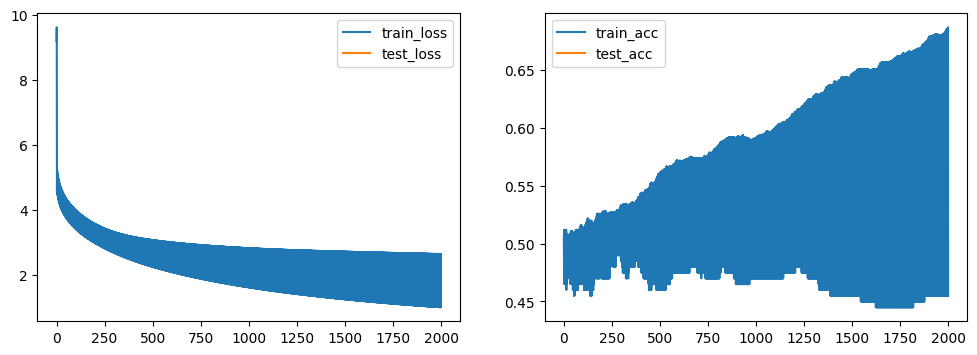

In [256]:
W,b = artificial_neuron2(X_train_reshape, y_train, X_test_reshape, y_test, learning_rate=0.01, n_iter=10000)